# 2016 US Bike Share Activity Snapshot

## Table of Contents
- [Introduction](#intro)
- [Posing Questions](#pose_questions)
- [Data Collection and Wrangling](#wrangling)
  - [Condensing the Trip Data](#condensing)
- [Exploratory Data Analysis](#eda)
  - [Statistics](#statistics)
  - [Visualizations](#visualizations)
- [Performing Your Own Analysis](#eda_continued)
- [Conclusions](#conclusions)

<a id='intro'></a>
## Introduction

> **Tip**: Quoted sections like this will provide helpful instructions on how to navigate and use a Jupyter notebook.

Over the past decade, bicycle-sharing systems have been growing in number and popularity in cities across the world. Bicycle-sharing systems allow users to rent bicycles for short trips, typically 30 minutes or less. Thanks to the rise in information technologies, it is easy for a user of the system to access a dock within the system to unlock or return bicycles. These technologies also provide a wealth of data that can be used to explore how these bike-sharing systems are used.

In this project, you will perform an exploratory analysis on data provided by [Motivate](https://www.motivateco.com/), a bike-share system provider for many major cities in the United States. You will compare the system usage between three large cities: New York City, Chicago, and Washington, DC. You will also see if there are any differences within each system for those users that are registered, regular users and those users that are short-term, casual users.

<a id='pose_questions'></a>
## Posing Questions

Before looking at the bike sharing data, you should start by asking questions you might want to understand about the bike share data. Consider, for example, if you were working for Motivate. What kinds of information would you want to know about in order to make smarter business decisions? If you were a user of the bike-share service, what factors might influence how you would want to use the service?

**Question 1**: Write at least two questions related to bike sharing that you think could be answered by data.

**Answer**: Daily engagement of users at each point, and how to distribute bicycles across various points to ensure maximum trips. As an user, whats the availability index of a cycle at each point, so that I as an user can make an informed decision.

> **Tip**: If you double click on this cell, you will see the text change so that all of the formatting is removed. This allows you to edit this block of text. This block of text is written using [Markdown](http://daringfireball.net/projects/markdown/syntax), which is a way to format text using headers, links, italics, and many other options using a plain-text syntax. You will also use Markdown later in the Nanodegree program. Use **Shift** + **Enter** or **Shift** + **Return** to run the cell and show its rendered form.

<a id='wrangling'></a>
## Data Collection and Wrangling

Now it's time to collect and explore our data. In this project, we will focus on the record of individual trips taken in 2016 from our selected cities: New York City, Chicago, and Washington, DC. Each of these cities has a page where we can freely download the trip data.:

- New York City (Citi Bike): [Link](https://www.citibikenyc.com/system-data)
- Chicago (Divvy): [Link](https://www.divvybikes.com/system-data)
- Washington, DC (Capital Bikeshare): [Link](https://www.capitalbikeshare.com/system-data)

If you visit these pages, you will notice that each city has a different way of delivering its data. Chicago updates with new data twice a year, Washington DC is quarterly, and New York City is monthly. **However, you do not need to download the data yourself.** The data has already been collected for you in the `/data/` folder of the project files. While the original data for 2016 is spread among multiple files for each city, the files in the `/data/` folder collect all of the trip data for the year into one file per city. Some data wrangling of inconsistencies in timestamp format within each city has already been performed for you. In addition, a random 2% sample of the original data is taken to make the exploration more manageable. 

**Question 2**: However, there is still a lot of data for us to investigate, so it's a good idea to start off by looking at one entry from each of the cities we're going to analyze. Run the first code cell below to load some packages and functions that you'll be using in your analysis. Then, complete the second code cell to print out the first trip recorded from each of the cities (the second line of each data file).

> **Tip**: You can run a code cell like you formatted Markdown cells above by clicking on the cell and using the keyboard shortcut **Shift** + **Enter** or **Shift** + **Return**. Alternatively, a code cell can be executed using the **Play** button in the toolbar after selecting it. While the cell is running, you will see an asterisk in the message to the left of the cell, i.e. `In [*]:`. The asterisk will change into a number to show that execution has completed, e.g. `In [1]`. If there is output, it will show up as `Out [1]:`, with an appropriate number to match the "In" number.

In [3]:
## import all necessary packages and functions.
import csv # read and write csv files
from datetime import datetime # operations to parse dates
from pprint import pprint # use to print data structures like dictionaries in
                          # a nicer way than the base print function.

In [4]:
def print_first_point(filename):
    """
    This function prints and returns the first data point (second row) from
    a csv file that includes a header row.
    """
    # print city name for reference
    city = filename.split('-')[0].split('/')[-1]
    print('\nCity: {}'.format(city))
    
    with open(filename, 'r') as f_in:
        ## TODO: Use the csv library to set up a DictReader object. ##
        ## see https://docs.python.org/3/library/csv.html           ##
        trip_reader = csv.DictReader(f_in)
        ## TODO: Use a function on the DictReader object to read the     ##
        ## first trip from the data file and store it in a variable.     ##
        ## see https://docs.python.org/3/library/csv.html#reader-objects ##
        for row in trip_reader:
            first_trip = row
            break
        pprint(first_trip)
        ## TODO: Use the pprint library to print the first trip. ##
        ## see https://docs.python.org/3/library/pprint.html     ##
        
    # output city name and first trip for later testing
    return (city, first_trip)

# list of files for each city
data_files = ['./data/NYC-CitiBike-2016.csv',
              './data/Chicago-Divvy-2016.csv',
              './data/Washington-CapitalBikeshare-2016.csv',]

# print the first trip from each file, store in dictionary
example_trips = {}
for data_file in data_files:
    city, first_trip = print_first_point(data_file)
    example_trips[city] = first_trip


City: NYC
{'bikeid': '17109',
 'birth year': '',
 'end station id': '401',
 'end station latitude': '40.72019576',
 'end station longitude': '-73.98997825',
 'end station name': 'Allen St & Rivington St',
 'gender': '0',
 'start station id': '532',
 'start station latitude': '40.710451',
 'start station longitude': '-73.960876',
 'start station name': 'S 5 Pl & S 4 St',
 'starttime': '1/1/2016 00:09:55',
 'stoptime': '1/1/2016 00:23:54',
 'tripduration': '839',
 'usertype': 'Customer'}

City: Chicago
{'bikeid': '2295',
 'birthyear': '1990',
 'from_station_id': '156',
 'from_station_name': 'Clark St & Wellington Ave',
 'gender': 'Male',
 'starttime': '3/31/2016 23:30',
 'stoptime': '3/31/2016 23:46',
 'to_station_id': '166',
 'to_station_name': 'Ashland Ave & Wrightwood Ave',
 'trip_id': '9080545',
 'tripduration': '926',
 'usertype': 'Subscriber'}

City: Washington
{'Bike number': 'W20842',
 'Duration (ms)': '427387',
 'End date': '3/31/2016 23:04',
 'End station': 'Georgia Ave and Fa

If everything has been filled out correctly, you should see below the printout of each city name (which has been parsed from the data file name) that the first trip has been parsed in the form of a dictionary. When you set up a `DictReader` object, the first row of the data file is normally interpreted as column names. Every other row in the data file will use those column names as keys, as a dictionary is generated for each row.

This will be useful since we can refer to quantities by an easily-understandable label instead of just a numeric index. For example, if we have a trip stored in the variable `row`, then we would rather get the trip duration from `row['duration']` instead of `row[0]`.

<a id='condensing'></a>
### Condensing the Trip Data

It should also be observable from the above printout that each city provides different information. Even where the information is the same, the column names and formats are sometimes different. To make things as simple as possible when we get to the actual exploration, we should trim and clean the data. Cleaning the data makes sure that the data formats across the cities are consistent, while trimming focuses only on the parts of the data we are most interested in to make the exploration easier to work with.

You will generate new data files with five values of interest for each trip: trip duration, starting month, starting hour, day of the week, and user type. Each of these may require additional wrangling depending on the city:

- **Duration**: This has been given to us in seconds (New York, Chicago) or milliseconds (Washington). A more natural unit of analysis will be if all the trip durations are given in terms of minutes.
- **Month**, **Hour**, **Day of Week**: Ridership volume is likely to change based on the season, time of day, and whether it is a weekday or weekend. Use the start time of the trip to obtain these values. The New York City data includes the seconds in their timestamps, while Washington and Chicago do not. The [`datetime`](https://docs.python.org/3/library/datetime.html) package will be very useful here to make the needed conversions.
- **User Type**: It is possible that users who are subscribed to a bike-share system will have different patterns of use compared to users who only have temporary passes. Washington divides its users into two types: 'Registered' for users with annual, monthly, and other longer-term subscriptions, and 'Casual', for users with 24-hour, 3-day, and other short-term passes. The New York and Chicago data uses 'Subscriber' and 'Customer' for these groups, respectively. For consistency, you will convert the Washington labels to match the other two.


**Question 3a**: Complete the helper functions in the code cells below to address each of the cleaning tasks described above.

In [5]:
def duration_in_mins(datum, city):
    """
    Takes as input a dictionary containing info about a single trip (datum) and
    its origin city (city) and returns the trip duration in units of minutes.
    
    Remember that Washington is in terms of milliseconds while Chicago and NYC
    are in terms of seconds. 
    
    HINT: The csv module reads in all of the data as strings, including numeric
    values. You will need a function to convert the strings into an appropriate
    numeric type when making your transformations.
    see https://docs.python.org/3/library/functions.html
    """
    
    # YOUR CODE HERE
    if(city=='Washington'):
        duration = float(datum['Duration (ms)'])
        duration = (duration/1000)/60
    else:
        duration = float(datum['tripduration'])
        duration = (duration/60) 
    print(duration)
    return duration


# Some tests to check that your code works. There should be no output if all of
# the assertions pass. The `example_trips` dictionary was obtained from when
# you printed the first trip from each of the original data files.
tests = {'NYC': 13.9833,
         'Chicago': 15.4333,
         'Washington': 7.1231}

for city in tests:
    assert abs(duration_in_mins(example_trips[city], city) - tests[city]) < .001

13.9833333333
7.12311666667
15.4333333333


In [6]:
def time_of_trip(datum, city):
    """
    Takes as input a dictionary containing info about a single trip (datum) and
    its origin city (city) and returns the month, hour, and day of the week in
    which the trip was made.
    
    Remember that NYC includes seconds, while Washington and Chicago do not.
    
    HINT: You should use the datetime module to parse the original date
    strings into a format that is useful for extracting the desired information.
    see https://docs.python.org/3/library/datetime.html#strftime-and-strptime-behavior
    """
    days=["Monday","Tuesday","Wednesday","Thursday","Friday","Saturday","Sunday"]

    # YOUR CODE HERE
    if(city=='NYC'):
        #'1/1/2016 00:09:55'
        date = datetime.strptime(datum['starttime'],'%m/%d/%Y %H:%M:%S')
    elif(city=='Washington'):
        #'3/31/2016 22:57'
        date = datetime.strptime(datum['Start date'],'%m/%d/%Y %H:%M')
    else:
        date = datetime.strptime(datum['starttime'],'%m/%d/%Y %H:%M')

    #print(date)
    month = date.month
    hour = date.time().hour
    day_of_week = days[date.weekday()]
    print(month, hour, day_of_week)
    return (month, hour, day_of_week)


# Some tests to check that your code works. There should be no output if all of
# the assertions pass. The `example_trips` dictionary was obtained from when
# you printed the first trip from each of the original data files.
tests = {'NYC': (1, 0, 'Friday'),
         'Chicago': (3, 23, 'Thursday'),
         'Washington': (3, 22, 'Thursday')}

for city in tests:
    assert time_of_trip(example_trips[city], city) == tests[city]

(1, 0, 'Friday')
(3, 22, 'Thursday')
(3, 23, 'Thursday')


In [7]:
def type_of_user(datum, city):
    """
    Takes as input a dictionary containing info about a single trip (datum) and
    its origin city (city) and returns the type of system user that made the
    trip.
    
    Remember that Washington has different category names compared to Chicago
    and NYC. 
    """
    
    # YOUR CODE HERE
    if(city=='Washington'):
        userType = datum['Member Type']
        if(userType=='Registered'):
            userType = 'Subscriber'
        else:
            userType = 'Customer'
    else:
        userType = datum['usertype']
    print(userType)
    return userType


# Some tests to check that your code works. There should be no output if all of
# the assertions pass. The `example_trips` dictionary was obtained from when
# you printed the first trip from each of the original data files.
tests = {'NYC': 'Customer',
         'Chicago': 'Subscriber',
         'Washington': 'Subscriber'}

for city in tests:
    assert type_of_user(example_trips[city], city) == tests[city]

Customer
Subscriber
Subscriber


**Question 3b**: Now, use the helper functions you wrote above to create a condensed data file for each city consisting only of the data fields indicated above. In the `/examples/` folder, you will see an example datafile from the [Bay Area Bike Share](http://www.bayareabikeshare.com/open-data) before and after conversion. Make sure that your output is formatted to be consistent with the example file.

In [8]:
def condense_data(in_file, out_file, city):
    """
    This function takes full data from the specified input file
    and writes the condensed data to a specified output file. The city
    argument determines how the input file will be parsed.
    
    HINT: See the cell below to see how the arguments are structured!
    """
    
    with open(out_file, 'w') as f_out, open(in_file, 'r') as f_in:
        # set up csv DictWriter object - writer requires column names for the
        # first row as the "fieldnames" argument
        out_colnames = ['duration', 'month', 'hour', 'day_of_week', 'user_type']        
        trip_writer = csv.DictWriter(f_out, fieldnames = out_colnames)
        trip_writer.writeheader()
        
        ## TODO: set up csv DictReader object ##
        trip_reader = csv.DictReader(f_in)
        
        # collect data from and process each row
        for row in trip_reader:
            # set up a dictionary to hold the values for the cleaned and trimmed
            # data point
            duration = duration_in_mins(row,city)
            month, hour, day_of_week = time_of_trip(row,city)
            userType = type_of_user(row, city)
            new_point = {'duration':duration, 'month':month, 'hour':hour, 'day_of_week':day_of_week, 'user_type':userType}

            ## TODO: use the helper functions to get the cleaned data from  ##
            ## the original data dictionaries.                              ##
            ## Note that the keys for the new_point dictionary should match ##
            ## the column names set in the DictWriter object above.         ##
            
            trip_writer.writerow(new_point)
            ## TODO: write the processed information to the output file.     ##
            ## see https://docs.python.org/3/library/csv.html#writer-objects ##
            
            

In [28]:
# Run this cell to check your work
city_info = {'Washington': {'in_file': './data/Washington-CapitalBikeshare-2016.csv',
                            'out_file': './data/Washington-2016-Summary.csv'},
             'Chicago': {'in_file': './data/Chicago-Divvy-2016.csv',
                         'out_file': './data/Chicago-2016-Summary.csv'},
             'NYC': {'in_file': './data/NYC-CitiBike-2016.csv',
                     'out_file': './data/NYC-2016-Summary.csv'}}

for city, filenames in city_info.items():
    condense_data(filenames['in_file'], filenames['out_file'], city)
    
print('Wrote to output files')

13.9833333333
(1, 0, 'Friday')
Customer
11.4333333333
(1, 0, 'Friday')
Subscriber
5.25
(1, 0, 'Friday')
Subscriber
12.3166666667
(1, 0, 'Friday')
Subscriber
20.8833333333
(1, 0, 'Friday')
Customer
8.75
(1, 0, 'Friday')
Subscriber
10.9833333333
(1, 0, 'Friday')
Subscriber
7.73333333333
(1, 1, 'Friday')
Subscriber
3.43333333333
(1, 1, 'Friday')
Subscriber
7.08333333333
(1, 1, 'Friday')
Customer
13.3
(1, 2, 'Friday')
Subscriber
9.73333333333
(1, 2, 'Friday')
Subscriber
8.41666666667
(1, 2, 'Friday')
Subscriber
23.85
(1, 2, 'Friday')
Subscriber
11.2166666667
(1, 2, 'Friday')
Subscriber
9.01666666667
(1, 2, 'Friday')
Subscriber
3.18333333333
(1, 2, 'Friday')
Subscriber
13.9166666667
(1, 2, 'Friday')
Subscriber
13.1333333333
(1, 2, 'Friday')
Subscriber
9.96666666667
(1, 3, 'Friday')
Subscriber
20.6333333333
(1, 3, 'Friday')
Subscriber
7.66666666667
(1, 3, 'Friday')
Subscriber
23.45
(1, 3, 'Friday')
Subscriber
4.7
(1, 3, 'Friday')
Subscriber
3.55
(1, 3, 'Friday')
Subscriber
16.4
(1, 3, 'Frida

(1, 14, 'Saturday')
Subscriber
5.3
(1, 14, 'Saturday')
Subscriber
30.1166666667
(1, 14, 'Saturday')
Customer
12.1833333333
(1, 14, 'Saturday')
Subscriber
10.1666666667
(1, 14, 'Saturday')
Subscriber
15.8166666667
(1, 14, 'Saturday')
Subscriber
27.9833333333
(1, 14, 'Saturday')
Subscriber
13.8166666667
(1, 14, 'Saturday')
Subscriber
19.8666666667
(1, 14, 'Saturday')
Subscriber
11.55
(1, 14, 'Saturday')
Subscriber
55.6166666667
(1, 14, 'Saturday')
Customer
12.05
(1, 14, 'Saturday')
Customer
27.5166666667
(1, 14, 'Saturday')
Customer
31.6666666667
(1, 14, 'Saturday')
Subscriber
12.7166666667
(1, 14, 'Saturday')
Subscriber
2.4
(1, 14, 'Saturday')
Subscriber
14.0833333333
(1, 14, 'Saturday')
Customer
21.2166666667
(1, 14, 'Saturday')
Subscriber
3.83333333333
(1, 14, 'Saturday')
Subscriber
15.5333333333
(1, 14, 'Saturday')
Subscriber
4.36666666667
(1, 14, 'Saturday')
Subscriber
50.4166666667
(1, 14, 'Saturday')
Customer
13.1333333333
(1, 14, 'Saturday')
Subscriber
13.2
(1, 14, 'Saturday')
Su

(1, 8, 'Monday')
Subscriber
7.83333333333
(1, 8, 'Monday')
Subscriber
3.2
(1, 8, 'Monday')
Subscriber
9.55
(1, 8, 'Monday')
Subscriber
9.66666666667
(1, 8, 'Monday')
Subscriber
640.9
(1, 8, 'Monday')
Subscriber
5.21666666667
(1, 8, 'Monday')
Subscriber
8.21666666667
(1, 8, 'Monday')
Subscriber
7.55
(1, 8, 'Monday')
Subscriber
11.3333333333
(1, 8, 'Monday')
Subscriber
9.4
(1, 8, 'Monday')
Customer
7.15
(1, 8, 'Monday')
Subscriber
10.15
(1, 8, 'Monday')
Subscriber
5.3
(1, 8, 'Monday')
Subscriber
9.46666666667
(1, 8, 'Monday')
Subscriber
8.73333333333
(1, 8, 'Monday')
Subscriber
17.15
(1, 8, 'Monday')
Subscriber
1.61666666667
(1, 8, 'Monday')
Subscriber
6.01666666667
(1, 8, 'Monday')
Subscriber
15.7833333333
(1, 8, 'Monday')
Subscriber
7.0
(1, 8, 'Monday')
Subscriber
12.4666666667
(1, 8, 'Monday')
Subscriber
5.8
(1, 8, 'Monday')
Subscriber
6.98333333333
(1, 8, 'Monday')
Subscriber
4.53333333333
(1, 8, 'Monday')
Subscriber
8.63333333333
(1, 8, 'Monday')
Subscriber
16.6666666667
(1, 8, 'Mon

Subscriber
4.41666666667
(1, 19, 'Tuesday')
Subscriber
5.03333333333
(1, 19, 'Tuesday')
Subscriber
4.73333333333
(1, 19, 'Tuesday')
Subscriber
9.93333333333
(1, 19, 'Tuesday')
Subscriber
6.3
(1, 19, 'Tuesday')
Subscriber
8.01666666667
(1, 19, 'Tuesday')
Subscriber
5.48333333333
(1, 19, 'Tuesday')
Subscriber
1.68333333333
(1, 19, 'Tuesday')
Subscriber
5.61666666667
(1, 19, 'Tuesday')
Subscriber
8.6
(1, 19, 'Tuesday')
Subscriber
4.46666666667
(1, 20, 'Tuesday')
Subscriber
7.65
(1, 20, 'Tuesday')
Subscriber
8.8
(1, 20, 'Tuesday')
Subscriber
2.15
(1, 20, 'Tuesday')
Subscriber
7.63333333333
(1, 20, 'Tuesday')
Subscriber
7.56666666667
(1, 20, 'Tuesday')
Subscriber
877.216666667
(1, 20, 'Tuesday')
Subscriber
5.0
(1, 20, 'Tuesday')
Subscriber
8.35
(1, 20, 'Tuesday')
Subscriber
11.8833333333
(1, 20, 'Tuesday')
Subscriber
13.5166666667
(1, 20, 'Tuesday')
Subscriber
12.2166666667
(1, 20, 'Tuesday')
Subscriber
18.4166666667
(1, 21, 'Tuesday')
Subscriber
2.2
(1, 21, 'Tuesday')
Subscriber
7.61666666

10.6
(1, 8, 'Thursday')
Subscriber
20.7333333333
(1, 8, 'Thursday')
Subscriber
3.66666666667
(1, 8, 'Thursday')
Subscriber
12.5333333333
(1, 8, 'Thursday')
Subscriber
10.3833333333
(1, 8, 'Thursday')
Subscriber
27.9
(1, 8, 'Thursday')
Subscriber
4.31666666667
(1, 8, 'Thursday')
Subscriber
32.1666666667
(1, 8, 'Thursday')
Subscriber
14.15
(1, 8, 'Thursday')
Subscriber
22.0833333333
(1, 8, 'Thursday')
Subscriber
26.3333333333
(1, 8, 'Thursday')
Subscriber
17.7166666667
(1, 8, 'Thursday')
Subscriber
9.51666666667
(1, 8, 'Thursday')
Subscriber
13.0
(1, 8, 'Thursday')
Subscriber
6.6
(1, 8, 'Thursday')
Subscriber
14.7333333333
(1, 8, 'Thursday')
Subscriber
5.55
(1, 8, 'Thursday')
Subscriber
7.33333333333
(1, 8, 'Thursday')
Subscriber
25.9
(1, 8, 'Thursday')
Subscriber
22.1333333333
(1, 8, 'Thursday')
Subscriber
28.3666666667
(1, 8, 'Thursday')
Subscriber
13.15
(1, 8, 'Thursday')
Subscriber
7.53333333333
(1, 8, 'Thursday')
Subscriber
8.53333333333
(1, 8, 'Thursday')
Subscriber
4.81666666667
(

Subscriber
4.98333333333
(1, 10, 'Friday')
Subscriber
9.78333333333
(1, 10, 'Friday')
Subscriber
9.53333333333
(1, 10, 'Friday')
Subscriber
11.35
(1, 10, 'Friday')
Subscriber
14.95
(1, 10, 'Friday')
Subscriber
21.95
(1, 10, 'Friday')
Subscriber
8.38333333333
(1, 10, 'Friday')
Subscriber
3.38333333333
(1, 10, 'Friday')
Subscriber
4.31666666667
(1, 10, 'Friday')
Subscriber
12.0
(1, 11, 'Friday')
Subscriber
17.0666666667
(1, 11, 'Friday')
Subscriber
3.93333333333
(1, 11, 'Friday')
Subscriber
13.0833333333
(1, 11, 'Friday')
Subscriber
145.116666667
(1, 11, 'Friday')
Customer
3.3
(1, 11, 'Friday')
Subscriber
8.56666666667
(1, 11, 'Friday')
Subscriber
9.63333333333
(1, 11, 'Friday')
Subscriber
11.3666666667
(1, 11, 'Friday')
Subscriber
8.18333333333
(1, 11, 'Friday')
Subscriber
8.08333333333
(1, 11, 'Friday')
Subscriber
11.5666666667
(1, 11, 'Friday')
Subscriber
10.1166666667
(1, 11, 'Friday')
Subscriber
28.7833333333
(1, 11, 'Friday')
Subscriber
8.78333333333
(1, 11, 'Friday')
Subscriber
7.

8.98333333333
(1, 17, 'Saturday')
Subscriber
14.9166666667
(1, 17, 'Saturday')
Subscriber
23.2166666667
(1, 17, 'Saturday')
Subscriber
4.68333333333
(1, 17, 'Saturday')
Subscriber
5.1
(1, 17, 'Saturday')
Subscriber
5.93333333333
(1, 17, 'Saturday')
Subscriber
4.91666666667
(1, 17, 'Saturday')
Subscriber
19.6
(1, 17, 'Saturday')
Subscriber
10.6333333333
(1, 17, 'Saturday')
Subscriber
14.8833333333
(1, 17, 'Saturday')
Subscriber
5.0
(1, 17, 'Saturday')
Subscriber
6.31666666667
(1, 17, 'Saturday')
Subscriber
19.6166666667
(1, 17, 'Saturday')
Subscriber
15.7
(1, 17, 'Saturday')
Subscriber
7.06666666667
(1, 17, 'Saturday')
Subscriber
8.25
(1, 17, 'Saturday')
Subscriber
14.4333333333
(1, 17, 'Saturday')
Subscriber
3.2
(1, 18, 'Saturday')
Subscriber
10.25
(1, 18, 'Saturday')
Subscriber
6.26666666667
(1, 18, 'Saturday')
Subscriber
2.78333333333
(1, 18, 'Saturday')
Subscriber
20.0833333333
(1, 18, 'Saturday')
Subscriber
7.06666666667
(1, 18, 'Saturday')
Subscriber
14.5833333333
(1, 18, 'Saturda

Subscriber
18.3
(1, 16, 'Monday')
Subscriber
22.1833333333
(1, 16, 'Monday')
Subscriber
9.13333333333
(1, 16, 'Monday')
Subscriber
5.68333333333
(1, 16, 'Monday')
Subscriber
4.48333333333
(1, 16, 'Monday')
Subscriber
8.36666666667
(1, 16, 'Monday')
Subscriber
20.0666666667
(1, 16, 'Monday')
Subscriber
6.3
(1, 16, 'Monday')
Subscriber
9.11666666667
(1, 17, 'Monday')
Subscriber
35.65
(1, 17, 'Monday')
Subscriber
25.2
(1, 17, 'Monday')
Subscriber
10.25
(1, 17, 'Monday')
Subscriber
3.41666666667
(1, 17, 'Monday')
Subscriber
3.71666666667
(1, 17, 'Monday')
Subscriber
5.95
(1, 17, 'Monday')
Subscriber
8.91666666667
(1, 17, 'Monday')
Subscriber
9.88333333333
(1, 17, 'Monday')
Subscriber
4.35
(1, 17, 'Monday')
Subscriber
8.88333333333
(1, 17, 'Monday')
Subscriber
7.1
(1, 17, 'Monday')
Subscriber
17.35
(1, 17, 'Monday')
Subscriber
3.75
(1, 17, 'Monday')
Subscriber
9.03333333333
(1, 17, 'Monday')
Subscriber
8.16666666667
(1, 17, 'Monday')
Subscriber
5.46666666667
(1, 17, 'Monday')
Subscriber
7.3

4.33333333333
(1, 21, 'Tuesday')
Subscriber
3.91666666667
(1, 21, 'Tuesday')
Subscriber
5.11666666667
(1, 21, 'Tuesday')
Subscriber
6.48333333333
(1, 21, 'Tuesday')
Subscriber
40.95
(1, 21, 'Tuesday')
Subscriber
24.7833333333
(1, 21, 'Tuesday')
Subscriber
7.93333333333
(1, 21, 'Tuesday')
Subscriber
15.1666666667
(1, 21, 'Tuesday')
Subscriber
9.86666666667
(1, 22, 'Tuesday')
Subscriber
1.91666666667
(1, 22, 'Tuesday')
Subscriber
10.9833333333
(1, 22, 'Tuesday')
Subscriber
12.2333333333
(1, 22, 'Tuesday')
Subscriber
4.7
(1, 22, 'Tuesday')
Subscriber
3.4
(1, 22, 'Tuesday')
Subscriber
41.5333333333
(1, 22, 'Tuesday')
Subscriber
4.43333333333
(1, 22, 'Tuesday')
Subscriber
9.01666666667
(1, 22, 'Tuesday')
Subscriber
11.0333333333
(1, 22, 'Tuesday')
Subscriber
24.7833333333
(1, 22, 'Tuesday')
Subscriber
6.85
(1, 22, 'Tuesday')
Subscriber
8.93333333333
(1, 22, 'Tuesday')
Subscriber
2.9
(1, 22, 'Tuesday')
Subscriber
43.1833333333
(1, 23, 'Tuesday')
Subscriber
3.03333333333
(1, 23, 'Tuesday')
Su

12.55
(1, 14, 'Thursday')
Subscriber
3.58333333333
(1, 14, 'Thursday')
Subscriber
20.6666666667
(1, 14, 'Thursday')
Subscriber
28.95
(1, 15, 'Thursday')
Customer
12.9666666667
(1, 15, 'Thursday')
Subscriber
6.7
(1, 15, 'Thursday')
Subscriber
8.66666666667
(1, 15, 'Thursday')
Subscriber
7.9
(1, 15, 'Thursday')
Subscriber
17.3166666667
(1, 15, 'Thursday')
Subscriber
18.6833333333
(1, 15, 'Thursday')
Customer
26.5833333333
(1, 15, 'Thursday')
Subscriber
8.46666666667
(1, 15, 'Thursday')
Subscriber
4.28333333333
(1, 15, 'Thursday')
Subscriber
2.78333333333
(1, 15, 'Thursday')
Subscriber
27.7
(1, 15, 'Thursday')
Customer
6.7
(1, 15, 'Thursday')
Subscriber
5.96666666667
(1, 16, 'Thursday')
Subscriber
14.25
(1, 16, 'Thursday')
Subscriber
4.9
(1, 16, 'Thursday')
Subscriber
13.75
(1, 16, 'Thursday')
Subscriber
14.2666666667
(1, 16, 'Thursday')
Subscriber
5.56666666667
(1, 16, 'Thursday')
Subscriber
10.7166666667
(1, 16, 'Thursday')
Subscriber
4.26666666667
(1, 16, 'Thursday')
Subscriber
5.41666

(1, 17, 'Friday')
Subscriber
17.9
(1, 17, 'Friday')
Subscriber
20.4666666667
(1, 17, 'Friday')
Subscriber
10.8666666667
(1, 17, 'Friday')
Subscriber
23.8
(1, 17, 'Friday')
Subscriber
12.7833333333
(1, 17, 'Friday')
Subscriber
19.4833333333
(1, 17, 'Friday')
Subscriber
6.16666666667
(1, 17, 'Friday')
Subscriber
7.3
(1, 17, 'Friday')
Subscriber
11.65
(1, 17, 'Friday')
Subscriber
13.8
(1, 17, 'Friday')
Subscriber
7.91666666667
(1, 17, 'Friday')
Subscriber
28.05
(1, 17, 'Friday')
Subscriber
7.93333333333
(1, 17, 'Friday')
Subscriber
8.88333333333
(1, 17, 'Friday')
Subscriber
16.35
(1, 17, 'Friday')
Subscriber
5.7
(1, 17, 'Friday')
Subscriber
9.73333333333
(1, 17, 'Friday')
Subscriber
9.86666666667
(1, 17, 'Friday')
Subscriber
13.5333333333
(1, 17, 'Friday')
Customer
16.35
(1, 17, 'Friday')
Subscriber
26.9
(1, 17, 'Friday')
Subscriber
9.73333333333
(1, 17, 'Friday')
Subscriber
9.31666666667
(1, 17, 'Friday')
Subscriber
14.5166666667
(1, 17, 'Friday')
Subscriber
18.95
(1, 17, 'Friday')
Subsc

(1, 13, 'Sunday')
Subscriber
6.2
(1, 13, 'Sunday')
Subscriber
9.73333333333
(1, 13, 'Sunday')
Subscriber
8.56666666667
(1, 13, 'Sunday')
Subscriber
11.8833333333
(1, 13, 'Sunday')
Customer
3.23333333333
(1, 13, 'Sunday')
Subscriber
5.51666666667
(1, 13, 'Sunday')
Subscriber
5.91666666667
(1, 13, 'Sunday')
Subscriber
10.6833333333
(1, 13, 'Sunday')
Subscriber
4.13333333333
(1, 13, 'Sunday')
Subscriber
6.43333333333
(1, 13, 'Sunday')
Subscriber
4.13333333333
(1, 13, 'Sunday')
Subscriber
21.05
(1, 13, 'Sunday')
Subscriber
2.75
(1, 13, 'Sunday')
Subscriber
7.63333333333
(1, 13, 'Sunday')
Subscriber
28.75
(1, 13, 'Sunday')
Subscriber
4.93333333333
(1, 13, 'Sunday')
Subscriber
13.9666666667
(1, 13, 'Sunday')
Subscriber
1.68333333333
(1, 13, 'Sunday')
Subscriber
6.75
(1, 13, 'Sunday')
Subscriber
6.91666666667
(1, 13, 'Sunday')
Subscriber
57.7333333333
(1, 13, 'Sunday')
Customer
4.61666666667
(1, 13, 'Sunday')
Subscriber
3.18333333333
(1, 13, 'Sunday')
Subscriber
20.1
(1, 13, 'Sunday')
Subscri

Subscriber
8.05
(1, 17, 'Tuesday')
Subscriber
3.03333333333
(1, 17, 'Tuesday')
Subscriber
6.76666666667
(1, 17, 'Tuesday')
Subscriber
13.0333333333
(1, 17, 'Tuesday')
Subscriber
5.4
(1, 17, 'Tuesday')
Subscriber
6.46666666667
(1, 17, 'Tuesday')
Subscriber
7.73333333333
(1, 17, 'Tuesday')
Subscriber
21.1833333333
(1, 17, 'Tuesday')
Subscriber
6.83333333333
(1, 17, 'Tuesday')
Subscriber
6.16666666667
(1, 17, 'Tuesday')
Subscriber
4.91666666667
(1, 17, 'Tuesday')
Subscriber
9.85
(1, 17, 'Tuesday')
Subscriber
7.18333333333
(1, 17, 'Tuesday')
Subscriber
4.18333333333
(1, 17, 'Tuesday')
Subscriber
22.8666666667
(1, 17, 'Tuesday')
Subscriber
8.23333333333
(1, 17, 'Tuesday')
Subscriber
5.78333333333
(1, 17, 'Tuesday')
Subscriber
6.2
(1, 18, 'Tuesday')
Subscriber
5.96666666667
(1, 18, 'Tuesday')
Subscriber
5.46666666667
(1, 18, 'Tuesday')
Subscriber
2.85
(1, 18, 'Tuesday')
Subscriber
7.66666666667
(1, 18, 'Tuesday')
Subscriber
11.6166666667
(1, 18, 'Tuesday')
Subscriber
16.4666666667
(1, 18, 'T

(1, 8, 'Thursday')
Subscriber
6.48333333333
(1, 8, 'Thursday')
Subscriber
5.66666666667
(1, 8, 'Thursday')
Subscriber
6.66666666667
(1, 8, 'Thursday')
Subscriber
15.75
(1, 8, 'Thursday')
Subscriber
8.1
(1, 8, 'Thursday')
Subscriber
5.41666666667
(1, 8, 'Thursday')
Subscriber
9.73333333333
(1, 8, 'Thursday')
Subscriber
19.25
(1, 8, 'Thursday')
Subscriber
5.45
(1, 8, 'Thursday')
Subscriber
18.0333333333
(1, 8, 'Thursday')
Subscriber
20.5
(1, 8, 'Thursday')
Subscriber
9.11666666667
(1, 8, 'Thursday')
Subscriber
8.8
(1, 8, 'Thursday')
Subscriber
4.91666666667
(1, 8, 'Thursday')
Subscriber
10.1
(1, 8, 'Thursday')
Subscriber
7.13333333333
(1, 8, 'Thursday')
Subscriber
28.1666666667
(1, 8, 'Thursday')
Subscriber
13.2666666667
(1, 8, 'Thursday')
Subscriber
30.0833333333
(1, 8, 'Thursday')
Subscriber
6.66666666667
(1, 8, 'Thursday')
Subscriber
3.93333333333
(1, 8, 'Thursday')
Subscriber
9.85
(1, 8, 'Thursday')
Subscriber
7.9
(1, 8, 'Thursday')
Subscriber
4.55
(1, 8, 'Thursday')
Subscriber
9.85


Subscriber
6.48333333333
(1, 16, 'Friday')
Subscriber
17.4333333333
(1, 16, 'Friday')
Subscriber
4.11666666667
(1, 16, 'Friday')
Subscriber
3.35
(1, 16, 'Friday')
Subscriber
8.26666666667
(1, 16, 'Friday')
Subscriber
7.78333333333
(1, 16, 'Friday')
Subscriber
9.73333333333
(1, 16, 'Friday')
Subscriber
19.4333333333
(1, 16, 'Friday')
Subscriber
4.78333333333
(1, 17, 'Friday')
Subscriber
13.9666666667
(1, 17, 'Friday')
Subscriber
2.41666666667
(1, 17, 'Friday')
Subscriber
5.15
(1, 17, 'Friday')
Subscriber
12.2333333333
(1, 17, 'Friday')
Subscriber
4.11666666667
(1, 17, 'Friday')
Subscriber
7.06666666667
(1, 17, 'Friday')
Subscriber
8.98333333333
(1, 17, 'Friday')
Subscriber
2.58333333333
(1, 17, 'Friday')
Subscriber
11.8833333333
(1, 17, 'Friday')
Subscriber
5.76666666667
(1, 17, 'Friday')
Subscriber
10.15
(1, 17, 'Friday')
Subscriber
6.33333333333
(1, 17, 'Friday')
Subscriber
1.83333333333
(1, 17, 'Friday')
Subscriber
7.85
(1, 17, 'Friday')
Subscriber
9.4
(1, 17, 'Friday')
Subscriber
10

Customer
10.0833333333
(1, 13, 'Friday')
Subscriber
6.16666666667
(1, 13, 'Friday')
Subscriber
9.11666666667
(1, 13, 'Friday')
Subscriber
12.6833333333
(1, 13, 'Friday')
Subscriber
9.96666666667
(1, 13, 'Friday')
Subscriber
12.2
(1, 13, 'Friday')
Subscriber
14.9333333333
(1, 13, 'Friday')
Subscriber
10.0166666667
(1, 13, 'Friday')
Subscriber
9.01666666667
(1, 13, 'Friday')
Subscriber
8.26666666667
(1, 13, 'Friday')
Subscriber
6.58333333333
(1, 13, 'Friday')
Subscriber
17.5333333333
(1, 13, 'Friday')
Subscriber
21.6333333333
(1, 13, 'Friday')
Subscriber
13.65
(1, 13, 'Friday')
Subscriber
33.6
(1, 13, 'Friday')
Customer
41.6333333333
(1, 13, 'Friday')
Subscriber
6.13333333333
(1, 13, 'Friday')
Subscriber
2.15
(1, 13, 'Friday')
Subscriber
5.05
(1, 14, 'Friday')
Subscriber
7.28333333333
(1, 14, 'Friday')
Subscriber
8.11666666667
(1, 14, 'Friday')
Subscriber
3.68333333333
(1, 14, 'Friday')
Subscriber
5.75
(1, 14, 'Friday')
Subscriber
10.5333333333
(1, 14, 'Friday')
Subscriber
5.41666666667


Customer
24.4166666667
(1, 17, 'Sunday')
Subscriber
13.1833333333
(1, 17, 'Sunday')
Subscriber
6.8
(1, 17, 'Sunday')
Subscriber
14.2
(1, 17, 'Sunday')
Subscriber
37.4833333333
(1, 17, 'Sunday')
Subscriber
3.15
(1, 17, 'Sunday')
Subscriber
12.3
(1, 17, 'Sunday')
Subscriber
12.6666666667
(1, 17, 'Sunday')
Subscriber
1.31666666667
(1, 17, 'Sunday')
Subscriber
6.35
(1, 17, 'Sunday')
Subscriber
12.7833333333
(1, 17, 'Sunday')
Subscriber
12.55
(1, 18, 'Sunday')
Subscriber
15.2166666667
(1, 18, 'Sunday')
Subscriber
11.5
(1, 18, 'Sunday')
Subscriber
8.98333333333
(1, 18, 'Sunday')
Subscriber
7.08333333333
(1, 18, 'Sunday')
Subscriber
3.48333333333
(1, 18, 'Sunday')
Customer
5.08333333333
(1, 18, 'Sunday')
Subscriber
7.38333333333
(1, 18, 'Sunday')
Subscriber
4.03333333333
(1, 18, 'Sunday')
Subscriber
23.4166666667
(1, 18, 'Sunday')
Subscriber
4.81666666667
(1, 18, 'Sunday')
Subscriber
4.31666666667
(1, 18, 'Sunday')
Subscriber
3.15
(1, 18, 'Sunday')
Subscriber
5.0
(1, 18, 'Sunday')
Subscriber


(2, 8, 'Tuesday')
Subscriber
7.01666666667
(2, 8, 'Tuesday')
Subscriber
3.56666666667
(2, 8, 'Tuesday')
Subscriber
13.1666666667
(2, 8, 'Tuesday')
Subscriber
9.43333333333
(2, 8, 'Tuesday')
Subscriber
17.0666666667
(2, 8, 'Tuesday')
Subscriber
7.91666666667
(2, 8, 'Tuesday')
Subscriber
6.28333333333
(2, 8, 'Tuesday')
Subscriber
3.68333333333
(2, 8, 'Tuesday')
Subscriber
4.98333333333
(2, 8, 'Tuesday')
Subscriber
10.1833333333
(2, 8, 'Tuesday')
Subscriber
4.95
(2, 8, 'Tuesday')
Subscriber
5.61666666667
(2, 8, 'Tuesday')
Subscriber
1.38333333333
(2, 8, 'Tuesday')
Subscriber
4.56666666667
(2, 9, 'Tuesday')
Subscriber
25.3666666667
(2, 9, 'Tuesday')
Subscriber
16.45
(2, 9, 'Tuesday')
Subscriber
11.7166666667
(2, 9, 'Tuesday')
Subscriber
7.05
(2, 9, 'Tuesday')
Subscriber
21.1833333333
(2, 9, 'Tuesday')
Subscriber
6.08333333333
(2, 9, 'Tuesday')
Subscriber
9.16666666667
(2, 9, 'Tuesday')
Subscriber
13.2
(2, 9, 'Tuesday')
Subscriber
4.66666666667
(2, 9, 'Tuesday')
Subscriber
12.6
(2, 9, 'Tues

12.6333333333
(2, 18, 'Wednesday')
Subscriber
9.06666666667
(2, 18, 'Wednesday')
Subscriber
3.25
(2, 18, 'Wednesday')
Subscriber
7.43333333333
(2, 18, 'Wednesday')
Subscriber
14.2166666667
(2, 18, 'Wednesday')
Subscriber
18.1166666667
(2, 18, 'Wednesday')
Subscriber
4.51666666667
(2, 18, 'Wednesday')
Subscriber
14.9
(2, 18, 'Wednesday')
Subscriber
7.36666666667
(2, 18, 'Wednesday')
Subscriber
3.36666666667
(2, 18, 'Wednesday')
Subscriber
8.2
(2, 18, 'Wednesday')
Subscriber
13.7333333333
(2, 18, 'Wednesday')
Subscriber
9.41666666667
(2, 18, 'Wednesday')
Subscriber
17.7
(2, 18, 'Wednesday')
Subscriber
5.61666666667
(2, 18, 'Wednesday')
Subscriber
5.3
(2, 18, 'Wednesday')
Subscriber
24.9833333333
(2, 18, 'Wednesday')
Subscriber
14.65
(2, 18, 'Wednesday')
Subscriber
13.5333333333
(2, 18, 'Wednesday')
Subscriber
21.7666666667
(2, 18, 'Wednesday')
Subscriber
6.43333333333
(2, 18, 'Wednesday')
Subscriber
9.13333333333
(2, 18, 'Wednesday')
Subscriber
4.35
(2, 18, 'Wednesday')
Subscriber
9.6166

(2, 13, 'Friday')
Subscriber
8.66666666667
(2, 13, 'Friday')
Subscriber
10.0166666667
(2, 13, 'Friday')
Subscriber
15.1833333333
(2, 13, 'Friday')
Subscriber
12.5333333333
(2, 13, 'Friday')
Subscriber
4.46666666667
(2, 13, 'Friday')
Subscriber
3.53333333333
(2, 13, 'Friday')
Subscriber
13.7166666667
(2, 13, 'Friday')
Subscriber
4.23333333333
(2, 13, 'Friday')
Subscriber
15.7666666667
(2, 13, 'Friday')
Subscriber
8.68333333333
(2, 13, 'Friday')
Subscriber
8.45
(2, 14, 'Friday')
Subscriber
4.9
(2, 14, 'Friday')
Subscriber
14.9333333333
(2, 14, 'Friday')
Subscriber
29.8333333333
(2, 14, 'Friday')
Subscriber
14.5333333333
(2, 14, 'Friday')
Subscriber
6.25
(2, 14, 'Friday')
Subscriber
8.25
(2, 14, 'Friday')
Subscriber
20.4
(2, 14, 'Friday')
Subscriber
4.16666666667
(2, 14, 'Friday')
Subscriber
3.63333333333
(2, 14, 'Friday')
Subscriber
2.56666666667
(2, 15, 'Friday')
Subscriber
8.88333333333
(2, 15, 'Friday')
Subscriber
2.63333333333
(2, 15, 'Friday')
Subscriber
25.7
(2, 15, 'Friday')
Subsc

10.45
(2, 13, 'Sunday')
Subscriber
10.9666666667
(2, 13, 'Sunday')
Customer
24.5666666667
(2, 13, 'Sunday')
Subscriber
6.48333333333
(2, 13, 'Sunday')
Subscriber
11.8
(2, 13, 'Sunday')
Subscriber
55.3833333333
(2, 13, 'Sunday')
Subscriber
1.6
(2, 13, 'Sunday')
Subscriber
18.3833333333
(2, 13, 'Sunday')
Subscriber
16.5166666667
(2, 13, 'Sunday')
Subscriber
15.3666666667
(2, 13, 'Sunday')
Subscriber
12.45
(2, 13, 'Sunday')
Subscriber
22.5
(2, 13, 'Sunday')
Subscriber
4.61666666667
(2, 13, 'Sunday')
Subscriber
9.33333333333
(2, 13, 'Sunday')
Subscriber
8.2
(2, 13, 'Sunday')
Customer
128.166666667
(2, 13, 'Sunday')
Customer
15.45
(2, 13, 'Sunday')
Subscriber
2.78333333333
(2, 13, 'Sunday')
Subscriber
18.2333333333
(2, 13, 'Sunday')
Subscriber
18.2833333333
(2, 13, 'Sunday')
Subscriber
2.91666666667
(2, 13, 'Sunday')
Subscriber
25.3833333333
(2, 13, 'Sunday')
Subscriber
8.16666666667
(2, 13, 'Sunday')
Subscriber
29.65
(2, 13, 'Sunday')
Customer
10.3333333333
(2, 13, 'Sunday')
Subscriber
10.

3.58333333333
(2, 9, 'Tuesday')
Subscriber
8.01666666667
(2, 9, 'Tuesday')
Subscriber
10.95
(2, 9, 'Tuesday')
Subscriber
14.65
(2, 9, 'Tuesday')
Subscriber
2.23333333333
(2, 9, 'Tuesday')
Subscriber
4.25
(2, 9, 'Tuesday')
Subscriber
8.33333333333
(2, 9, 'Tuesday')
Subscriber
10.2666666667
(2, 9, 'Tuesday')
Subscriber
4.83333333333
(2, 9, 'Tuesday')
Subscriber
18.8
(2, 9, 'Tuesday')
Subscriber
5.46666666667
(2, 9, 'Tuesday')
Subscriber
4.78333333333
(2, 9, 'Tuesday')
Subscriber
9.6
(2, 9, 'Tuesday')
Subscriber
31.2
(2, 9, 'Tuesday')
Subscriber
25.1
(2, 9, 'Tuesday')
Subscriber
6.4
(2, 9, 'Tuesday')
Subscriber
6.81666666667
(2, 9, 'Tuesday')
Subscriber
10.5
(2, 9, 'Tuesday')
Subscriber
28.45
(2, 9, 'Tuesday')
Subscriber
9.76666666667
(2, 10, 'Tuesday')
Subscriber
2.05
(2, 10, 'Tuesday')
Subscriber
6.56666666667
(2, 10, 'Tuesday')
Subscriber
8.63333333333
(2, 10, 'Tuesday')
Subscriber
4.66666666667
(2, 10, 'Tuesday')
Subscriber
8.45
(2, 10, 'Tuesday')
Subscriber
3.03333333333
(2, 10, 'Tue

Subscriber
10.8666666667
(2, 17, 'Wednesday')
Subscriber
12.6
(2, 17, 'Wednesday')
Subscriber
7.73333333333
(2, 17, 'Wednesday')
Subscriber
33.6333333333
(2, 17, 'Wednesday')
Subscriber
6.88333333333
(2, 17, 'Wednesday')
Subscriber
8.21666666667
(2, 17, 'Wednesday')
Subscriber
2.75
(2, 17, 'Wednesday')
Subscriber
15.25
(2, 17, 'Wednesday')
Subscriber
8.16666666667
(2, 17, 'Wednesday')
Subscriber
6.7
(2, 17, 'Wednesday')
Subscriber
20.5666666667
(2, 17, 'Wednesday')
Subscriber
3.25
(2, 17, 'Wednesday')
Subscriber
9.8
(2, 17, 'Wednesday')
Subscriber
6.38333333333
(2, 17, 'Wednesday')
Subscriber
9.43333333333
(2, 17, 'Wednesday')
Subscriber
15.1
(2, 17, 'Wednesday')
Subscriber
3.2
(2, 17, 'Wednesday')
Subscriber
4.0
(2, 17, 'Wednesday')
Subscriber
2.48333333333
(2, 17, 'Wednesday')
Subscriber
7.41666666667
(2, 17, 'Wednesday')
Subscriber
10.5333333333
(2, 17, 'Wednesday')
Subscriber
2.93333333333
(2, 17, 'Wednesday')
Subscriber
2.56666666667
(2, 17, 'Wednesday')
Subscriber
12.6166666667
(

5.86666666667
(2, 21, 'Thursday')
Subscriber
4.56666666667
(2, 12, 'Friday')
Subscriber
395.116666667
(2, 12, 'Friday')
Subscriber
16.5833333333
(2, 12, 'Friday')
Subscriber
15.0
(2, 12, 'Friday')
Subscriber
13.05
(2, 12, 'Friday')
Subscriber
6.23333333333
(2, 13, 'Friday')
Subscriber
16.1333333333
(2, 13, 'Friday')
Subscriber
26.1833333333
(2, 13, 'Friday')
Customer
3.78333333333
(2, 13, 'Friday')
Subscriber
6.73333333333
(2, 13, 'Friday')
Subscriber
2.48333333333
(2, 13, 'Friday')
Subscriber
13.65
(2, 13, 'Friday')
Subscriber
10.8
(2, 13, 'Friday')
Subscriber
7.31666666667
(2, 13, 'Friday')
Subscriber
1.21666666667
(2, 13, 'Friday')
Subscriber
7.85
(2, 13, 'Friday')
Subscriber
17.6666666667
(2, 13, 'Friday')
Subscriber
3.25
(2, 13, 'Friday')
Subscriber
8.33333333333
(2, 13, 'Friday')
Subscriber
4.75
(2, 13, 'Friday')
Subscriber
9.28333333333
(2, 13, 'Friday')
Subscriber
17.0333333333
(2, 13, 'Friday')
Subscriber
14.1666666667
(2, 13, 'Friday')
Subscriber
23.6333333333
(2, 13, 'Friday

Subscriber
6.21666666667
(2, 17, 'Tuesday')
Subscriber
8.45
(2, 17, 'Tuesday')
Subscriber
4.11666666667
(2, 17, 'Tuesday')
Subscriber
25.3833333333
(2, 17, 'Tuesday')
Subscriber
4.91666666667
(2, 17, 'Tuesday')
Subscriber
8.21666666667
(2, 17, 'Tuesday')
Subscriber
14.2833333333
(2, 17, 'Tuesday')
Subscriber
6.53333333333
(2, 17, 'Tuesday')
Subscriber
11.6666666667
(2, 17, 'Tuesday')
Subscriber
10.1
(2, 17, 'Tuesday')
Subscriber
12.0833333333
(2, 17, 'Tuesday')
Subscriber
2.4
(2, 17, 'Tuesday')
Subscriber
6.55
(2, 17, 'Tuesday')
Subscriber
13.8833333333
(2, 17, 'Tuesday')
Subscriber
12.6833333333
(2, 17, 'Tuesday')
Subscriber
28.6166666667
(2, 17, 'Tuesday')
Subscriber
11.8833333333
(2, 17, 'Tuesday')
Subscriber
6.96666666667
(2, 17, 'Tuesday')
Subscriber
7.25
(2, 17, 'Tuesday')
Subscriber
4.56666666667
(2, 17, 'Tuesday')
Subscriber
9.31666666667
(2, 17, 'Tuesday')
Subscriber
10.3
(2, 17, 'Tuesday')
Subscriber
1.81666666667
(2, 17, 'Tuesday')
Subscriber
10.2666666667
(2, 17, 'Tuesday')

3.93333333333
(2, 7, 'Thursday')
Subscriber
8.86666666667
(2, 7, 'Thursday')
Subscriber
3.58333333333
(2, 8, 'Thursday')
Subscriber
5.6
(2, 8, 'Thursday')
Subscriber
5.85
(2, 8, 'Thursday')
Subscriber
28.4666666667
(2, 8, 'Thursday')
Subscriber
17.6666666667
(2, 8, 'Thursday')
Subscriber
6.85
(2, 8, 'Thursday')
Subscriber
8.1
(2, 8, 'Thursday')
Subscriber
18.6
(2, 8, 'Thursday')
Subscriber
8.53333333333
(2, 8, 'Thursday')
Subscriber
4.61666666667
(2, 8, 'Thursday')
Subscriber
8.15
(2, 8, 'Thursday')
Subscriber
7.83333333333
(2, 8, 'Thursday')
Subscriber
3.05
(2, 8, 'Thursday')
Subscriber
22.7333333333
(2, 8, 'Thursday')
Subscriber
3.95
(2, 8, 'Thursday')
Subscriber
5.41666666667
(2, 8, 'Thursday')
Subscriber
3.75
(2, 8, 'Thursday')
Subscriber
6.23333333333
(2, 8, 'Thursday')
Subscriber
10.75
(2, 8, 'Thursday')
Customer
11.1833333333
(2, 8, 'Thursday')
Subscriber
23.2833333333
(2, 8, 'Thursday')
Subscriber
1.23333333333
(2, 8, 'Thursday')
Subscriber
3.91666666667
(2, 8, 'Thursday')
Subs

33.2166666667
(2, 17, 'Friday')
Subscriber
8.23333333333
(2, 17, 'Friday')
Subscriber
24.45
(2, 17, 'Friday')
Subscriber
9.9
(2, 17, 'Friday')
Subscriber
13.8333333333
(2, 17, 'Friday')
Subscriber
13.5
(2, 17, 'Friday')
Subscriber
14.7
(2, 17, 'Friday')
Subscriber
8.8
(2, 17, 'Friday')
Subscriber
13.0166666667
(2, 18, 'Friday')
Subscriber
8.43333333333
(2, 18, 'Friday')
Subscriber
5.78333333333
(2, 18, 'Friday')
Subscriber
12.25
(2, 18, 'Friday')
Subscriber
16.3
(2, 18, 'Friday')
Subscriber
8.81666666667
(2, 18, 'Friday')
Subscriber
7.95
(2, 18, 'Friday')
Subscriber
3.73333333333
(2, 18, 'Friday')
Subscriber
3.93333333333
(2, 18, 'Friday')
Subscriber
25.0
(2, 18, 'Friday')
Subscriber
9.6
(2, 18, 'Friday')
Subscriber
6.81666666667
(2, 18, 'Friday')
Subscriber
9.3
(2, 18, 'Friday')
Subscriber
9.65
(2, 18, 'Friday')
Subscriber
6.78333333333
(2, 18, 'Friday')
Subscriber
3.95
(2, 18, 'Friday')
Subscriber
5.61666666667
(2, 18, 'Friday')
Subscriber
28.8
(2, 18, 'Friday')
Subscriber
5.01666666

(2, 22, 'Saturday')
Subscriber
11.15
(2, 22, 'Saturday')
Subscriber
5.71666666667
(2, 22, 'Saturday')
Subscriber
36.7333333333
(2, 22, 'Saturday')
Subscriber
17.6333333333
(2, 22, 'Saturday')
Subscriber
17.7666666667
(2, 22, 'Saturday')
Subscriber
6.53333333333
(2, 22, 'Saturday')
Subscriber
4.85
(2, 23, 'Saturday')
Subscriber
2.65
(2, 23, 'Saturday')
Subscriber
8.96666666667
(2, 23, 'Saturday')
Subscriber
4.35
(2, 23, 'Saturday')
Subscriber
21.1333333333
(2, 23, 'Saturday')
Subscriber
6.83333333333
(2, 23, 'Saturday')
Customer
27.7166666667
(2, 23, 'Saturday')
Subscriber
20.4
(2, 23, 'Saturday')
Subscriber
6.06666666667
(2, 23, 'Saturday')
Subscriber
15.1
(2, 23, 'Saturday')
Customer
5.06666666667
(2, 23, 'Saturday')
Subscriber
6.05
(2, 0, 'Sunday')
Subscriber
9.9
(2, 0, 'Sunday')
Subscriber
18.6166666667
(2, 0, 'Sunday')
Subscriber
7.86666666667
(2, 0, 'Sunday')
Subscriber
6.2
(2, 1, 'Sunday')
Subscriber
5.66666666667
(2, 1, 'Sunday')
Subscriber
10.2833333333
(2, 1, 'Sunday')
Subscri

5.75
(2, 14, 'Monday')
Subscriber
9.46666666667
(2, 14, 'Monday')
Subscriber
15.4833333333
(2, 14, 'Monday')
Subscriber
8.26666666667
(2, 14, 'Monday')
Subscriber
5.15
(2, 14, 'Monday')
Subscriber
16.2666666667
(2, 14, 'Monday')
Subscriber
5.0
(2, 14, 'Monday')
Subscriber
12.15
(2, 14, 'Monday')
Customer
9.28333333333
(2, 14, 'Monday')
Subscriber
9.51666666667
(2, 14, 'Monday')
Subscriber
13.0
(2, 14, 'Monday')
Subscriber
8.03333333333
(2, 14, 'Monday')
Subscriber
23.3666666667
(2, 14, 'Monday')
Subscriber
5.55
(2, 14, 'Monday')
Subscriber
10.0333333333
(2, 14, 'Monday')
Subscriber
23.75
(2, 14, 'Monday')
Subscriber
14.9666666667
(2, 14, 'Monday')
Subscriber
12.3666666667
(2, 14, 'Monday')
Customer
70.65
(2, 14, 'Monday')
Customer
2.5
(2, 15, 'Monday')
Subscriber
3.08333333333
(2, 15, 'Monday')
Subscriber
6.15
(2, 15, 'Monday')
Subscriber
7.55
(2, 15, 'Monday')
Subscriber
14.45
(2, 15, 'Monday')
Subscriber
3.08333333333
(2, 15, 'Monday')
Subscriber
3.28333333333
(2, 15, 'Monday')
Subsc

Subscriber
7.13333333333
(2, 19, 'Tuesday')
Subscriber
2.23333333333
(2, 19, 'Tuesday')
Subscriber
9.2
(2, 19, 'Tuesday')
Subscriber
4.13333333333
(2, 20, 'Tuesday')
Subscriber
11.8
(2, 20, 'Tuesday')
Subscriber
7.78333333333
(2, 20, 'Tuesday')
Subscriber
2.46666666667
(2, 21, 'Tuesday')
Subscriber
3.01666666667
(2, 21, 'Tuesday')
Customer
12.65
(2, 21, 'Tuesday')
Subscriber
4.46666666667
(2, 21, 'Tuesday')
Subscriber
14.3333333333
(2, 21, 'Tuesday')
Subscriber
5.83333333333
(2, 21, 'Tuesday')
Subscriber
5.53333333333
(2, 22, 'Tuesday')
Subscriber
4.11666666667
(2, 22, 'Tuesday')
Subscriber
8.31666666667
(2, 23, 'Tuesday')
Subscriber
7.98333333333
(2, 23, 'Tuesday')
Subscriber
5.56666666667
(2, 23, 'Tuesday')
Subscriber
7.2
(2, 6, 'Wednesday')
Subscriber
3.2
(2, 6, 'Wednesday')
Subscriber
18.2
(2, 6, 'Wednesday')
Subscriber
8.33333333333
(2, 6, 'Wednesday')
Subscriber
12.2333333333
(2, 6, 'Wednesday')
Subscriber
5.83333333333
(2, 6, 'Wednesday')
Subscriber
4.68333333333
(2, 6, 'Wednesd

Subscriber
20.75
(2, 22, 'Thursday')
Subscriber
1.63333333333
(2, 22, 'Thursday')
Subscriber
45.7833333333
(2, 22, 'Thursday')
Subscriber
4.76666666667
(2, 22, 'Thursday')
Subscriber
2.28333333333
(2, 22, 'Thursday')
Subscriber
3.8
(2, 22, 'Thursday')
Subscriber
3.81666666667
(2, 23, 'Thursday')
Subscriber
12.45
(2, 23, 'Thursday')
Subscriber
5.0
(2, 23, 'Thursday')
Subscriber
12.0
(2, 23, 'Thursday')
Subscriber
14.1166666667
(2, 0, 'Friday')
Subscriber
20.7
(2, 0, 'Friday')
Subscriber
8.58333333333
(2, 1, 'Friday')
Subscriber
11.1
(2, 1, 'Friday')
Subscriber
15.9
(2, 2, 'Friday')
Subscriber
23.1666666667
(2, 2, 'Friday')
Customer
10.9
(2, 4, 'Friday')
Subscriber
9.28333333333
(2, 5, 'Friday')
Subscriber
6.7
(2, 5, 'Friday')
Subscriber
11.2
(2, 5, 'Friday')
Subscriber
7.01666666667
(2, 5, 'Friday')
Subscriber
8.08333333333
(2, 6, 'Friday')
Subscriber
2.85
(2, 6, 'Friday')
Subscriber
4.0
(2, 6, 'Friday')
Subscriber
11.2333333333
(2, 6, 'Friday')
Subscriber
13.1
(2, 6, 'Friday')
Subscrib

7.48333333333
(2, 14, 'Saturday')
Subscriber
6.2
(2, 14, 'Saturday')
Subscriber
10.1166666667
(2, 14, 'Saturday')
Customer
12.3833333333
(2, 14, 'Saturday')
Subscriber
4.31666666667
(2, 14, 'Saturday')
Subscriber
16.2333333333
(2, 14, 'Saturday')
Customer
16.0833333333
(2, 14, 'Saturday')
Customer
6.2
(2, 14, 'Saturday')
Subscriber
4.03333333333
(2, 14, 'Saturday')
Subscriber
8.81666666667
(2, 14, 'Saturday')
Subscriber
7.8
(2, 14, 'Saturday')
Subscriber
4.75
(2, 14, 'Saturday')
Subscriber
17.7
(2, 14, 'Saturday')
Subscriber
17.65
(2, 14, 'Saturday')
Subscriber
3.26666666667
(2, 14, 'Saturday')
Subscriber
22.5833333333
(2, 14, 'Saturday')
Subscriber
6.33333333333
(2, 14, 'Saturday')
Subscriber
11.6
(2, 14, 'Saturday')
Subscriber
9.56666666667
(2, 14, 'Saturday')
Subscriber
1.48333333333
(2, 15, 'Saturday')
Subscriber
15.5166666667
(2, 15, 'Saturday')
Subscriber
17.4
(2, 15, 'Saturday')
Subscriber
2.18333333333
(2, 15, 'Saturday')
Subscriber
26.9833333333
(2, 15, 'Saturday')
Subscriber


Subscriber
13.1333333333
(2, 7, 'Monday')
Subscriber
29.2666666667
(2, 7, 'Monday')
Subscriber
13.5166666667
(2, 7, 'Monday')
Subscriber
6.51666666667
(2, 7, 'Monday')
Subscriber
7.0
(2, 7, 'Monday')
Subscriber
8.45
(2, 7, 'Monday')
Subscriber
2.46666666667
(2, 7, 'Monday')
Subscriber
5.43333333333
(2, 7, 'Monday')
Subscriber
9.48333333333
(2, 7, 'Monday')
Subscriber
5.08333333333
(2, 7, 'Monday')
Subscriber
15.05
(2, 7, 'Monday')
Subscriber
5.15
(2, 7, 'Monday')
Subscriber
8.28333333333
(2, 7, 'Monday')
Subscriber
8.95
(2, 7, 'Monday')
Subscriber
8.11666666667
(2, 7, 'Monday')
Subscriber
30.2
(2, 7, 'Monday')
Subscriber
6.35
(2, 7, 'Monday')
Subscriber
8.88333333333
(2, 7, 'Monday')
Subscriber
4.55
(2, 7, 'Monday')
Subscriber
1.13333333333
(2, 7, 'Monday')
Subscriber
15.2
(2, 7, 'Monday')
Subscriber
8.86666666667
(2, 7, 'Monday')
Subscriber
2.5
(2, 7, 'Monday')
Subscriber
7.71666666667
(2, 7, 'Monday')
Subscriber
4.6
(2, 7, 'Monday')
Subscriber
8.63333333333
(2, 7, 'Monday')
Subscribe

(3, 19, 'Tuesday')
Subscriber
14.25
(3, 9, 'Thursday')
Subscriber
6.95
(3, 18, 'Thursday')
Subscriber
15.8
(3, 19, 'Thursday')
Subscriber
10.0666666667
(3, 21, 'Thursday')
Subscriber
32.65
(3, 7, 'Friday')
Subscriber
6.78333333333
(3, 8, 'Friday')
Subscriber
4.85
(3, 17, 'Friday')
Subscriber
15.3833333333
(3, 22, 'Saturday')
Customer
4.9
(3, 10, 'Sunday')
Subscriber
20.5333333333
(3, 13, 'Sunday')
Subscriber
3.51666666667
(3, 16, 'Sunday')
Subscriber
7.01666666667
(3, 20, 'Sunday')
Subscriber
9.83333333333
(3, 9, 'Monday')
Subscriber
10.85
(3, 20, 'Monday')
Subscriber
52.2833333333
(3, 13, 'Wednesday')
Subscriber
6.53333333333
(3, 17, 'Wednesday')
Subscriber
15.3666666667
(3, 20, 'Wednesday')
Subscriber
4.41666666667
(3, 5, 'Thursday')
Subscriber
71.3833333333
(3, 14, 'Thursday')
Subscriber
15.1166666667
(3, 17, 'Thursday')
Subscriber
13.2333333333
(3, 17, 'Thursday')
Subscriber
6.4
(3, 19, 'Thursday')
Subscriber
10.0666666667
(3, 20, 'Thursday')
Subscriber
10.75
(3, 21, 'Thursday')
Su

(3, 11, 'Friday')
Subscriber
3.25
(3, 15, 'Friday')
Subscriber
9.03333333333
(3, 18, 'Friday')
Subscriber
8.71666666667
(3, 20, 'Friday')
Subscriber
14.8666666667
(3, 22, 'Friday')
Subscriber
11.2
(3, 14, 'Sunday')
Subscriber
10.1166666667
(3, 21, 'Sunday')
Subscriber
9.03333333333
(3, 23, 'Sunday')
Subscriber
17.3
(3, 0, 'Thursday')
Subscriber
8.48333333333
(3, 16, 'Thursday')
Subscriber
3.53333333333
(3, 17, 'Thursday')
Subscriber
10.7333333333
(3, 18, 'Thursday')
Subscriber
2.6
(3, 13, 'Friday')
Subscriber
6.28333333333
(3, 17, 'Saturday')
Subscriber
8.41666666667
(3, 15, 'Sunday')
Subscriber
6.9
(3, 9, 'Monday')
Subscriber
2.68333333333
(3, 17, 'Tuesday')
Subscriber
3.38333333333
(3, 18, 'Tuesday')
Subscriber
45.2666666667
(3, 12, 'Thursday')
Subscriber
9.2
(3, 16, 'Wednesday')
Subscriber
9.0
(3, 18, 'Wednesday')
Subscriber
3.05
(3, 18, 'Wednesday')
Subscriber
13.5166666667
(3, 19, 'Thursday')
Subscriber
12.7666666667
(3, 11, 'Sunday')
Customer
3.55
(3, 10, 'Monday')
Subscriber
12.

(3, 8, 'Wednesday')
Subscriber
4.31666666667
(3, 12, 'Wednesday')
Subscriber
3.6
(3, 21, 'Wednesday')
Subscriber
18.95
(3, 10, 'Friday')
Subscriber
12.9
(3, 18, 'Saturday')
Subscriber
17.5666666667
(3, 16, 'Wednesday')
Subscriber
116.816666667
(3, 17, 'Wednesday')
Customer
12.9333333333
(3, 17, 'Wednesday')
Subscriber
24.1
(3, 14, 'Thursday')
Customer
16.3
(3, 18, 'Thursday')
Subscriber
24.3666666667
(3, 18, 'Friday')
Customer
17.9166666667
(3, 19, 'Friday')
Subscriber
27.0333333333
(3, 22, 'Friday')
Customer
20.7833333333
(3, 9, 'Saturday')
Customer
13.4666666667
(3, 14, 'Saturday')
Subscriber
26.7666666667
(3, 19, 'Monday')
Subscriber
19.1166666667
(3, 16, 'Tuesday')
Customer
24.4166666667
(3, 17, 'Tuesday')
Subscriber
34.1
(3, 18, 'Tuesday')
Subscriber
15.8333333333
(3, 13, 'Wednesday')
Customer
4.56666666667
(3, 18, 'Tuesday')
Subscriber
10.2166666667
(3, 10, 'Wednesday')
Subscriber
13.0666666667
(3, 19, 'Wednesday')
Subscriber
12.85
(3, 16, 'Thursday')
Subscriber
13.6333333333
(3,

Subscriber
17.6666666667
(3, 9, 'Friday')
Subscriber
7.63333333333
(3, 17, 'Friday')
Subscriber
8.63333333333
(3, 1, 'Saturday')
Subscriber
2.1
(3, 10, 'Saturday')
Subscriber
12.5666666667
(3, 12, 'Saturday')
Subscriber
17.7666666667
(3, 13, 'Saturday')
Subscriber
24.3666666667
(3, 13, 'Saturday')
Subscriber
7.75
(3, 1, 'Sunday')
Subscriber
38.7
(3, 16, 'Sunday')
Subscriber
21.8
(3, 10, 'Monday')
Subscriber
8.55
(3, 8, 'Tuesday')
Subscriber
4.11666666667
(3, 22, 'Tuesday')
Subscriber
10.3
(3, 7, 'Wednesday')
Subscriber
6.86666666667
(3, 9, 'Wednesday')
Subscriber
8.45
(3, 10, 'Wednesday')
Subscriber
17.9833333333
(3, 13, 'Wednesday')
Subscriber
29.75
(3, 18, 'Wednesday')
Subscriber
32.1
(3, 21, 'Wednesday')
Subscriber
9.3
(3, 11, 'Thursday')
Subscriber
12.3
(3, 17, 'Friday')
Subscriber
8.68333333333
(3, 17, 'Friday')
Subscriber
6.95
(3, 3, 'Saturday')
Subscriber
11.2833333333
(3, 8, 'Saturday')
Subscriber
3.7
(3, 11, 'Saturday')
Subscriber
10.9833333333
(3, 12, 'Saturday')
Customer
5.7

Subscriber
1.93333333333
(3, 17, 'Saturday')
Customer
35.5
(3, 11, 'Sunday')
Customer
2.91666666667
(3, 13, 'Sunday')
Subscriber
9.11666666667
(3, 14, 'Sunday')
Subscriber
5.71666666667
(3, 16, 'Sunday')
Customer
10.5
(3, 8, 'Monday')
Subscriber
7.8
(3, 13, 'Tuesday')
Subscriber
19.55
(3, 19, 'Tuesday')
Subscriber
9.83333333333
(3, 11, 'Thursday')
Subscriber
29.35
(3, 12, 'Thursday')
Subscriber
14.1166666667
(3, 16, 'Thursday')
Subscriber
8.93333333333
(3, 18, 'Thursday')
Subscriber
8.96666666667
(3, 7, 'Tuesday')
Subscriber
8.43333333333
(3, 14, 'Wednesday')
Subscriber
10.7666666667
(3, 7, 'Friday')
Subscriber
4.18333333333
(3, 18, 'Friday')
Subscriber
8.23333333333
(3, 20, 'Monday')
Subscriber
2.5
(3, 22, 'Monday')
Subscriber
38.5666666667
(3, 10, 'Tuesday')
Subscriber
9.51666666667
(3, 10, 'Tuesday')
Subscriber
10.1833333333
(3, 10, 'Wednesday')
Subscriber
16.8
(3, 15, 'Wednesday')
Subscriber
7.2
(3, 18, 'Wednesday')
Subscriber
7.15
(3, 18, 'Wednesday')
Subscriber
3.3
(3, 18, 'Wedne

Subscriber
22.05
(3, 10, 'Tuesday')
Subscriber
13.4833333333
(3, 13, 'Wednesday')
Customer
5.45
(3, 18, 'Wednesday')
Subscriber
4.56666666667
(3, 8, 'Thursday')
Subscriber
6.5
(3, 17, 'Thursday')
Subscriber
3.66666666667
(3, 18, 'Thursday')
Subscriber
2.08333333333
(3, 21, 'Thursday')
Subscriber
9.11666666667
(3, 22, 'Thursday')
Subscriber
5.16666666667
(3, 8, 'Friday')
Subscriber
8.93333333333
(3, 12, 'Friday')
Subscriber
5.7
(3, 17, 'Friday')
Subscriber
12.4166666667
(3, 12, 'Saturday')
Subscriber
3.11666666667
(3, 15, 'Saturday')
Subscriber
5.85
(3, 21, 'Saturday')
Subscriber
8.9
(3, 13, 'Sunday')
Subscriber
6.8
(3, 18, 'Sunday')
Subscriber
1.96666666667
(3, 16, 'Monday')
Subscriber
8.75
(3, 22, 'Monday')
Subscriber
23.2166666667
(3, 6, 'Tuesday')
Subscriber
4.48333333333
(3, 15, 'Tuesday')
Subscriber
3.48333333333
(3, 9, 'Wednesday')
Subscriber
3.65
(3, 10, 'Wednesday')
Subscriber
5.78333333333
(3, 13, 'Wednesday')
Subscriber
20.4
(3, 15, 'Wednesday')
Subscriber
4.61666666667
(3, 1

12.7333333333
(3, 15, 'Friday')
Subscriber
3.26666666667
(3, 15, 'Friday')
Subscriber
12.6666666667
(3, 14, 'Saturday')
Subscriber
10.4333333333
(3, 11, 'Sunday')
Subscriber
3.15
(3, 19, 'Sunday')
Subscriber
3.68333333333
(3, 19, 'Monday')
Subscriber
17.55
(3, 8, 'Tuesday')
Subscriber
14.4333333333
(3, 9, 'Tuesday')
Subscriber
10.4833333333
(3, 10, 'Wednesday')
Subscriber
3.23333333333
(3, 21, 'Wednesday')
Subscriber
10.1
(3, 23, 'Wednesday')
Subscriber
9.01666666667
(3, 7, 'Thursday')
Customer
33.6166666667
(3, 16, 'Thursday')
Subscriber
16.0
(3, 20, 'Thursday')
Subscriber
12.7166666667
(3, 8, 'Friday')
Subscriber
11.4333333333
(3, 9, 'Friday')
Subscriber
18.5833333333
(3, 18, 'Friday')
Subscriber
18.0
(3, 9, 'Saturday')
Subscriber
32.0833333333
(3, 13, 'Saturday')
Subscriber
10.85
(3, 19, 'Saturday')
Subscriber
8.51666666667
(3, 1, 'Sunday')
Subscriber
4.36666666667
(3, 13, 'Sunday')
Subscriber
14.8333333333
(3, 18, 'Sunday')
Subscriber
5.8
(3, 17, 'Monday')
Subscriber
6.58333333333


Subscriber
9.05
(3, 11, 'Wednesday')
Subscriber
3.25
(3, 17, 'Wednesday')
Subscriber
5.93333333333
(3, 12, 'Thursday')
Subscriber
15.0166666667
(3, 16, 'Thursday')
Subscriber
2.5
(3, 16, 'Thursday')
Subscriber
5.91666666667
(3, 17, 'Thursday')
Subscriber
5.4
(3, 20, 'Tuesday')
Subscriber
8.9
(3, 14, 'Wednesday')
Subscriber
6.33333333333
(3, 15, 'Friday')
Subscriber
17.1
(3, 16, 'Saturday')
Customer
21.4666666667
(3, 11, 'Sunday')
Customer
17.45
(3, 12, 'Sunday')
Customer
3.6
(3, 9, 'Monday')
Subscriber
4.21666666667
(3, 18, 'Monday')
Subscriber
9.31666666667
(3, 15, 'Tuesday')
Subscriber
15.4
(3, 19, 'Tuesday')
Subscriber
7.4
(3, 13, 'Wednesday')
Subscriber
11.8
(3, 13, 'Thursday')
Subscriber
3.35
(3, 18, 'Thursday')
Subscriber
6.1
(3, 13, 'Friday')
Subscriber
25.5666666667
(3, 13, 'Saturday')
Customer
6.85
(3, 17, 'Saturday')
Customer
16.6333333333
(3, 17, 'Monday')
Subscriber
4.65
(3, 7, 'Tuesday')
Subscriber
5.98333333333
(3, 18, 'Tuesday')
Subscriber
3.45
(3, 15, 'Wednesday')
Subsc

15.1666666667
(3, 8, 'Thursday')
Subscriber
6.21666666667
(3, 12, 'Thursday')
Subscriber
11.3333333333
(3, 18, 'Thursday')
Subscriber
24.6333333333
(3, 18, 'Thursday')
Subscriber
17.3666666667
(3, 19, 'Thursday')
Customer
11.0833333333
(3, 22, 'Thursday')
Customer
7.5
(3, 5, 'Wednesday')
Subscriber
26.3833333333
(3, 11, 'Sunday')
Subscriber
17.0
(3, 8, 'Monday')
Subscriber
14.7
(3, 8, 'Monday')
Subscriber
14.7166666667
(3, 9, 'Thursday')
Subscriber
1.65
(3, 9, 'Thursday')
Subscriber
21.1833333333
(3, 14, 'Thursday')
Subscriber
23.25
(3, 9, 'Friday')
Customer
7.78333333333
(3, 12, 'Friday')
Subscriber
6.96666666667
(3, 21, 'Friday')
Subscriber
6.5
(3, 18, 'Saturday')
Subscriber
10.95
(3, 10, 'Sunday')
Subscriber
3.58333333333
(3, 21, 'Monday')
Subscriber
6.8
(3, 20, 'Tuesday')
Subscriber
6.5
(3, 10, 'Wednesday')
Subscriber
10.35
(3, 7, 'Thursday')
Subscriber
2.33333333333
(3, 17, 'Friday')
Subscriber
10.15
(3, 8, 'Monday')
Subscriber
4.03333333333
(3, 18, 'Wednesday')
Subscriber
19.5833

Subscriber
7.41666666667
(3, 9, 'Tuesday')
Subscriber
4.6
(3, 18, 'Wednesday')
Subscriber
6.38333333333
(3, 9, 'Friday')
Subscriber
2.58333333333
(3, 15, 'Friday')
Subscriber
5.08333333333
(3, 7, 'Tuesday')
Subscriber
6.85
(3, 15, 'Tuesday')
Subscriber
8.38333333333
(3, 17, 'Tuesday')
Subscriber
6.83333333333
(3, 6, 'Wednesday')
Subscriber
1.93333333333
(3, 21, 'Wednesday')
Subscriber
31.5333333333
(3, 8, 'Thursday')
Subscriber
11.4
(3, 23, 'Thursday')
Subscriber
7.51666666667
(3, 7, 'Tuesday')
Subscriber
26.0333333333
(3, 9, 'Tuesday')
Subscriber
8.6
(3, 12, 'Wednesday')
Subscriber
2.86666666667
(3, 18, 'Thursday')
Subscriber
3.66666666667
(3, 19, 'Thursday')
Subscriber
8.96666666667
(3, 17, 'Monday')
Subscriber
3.88333333333
(3, 18, 'Monday')
Subscriber
6.08333333333
(3, 7, 'Tuesday')
Subscriber
12.4333333333
(3, 16, 'Tuesday')
Subscriber
5.36666666667
(3, 10, 'Wednesday')
Subscriber
10.2833333333
(3, 14, 'Thursday')
Subscriber
4.01666666667
(3, 14, 'Friday')
Subscriber
27.8
(3, 14, 

(3, 15, 'Sunday')
Customer
7.71666666667
(3, 11, 'Tuesday')
Customer
3.68333333333
(3, 20, 'Tuesday')
Subscriber
5.53333333333
(3, 22, 'Wednesday')
Subscriber
4.7
(3, 9, 'Thursday')
Subscriber
5.36666666667
(3, 8, 'Friday')
Subscriber
12.6333333333
(3, 10, 'Saturday')
Subscriber
23.9
(3, 12, 'Saturday')
Subscriber
51.9833333333
(3, 10, 'Sunday')
Subscriber
11.75
(3, 15, 'Wednesday')
Subscriber
41.1666666667
(3, 8, 'Friday')
Subscriber
29.3
(3, 14, 'Sunday')
Customer
7.35
(3, 16, 'Sunday')
Subscriber
6.38333333333
(3, 17, 'Sunday')
Subscriber
20.3666666667
(3, 10, 'Tuesday')
Subscriber
34.3
(3, 16, 'Tuesday')
Subscriber
19.9833333333
(3, 19, 'Wednesday')
Subscriber
10.8
(3, 5, 'Thursday')
Subscriber
4.31666666667
(3, 8, 'Thursday')
Customer
9.5
(3, 22, 'Thursday')
Subscriber
15.5833333333
(3, 19, 'Saturday')
Subscriber
10.6333333333
(3, 9, 'Monday')
Subscriber
25.3833333333
(3, 16, 'Monday')
Subscriber
7.0
(3, 15, 'Tuesday')
Subscriber
12.5166666667
(3, 8, 'Wednesday')
Subscriber
10.25


Subscriber
18.4166666667
(3, 17, 'Thursday')
Subscriber
26.75
(3, 22, 'Thursday')
Customer
6.61666666667
(3, 22, 'Thursday')
Subscriber
4.7
(3, 13, 'Friday')
Customer
6.13333333333
(3, 7, 'Saturday')
Subscriber
12.15
(3, 10, 'Saturday')
Subscriber
34.9333333333
(3, 15, 'Saturday')
Subscriber
1.58333333333
(3, 17, 'Saturday')
Subscriber
13.05
(3, 21, 'Saturday')
Customer
20.3333333333
(3, 9, 'Sunday')
Subscriber
20.2666666667
(3, 12, 'Sunday')
Subscriber
7.1
(3, 12, 'Sunday')
Subscriber
37.1833333333
(3, 18, 'Sunday')
Subscriber
3.4
(3, 18, 'Monday')
Subscriber
12.65
(3, 11, 'Tuesday')
Customer
9.06666666667
(3, 17, 'Wednesday')
Subscriber
42.2166666667
(3, 10, 'Thursday')
Customer
22.6
(3, 18, 'Thursday')
Subscriber
3.73333333333
(3, 18, 'Thursday')
Subscriber
11.35
(3, 10, 'Friday')
Subscriber
9.38333333333
(3, 21, 'Saturday')
Subscriber
25.9666666667
(3, 13, 'Sunday')
Customer
7.53333333333
(3, 15, 'Sunday')
Subscriber
20.3833333333
(3, 16, 'Sunday')
Subscriber
8.15
(3, 18, 'Sunday')

24.9333333333
(3, 16, 'Tuesday')
Subscriber
11.8333333333
(3, 23, 'Tuesday')
Subscriber
16.5666666667
(3, 17, 'Wednesday')
Subscriber
21.1833333333
(3, 17, 'Wednesday')
Subscriber
25.6333333333
(3, 18, 'Thursday')
Subscriber
17.4166666667
(3, 8, 'Wednesday')
Subscriber
17.1333333333
(3, 9, 'Wednesday')
Subscriber
7.2
(3, 17, 'Wednesday')
Subscriber
1.96666666667
(3, 19, 'Wednesday')
Subscriber
2.73333333333
(3, 21, 'Wednesday')
Subscriber
2.28333333333
(3, 19, 'Thursday')
Subscriber
6.43333333333
(3, 14, 'Sunday')
Subscriber
189.116666667
(3, 8, 'Monday')
Subscriber
18.7333333333
(3, 8, 'Monday')
Subscriber
13.9
(3, 8, 'Monday')
Subscriber
21.1
(3, 8, 'Monday')
Subscriber
2.43333333333
(3, 20, 'Monday')
Subscriber
4.55
(3, 8, 'Wednesday')
Subscriber
22.2
(3, 8, 'Wednesday')
Subscriber
4.91666666667
(3, 9, 'Wednesday')
Subscriber
13.2666666667
(3, 15, 'Wednesday')
Subscriber
6.63333333333
(3, 16, 'Wednesday')
Subscriber
12.1
(3, 18, 'Wednesday')
Subscriber
5.76666666667
(3, 20, 'Wednesd

(3, 18, 'Wednesday')
Subscriber
3.03333333333
(3, 19, 'Wednesday')
Subscriber
1.28333333333
(3, 9, 'Thursday')
Subscriber
6.7
(3, 9, 'Thursday')
Subscriber
9.83333333333
(3, 12, 'Thursday')
Customer
10.2
(3, 18, 'Thursday')
Subscriber
7.96666666667
(3, 21, 'Thursday')
Subscriber
14.2
(3, 12, 'Friday')
Customer
5.16666666667
(3, 18, 'Friday')
Subscriber
11.2833333333
(3, 17, 'Monday')
Subscriber
13.0166666667
(3, 18, 'Monday')
Subscriber
7.25
(3, 19, 'Monday')
Subscriber
22.3
(3, 20, 'Monday')
Subscriber
6.16666666667
(3, 11, 'Tuesday')
Subscriber
4.41666666667
(3, 15, 'Tuesday')
Subscriber
9.35
(3, 18, 'Tuesday')
Subscriber
14.3
(3, 19, 'Tuesday')
Subscriber
7.76666666667
(3, 23, 'Tuesday')
Subscriber
14.2166666667
(3, 13, 'Wednesday')
Subscriber
4.3
(3, 20, 'Wednesday')
Subscriber
36.3666666667
(3, 10, 'Thursday')
Subscriber
9.31666666667
(3, 19, 'Thursday')
Subscriber
36.05
(3, 23, 'Thursday')
Subscriber
9.51666666667
(3, 9, 'Friday')
Subscriber
6.88333333333
(3, 10, 'Friday')
Subscr

16.8
(3, 14, 'Thursday')
Customer
13.3833333333
(3, 16, 'Thursday')
Subscriber
27.95
(3, 17, 'Thursday')
Subscriber
12.6666666667
(3, 17, 'Thursday')
Subscriber
4.76666666667
(3, 18, 'Thursday')
Subscriber
12.6166666667
(3, 19, 'Thursday')
Subscriber
14.7166666667
(3, 17, 'Saturday')
Subscriber
19.05
(3, 16, 'Sunday')
Customer
7.13333333333
(3, 17, 'Sunday')
Customer
26.1666666667
(3, 12, 'Tuesday')
Customer
9.73333333333
(3, 17, 'Wednesday')
Subscriber
2.46666666667
(3, 9, 'Thursday')
Subscriber
24.8333333333
(3, 18, 'Thursday')
Subscriber
13.4666666667
(3, 17, 'Tuesday')
Subscriber
22.6
(3, 17, 'Tuesday')
Subscriber
4.25
(3, 17, 'Tuesday')
Customer
3.28333333333
(3, 14, 'Wednesday')
Subscriber
8.06666666667
(3, 15, 'Thursday')
Subscriber
13.2333333333
(3, 17, 'Thursday')
Subscriber
13.3
(3, 14, 'Friday')
Subscriber
9.93333333333
(3, 15, 'Friday')
Subscriber
9.01666666667
(3, 22, 'Saturday')
Subscriber
1.46666666667
(3, 18, 'Sunday')
Subscriber
6.38333333333
(3, 16, 'Monday')
Subscrib

31.1833333333
(3, 10, 'Saturday')
Customer
10.4666666667
(3, 14, 'Saturday')
Subscriber
12.5
(3, 20, 'Saturday')
Subscriber
29.8333333333
(3, 15, 'Sunday')
Subscriber
4.66666666667
(3, 13, 'Tuesday')
Subscriber
29.75
(3, 17, 'Tuesday')
Subscriber
3.61666666667
(3, 7, 'Wednesday')
Subscriber
8.76666666667
(3, 15, 'Wednesday')
Subscriber
7.46666666667
(3, 11, 'Thursday')
Subscriber
5.71666666667
(3, 14, 'Thursday')
Subscriber
13.05
(3, 18, 'Thursday')
Subscriber
5.86666666667
(3, 18, 'Thursday')
Subscriber
11.3
(3, 11, 'Friday')
Subscriber
16.5666666667
(3, 17, 'Friday')
Subscriber
18.1666666667
(3, 12, 'Saturday')
Subscriber
21.1666666667
(3, 12, 'Saturday')
Subscriber
6.05
(3, 16, 'Saturday')
Subscriber
4.68333333333
(3, 12, 'Sunday')
Subscriber
5.86666666667
(3, 14, 'Sunday')
Subscriber
6.05
(3, 14, 'Sunday')
Subscriber
7.6
(3, 20, 'Monday')
Subscriber
8.15
(3, 17, 'Tuesday')
Subscriber
27.3333333333
(3, 21, 'Tuesday')
Subscriber
8.88333333333
(3, 9, 'Wednesday')
Subscriber
4.51666666

46.9
(3, 16, 'Wednesday')
Subscriber
12.3833333333
(3, 17, 'Wednesday')
Subscriber
20.85
(3, 18, 'Wednesday')
Subscriber
2.96666666667
(3, 20, 'Wednesday')
Subscriber
7.36666666667
(3, 8, 'Thursday')
Subscriber
14.4166666667
(3, 8, 'Friday')
Subscriber
14.2666666667
(3, 12, 'Friday')
Customer
16.4333333333
(3, 13, 'Friday')
Subscriber
7.41666666667
(3, 0, 'Saturday')
Subscriber
12.8166666667
(3, 7, 'Saturday')
Subscriber
13.3666666667
(3, 10, 'Monday')
Subscriber
20.4666666667
(3, 8, 'Tuesday')
Subscriber
17.1333333333
(3, 16, 'Tuesday')
Subscriber
2.68333333333
(3, 19, 'Tuesday')
Subscriber
6.2
(3, 19, 'Tuesday')
Subscriber
6.13333333333
(3, 20, 'Tuesday')
Subscriber
19.6833333333
(3, 7, 'Thursday')
Subscriber
12.15
(3, 7, 'Thursday')
Subscriber
14.55
(3, 9, 'Thursday')
Subscriber
4.68333333333
(3, 15, 'Thursday')
Subscriber
3.78333333333
(3, 17, 'Thursday')
Subscriber
45.6166666667
(3, 22, 'Thursday')
Subscriber
20.0
(3, 9, 'Friday')
Subscriber
6.68333333333
(3, 19, 'Saturday')
Subsc

17.8166666667
(3, 10, 'Wednesday')
Subscriber
8.3
(3, 8, 'Thursday')
Subscriber
4.56666666667
(3, 17, 'Thursday')
Subscriber
7.01666666667
(3, 18, 'Thursday')
Subscriber
7.58333333333
(3, 18, 'Thursday')
Subscriber
6.73333333333
(3, 21, 'Thursday')
Subscriber
23.2666666667
(3, 15, 'Friday')
Subscriber
4.78333333333
(3, 17, 'Friday')
Subscriber
25.2
(3, 18, 'Friday')
Subscriber
3.85
(3, 12, 'Saturday')
Subscriber
27.1666666667
(3, 13, 'Saturday')
Customer
14.6666666667
(3, 13, 'Sunday')
Subscriber
6.46666666667
(3, 20, 'Sunday')
Subscriber
2.66666666667
(3, 6, 'Monday')
Subscriber
5.8
(3, 11, 'Monday')
Subscriber
14.7333333333
(3, 18, 'Tuesday')
Subscriber
18.7833333333
(3, 19, 'Tuesday')
Subscriber
5.66666666667
(3, 19, 'Tuesday')
Subscriber
5.28333333333
(3, 8, 'Wednesday')
Subscriber
5.83333333333
(3, 15, 'Wednesday')
Subscriber
18.8333333333
(3, 18, 'Wednesday')
Subscriber
3.81666666667
(3, 18, 'Wednesday')
Subscriber
13.2666666667
(3, 20, 'Wednesday')
Subscriber
2.35
(3, 7, 'Thursd

17.85
(3, 17, 'Saturday')
Subscriber
11.4666666667
(3, 0, 'Sunday')
Subscriber
30.4333333333
(3, 15, 'Sunday')
Subscriber
4.16666666667
(3, 17, 'Sunday')
Subscriber
6.75
(3, 12, 'Monday')
Subscriber
7.1
(3, 12, 'Monday')
Subscriber
3.31666666667
(3, 12, 'Monday')
Subscriber
2.25
(3, 16, 'Monday')
Subscriber
8.76666666667
(3, 16, 'Monday')
Subscriber
7.06666666667
(3, 18, 'Monday')
Subscriber
6.35
(3, 20, 'Monday')
Subscriber
7.55
(3, 22, 'Monday')
Subscriber
9.56666666667
(3, 9, 'Tuesday')
Subscriber
21.8166666667
(3, 16, 'Tuesday')
Subscriber
15.1333333333
(3, 16, 'Tuesday')
Customer
17.1166666667
(3, 16, 'Tuesday')
Subscriber
3.55
(3, 17, 'Tuesday')
Subscriber
10.0833333333
(3, 18, 'Tuesday')
Subscriber
5.28333333333
(3, 18, 'Tuesday')
Subscriber
20.7666666667
(3, 16, 'Wednesday')
Subscriber
3.23333333333
(3, 18, 'Wednesday')
Subscriber
7.6
(3, 19, 'Wednesday')
Subscriber
11.0666666667
(3, 22, 'Wednesday')
Subscriber
4.66666666667
(3, 9, 'Thursday')
Subscriber
7.81666666667
(3, 10, '

Customer
7.91666666667
(3, 21, 'Sunday')
Subscriber
14.25
(3, 11, 'Monday')
Subscriber
10.4
(3, 19, 'Monday')
Subscriber
13.3333333333
(3, 20, 'Monday')
Subscriber
17.7
(3, 12, 'Tuesday')
Subscriber
4.5
(3, 5, 'Wednesday')
Subscriber
16.4166666667
(3, 14, 'Wednesday')
Subscriber
16.8333333333
(3, 17, 'Wednesday')
Subscriber
24.1
(3, 17, 'Thursday')
Subscriber
7.66666666667
(3, 8, 'Tuesday')
Subscriber
2.2
(3, 13, 'Tuesday')
Subscriber
7.41666666667
(3, 15, 'Tuesday')
Subscriber
8.18333333333
(3, 17, 'Tuesday')
Subscriber
17.7166666667
(3, 8, 'Thursday')
Subscriber
7.0
(3, 15, 'Thursday')
Customer
11.6833333333
(3, 19, 'Saturday')
Subscriber
19.3333333333
(3, 8, 'Monday')
Subscriber
14.15
(3, 9, 'Tuesday')
Subscriber
11.3333333333
(3, 9, 'Tuesday')
Subscriber
13.75
(3, 9, 'Tuesday')
Subscriber
14.8166666667
(3, 10, 'Wednesday')
Subscriber
11.3166666667
(3, 10, 'Wednesday')
Subscriber
7.95
(3, 16, 'Wednesday')
Customer
20.0833333333
(3, 7, 'Thursday')
Subscriber
13.0166666667
(3, 8, 'Thu

9.96666666667
(3, 10, 'Wednesday')
Subscriber
7.96666666667
(3, 16, 'Wednesday')
Subscriber
23.0333333333
(3, 17, 'Wednesday')
Subscriber
16.65
(3, 18, 'Wednesday')
Subscriber
10.6833333333
(3, 19, 'Wednesday')
Subscriber
10.65
(3, 19, 'Wednesday')
Subscriber
7.11666666667
(3, 20, 'Wednesday')
Subscriber
21.1666666667
(3, 7, 'Thursday')
Subscriber
5.08333333333
(3, 7, 'Thursday')
Subscriber
8.71666666667
(3, 7, 'Thursday')
Subscriber
5.4
(3, 7, 'Thursday')
Subscriber
34.45
(3, 9, 'Thursday')
Subscriber
6.16666666667
(3, 9, 'Thursday')
Subscriber
8.21666666667
(3, 17, 'Thursday')
Subscriber
11.6666666667
(3, 17, 'Thursday')
Subscriber
12.5166666667
(3, 18, 'Thursday')
Subscriber
10.6166666667
(3, 18, 'Thursday')
Subscriber
19.25
(3, 19, 'Thursday')
Subscriber
6.55
(3, 23, 'Thursday')
Subscriber
5.28333333333
(3, 6, 'Friday')
Subscriber
7.7
(3, 9, 'Friday')
Subscriber
4.6
(3, 9, 'Friday')
Subscriber
15.6333333333
(3, 10, 'Friday')
Subscriber
14.75
(3, 16, 'Friday')
Subscriber
36.06666666

Subscriber
10.35
(3, 20, 'Thursday')
Subscriber
2.65
(3, 9, 'Friday')
Subscriber
2.45
(3, 18, 'Friday')
Subscriber
11.3
(3, 10, 'Saturday')
Subscriber
12.9
(3, 19, 'Saturday')
Customer
12.1666666667
(3, 21, 'Saturday')
Subscriber
3.13333333333
(3, 17, 'Monday')
Subscriber
13.7
(3, 12, 'Tuesday')
Customer
15.3
(3, 17, 'Tuesday')
Subscriber
7.21666666667
(3, 10, 'Wednesday')
Subscriber
15.85
(3, 4, 'Thursday')
Subscriber
4.73333333333
(3, 10, 'Thursday')
Subscriber
6.91666666667
(3, 12, 'Thursday')
Subscriber
23.05
(3, 16, 'Thursday')
Subscriber
10.2833333333
(3, 16, 'Thursday')
Subscriber
7.35
(3, 17, 'Thursday')
Subscriber
7.9
(3, 18, 'Thursday')
Subscriber
21.6166666667
(3, 18, 'Thursday')
Subscriber
6.96666666667
(3, 9, 'Friday')
Subscriber
7.95
(3, 9, 'Friday')
Subscriber
4.8
(3, 13, 'Friday')
Subscriber
30.6166666667
(3, 21, 'Friday')
Subscriber
11.6333333333
(3, 22, 'Saturday')
Subscriber
31.2333333333
(3, 16, 'Monday')
Subscriber
15.1666666667
(3, 10, 'Tuesday')
Subscriber
6.4333

(3, 18, 'Wednesday')
Subscriber
13.4333333333
(3, 8, 'Thursday')
Subscriber
6.25
(3, 8, 'Thursday')
Subscriber
4.11666666667
(3, 11, 'Thursday')
Subscriber
10.35
(3, 18, 'Saturday')
Subscriber
11.35
(3, 19, 'Saturday')
Subscriber
15.1166666667
(3, 20, 'Saturday')
Subscriber
12.2833333333
(3, 9, 'Monday')
Subscriber
16.6166666667
(3, 13, 'Monday')
Subscriber
5.45
(3, 15, 'Tuesday')
Subscriber
24.9333333333
(3, 18, 'Tuesday')
Customer
7.88333333333
(3, 18, 'Tuesday')
Subscriber
12.5333333333
(3, 20, 'Tuesday')
Subscriber
8.85
(3, 8, 'Wednesday')
Subscriber
31.4666666667
(3, 13, 'Wednesday')
Subscriber
10.5
(3, 16, 'Wednesday')
Subscriber
9.3
(3, 18, 'Wednesday')
Subscriber
4.08333333333
(3, 18, 'Wednesday')
Subscriber
6.63333333333
(3, 18, 'Wednesday')
Subscriber
16.5833333333
(3, 20, 'Wednesday')
Customer
3.33333333333
(3, 10, 'Thursday')
Subscriber
7.06666666667
(3, 11, 'Thursday')
Subscriber
5.78333333333
(3, 16, 'Thursday')
Subscriber
33.4
(3, 17, 'Thursday')
Customer
7.81666666667
(

9.08333333333
(3, 8, 'Thursday')
Subscriber
7.66666666667
(3, 17, 'Thursday')
Subscriber
2.11666666667
(3, 10, 'Friday')
Subscriber
14.0666666667
(3, 13, 'Friday')
Subscriber
88.2333333333
(3, 15, 'Saturday')
Customer
86.1166666667
(3, 15, 'Saturday')
Subscriber
15.5833333333
(3, 15, 'Saturday')
Subscriber
16.2833333333
(3, 17, 'Saturday')
Subscriber
22.4333333333
(3, 15, 'Monday')
Subscriber
6.11666666667
(3, 6, 'Tuesday')
Subscriber
8.3
(3, 7, 'Tuesday')
Subscriber
6.0
(3, 6, 'Wednesday')
Subscriber
35.1333333333
(3, 16, 'Thursday')
Subscriber
27.7833333333
(3, 18, 'Friday')
Subscriber
38.25
(3, 17, 'Sunday')
Subscriber
7.31666666667
(3, 14, 'Tuesday')
Subscriber
8.81666666667
(3, 19, 'Wednesday')
Subscriber
15.4666666667
(3, 9, 'Thursday')
Subscriber
7.03333333333
(3, 18, 'Thursday')
Subscriber
8.3
(3, 6, 'Friday')
Subscriber
24.8166666667
(3, 16, 'Tuesday')
Subscriber
12.9666666667
(3, 7, 'Wednesday')
Subscriber
6.76666666667
(3, 8, 'Thursday')
Subscriber
23.8
(3, 8, 'Friday')
Subs

7.6
(3, 21, 'Thursday')
Subscriber
4.56666666667
(3, 21, 'Tuesday')
Subscriber
22.75
(3, 20, 'Thursday')
Subscriber
3.8
(3, 9, 'Wednesday')
Subscriber
13.0166666667
(3, 21, 'Friday')
Subscriber
2.58333333333
(3, 10, 'Wednesday')
Subscriber
18.8666666667
(3, 11, 'Wednesday')
Customer
3.3
(3, 9, 'Friday')
Subscriber
18.0666666667
(3, 14, 'Sunday')
Subscriber
3.51666666667
(3, 13, 'Tuesday')
Subscriber
3.98333333333
(3, 17, 'Friday')
Subscriber
2.81666666667
(3, 21, 'Saturday')
Subscriber
2.91666666667
(3, 8, 'Sunday')
Subscriber
21.6666666667
(3, 9, 'Thursday')
Subscriber
11.1666666667
(3, 15, 'Friday')
Subscriber
26.75
(3, 13, 'Thursday')
Subscriber
4.75
(3, 8, 'Friday')
Subscriber
8.35
(3, 21, 'Monday')
Subscriber
2.51666666667
(3, 8, 'Wednesday')
Subscriber
3.88333333333
(3, 2, 'Tuesday')
Subscriber
3.21666666667
(3, 7, 'Wednesday')
Subscriber
19.8166666667
(3, 10, 'Saturday')
Subscriber
8.75
(3, 21, 'Wednesday')
Subscriber
1.88333333333
(3, 7, 'Thursday')
Subscriber
5.25
(3, 18, 'Wed

(3, 7, 'Friday')
Subscriber
7.26666666667
(3, 11, 'Friday')
Subscriber
3.06666666667
(3, 11, 'Friday')
Subscriber
17.25
(3, 15, 'Friday')
Subscriber
8.3
(3, 17, 'Saturday')
Subscriber
4.83333333333
(3, 19, 'Saturday')
Subscriber
4.88333333333
(3, 14, 'Sunday')
Subscriber
10.1333333333
(3, 16, 'Sunday')
Customer
3.85
(3, 18, 'Sunday')
Subscriber
20.0
(3, 13, 'Monday')
Subscriber
10.3666666667
(3, 21, 'Monday')
Customer
6.88333333333
(3, 8, 'Tuesday')
Subscriber
15.2333333333
(3, 13, 'Tuesday')
Subscriber
9.7
(3, 11, 'Wednesday')
Subscriber
34.7833333333
(3, 12, 'Wednesday')
Subscriber
22.2166666667
(3, 15, 'Wednesday')
Subscriber
14.4666666667
(3, 19, 'Wednesday')
Subscriber
8.38333333333
(3, 8, 'Thursday')
Subscriber
5.2
(3, 8, 'Thursday')
Subscriber
19.4
(3, 17, 'Thursday')
Subscriber
13.3166666667
(3, 17, 'Thursday')
Subscriber
18.7666666667
(3, 17, 'Thursday')
Subscriber
5.66666666667
(3, 5, 'Thursday')
Subscriber
6.18333333333
(3, 23, 'Thursday')
Subscriber
9.45
(3, 17, 'Friday')
S

(3, 9, 'Friday')
Subscriber
6.43333333333
(3, 12, 'Saturday')
Subscriber
7.38333333333
(3, 18, 'Sunday')
Subscriber
4.85
(3, 21, 'Sunday')
Subscriber
17.45
(3, 8, 'Monday')
Subscriber
9.86666666667
(3, 8, 'Monday')
Subscriber
8.61666666667
(3, 9, 'Monday')
Subscriber
7.58333333333
(3, 11, 'Monday')
Subscriber
24.6
(3, 11, 'Monday')
Customer
12.5666666667
(3, 12, 'Monday')
Subscriber
8.4
(3, 17, 'Monday')
Subscriber
22.15
(3, 19, 'Monday')
Subscriber
11.8166666667
(3, 19, 'Tuesday')
Subscriber
2.08333333333
(3, 6, 'Wednesday')
Subscriber
4.1
(3, 15, 'Wednesday')
Subscriber
25.8
(3, 15, 'Wednesday')
Subscriber
19.1
(3, 16, 'Wednesday')
Customer
18.2833333333
(3, 18, 'Wednesday')
Subscriber
10.3
(3, 4, 'Thursday')
Subscriber
10.4166666667
(3, 10, 'Thursday')
Subscriber
7.41666666667
(3, 19, 'Thursday')
Customer
17.1833333333
(3, 8, 'Friday')
Subscriber
10.05
(3, 16, 'Friday')
Customer
21.2833333333
(3, 12, 'Saturday')
Subscriber
29.9166666667
(3, 14, 'Saturday')
Customer
2.6
(3, 15, 'Satu

19.45
(3, 8, 'Tuesday')
Subscriber
12.2
(3, 8, 'Tuesday')
Subscriber
15.4666666667
(3, 8, 'Tuesday')
Subscriber
6.98333333333
(3, 8, 'Tuesday')
Subscriber
4.71666666667
(3, 8, 'Tuesday')
Subscriber
39.3166666667
(3, 18, 'Tuesday')
Subscriber
20.65
(3, 6, 'Wednesday')
Subscriber
9.68333333333
(3, 7, 'Wednesday')
Customer
11.15
(3, 7, 'Wednesday')
Subscriber
15.7833333333
(3, 7, 'Wednesday')
Subscriber
9.88333333333
(3, 7, 'Wednesday')
Subscriber
17.65
(3, 7, 'Wednesday')
Subscriber
3.41666666667
(3, 7, 'Wednesday')
Subscriber
4.28333333333
(3, 7, 'Wednesday')
Subscriber
11.0166666667
(3, 8, 'Wednesday')
Subscriber
19.5666666667
(3, 8, 'Wednesday')
Subscriber
8.33333333333
(3, 8, 'Wednesday')
Subscriber
4.36666666667
(3, 8, 'Wednesday')
Subscriber
9.73333333333
(3, 9, 'Wednesday')
Subscriber
22.3666666667
(3, 7, 'Thursday')
Subscriber
4.35
(3, 8, 'Thursday')
Subscriber
5.43333333333
(3, 8, 'Thursday')
Subscriber
5.21666666667
(3, 9, 'Thursday')
Subscriber
6.06666666667
(3, 9, 'Thursday')

Subscriber
5.33333333333
(4, 15, 'Friday')
Subscriber
108.8
(4, 16, 'Friday')
Customer
20.1666666667
(4, 16, 'Friday')
Subscriber
14.7333333333
(4, 16, 'Friday')
Subscriber
26.9333333333
(4, 16, 'Friday')
Customer
18.8666666667
(4, 16, 'Friday')
Subscriber
13.1333333333
(4, 16, 'Friday')
Subscriber
4.71666666667
(4, 16, 'Friday')
Subscriber
13.2333333333
(4, 16, 'Friday')
Subscriber
11.75
(4, 16, 'Friday')
Subscriber
12.95
(4, 16, 'Friday')
Subscriber
10.4333333333
(4, 16, 'Friday')
Subscriber
26.5166666667
(4, 16, 'Friday')
Subscriber
5.38333333333
(4, 16, 'Friday')
Subscriber
5.21666666667
(4, 16, 'Friday')
Subscriber
8.5
(4, 16, 'Friday')
Customer
12.7166666667
(4, 16, 'Friday')
Subscriber
31.15
(4, 16, 'Friday')
Subscriber
41.4666666667
(4, 16, 'Friday')
Customer
27.2333333333
(4, 16, 'Friday')
Subscriber
7.05
(4, 16, 'Friday')
Subscriber
51.4833333333
(4, 16, 'Friday')
Subscriber
11.9833333333
(4, 16, 'Friday')
Subscriber
5.36666666667
(4, 16, 'Friday')
Subscriber
3.88333333333
(4

Subscriber
26.2666666667
(4, 19, 'Saturday')
Subscriber
22.8
(4, 19, 'Saturday')
Customer
13.4
(4, 19, 'Saturday')
Subscriber
3.38333333333
(4, 19, 'Saturday')
Subscriber
13.5333333333
(4, 19, 'Saturday')
Customer
1374.61666667
(4, 19, 'Saturday')
Subscriber
8.55
(4, 19, 'Saturday')
Subscriber
7.61666666667
(4, 19, 'Saturday')
Subscriber
11.6666666667
(4, 19, 'Saturday')
Subscriber
13.9
(4, 19, 'Saturday')
Subscriber
7.18333333333
(4, 20, 'Saturday')
Subscriber
5.46666666667
(4, 20, 'Saturday')
Subscriber
8.51666666667
(4, 20, 'Saturday')
Subscriber
14.2333333333
(4, 20, 'Saturday')
Subscriber
11.3666666667
(4, 20, 'Saturday')
Subscriber
26.2
(4, 20, 'Saturday')
Customer
15.3833333333
(4, 20, 'Saturday')
Subscriber
26.55
(4, 20, 'Saturday')
Customer
14.9666666667
(4, 20, 'Saturday')
Subscriber
11.6
(4, 20, 'Saturday')
Subscriber
3.35
(4, 20, 'Saturday')
Subscriber
12.5666666667
(4, 20, 'Saturday')
Subscriber
5.11666666667
(4, 20, 'Saturday')
Subscriber
17.9166666667
(4, 20, 'Saturday')

(4, 7, 'Tuesday')
Subscriber
15.7666666667
(4, 7, 'Tuesday')
Subscriber
9.8
(4, 7, 'Tuesday')
Subscriber
3.9
(4, 7, 'Tuesday')
Subscriber
8.3
(4, 7, 'Tuesday')
Subscriber
15.75
(4, 7, 'Tuesday')
Subscriber
15.35
(4, 7, 'Tuesday')
Subscriber
4.56666666667
(4, 7, 'Tuesday')
Subscriber
14.6666666667
(4, 8, 'Tuesday')
Subscriber
7.18333333333
(4, 8, 'Tuesday')
Subscriber
18.35
(4, 8, 'Tuesday')
Subscriber
8.43333333333
(4, 8, 'Tuesday')
Subscriber
39.7666666667
(4, 8, 'Tuesday')
Subscriber
4.43333333333
(4, 8, 'Tuesday')
Subscriber
25.0833333333
(4, 8, 'Tuesday')
Subscriber
9.16666666667
(4, 8, 'Tuesday')
Subscriber
6.9
(4, 8, 'Tuesday')
Subscriber
16.9666666667
(4, 8, 'Tuesday')
Subscriber
3.06666666667
(4, 8, 'Tuesday')
Subscriber
19.0666666667
(4, 8, 'Tuesday')
Subscriber
6.31666666667
(4, 8, 'Tuesday')
Subscriber
34.8833333333
(4, 8, 'Tuesday')
Subscriber
5.83333333333
(4, 8, 'Tuesday')
Subscriber
10.7666666667
(4, 8, 'Tuesday')
Subscriber
15.9666666667
(4, 8, 'Tuesday')
Subscriber
7.5

Subscriber
11.4833333333
(4, 13, 'Wednesday')
Subscriber
19.5333333333
(4, 13, 'Wednesday')
Customer
4.06666666667
(4, 13, 'Wednesday')
Subscriber
25.35
(4, 13, 'Wednesday')
Subscriber
6.7
(4, 13, 'Wednesday')
Subscriber
13.7833333333
(4, 13, 'Wednesday')
Subscriber
23.1333333333
(4, 13, 'Wednesday')
Customer
8.2
(4, 13, 'Wednesday')
Subscriber
9.01666666667
(4, 13, 'Wednesday')
Subscriber
5.71666666667
(4, 13, 'Wednesday')
Subscriber
5.58333333333
(4, 13, 'Wednesday')
Subscriber
8.7
(4, 13, 'Wednesday')
Subscriber
3.78333333333
(4, 13, 'Wednesday')
Subscriber
3.81666666667
(4, 13, 'Wednesday')
Subscriber
2.83333333333
(4, 13, 'Wednesday')
Subscriber
11.3666666667
(4, 13, 'Wednesday')
Customer
9.56666666667
(4, 13, 'Wednesday')
Subscriber
9.06666666667
(4, 13, 'Wednesday')
Subscriber
13.5333333333
(4, 13, 'Wednesday')
Subscriber
13.0333333333
(4, 13, 'Wednesday')
Subscriber
9.06666666667
(4, 13, 'Wednesday')
Subscriber
12.6833333333
(4, 13, 'Wednesday')
Subscriber
22.4666666667
(4, 13,

(4, 15, 'Thursday')
Subscriber
25.1333333333
(4, 15, 'Thursday')
Customer
38.9
(4, 15, 'Thursday')
Customer
8.4
(4, 15, 'Thursday')
Subscriber
7.16666666667
(4, 15, 'Thursday')
Customer
9.05
(4, 15, 'Thursday')
Subscriber
3.9
(4, 15, 'Thursday')
Customer
4.48333333333
(4, 15, 'Thursday')
Subscriber
4.25
(4, 15, 'Thursday')
Subscriber
6.96666666667
(4, 15, 'Thursday')
Subscriber
7.03333333333
(4, 15, 'Thursday')
Subscriber
14.8166666667
(4, 15, 'Thursday')
Subscriber
6.01666666667
(4, 15, 'Thursday')
Subscriber
1.6
(4, 15, 'Thursday')
Subscriber
5.6
(4, 15, 'Thursday')
Subscriber
7.8
(4, 16, 'Thursday')
Subscriber
6.26666666667
(4, 16, 'Thursday')
Subscriber
14.05
(4, 16, 'Thursday')
Subscriber
2.21666666667
(4, 16, 'Thursday')
Subscriber
14.2333333333
(4, 16, 'Thursday')
Subscriber
6.43333333333
(4, 16, 'Thursday')
Subscriber
9.51666666667
(4, 16, 'Thursday')
Subscriber
9.35
(4, 16, 'Thursday')
Subscriber
5.41666666667
(4, 16, 'Thursday')
Subscriber
6.43333333333
(4, 16, 'Thursday')
Su

8.96666666667
(4, 15, 'Friday')
Subscriber
3.55
(4, 15, 'Friday')
Subscriber
11.5
(4, 15, 'Friday')
Subscriber
39.6333333333
(4, 15, 'Friday')
Customer
12.9166666667
(4, 15, 'Friday')
Subscriber
7.26666666667
(4, 15, 'Friday')
Subscriber
6.43333333333
(4, 15, 'Friday')
Customer
7.8
(4, 15, 'Friday')
Subscriber
11.7
(4, 15, 'Friday')
Subscriber
3.93333333333
(4, 15, 'Friday')
Subscriber
7.36666666667
(4, 15, 'Friday')
Subscriber
26.3166666667
(4, 15, 'Friday')
Subscriber
13.5833333333
(4, 15, 'Friday')
Subscriber
4.78333333333
(4, 15, 'Friday')
Subscriber
5.71666666667
(4, 15, 'Friday')
Subscriber
14.5666666667
(4, 15, 'Friday')
Subscriber
33.7166666667
(4, 15, 'Friday')
Subscriber
4.83333333333
(4, 15, 'Friday')
Subscriber
7.21666666667
(4, 15, 'Friday')
Subscriber
7.26666666667
(4, 15, 'Friday')
Subscriber
11.3666666667
(4, 15, 'Friday')
Subscriber
4.46666666667
(4, 15, 'Friday')
Subscriber
18.8666666667
(4, 16, 'Friday')
Subscriber
13.3666666667
(4, 16, 'Friday')
Subscriber
8.55
(4, 

Subscriber
17.0333333333
(4, 14, 'Sunday')
Customer
8.73333333333
(4, 14, 'Sunday')
Subscriber
19.4
(4, 14, 'Sunday')
Subscriber
25.2666666667
(4, 14, 'Sunday')
Customer
6.05
(4, 14, 'Sunday')
Subscriber
55.4166666667
(4, 14, 'Sunday')
Customer
3.51666666667
(4, 14, 'Sunday')
Subscriber
3.43333333333
(4, 14, 'Sunday')
Subscriber
124.85
(4, 14, 'Sunday')
Customer
4.88333333333
(4, 14, 'Sunday')
Subscriber
5.81666666667
(4, 14, 'Sunday')
Subscriber
15.65
(4, 14, 'Sunday')
Subscriber
45.3666666667
(4, 14, 'Sunday')
Customer
7.33333333333
(4, 14, 'Sunday')
Subscriber
26.25
(4, 14, 'Sunday')
Customer
22.8
(4, 14, 'Sunday')
Customer
18.6333333333
(4, 14, 'Sunday')
Subscriber
5.8
(4, 14, 'Sunday')
Subscriber
22.4166666667
(4, 14, 'Sunday')
Subscriber
19.9166666667
(4, 14, 'Sunday')
Customer
12.65
(4, 14, 'Sunday')
Customer
4.03333333333
(4, 14, 'Sunday')
Subscriber
9.31666666667
(4, 14, 'Sunday')
Subscriber
4.66666666667
(4, 14, 'Sunday')
Subscriber
23.3833333333
(4, 14, 'Sunday')
Subscriber


Subscriber
7.71666666667
(4, 16, 'Monday')
Subscriber
26.3
(4, 16, 'Monday')
Customer
2.68333333333
(4, 16, 'Monday')
Subscriber
18.2166666667
(4, 16, 'Monday')
Subscriber
9.2
(4, 16, 'Monday')
Subscriber
10.15
(4, 16, 'Monday')
Subscriber
6.2
(4, 16, 'Monday')
Subscriber
5.83333333333
(4, 16, 'Monday')
Subscriber
8.23333333333
(4, 16, 'Monday')
Subscriber
7.2
(4, 16, 'Monday')
Subscriber
14.3666666667
(4, 16, 'Monday')
Subscriber
8.51666666667
(4, 16, 'Monday')
Subscriber
8.73333333333
(4, 16, 'Monday')
Subscriber
4.03333333333
(4, 17, 'Monday')
Subscriber
7.15
(4, 17, 'Monday')
Subscriber
5.48333333333
(4, 17, 'Monday')
Subscriber
9.31666666667
(4, 17, 'Monday')
Subscriber
21.9166666667
(4, 17, 'Monday')
Subscriber
13.7166666667
(4, 17, 'Monday')
Subscriber
12.8
(4, 17, 'Monday')
Subscriber
16.9
(4, 17, 'Monday')
Subscriber
18.2666666667
(4, 17, 'Monday')
Subscriber
4.68333333333
(4, 17, 'Monday')
Subscriber
5.68333333333
(4, 17, 'Monday')
Subscriber
108.8
(4, 17, 'Monday')
Customer


12.65
(4, 20, 'Tuesday')
Subscriber
7.55
(4, 20, 'Tuesday')
Subscriber
6.25
(4, 20, 'Tuesday')
Subscriber
16.9166666667
(4, 20, 'Tuesday')
Subscriber
24.9833333333
(4, 20, 'Tuesday')
Subscriber
19.0333333333
(4, 20, 'Tuesday')
Subscriber
10.0666666667
(4, 20, 'Tuesday')
Subscriber
19.2666666667
(4, 20, 'Tuesday')
Subscriber
6.8
(4, 20, 'Tuesday')
Subscriber
46.5833333333
(4, 20, 'Tuesday')
Subscriber
9.88333333333
(4, 20, 'Tuesday')
Subscriber
6.7
(4, 20, 'Tuesday')
Subscriber
2.58333333333
(4, 20, 'Tuesday')
Subscriber
6.46666666667
(4, 20, 'Tuesday')
Subscriber
4.05
(4, 20, 'Tuesday')
Subscriber
11.7833333333
(4, 20, 'Tuesday')
Subscriber
11.3333333333
(4, 20, 'Tuesday')
Subscriber
11.3333333333
(4, 20, 'Tuesday')
Subscriber
29.2833333333
(4, 20, 'Tuesday')
Subscriber
5.86666666667
(4, 20, 'Tuesday')
Subscriber
3.6
(4, 20, 'Tuesday')
Subscriber
14.0833333333
(4, 20, 'Tuesday')
Subscriber
5.33333333333
(4, 20, 'Tuesday')
Subscriber
12.1666666667
(4, 20, 'Tuesday')
Subscriber
6.8166666

9.35
(4, 18, 'Wednesday')
Subscriber
15.9666666667
(4, 18, 'Wednesday')
Subscriber
22.1333333333
(4, 18, 'Wednesday')
Subscriber
5.4
(4, 18, 'Wednesday')
Subscriber
12.1833333333
(4, 18, 'Wednesday')
Subscriber
12.3666666667
(4, 18, 'Wednesday')
Subscriber
30.3166666667
(4, 18, 'Wednesday')
Subscriber
6.46666666667
(4, 18, 'Wednesday')
Subscriber
10.7333333333
(4, 18, 'Wednesday')
Subscriber
14.7833333333
(4, 18, 'Wednesday')
Customer
7.21666666667
(4, 18, 'Wednesday')
Subscriber
6.53333333333
(4, 18, 'Wednesday')
Subscriber
29.7166666667
(4, 18, 'Wednesday')
Subscriber
17.2
(4, 18, 'Wednesday')
Subscriber
18.05
(4, 18, 'Wednesday')
Subscriber
17.4
(4, 18, 'Wednesday')
Subscriber
7.23333333333
(4, 18, 'Wednesday')
Subscriber
23.7666666667
(4, 18, 'Wednesday')
Subscriber
20.35
(4, 18, 'Wednesday')
Subscriber
13.3333333333
(4, 18, 'Wednesday')
Subscriber
7.73333333333
(4, 18, 'Wednesday')
Subscriber
9.71666666667
(4, 18, 'Wednesday')
Subscriber
8.41666666667
(4, 18, 'Wednesday')
Subscrib

7.08333333333
(4, 17, 'Thursday')
Subscriber
8.76666666667
(4, 17, 'Thursday')
Subscriber
36.4333333333
(4, 17, 'Thursday')
Subscriber
9.46666666667
(4, 17, 'Thursday')
Subscriber
5.8
(4, 17, 'Thursday')
Subscriber
6.53333333333
(4, 17, 'Thursday')
Subscriber
33.3333333333
(4, 17, 'Thursday')
Subscriber
17.4333333333
(4, 17, 'Thursday')
Subscriber
31.8166666667
(4, 17, 'Thursday')
Subscriber
13.9666666667
(4, 17, 'Thursday')
Subscriber
2.65
(4, 17, 'Thursday')
Subscriber
6.81666666667
(4, 17, 'Thursday')
Subscriber
6.11666666667
(4, 17, 'Thursday')
Subscriber
13.3333333333
(4, 17, 'Thursday')
Subscriber
18.1666666667
(4, 17, 'Thursday')
Subscriber
9.8
(4, 17, 'Thursday')
Subscriber
12.1666666667
(4, 17, 'Thursday')
Subscriber
11.1333333333
(4, 17, 'Thursday')
Subscriber
7.45
(4, 17, 'Thursday')
Subscriber
14.8166666667
(4, 17, 'Thursday')
Subscriber
6.5
(4, 17, 'Thursday')
Subscriber
16.0333333333
(4, 17, 'Thursday')
Subscriber
12.3166666667
(4, 17, 'Thursday')
Subscriber
7.9
(4, 17, '

8.5
(4, 15, 'Friday')
Subscriber
5.48333333333
(4, 15, 'Friday')
Subscriber
5.08333333333
(4, 15, 'Friday')
Subscriber
5.5
(4, 15, 'Friday')
Subscriber
14.8166666667
(4, 15, 'Friday')
Subscriber
81.55
(4, 15, 'Friday')
Customer
4.73333333333
(4, 15, 'Friday')
Subscriber
10.5666666667
(4, 15, 'Friday')
Subscriber
5.31666666667
(4, 15, 'Friday')
Subscriber
22.3666666667
(4, 15, 'Friday')
Subscriber
4.78333333333
(4, 15, 'Friday')
Subscriber
12.35
(4, 15, 'Friday')
Customer
21.25
(4, 15, 'Friday')
Customer
34.3666666667
(4, 15, 'Friday')
Subscriber
29.05
(4, 15, 'Friday')
Subscriber
33.1166666667
(4, 15, 'Friday')
Subscriber
7.71666666667
(4, 15, 'Friday')
Subscriber
10.7833333333
(4, 15, 'Friday')
Subscriber
18.7333333333
(4, 15, 'Friday')
Customer
32.75
(4, 15, 'Friday')
Customer
3.96666666667
(4, 15, 'Friday')
Subscriber
5.26666666667
(4, 15, 'Friday')
Subscriber
43.2666666667
(4, 15, 'Friday')
Subscriber
20.4666666667
(4, 15, 'Friday')
Subscriber
8.61666666667
(4, 15, 'Friday')
Subscr

Subscriber
13.8166666667
(4, 15, 'Saturday')
Subscriber
21.0666666667
(4, 15, 'Saturday')
Subscriber
4.71666666667
(4, 15, 'Saturday')
Subscriber
43.85
(4, 15, 'Saturday')
Customer
13.5666666667
(4, 15, 'Saturday')
Subscriber
28.7833333333
(4, 15, 'Saturday')
Customer
36.8166666667
(4, 15, 'Saturday')
Customer
26.15
(4, 15, 'Saturday')
Customer
30.8166666667
(4, 15, 'Saturday')
Customer
119.383333333
(4, 15, 'Saturday')
Customer
19.7666666667
(4, 15, 'Saturday')
Subscriber
9.46666666667
(4, 15, 'Saturday')
Customer
4.38333333333
(4, 15, 'Saturday')
Subscriber
12.05
(4, 15, 'Saturday')
Subscriber
4.86666666667
(4, 15, 'Saturday')
Subscriber
37.55
(4, 15, 'Saturday')
Customer
9.48333333333
(4, 15, 'Saturday')
Subscriber
4.65
(4, 15, 'Saturday')
Subscriber
17.8333333333
(4, 15, 'Saturday')
Subscriber
11.1
(4, 15, 'Saturday')
Customer
5.83333333333
(4, 15, 'Saturday')
Subscriber
23.8833333333
(4, 15, 'Saturday')
Customer
12.0666666667
(4, 15, 'Saturday')
Subscriber
10.7666666667
(4, 15, 'S

(4, 13, 'Sunday')
Subscriber
30.3666666667
(4, 13, 'Sunday')
Customer
20.8
(4, 13, 'Sunday')
Customer
13.3666666667
(4, 13, 'Sunday')
Subscriber
75.6166666667
(4, 13, 'Sunday')
Customer
33.3333333333
(4, 13, 'Sunday')
Customer
32.3666666667
(4, 13, 'Sunday')
Subscriber
3.11666666667
(4, 13, 'Sunday')
Subscriber
9.2
(4, 13, 'Sunday')
Subscriber
18.7333333333
(4, 13, 'Sunday')
Subscriber
61.3166666667
(4, 13, 'Sunday')
Customer
11.1333333333
(4, 13, 'Sunday')
Subscriber
21.6166666667
(4, 13, 'Sunday')
Subscriber
10.4166666667
(4, 13, 'Sunday')
Subscriber
44.9333333333
(4, 13, 'Sunday')
Customer
27.2166666667
(4, 13, 'Sunday')
Customer
10.0666666667
(4, 13, 'Sunday')
Subscriber
18.5666666667
(4, 13, 'Sunday')
Customer
48.3333333333
(4, 13, 'Sunday')
Customer
8.93333333333
(4, 13, 'Sunday')
Subscriber
4.9
(4, 13, 'Sunday')
Subscriber
28.7666666667
(4, 13, 'Sunday')
Subscriber
7.36666666667
(4, 13, 'Sunday')
Subscriber
9.61666666667
(4, 13, 'Sunday')
Subscriber
7.1
(4, 13, 'Sunday')
Subscri

48.4333333333
(4, 7, 'Monday')
Subscriber
7.78333333333
(4, 8, 'Monday')
Subscriber
19.7333333333
(4, 8, 'Monday')
Subscriber
6.65
(4, 8, 'Monday')
Subscriber
7.41666666667
(4, 8, 'Monday')
Subscriber
6.81666666667
(4, 8, 'Monday')
Subscriber
9.45
(4, 8, 'Monday')
Subscriber
5.11666666667
(4, 8, 'Monday')
Subscriber
8.36666666667
(4, 8, 'Monday')
Subscriber
10.75
(4, 8, 'Monday')
Subscriber
23.1
(4, 8, 'Monday')
Subscriber
5.38333333333
(4, 8, 'Monday')
Subscriber
10.5166666667
(4, 8, 'Monday')
Customer
8.7
(4, 8, 'Monday')
Subscriber
9.28333333333
(4, 8, 'Monday')
Subscriber
5.73333333333
(4, 8, 'Monday')
Subscriber
16.1166666667
(4, 8, 'Monday')
Subscriber
14.2833333333
(4, 8, 'Monday')
Subscriber
39.1833333333
(4, 8, 'Monday')
Subscriber
16.2
(4, 8, 'Monday')
Subscriber
16.8666666667
(4, 8, 'Monday')
Subscriber
34.0
(4, 8, 'Monday')
Customer
9.36666666667
(4, 8, 'Monday')
Subscriber
11.2333333333
(4, 8, 'Monday')
Customer
8.96666666667
(4, 8, 'Monday')
Subscriber
12.2166666667
(4, 8

(4, 19, 'Monday')
Subscriber
2.83333333333
(4, 19, 'Monday')
Subscriber
5.35
(4, 19, 'Monday')
Subscriber
14.9
(4, 19, 'Monday')
Subscriber
20.7166666667
(4, 19, 'Monday')
Subscriber
32.2666666667
(4, 19, 'Monday')
Subscriber
14.0666666667
(4, 19, 'Monday')
Subscriber
15.0
(4, 19, 'Monday')
Subscriber
9.21666666667
(4, 19, 'Monday')
Subscriber
1.73333333333
(4, 19, 'Monday')
Subscriber
7.43333333333
(4, 19, 'Monday')
Subscriber
21.8166666667
(4, 19, 'Monday')
Subscriber
4.36666666667
(4, 19, 'Monday')
Subscriber
10.7166666667
(4, 19, 'Monday')
Subscriber
5.93333333333
(4, 19, 'Monday')
Subscriber
6.01666666667
(4, 19, 'Monday')
Subscriber
21.3833333333
(4, 19, 'Monday')
Subscriber
7.06666666667
(4, 19, 'Monday')
Subscriber
4.98333333333
(4, 19, 'Monday')
Subscriber
16.15
(4, 19, 'Monday')
Customer
15.0833333333
(4, 19, 'Monday')
Subscriber
8.76666666667
(4, 19, 'Monday')
Subscriber
15.4166666667
(4, 19, 'Monday')
Subscriber
11.0666666667
(4, 19, 'Monday')
Subscriber
14.6
(4, 19, 'Monda

Subscriber
29.65
(4, 17, 'Tuesday')
Subscriber
14.15
(4, 17, 'Tuesday')
Subscriber
6.65
(4, 17, 'Tuesday')
Subscriber
6.06666666667
(4, 17, 'Tuesday')
Subscriber
25.1
(4, 17, 'Tuesday')
Subscriber
3.13333333333
(4, 17, 'Tuesday')
Subscriber
5.88333333333
(4, 17, 'Tuesday')
Subscriber
6.66666666667
(4, 17, 'Tuesday')
Subscriber
6.03333333333
(4, 17, 'Tuesday')
Subscriber
17.9
(4, 17, 'Tuesday')
Customer
3.73333333333
(4, 17, 'Tuesday')
Subscriber
3.81666666667
(4, 17, 'Tuesday')
Subscriber
5.7
(4, 17, 'Tuesday')
Subscriber
18.5333333333
(4, 17, 'Tuesday')
Subscriber
10.45
(4, 17, 'Tuesday')
Subscriber
11.45
(4, 17, 'Tuesday')
Customer
11.6666666667
(4, 17, 'Tuesday')
Subscriber
29.8
(4, 17, 'Tuesday')
Subscriber
3.95
(4, 17, 'Tuesday')
Subscriber
5.23333333333
(4, 17, 'Tuesday')
Subscriber
17.75
(4, 17, 'Tuesday')
Subscriber
20.6
(4, 17, 'Tuesday')
Subscriber
6.01666666667
(4, 17, 'Tuesday')
Subscriber
13.3666666667
(4, 17, 'Tuesday')
Subscriber
26.9666666667
(4, 17, 'Tuesday')
Subscrib

Customer
4.61666666667
(4, 12, 'Wednesday')
Subscriber
12.3666666667
(4, 12, 'Wednesday')
Subscriber
10.65
(4, 12, 'Wednesday')
Subscriber
7.33333333333
(4, 12, 'Wednesday')
Subscriber
13.7166666667
(4, 12, 'Wednesday')
Subscriber
9.66666666667
(4, 12, 'Wednesday')
Subscriber
6.71666666667
(4, 12, 'Wednesday')
Subscriber
8.16666666667
(4, 12, 'Wednesday')
Subscriber
11.0833333333
(4, 12, 'Wednesday')
Subscriber
9.46666666667
(4, 12, 'Wednesday')
Subscriber
10.1666666667
(4, 12, 'Wednesday')
Subscriber
18.95
(4, 12, 'Wednesday')
Subscriber
26.9666666667
(4, 12, 'Wednesday')
Subscriber
12.6833333333
(4, 12, 'Wednesday')
Subscriber
15.0
(4, 12, 'Wednesday')
Customer
14.45
(4, 12, 'Wednesday')
Subscriber
10.3833333333
(4, 12, 'Wednesday')
Subscriber
11.5166666667
(4, 12, 'Wednesday')
Subscriber
13.3
(4, 12, 'Wednesday')
Subscriber
13.4833333333
(4, 12, 'Wednesday')
Subscriber
7.76666666667
(4, 12, 'Wednesday')
Subscriber
3.88333333333
(4, 12, 'Wednesday')
Subscriber
10.75
(4, 12, 'Wednesda

4.46666666667
(4, 8, 'Thursday')
Subscriber
11.3333333333
(4, 8, 'Thursday')
Subscriber
3.88333333333
(4, 8, 'Thursday')
Customer
1.85
(4, 8, 'Thursday')
Subscriber
6.4
(4, 8, 'Thursday')
Subscriber
24.7333333333
(4, 8, 'Thursday')
Subscriber
4.98333333333
(4, 8, 'Thursday')
Subscriber
5.95
(4, 8, 'Thursday')
Subscriber
8.63333333333
(4, 8, 'Thursday')
Subscriber
2.15
(4, 8, 'Thursday')
Subscriber
7.66666666667
(4, 8, 'Thursday')
Subscriber
26.8166666667
(4, 8, 'Thursday')
Subscriber
9.2
(4, 8, 'Thursday')
Subscriber
8.88333333333
(4, 8, 'Thursday')
Subscriber
10.45
(4, 8, 'Thursday')
Subscriber
31.5833333333
(4, 8, 'Thursday')
Subscriber
8.86666666667
(4, 8, 'Thursday')
Subscriber
7.13333333333
(4, 8, 'Thursday')
Subscriber
2.63333333333
(4, 8, 'Thursday')
Subscriber
5.65
(4, 8, 'Thursday')
Subscriber
13.0833333333
(4, 8, 'Thursday')
Subscriber
9.73333333333
(4, 8, 'Thursday')
Subscriber
13.3833333333
(4, 8, 'Thursday')
Subscriber
12.15
(4, 8, 'Thursday')
Subscriber
9.81666666667
(4, 

(4, 19, 'Thursday')
Subscriber
8.61666666667
(4, 19, 'Thursday')
Subscriber
6.41666666667
(4, 19, 'Thursday')
Subscriber
40.7333333333
(4, 19, 'Thursday')
Customer
14.0666666667
(4, 19, 'Thursday')
Subscriber
12.5166666667
(4, 19, 'Thursday')
Subscriber
8.88333333333
(4, 19, 'Thursday')
Subscriber
10.8166666667
(4, 19, 'Thursday')
Customer
33.1833333333
(4, 19, 'Thursday')
Customer
19.9333333333
(4, 19, 'Thursday')
Subscriber
14.9833333333
(4, 19, 'Thursday')
Subscriber
12.1666666667
(4, 19, 'Thursday')
Subscriber
33.3666666667
(4, 19, 'Thursday')
Customer
6.21666666667
(4, 19, 'Thursday')
Subscriber
3.28333333333
(4, 19, 'Thursday')
Subscriber
12.2666666667
(4, 19, 'Thursday')
Subscriber
15.2
(4, 19, 'Thursday')
Customer
8.35
(4, 19, 'Thursday')
Subscriber
7.73333333333
(4, 19, 'Thursday')
Subscriber
11.6166666667
(4, 19, 'Thursday')
Subscriber
9.53333333333
(4, 19, 'Thursday')
Subscriber
13.4166666667
(4, 19, 'Thursday')
Subscriber
8.56666666667
(4, 19, 'Thursday')
Subscriber
5.9
(4,

4.95
(4, 14, 'Friday')
Subscriber
22.3333333333
(4, 14, 'Friday')
Customer
40.6166666667
(4, 14, 'Friday')
Customer
4.48333333333
(4, 14, 'Friday')
Subscriber
33.45
(4, 14, 'Friday')
Subscriber
9.45
(4, 14, 'Friday')
Subscriber
3.41666666667
(4, 14, 'Friday')
Subscriber
8.95
(4, 14, 'Friday')
Subscriber
9.43333333333
(4, 14, 'Friday')
Subscriber
186.533333333
(4, 14, 'Friday')
Customer
31.3166666667
(4, 14, 'Friday')
Customer
20.75
(4, 14, 'Friday')
Subscriber
23.6333333333
(4, 14, 'Friday')
Subscriber
6.86666666667
(4, 14, 'Friday')
Subscriber
13.8333333333
(4, 14, 'Friday')
Subscriber
23.3
(4, 14, 'Friday')
Customer
12.9333333333
(4, 14, 'Friday')
Subscriber
10.5166666667
(4, 14, 'Friday')
Subscriber
23.3666666667
(4, 14, 'Friday')
Customer
43.0833333333
(4, 15, 'Friday')
Subscriber
109.8
(4, 15, 'Friday')
Customer
26.6833333333
(4, 15, 'Friday')
Subscriber
20.6166666667
(4, 15, 'Friday')
Customer
20.65
(4, 15, 'Friday')
Subscriber
19.25
(4, 15, 'Friday')
Subscriber
14.2666666667
(4,

4.46666666667
(4, 12, 'Saturday')
Subscriber
3.23333333333
(4, 12, 'Saturday')
Subscriber
31.1666666667
(4, 12, 'Saturday')
Subscriber
9.01666666667
(4, 12, 'Saturday')
Subscriber
14.2166666667
(4, 13, 'Saturday')
Subscriber
14.2666666667
(4, 13, 'Saturday')
Customer
21.6166666667
(4, 13, 'Saturday')
Subscriber
3.98333333333
(4, 13, 'Saturday')
Subscriber
14.0
(4, 13, 'Saturday')
Customer
6.78333333333
(4, 13, 'Saturday')
Subscriber
7.9
(4, 13, 'Saturday')
Subscriber
17.7
(4, 13, 'Saturday')
Customer
6.88333333333
(4, 13, 'Saturday')
Customer
20.2833333333
(4, 13, 'Saturday')
Subscriber
5.75
(4, 13, 'Saturday')
Customer
8.7
(4, 13, 'Saturday')
Subscriber
3.48333333333
(4, 13, 'Saturday')
Subscriber
63.4666666667
(4, 13, 'Saturday')
Customer
10.7666666667
(4, 13, 'Saturday')
Subscriber
5.45
(4, 13, 'Saturday')
Subscriber
19.5666666667
(4, 13, 'Saturday')
Subscriber
20.1
(4, 13, 'Saturday')
Subscriber
25.4833333333
(4, 13, 'Saturday')
Subscriber
7.78333333333
(4, 13, 'Saturday')
Subscrib

(4, 12, 'Sunday')
Subscriber
6.48333333333
(4, 12, 'Sunday')
Subscriber
29.3333333333
(4, 12, 'Sunday')
Subscriber
6.43333333333
(4, 12, 'Sunday')
Subscriber
16.5666666667
(4, 12, 'Sunday')
Subscriber
23.9666666667
(4, 12, 'Sunday')
Subscriber
4.88333333333
(4, 12, 'Sunday')
Subscriber
14.2666666667
(4, 12, 'Sunday')
Subscriber
12.6166666667
(4, 12, 'Sunday')
Subscriber
6.66666666667
(4, 12, 'Sunday')
Subscriber
9.15
(4, 12, 'Sunday')
Subscriber
14.9166666667
(4, 12, 'Sunday')
Subscriber
35.6833333333
(4, 12, 'Sunday')
Subscriber
19.0666666667
(4, 12, 'Sunday')
Subscriber
19.3666666667
(4, 12, 'Sunday')
Customer
1.01666666667
(4, 12, 'Sunday')
Customer
28.55
(4, 12, 'Sunday')
Customer
28.7333333333
(4, 12, 'Sunday')
Customer
6.36666666667
(4, 12, 'Sunday')
Subscriber
11.5333333333
(4, 12, 'Sunday')
Subscriber
8.35
(4, 12, 'Sunday')
Customer
16.5333333333
(4, 12, 'Sunday')
Subscriber
10.05
(4, 12, 'Sunday')
Subscriber
5.48333333333
(4, 12, 'Sunday')
Subscriber
4.65
(4, 13, 'Sunday')
Sub

Subscriber
4.65
(4, 9, 'Monday')
Subscriber
19.4333333333
(4, 9, 'Monday')
Subscriber
13.5833333333
(4, 9, 'Monday')
Subscriber
11.1
(4, 9, 'Monday')
Subscriber
8.21666666667
(4, 9, 'Monday')
Subscriber
11.65
(4, 9, 'Monday')
Subscriber
16.6666666667
(4, 9, 'Monday')
Subscriber
13.8833333333
(4, 9, 'Monday')
Subscriber
9.51666666667
(4, 9, 'Monday')
Subscriber
11.8333333333
(4, 9, 'Monday')
Subscriber
10.45
(4, 9, 'Monday')
Subscriber
5.4
(4, 9, 'Monday')
Subscriber
15.9
(4, 9, 'Monday')
Subscriber
21.8333333333
(4, 9, 'Monday')
Subscriber
6.53333333333
(4, 9, 'Monday')
Subscriber
4.73333333333
(4, 9, 'Monday')
Subscriber
16.5
(4, 9, 'Monday')
Subscriber
7.85
(4, 9, 'Monday')
Subscriber
21.0833333333
(4, 9, 'Monday')
Subscriber
8.35
(4, 9, 'Monday')
Subscriber
33.6666666667
(4, 9, 'Monday')
Subscriber
18.75
(4, 9, 'Monday')
Subscriber
6.5
(4, 9, 'Monday')
Subscriber
14.1
(4, 9, 'Monday')
Subscriber
12.3833333333
(4, 9, 'Monday')
Subscriber
9.91666666667
(4, 9, 'Monday')
Subscriber
8.91

30.2333333333
(4, 22, 'Monday')
Subscriber
8.65
(4, 22, 'Monday')
Subscriber
8.28333333333
(4, 22, 'Monday')
Subscriber
4.66666666667
(4, 22, 'Monday')
Subscriber
8.35
(4, 22, 'Monday')
Subscriber
7.93333333333
(4, 22, 'Monday')
Subscriber
6.25
(4, 22, 'Monday')
Subscriber
6.01666666667
(4, 22, 'Monday')
Subscriber
3.51666666667
(4, 22, 'Monday')
Subscriber
9.6
(4, 22, 'Monday')
Subscriber
8.11666666667
(4, 22, 'Monday')
Subscriber
9.56666666667
(4, 22, 'Monday')
Subscriber
1.71666666667
(4, 22, 'Monday')
Subscriber
30.6333333333
(4, 22, 'Monday')
Customer
2.81666666667
(4, 22, 'Monday')
Subscriber
3.51666666667
(4, 22, 'Monday')
Subscriber
6.78333333333
(4, 22, 'Monday')
Subscriber
7.48333333333
(4, 22, 'Monday')
Subscriber
9.33333333333
(4, 22, 'Monday')
Customer
6.78333333333
(4, 23, 'Monday')
Subscriber
9.5
(4, 23, 'Monday')
Subscriber
2.65
(4, 23, 'Monday')
Subscriber
6.75
(4, 23, 'Monday')
Subscriber
9.91666666667
(4, 23, 'Monday')
Subscriber
9.56666666667
(4, 23, 'Monday')
Custo

(4, 20, 'Tuesday')
Subscriber
8.55
(4, 20, 'Tuesday')
Subscriber
10.5333333333
(4, 20, 'Tuesday')
Subscriber
6.1
(4, 20, 'Tuesday')
Subscriber
4.01666666667
(4, 20, 'Tuesday')
Subscriber
31.9
(4, 20, 'Tuesday')
Subscriber
7.03333333333
(4, 20, 'Tuesday')
Subscriber
4.08333333333
(4, 20, 'Tuesday')
Subscriber
13.8166666667
(4, 20, 'Tuesday')
Subscriber
4.31666666667
(4, 20, 'Tuesday')
Subscriber
10.35
(4, 20, 'Tuesday')
Subscriber
10.3833333333
(4, 20, 'Tuesday')
Customer
10.7833333333
(4, 20, 'Tuesday')
Subscriber
7.2
(4, 20, 'Tuesday')
Subscriber
4.48333333333
(4, 20, 'Tuesday')
Subscriber
9.7
(4, 20, 'Tuesday')
Subscriber
10.6333333333
(4, 20, 'Tuesday')
Subscriber
15.3666666667
(4, 20, 'Tuesday')
Subscriber
4.11666666667
(4, 20, 'Tuesday')
Subscriber
6.76666666667
(4, 20, 'Tuesday')
Subscriber
12.9166666667
(4, 20, 'Tuesday')
Subscriber
6.53333333333
(4, 20, 'Tuesday')
Subscriber
12.7166666667
(4, 20, 'Tuesday')
Subscriber
27.2
(4, 20, 'Tuesday')
Subscriber
4.0
(4, 20, 'Tuesday')
Su

(4, 17, 'Wednesday')
Subscriber
8.96666666667
(4, 17, 'Wednesday')
Subscriber
17.8333333333
(4, 17, 'Wednesday')
Subscriber
20.2333333333
(4, 17, 'Wednesday')
Subscriber
24.3666666667
(4, 17, 'Wednesday')
Subscriber
15.6
(4, 17, 'Wednesday')
Subscriber
28.1666666667
(4, 17, 'Wednesday')
Subscriber
6.4
(4, 17, 'Wednesday')
Subscriber
22.6666666667
(4, 17, 'Wednesday')
Subscriber
11.9833333333
(4, 17, 'Wednesday')
Customer
13.65
(4, 17, 'Wednesday')
Subscriber
13.0
(4, 17, 'Wednesday')
Subscriber
16.9666666667
(4, 18, 'Wednesday')
Subscriber
4.68333333333
(4, 18, 'Wednesday')
Subscriber
8.35
(4, 18, 'Wednesday')
Subscriber
13.1166666667
(4, 18, 'Wednesday')
Subscriber
6.15
(4, 18, 'Wednesday')
Subscriber
9.91666666667
(4, 18, 'Wednesday')
Subscriber
9.01666666667
(4, 18, 'Wednesday')
Subscriber
5.23333333333
(4, 18, 'Wednesday')
Subscriber
11.0666666667
(4, 18, 'Wednesday')
Customer
26.25
(4, 18, 'Wednesday')
Customer
10.5833333333
(4, 18, 'Wednesday')
Subscriber
11.4333333333
(4, 18, 'W

Subscriber
4.41666666667
(4, 16, 'Thursday')
Subscriber
27.3166666667
(4, 16, 'Thursday')
Subscriber
11.3
(4, 16, 'Thursday')
Subscriber
3.36666666667
(4, 16, 'Thursday')
Subscriber
41.55
(4, 16, 'Thursday')
Subscriber
7.11666666667
(4, 16, 'Thursday')
Subscriber
4.4
(4, 16, 'Thursday')
Subscriber
4.46666666667
(4, 16, 'Thursday')
Subscriber
4.26666666667
(4, 16, 'Thursday')
Subscriber
26.2
(4, 16, 'Thursday')
Subscriber
16.6666666667
(4, 16, 'Thursday')
Subscriber
2.73333333333
(4, 16, 'Thursday')
Subscriber
12.8
(4, 16, 'Thursday')
Subscriber
6.35
(4, 16, 'Thursday')
Subscriber
22.5666666667
(4, 16, 'Thursday')
Customer
5.45
(4, 16, 'Thursday')
Subscriber
9.65
(4, 16, 'Thursday')
Subscriber
6.01666666667
(4, 16, 'Thursday')
Subscriber
4.66666666667
(4, 16, 'Thursday')
Subscriber
2.48333333333
(4, 16, 'Thursday')
Subscriber
14.8833333333
(4, 16, 'Thursday')
Subscriber
21.4
(4, 16, 'Thursday')
Customer
24.7
(4, 16, 'Thursday')
Customer
24.7666666667
(4, 16, 'Thursday')
Customer
21.25
(

1.93333333333
(4, 13, 'Friday')
Subscriber
5.0
(4, 13, 'Friday')
Subscriber
13.6166666667
(4, 13, 'Friday')
Subscriber
3.38333333333
(4, 13, 'Friday')
Subscriber
4.26666666667
(4, 13, 'Friday')
Subscriber
3.15
(4, 13, 'Friday')
Subscriber
17.0333333333
(4, 13, 'Friday')
Subscriber
7.8
(4, 13, 'Friday')
Customer
7.98333333333
(4, 13, 'Friday')
Customer
20.6833333333
(4, 13, 'Friday')
Subscriber
6.88333333333
(4, 13, 'Friday')
Subscriber
10.0666666667
(4, 13, 'Friday')
Subscriber
5.56666666667
(4, 13, 'Friday')
Subscriber
8.45
(4, 13, 'Friday')
Subscriber
10.3
(4, 13, 'Friday')
Subscriber
4.28333333333
(4, 13, 'Friday')
Subscriber
6.33333333333
(4, 13, 'Friday')
Subscriber
6.1
(4, 13, 'Friday')
Subscriber
6.18333333333
(4, 13, 'Friday')
Subscriber
8.48333333333
(4, 13, 'Friday')
Subscriber
14.8833333333
(4, 13, 'Friday')
Subscriber
5.25
(4, 13, 'Friday')
Customer
22.35
(4, 13, 'Friday')
Subscriber
24.4666666667
(4, 13, 'Friday')
Customer
26.9
(4, 13, 'Friday')
Customer
4.06666666667
(4, 

Customer
21.15
(4, 14, 'Saturday')
Customer
36.3
(4, 14, 'Saturday')
Subscriber
32.5
(4, 14, 'Saturday')
Subscriber
18.1666666667
(4, 14, 'Saturday')
Subscriber
21.1
(4, 14, 'Saturday')
Customer
3.28333333333
(4, 14, 'Saturday')
Subscriber
26.0333333333
(4, 14, 'Saturday')
Customer
16.9833333333
(4, 14, 'Saturday')
Subscriber
4.66666666667
(4, 14, 'Saturday')
Subscriber
11.8
(4, 14, 'Saturday')
Customer
21.5333333333
(4, 14, 'Saturday')
Customer
8.88333333333
(4, 14, 'Saturday')
Subscriber
10.6833333333
(4, 14, 'Saturday')
Subscriber
61.3333333333
(4, 14, 'Saturday')
Customer
30.0666666667
(4, 14, 'Saturday')
Customer
7.38333333333
(4, 14, 'Saturday')
Subscriber
35.3166666667
(4, 14, 'Saturday')
Subscriber
17.05
(4, 14, 'Saturday')
Customer
609.766666667
(4, 14, 'Saturday')
Customer
8.6
(4, 14, 'Saturday')
Subscriber
20.9333333333
(4, 14, 'Saturday')
Customer
32.9
(4, 14, 'Saturday')
Customer
18.45
(4, 14, 'Saturday')
Customer
11.4333333333
(4, 14, 'Saturday')
Subscriber
5.55
(4, 14, '

Subscriber
4.75
(5, 20, 'Sunday')
Subscriber
5.13333333333
(5, 20, 'Sunday')
Subscriber
7.45
(5, 20, 'Sunday')
Subscriber
11.2666666667
(5, 20, 'Sunday')
Subscriber
4.08333333333
(5, 20, 'Sunday')
Subscriber
10.5666666667
(5, 21, 'Sunday')
Subscriber
3.03333333333
(5, 21, 'Sunday')
Subscriber
7.21666666667
(5, 21, 'Sunday')
Subscriber
2.88333333333
(5, 21, 'Sunday')
Subscriber
6.23333333333
(5, 21, 'Sunday')
Subscriber
98.7666666667
(5, 22, 'Sunday')
Subscriber
4.96666666667
(5, 22, 'Sunday')
Customer
18.7166666667
(5, 22, 'Sunday')
Subscriber
11.0833333333
(5, 22, 'Sunday')
Subscriber
10.9
(5, 22, 'Sunday')
Subscriber
2.43333333333
(5, 22, 'Sunday')
Subscriber
4.43333333333
(5, 22, 'Sunday')
Subscriber
7.88333333333
(5, 23, 'Sunday')
Subscriber
5.56666666667
(5, 23, 'Sunday')
Subscriber
10.8
(5, 0, 'Monday')
Subscriber
11.5333333333
(5, 0, 'Monday')
Subscriber
4.65
(5, 3, 'Monday')
Subscriber
16.0166666667
(5, 4, 'Monday')
Subscriber
5.63333333333
(5, 4, 'Monday')
Subscriber
10.616666

Subscriber
3.08333333333
(5, 19, 'Monday')
Subscriber
25.75
(5, 19, 'Monday')
Subscriber
13.1166666667
(5, 19, 'Monday')
Subscriber
9.2
(5, 19, 'Monday')
Subscriber
19.9
(5, 19, 'Monday')
Subscriber
18.45
(5, 19, 'Monday')
Subscriber
20.7833333333
(5, 19, 'Monday')
Subscriber
15.1833333333
(5, 19, 'Monday')
Subscriber
8.53333333333
(5, 19, 'Monday')
Subscriber
6.78333333333
(5, 19, 'Monday')
Subscriber
8.7
(5, 19, 'Monday')
Subscriber
12.0166666667
(5, 19, 'Monday')
Subscriber
15.8166666667
(5, 19, 'Monday')
Subscriber
15.9
(5, 19, 'Monday')
Subscriber
16.0333333333
(5, 19, 'Monday')
Subscriber
9.28333333333
(5, 19, 'Monday')
Subscriber
9.48333333333
(5, 19, 'Monday')
Subscriber
2.93333333333
(5, 19, 'Monday')
Subscriber
27.4166666667
(5, 19, 'Monday')
Subscriber
4.53333333333
(5, 19, 'Monday')
Subscriber
4.78333333333
(5, 19, 'Monday')
Subscriber
5.95
(5, 19, 'Monday')
Subscriber
8.58333333333
(5, 19, 'Monday')
Subscriber
6.55
(5, 19, 'Monday')
Subscriber
11.35
(5, 19, 'Monday')
Subsc

27.6
(5, 7, 'Wednesday')
Subscriber
7.23333333333
(5, 7, 'Wednesday')
Subscriber
5.13333333333
(5, 7, 'Wednesday')
Subscriber
21.6833333333
(5, 8, 'Wednesday')
Subscriber
3.21666666667
(5, 8, 'Wednesday')
Subscriber
15.45
(5, 8, 'Wednesday')
Subscriber
14.1333333333
(5, 8, 'Wednesday')
Subscriber
5.0
(5, 8, 'Wednesday')
Subscriber
6.21666666667
(5, 8, 'Wednesday')
Subscriber
24.65
(5, 8, 'Wednesday')
Subscriber
7.36666666667
(5, 8, 'Wednesday')
Subscriber
18.5833333333
(5, 8, 'Wednesday')
Subscriber
9.68333333333
(5, 8, 'Wednesday')
Subscriber
6.43333333333
(5, 8, 'Wednesday')
Subscriber
8.43333333333
(5, 8, 'Wednesday')
Subscriber
24.9666666667
(5, 8, 'Wednesday')
Subscriber
5.65
(5, 8, 'Wednesday')
Subscriber
9.55
(5, 8, 'Wednesday')
Subscriber
5.68333333333
(5, 8, 'Wednesday')
Subscriber
2.88333333333
(5, 8, 'Wednesday')
Subscriber
12.0
(5, 8, 'Wednesday')
Subscriber
13.3333333333
(5, 8, 'Wednesday')
Subscriber
5.73333333333
(5, 8, 'Wednesday')
Subscriber
22.6
(5, 8, 'Wednesday')
Su

(5, 8, 'Thursday')
Subscriber
6.91666666667
(5, 8, 'Thursday')
Subscriber
4.16666666667
(5, 8, 'Thursday')
Subscriber
7.01666666667
(5, 8, 'Thursday')
Subscriber
2.26666666667
(5, 8, 'Thursday')
Subscriber
10.3666666667
(5, 8, 'Thursday')
Subscriber
7.56666666667
(5, 8, 'Thursday')
Subscriber
4.41666666667
(5, 8, 'Thursday')
Subscriber
9.98333333333
(5, 8, 'Thursday')
Subscriber
6.51666666667
(5, 8, 'Thursday')
Subscriber
12.55
(5, 8, 'Thursday')
Subscriber
28.3
(5, 8, 'Thursday')
Subscriber
8.71666666667
(5, 8, 'Thursday')
Subscriber
12.3166666667
(5, 8, 'Thursday')
Subscriber
9.9
(5, 8, 'Thursday')
Subscriber
16.2833333333
(5, 8, 'Thursday')
Subscriber
14.2666666667
(5, 8, 'Thursday')
Subscriber
13.6833333333
(5, 8, 'Thursday')
Subscriber
36.4166666667
(5, 8, 'Thursday')
Subscriber
28.35
(5, 8, 'Thursday')
Subscriber
24.5666666667
(5, 8, 'Thursday')
Subscriber
17.6833333333
(5, 8, 'Thursday')
Subscriber
15.4333333333
(5, 8, 'Thursday')
Subscriber
7.08333333333
(5, 8, 'Thursday')
Subs

(5, 20, 'Thursday')
Subscriber
36.8666666667
(5, 20, 'Thursday')
Subscriber
5.68333333333
(5, 20, 'Thursday')
Subscriber
18.6333333333
(5, 20, 'Thursday')
Subscriber
3.35
(5, 21, 'Thursday')
Subscriber
16.7666666667
(5, 21, 'Thursday')
Subscriber
11.5833333333
(5, 21, 'Thursday')
Subscriber
33.4833333333
(5, 21, 'Thursday')
Subscriber
24.7166666667
(5, 21, 'Thursday')
Subscriber
2.0
(5, 21, 'Thursday')
Subscriber
28.15
(5, 21, 'Thursday')
Subscriber
36.9666666667
(5, 21, 'Thursday')
Customer
10.8166666667
(5, 21, 'Thursday')
Subscriber
38.5333333333
(5, 21, 'Thursday')
Subscriber
7.93333333333
(5, 21, 'Thursday')
Subscriber
18.1333333333
(5, 21, 'Thursday')
Subscriber
12.8666666667
(5, 21, 'Thursday')
Subscriber
23.7166666667
(5, 21, 'Thursday')
Subscriber
3.6
(5, 21, 'Thursday')
Subscriber
15.25
(5, 21, 'Thursday')
Subscriber
20.3333333333
(5, 21, 'Thursday')
Subscriber
3.91666666667
(5, 21, 'Thursday')
Subscriber
11.4166666667
(5, 21, 'Thursday')
Subscriber
8.56666666667
(5, 21, 'Thu

Subscriber
6.01666666667
(5, 13, 'Saturday')
Subscriber
23.4166666667
(5, 13, 'Saturday')
Customer
16.6333333333
(5, 13, 'Saturday')
Subscriber
7.61666666667
(5, 13, 'Saturday')
Customer
8.08333333333
(5, 13, 'Saturday')
Subscriber
12.2666666667
(5, 13, 'Saturday')
Subscriber
21.8666666667
(5, 13, 'Saturday')
Customer
35.5666666667
(5, 13, 'Saturday')
Subscriber
17.7
(5, 13, 'Saturday')
Subscriber
9.23333333333
(5, 13, 'Saturday')
Subscriber
9.58333333333
(5, 13, 'Saturday')
Subscriber
3.43333333333
(5, 13, 'Saturday')
Subscriber
4.5
(5, 13, 'Saturday')
Subscriber
10.4
(5, 13, 'Saturday')
Subscriber
30.3333333333
(5, 13, 'Saturday')
Subscriber
14.4166666667
(5, 13, 'Saturday')
Subscriber
12.2833333333
(5, 13, 'Saturday')
Subscriber
30.4
(5, 13, 'Saturday')
Customer
6.5
(5, 13, 'Saturday')
Subscriber
32.9666666667
(5, 13, 'Saturday')
Subscriber
6.06666666667
(5, 13, 'Saturday')
Subscriber
3.15
(5, 13, 'Saturday')
Customer
30.9833333333
(5, 13, 'Saturday')
Subscriber
15.5666666667
(5, 13

Subscriber
161.133333333
(5, 14, 'Sunday')
Customer
21.7833333333
(5, 14, 'Sunday')
Subscriber
5.08333333333
(5, 14, 'Sunday')
Subscriber
4.11666666667
(5, 14, 'Sunday')
Subscriber
4.7
(5, 14, 'Sunday')
Subscriber
12.4833333333
(5, 14, 'Sunday')
Subscriber
12.5833333333
(5, 14, 'Sunday')
Subscriber
25.6666666667
(5, 14, 'Sunday')
Subscriber
15.2
(5, 14, 'Sunday')
Customer
3.58333333333
(5, 14, 'Sunday')
Subscriber
18.1333333333
(5, 14, 'Sunday')
Customer
14.7833333333
(5, 14, 'Sunday')
Subscriber
21.4833333333
(5, 15, 'Sunday')
Subscriber
28.3833333333
(5, 15, 'Sunday')
Subscriber
3.63333333333
(5, 15, 'Sunday')
Customer
33.3333333333
(5, 15, 'Sunday')
Customer
11.8166666667
(5, 15, 'Sunday')
Subscriber
11.1833333333
(5, 15, 'Sunday')
Subscriber
23.8
(5, 15, 'Sunday')
Customer
10.0166666667
(5, 15, 'Sunday')
Subscriber
10.4833333333
(5, 15, 'Sunday')
Subscriber
21.1666666667
(5, 15, 'Sunday')
Customer
11.15
(5, 15, 'Sunday')
Subscriber
30.4666666667
(5, 15, 'Sunday')
Customer
21.683333

11.5333333333
(5, 12, 'Monday')
Subscriber
3.06666666667
(5, 12, 'Monday')
Subscriber
13.5
(5, 12, 'Monday')
Subscriber
17.65
(5, 12, 'Monday')
Subscriber
4.03333333333
(5, 12, 'Monday')
Subscriber
4.93333333333
(5, 12, 'Monday')
Subscriber
11.3666666667
(5, 12, 'Monday')
Subscriber
19.5666666667
(5, 12, 'Monday')
Subscriber
28.0166666667
(5, 12, 'Monday')
Subscriber
18.4333333333
(5, 12, 'Monday')
Subscriber
20.35
(5, 12, 'Monday')
Subscriber
10.8666666667
(5, 12, 'Monday')
Customer
10.3333333333
(5, 12, 'Monday')
Subscriber
4.25
(5, 12, 'Monday')
Subscriber
7.45
(5, 12, 'Monday')
Subscriber
31.7333333333
(5, 12, 'Monday')
Customer
12.9166666667
(5, 12, 'Monday')
Subscriber
62.9166666667
(5, 12, 'Monday')
Customer
3.56666666667
(5, 12, 'Monday')
Subscriber
17.1
(5, 12, 'Monday')
Subscriber
9.98333333333
(5, 12, 'Monday')
Subscriber
9.16666666667
(5, 12, 'Monday')
Subscriber
16.5
(5, 12, 'Monday')
Subscriber
6.91666666667
(5, 12, 'Monday')
Subscriber
25.9333333333
(5, 12, 'Monday')
Sub

(5, 7, 'Tuesday')
Subscriber
10.2666666667
(5, 7, 'Tuesday')
Subscriber
5.45
(5, 7, 'Tuesday')
Subscriber
21.2
(5, 7, 'Tuesday')
Subscriber
14.5666666667
(5, 7, 'Tuesday')
Subscriber
7.4
(5, 7, 'Tuesday')
Subscriber
18.9333333333
(5, 7, 'Tuesday')
Subscriber
6.31666666667
(5, 7, 'Tuesday')
Subscriber
40.0333333333
(5, 7, 'Tuesday')
Subscriber
3.98333333333
(5, 7, 'Tuesday')
Subscriber
6.2
(5, 7, 'Tuesday')
Subscriber
6.08333333333
(5, 7, 'Tuesday')
Subscriber
38.8166666667
(5, 7, 'Tuesday')
Subscriber
12.7333333333
(5, 7, 'Tuesday')
Subscriber
24.8
(5, 7, 'Tuesday')
Subscriber
15.85
(5, 7, 'Tuesday')
Subscriber
3.48333333333
(5, 7, 'Tuesday')
Subscriber
5.15
(5, 7, 'Tuesday')
Subscriber
37.7333333333
(5, 7, 'Tuesday')
Subscriber
12.2166666667
(5, 7, 'Tuesday')
Subscriber
16.1666666667
(5, 7, 'Tuesday')
Subscriber
15.55
(5, 7, 'Tuesday')
Subscriber
12.6333333333
(5, 8, 'Tuesday')
Subscriber
18.5
(5, 8, 'Tuesday')
Subscriber
19.5166666667
(5, 8, 'Tuesday')
Subscriber
3.68333333333
(5, 8,

(5, 19, 'Tuesday')
Subscriber
8.46666666667
(5, 19, 'Tuesday')
Subscriber
7.43333333333
(5, 19, 'Tuesday')
Subscriber
13.5333333333
(5, 19, 'Tuesday')
Subscriber
10.4166666667
(5, 19, 'Tuesday')
Subscriber
5.35
(5, 19, 'Tuesday')
Subscriber
39.4833333333
(5, 19, 'Tuesday')
Customer
9.58333333333
(5, 19, 'Tuesday')
Subscriber
5.73333333333
(5, 19, 'Tuesday')
Subscriber
19.3333333333
(5, 19, 'Tuesday')
Subscriber
5.8
(5, 19, 'Tuesday')
Subscriber
6.98333333333
(5, 19, 'Tuesday')
Subscriber
10.4
(5, 19, 'Tuesday')
Subscriber
11.9333333333
(5, 19, 'Tuesday')
Subscriber
14.6
(5, 19, 'Tuesday')
Subscriber
20.6666666667
(5, 19, 'Tuesday')
Subscriber
35.8666666667
(5, 19, 'Tuesday')
Subscriber
4.28333333333
(5, 19, 'Tuesday')
Subscriber
19.6
(5, 19, 'Tuesday')
Subscriber
4.7
(5, 19, 'Tuesday')
Subscriber
7.95
(5, 19, 'Tuesday')
Subscriber
8.2
(5, 19, 'Tuesday')
Subscriber
7.66666666667
(5, 19, 'Tuesday')
Customer
4.26666666667
(5, 19, 'Tuesday')
Subscriber
27.2833333333
(5, 19, 'Tuesday')
Subs

70.5666666667
(5, 16, 'Wednesday')
Customer
4.5
(5, 16, 'Wednesday')
Subscriber
8.6
(5, 16, 'Wednesday')
Subscriber
11.1833333333
(5, 16, 'Wednesday')
Subscriber
11.5166666667
(5, 16, 'Wednesday')
Subscriber
3.36666666667
(5, 16, 'Wednesday')
Subscriber
23.9333333333
(5, 16, 'Wednesday')
Subscriber
24.4
(5, 16, 'Wednesday')
Customer
8.66666666667
(5, 16, 'Wednesday')
Subscriber
13.6833333333
(5, 16, 'Wednesday')
Customer
3.7
(5, 16, 'Wednesday')
Subscriber
6.56666666667
(5, 16, 'Wednesday')
Subscriber
1.65
(5, 16, 'Wednesday')
Subscriber
15.4833333333
(5, 16, 'Wednesday')
Subscriber
6.86666666667
(5, 16, 'Wednesday')
Subscriber
10.6666666667
(5, 16, 'Wednesday')
Subscriber
5.68333333333
(5, 16, 'Wednesday')
Subscriber
18.35
(5, 16, 'Wednesday')
Subscriber
7.93333333333
(5, 16, 'Wednesday')
Subscriber
22.3666666667
(5, 16, 'Wednesday')
Customer
8.0
(5, 16, 'Wednesday')
Subscriber
27.6166666667
(5, 16, 'Wednesday')
Subscriber
18.5333333333
(5, 16, 'Wednesday')
Subscriber
5.35
(5, 16, 'We

15.7166666667
(5, 8, 'Thursday')
Subscriber
3.2
(5, 8, 'Thursday')
Subscriber
7.71666666667
(5, 8, 'Thursday')
Subscriber
22.5666666667
(5, 8, 'Thursday')
Subscriber
13.8
(5, 8, 'Thursday')
Subscriber
4.26666666667
(5, 8, 'Thursday')
Subscriber
23.3166666667
(5, 8, 'Thursday')
Subscriber
28.1333333333
(5, 8, 'Thursday')
Subscriber
25.95
(5, 8, 'Thursday')
Subscriber
10.3166666667
(5, 8, 'Thursday')
Subscriber
15.35
(5, 8, 'Thursday')
Subscriber
11.0666666667
(5, 8, 'Thursday')
Subscriber
53.4833333333
(5, 8, 'Thursday')
Subscriber
29.6666666667
(5, 9, 'Thursday')
Subscriber
20.0
(5, 9, 'Thursday')
Subscriber
6.03333333333
(5, 9, 'Thursday')
Subscriber
9.11666666667
(5, 9, 'Thursday')
Subscriber
7.45
(5, 9, 'Thursday')
Subscriber
3.93333333333
(5, 9, 'Thursday')
Subscriber
5.01666666667
(5, 9, 'Thursday')
Subscriber
7.98333333333
(5, 9, 'Thursday')
Subscriber
6.0
(5, 9, 'Thursday')
Subscriber
15.0166666667
(5, 9, 'Thursday')
Subscriber
37.2833333333
(5, 9, 'Thursday')
Subscriber
22.0833

Subscriber
33.2333333333
(5, 18, 'Thursday')
Customer
24.6666666667
(5, 18, 'Thursday')
Subscriber
8.65
(5, 18, 'Thursday')
Subscriber
8.75
(5, 18, 'Thursday')
Subscriber
18.0
(5, 18, 'Thursday')
Subscriber
40.1166666667
(5, 18, 'Thursday')
Subscriber
22.1166666667
(5, 18, 'Thursday')
Subscriber
16.5333333333
(5, 18, 'Thursday')
Customer
9.15
(5, 18, 'Thursday')
Subscriber
15.8833333333
(5, 18, 'Thursday')
Subscriber
8.33333333333
(5, 18, 'Thursday')
Subscriber
6.78333333333
(5, 18, 'Thursday')
Subscriber
34.7666666667
(5, 18, 'Thursday')
Subscriber
21.4
(5, 18, 'Thursday')
Subscriber
10.8333333333
(5, 18, 'Thursday')
Subscriber
51.9
(5, 18, 'Thursday')
Customer
4.85
(5, 18, 'Thursday')
Subscriber
5.3
(5, 18, 'Thursday')
Subscriber
40.3666666667
(5, 18, 'Thursday')
Subscriber
30.25
(5, 18, 'Thursday')
Subscriber
15.3333333333
(5, 18, 'Thursday')
Subscriber
9.35
(5, 18, 'Thursday')
Subscriber
39.6833333333
(5, 18, 'Thursday')
Subscriber
4.23333333333
(5, 18, 'Thursday')
Subscriber
7.15


Customer
2.6
(5, 13, 'Friday')
Subscriber
3.4
(5, 13, 'Friday')
Subscriber
4.71666666667
(5, 13, 'Friday')
Subscriber
4.26666666667
(5, 13, 'Friday')
Subscriber
19.2333333333
(5, 13, 'Friday')
Subscriber
21.1666666667
(5, 13, 'Friday')
Subscriber
5.06666666667
(5, 13, 'Friday')
Subscriber
5.48333333333
(5, 13, 'Friday')
Subscriber
10.9333333333
(5, 14, 'Friday')
Subscriber
11.4833333333
(5, 14, 'Friday')
Subscriber
13.2666666667
(5, 14, 'Friday')
Customer
6.58333333333
(5, 14, 'Friday')
Subscriber
10.5333333333
(5, 14, 'Friday')
Subscriber
6.93333333333
(5, 14, 'Friday')
Subscriber
6.45
(5, 14, 'Friday')
Subscriber
5.43333333333
(5, 14, 'Friday')
Subscriber
8.2
(5, 14, 'Friday')
Subscriber
1.51666666667
(5, 14, 'Friday')
Subscriber
11.55
(5, 14, 'Friday')
Subscriber
2.28333333333
(5, 14, 'Friday')
Subscriber
5.63333333333
(5, 14, 'Friday')
Customer
7.28333333333
(5, 14, 'Friday')
Subscriber
6.86666666667
(5, 14, 'Friday')
Subscriber
9.08333333333
(5, 14, 'Friday')
Subscriber
6.43333333

Subscriber
14.8833333333
(5, 14, 'Saturday')
Customer
283.466666667
(5, 14, 'Saturday')
Subscriber
3.73333333333
(5, 14, 'Saturday')
Subscriber
16.4666666667
(5, 14, 'Saturday')
Subscriber
13.5333333333
(5, 14, 'Saturday')
Customer
18.2333333333
(5, 14, 'Saturday')
Subscriber
16.5833333333
(5, 14, 'Saturday')
Subscriber
20.35
(5, 14, 'Saturday')
Subscriber
9.56666666667
(5, 14, 'Saturday')
Subscriber
35.9666666667
(5, 14, 'Saturday')
Customer
27.8
(5, 14, 'Saturday')
Subscriber
37.6166666667
(5, 14, 'Saturday')
Subscriber
19.9
(5, 14, 'Saturday')
Subscriber
25.65
(5, 14, 'Saturday')
Subscriber
12.2666666667
(5, 14, 'Saturday')
Subscriber
38.2
(5, 14, 'Saturday')
Subscriber
13.2666666667
(5, 14, 'Saturday')
Customer
3.75
(5, 14, 'Saturday')
Subscriber
5.08333333333
(5, 14, 'Saturday')
Subscriber
99.7833333333
(5, 14, 'Saturday')
Customer
8.16666666667
(5, 14, 'Saturday')
Subscriber
15.2166666667
(5, 14, 'Saturday')
Subscriber
26.0
(5, 14, 'Saturday')
Subscriber
7.61666666667
(5, 14, 'Sa

Subscriber
4.65
(5, 13, 'Sunday')
Subscriber
25.6166666667
(5, 13, 'Sunday')
Customer
5.21666666667
(5, 13, 'Sunday')
Subscriber
24.3
(5, 13, 'Sunday')
Subscriber
25.5333333333
(5, 13, 'Sunday')
Subscriber
16.75
(5, 13, 'Sunday')
Subscriber
8.2
(5, 13, 'Sunday')
Customer
24.3333333333
(5, 13, 'Sunday')
Customer
71.65
(5, 13, 'Sunday')
Customer
18.65
(5, 13, 'Sunday')
Subscriber
14.4166666667
(5, 13, 'Sunday')
Customer
9.18333333333
(5, 13, 'Sunday')
Customer
16.0
(5, 13, 'Sunday')
Subscriber
5.43333333333
(5, 13, 'Sunday')
Subscriber
15.7833333333
(5, 13, 'Sunday')
Subscriber
8.56666666667
(5, 13, 'Sunday')
Subscriber
10.4166666667
(5, 13, 'Sunday')
Subscriber
10.1666666667
(5, 13, 'Sunday')
Customer
3.55
(5, 13, 'Sunday')
Subscriber
7.46666666667
(5, 13, 'Sunday')
Subscriber
15.35
(5, 13, 'Sunday')
Subscriber
9.01666666667
(5, 13, 'Sunday')
Subscriber
14.3833333333
(5, 13, 'Sunday')
Subscriber
8.75
(5, 13, 'Sunday')
Subscriber
10.45
(5, 13, 'Sunday')
Subscriber
9.5
(5, 13, 'Sunday')
S

5.78333333333
(5, 11, 'Monday')
Subscriber
10.85
(5, 11, 'Monday')
Subscriber
6.45
(5, 11, 'Monday')
Subscriber
75.3833333333
(5, 11, 'Monday')
Customer
8.86666666667
(5, 11, 'Monday')
Subscriber
17.7666666667
(5, 11, 'Monday')
Subscriber
10.2333333333
(5, 11, 'Monday')
Subscriber
6.71666666667
(5, 11, 'Monday')
Subscriber
21.65
(5, 11, 'Monday')
Customer
5.78333333333
(5, 11, 'Monday')
Subscriber
94.7333333333
(5, 11, 'Monday')
Subscriber
11.0333333333
(5, 11, 'Monday')
Subscriber
6.53333333333
(5, 11, 'Monday')
Subscriber
4.98333333333
(5, 11, 'Monday')
Subscriber
6.23333333333
(5, 11, 'Monday')
Subscriber
1433.23333333
(5, 11, 'Monday')
Customer
20.9833333333
(5, 11, 'Monday')
Subscriber
5.85
(5, 11, 'Monday')
Subscriber
7.43333333333
(5, 11, 'Monday')
Subscriber
3.58333333333
(5, 11, 'Monday')
Subscriber
41.3833333333
(5, 11, 'Monday')
Customer
26.9666666667
(5, 11, 'Monday')
Subscriber
17.5
(5, 12, 'Monday')
Subscriber
4.98333333333
(5, 12, 'Monday')
Subscriber
21.4166666667
(5, 1

(5, 7, 'Tuesday')
Subscriber
20.5833333333
(5, 7, 'Tuesday')
Subscriber
14.3333333333
(5, 7, 'Tuesday')
Subscriber
7.98333333333
(5, 7, 'Tuesday')
Subscriber
9.73333333333
(5, 7, 'Tuesday')
Subscriber
7.3
(5, 7, 'Tuesday')
Subscriber
10.1333333333
(5, 7, 'Tuesday')
Subscriber
28.5666666667
(5, 7, 'Tuesday')
Subscriber
7.05
(5, 7, 'Tuesday')
Subscriber
24.95
(5, 7, 'Tuesday')
Subscriber
10.3833333333
(5, 8, 'Tuesday')
Subscriber
9.15
(5, 8, 'Tuesday')
Subscriber
9.3
(5, 8, 'Tuesday')
Subscriber
8.36666666667
(5, 8, 'Tuesday')
Subscriber
10.2333333333
(5, 8, 'Tuesday')
Subscriber
11.0833333333
(5, 8, 'Tuesday')
Subscriber
8.18333333333
(5, 8, 'Tuesday')
Subscriber
4.73333333333
(5, 8, 'Tuesday')
Subscriber
7.01666666667
(5, 8, 'Tuesday')
Subscriber
18.6333333333
(5, 8, 'Tuesday')
Subscriber
10.95
(5, 8, 'Tuesday')
Subscriber
21.7833333333
(5, 8, 'Tuesday')
Subscriber
27.5
(5, 8, 'Tuesday')
Subscriber
14.2166666667
(5, 8, 'Tuesday')
Subscriber
3.71666666667
(5, 8, 'Tuesday')
Subscriber
25

(5, 19, 'Tuesday')
Subscriber
13.8166666667
(5, 19, 'Tuesday')
Customer
8.33333333333
(5, 19, 'Tuesday')
Subscriber
3.73333333333
(5, 19, 'Tuesday')
Subscriber
3.06666666667
(5, 19, 'Tuesday')
Subscriber
10.0666666667
(5, 19, 'Tuesday')
Subscriber
8.41666666667
(5, 19, 'Tuesday')
Subscriber
8.1
(5, 19, 'Tuesday')
Subscriber
16.1833333333
(5, 19, 'Tuesday')
Subscriber
20.5666666667
(5, 19, 'Tuesday')
Subscriber
2.83333333333
(5, 19, 'Tuesday')
Subscriber
13.75
(5, 19, 'Tuesday')
Subscriber
5.16666666667
(5, 19, 'Tuesday')
Subscriber
4.83333333333
(5, 19, 'Tuesday')
Customer
4.75
(5, 19, 'Tuesday')
Subscriber
6.03333333333
(5, 19, 'Tuesday')
Subscriber
41.7166666667
(5, 19, 'Tuesday')
Subscriber
17.9166666667
(5, 19, 'Tuesday')
Customer
22.1666666667
(5, 19, 'Tuesday')
Subscriber
12.1166666667
(5, 19, 'Tuesday')
Subscriber
8.78333333333
(5, 19, 'Tuesday')
Subscriber
12.2333333333
(5, 19, 'Tuesday')
Subscriber
9.23333333333
(5, 19, 'Tuesday')
Subscriber
29.15
(5, 19, 'Tuesday')
Subscriber

Subscriber
5.58333333333
(5, 15, 'Wednesday')
Subscriber
15.5833333333
(5, 15, 'Wednesday')
Customer
5.05
(5, 15, 'Wednesday')
Subscriber
36.95
(5, 15, 'Wednesday')
Customer
4.58333333333
(5, 15, 'Wednesday')
Subscriber
4.46666666667
(5, 15, 'Wednesday')
Subscriber
4.0
(5, 15, 'Wednesday')
Subscriber
9.05
(5, 15, 'Wednesday')
Customer
3.68333333333
(5, 15, 'Wednesday')
Subscriber
9.7
(5, 15, 'Wednesday')
Subscriber
7.86666666667
(5, 15, 'Wednesday')
Subscriber
29.0166666667
(5, 15, 'Wednesday')
Subscriber
20.2
(5, 15, 'Wednesday')
Subscriber
2.28333333333
(5, 15, 'Wednesday')
Subscriber
8.46666666667
(5, 15, 'Wednesday')
Subscriber
7.03333333333
(5, 15, 'Wednesday')
Subscriber
7.51666666667
(5, 15, 'Wednesday')
Subscriber
6.73333333333
(5, 15, 'Wednesday')
Subscriber
12.95
(5, 16, 'Wednesday')
Subscriber
21.1666666667
(5, 16, 'Wednesday')
Subscriber
11.5166666667
(5, 16, 'Wednesday')
Subscriber
12.65
(5, 16, 'Wednesday')
Subscriber
20.6
(5, 16, 'Wednesday')
Customer
35.3
(5, 16, 'Wedne

14.5
(5, 10, 'Thursday')
Subscriber
9.63333333333
(5, 10, 'Thursday')
Subscriber
5.98333333333
(5, 10, 'Thursday')
Subscriber
9.5
(5, 10, 'Thursday')
Subscriber
7.78333333333
(5, 10, 'Thursday')
Subscriber
8.81666666667
(5, 10, 'Thursday')
Subscriber
12.25
(5, 10, 'Thursday')
Customer
19.9
(5, 10, 'Thursday')
Subscriber
5.6
(5, 10, 'Thursday')
Subscriber
5.7
(5, 10, 'Thursday')
Subscriber
27.0
(5, 10, 'Thursday')
Customer
9.41666666667
(5, 10, 'Thursday')
Subscriber
8.05
(5, 10, 'Thursday')
Subscriber
10.0333333333
(5, 10, 'Thursday')
Subscriber
2.58333333333
(5, 10, 'Thursday')
Subscriber
11.7
(5, 10, 'Thursday')
Subscriber
19.2166666667
(5, 10, 'Thursday')
Subscriber
10.4166666667
(5, 10, 'Thursday')
Subscriber
10.5833333333
(5, 10, 'Thursday')
Subscriber
52.5833333333
(5, 10, 'Thursday')
Customer
34.8
(5, 10, 'Thursday')
Subscriber
6.66666666667
(5, 10, 'Thursday')
Subscriber
10.7
(5, 10, 'Thursday')
Subscriber
12.2666666667
(5, 10, 'Thursday')
Subscriber
6.98333333333
(5, 11, 'Thur

25.8
(5, 22, 'Thursday')
Subscriber
7.2
(5, 22, 'Thursday')
Subscriber
2.91666666667
(5, 22, 'Thursday')
Subscriber
5.38333333333
(5, 22, 'Thursday')
Subscriber
3.45
(5, 22, 'Thursday')
Subscriber
40.05
(5, 22, 'Thursday')
Subscriber
9.81666666667
(5, 22, 'Thursday')
Subscriber
4.73333333333
(5, 22, 'Thursday')
Subscriber
11.65
(5, 22, 'Thursday')
Subscriber
9.0
(5, 22, 'Thursday')
Subscriber
8.2
(5, 22, 'Thursday')
Subscriber
6.3
(5, 22, 'Thursday')
Customer
7.13333333333
(5, 22, 'Thursday')
Subscriber
29.9833333333
(5, 22, 'Thursday')
Subscriber
8.25
(5, 22, 'Thursday')
Subscriber
13.5333333333
(5, 22, 'Thursday')
Subscriber
14.5333333333
(5, 22, 'Thursday')
Subscriber
17.4833333333
(5, 22, 'Thursday')
Subscriber
29.3166666667
(5, 22, 'Thursday')
Subscriber
5.76666666667
(5, 23, 'Thursday')
Customer
10.55
(5, 23, 'Thursday')
Subscriber
11.65
(5, 23, 'Thursday')
Customer
101.016666667
(5, 23, 'Thursday')
Customer
10.2833333333
(5, 23, 'Thursday')
Subscriber
6.1
(5, 23, 'Thursday')
Sub

Subscriber
31.6833333333
(5, 16, 'Friday')
Customer
25.3166666667
(5, 16, 'Friday')
Subscriber
10.8
(5, 16, 'Friday')
Subscriber
7.36666666667
(5, 16, 'Friday')
Subscriber
45.8
(5, 16, 'Friday')
Customer
4.45
(5, 16, 'Friday')
Subscriber
30.95
(5, 16, 'Friday')
Subscriber
19.3
(5, 16, 'Friday')
Customer
44.0166666667
(5, 16, 'Friday')
Subscriber
21.5
(5, 16, 'Friday')
Subscriber
14.65
(5, 16, 'Friday')
Subscriber
8.33333333333
(5, 16, 'Friday')
Subscriber
18.1
(5, 16, 'Friday')
Subscriber
7.51666666667
(5, 16, 'Friday')
Subscriber
15.1333333333
(5, 16, 'Friday')
Subscriber
27.4833333333
(5, 16, 'Friday')
Customer
4.75
(5, 16, 'Friday')
Subscriber
25.5333333333
(5, 16, 'Friday')
Customer
13.3333333333
(5, 16, 'Friday')
Subscriber
26.4666666667
(5, 16, 'Friday')
Customer
6.91666666667
(5, 16, 'Friday')
Subscriber
6.61666666667
(5, 16, 'Friday')
Subscriber
48.25
(5, 16, 'Friday')
Subscriber
6.38333333333
(5, 16, 'Friday')
Subscriber
14.6166666667
(5, 16, 'Friday')
Customer
18.1333333333
(

Subscriber
6.38333333333
(5, 12, 'Saturday')
Subscriber
18.1833333333
(5, 12, 'Saturday')
Subscriber
37.4666666667
(5, 12, 'Saturday')
Customer
32.4333333333
(5, 12, 'Saturday')
Subscriber
12.0666666667
(5, 12, 'Saturday')
Subscriber
23.1833333333
(5, 12, 'Saturday')
Subscriber
92.1833333333
(5, 12, 'Saturday')
Customer
9.23333333333
(5, 12, 'Saturday')
Subscriber
19.15
(5, 12, 'Saturday')
Subscriber
5.66666666667
(5, 12, 'Saturday')
Subscriber
14.65
(5, 12, 'Saturday')
Subscriber
6.23333333333
(5, 12, 'Saturday')
Subscriber
7.78333333333
(5, 12, 'Saturday')
Subscriber
24.4666666667
(5, 12, 'Saturday')
Subscriber
24.6
(5, 12, 'Saturday')
Customer
18.7666666667
(5, 12, 'Saturday')
Subscriber
19.45
(5, 12, 'Saturday')
Subscriber
8.23333333333
(5, 12, 'Saturday')
Subscriber
42.3333333333
(5, 12, 'Saturday')
Subscriber
34.8166666667
(5, 12, 'Saturday')
Subscriber
13.1666666667
(5, 12, 'Saturday')
Subscriber
8.41666666667
(5, 12, 'Saturday')
Subscriber
24.5333333333
(5, 12, 'Saturday')
Subs

Subscriber
24.4333333333
(5, 13, 'Sunday')
Customer
6.76666666667
(5, 13, 'Sunday')
Subscriber
7.95
(5, 13, 'Sunday')
Subscriber
3.61666666667
(5, 13, 'Sunday')
Subscriber
18.8666666667
(5, 13, 'Sunday')
Subscriber
6.45
(5, 13, 'Sunday')
Subscriber
13.3666666667
(5, 13, 'Sunday')
Subscriber
11.2166666667
(5, 13, 'Sunday')
Subscriber
9.76666666667
(5, 13, 'Sunday')
Subscriber
10.2833333333
(5, 13, 'Sunday')
Subscriber
9.13333333333
(5, 13, 'Sunday')
Subscriber
22.95
(5, 13, 'Sunday')
Customer
27.4333333333
(5, 13, 'Sunday')
Subscriber
15.3166666667
(5, 13, 'Sunday')
Subscriber
16.5166666667
(5, 13, 'Sunday')
Subscriber
11.6
(5, 13, 'Sunday')
Subscriber
11.9
(5, 13, 'Sunday')
Subscriber
18.2
(5, 13, 'Sunday')
Subscriber
38.7333333333
(5, 13, 'Sunday')
Customer
18.9166666667
(5, 13, 'Sunday')
Subscriber
12.9
(5, 13, 'Sunday')
Subscriber
21.9166666667
(5, 13, 'Sunday')
Subscriber
22.1666666667
(5, 13, 'Sunday')
Customer
7.28333333333
(5, 13, 'Sunday')
Subscriber
18.2833333333
(5, 13, 'Sund

Subscriber
17.7166666667
(5, 8, 'Monday')
Subscriber
30.15
(5, 8, 'Monday')
Subscriber
12.1833333333
(5, 8, 'Monday')
Subscriber
19.15
(5, 8, 'Monday')
Subscriber
12.0333333333
(5, 8, 'Monday')
Subscriber
15.0
(5, 8, 'Monday')
Subscriber
28.95
(5, 8, 'Monday')
Subscriber
18.3833333333
(5, 8, 'Monday')
Subscriber
5.95
(5, 8, 'Monday')
Subscriber
14.35
(5, 8, 'Monday')
Subscriber
9.55
(5, 8, 'Monday')
Subscriber
11.2833333333
(5, 8, 'Monday')
Subscriber
5.25
(5, 8, 'Monday')
Subscriber
13.2833333333
(5, 8, 'Monday')
Subscriber
7.76666666667
(5, 8, 'Monday')
Subscriber
14.0166666667
(5, 8, 'Monday')
Subscriber
7.13333333333
(5, 8, 'Monday')
Subscriber
20.4666666667
(5, 8, 'Monday')
Subscriber
16.5666666667
(5, 8, 'Monday')
Subscriber
7.53333333333
(5, 8, 'Monday')
Subscriber
11.7666666667
(5, 8, 'Monday')
Subscriber
1.76666666667
(5, 8, 'Monday')
Subscriber
76.1333333333
(5, 8, 'Monday')
Subscriber
1.83333333333
(5, 8, 'Monday')
Subscriber
11.6666666667
(5, 8, 'Monday')
Subscriber
18.9
(5

36.55
(5, 18, 'Monday')
Subscriber
14.9166666667
(5, 18, 'Monday')
Subscriber
9.31666666667
(5, 18, 'Monday')
Subscriber
16.5666666667
(5, 18, 'Monday')
Subscriber
16.6833333333
(5, 18, 'Monday')
Subscriber
37.65
(5, 18, 'Monday')
Subscriber
10.1
(5, 18, 'Monday')
Subscriber
3.58333333333
(5, 18, 'Monday')
Subscriber
18.4666666667
(5, 18, 'Monday')
Subscriber
21.4333333333
(5, 18, 'Monday')
Subscriber
13.35
(5, 18, 'Monday')
Subscriber
4.68333333333
(5, 18, 'Monday')
Subscriber
20.6833333333
(5, 18, 'Monday')
Subscriber
7.36666666667
(5, 18, 'Monday')
Subscriber
26.0166666667
(5, 18, 'Monday')
Subscriber
32.3833333333
(5, 18, 'Monday')
Subscriber
24.5333333333
(5, 18, 'Monday')
Subscriber
16.7833333333
(5, 18, 'Monday')
Subscriber
12.9333333333
(5, 18, 'Monday')
Subscriber
13.8166666667
(5, 18, 'Monday')
Subscriber
30.55
(5, 18, 'Monday')
Subscriber
12.0666666667
(5, 18, 'Monday')
Subscriber
4.46666666667
(5, 18, 'Monday')
Subscriber
12.5666666667
(5, 18, 'Monday')
Subscriber
12.466666

32.35
(5, 18, 'Tuesday')
Subscriber
17.2666666667
(5, 18, 'Tuesday')
Subscriber
18.4
(5, 18, 'Tuesday')
Customer
4.2
(5, 18, 'Tuesday')
Subscriber
10.2
(5, 18, 'Tuesday')
Subscriber
6.35
(5, 18, 'Tuesday')
Subscriber
4.6
(5, 18, 'Tuesday')
Subscriber
6.41666666667
(5, 18, 'Tuesday')
Subscriber
4.33333333333
(5, 18, 'Tuesday')
Subscriber
5.16666666667
(5, 18, 'Tuesday')
Subscriber
9.71666666667
(5, 18, 'Tuesday')
Subscriber
8.5
(5, 18, 'Tuesday')
Subscriber
4.6
(5, 18, 'Tuesday')
Subscriber
16.0833333333
(5, 18, 'Tuesday')
Subscriber
34.3833333333
(5, 18, 'Tuesday')
Subscriber
12.7666666667
(5, 18, 'Tuesday')
Subscriber
20.5666666667
(5, 18, 'Tuesday')
Subscriber
13.15
(5, 18, 'Tuesday')
Subscriber
12.9
(5, 18, 'Tuesday')
Subscriber
11.3833333333
(5, 18, 'Tuesday')
Subscriber
6.68333333333
(5, 18, 'Tuesday')
Subscriber
5.35
(5, 18, 'Tuesday')
Subscriber
11.1
(5, 18, 'Tuesday')
Subscriber
16.9833333333
(5, 18, 'Tuesday')
Subscriber
3.36666666667
(5, 18, 'Tuesday')
Subscriber
20.3
(5, 18,

7.88333333333
(5, 13, 'Wednesday')
Subscriber
14.1166666667
(5, 13, 'Wednesday')
Subscriber
8.53333333333
(5, 13, 'Wednesday')
Subscriber
12.3
(5, 14, 'Wednesday')
Customer
19.9
(5, 14, 'Wednesday')
Customer
5.45
(5, 14, 'Wednesday')
Subscriber
26.0666666667
(5, 14, 'Wednesday')
Subscriber
9.93333333333
(5, 14, 'Wednesday')
Subscriber
17.1
(5, 14, 'Wednesday')
Subscriber
17.65
(5, 14, 'Wednesday')
Subscriber
7.85
(5, 14, 'Wednesday')
Customer
6.31666666667
(5, 14, 'Wednesday')
Subscriber
25.9666666667
(5, 14, 'Wednesday')
Subscriber
5.11666666667
(5, 14, 'Wednesday')
Subscriber
8.2
(5, 14, 'Wednesday')
Subscriber
3.25
(5, 14, 'Wednesday')
Subscriber
118.966666667
(5, 14, 'Wednesday')
Subscriber
11.3666666667
(5, 14, 'Wednesday')
Subscriber
99.2166666667
(5, 14, 'Wednesday')
Customer
8.1
(5, 14, 'Wednesday')
Subscriber
12.2833333333
(5, 14, 'Wednesday')
Subscriber
28.6166666667
(5, 14, 'Wednesday')
Subscriber
9.4
(5, 14, 'Wednesday')
Subscriber
6.86666666667
(5, 14, 'Wednesday')
Subscri

Subscriber
14.9333333333
(5, 6, 'Thursday')
Subscriber
5.78333333333
(5, 6, 'Thursday')
Subscriber
3.11666666667
(5, 6, 'Thursday')
Subscriber
6.58333333333
(5, 6, 'Thursday')
Subscriber
7.3
(5, 6, 'Thursday')
Subscriber
14.2666666667
(5, 7, 'Thursday')
Subscriber
14.4333333333
(5, 7, 'Thursday')
Subscriber
12.5166666667
(5, 7, 'Thursday')
Subscriber
11.8333333333
(5, 7, 'Thursday')
Subscriber
22.75
(5, 7, 'Thursday')
Subscriber
29.6833333333
(5, 7, 'Thursday')
Subscriber
281.916666667
(5, 7, 'Thursday')
Subscriber
16.3
(5, 7, 'Thursday')
Subscriber
25.8166666667
(5, 7, 'Thursday')
Subscriber
9.45
(5, 7, 'Thursday')
Subscriber
5.43333333333
(5, 7, 'Thursday')
Subscriber
14.35
(5, 7, 'Thursday')
Subscriber
14.1833333333
(5, 7, 'Thursday')
Subscriber
3.48333333333
(5, 7, 'Thursday')
Subscriber
9.4
(5, 7, 'Thursday')
Subscriber
19.45
(5, 7, 'Thursday')
Subscriber
8.53333333333
(5, 7, 'Thursday')
Subscriber
14.0
(5, 7, 'Thursday')
Subscriber
4.9
(5, 7, 'Thursday')
Subscriber
1.83333333333


Subscriber
9.13333333333
(5, 18, 'Thursday')
Subscriber
10.3
(5, 18, 'Thursday')
Subscriber
2.91666666667
(5, 18, 'Thursday')
Subscriber
12.0666666667
(5, 18, 'Thursday')
Subscriber
2.75
(5, 18, 'Thursday')
Subscriber
11.4
(5, 18, 'Thursday')
Subscriber
13.1333333333
(5, 18, 'Thursday')
Subscriber
6.15
(5, 18, 'Thursday')
Subscriber
10.7666666667
(5, 18, 'Thursday')
Subscriber
6.01666666667
(5, 18, 'Thursday')
Subscriber
4.16666666667
(5, 18, 'Thursday')
Subscriber
8.56666666667
(5, 18, 'Thursday')
Subscriber
3.0
(5, 18, 'Thursday')
Subscriber
14.15
(5, 18, 'Thursday')
Customer
11.1666666667
(5, 18, 'Thursday')
Subscriber
2.5
(5, 18, 'Thursday')
Subscriber
11.7666666667
(5, 18, 'Thursday')
Subscriber
28.2833333333
(5, 18, 'Thursday')
Subscriber
7.63333333333
(5, 18, 'Thursday')
Subscriber
4.01666666667
(5, 18, 'Thursday')
Subscriber
10.4666666667
(5, 18, 'Thursday')
Subscriber
3.25
(5, 18, 'Thursday')
Subscriber
20.35
(5, 18, 'Thursday')
Subscriber
4.41666666667
(5, 18, 'Thursday')
Sub

Customer
2.01666666667
(5, 12, 'Friday')
Subscriber
3.93333333333
(5, 12, 'Friday')
Subscriber
10.1833333333
(5, 12, 'Friday')
Subscriber
6.9
(5, 12, 'Friday')
Subscriber
23.3833333333
(5, 12, 'Friday')
Customer
13.3166666667
(5, 12, 'Friday')
Subscriber
5.88333333333
(5, 12, 'Friday')
Subscriber
9.06666666667
(5, 13, 'Friday')
Subscriber
3.45
(5, 13, 'Friday')
Subscriber
7.95
(5, 13, 'Friday')
Subscriber
26.5
(5, 13, 'Friday')
Subscriber
3.43333333333
(5, 13, 'Friday')
Subscriber
29.0
(5, 13, 'Friday')
Subscriber
7.43333333333
(5, 13, 'Friday')
Subscriber
16.1833333333
(5, 13, 'Friday')
Customer
8.46666666667
(5, 13, 'Friday')
Subscriber
16.0833333333
(5, 13, 'Friday')
Subscriber
17.0666666667
(5, 13, 'Friday')
Subscriber
20.7
(5, 13, 'Friday')
Subscriber
4.05
(5, 13, 'Friday')
Subscriber
14.0666666667
(5, 13, 'Friday')
Subscriber
4.9
(5, 13, 'Friday')
Subscriber
26.9833333333
(5, 13, 'Friday')
Subscriber
14.6666666667
(5, 13, 'Friday')
Subscriber
66.6
(5, 13, 'Friday')
Customer
5.166

(5, 10, 'Saturday')
Subscriber
23.2666666667
(5, 10, 'Saturday')
Subscriber
23.9
(5, 10, 'Saturday')
Customer
34.2333333333
(5, 10, 'Saturday')
Subscriber
16.55
(5, 10, 'Saturday')
Customer
11.8833333333
(5, 10, 'Saturday')
Subscriber
11.5833333333
(5, 10, 'Saturday')
Subscriber
31.5333333333
(5, 10, 'Saturday')
Customer
36.3
(5, 10, 'Saturday')
Customer
18.85
(5, 10, 'Saturday')
Subscriber
8.85
(5, 10, 'Saturday')
Subscriber
42.7166666667
(5, 10, 'Saturday')
Subscriber
10.05
(5, 10, 'Saturday')
Subscriber
14.8666666667
(5, 10, 'Saturday')
Customer
11.1
(5, 10, 'Saturday')
Subscriber
14.5833333333
(5, 10, 'Saturday')
Subscriber
4.2
(5, 10, 'Saturday')
Subscriber
24.1166666667
(5, 10, 'Saturday')
Subscriber
8.2
(5, 10, 'Saturday')
Subscriber
25.4166666667
(5, 10, 'Saturday')
Subscriber
11.05
(5, 10, 'Saturday')
Subscriber
9.65
(5, 10, 'Saturday')
Subscriber
163.466666667
(5, 10, 'Saturday')
Subscriber
9.15
(5, 10, 'Saturday')
Subscriber
11.0
(5, 10, 'Saturday')
Customer
47.7333333333
(5

29.55
(5, 9, 'Sunday')
Customer
33.2166666667
(5, 9, 'Sunday')
Customer
2.86666666667
(5, 9, 'Sunday')
Subscriber
23.2166666667
(5, 9, 'Sunday')
Subscriber
6.38333333333
(5, 9, 'Sunday')
Subscriber
7.53333333333
(5, 9, 'Sunday')
Subscriber
21.8666666667
(5, 9, 'Sunday')
Subscriber
8.85
(5, 9, 'Sunday')
Customer
7.61666666667
(5, 9, 'Sunday')
Subscriber
7.06666666667
(5, 9, 'Sunday')
Subscriber
26.7666666667
(5, 9, 'Sunday')
Customer
5.61666666667
(5, 9, 'Sunday')
Subscriber
19.1833333333
(5, 9, 'Sunday')
Subscriber
17.6
(5, 9, 'Sunday')
Subscriber
11.3166666667
(5, 9, 'Sunday')
Subscriber
15.2666666667
(5, 9, 'Sunday')
Customer
10.8833333333
(5, 9, 'Sunday')
Subscriber
8.86666666667
(5, 9, 'Sunday')
Subscriber
8.68333333333
(5, 9, 'Sunday')
Subscriber
17.1666666667
(5, 9, 'Sunday')
Subscriber
366.116666667
(5, 9, 'Sunday')
Customer
27.1333333333
(5, 9, 'Sunday')
Customer
3.25
(5, 9, 'Sunday')
Subscriber
23.0
(5, 9, 'Sunday')
Customer
27.9
(5, 10, 'Sunday')
Subscriber
6.68333333333
(5, 

(5, 23, 'Sunday')
Subscriber
7.63333333333
(5, 23, 'Sunday')
Subscriber
7.06666666667
(5, 23, 'Sunday')
Subscriber
28.7
(5, 23, 'Sunday')
Customer
9.16666666667
(5, 23, 'Sunday')
Subscriber
14.5166666667
(5, 23, 'Sunday')
Customer
6.75
(5, 0, 'Monday')
Subscriber
4.2
(5, 0, 'Monday')
Subscriber
6.18333333333
(5, 0, 'Monday')
Subscriber
40.6
(5, 0, 'Monday')
Customer
9.71666666667
(5, 0, 'Monday')
Customer
27.25
(5, 0, 'Monday')
Customer
12.05
(5, 0, 'Monday')
Subscriber
37.7666666667
(5, 0, 'Monday')
Customer
18.2833333333
(5, 0, 'Monday')
Subscriber
5.83333333333
(5, 0, 'Monday')
Subscriber
24.9333333333
(5, 0, 'Monday')
Customer
6.78333333333
(5, 1, 'Monday')
Subscriber
28.6
(5, 2, 'Monday')
Customer
7.95
(5, 4, 'Monday')
Subscriber
9.11666666667
(5, 5, 'Monday')
Subscriber
1.41666666667
(5, 6, 'Monday')
Subscriber
5.33333333333
(5, 7, 'Monday')
Subscriber
21.1666666667
(5, 7, 'Monday')
Customer
7.08333333333
(5, 7, 'Monday')
Subscriber
7.91666666667
(5, 7, 'Monday')
Subscriber
4.533

(5, 7, 'Tuesday')
Subscriber
12.6
(5, 7, 'Tuesday')
Subscriber
12.1
(5, 7, 'Tuesday')
Subscriber
11.5
(5, 7, 'Tuesday')
Subscriber
19.6833333333
(5, 7, 'Tuesday')
Subscriber
19.6833333333
(5, 7, 'Tuesday')
Subscriber
14.15
(5, 7, 'Tuesday')
Subscriber
4.31666666667
(5, 7, 'Tuesday')
Subscriber
21.1
(5, 7, 'Tuesday')
Subscriber
5.88333333333
(5, 7, 'Tuesday')
Subscriber
6.3
(5, 7, 'Tuesday')
Subscriber
7.01666666667
(5, 7, 'Tuesday')
Subscriber
19.6833333333
(5, 7, 'Tuesday')
Subscriber
8.13333333333
(5, 7, 'Tuesday')
Subscriber
2.88333333333
(5, 7, 'Tuesday')
Subscriber
13.25
(5, 7, 'Tuesday')
Subscriber
11.0
(5, 7, 'Tuesday')
Subscriber
22.9833333333
(5, 7, 'Tuesday')
Subscriber
15.5166666667
(5, 7, 'Tuesday')
Subscriber
23.5833333333
(5, 7, 'Tuesday')
Subscriber
4.45
(5, 7, 'Tuesday')
Subscriber
30.0833333333
(5, 7, 'Tuesday')
Subscriber
17.8166666667
(5, 7, 'Tuesday')
Subscriber
12.8333333333
(5, 7, 'Tuesday')
Subscriber
20.85
(5, 7, 'Tuesday')
Subscriber
10.1666666667
(5, 7, 'Tuesd

Subscriber
10.5
(5, 18, 'Tuesday')
Subscriber
10.0333333333
(5, 18, 'Tuesday')
Subscriber
14.1
(5, 18, 'Tuesday')
Subscriber
6.35
(5, 18, 'Tuesday')
Subscriber
6.63333333333
(5, 18, 'Tuesday')
Subscriber
8.28333333333
(5, 18, 'Tuesday')
Subscriber
33.45
(5, 18, 'Tuesday')
Customer
10.3166666667
(5, 18, 'Tuesday')
Subscriber
15.2333333333
(5, 18, 'Tuesday')
Subscriber
10.2333333333
(5, 18, 'Tuesday')
Subscriber
5.41666666667
(5, 18, 'Tuesday')
Subscriber
18.45
(5, 18, 'Tuesday')
Subscriber
7.03333333333
(5, 18, 'Tuesday')
Subscriber
40.75
(5, 18, 'Tuesday')
Subscriber
5.86666666667
(5, 18, 'Tuesday')
Subscriber
10.5833333333
(5, 18, 'Tuesday')
Subscriber
12.5833333333
(5, 18, 'Tuesday')
Subscriber
28.4166666667
(5, 18, 'Tuesday')
Subscriber
10.8333333333
(5, 18, 'Tuesday')
Subscriber
11.1
(5, 18, 'Tuesday')
Subscriber
5.1
(5, 18, 'Tuesday')
Subscriber
3.4
(5, 18, 'Tuesday')
Subscriber
12.35
(5, 18, 'Tuesday')
Subscriber
29.3666666667
(5, 18, 'Tuesday')
Subscriber
10.65
(5, 18, 'Tuesday'

(6, 12, 'Wednesday')
Subscriber
4.0
(6, 12, 'Wednesday')
Subscriber
5.78333333333
(6, 12, 'Wednesday')
Subscriber
20.8
(6, 12, 'Wednesday')
Customer
4.2
(6, 12, 'Wednesday')
Subscriber
13.3
(6, 12, 'Wednesday')
Subscriber
5.58333333333
(6, 12, 'Wednesday')
Subscriber
3.41666666667
(6, 12, 'Wednesday')
Subscriber
8.83333333333
(6, 12, 'Wednesday')
Subscriber
21.5833333333
(6, 12, 'Wednesday')
Customer
8.83333333333
(6, 12, 'Wednesday')
Subscriber
46.1333333333
(6, 12, 'Wednesday')
Subscriber
24.0166666667
(6, 12, 'Wednesday')
Customer
5.58333333333
(6, 12, 'Wednesday')
Subscriber
10.7666666667
(6, 12, 'Wednesday')
Subscriber
15.8
(6, 12, 'Wednesday')
Subscriber
15.5333333333
(6, 12, 'Wednesday')
Subscriber
8.75
(6, 12, 'Wednesday')
Subscriber
35.0166666667
(6, 12, 'Wednesday')
Subscriber
11.2166666667
(6, 12, 'Wednesday')
Subscriber
22.5666666667
(6, 12, 'Wednesday')
Subscriber
8.76666666667
(6, 12, 'Wednesday')
Subscriber
16.3166666667
(6, 12, 'Wednesday')
Subscriber
2.3
(6, 12, 'Wedne

(6, 20, 'Wednesday')
Subscriber
15.6833333333
(6, 20, 'Wednesday')
Subscriber
3.95
(6, 20, 'Wednesday')
Subscriber
7.21666666667
(6, 20, 'Wednesday')
Subscriber
6.16666666667
(6, 20, 'Wednesday')
Subscriber
26.1166666667
(6, 20, 'Wednesday')
Subscriber
4.6
(6, 20, 'Wednesday')
Subscriber
13.2333333333
(6, 20, 'Wednesday')
Subscriber
24.2
(6, 20, 'Wednesday')
Customer
11.8166666667
(6, 20, 'Wednesday')
Subscriber
12.05
(6, 20, 'Wednesday')
Subscriber
8.91666666667
(6, 20, 'Wednesday')
Subscriber
8.5
(6, 20, 'Wednesday')
Subscriber
8.75
(6, 20, 'Wednesday')
Subscriber
18.1666666667
(6, 20, 'Wednesday')
Subscriber
27.7666666667
(6, 20, 'Wednesday')
Subscriber
11.1166666667
(6, 20, 'Wednesday')
Subscriber
11.2
(6, 20, 'Wednesday')
Subscriber
5.68333333333
(6, 20, 'Wednesday')
Subscriber
3.83333333333
(6, 20, 'Wednesday')
Subscriber
10.85
(6, 20, 'Wednesday')
Subscriber
14.6333333333
(6, 20, 'Wednesday')
Subscriber
7.68333333333
(6, 20, 'Wednesday')
Subscriber
6.18333333333
(6, 20, 'Wednesd

5.86666666667
(6, 15, 'Thursday')
Subscriber
12.5833333333
(6, 15, 'Thursday')
Subscriber
15.5833333333
(6, 15, 'Thursday')
Subscriber
10.15
(6, 15, 'Thursday')
Subscriber
6.38333333333
(6, 15, 'Thursday')
Subscriber
15.25
(6, 15, 'Thursday')
Subscriber
15.7
(6, 15, 'Thursday')
Subscriber
2.18333333333
(6, 15, 'Thursday')
Subscriber
13.6166666667
(6, 15, 'Thursday')
Subscriber
3.83333333333
(6, 15, 'Thursday')
Subscriber
3.36666666667
(6, 15, 'Thursday')
Subscriber
31.55
(6, 15, 'Thursday')
Subscriber
24.7333333333
(6, 15, 'Thursday')
Subscriber
30.3
(6, 15, 'Thursday')
Subscriber
19.4
(6, 15, 'Thursday')
Subscriber
19.3166666667
(6, 15, 'Thursday')
Subscriber
17.35
(6, 15, 'Thursday')
Subscriber
7.88333333333
(6, 15, 'Thursday')
Subscriber
34.2166666667
(6, 15, 'Thursday')
Subscriber
16.3666666667
(6, 15, 'Thursday')
Subscriber
6.45
(6, 15, 'Thursday')
Subscriber
16.25
(6, 16, 'Thursday')
Customer
16.4333333333
(6, 16, 'Thursday')
Subscriber
7.15
(6, 16, 'Thursday')
Subscriber
13.45
(

(6, 7, 'Friday')
Subscriber
15.3
(6, 7, 'Friday')
Subscriber
5.55
(6, 7, 'Friday')
Subscriber
4.65
(6, 7, 'Friday')
Subscriber
3.21666666667
(6, 7, 'Friday')
Subscriber
12.0166666667
(6, 7, 'Friday')
Subscriber
21.4333333333
(6, 7, 'Friday')
Customer
8.16666666667
(6, 7, 'Friday')
Subscriber
10.7
(6, 7, 'Friday')
Subscriber
7.78333333333
(6, 7, 'Friday')
Subscriber
2.93333333333
(6, 7, 'Friday')
Subscriber
2.4
(6, 7, 'Friday')
Subscriber
15.7833333333
(6, 7, 'Friday')
Subscriber
11.5833333333
(6, 7, 'Friday')
Subscriber
9.9
(6, 8, 'Friday')
Subscriber
3.03333333333
(6, 8, 'Friday')
Subscriber
6.06666666667
(6, 8, 'Friday')
Subscriber
10.5833333333
(6, 8, 'Friday')
Subscriber
8.48333333333
(6, 8, 'Friday')
Subscriber
12.3
(6, 8, 'Friday')
Subscriber
6.7
(6, 8, 'Friday')
Subscriber
3.65
(6, 8, 'Friday')
Subscriber
16.65
(6, 8, 'Friday')
Subscriber
4.56666666667
(6, 8, 'Friday')
Subscriber
6.13333333333
(6, 8, 'Friday')
Subscriber
15.1833333333
(6, 8, 'Friday')
Subscriber
18.4666666667
(6

Subscriber
26.6833333333
(6, 22, 'Friday')
Subscriber
5.61666666667
(6, 22, 'Friday')
Subscriber
54.65
(6, 22, 'Friday')
Subscriber
12.8833333333
(6, 22, 'Friday')
Subscriber
13.8333333333
(6, 22, 'Friday')
Subscriber
16.3666666667
(6, 22, 'Friday')
Subscriber
2.51666666667
(6, 22, 'Friday')
Subscriber
10.4
(6, 22, 'Friday')
Subscriber
32.9166666667
(6, 22, 'Friday')
Subscriber
4.13333333333
(6, 22, 'Friday')
Subscriber
14.8333333333
(6, 22, 'Friday')
Subscriber
19.7333333333
(6, 22, 'Friday')
Subscriber
12.1166666667
(6, 22, 'Friday')
Subscriber
7.63333333333
(6, 22, 'Friday')
Subscriber
5.13333333333
(6, 22, 'Friday')
Subscriber
6.0
(6, 22, 'Friday')
Subscriber
23.2
(6, 22, 'Friday')
Subscriber
16.7833333333
(6, 22, 'Friday')
Subscriber
9.33333333333
(6, 22, 'Friday')
Subscriber
8.5
(6, 22, 'Friday')
Subscriber
15.2666666667
(6, 23, 'Friday')
Subscriber
14.9833333333
(6, 23, 'Friday')
Subscriber
21.7166666667
(6, 23, 'Friday')
Subscriber
12.8
(6, 23, 'Friday')
Subscriber
7.1833333333

14.4833333333
(6, 17, 'Saturday')
Subscriber
4.3
(6, 17, 'Saturday')
Subscriber
13.35
(6, 17, 'Saturday')
Subscriber
7.6
(6, 17, 'Saturday')
Subscriber
45.0333333333
(6, 17, 'Saturday')
Customer
2.06666666667
(6, 17, 'Saturday')
Subscriber
28.5833333333
(6, 17, 'Saturday')
Customer
16.5833333333
(6, 17, 'Saturday')
Subscriber
8.83333333333
(6, 17, 'Saturday')
Subscriber
16.3166666667
(6, 17, 'Saturday')
Subscriber
7.31666666667
(6, 17, 'Saturday')
Subscriber
6.38333333333
(6, 17, 'Saturday')
Customer
7.2
(6, 17, 'Saturday')
Subscriber
19.2666666667
(6, 17, 'Saturday')
Subscriber
18.9333333333
(6, 17, 'Saturday')
Customer
89.15
(6, 17, 'Saturday')
Customer
16.1166666667
(6, 17, 'Saturday')
Customer
16.2166666667
(6, 17, 'Saturday')
Subscriber
19.5
(6, 17, 'Saturday')
Customer
4.28333333333
(6, 17, 'Saturday')
Subscriber
15.8166666667
(6, 18, 'Saturday')
Subscriber
18.5666666667
(6, 18, 'Saturday')
Subscriber
28.95
(6, 18, 'Saturday')
Customer
16.9166666667
(6, 18, 'Saturday')
Subscriber

5.36666666667
(6, 22, 'Sunday')
Subscriber
6.41666666667
(6, 22, 'Sunday')
Subscriber
4.41666666667
(6, 22, 'Sunday')
Subscriber
4.65
(6, 22, 'Sunday')
Subscriber
2.61666666667
(6, 22, 'Sunday')
Subscriber
12.3666666667
(6, 22, 'Sunday')
Subscriber
66.6833333333
(6, 22, 'Sunday')
Subscriber
5.38333333333
(6, 22, 'Sunday')
Subscriber
11.6
(6, 22, 'Sunday')
Subscriber
20.4666666667
(6, 22, 'Sunday')
Subscriber
15.9666666667
(6, 22, 'Sunday')
Customer
4.21666666667
(6, 22, 'Sunday')
Subscriber
6.13333333333
(6, 22, 'Sunday')
Customer
36.8833333333
(6, 22, 'Sunday')
Subscriber
7.93333333333
(6, 22, 'Sunday')
Subscriber
8.35
(6, 22, 'Sunday')
Subscriber
7.18333333333
(6, 22, 'Sunday')
Subscriber
52.9166666667
(6, 22, 'Sunday')
Customer
7.76666666667
(6, 23, 'Sunday')
Subscriber
10.7
(6, 23, 'Sunday')
Subscriber
8.6
(6, 23, 'Sunday')
Subscriber
9.61666666667
(6, 23, 'Sunday')
Subscriber
10.4333333333
(6, 23, 'Sunday')
Subscriber
41.4833333333
(6, 23, 'Sunday')
Subscriber
16.4
(6, 23, 'Sunday

(6, 17, 'Monday')
Subscriber
4.73333333333
(6, 17, 'Monday')
Subscriber
7.25
(6, 17, 'Monday')
Subscriber
15.9833333333
(6, 17, 'Monday')
Subscriber
9.33333333333
(6, 17, 'Monday')
Subscriber
5.36666666667
(6, 17, 'Monday')
Subscriber
6.0
(6, 17, 'Monday')
Subscriber
8.81666666667
(6, 17, 'Monday')
Subscriber
3.06666666667
(6, 17, 'Monday')
Subscriber
10.0666666667
(6, 17, 'Monday')
Subscriber
20.2
(6, 17, 'Monday')
Subscriber
38.3666666667
(6, 17, 'Monday')
Subscriber
22.55
(6, 17, 'Monday')
Subscriber
17.9833333333
(6, 17, 'Monday')
Subscriber
5.78333333333
(6, 17, 'Monday')
Subscriber
6.18333333333
(6, 17, 'Monday')
Subscriber
8.7
(6, 17, 'Monday')
Subscriber
4.76666666667
(6, 17, 'Monday')
Subscriber
17.4666666667
(6, 17, 'Monday')
Subscriber
10.4166666667
(6, 17, 'Monday')
Subscriber
8.65
(6, 17, 'Monday')
Subscriber
35.4333333333
(6, 17, 'Monday')
Subscriber
33.35
(6, 17, 'Monday')
Subscriber
12.4833333333
(6, 17, 'Monday')
Subscriber
11.2833333333
(6, 17, 'Monday')
Subscriber
9.

5.46666666667
(6, 10, 'Tuesday')
Subscriber
8.56666666667
(6, 10, 'Tuesday')
Subscriber
8.31666666667
(6, 10, 'Tuesday')
Subscriber
20.25
(6, 10, 'Tuesday')
Subscriber
12.95
(6, 10, 'Tuesday')
Subscriber
24.0333333333
(6, 10, 'Tuesday')
Subscriber
26.3666666667
(6, 10, 'Tuesday')
Subscriber
3.7
(6, 10, 'Tuesday')
Subscriber
9.38333333333
(6, 10, 'Tuesday')
Subscriber
24.75
(6, 10, 'Tuesday')
Customer
51.0
(6, 10, 'Tuesday')
Subscriber
9.96666666667
(6, 10, 'Tuesday')
Subscriber
27.6666666667
(6, 10, 'Tuesday')
Customer
19.2
(6, 10, 'Tuesday')
Subscriber
3.05
(6, 11, 'Tuesday')
Subscriber
42.7166666667
(6, 11, 'Tuesday')
Customer
20.0166666667
(6, 11, 'Tuesday')
Customer
16.0666666667
(6, 11, 'Tuesday')
Subscriber
7.2
(6, 11, 'Tuesday')
Subscriber
26.5333333333
(6, 11, 'Tuesday')
Subscriber
28.0666666667
(6, 11, 'Tuesday')
Subscriber
35.2
(6, 11, 'Tuesday')
Subscriber
18.6
(6, 11, 'Tuesday')
Subscriber
11.4666666667
(6, 11, 'Tuesday')
Subscriber
4.7
(6, 11, 'Tuesday')
Subscriber
4.08333

Subscriber
24.3166666667
(6, 21, 'Tuesday')
Subscriber
9.23333333333
(6, 21, 'Tuesday')
Subscriber
18.6333333333
(6, 21, 'Tuesday')
Subscriber
4.0
(6, 21, 'Tuesday')
Subscriber
10.7833333333
(6, 21, 'Tuesday')
Subscriber
13.4166666667
(6, 21, 'Tuesday')
Subscriber
17.2166666667
(6, 21, 'Tuesday')
Subscriber
6.08333333333
(6, 21, 'Tuesday')
Subscriber
5.1
(6, 21, 'Tuesday')
Subscriber
28.25
(6, 21, 'Tuesday')
Subscriber
7.65
(6, 21, 'Tuesday')
Subscriber
5.16666666667
(6, 21, 'Tuesday')
Subscriber
21.9833333333
(6, 21, 'Tuesday')
Subscriber
11.0833333333
(6, 22, 'Tuesday')
Subscriber
31.9666666667
(6, 22, 'Tuesday')
Subscriber
7.98333333333
(6, 22, 'Tuesday')
Subscriber
18.6
(6, 22, 'Tuesday')
Customer
16.7
(6, 22, 'Tuesday')
Subscriber
6.8
(6, 22, 'Tuesday')
Subscriber
6.65
(6, 22, 'Tuesday')
Subscriber
8.86666666667
(6, 22, 'Tuesday')
Subscriber
20.2666666667
(6, 22, 'Tuesday')
Subscriber
2.71666666667
(6, 22, 'Tuesday')
Subscriber
6.45
(6, 22, 'Tuesday')
Subscriber
33.5666666667
(6, 

(6, 18, 'Wednesday')
Subscriber
9.26666666667
(6, 18, 'Wednesday')
Subscriber
5.0
(6, 18, 'Wednesday')
Subscriber
15.3333333333
(6, 18, 'Wednesday')
Subscriber
4.13333333333
(6, 18, 'Wednesday')
Subscriber
19.45
(6, 18, 'Wednesday')
Subscriber
31.0833333333
(6, 18, 'Wednesday')
Subscriber
11.4
(6, 18, 'Wednesday')
Subscriber
12.0166666667
(6, 18, 'Wednesday')
Subscriber
25.65
(6, 18, 'Wednesday')
Customer
15.3833333333
(6, 18, 'Wednesday')
Subscriber
5.66666666667
(6, 19, 'Wednesday')
Subscriber
8.6
(6, 19, 'Wednesday')
Subscriber
3.7
(6, 19, 'Wednesday')
Subscriber
26.6833333333
(6, 19, 'Wednesday')
Subscriber
18.45
(6, 19, 'Wednesday')
Customer
7.78333333333
(6, 19, 'Wednesday')
Subscriber
5.93333333333
(6, 19, 'Wednesday')
Subscriber
40.8666666667
(6, 19, 'Wednesday')
Subscriber
13.4333333333
(6, 19, 'Wednesday')
Subscriber
5.58333333333
(6, 19, 'Wednesday')
Subscriber
10.1666666667
(6, 19, 'Wednesday')
Subscriber
10.5166666667
(6, 19, 'Wednesday')
Subscriber
3.63333333333
(6, 19, '

Subscriber
15.8666666667
(6, 14, 'Thursday')
Customer
30.65
(6, 14, 'Thursday')
Subscriber
31.2333333333
(6, 14, 'Thursday')
Subscriber
13.6666666667
(6, 14, 'Thursday')
Customer
13.05
(6, 14, 'Thursday')
Subscriber
9.6
(6, 14, 'Thursday')
Subscriber
8.88333333333
(6, 14, 'Thursday')
Subscriber
14.2166666667
(6, 14, 'Thursday')
Subscriber
28.35
(6, 15, 'Thursday')
Customer
28.85
(6, 15, 'Thursday')
Customer
26.4833333333
(6, 15, 'Thursday')
Customer
9.23333333333
(6, 15, 'Thursday')
Subscriber
7.8
(6, 15, 'Thursday')
Subscriber
5.56666666667
(6, 15, 'Thursday')
Subscriber
10.1833333333
(6, 15, 'Thursday')
Subscriber
28.55
(6, 15, 'Thursday')
Subscriber
3.7
(6, 15, 'Thursday')
Subscriber
21.2166666667
(6, 15, 'Thursday')
Subscriber
32.1166666667
(6, 15, 'Thursday')
Subscriber
23.8833333333
(6, 15, 'Thursday')
Subscriber
12.0833333333
(6, 15, 'Thursday')
Subscriber
4.95
(6, 15, 'Thursday')
Subscriber
3.33333333333
(6, 15, 'Thursday')
Subscriber
16.3333333333
(6, 15, 'Thursday')
Subscribe

Subscriber
7.96666666667
(6, 8, 'Friday')
Subscriber
30.9666666667
(6, 8, 'Friday')
Subscriber
15.0833333333
(6, 8, 'Friday')
Subscriber
11.0166666667
(6, 8, 'Friday')
Subscriber
25.15
(6, 8, 'Friday')
Subscriber
17.0
(6, 8, 'Friday')
Subscriber
21.7666666667
(6, 8, 'Friday')
Subscriber
8.56666666667
(6, 8, 'Friday')
Subscriber
6.06666666667
(6, 8, 'Friday')
Subscriber
9.45
(6, 8, 'Friday')
Subscriber
8.31666666667
(6, 8, 'Friday')
Subscriber
15.55
(6, 8, 'Friday')
Subscriber
6.16666666667
(6, 8, 'Friday')
Subscriber
19.9833333333
(6, 8, 'Friday')
Subscriber
20.2166666667
(6, 8, 'Friday')
Subscriber
38.0333333333
(6, 8, 'Friday')
Subscriber
3.13333333333
(6, 8, 'Friday')
Subscriber
7.2
(6, 8, 'Friday')
Subscriber
8.81666666667
(6, 8, 'Friday')
Subscriber
6.48333333333
(6, 8, 'Friday')
Subscriber
5.41666666667
(6, 8, 'Friday')
Subscriber
2.1
(6, 8, 'Friday')
Subscriber
8.91666666667
(6, 8, 'Friday')
Subscriber
8.75
(6, 8, 'Friday')
Subscriber
9.85
(6, 8, 'Friday')
Subscriber
8.716666666

(6, 18, 'Friday')
Subscriber
9.81666666667
(6, 18, 'Friday')
Subscriber
15.55
(6, 18, 'Friday')
Subscriber
40.8333333333
(6, 18, 'Friday')
Customer
44.95
(6, 18, 'Friday')
Subscriber
8.13333333333
(6, 18, 'Friday')
Subscriber
17.4666666667
(6, 18, 'Friday')
Subscriber
4.15
(6, 18, 'Friday')
Subscriber
25.2833333333
(6, 18, 'Friday')
Subscriber
11.7166666667
(6, 18, 'Friday')
Customer
3.61666666667
(6, 18, 'Friday')
Subscriber
4.55
(6, 18, 'Friday')
Subscriber
13.4666666667
(6, 18, 'Friday')
Subscriber
15.6
(6, 18, 'Friday')
Subscriber
15.5166666667
(6, 18, 'Friday')
Subscriber
4.95
(6, 18, 'Friday')
Subscriber
8.01666666667
(6, 18, 'Friday')
Subscriber
20.2333333333
(6, 18, 'Friday')
Subscriber
14.9333333333
(6, 18, 'Friday')
Subscriber
11.1666666667
(6, 18, 'Friday')
Subscriber
10.3
(6, 18, 'Friday')
Subscriber
3.46666666667
(6, 18, 'Friday')
Subscriber
17.0166666667
(6, 18, 'Friday')
Subscriber
8.03333333333
(6, 18, 'Friday')
Subscriber
23.6833333333
(6, 18, 'Friday')
Subscriber
9.05

5.71666666667
(6, 15, 'Saturday')
Subscriber
20.8
(6, 15, 'Saturday')
Subscriber
24.0333333333
(6, 15, 'Saturday')
Customer
3.25
(6, 15, 'Saturday')
Customer
15.8833333333
(6, 15, 'Saturday')
Customer
11.6
(6, 15, 'Saturday')
Customer
15.9166666667
(6, 15, 'Saturday')
Customer
19.8833333333
(6, 15, 'Saturday')
Customer
9.78333333333
(6, 15, 'Saturday')
Subscriber
26.35
(6, 15, 'Saturday')
Customer
24.9333333333
(6, 15, 'Saturday')
Customer
21.7833333333
(6, 15, 'Saturday')
Customer
16.5166666667
(6, 16, 'Saturday')
Subscriber
10.1833333333
(6, 16, 'Saturday')
Subscriber
6.3
(6, 16, 'Saturday')
Customer
9.0
(6, 16, 'Saturday')
Subscriber
48.0
(6, 16, 'Saturday')
Customer
19.6333333333
(6, 16, 'Saturday')
Customer
13.0166666667
(6, 16, 'Saturday')
Subscriber
2.55
(6, 16, 'Saturday')
Subscriber
31.45
(6, 16, 'Saturday')
Customer
21.3
(6, 16, 'Saturday')
Subscriber
14.6
(6, 16, 'Saturday')
Customer
47.5666666667
(6, 16, 'Saturday')
Customer
15.2666666667
(6, 16, 'Saturday')
Subscriber
7.56

(6, 14, 'Sunday')
Subscriber
4.96666666667
(6, 14, 'Sunday')
Subscriber
11.5166666667
(6, 14, 'Sunday')
Subscriber
24.9333333333
(6, 14, 'Sunday')
Subscriber
5.01666666667
(6, 14, 'Sunday')
Subscriber
7.78333333333
(6, 14, 'Sunday')
Subscriber
25.3
(6, 14, 'Sunday')
Subscriber
6.41666666667
(6, 14, 'Sunday')
Subscriber
1.86666666667
(6, 14, 'Sunday')
Subscriber
27.2833333333
(6, 14, 'Sunday')
Customer
30.65
(6, 14, 'Sunday')
Subscriber
20.1666666667
(6, 14, 'Sunday')
Subscriber
16.0666666667
(6, 14, 'Sunday')
Customer
129.7
(6, 14, 'Sunday')
Customer
16.3833333333
(6, 14, 'Sunday')
Subscriber
19.45
(6, 14, 'Sunday')
Customer
18.4666666667
(6, 14, 'Sunday')
Subscriber
11.3166666667
(6, 14, 'Sunday')
Subscriber
2.08333333333
(6, 14, 'Sunday')
Subscriber
16.8
(6, 14, 'Sunday')
Subscriber
23.1333333333
(6, 14, 'Sunday')
Customer
12.9333333333
(6, 14, 'Sunday')
Customer
13.8166666667
(6, 14, 'Sunday')
Subscriber
31.1666666667
(6, 14, 'Sunday')
Subscriber
3.93333333333
(6, 14, 'Sunday')
Subs

Subscriber
6.01666666667
(6, 9, 'Monday')
Subscriber
4.68333333333
(6, 9, 'Monday')
Subscriber
3.45
(6, 9, 'Monday')
Subscriber
7.68333333333
(6, 9, 'Monday')
Subscriber
8.65
(6, 9, 'Monday')
Subscriber
9.1
(6, 9, 'Monday')
Subscriber
7.56666666667
(6, 9, 'Monday')
Subscriber
9.46666666667
(6, 9, 'Monday')
Subscriber
11.8
(6, 9, 'Monday')
Subscriber
20.2166666667
(6, 9, 'Monday')
Subscriber
9.36666666667
(6, 9, 'Monday')
Subscriber
10.8
(6, 9, 'Monday')
Subscriber
20.65
(6, 9, 'Monday')
Subscriber
7.13333333333
(6, 9, 'Monday')
Subscriber
5.85
(6, 9, 'Monday')
Subscriber
14.1833333333
(6, 9, 'Monday')
Subscriber
6.68333333333
(6, 9, 'Monday')
Subscriber
4.91666666667
(6, 9, 'Monday')
Subscriber
21.5166666667
(6, 9, 'Monday')
Subscriber
22.1333333333
(6, 9, 'Monday')
Subscriber
6.68333333333
(6, 9, 'Monday')
Subscriber
16.15
(6, 9, 'Monday')
Subscriber
24.3333333333
(6, 9, 'Monday')
Subscriber
13.8
(6, 9, 'Monday')
Subscriber
1.73333333333
(6, 9, 'Monday')
Subscriber
15.7666666667
(6, 9

(6, 19, 'Monday')
Subscriber
15.8333333333
(6, 19, 'Monday')
Subscriber
31.4833333333
(6, 19, 'Monday')
Subscriber
10.2166666667
(6, 19, 'Monday')
Subscriber
9.96666666667
(6, 19, 'Monday')
Subscriber
23.4166666667
(6, 19, 'Monday')
Subscriber
3.61666666667
(6, 19, 'Monday')
Subscriber
11.3
(6, 19, 'Monday')
Subscriber
5.3
(6, 19, 'Monday')
Subscriber
18.1666666667
(6, 19, 'Monday')
Subscriber
6.03333333333
(6, 19, 'Monday')
Subscriber
30.4666666667
(6, 19, 'Monday')
Subscriber
86.35
(6, 19, 'Monday')
Subscriber
28.85
(6, 19, 'Monday')
Subscriber
8.11666666667
(6, 19, 'Monday')
Subscriber
4.01666666667
(6, 19, 'Monday')
Subscriber
11.5
(6, 19, 'Monday')
Subscriber
9.83333333333
(6, 19, 'Monday')
Subscriber
16.0166666667
(6, 19, 'Monday')
Subscriber
9.25
(6, 19, 'Monday')
Subscriber
32.8833333333
(6, 19, 'Monday')
Customer
8.56666666667
(6, 20, 'Monday')
Subscriber
12.5833333333
(6, 20, 'Monday')
Subscriber
8.01666666667
(6, 20, 'Monday')
Subscriber
7.55
(6, 20, 'Monday')
Subscriber
11.

Subscriber
8.55
(6, 14, 'Tuesday')
Subscriber
19.4666666667
(6, 14, 'Tuesday')
Subscriber
21.0
(6, 14, 'Tuesday')
Subscriber
6.68333333333
(6, 14, 'Tuesday')
Subscriber
8.33333333333
(6, 14, 'Tuesday')
Subscriber
7.75
(6, 14, 'Tuesday')
Subscriber
11.9166666667
(6, 14, 'Tuesday')
Subscriber
13.0333333333
(6, 14, 'Tuesday')
Subscriber
14.5333333333
(6, 14, 'Tuesday')
Subscriber
8.48333333333
(6, 14, 'Tuesday')
Subscriber
13.7333333333
(6, 14, 'Tuesday')
Customer
3.45
(6, 14, 'Tuesday')
Subscriber
19.0666666667
(6, 14, 'Tuesday')
Subscriber
16.0166666667
(6, 14, 'Tuesday')
Subscriber
22.1166666667
(6, 14, 'Tuesday')
Subscriber
11.5166666667
(6, 14, 'Tuesday')
Subscriber
9.46666666667
(6, 14, 'Tuesday')
Subscriber
13.9333333333
(6, 14, 'Tuesday')
Customer
19.5
(6, 14, 'Tuesday')
Subscriber
15.3333333333
(6, 14, 'Tuesday')
Subscriber
32.3666666667
(6, 14, 'Tuesday')
Subscriber
22.25
(6, 15, 'Tuesday')
Subscriber
5.46666666667
(6, 15, 'Tuesday')
Subscriber
7.4
(6, 15, 'Tuesday')
Subscriber


7.11666666667
(6, 21, 'Tuesday')
Subscriber
2.75
(6, 21, 'Tuesday')
Subscriber
31.5333333333
(6, 21, 'Tuesday')
Subscriber
24.5
(6, 21, 'Tuesday')
Subscriber
6.53333333333
(6, 22, 'Tuesday')
Subscriber
23.1
(6, 22, 'Tuesday')
Subscriber
19.8
(6, 22, 'Tuesday')
Subscriber
15.9166666667
(6, 22, 'Tuesday')
Subscriber
15.95
(6, 22, 'Tuesday')
Subscriber
10.0833333333
(6, 22, 'Tuesday')
Subscriber
41.8
(6, 22, 'Tuesday')
Subscriber
17.6166666667
(6, 22, 'Tuesday')
Subscriber
10.85
(6, 22, 'Tuesday')
Subscriber
7.73333333333
(6, 22, 'Tuesday')
Subscriber
12.6166666667
(6, 22, 'Tuesday')
Subscriber
24.8833333333
(6, 22, 'Tuesday')
Subscriber
20.9166666667
(6, 22, 'Tuesday')
Subscriber
12.6833333333
(6, 22, 'Tuesday')
Subscriber
8.03333333333
(6, 22, 'Tuesday')
Subscriber
9.53333333333
(6, 22, 'Tuesday')
Subscriber
5.06666666667
(6, 22, 'Tuesday')
Subscriber
10.0833333333
(6, 22, 'Tuesday')
Subscriber
22.2166666667
(6, 22, 'Tuesday')
Subscriber
17.4666666667
(6, 22, 'Tuesday')
Subscriber
12.58

3.36666666667
(6, 17, 'Wednesday')
Subscriber
9.95
(6, 17, 'Wednesday')
Subscriber
7.11666666667
(6, 17, 'Wednesday')
Subscriber
30.45
(6, 17, 'Wednesday')
Subscriber
12.65
(6, 17, 'Wednesday')
Subscriber
8.08333333333
(6, 17, 'Wednesday')
Subscriber
34.05
(6, 17, 'Wednesday')
Subscriber
9.98333333333
(6, 17, 'Wednesday')
Subscriber
15.5333333333
(6, 17, 'Wednesday')
Subscriber
1107.05
(6, 17, 'Wednesday')
Customer
11.0
(6, 17, 'Wednesday')
Subscriber
14.9666666667
(6, 17, 'Wednesday')
Subscriber
4.61666666667
(6, 17, 'Wednesday')
Subscriber
4.36666666667
(6, 17, 'Wednesday')
Subscriber
15.0333333333
(6, 17, 'Wednesday')
Subscriber
23.75
(6, 17, 'Wednesday')
Subscriber
14.75
(6, 17, 'Wednesday')
Subscriber
19.8166666667
(6, 17, 'Wednesday')
Subscriber
37.75
(6, 17, 'Wednesday')
Subscriber
15.8666666667
(6, 17, 'Wednesday')
Subscriber
27.9833333333
(6, 17, 'Wednesday')
Subscriber
6.03333333333
(6, 17, 'Wednesday')
Subscriber
17.55
(6, 17, 'Wednesday')
Subscriber
7.16666666667
(6, 17, 'W

Subscriber
16.3166666667
(6, 10, 'Thursday')
Subscriber
7.88333333333
(6, 10, 'Thursday')
Subscriber
14.1
(6, 10, 'Thursday')
Subscriber
3.96666666667
(6, 10, 'Thursday')
Subscriber
17.3166666667
(6, 10, 'Thursday')
Subscriber
4.26666666667
(6, 10, 'Thursday')
Subscriber
15.9333333333
(6, 10, 'Thursday')
Subscriber
6.01666666667
(6, 10, 'Thursday')
Subscriber
11.4666666667
(6, 10, 'Thursday')
Subscriber
6.28333333333
(6, 10, 'Thursday')
Subscriber
7.73333333333
(6, 10, 'Thursday')
Subscriber
3.5
(6, 10, 'Thursday')
Subscriber
5.63333333333
(6, 10, 'Thursday')
Subscriber
16.05
(6, 10, 'Thursday')
Subscriber
30.4666666667
(6, 10, 'Thursday')
Subscriber
15.1666666667
(6, 10, 'Thursday')
Subscriber
14.3333333333
(6, 10, 'Thursday')
Subscriber
358.566666667
(6, 10, 'Thursday')
Subscriber
14.9166666667
(6, 10, 'Thursday')
Subscriber
9.15
(6, 10, 'Thursday')
Subscriber
20.1833333333
(6, 10, 'Thursday')
Subscriber
5.85
(6, 10, 'Thursday')
Subscriber
7.16666666667
(6, 10, 'Thursday')
Subscriber

3.73333333333
(6, 22, 'Thursday')
Subscriber
12.65
(6, 22, 'Thursday')
Subscriber
30.6333333333
(6, 22, 'Thursday')
Subscriber
15.9833333333
(6, 22, 'Thursday')
Subscriber
3.95
(6, 22, 'Thursday')
Subscriber
11.1333333333
(6, 22, 'Thursday')
Subscriber
7.68333333333
(6, 22, 'Thursday')
Subscriber
38.0
(6, 22, 'Thursday')
Subscriber
10.65
(6, 22, 'Thursday')
Customer
33.05
(6, 22, 'Thursday')
Subscriber
12.5333333333
(6, 22, 'Thursday')
Subscriber
8.28333333333
(6, 22, 'Thursday')
Subscriber
11.2333333333
(6, 22, 'Thursday')
Subscriber
10.1
(6, 22, 'Thursday')
Subscriber
4.4
(6, 22, 'Thursday')
Subscriber
14.9833333333
(6, 22, 'Thursday')
Subscriber
5.2
(6, 22, 'Thursday')
Subscriber
2.35
(6, 22, 'Thursday')
Subscriber
14.25
(6, 22, 'Thursday')
Subscriber
19.3666666667
(6, 23, 'Thursday')
Subscriber
6.63333333333
(6, 23, 'Thursday')
Subscriber
26.65
(6, 23, 'Thursday')
Subscriber
9.58333333333
(6, 23, 'Thursday')
Subscriber
18.0166666667
(6, 23, 'Thursday')
Subscriber
2.4
(6, 23, 'Thurs

8.55
(6, 17, 'Friday')
Subscriber
8.91666666667
(6, 17, 'Friday')
Subscriber
10.3166666667
(6, 17, 'Friday')
Subscriber
5.2
(6, 17, 'Friday')
Subscriber
8.93333333333
(6, 17, 'Friday')
Subscriber
29.75
(6, 17, 'Friday')
Subscriber
6.01666666667
(6, 17, 'Friday')
Subscriber
28.7666666667
(6, 17, 'Friday')
Customer
6.96666666667
(6, 17, 'Friday')
Subscriber
17.3833333333
(6, 17, 'Friday')
Subscriber
17.0333333333
(6, 17, 'Friday')
Subscriber
7.11666666667
(6, 17, 'Friday')
Customer
12.3
(6, 17, 'Friday')
Subscriber
10.7666666667
(6, 17, 'Friday')
Subscriber
7.63333333333
(6, 17, 'Friday')
Subscriber
4.1
(6, 17, 'Friday')
Subscriber
6.81666666667
(6, 17, 'Friday')
Subscriber
4.36666666667
(6, 17, 'Friday')
Subscriber
12.8833333333
(6, 17, 'Friday')
Subscriber
52.7833333333
(6, 17, 'Friday')
Customer
7.45
(6, 17, 'Friday')
Subscriber
9.08333333333
(6, 17, 'Friday')
Subscriber
8.48333333333
(6, 17, 'Friday')
Customer
8.91666666667
(6, 17, 'Friday')
Subscriber
14.85
(6, 17, 'Friday')
Subscri

23.8833333333
(6, 12, 'Saturday')
Subscriber
7.53333333333
(6, 12, 'Saturday')
Subscriber
2.96666666667
(6, 12, 'Saturday')
Subscriber
31.6666666667
(6, 12, 'Saturday')
Subscriber
60.3166666667
(6, 12, 'Saturday')
Customer
8.31666666667
(6, 12, 'Saturday')
Subscriber
18.7333333333
(6, 12, 'Saturday')
Subscriber
36.5666666667
(6, 12, 'Saturday')
Customer
5.86666666667
(6, 12, 'Saturday')
Subscriber
58.15
(6, 12, 'Saturday')
Customer
112.65
(6, 12, 'Saturday')
Customer
2.6
(6, 12, 'Saturday')
Subscriber
28.1833333333
(6, 12, 'Saturday')
Customer
5.66666666667
(6, 12, 'Saturday')
Subscriber
27.5833333333
(6, 12, 'Saturday')
Subscriber
6.53333333333
(6, 12, 'Saturday')
Subscriber
12.7166666667
(6, 12, 'Saturday')
Subscriber
26.9833333333
(6, 12, 'Saturday')
Subscriber
8.55
(6, 12, 'Saturday')
Subscriber
29.4
(6, 12, 'Saturday')
Customer
16.3166666667
(6, 12, 'Saturday')
Customer
23.7666666667
(6, 12, 'Saturday')
Subscriber
4.51666666667
(6, 12, 'Saturday')
Subscriber
62.7166666667
(6, 12, 

(6, 22, 'Saturday')
Subscriber
16.4833333333
(6, 22, 'Saturday')
Subscriber
6.43333333333
(6, 22, 'Saturday')
Subscriber
31.35
(6, 22, 'Saturday')
Subscriber
15.35
(6, 22, 'Saturday')
Subscriber
39.8
(6, 22, 'Saturday')
Customer
6.41666666667
(6, 22, 'Saturday')
Subscriber
5.6
(6, 22, 'Saturday')
Subscriber
6.2
(6, 22, 'Saturday')
Subscriber
16.4833333333
(6, 22, 'Saturday')
Subscriber
23.6166666667
(6, 22, 'Saturday')
Customer
12.9666666667
(6, 22, 'Saturday')
Subscriber
11.45
(6, 22, 'Saturday')
Customer
26.6166666667
(6, 22, 'Saturday')
Subscriber
3.93333333333
(6, 22, 'Saturday')
Customer
12.8
(6, 22, 'Saturday')
Subscriber
15.75
(6, 22, 'Saturday')
Subscriber
28.2166666667
(6, 22, 'Saturday')
Customer
5.93333333333
(6, 22, 'Saturday')
Customer
18.1833333333
(6, 22, 'Saturday')
Subscriber
2.3
(6, 23, 'Saturday')
Subscriber
8.75
(6, 23, 'Saturday')
Subscriber
18.9333333333
(6, 23, 'Saturday')
Customer
54.8166666667
(6, 23, 'Saturday')
Subscriber
30.3
(6, 23, 'Saturday')
Subscriber
1

Subscriber
12.2166666667
(6, 17, 'Sunday')
Subscriber
4.5
(6, 17, 'Sunday')
Subscriber
10.25
(6, 17, 'Sunday')
Subscriber
11.5833333333
(6, 17, 'Sunday')
Subscriber
6.16666666667
(6, 17, 'Sunday')
Subscriber
11.55
(6, 17, 'Sunday')
Subscriber
17.6
(6, 17, 'Sunday')
Subscriber
18.3666666667
(6, 18, 'Sunday')
Subscriber
7.36666666667
(6, 18, 'Sunday')
Customer
14.15
(6, 18, 'Sunday')
Customer
10.8666666667
(6, 18, 'Sunday')
Subscriber
15.3833333333
(6, 18, 'Sunday')
Subscriber
25.1666666667
(6, 18, 'Sunday')
Customer
19.45
(6, 18, 'Sunday')
Customer
8.8
(6, 18, 'Sunday')
Subscriber
4.88333333333
(6, 18, 'Sunday')
Subscriber
15.2166666667
(6, 18, 'Sunday')
Customer
11.2333333333
(6, 18, 'Sunday')
Subscriber
37.6333333333
(6, 18, 'Sunday')
Subscriber
18.0
(6, 18, 'Sunday')
Customer
28.3333333333
(6, 18, 'Sunday')
Subscriber
27.9
(6, 18, 'Sunday')
Customer
26.2
(6, 18, 'Sunday')
Subscriber
8.16666666667
(6, 18, 'Sunday')
Subscriber
5.91666666667
(6, 18, 'Sunday')
Subscriber
33.0166666667
(6

Customer
2.88333333333
(6, 12, 'Monday')
Subscriber
16.2833333333
(6, 12, 'Monday')
Subscriber
8.98333333333
(6, 12, 'Monday')
Subscriber
3.6
(6, 12, 'Monday')
Subscriber
8.9
(6, 12, 'Monday')
Subscriber
20.5166666667
(6, 12, 'Monday')
Subscriber
5.48333333333
(6, 12, 'Monday')
Subscriber
17.3
(6, 12, 'Monday')
Customer
3.16666666667
(6, 12, 'Monday')
Subscriber
9.6
(6, 12, 'Monday')
Subscriber
7.1
(6, 12, 'Monday')
Subscriber
20.9333333333
(6, 12, 'Monday')
Subscriber
22.85
(6, 12, 'Monday')
Subscriber
8.36666666667
(6, 13, 'Monday')
Subscriber
9.68333333333
(6, 13, 'Monday')
Subscriber
8.25
(6, 13, 'Monday')
Subscriber
3.05
(6, 13, 'Monday')
Subscriber
6.66666666667
(6, 13, 'Monday')
Subscriber
14.3166666667
(6, 13, 'Monday')
Subscriber
20.1333333333
(6, 13, 'Monday')
Subscriber
15.0166666667
(6, 13, 'Monday')
Subscriber
15.9
(6, 13, 'Monday')
Subscriber
22.9166666667
(6, 13, 'Monday')
Subscriber
5.35
(6, 13, 'Monday')
Customer
7.48333333333
(6, 13, 'Monday')
Subscriber
7.48333333333

(6, 2, 'Tuesday')
Subscriber
8.21666666667
(6, 3, 'Tuesday')
Subscriber
11.4666666667
(6, 3, 'Tuesday')
Subscriber
5.43333333333
(6, 3, 'Tuesday')
Subscriber
216.7
(6, 4, 'Tuesday')
Subscriber
6.55
(6, 4, 'Tuesday')
Subscriber
11.4333333333
(6, 4, 'Tuesday')
Customer
21.6833333333
(6, 4, 'Tuesday')
Customer
10.9
(6, 4, 'Tuesday')
Subscriber
11.0
(6, 5, 'Tuesday')
Subscriber
13.45
(6, 5, 'Tuesday')
Subscriber
4.85
(6, 5, 'Tuesday')
Subscriber
7.35
(6, 5, 'Tuesday')
Subscriber
4.91666666667
(6, 5, 'Tuesday')
Subscriber
3.38333333333
(6, 5, 'Tuesday')
Subscriber
7.21666666667
(6, 6, 'Tuesday')
Subscriber
10.45
(6, 6, 'Tuesday')
Subscriber
8.86666666667
(6, 6, 'Tuesday')
Subscriber
5.1
(6, 6, 'Tuesday')
Subscriber
19.1666666667
(6, 6, 'Tuesday')
Subscriber
8.15
(6, 6, 'Tuesday')
Subscriber
7.28333333333
(6, 6, 'Tuesday')
Subscriber
18.9
(6, 6, 'Tuesday')
Subscriber
5.06666666667
(6, 6, 'Tuesday')
Subscriber
32.6666666667
(6, 6, 'Tuesday')
Subscriber
18.6333333333
(6, 6, 'Tuesday')
Subscrib

Subscriber
6.08333333333
(6, 17, 'Tuesday')
Subscriber
6.5
(6, 17, 'Tuesday')
Subscriber
13.3833333333
(6, 17, 'Tuesday')
Customer
2.63333333333
(6, 17, 'Tuesday')
Subscriber
13.3666666667
(6, 17, 'Tuesday')
Customer
8.1
(6, 18, 'Tuesday')
Subscriber
5.71666666667
(6, 18, 'Tuesday')
Subscriber
21.1
(6, 18, 'Tuesday')
Subscriber
12.2666666667
(6, 18, 'Tuesday')
Subscriber
14.8833333333
(6, 18, 'Tuesday')
Subscriber
19.7166666667
(6, 18, 'Tuesday')
Subscriber
10.55
(6, 18, 'Tuesday')
Subscriber
11.25
(6, 18, 'Tuesday')
Subscriber
13.55
(6, 18, 'Tuesday')
Customer
2.66666666667
(6, 18, 'Tuesday')
Subscriber
8.98333333333
(6, 18, 'Tuesday')
Subscriber
12.8166666667
(6, 18, 'Tuesday')
Subscriber
7.08333333333
(6, 18, 'Tuesday')
Subscriber
4.1
(6, 18, 'Tuesday')
Subscriber
12.0
(6, 18, 'Tuesday')
Subscriber
37.0
(6, 18, 'Tuesday')
Subscriber
10.2166666667
(6, 18, 'Tuesday')
Subscriber
16.5666666667
(6, 18, 'Tuesday')
Subscriber
12.35
(6, 18, 'Tuesday')
Subscriber
12.3333333333
(6, 18, 'Tuesd

(6, 10, 'Wednesday')
Subscriber
16.5333333333
(6, 10, 'Wednesday')
Subscriber
27.55
(6, 10, 'Wednesday')
Customer
18.7166666667
(6, 10, 'Wednesday')
Subscriber
5.13333333333
(6, 10, 'Wednesday')
Subscriber
4.56666666667
(6, 10, 'Wednesday')
Subscriber
5.0
(6, 10, 'Wednesday')
Subscriber
30.9333333333
(6, 10, 'Wednesday')
Subscriber
37.2666666667
(6, 10, 'Wednesday')
Subscriber
175.116666667
(6, 10, 'Wednesday')
Customer
20.5833333333
(6, 10, 'Wednesday')
Customer
11.3833333333
(6, 10, 'Wednesday')
Subscriber
11.0166666667
(6, 10, 'Wednesday')
Subscriber
21.0333333333
(6, 10, 'Wednesday')
Subscriber
46.2166666667
(6, 10, 'Wednesday')
Customer
19.3833333333
(6, 10, 'Wednesday')
Subscriber
14.3333333333
(6, 10, 'Wednesday')
Subscriber
9.35
(6, 10, 'Wednesday')
Subscriber
18.15
(6, 10, 'Wednesday')
Subscriber
14.8
(6, 10, 'Wednesday')
Subscriber
4.23333333333
(6, 10, 'Wednesday')
Subscriber
6.9
(6, 10, 'Wednesday')
Subscriber
13.25
(6, 10, 'Wednesday')
Subscriber
9.93333333333
(6, 10, 'Wed

Customer
7.26666666667
(6, 20, 'Wednesday')
Subscriber
7.45
(6, 20, 'Wednesday')
Customer
4.68333333333
(6, 20, 'Wednesday')
Subscriber
12.0166666667
(6, 20, 'Wednesday')
Subscriber
21.8666666667
(6, 20, 'Wednesday')
Subscriber
7.7
(6, 20, 'Wednesday')
Customer
33.7666666667
(6, 20, 'Wednesday')
Subscriber
22.0666666667
(6, 20, 'Wednesday')
Subscriber
19.8
(6, 20, 'Wednesday')
Subscriber
15.55
(6, 20, 'Wednesday')
Subscriber
22.2333333333
(6, 20, 'Wednesday')
Subscriber
12.4166666667
(6, 20, 'Wednesday')
Subscriber
5.55
(6, 20, 'Wednesday')
Subscriber
11.2666666667
(6, 20, 'Wednesday')
Subscriber
10.35
(6, 21, 'Wednesday')
Subscriber
8.38333333333
(6, 21, 'Wednesday')
Subscriber
6.26666666667
(6, 21, 'Wednesday')
Subscriber
13.1666666667
(6, 21, 'Wednesday')
Subscriber
13.0333333333
(6, 21, 'Wednesday')
Subscriber
9.96666666667
(6, 21, 'Wednesday')
Subscriber
4.9
(6, 21, 'Wednesday')
Subscriber
7.65
(6, 21, 'Wednesday')
Subscriber
4.83333333333
(6, 21, 'Wednesday')
Subscriber
7.9333333

Subscriber
7.18333333333
(6, 15, 'Thursday')
Subscriber
2.3
(6, 15, 'Thursday')
Subscriber
41.5
(6, 15, 'Thursday')
Customer
8.35
(6, 15, 'Thursday')
Subscriber
14.0166666667
(6, 15, 'Thursday')
Subscriber
23.9
(6, 15, 'Thursday')
Subscriber
13.0
(6, 15, 'Thursday')
Subscriber
13.3666666667
(6, 15, 'Thursday')
Subscriber
8.46666666667
(6, 15, 'Thursday')
Subscriber
2.71666666667
(6, 15, 'Thursday')
Subscriber
8.55
(6, 15, 'Thursday')
Subscriber
6.55
(6, 15, 'Thursday')
Subscriber
9.21666666667
(6, 15, 'Thursday')
Subscriber
8.86666666667
(6, 15, 'Thursday')
Subscriber
13.0833333333
(6, 16, 'Thursday')
Subscriber
21.3833333333
(6, 16, 'Thursday')
Customer
9.2
(6, 16, 'Thursday')
Subscriber
5.6
(6, 16, 'Thursday')
Subscriber
3.6
(6, 16, 'Thursday')
Subscriber
13.65
(6, 16, 'Thursday')
Subscriber
7.26666666667
(6, 16, 'Thursday')
Subscriber
8.78333333333
(6, 16, 'Thursday')
Subscriber
19.65
(6, 16, 'Thursday')
Subscriber
25.35
(6, 16, 'Thursday')
Customer
29.9333333333
(6, 16, 'Thursday')

(6, 8, 'Friday')
Subscriber
4.25
(6, 8, 'Friday')
Subscriber
16.5666666667
(6, 8, 'Friday')
Subscriber
3.45
(6, 8, 'Friday')
Subscriber
7.5
(6, 8, 'Friday')
Subscriber
23.9166666667
(6, 8, 'Friday')
Subscriber
10.4166666667
(6, 8, 'Friday')
Subscriber
7.5
(6, 8, 'Friday')
Subscriber
22.1
(6, 8, 'Friday')
Subscriber
11.95
(6, 8, 'Friday')
Customer
10.9166666667
(6, 8, 'Friday')
Subscriber
7.78333333333
(6, 8, 'Friday')
Subscriber
6.76666666667
(6, 8, 'Friday')
Subscriber
4.86666666667
(6, 8, 'Friday')
Subscriber
8.18333333333
(6, 8, 'Friday')
Subscriber
10.0833333333
(6, 8, 'Friday')
Subscriber
9.18333333333
(6, 8, 'Friday')
Subscriber
14.05
(6, 8, 'Friday')
Subscriber
32.0833333333
(6, 8, 'Friday')
Subscriber
13.6166666667
(6, 8, 'Friday')
Subscriber
12.9666666667
(6, 8, 'Friday')
Subscriber
2.93333333333
(6, 8, 'Friday')
Subscriber
5.38333333333
(6, 8, 'Friday')
Subscriber
10.55
(6, 8, 'Friday')
Subscriber
22.9166666667
(6, 8, 'Friday')
Subscriber
23.4666666667
(6, 8, 'Friday')
Subscr

9.08333333333
(6, 18, 'Friday')
Subscriber
19.05
(6, 18, 'Friday')
Subscriber
11.9333333333
(6, 18, 'Friday')
Subscriber
23.25
(6, 18, 'Friday')
Customer
8.9
(6, 18, 'Friday')
Subscriber
10.2333333333
(6, 18, 'Friday')
Subscriber
29.7
(6, 18, 'Friday')
Subscriber
3.26666666667
(6, 18, 'Friday')
Subscriber
8.13333333333
(6, 18, 'Friday')
Subscriber
6.41666666667
(6, 18, 'Friday')
Subscriber
12.8833333333
(6, 18, 'Friday')
Subscriber
5.36666666667
(6, 18, 'Friday')
Subscriber
8.53333333333
(6, 18, 'Friday')
Customer
18.25
(6, 18, 'Friday')
Customer
5.13333333333
(6, 18, 'Friday')
Subscriber
10.4
(6, 18, 'Friday')
Subscriber
17.65
(6, 18, 'Friday')
Subscriber
33.4333333333
(6, 18, 'Friday')
Subscriber
12.6
(6, 18, 'Friday')
Subscriber
22.4
(6, 18, 'Friday')
Subscriber
26.35
(6, 18, 'Friday')
Subscriber
11.7333333333
(6, 18, 'Friday')
Subscriber
6.05
(6, 18, 'Friday')
Subscriber
1.21666666667
(6, 18, 'Friday')
Subscriber
26.0833333333
(6, 18, 'Friday')
Customer
13.45
(6, 18, 'Friday')
Cust

(6, 14, 'Saturday')
Subscriber
7.45
(6, 14, 'Saturday')
Subscriber
7.63333333333
(6, 14, 'Saturday')
Subscriber
15.0
(6, 14, 'Saturday')
Subscriber
24.9666666667
(6, 14, 'Saturday')
Subscriber
6.93333333333
(6, 14, 'Saturday')
Subscriber
77.35
(6, 14, 'Saturday')
Subscriber
42.1666666667
(6, 14, 'Saturday')
Subscriber
12.5833333333
(6, 14, 'Saturday')
Subscriber
40.0666666667
(6, 14, 'Saturday')
Subscriber
23.8
(6, 14, 'Saturday')
Customer
52.7666666667
(6, 14, 'Saturday')
Customer
11.2166666667
(6, 14, 'Saturday')
Subscriber
3.6
(6, 14, 'Saturday')
Subscriber
3.01666666667
(6, 14, 'Saturday')
Subscriber
6.98333333333
(6, 14, 'Saturday')
Subscriber
22.55
(6, 14, 'Saturday')
Subscriber
18.3833333333
(6, 14, 'Saturday')
Subscriber
7.56666666667
(6, 14, 'Saturday')
Subscriber
8.45
(6, 14, 'Saturday')
Subscriber
21.7333333333
(6, 14, 'Saturday')
Customer
25.75
(6, 14, 'Saturday')
Subscriber
29.05
(6, 14, 'Saturday')
Subscriber
10.1833333333
(6, 14, 'Saturday')
Subscriber
19.9333333333
(6, 

(6, 11, 'Sunday')
Subscriber
8.63333333333
(6, 11, 'Sunday')
Subscriber
9.43333333333
(6, 11, 'Sunday')
Subscriber
4.06666666667
(6, 11, 'Sunday')
Subscriber
15.1833333333
(6, 11, 'Sunday')
Subscriber
5.55
(6, 11, 'Sunday')
Subscriber
14.5166666667
(6, 11, 'Sunday')
Subscriber
14.3833333333
(6, 11, 'Sunday')
Subscriber
101.166666667
(6, 11, 'Sunday')
Subscriber
116.183333333
(6, 11, 'Sunday')
Customer
47.3666666667
(6, 11, 'Sunday')
Subscriber
10.55
(6, 11, 'Sunday')
Subscriber
20.3833333333
(6, 11, 'Sunday')
Subscriber
23.5
(6, 11, 'Sunday')
Subscriber
19.7166666667
(6, 11, 'Sunday')
Customer
53.15
(6, 11, 'Sunday')
Subscriber
4.78333333333
(6, 11, 'Sunday')
Customer
9.6
(6, 11, 'Sunday')
Subscriber
4.98333333333
(6, 11, 'Sunday')
Subscriber
4.25
(6, 11, 'Sunday')
Subscriber
10.4
(6, 11, 'Sunday')
Subscriber
3.93333333333
(6, 11, 'Sunday')
Subscriber
17.0
(6, 11, 'Sunday')
Customer
47.4166666667
(6, 11, 'Sunday')
Customer
4.91666666667
(6, 11, 'Sunday')
Subscriber
5.7
(6, 12, 'Sunday'

(6, 21, 'Sunday')
Subscriber
12.8
(6, 21, 'Sunday')
Subscriber
14.3333333333
(6, 21, 'Sunday')
Subscriber
13.2666666667
(6, 21, 'Sunday')
Subscriber
15.85
(6, 21, 'Sunday')
Subscriber
4.56666666667
(6, 21, 'Sunday')
Customer
27.2166666667
(6, 21, 'Sunday')
Subscriber
7.7
(6, 21, 'Sunday')
Subscriber
5.26666666667
(6, 21, 'Sunday')
Customer
5.28333333333
(6, 21, 'Sunday')
Subscriber
9.71666666667
(6, 21, 'Sunday')
Subscriber
11.9333333333
(6, 21, 'Sunday')
Subscriber
8.33333333333
(6, 21, 'Sunday')
Customer
6.31666666667
(6, 21, 'Sunday')
Subscriber
33.6666666667
(6, 21, 'Sunday')
Customer
6.68333333333
(6, 21, 'Sunday')
Subscriber
5.18333333333
(6, 21, 'Sunday')
Customer
4.61666666667
(6, 21, 'Sunday')
Subscriber
15.2166666667
(6, 21, 'Sunday')
Subscriber
24.9833333333
(6, 21, 'Sunday')
Subscriber
3.66666666667
(6, 21, 'Sunday')
Subscriber
18.9666666667
(6, 21, 'Sunday')
Subscriber
10.15
(6, 21, 'Sunday')
Subscriber
43.45
(6, 21, 'Sunday')
Subscriber
2.23333333333
(6, 21, 'Sunday')
Cus

12.0166666667
(6, 17, 'Monday')
Subscriber
13.2
(6, 17, 'Monday')
Subscriber
26.6833333333
(6, 17, 'Monday')
Subscriber
3.65
(6, 17, 'Monday')
Subscriber
5.03333333333
(6, 17, 'Monday')
Subscriber
6.36666666667
(6, 17, 'Monday')
Subscriber
16.6166666667
(6, 17, 'Monday')
Subscriber
8.1
(6, 17, 'Monday')
Subscriber
15.3166666667
(6, 17, 'Monday')
Customer
4.66666666667
(6, 17, 'Monday')
Subscriber
16.05
(6, 17, 'Monday')
Subscriber
12.65
(6, 17, 'Monday')
Subscriber
1.06666666667
(6, 17, 'Monday')
Customer
10.75
(6, 17, 'Monday')
Subscriber
8.7
(6, 17, 'Monday')
Subscriber
9.3
(6, 17, 'Monday')
Subscriber
13.55
(6, 17, 'Monday')
Subscriber
14.3666666667
(6, 17, 'Monday')
Subscriber
25.6
(6, 17, 'Monday')
Subscriber
10.9833333333
(6, 17, 'Monday')
Subscriber
9.13333333333
(6, 17, 'Monday')
Customer
6.85
(6, 17, 'Monday')
Subscriber
6.18333333333
(6, 17, 'Monday')
Subscriber
14.6
(6, 17, 'Monday')
Subscriber
9.93333333333
(6, 17, 'Monday')
Subscriber
5.46666666667
(6, 17, 'Monday')
Subscr

Subscriber
35.1166666667
(6, 12, 'Tuesday')
Subscriber
3.63333333333
(6, 12, 'Tuesday')
Subscriber
9.15
(6, 12, 'Tuesday')
Subscriber
8.28333333333
(6, 12, 'Tuesday')
Subscriber
4.71666666667
(6, 12, 'Tuesday')
Subscriber
2.31666666667
(6, 12, 'Tuesday')
Subscriber
4.2
(6, 12, 'Tuesday')
Subscriber
18.9166666667
(6, 12, 'Tuesday')
Customer
16.5833333333
(6, 12, 'Tuesday')
Customer
11.5333333333
(6, 12, 'Tuesday')
Subscriber
33.8833333333
(6, 12, 'Tuesday')
Subscriber
11.9
(6, 12, 'Tuesday')
Subscriber
36.9666666667
(6, 12, 'Tuesday')
Subscriber
11.5
(6, 12, 'Tuesday')
Subscriber
8.38333333333
(6, 12, 'Tuesday')
Subscriber
11.85
(6, 12, 'Tuesday')
Subscriber
5.25
(6, 12, 'Tuesday')
Subscriber
3.58333333333
(6, 12, 'Tuesday')
Subscriber
21.4833333333
(6, 12, 'Tuesday')
Subscriber
5.2
(6, 12, 'Tuesday')
Subscriber
3.16666666667
(6, 12, 'Tuesday')
Subscriber
10.3833333333
(6, 12, 'Tuesday')
Subscriber
5.06666666667
(6, 12, 'Tuesday')
Subscriber
26.3333333333
(6, 12, 'Tuesday')
Subscriber
5

Subscriber
13.3
(6, 6, 'Wednesday')
Subscriber
6.96666666667
(6, 6, 'Wednesday')
Subscriber
12.1333333333
(6, 6, 'Wednesday')
Subscriber
4.96666666667
(6, 6, 'Wednesday')
Subscriber
10.8666666667
(6, 6, 'Wednesday')
Subscriber
13.4833333333
(6, 6, 'Wednesday')
Subscriber
20.35
(6, 6, 'Wednesday')
Subscriber
8.78333333333
(6, 6, 'Wednesday')
Subscriber
17.55
(6, 6, 'Wednesday')
Subscriber
7.86666666667
(6, 6, 'Wednesday')
Subscriber
8.86666666667
(6, 6, 'Wednesday')
Subscriber
3.2
(6, 6, 'Wednesday')
Subscriber
13.05
(6, 7, 'Wednesday')
Subscriber
12.35
(6, 7, 'Wednesday')
Subscriber
16.3666666667
(6, 7, 'Wednesday')
Subscriber
6.03333333333
(6, 7, 'Wednesday')
Subscriber
25.2
(6, 7, 'Wednesday')
Customer
5.18333333333
(6, 7, 'Wednesday')
Subscriber
11.2333333333
(6, 7, 'Wednesday')
Subscriber
20.25
(6, 7, 'Wednesday')
Subscriber
3.71666666667
(6, 7, 'Wednesday')
Subscriber
10.7333333333
(6, 7, 'Wednesday')
Subscriber
4.61666666667
(6, 7, 'Wednesday')
Subscriber
16.3
(6, 7, 'Wednesday')

(6, 17, 'Wednesday')
Subscriber
9.6
(6, 17, 'Wednesday')
Subscriber
11.5
(6, 17, 'Wednesday')
Subscriber
7.6
(6, 17, 'Wednesday')
Subscriber
5.75
(6, 17, 'Wednesday')
Subscriber
4.15
(6, 17, 'Wednesday')
Subscriber
26.1333333333
(6, 17, 'Wednesday')
Subscriber
20.9333333333
(6, 17, 'Wednesday')
Subscriber
6.08333333333
(6, 17, 'Wednesday')
Subscriber
8.15
(6, 17, 'Wednesday')
Subscriber
22.65
(6, 17, 'Wednesday')
Subscriber
5.3
(6, 17, 'Wednesday')
Subscriber
4.7
(6, 17, 'Wednesday')
Subscriber
11.6333333333
(6, 17, 'Wednesday')
Customer
10.0833333333
(6, 17, 'Wednesday')
Subscriber
9.15
(6, 17, 'Wednesday')
Subscriber
6.4
(6, 17, 'Wednesday')
Subscriber
5.35
(6, 17, 'Wednesday')
Subscriber
19.0166666667
(6, 17, 'Wednesday')
Subscriber
7.18333333333
(6, 17, 'Wednesday')
Subscriber
6.48333333333
(6, 17, 'Wednesday')
Subscriber
9.15
(6, 17, 'Wednesday')
Subscriber
7.5
(6, 17, 'Wednesday')
Subscriber
31.2833333333
(6, 17, 'Wednesday')
Subscriber
32.8333333333
(6, 17, 'Wednesday')
Subscrib

8.9
(6, 9, 'Thursday')
Subscriber
3.98333333333
(6, 9, 'Thursday')
Subscriber
12.5
(6, 9, 'Thursday')
Subscriber
11.6
(6, 9, 'Thursday')
Subscriber
27.8333333333
(6, 9, 'Thursday')
Subscriber
11.9833333333
(6, 9, 'Thursday')
Subscriber
4.43333333333
(6, 9, 'Thursday')
Subscriber
20.6166666667
(6, 9, 'Thursday')
Subscriber
11.35
(6, 9, 'Thursday')
Subscriber
11.55
(6, 9, 'Thursday')
Subscriber
3.76666666667
(6, 9, 'Thursday')
Subscriber
10.3833333333
(6, 9, 'Thursday')
Subscriber
8.2
(6, 9, 'Thursday')
Subscriber
2.18333333333
(6, 9, 'Thursday')
Subscriber
8.98333333333
(6, 9, 'Thursday')
Subscriber
6.96666666667
(6, 9, 'Thursday')
Subscriber
4.66666666667
(6, 10, 'Thursday')
Subscriber
20.1333333333
(6, 10, 'Thursday')
Subscriber
12.1333333333
(6, 10, 'Thursday')
Subscriber
24.8333333333
(6, 10, 'Thursday')
Customer
4.23333333333
(6, 10, 'Thursday')
Subscriber
3.85
(6, 10, 'Thursday')
Subscriber
4.61666666667
(6, 10, 'Thursday')
Subscriber
6.83333333333
(6, 10, 'Thursday')
Subscriber
2

Subscriber
17.65
(6, 20, 'Thursday')
Subscriber
20.3666666667
(6, 20, 'Thursday')
Subscriber
23.9333333333
(6, 20, 'Thursday')
Subscriber
8.58333333333
(6, 20, 'Thursday')
Subscriber
6.66666666667
(6, 20, 'Thursday')
Subscriber
12.2666666667
(6, 20, 'Thursday')
Subscriber
6.16666666667
(6, 20, 'Thursday')
Subscriber
9.95
(6, 20, 'Thursday')
Subscriber
2.9
(6, 20, 'Thursday')
Subscriber
4.58333333333
(6, 20, 'Thursday')
Subscriber
18.0
(6, 20, 'Thursday')
Subscriber
14.1833333333
(6, 20, 'Thursday')
Subscriber
7.55
(6, 20, 'Thursday')
Subscriber
31.1666666667
(6, 20, 'Thursday')
Subscriber
28.15
(6, 20, 'Thursday')
Subscriber
5.31666666667
(6, 20, 'Thursday')
Subscriber
12.3333333333
(6, 20, 'Thursday')
Subscriber
19.65
(6, 20, 'Thursday')
Subscriber
3.85
(6, 20, 'Thursday')
Subscriber
19.75
(6, 20, 'Thursday')
Subscriber
6.36666666667
(6, 20, 'Thursday')
Subscriber
5.18333333333
(6, 20, 'Thursday')
Subscriber
8.08333333333
(6, 20, 'Thursday')
Customer
8.76666666667
(6, 20, 'Thursday')


20.4
(7, 15, 'Friday')
Subscriber
10.5833333333
(7, 15, 'Friday')
Customer
14.7666666667
(7, 15, 'Friday')
Subscriber
6.58333333333
(7, 15, 'Friday')
Subscriber
13.2166666667
(7, 15, 'Friday')
Subscriber
20.1
(7, 15, 'Friday')
Subscriber
5.7
(7, 15, 'Friday')
Subscriber
44.9
(7, 15, 'Friday')
Customer
2.3
(7, 15, 'Friday')
Subscriber
4.98333333333
(7, 15, 'Friday')
Subscriber
10.2833333333
(7, 15, 'Friday')
Subscriber
5.33333333333
(7, 15, 'Friday')
Subscriber
2.91666666667
(7, 15, 'Friday')
Subscriber
5.18333333333
(7, 15, 'Friday')
Subscriber
7.96666666667
(7, 15, 'Friday')
Subscriber
13.9666666667
(7, 15, 'Friday')
Subscriber
3.98333333333
(7, 15, 'Friday')
Subscriber
8.36666666667
(7, 15, 'Friday')
Subscriber
452.233333333
(7, 15, 'Friday')
Subscriber
13.95
(7, 15, 'Friday')
Subscriber
10.1333333333
(7, 15, 'Friday')
Subscriber
14.5666666667
(7, 15, 'Friday')
Subscriber
6.9
(7, 15, 'Friday')
Subscriber
10.8333333333
(7, 15, 'Friday')
Subscriber
14.1166666667
(7, 15, 'Friday')
Subsc

(7, 16, 'Saturday')
Subscriber
25.9
(7, 16, 'Saturday')
Subscriber
6.01666666667
(7, 16, 'Saturday')
Subscriber
23.1166666667
(7, 16, 'Saturday')
Customer
4.3
(7, 16, 'Saturday')
Subscriber
17.8666666667
(7, 16, 'Saturday')
Subscriber
8.15
(7, 16, 'Saturday')
Subscriber
9.2
(7, 16, 'Saturday')
Subscriber
11.0833333333
(7, 16, 'Saturday')
Customer
37.35
(7, 16, 'Saturday')
Subscriber
14.6666666667
(7, 16, 'Saturday')
Subscriber
8.78333333333
(7, 16, 'Saturday')
Subscriber
23.2666666667
(7, 16, 'Saturday')
Customer
10.6333333333
(7, 16, 'Saturday')
Subscriber
22.2666666667
(7, 16, 'Saturday')
Customer
16.6833333333
(7, 16, 'Saturday')
Subscriber
35.3666666667
(7, 16, 'Saturday')
Subscriber
39.3
(7, 16, 'Saturday')
Subscriber
2.16666666667
(7, 16, 'Saturday')
Subscriber
9.2
(7, 16, 'Saturday')
Customer
15.45
(7, 16, 'Saturday')
Customer
30.2166666667
(7, 16, 'Saturday')
Customer
3.5
(7, 16, 'Saturday')
Subscriber
9.68333333333
(7, 16, 'Saturday')
Subscriber
27.7833333333
(7, 16, 'Saturday

Customer
22.6
(7, 14, 'Sunday')
Subscriber
22.1166666667
(7, 14, 'Sunday')
Customer
19.9333333333
(7, 14, 'Sunday')
Customer
8.0
(7, 14, 'Sunday')
Subscriber
30.7
(7, 14, 'Sunday')
Subscriber
4.71666666667
(7, 14, 'Sunday')
Subscriber
9.21666666667
(7, 14, 'Sunday')
Customer
3.0
(7, 15, 'Sunday')
Customer
26.6
(7, 15, 'Sunday')
Customer
23.3666666667
(7, 15, 'Sunday')
Subscriber
10.7166666667
(7, 15, 'Sunday')
Subscriber
10.6166666667
(7, 15, 'Sunday')
Customer
28.85
(7, 15, 'Sunday')
Customer
36.4666666667
(7, 15, 'Sunday')
Subscriber
12.9666666667
(7, 15, 'Sunday')
Subscriber
4.78333333333
(7, 15, 'Sunday')
Subscriber
3.65
(7, 15, 'Sunday')
Subscriber
21.4833333333
(7, 15, 'Sunday')
Subscriber
12.2833333333
(7, 15, 'Sunday')
Customer
5.3
(7, 15, 'Sunday')
Subscriber
13.2333333333
(7, 15, 'Sunday')
Customer
15.0166666667
(7, 15, 'Sunday')
Subscriber
9.16666666667
(7, 15, 'Sunday')
Subscriber
23.2666666667
(7, 15, 'Sunday')
Customer
31.9333333333
(7, 15, 'Sunday')
Customer
6.6833333333

(7, 13, 'Monday')
Subscriber
5.9
(7, 14, 'Monday')
Customer
23.8333333333
(7, 14, 'Monday')
Subscriber
35.4333333333
(7, 14, 'Monday')
Subscriber
9.7
(7, 14, 'Monday')
Customer
13.0166666667
(7, 14, 'Monday')
Customer
4.4
(7, 14, 'Monday')
Subscriber
9.88333333333
(7, 14, 'Monday')
Subscriber
40.7666666667
(7, 14, 'Monday')
Subscriber
25.0833333333
(7, 14, 'Monday')
Subscriber
10.4666666667
(7, 14, 'Monday')
Subscriber
30.8166666667
(7, 14, 'Monday')
Customer
23.0166666667
(7, 14, 'Monday')
Customer
14.2
(7, 14, 'Monday')
Customer
19.8166666667
(7, 14, 'Monday')
Subscriber
7.8
(7, 14, 'Monday')
Subscriber
9.03333333333
(7, 14, 'Monday')
Subscriber
14.4333333333
(7, 14, 'Monday')
Subscriber
15.3166666667
(7, 14, 'Monday')
Subscriber
7.75
(7, 14, 'Monday')
Subscriber
4.93333333333
(7, 14, 'Monday')
Subscriber
4.3
(7, 14, 'Monday')
Subscriber
25.0333333333
(7, 14, 'Monday')
Subscriber
14.0166666667
(7, 14, 'Monday')
Customer
21.85
(7, 14, 'Monday')
Customer
12.2
(7, 14, 'Monday')
Subscrib

10.2
(7, 12, 'Tuesday')
Subscriber
55.1833333333
(7, 12, 'Tuesday')
Customer
36.25
(7, 12, 'Tuesday')
Customer
17.7333333333
(7, 12, 'Tuesday')
Subscriber
21.25
(7, 12, 'Tuesday')
Subscriber
24.3
(7, 12, 'Tuesday')
Subscriber
8.4
(7, 12, 'Tuesday')
Subscriber
9.2
(7, 13, 'Tuesday')
Customer
27.2333333333
(7, 13, 'Tuesday')
Subscriber
31.45
(7, 13, 'Tuesday')
Subscriber
4.01666666667
(7, 13, 'Tuesday')
Subscriber
3.73333333333
(7, 13, 'Tuesday')
Subscriber
13.35
(7, 13, 'Tuesday')
Subscriber
14.6833333333
(7, 13, 'Tuesday')
Subscriber
10.8
(7, 13, 'Tuesday')
Subscriber
18.0833333333
(7, 13, 'Tuesday')
Subscriber
12.3666666667
(7, 13, 'Tuesday')
Subscriber
37.0666666667
(7, 13, 'Tuesday')
Customer
7.58333333333
(7, 13, 'Tuesday')
Subscriber
6.05
(7, 13, 'Tuesday')
Subscriber
5.78333333333
(7, 13, 'Tuesday')
Customer
3.08333333333
(7, 13, 'Tuesday')
Subscriber
7.08333333333
(7, 13, 'Tuesday')
Subscriber
12.15
(7, 13, 'Tuesday')
Subscriber
12.3
(7, 13, 'Tuesday')
Subscriber
11.6166666667
(

3.48333333333
(7, 7, 'Wednesday')
Subscriber
15.8
(7, 7, 'Wednesday')
Subscriber
5.15
(7, 7, 'Wednesday')
Subscriber
20.55
(7, 7, 'Wednesday')
Subscriber
10.2833333333
(7, 7, 'Wednesday')
Subscriber
6.73333333333
(7, 7, 'Wednesday')
Subscriber
4.86666666667
(7, 7, 'Wednesday')
Subscriber
8.36666666667
(7, 7, 'Wednesday')
Subscriber
10.4833333333
(7, 7, 'Wednesday')
Subscriber
11.2833333333
(7, 7, 'Wednesday')
Subscriber
9.3
(7, 7, 'Wednesday')
Subscriber
21.2
(7, 7, 'Wednesday')
Subscriber
12.4333333333
(7, 8, 'Wednesday')
Subscriber
15.1666666667
(7, 8, 'Wednesday')
Subscriber
12.1166666667
(7, 8, 'Wednesday')
Subscriber
2.31666666667
(7, 8, 'Wednesday')
Subscriber
5.35
(7, 8, 'Wednesday')
Subscriber
22.65
(7, 8, 'Wednesday')
Subscriber
11.75
(7, 8, 'Wednesday')
Subscriber
26.5666666667
(7, 8, 'Wednesday')
Subscriber
8.18333333333
(7, 8, 'Wednesday')
Subscriber
33.5166666667
(7, 8, 'Wednesday')
Subscriber
3.28333333333
(7, 8, 'Wednesday')
Subscriber
15.0333333333
(7, 8, 'Wednesday')
S

11.7
(7, 18, 'Wednesday')
Subscriber
23.0833333333
(7, 18, 'Wednesday')
Subscriber
7.03333333333
(7, 18, 'Wednesday')
Subscriber
14.7833333333
(7, 18, 'Wednesday')
Subscriber
9.21666666667
(7, 18, 'Wednesday')
Subscriber
17.1333333333
(7, 18, 'Wednesday')
Subscriber
11.6666666667
(7, 18, 'Wednesday')
Subscriber
16.9166666667
(7, 18, 'Wednesday')
Subscriber
35.6
(7, 18, 'Wednesday')
Subscriber
9.13333333333
(7, 18, 'Wednesday')
Subscriber
21.6666666667
(7, 19, 'Wednesday')
Subscriber
6.96666666667
(7, 19, 'Wednesday')
Subscriber
6.4
(7, 19, 'Wednesday')
Subscriber
12.1833333333
(7, 19, 'Wednesday')
Subscriber
9.58333333333
(7, 19, 'Wednesday')
Subscriber
13.45
(7, 19, 'Wednesday')
Subscriber
11.2166666667
(7, 19, 'Wednesday')
Subscriber
12.05
(7, 19, 'Wednesday')
Subscriber
6.18333333333
(7, 19, 'Wednesday')
Subscriber
24.55
(7, 19, 'Wednesday')
Customer
5.38333333333
(7, 19, 'Wednesday')
Subscriber
5.85
(7, 19, 'Wednesday')
Subscriber
12.1166666667
(7, 19, 'Wednesday')
Customer
6.06666

(7, 15, 'Thursday')
Subscriber
5.68333333333
(7, 15, 'Thursday')
Subscriber
7.46666666667
(7, 15, 'Thursday')
Customer
6.4
(7, 15, 'Thursday')
Subscriber
3.03333333333
(7, 15, 'Thursday')
Subscriber
6.48333333333
(7, 15, 'Thursday')
Subscriber
6.16666666667
(7, 15, 'Thursday')
Subscriber
8.91666666667
(7, 15, 'Thursday')
Subscriber
2.85
(7, 15, 'Thursday')
Subscriber
18.5333333333
(7, 15, 'Thursday')
Subscriber
8.11666666667
(7, 15, 'Thursday')
Subscriber
4.46666666667
(7, 15, 'Thursday')
Subscriber
7.08333333333
(7, 15, 'Thursday')
Subscriber
17.7833333333
(7, 15, 'Thursday')
Subscriber
3.83333333333
(7, 15, 'Thursday')
Subscriber
2.71666666667
(7, 15, 'Thursday')
Subscriber
6.26666666667
(7, 15, 'Thursday')
Subscriber
7.48333333333
(7, 15, 'Thursday')
Subscriber
9.63333333333
(7, 15, 'Thursday')
Subscriber
13.1166666667
(7, 15, 'Thursday')
Subscriber
15.5666666667
(7, 15, 'Thursday')
Subscriber
4.06666666667
(7, 15, 'Thursday')
Subscriber
5.35
(7, 15, 'Thursday')
Subscriber
16.733333

3.15
(7, 8, 'Friday')
Subscriber
17.0833333333
(7, 8, 'Friday')
Subscriber
36.0666666667
(7, 8, 'Friday')
Subscriber
21.45
(7, 8, 'Friday')
Subscriber
5.78333333333
(7, 8, 'Friday')
Subscriber
12.8166666667
(7, 8, 'Friday')
Subscriber
26.2166666667
(7, 8, 'Friday')
Customer
5.86666666667
(7, 8, 'Friday')
Subscriber
9.3
(7, 8, 'Friday')
Subscriber
11.5166666667
(7, 8, 'Friday')
Subscriber
12.8166666667
(7, 8, 'Friday')
Subscriber
14.9666666667
(7, 8, 'Friday')
Subscriber
6.36666666667
(7, 8, 'Friday')
Subscriber
18.1666666667
(7, 8, 'Friday')
Subscriber
9.53333333333
(7, 8, 'Friday')
Subscriber
5.61666666667
(7, 8, 'Friday')
Subscriber
6.81666666667
(7, 8, 'Friday')
Subscriber
4.48333333333
(7, 8, 'Friday')
Subscriber
13.9666666667
(7, 8, 'Friday')
Subscriber
14.9333333333
(7, 8, 'Friday')
Subscriber
8.08333333333
(7, 8, 'Friday')
Subscriber
12.5833333333
(7, 8, 'Friday')
Subscriber
12.6
(7, 8, 'Friday')
Subscriber
1.91666666667
(7, 8, 'Friday')
Subscriber
5.4
(7, 8, 'Friday')
Subscribe

Subscriber
17.6
(7, 20, 'Friday')
Subscriber
31.7
(7, 20, 'Friday')
Subscriber
7.4
(7, 20, 'Friday')
Subscriber
19.5
(7, 20, 'Friday')
Subscriber
5.11666666667
(7, 20, 'Friday')
Subscriber
4.48333333333
(7, 20, 'Friday')
Subscriber
14.65
(7, 20, 'Friday')
Customer
1.51666666667
(7, 20, 'Friday')
Subscriber
7.63333333333
(7, 20, 'Friday')
Subscriber
11.3666666667
(7, 20, 'Friday')
Subscriber
10.6666666667
(7, 20, 'Friday')
Subscriber
2.65
(7, 20, 'Friday')
Subscriber
4.9
(7, 20, 'Friday')
Subscriber
7.01666666667
(7, 20, 'Friday')
Subscriber
7.28333333333
(7, 20, 'Friday')
Subscriber
28.0333333333
(7, 20, 'Friday')
Subscriber
12.2833333333
(7, 20, 'Friday')
Subscriber
16.8166666667
(7, 20, 'Friday')
Subscriber
4.75
(7, 20, 'Friday')
Subscriber
3.51666666667
(7, 20, 'Friday')
Subscriber
17.6833333333
(7, 20, 'Friday')
Customer
14.0333333333
(7, 20, 'Friday')
Subscriber
5.63333333333
(7, 21, 'Friday')
Subscriber
3.21666666667
(7, 21, 'Friday')
Subscriber
75.3333333333
(7, 21, 'Friday')
Su

Subscriber
20.6666666667
(7, 17, 'Saturday')
Subscriber
26.8666666667
(7, 17, 'Saturday')
Subscriber
6.38333333333
(7, 18, 'Saturday')
Subscriber
8.18333333333
(7, 18, 'Saturday')
Subscriber
8.15
(7, 18, 'Saturday')
Subscriber
10.2333333333
(7, 18, 'Saturday')
Subscriber
24.8833333333
(7, 18, 'Saturday')
Customer
23.95
(7, 18, 'Saturday')
Subscriber
11.6666666667
(7, 18, 'Saturday')
Customer
7.81666666667
(7, 18, 'Saturday')
Subscriber
3.76666666667
(7, 18, 'Saturday')
Subscriber
24.5166666667
(7, 18, 'Saturday')
Subscriber
17.6833333333
(7, 18, 'Saturday')
Subscriber
14.3166666667
(7, 18, 'Saturday')
Customer
27.6833333333
(7, 18, 'Saturday')
Subscriber
4.28333333333
(7, 18, 'Saturday')
Subscriber
16.4
(7, 18, 'Saturday')
Subscriber
9.16666666667
(7, 18, 'Saturday')
Subscriber
3.3
(7, 18, 'Saturday')
Subscriber
10.3333333333
(7, 18, 'Saturday')
Customer
25.0666666667
(7, 18, 'Saturday')
Customer
8.81666666667
(7, 18, 'Saturday')
Subscriber
2.33333333333
(7, 18, 'Saturday')
Subscriber


17.9
(7, 16, 'Sunday')
Subscriber
14.4333333333
(7, 16, 'Sunday')
Subscriber
10.8166666667
(7, 16, 'Sunday')
Subscriber
21.2
(7, 16, 'Sunday')
Subscriber
25.5833333333
(7, 16, 'Sunday')
Subscriber
21.4166666667
(7, 16, 'Sunday')
Customer
24.5166666667
(7, 16, 'Sunday')
Customer
40.3666666667
(7, 16, 'Sunday')
Subscriber
8.9
(7, 16, 'Sunday')
Subscriber
3.1
(7, 16, 'Sunday')
Customer
121.333333333
(7, 16, 'Sunday')
Subscriber
5.18333333333
(7, 16, 'Sunday')
Customer
31.6
(7, 16, 'Sunday')
Customer
28.75
(7, 16, 'Sunday')
Customer
10.0833333333
(7, 16, 'Sunday')
Subscriber
28.1666666667
(7, 16, 'Sunday')
Subscriber
17.0833333333
(7, 16, 'Sunday')
Customer
19.4
(7, 16, 'Sunday')
Customer
34.1166666667
(7, 16, 'Sunday')
Subscriber
1.05
(7, 16, 'Sunday')
Subscriber
6.03333333333
(7, 16, 'Sunday')
Subscriber
21.05
(7, 16, 'Sunday')
Subscriber
4.13333333333
(7, 16, 'Sunday')
Subscriber
13.95
(7, 16, 'Sunday')
Customer
6.86666666667
(7, 16, 'Sunday')
Subscriber
13.45
(7, 16, 'Sunday')
Subscrib

Subscriber
16.5
(7, 11, 'Monday')
Subscriber
12.7833333333
(7, 11, 'Monday')
Subscriber
6.83333333333
(7, 11, 'Monday')
Subscriber
7.5
(7, 11, 'Monday')
Customer
24.3166666667
(7, 11, 'Monday')
Subscriber
22.25
(7, 11, 'Monday')
Customer
7.21666666667
(7, 11, 'Monday')
Subscriber
33.0833333333
(7, 11, 'Monday')
Subscriber
6.28333333333
(7, 11, 'Monday')
Subscriber
26.9666666667
(7, 11, 'Monday')
Customer
11.3833333333
(7, 11, 'Monday')
Subscriber
14.8
(7, 11, 'Monday')
Subscriber
7.21666666667
(7, 11, 'Monday')
Subscriber
28.8666666667
(7, 11, 'Monday')
Customer
3.73333333333
(7, 11, 'Monday')
Subscriber
5.76666666667
(7, 11, 'Monday')
Subscriber
14.3666666667
(7, 11, 'Monday')
Subscriber
24.2666666667
(7, 12, 'Monday')
Customer
36.4166666667
(7, 12, 'Monday')
Customer
6.7
(7, 12, 'Monday')
Subscriber
25.1666666667
(7, 12, 'Monday')
Subscriber
7.55
(7, 12, 'Monday')
Subscriber
9.21666666667
(7, 12, 'Monday')
Subscriber
18.9666666667
(7, 12, 'Monday')
Subscriber
12.5
(7, 12, 'Monday')
S

16.9833333333
(7, 20, 'Monday')
Subscriber
23.1333333333
(7, 20, 'Monday')
Subscriber
19.0833333333
(7, 20, 'Monday')
Subscriber
26.35
(7, 20, 'Monday')
Customer
11.5
(7, 20, 'Monday')
Subscriber
3.45
(7, 20, 'Monday')
Subscriber
7.78333333333
(7, 20, 'Monday')
Subscriber
11.2666666667
(7, 20, 'Monday')
Subscriber
25.3
(7, 20, 'Monday')
Subscriber
6.01666666667
(7, 20, 'Monday')
Customer
23.8
(7, 20, 'Monday')
Customer
20.8333333333
(7, 20, 'Monday')
Subscriber
6.76666666667
(7, 20, 'Monday')
Subscriber
17.55
(7, 20, 'Monday')
Subscriber
17.1
(7, 20, 'Monday')
Subscriber
14.45
(7, 20, 'Monday')
Subscriber
1.96666666667
(7, 20, 'Monday')
Subscriber
26.7166666667
(7, 20, 'Monday')
Subscriber
4.16666666667
(7, 20, 'Monday')
Subscriber
7.26666666667
(7, 20, 'Monday')
Subscriber
6.96666666667
(7, 20, 'Monday')
Subscriber
14.5666666667
(7, 20, 'Monday')
Subscriber
3.6
(7, 20, 'Monday')
Subscriber
15.6166666667
(7, 20, 'Monday')
Subscriber
22.35
(7, 20, 'Monday')
Subscriber
2.0
(7, 20, 'Monda

12.2166666667
(7, 15, 'Tuesday')
Subscriber
3.33333333333
(7, 15, 'Tuesday')
Subscriber
54.6833333333
(7, 15, 'Tuesday')
Subscriber
16.3666666667
(7, 15, 'Tuesday')
Subscriber
10.85
(7, 15, 'Tuesday')
Customer
10.35
(7, 15, 'Tuesday')
Subscriber
8.6
(7, 15, 'Tuesday')
Subscriber
9.26666666667
(7, 15, 'Tuesday')
Subscriber
3.5
(7, 15, 'Tuesday')
Subscriber
10.8333333333
(7, 15, 'Tuesday')
Subscriber
15.15
(7, 15, 'Tuesday')
Subscriber
31.95
(7, 15, 'Tuesday')
Subscriber
37.1166666667
(7, 15, 'Tuesday')
Subscriber
5.18333333333
(7, 15, 'Tuesday')
Subscriber
8.56666666667
(7, 15, 'Tuesday')
Subscriber
2.65
(7, 15, 'Tuesday')
Subscriber
16.8833333333
(7, 15, 'Tuesday')
Subscriber
35.2833333333
(7, 15, 'Tuesday')
Subscriber
9.56666666667
(7, 15, 'Tuesday')
Subscriber
8.86666666667
(7, 15, 'Tuesday')
Subscriber
7.73333333333
(7, 15, 'Tuesday')
Subscriber
12.2166666667
(7, 15, 'Tuesday')
Subscriber
21.1
(7, 15, 'Tuesday')
Subscriber
16.4833333333
(7, 15, 'Tuesday')
Subscriber
6.76666666667
(7

Subscriber
13.8333333333
(7, 6, 'Wednesday')
Subscriber
8.2
(7, 6, 'Wednesday')
Subscriber
11.0333333333
(7, 6, 'Wednesday')
Subscriber
7.06666666667
(7, 6, 'Wednesday')
Subscriber
5.06666666667
(7, 6, 'Wednesday')
Subscriber
8.46666666667
(7, 6, 'Wednesday')
Subscriber
4.56666666667
(7, 6, 'Wednesday')
Subscriber
3.53333333333
(7, 7, 'Wednesday')
Subscriber
20.6166666667
(7, 7, 'Wednesday')
Subscriber
3.18333333333
(7, 7, 'Wednesday')
Subscriber
13.9833333333
(7, 7, 'Wednesday')
Subscriber
8.8
(7, 7, 'Wednesday')
Subscriber
5.16666666667
(7, 7, 'Wednesday')
Subscriber
21.2333333333
(7, 7, 'Wednesday')
Subscriber
8.01666666667
(7, 7, 'Wednesday')
Subscriber
3.31666666667
(7, 7, 'Wednesday')
Subscriber
9.41666666667
(7, 7, 'Wednesday')
Subscriber
19.7
(7, 7, 'Wednesday')
Subscriber
9.9
(7, 7, 'Wednesday')
Subscriber
5.78333333333
(7, 7, 'Wednesday')
Subscriber
38.3166666667
(7, 7, 'Wednesday')
Subscriber
5.23333333333
(7, 7, 'Wednesday')
Subscriber
12.85
(7, 7, 'Wednesday')
Subscriber
3

12.6333333333
(7, 17, 'Wednesday')
Subscriber
3.53333333333
(7, 17, 'Wednesday')
Subscriber
15.3166666667
(7, 17, 'Wednesday')
Subscriber
5.35
(7, 17, 'Wednesday')
Subscriber
8.16666666667
(7, 17, 'Wednesday')
Subscriber
21.2166666667
(7, 17, 'Wednesday')
Subscriber
7.8
(7, 17, 'Wednesday')
Subscriber
12.8833333333
(7, 17, 'Wednesday')
Subscriber
14.5833333333
(7, 17, 'Wednesday')
Customer
6.08333333333
(7, 17, 'Wednesday')
Subscriber
9.06666666667
(7, 17, 'Wednesday')
Subscriber
11.5666666667
(7, 17, 'Wednesday')
Customer
9.06666666667
(7, 17, 'Wednesday')
Subscriber
9.56666666667
(7, 17, 'Wednesday')
Subscriber
12.35
(7, 17, 'Wednesday')
Subscriber
16.7833333333
(7, 17, 'Wednesday')
Subscriber
7.56666666667
(7, 17, 'Wednesday')
Subscriber
17.2833333333
(7, 17, 'Wednesday')
Subscriber
11.3166666667
(7, 17, 'Wednesday')
Subscriber
20.3333333333
(7, 17, 'Wednesday')
Subscriber
12.55
(7, 17, 'Wednesday')
Subscriber
6.01666666667
(7, 17, 'Wednesday')
Subscriber
6.28333333333
(7, 17, 'Wedn

20.4333333333
(7, 9, 'Thursday')
Subscriber
7.13333333333
(7, 9, 'Thursday')
Subscriber
3.8
(7, 9, 'Thursday')
Subscriber
9.96666666667
(7, 9, 'Thursday')
Subscriber
2.38333333333
(7, 9, 'Thursday')
Subscriber
23.3333333333
(7, 9, 'Thursday')
Customer
12.9
(7, 9, 'Thursday')
Subscriber
8.15
(7, 9, 'Thursday')
Subscriber
8.71666666667
(7, 9, 'Thursday')
Subscriber
9.95
(7, 9, 'Thursday')
Subscriber
7.01666666667
(7, 9, 'Thursday')
Subscriber
19.65
(7, 9, 'Thursday')
Subscriber
10.1166666667
(7, 9, 'Thursday')
Subscriber
11.5833333333
(7, 9, 'Thursday')
Subscriber
7.05
(7, 9, 'Thursday')
Subscriber
28.55
(7, 9, 'Thursday')
Subscriber
11.3166666667
(7, 9, 'Thursday')
Subscriber
17.3166666667
(7, 9, 'Thursday')
Subscriber
40.0666666667
(7, 9, 'Thursday')
Subscriber
5.76666666667
(7, 9, 'Thursday')
Subscriber
8.13333333333
(7, 9, 'Thursday')
Subscriber
11.3333333333
(7, 10, 'Thursday')
Subscriber
15.7333333333
(7, 10, 'Thursday')
Customer
9.25
(7, 10, 'Thursday')
Subscriber
19.1833333333
(7

Subscriber
17.45
(7, 21, 'Thursday')
Subscriber
18.8833333333
(7, 21, 'Thursday')
Subscriber
7.66666666667
(7, 21, 'Thursday')
Subscriber
14.4166666667
(7, 21, 'Thursday')
Subscriber
5.13333333333
(7, 21, 'Thursday')
Subscriber
10.05
(7, 21, 'Thursday')
Subscriber
4.33333333333
(7, 21, 'Thursday')
Subscriber
12.1
(7, 21, 'Thursday')
Subscriber
9.26666666667
(7, 21, 'Thursday')
Subscriber
12.0
(7, 21, 'Thursday')
Subscriber
18.15
(7, 21, 'Thursday')
Subscriber
2.63333333333
(7, 21, 'Thursday')
Subscriber
12.5166666667
(7, 21, 'Thursday')
Subscriber
13.6333333333
(7, 21, 'Thursday')
Subscriber
23.2166666667
(7, 21, 'Thursday')
Subscriber
20.6833333333
(7, 21, 'Thursday')
Subscriber
25.7666666667
(7, 21, 'Thursday')
Subscriber
3.61666666667
(7, 21, 'Thursday')
Subscriber
21.1
(7, 21, 'Thursday')
Customer
12.2166666667
(7, 21, 'Thursday')
Subscriber
34.6166666667
(7, 22, 'Thursday')
Subscriber
37.6166666667
(7, 22, 'Thursday')
Subscriber
3.13333333333
(7, 22, 'Thursday')
Subscriber
5.91666

(7, 16, 'Friday')
Subscriber
10.4833333333
(7, 16, 'Friday')
Subscriber
3.38333333333
(7, 16, 'Friday')
Subscriber
7.28333333333
(7, 16, 'Friday')
Subscriber
1.15
(7, 16, 'Friday')
Subscriber
28.9166666667
(7, 16, 'Friday')
Subscriber
10.4166666667
(7, 16, 'Friday')
Subscriber
30.6833333333
(7, 16, 'Friday')
Customer
5.58333333333
(7, 16, 'Friday')
Subscriber
11.4666666667
(7, 16, 'Friday')
Subscriber
5.31666666667
(7, 16, 'Friday')
Subscriber
27.3333333333
(7, 16, 'Friday')
Customer
8.6
(7, 16, 'Friday')
Subscriber
8.03333333333
(7, 16, 'Friday')
Subscriber
11.9666666667
(7, 16, 'Friday')
Subscriber
6.11666666667
(7, 16, 'Friday')
Subscriber
3.63333333333
(7, 17, 'Friday')
Subscriber
13.9833333333
(7, 17, 'Friday')
Subscriber
4.91666666667
(7, 17, 'Friday')
Subscriber
5.86666666667
(7, 17, 'Friday')
Subscriber
14.05
(7, 17, 'Friday')
Subscriber
7.65
(7, 17, 'Friday')
Subscriber
25.0
(7, 17, 'Friday')
Subscriber
12.85
(7, 17, 'Friday')
Subscriber
21.5833333333
(7, 17, 'Friday')
Subscri

23.1166666667
(7, 14, 'Saturday')
Subscriber
5.65
(7, 14, 'Saturday')
Subscriber
11.85
(7, 14, 'Saturday')
Subscriber
5.95
(7, 14, 'Saturday')
Subscriber
4.56666666667
(7, 14, 'Saturday')
Subscriber
11.55
(7, 14, 'Saturday')
Subscriber
12.6166666667
(7, 14, 'Saturday')
Subscriber
7.46666666667
(7, 14, 'Saturday')
Subscriber
18.2666666667
(7, 14, 'Saturday')
Subscriber
11.6
(7, 14, 'Saturday')
Subscriber
6.31666666667
(7, 14, 'Saturday')
Subscriber
21.3166666667
(7, 14, 'Saturday')
Customer
11.3
(7, 14, 'Saturday')
Subscriber
21.4166666667
(7, 14, 'Saturday')
Subscriber
22.4333333333
(7, 14, 'Saturday')
Subscriber
13.4666666667
(7, 14, 'Saturday')
Subscriber
10.0666666667
(7, 14, 'Saturday')
Subscriber
7.91666666667
(7, 14, 'Saturday')
Subscriber
20.4833333333
(7, 14, 'Saturday')
Subscriber
20.75
(7, 14, 'Saturday')
Customer
7.9
(7, 14, 'Saturday')
Subscriber
6.31666666667
(7, 14, 'Saturday')
Subscriber
12.6333333333
(7, 14, 'Saturday')
Subscriber
37.9333333333
(7, 14, 'Saturday')
Custo

Customer
31.2
(7, 12, 'Sunday')
Customer
8.58333333333
(7, 13, 'Sunday')
Subscriber
4.08333333333
(7, 13, 'Sunday')
Subscriber
22.4
(7, 13, 'Sunday')
Subscriber
8.13333333333
(7, 13, 'Sunday')
Subscriber
21.35
(7, 13, 'Sunday')
Customer
28.45
(7, 13, 'Sunday')
Subscriber
20.2833333333
(7, 13, 'Sunday')
Customer
5.13333333333
(7, 13, 'Sunday')
Subscriber
65.15
(7, 13, 'Sunday')
Subscriber
25.1166666667
(7, 13, 'Sunday')
Subscriber
23.3833333333
(7, 13, 'Sunday')
Customer
24.5
(7, 13, 'Sunday')
Customer
44.1
(7, 13, 'Sunday')
Subscriber
3.45
(7, 13, 'Sunday')
Subscriber
84.0
(7, 13, 'Sunday')
Customer
4.11666666667
(7, 13, 'Sunday')
Subscriber
24.85
(7, 13, 'Sunday')
Customer
27.3166666667
(7, 13, 'Sunday')
Customer
22.5333333333
(7, 13, 'Sunday')
Customer
14.0666666667
(7, 13, 'Sunday')
Subscriber
6.88333333333
(7, 13, 'Sunday')
Subscriber
7.55
(7, 13, 'Sunday')
Subscriber
16.0
(7, 13, 'Sunday')
Subscriber
4.51666666667
(7, 13, 'Sunday')
Subscriber
27.85
(7, 13, 'Sunday')
Customer
27.63

11.2666666667
(7, 7, 'Monday')
Subscriber
5.43333333333
(7, 7, 'Monday')
Subscriber
15.1
(7, 7, 'Monday')
Subscriber
31.3666666667
(7, 8, 'Monday')
Subscriber
13.8
(7, 8, 'Monday')
Subscriber
2.95
(7, 8, 'Monday')
Subscriber
20.9333333333
(7, 8, 'Monday')
Customer
3.96666666667
(7, 8, 'Monday')
Subscriber
17.8
(7, 8, 'Monday')
Subscriber
18.8666666667
(7, 8, 'Monday')
Subscriber
5.36666666667
(7, 8, 'Monday')
Subscriber
11.7666666667
(7, 8, 'Monday')
Subscriber
8.06666666667
(7, 8, 'Monday')
Subscriber
4.9
(7, 8, 'Monday')
Subscriber
3.73333333333
(7, 8, 'Monday')
Subscriber
8.3
(7, 8, 'Monday')
Subscriber
16.6666666667
(7, 8, 'Monday')
Subscriber
12.05
(7, 8, 'Monday')
Subscriber
15.2166666667
(7, 8, 'Monday')
Customer
8.85
(7, 8, 'Monday')
Subscriber
20.2333333333
(7, 8, 'Monday')
Subscriber
9.78333333333
(7, 8, 'Monday')
Subscriber
11.3833333333
(7, 8, 'Monday')
Subscriber
6.78333333333
(7, 8, 'Monday')
Subscriber
2.63333333333
(7, 8, 'Monday')
Subscriber
56.2166666667
(7, 8, 'Monda

Subscriber
18.4833333333
(7, 19, 'Monday')
Subscriber
20.4166666667
(7, 19, 'Monday')
Subscriber
7.85
(7, 19, 'Monday')
Subscriber
3.7
(7, 19, 'Monday')
Subscriber
9.23333333333
(7, 19, 'Monday')
Subscriber
31.85
(7, 19, 'Monday')
Customer
4.7
(7, 19, 'Monday')
Subscriber
4.93333333333
(7, 20, 'Monday')
Subscriber
9.23333333333
(7, 20, 'Monday')
Subscriber
25.0
(7, 20, 'Monday')
Subscriber
42.3
(7, 20, 'Monday')
Customer
2.51666666667
(7, 20, 'Monday')
Subscriber
5.26666666667
(7, 20, 'Monday')
Subscriber
7.16666666667
(7, 20, 'Monday')
Subscriber
16.7333333333
(7, 20, 'Monday')
Subscriber
10.4
(7, 20, 'Monday')
Subscriber
20.4666666667
(7, 20, 'Monday')
Customer
9.46666666667
(7, 20, 'Monday')
Subscriber
43.9166666667
(7, 20, 'Monday')
Subscriber
9.38333333333
(7, 20, 'Monday')
Subscriber
17.3166666667
(7, 20, 'Monday')
Customer
8.03333333333
(7, 20, 'Monday')
Subscriber
45.5833333333
(7, 20, 'Monday')
Subscriber
157.966666667
(7, 20, 'Monday')
Subscriber
23.4833333333
(7, 20, 'Monday

(7, 15, 'Tuesday')
Subscriber
18.7
(7, 15, 'Tuesday')
Subscriber
18.9
(7, 15, 'Tuesday')
Subscriber
36.5
(7, 15, 'Tuesday')
Subscriber
7.05
(7, 15, 'Tuesday')
Subscriber
9.43333333333
(7, 15, 'Tuesday')
Subscriber
30.3666666667
(7, 15, 'Tuesday')
Customer
23.8
(7, 15, 'Tuesday')
Subscriber
57.2666666667
(7, 15, 'Tuesday')
Customer
13.6166666667
(7, 15, 'Tuesday')
Subscriber
21.05
(7, 15, 'Tuesday')
Subscriber
15.9
(7, 15, 'Tuesday')
Customer
25.4
(7, 15, 'Tuesday')
Subscriber
16.05
(7, 15, 'Tuesday')
Subscriber
4.4
(7, 15, 'Tuesday')
Subscriber
66.1666666667
(7, 15, 'Tuesday')
Subscriber
4.66666666667
(7, 15, 'Tuesday')
Subscriber
6.46666666667
(7, 15, 'Tuesday')
Subscriber
7.35
(7, 15, 'Tuesday')
Subscriber
24.0333333333
(7, 15, 'Tuesday')
Subscriber
9.73333333333
(7, 15, 'Tuesday')
Subscriber
21.3166666667
(7, 15, 'Tuesday')
Subscriber
74.2666666667
(7, 16, 'Tuesday')
Subscriber
25.3833333333
(7, 16, 'Tuesday')
Subscriber
24.9333333333
(7, 16, 'Tuesday')
Subscriber
19.1
(7, 16, 'Tues

Subscriber
4.68333333333
(7, 8, 'Wednesday')
Subscriber
6.46666666667
(7, 8, 'Wednesday')
Subscriber
1.88333333333
(7, 8, 'Wednesday')
Subscriber
12.5333333333
(7, 8, 'Wednesday')
Subscriber
10.3
(7, 8, 'Wednesday')
Subscriber
27.9666666667
(7, 8, 'Wednesday')
Subscriber
24.2333333333
(7, 8, 'Wednesday')
Subscriber
6.58333333333
(7, 8, 'Wednesday')
Subscriber
20.3666666667
(7, 8, 'Wednesday')
Subscriber
1.78333333333
(7, 8, 'Wednesday')
Subscriber
11.5333333333
(7, 8, 'Wednesday')
Subscriber
4.8
(7, 8, 'Wednesday')
Subscriber
9.88333333333
(7, 8, 'Wednesday')
Subscriber
7.55
(7, 8, 'Wednesday')
Subscriber
23.6166666667
(7, 8, 'Wednesday')
Subscriber
1.9
(7, 8, 'Wednesday')
Subscriber
14.1333333333
(7, 8, 'Wednesday')
Subscriber
5.9
(7, 8, 'Wednesday')
Subscriber
10.9833333333
(7, 8, 'Wednesday')
Subscriber
6.8
(7, 8, 'Wednesday')
Subscriber
14.0333333333
(7, 8, 'Wednesday')
Subscriber
16.0166666667
(7, 8, 'Wednesday')
Subscriber
12.1666666667
(7, 8, 'Wednesday')
Subscriber
6.7333333333

Subscriber
8.76666666667
(7, 18, 'Wednesday')
Subscriber
6.78333333333
(7, 18, 'Wednesday')
Subscriber
3.18333333333
(7, 18, 'Wednesday')
Subscriber
14.1333333333
(7, 18, 'Wednesday')
Subscriber
13.8166666667
(7, 18, 'Wednesday')
Subscriber
41.15
(7, 18, 'Wednesday')
Subscriber
17.35
(7, 18, 'Wednesday')
Customer
30.1166666667
(7, 18, 'Wednesday')
Customer
8.45
(7, 18, 'Wednesday')
Subscriber
4.05
(7, 18, 'Wednesday')
Subscriber
38.4833333333
(7, 18, 'Wednesday')
Subscriber
3.06666666667
(7, 18, 'Wednesday')
Subscriber
13.5666666667
(7, 18, 'Wednesday')
Subscriber
5.05
(7, 18, 'Wednesday')
Subscriber
28.5833333333
(7, 18, 'Wednesday')
Customer
45.5333333333
(7, 18, 'Wednesday')
Subscriber
5.51666666667
(7, 18, 'Wednesday')
Subscriber
9.91666666667
(7, 18, 'Wednesday')
Subscriber
12.2833333333
(7, 18, 'Wednesday')
Subscriber
23.2666666667
(7, 18, 'Wednesday')
Subscriber
6.1
(7, 18, 'Wednesday')
Subscriber
33.45
(7, 18, 'Wednesday')
Subscriber
7.91666666667
(7, 18, 'Wednesday')
Subscribe

(7, 11, 'Thursday')
Subscriber
12.1333333333
(7, 11, 'Thursday')
Subscriber
28.3333333333
(7, 11, 'Thursday')
Customer
23.45
(7, 11, 'Thursday')
Subscriber
13.9833333333
(7, 11, 'Thursday')
Subscriber
6.15
(7, 11, 'Thursday')
Subscriber
7.01666666667
(7, 11, 'Thursday')
Subscriber
4.46666666667
(7, 11, 'Thursday')
Subscriber
8.66666666667
(7, 11, 'Thursday')
Subscriber
2.96666666667
(7, 11, 'Thursday')
Subscriber
25.1
(7, 11, 'Thursday')
Subscriber
2.78333333333
(7, 11, 'Thursday')
Subscriber
7.61666666667
(7, 11, 'Thursday')
Subscriber
24.3166666667
(7, 11, 'Thursday')
Customer
24.7666666667
(7, 11, 'Thursday')
Subscriber
23.7333333333
(7, 11, 'Thursday')
Customer
17.1166666667
(7, 11, 'Thursday')
Customer
6.41666666667
(7, 11, 'Thursday')
Subscriber
29.4166666667
(7, 11, 'Thursday')
Customer
5.16666666667
(7, 11, 'Thursday')
Subscriber
6.86666666667
(7, 11, 'Thursday')
Subscriber
39.7166666667
(7, 11, 'Thursday')
Subscriber
22.3
(7, 11, 'Thursday')
Subscriber
3.06666666667
(7, 11, 'T

12.4333333333
(7, 21, 'Thursday')
Subscriber
42.7833333333
(7, 21, 'Thursday')
Subscriber
19.0166666667
(7, 21, 'Thursday')
Subscriber
10.1666666667
(7, 21, 'Thursday')
Subscriber
25.3666666667
(7, 21, 'Thursday')
Subscriber
25.95
(7, 21, 'Thursday')
Subscriber
3.21666666667
(7, 21, 'Thursday')
Subscriber
18.4833333333
(7, 21, 'Thursday')
Subscriber
27.6833333333
(7, 21, 'Thursday')
Subscriber
4.18333333333
(7, 21, 'Thursday')
Subscriber
95.15
(7, 21, 'Thursday')
Subscriber
1.61666666667
(7, 21, 'Thursday')
Subscriber
41.55
(7, 21, 'Thursday')
Subscriber
9.56666666667
(7, 21, 'Thursday')
Subscriber
11.7
(7, 21, 'Thursday')
Subscriber
14.9666666667
(7, 21, 'Thursday')
Subscriber
6.18333333333
(7, 21, 'Thursday')
Subscriber
46.2333333333
(7, 21, 'Thursday')
Subscriber
10.3666666667
(7, 21, 'Thursday')
Subscriber
16.3
(7, 21, 'Thursday')
Subscriber
3.83333333333
(7, 21, 'Thursday')
Subscriber
9.28333333333
(7, 21, 'Thursday')
Subscriber
8.35
(7, 21, 'Thursday')
Subscriber
36.9166666667
(7

12.3666666667
(7, 16, 'Friday')
Subscriber
4.18333333333
(7, 16, 'Friday')
Subscriber
9.21666666667
(7, 16, 'Friday')
Subscriber
17.75
(7, 16, 'Friday')
Subscriber
6.46666666667
(7, 16, 'Friday')
Subscriber
3.78333333333
(7, 16, 'Friday')
Subscriber
9.76666666667
(7, 16, 'Friday')
Subscriber
9.0
(7, 16, 'Friday')
Subscriber
3.9
(7, 16, 'Friday')
Subscriber
5.6
(7, 16, 'Friday')
Subscriber
24.8
(7, 16, 'Friday')
Subscriber
7.91666666667
(7, 16, 'Friday')
Subscriber
6.96666666667
(7, 16, 'Friday')
Subscriber
20.9
(7, 16, 'Friday')
Subscriber
4.06666666667
(7, 16, 'Friday')
Subscriber
33.2666666667
(7, 16, 'Friday')
Subscriber
30.3666666667
(7, 16, 'Friday')
Customer
7.26666666667
(7, 16, 'Friday')
Subscriber
6.03333333333
(7, 16, 'Friday')
Subscriber
16.7833333333
(7, 16, 'Friday')
Customer
28.8833333333
(7, 16, 'Friday')
Customer
9.56666666667
(7, 16, 'Friday')
Subscriber
8.56666666667
(7, 16, 'Friday')
Subscriber
7.65
(7, 16, 'Friday')
Subscriber
11.4833333333
(7, 16, 'Friday')
Subscri

(7, 12, 'Saturday')
Customer
5.88333333333
(7, 12, 'Saturday')
Subscriber
20.15
(7, 12, 'Saturday')
Customer
25.9166666667
(7, 12, 'Saturday')
Subscriber
31.5
(7, 12, 'Saturday')
Customer
3.16666666667
(7, 12, 'Saturday')
Subscriber
18.2333333333
(7, 12, 'Saturday')
Customer
20.5
(7, 12, 'Saturday')
Subscriber
5.01666666667
(7, 12, 'Saturday')
Subscriber
33.5333333333
(7, 12, 'Saturday')
Subscriber
5.23333333333
(7, 12, 'Saturday')
Subscriber
33.0166666667
(7, 12, 'Saturday')
Subscriber
19.7333333333
(7, 12, 'Saturday')
Subscriber
5.7
(7, 12, 'Saturday')
Customer
11.3833333333
(7, 12, 'Saturday')
Subscriber
8.55
(7, 12, 'Saturday')
Subscriber
18.8166666667
(7, 12, 'Saturday')
Customer
5.98333333333
(7, 12, 'Saturday')
Customer
15.4333333333
(7, 12, 'Saturday')
Subscriber
21.45
(7, 12, 'Saturday')
Customer
20.65
(7, 12, 'Saturday')
Customer
10.3
(7, 12, 'Saturday')
Subscriber
19.75
(7, 12, 'Saturday')
Subscriber
3.2
(7, 12, 'Saturday')
Subscriber
11.5166666667
(7, 12, 'Saturday')
Subscr

11.1
(7, 10, 'Sunday')
Subscriber
10.0166666667
(7, 10, 'Sunday')
Subscriber
39.85
(7, 10, 'Sunday')
Customer
12.5166666667
(7, 10, 'Sunday')
Subscriber
19.1166666667
(7, 10, 'Sunday')
Customer
23.8
(7, 10, 'Sunday')
Customer
21.2833333333
(7, 10, 'Sunday')
Customer
4.73333333333
(7, 10, 'Sunday')
Subscriber
9.73333333333
(7, 10, 'Sunday')
Subscriber
26.5166666667
(7, 10, 'Sunday')
Customer
20.1166666667
(7, 10, 'Sunday')
Subscriber
13.7666666667
(7, 10, 'Sunday')
Customer
6.16666666667
(7, 10, 'Sunday')
Subscriber
11.6333333333
(7, 10, 'Sunday')
Customer
3.68333333333
(7, 10, 'Sunday')
Subscriber
22.5166666667
(7, 10, 'Sunday')
Subscriber
8.4
(7, 10, 'Sunday')
Subscriber
10.3833333333
(7, 10, 'Sunday')
Subscriber
14.6166666667
(7, 10, 'Sunday')
Subscriber
31.4166666667
(7, 10, 'Sunday')
Subscriber
3.05
(7, 10, 'Sunday')
Subscriber
13.9833333333
(7, 11, 'Sunday')
Subscriber
14.0833333333
(7, 11, 'Sunday')
Subscriber
12.4333333333
(7, 11, 'Sunday')
Subscriber
9.38333333333
(7, 11, 'Sund

4.73333333333
(7, 6, 'Monday')
Subscriber
3.6
(7, 6, 'Monday')
Subscriber
7.71666666667
(7, 6, 'Monday')
Subscriber
15.25
(7, 6, 'Monday')
Subscriber
9.55
(7, 6, 'Monday')
Subscriber
12.0833333333
(7, 6, 'Monday')
Subscriber
33.2833333333
(7, 6, 'Monday')
Subscriber
7.06666666667
(7, 6, 'Monday')
Subscriber
18.3666666667
(7, 6, 'Monday')
Subscriber
3.88333333333
(7, 6, 'Monday')
Subscriber
14.1
(7, 6, 'Monday')
Subscriber
7.06666666667
(7, 6, 'Monday')
Subscriber
3.75
(7, 6, 'Monday')
Subscriber
17.8
(7, 7, 'Monday')
Subscriber
4.18333333333
(7, 7, 'Monday')
Subscriber
2.86666666667
(7, 7, 'Monday')
Subscriber
9.31666666667
(7, 7, 'Monday')
Subscriber
8.01666666667
(7, 7, 'Monday')
Subscriber
10.05
(7, 7, 'Monday')
Subscriber
5.18333333333
(7, 7, 'Monday')
Subscriber
15.5666666667
(7, 7, 'Monday')
Subscriber
16.55
(7, 7, 'Monday')
Subscriber
3.63333333333
(7, 7, 'Monday')
Subscriber
8.88333333333
(7, 7, 'Monday')
Subscriber
7.53333333333
(7, 7, 'Monday')
Subscriber
5.78333333333
(7, 7,

Subscriber
31.8166666667
(7, 5, 'Tuesday')
Subscriber
7.98333333333
(7, 5, 'Tuesday')
Subscriber
14.7
(7, 5, 'Tuesday')
Subscriber
6.18333333333
(7, 5, 'Tuesday')
Subscriber
7.31666666667
(7, 5, 'Tuesday')
Subscriber
3.63333333333
(7, 5, 'Tuesday')
Subscriber
9.08333333333
(7, 5, 'Tuesday')
Subscriber
8.23333333333
(7, 6, 'Tuesday')
Subscriber
15.75
(7, 6, 'Tuesday')
Subscriber
12.6166666667
(7, 6, 'Tuesday')
Customer
8.6
(7, 6, 'Tuesday')
Subscriber
20.0166666667
(7, 6, 'Tuesday')
Subscriber
9.95
(7, 6, 'Tuesday')
Subscriber
16.1833333333
(7, 6, 'Tuesday')
Subscriber
16.5
(7, 6, 'Tuesday')
Subscriber
2.1
(7, 6, 'Tuesday')
Subscriber
10.0166666667
(7, 6, 'Tuesday')
Subscriber
5.88333333333
(7, 6, 'Tuesday')
Subscriber
14.5666666667
(7, 6, 'Tuesday')
Subscriber
11.2
(7, 6, 'Tuesday')
Subscriber
5.3
(7, 6, 'Tuesday')
Subscriber
9.76666666667
(7, 6, 'Tuesday')
Subscriber
16.6833333333
(7, 6, 'Tuesday')
Subscriber
3.55
(7, 6, 'Tuesday')
Customer
11.1
(7, 6, 'Tuesday')
Subscriber
8.81666666

12.35
(7, 17, 'Tuesday')
Subscriber
9.35
(7, 17, 'Tuesday')
Subscriber
38.8
(7, 17, 'Tuesday')
Subscriber
2.45
(7, 17, 'Tuesday')
Subscriber
13.4166666667
(7, 17, 'Tuesday')
Subscriber
10.6333333333
(7, 17, 'Tuesday')
Subscriber
14.6
(7, 17, 'Tuesday')
Subscriber
13.5666666667
(7, 17, 'Tuesday')
Subscriber
21.7166666667
(7, 17, 'Tuesday')
Subscriber
7.55
(7, 17, 'Tuesday')
Subscriber
11.3333333333
(7, 17, 'Tuesday')
Subscriber
1.83333333333
(7, 17, 'Tuesday')
Subscriber
10.3166666667
(7, 17, 'Tuesday')
Subscriber
25.0333333333
(7, 17, 'Tuesday')
Subscriber
28.7
(7, 17, 'Tuesday')
Subscriber
7.75
(7, 17, 'Tuesday')
Subscriber
5.71666666667
(7, 17, 'Tuesday')
Subscriber
2.98333333333
(7, 17, 'Tuesday')
Subscriber
12.3166666667
(7, 17, 'Tuesday')
Subscriber
7.2
(7, 17, 'Tuesday')
Subscriber
10.45
(7, 17, 'Tuesday')
Subscriber
8.85
(7, 17, 'Tuesday')
Subscriber
3.98333333333
(7, 17, 'Tuesday')
Subscriber
11.0666666667
(7, 17, 'Tuesday')
Subscriber
1.08333333333
(7, 17, 'Tuesday')
Subscribe

Subscriber
8.6
(7, 11, 'Wednesday')
Subscriber
9.96666666667
(7, 11, 'Wednesday')
Subscriber
11.65
(7, 11, 'Wednesday')
Subscriber
9.35
(7, 11, 'Wednesday')
Subscriber
23.8833333333
(7, 11, 'Wednesday')
Subscriber
32.7666666667
(7, 11, 'Wednesday')
Subscriber
9.28333333333
(7, 11, 'Wednesday')
Subscriber
9.43333333333
(7, 11, 'Wednesday')
Subscriber
23.1666666667
(7, 11, 'Wednesday')
Customer
4.75
(7, 11, 'Wednesday')
Subscriber
20.9333333333
(7, 11, 'Wednesday')
Subscriber
21.35
(7, 11, 'Wednesday')
Subscriber
6.11666666667
(7, 11, 'Wednesday')
Subscriber
18.0666666667
(7, 11, 'Wednesday')
Customer
6.88333333333
(7, 11, 'Wednesday')
Subscriber
19.6666666667
(7, 11, 'Wednesday')
Subscriber
22.0833333333
(7, 11, 'Wednesday')
Subscriber
11.1
(7, 11, 'Wednesday')
Subscriber
14.9
(7, 11, 'Wednesday')
Subscriber
11.7833333333
(7, 11, 'Wednesday')
Subscriber
17.5
(7, 11, 'Wednesday')
Customer
12.9333333333
(7, 11, 'Wednesday')
Subscriber
18.4166666667
(7, 11, 'Wednesday')
Customer
21.3
(7, 1

(7, 20, 'Wednesday')
Subscriber
9.58333333333
(7, 20, 'Wednesday')
Customer
9.91666666667
(7, 20, 'Wednesday')
Subscriber
21.3
(7, 20, 'Wednesday')
Subscriber
17.1666666667
(7, 20, 'Wednesday')
Subscriber
15.1333333333
(7, 20, 'Wednesday')
Subscriber
4.41666666667
(7, 20, 'Wednesday')
Subscriber
2.75
(7, 20, 'Wednesday')
Subscriber
9.0
(7, 20, 'Wednesday')
Subscriber
11.6333333333
(7, 20, 'Wednesday')
Subscriber
5.96666666667
(7, 20, 'Wednesday')
Subscriber
9.58333333333
(7, 20, 'Wednesday')
Subscriber
6.8
(7, 20, 'Wednesday')
Subscriber
54.5166666667
(7, 20, 'Wednesday')
Customer
8.35
(7, 20, 'Wednesday')
Subscriber
24.2666666667
(7, 20, 'Wednesday')
Subscriber
13.0833333333
(7, 20, 'Wednesday')
Subscriber
30.15
(7, 20, 'Wednesday')
Subscriber
3.61666666667
(7, 20, 'Wednesday')
Subscriber
28.2
(7, 20, 'Wednesday')
Subscriber
19.7166666667
(7, 20, 'Wednesday')
Subscriber
26.2333333333
(7, 21, 'Wednesday')
Customer
9.76666666667
(7, 21, 'Wednesday')
Subscriber
16.6666666667
(7, 21, 'Wed

Subscriber
29.55
(7, 16, 'Thursday')
Subscriber
12.9666666667
(7, 16, 'Thursday')
Subscriber
3.15
(7, 16, 'Thursday')
Subscriber
14.9333333333
(7, 16, 'Thursday')
Subscriber
15.3333333333
(7, 16, 'Thursday')
Subscriber
3.58333333333
(7, 16, 'Thursday')
Subscriber
5.45
(7, 16, 'Thursday')
Subscriber
3.46666666667
(7, 16, 'Thursday')
Subscriber
12.0166666667
(7, 16, 'Thursday')
Subscriber
7.63333333333
(7, 17, 'Thursday')
Subscriber
3.2
(7, 17, 'Thursday')
Subscriber
14.1166666667
(7, 17, 'Thursday')
Subscriber
5.9
(7, 17, 'Thursday')
Subscriber
6.58333333333
(7, 17, 'Thursday')
Subscriber
9.66666666667
(7, 17, 'Thursday')
Subscriber
16.0666666667
(7, 17, 'Thursday')
Customer
10.8
(7, 17, 'Thursday')
Subscriber
9.86666666667
(7, 17, 'Thursday')
Subscriber
23.5666666667
(7, 17, 'Thursday')
Customer
11.8666666667
(7, 17, 'Thursday')
Subscriber
7.86666666667
(7, 17, 'Thursday')
Subscriber
20.7666666667
(7, 17, 'Thursday')
Subscriber
9.4
(7, 17, 'Thursday')
Subscriber
12.2333333333
(7, 17, '

22.3833333333
(7, 13, 'Friday')
Customer
9.35
(7, 13, 'Friday')
Subscriber
12.5666666667
(7, 13, 'Friday')
Subscriber
19.1333333333
(7, 13, 'Friday')
Subscriber
8.78333333333
(7, 13, 'Friday')
Subscriber
7.18333333333
(7, 13, 'Friday')
Subscriber
11.8333333333
(7, 13, 'Friday')
Subscriber
4.48333333333
(7, 13, 'Friday')
Subscriber
25.0833333333
(7, 13, 'Friday')
Customer
6.18333333333
(7, 13, 'Friday')
Subscriber
5.06666666667
(7, 13, 'Friday')
Subscriber
19.2833333333
(7, 13, 'Friday')
Subscriber
7.65
(7, 13, 'Friday')
Subscriber
26.6833333333
(7, 13, 'Friday')
Subscriber
8.6
(7, 13, 'Friday')
Subscriber
8.31666666667
(7, 13, 'Friday')
Subscriber
9.68333333333
(7, 14, 'Friday')
Subscriber
21.5833333333
(7, 14, 'Friday')
Customer
2.86666666667
(7, 14, 'Friday')
Subscriber
3.8
(7, 14, 'Friday')
Subscriber
35.9333333333
(7, 14, 'Friday')
Subscriber
9.0
(7, 14, 'Friday')
Subscriber
3.93333333333
(7, 14, 'Friday')
Subscriber
5.58333333333
(7, 14, 'Friday')
Subscriber
6.36666666667
(7, 14, 

(7, 10, 'Saturday')
Subscriber
4.23333333333
(7, 10, 'Saturday')
Subscriber
12.5333333333
(7, 10, 'Saturday')
Subscriber
57.9166666667
(7, 10, 'Saturday')
Customer
5.05
(7, 10, 'Saturday')
Subscriber
10.3
(7, 10, 'Saturday')
Subscriber
35.7166666667
(7, 10, 'Saturday')
Subscriber
3.16666666667
(7, 10, 'Saturday')
Subscriber
4.85
(7, 10, 'Saturday')
Subscriber
11.6666666667
(7, 10, 'Saturday')
Subscriber
6.91666666667
(7, 10, 'Saturday')
Subscriber
28.4
(7, 10, 'Saturday')
Customer
10.6333333333
(7, 10, 'Saturday')
Subscriber
37.1833333333
(7, 10, 'Saturday')
Customer
18.3166666667
(7, 10, 'Saturday')
Subscriber
16.9333333333
(7, 10, 'Saturday')
Customer
15.2333333333
(7, 10, 'Saturday')
Subscriber
16.3833333333
(7, 10, 'Saturday')
Subscriber
8.31666666667
(7, 10, 'Saturday')
Subscriber
8.18333333333
(7, 10, 'Saturday')
Subscriber
4.71666666667
(7, 10, 'Saturday')
Subscriber
20.5666666667
(7, 10, 'Saturday')
Subscriber
18.8166666667
(7, 10, 'Saturday')
Customer
6.46666666667
(7, 10, 'Sa

Subscriber
26.0833333333
(7, 15, 'Sunday')
Customer
24.35
(7, 15, 'Sunday')
Customer
6.78333333333
(7, 15, 'Sunday')
Subscriber
6.71666666667
(7, 15, 'Sunday')
Subscriber
17.0166666667
(7, 15, 'Sunday')
Customer
5.71666666667
(7, 15, 'Sunday')
Subscriber
5.88333333333
(7, 15, 'Sunday')
Subscriber
26.3166666667
(7, 15, 'Sunday')
Subscriber
28.1833333333
(7, 15, 'Sunday')
Subscriber
8.21666666667
(7, 15, 'Sunday')
Subscriber
49.85
(7, 15, 'Sunday')
Customer
11.5833333333
(7, 15, 'Sunday')
Subscriber
5.5
(7, 15, 'Sunday')
Subscriber
7.28333333333
(7, 15, 'Sunday')
Subscriber
10.5333333333
(7, 15, 'Sunday')
Subscriber
19.3833333333
(7, 15, 'Sunday')
Subscriber
49.2
(7, 15, 'Sunday')
Customer
6.38333333333
(7, 15, 'Sunday')
Subscriber
119.95
(7, 15, 'Sunday')
Customer
2.13333333333
(7, 15, 'Sunday')
Subscriber
8.61666666667
(7, 15, 'Sunday')
Subscriber
18.5166666667
(7, 15, 'Sunday')
Subscriber
82.1333333333
(7, 15, 'Sunday')
Customer
5.83333333333
(7, 15, 'Sunday')
Subscriber
7.05
(7, 15, 

Subscriber
6.31666666667
(8, 12, 'Monday')
Subscriber
39.7833333333
(8, 12, 'Monday')
Subscriber
55.0166666667
(8, 12, 'Monday')
Customer
15.25
(8, 12, 'Monday')
Customer
59.4
(8, 12, 'Monday')
Subscriber
17.8333333333
(8, 12, 'Monday')
Customer
12.9666666667
(8, 12, 'Monday')
Subscriber
22.2833333333
(8, 12, 'Monday')
Subscriber
7.5
(8, 12, 'Monday')
Subscriber
8.78333333333
(8, 12, 'Monday')
Subscriber
9.01666666667
(8, 12, 'Monday')
Subscriber
27.6666666667
(8, 12, 'Monday')
Subscriber
26.25
(8, 12, 'Monday')
Customer
7.13333333333
(8, 12, 'Monday')
Subscriber
30.5333333333
(8, 12, 'Monday')
Customer
3.96666666667
(8, 12, 'Monday')
Subscriber
2.36666666667
(8, 12, 'Monday')
Subscriber
14.0
(8, 12, 'Monday')
Subscriber
14.0833333333
(8, 12, 'Monday')
Subscriber
6.1
(8, 12, 'Monday')
Subscriber
11.1666666667
(8, 12, 'Monday')
Subscriber
15.8
(8, 12, 'Monday')
Subscriber
15.0166666667
(8, 12, 'Monday')
Subscriber
28.7333333333
(8, 12, 'Monday')
Subscriber
9.73333333333
(8, 12, 'Monday'

(8, 6, 'Tuesday')
Subscriber
6.38333333333
(8, 6, 'Tuesday')
Subscriber
7.01666666667
(8, 6, 'Tuesday')
Subscriber
7.05
(8, 6, 'Tuesday')
Subscriber
4.8
(8, 6, 'Tuesday')
Subscriber
15.3333333333
(8, 6, 'Tuesday')
Subscriber
3.5
(8, 6, 'Tuesday')
Subscriber
3.96666666667
(8, 6, 'Tuesday')
Subscriber
11.4333333333
(8, 6, 'Tuesday')
Subscriber
10.8166666667
(8, 6, 'Tuesday')
Subscriber
8.65
(8, 6, 'Tuesday')
Subscriber
10.4
(8, 6, 'Tuesday')
Subscriber
4.68333333333
(8, 6, 'Tuesday')
Subscriber
2.73333333333
(8, 6, 'Tuesday')
Subscriber
4.91666666667
(8, 6, 'Tuesday')
Subscriber
26.45
(8, 6, 'Tuesday')
Subscriber
28.1833333333
(8, 6, 'Tuesday')
Customer
13.7833333333
(8, 6, 'Tuesday')
Subscriber
16.0333333333
(8, 6, 'Tuesday')
Subscriber
6.75
(8, 7, 'Tuesday')
Subscriber
5.13333333333
(8, 7, 'Tuesday')
Subscriber
12.3
(8, 7, 'Tuesday')
Subscriber
7.41666666667
(8, 7, 'Tuesday')
Subscriber
19.9166666667
(8, 7, 'Tuesday')
Subscriber
17.45
(8, 7, 'Tuesday')
Subscriber
3.4
(8, 7, 'Tuesday')


Subscriber
47.2166666667
(8, 17, 'Tuesday')
Customer
11.5333333333
(8, 17, 'Tuesday')
Subscriber
34.3333333333
(8, 17, 'Tuesday')
Subscriber
2.88333333333
(8, 17, 'Tuesday')
Subscriber
21.5833333333
(8, 17, 'Tuesday')
Subscriber
31.6166666667
(8, 17, 'Tuesday')
Customer
10.5
(8, 17, 'Tuesday')
Subscriber
9.23333333333
(8, 17, 'Tuesday')
Subscriber
9.25
(8, 17, 'Tuesday')
Subscriber
14.4
(8, 17, 'Tuesday')
Subscriber
14.3
(8, 17, 'Tuesday')
Subscriber
4.81666666667
(8, 17, 'Tuesday')
Subscriber
11.15
(8, 17, 'Tuesday')
Subscriber
3.7
(8, 17, 'Tuesday')
Subscriber
25.8333333333
(8, 17, 'Tuesday')
Subscriber
18.95
(8, 17, 'Tuesday')
Subscriber
5.45
(8, 17, 'Tuesday')
Subscriber
9.6
(8, 17, 'Tuesday')
Subscriber
11.2166666667
(8, 17, 'Tuesday')
Subscriber
11.1666666667
(8, 17, 'Tuesday')
Subscriber
15.1666666667
(8, 17, 'Tuesday')
Subscriber
10.7666666667
(8, 17, 'Tuesday')
Subscriber
21.35
(8, 17, 'Tuesday')
Subscriber
14.8166666667
(8, 17, 'Tuesday')
Subscriber
19.1333333333
(8, 17, 'Tue

(8, 9, 'Wednesday')
Subscriber
31.6333333333
(8, 9, 'Wednesday')
Subscriber
10.1333333333
(8, 9, 'Wednesday')
Subscriber
17.7166666667
(8, 9, 'Wednesday')
Subscriber
9.73333333333
(8, 9, 'Wednesday')
Subscriber
8.55
(8, 9, 'Wednesday')
Subscriber
9.0
(8, 9, 'Wednesday')
Subscriber
13.5666666667
(8, 9, 'Wednesday')
Subscriber
14.5833333333
(8, 9, 'Wednesday')
Subscriber
12.95
(8, 9, 'Wednesday')
Subscriber
4.86666666667
(8, 9, 'Wednesday')
Subscriber
21.1666666667
(8, 9, 'Wednesday')
Subscriber
5.8
(8, 9, 'Wednesday')
Subscriber
11.1666666667
(8, 9, 'Wednesday')
Subscriber
13.5166666667
(8, 9, 'Wednesday')
Subscriber
12.4
(8, 9, 'Wednesday')
Subscriber
5.65
(8, 9, 'Wednesday')
Subscriber
19.4166666667
(8, 9, 'Wednesday')
Subscriber
26.8666666667
(8, 9, 'Wednesday')
Subscriber
4.73333333333
(8, 9, 'Wednesday')
Subscriber
16.4166666667
(8, 9, 'Wednesday')
Subscriber
13.0666666667
(8, 9, 'Wednesday')
Subscriber
12.8333333333
(8, 9, 'Wednesday')
Subscriber
32.9666666667
(8, 9, 'Wednesday')


Subscriber
8.56666666667
(8, 18, 'Wednesday')
Subscriber
6.63333333333
(8, 18, 'Wednesday')
Subscriber
31.6
(8, 18, 'Wednesday')
Subscriber
4.98333333333
(8, 18, 'Wednesday')
Subscriber
2.73333333333
(8, 18, 'Wednesday')
Subscriber
38.1
(8, 18, 'Wednesday')
Subscriber
35.9
(8, 19, 'Wednesday')
Subscriber
19.4666666667
(8, 19, 'Wednesday')
Customer
6.75
(8, 19, 'Wednesday')
Subscriber
11.5666666667
(8, 19, 'Wednesday')
Subscriber
8.91666666667
(8, 19, 'Wednesday')
Subscriber
20.7
(8, 19, 'Wednesday')
Subscriber
8.36666666667
(8, 19, 'Wednesday')
Customer
19.0
(8, 19, 'Wednesday')
Customer
5.53333333333
(8, 19, 'Wednesday')
Subscriber
4.93333333333
(8, 19, 'Wednesday')
Subscriber
20.0333333333
(8, 19, 'Wednesday')
Subscriber
11.6166666667
(8, 19, 'Wednesday')
Subscriber
4.33333333333
(8, 19, 'Wednesday')
Subscriber
20.5166666667
(8, 19, 'Wednesday')
Subscriber
87.35
(8, 19, 'Wednesday')
Customer
2.9
(8, 19, 'Wednesday')
Subscriber
7.38333333333
(8, 19, 'Wednesday')
Subscriber
2.25
(8, 19

Subscriber
10.4333333333
(8, 12, 'Thursday')
Customer
21.5833333333
(8, 12, 'Thursday')
Subscriber
8.33333333333
(8, 12, 'Thursday')
Subscriber
12.5666666667
(8, 12, 'Thursday')
Subscriber
15.7666666667
(8, 12, 'Thursday')
Subscriber
4.43333333333
(8, 12, 'Thursday')
Subscriber
28.75
(8, 12, 'Thursday')
Subscriber
44.7333333333
(8, 12, 'Thursday')
Subscriber
4.1
(8, 12, 'Thursday')
Subscriber
4.41666666667
(8, 12, 'Thursday')
Subscriber
4.45
(8, 12, 'Thursday')
Subscriber
8.43333333333
(8, 12, 'Thursday')
Subscriber
22.5333333333
(8, 12, 'Thursday')
Customer
11.8166666667
(8, 12, 'Thursday')
Subscriber
16.4
(8, 12, 'Thursday')
Subscriber
24.6666666667
(8, 12, 'Thursday')
Customer
33.05
(8, 12, 'Thursday')
Customer
9.96666666667
(8, 12, 'Thursday')
Customer
3.16666666667
(8, 12, 'Thursday')
Subscriber
30.6833333333
(8, 12, 'Thursday')
Subscriber
5.51666666667
(8, 12, 'Thursday')
Subscriber
35.6
(8, 12, 'Thursday')
Customer
6.28333333333
(8, 12, 'Thursday')
Subscriber
7.66666666667
(8, 1

21.5166666667
(8, 23, 'Thursday')
Subscriber
6.86666666667
(8, 23, 'Thursday')
Customer
13.6833333333
(8, 23, 'Thursday')
Subscriber
9.25
(8, 23, 'Thursday')
Customer
20.6666666667
(8, 23, 'Thursday')
Subscriber
9.15
(8, 23, 'Thursday')
Subscriber
4.55
(8, 23, 'Thursday')
Subscriber
5.25
(8, 23, 'Thursday')
Subscriber
3.5
(8, 23, 'Thursday')
Subscriber
19.3166666667
(8, 23, 'Thursday')
Subscriber
9.08333333333
(8, 23, 'Thursday')
Subscriber
5.28333333333
(8, 23, 'Thursday')
Subscriber
31.5666666667
(8, 23, 'Thursday')
Subscriber
9.1
(8, 23, 'Thursday')
Subscriber
6.6
(8, 23, 'Thursday')
Subscriber
6.78333333333
(8, 23, 'Thursday')
Subscriber
10.3833333333
(8, 23, 'Thursday')
Customer
5.78333333333
(8, 0, 'Friday')
Subscriber
52.9
(8, 0, 'Friday')
Subscriber
31.2166666667
(8, 0, 'Friday')
Subscriber
4.0
(8, 0, 'Friday')
Subscriber
5.16666666667
(8, 0, 'Friday')
Subscriber
22.4833333333
(8, 0, 'Friday')
Subscriber
5.28333333333
(8, 0, 'Friday')
Subscriber
6.6
(8, 0, 'Friday')
Subscriber


(8, 16, 'Friday')
Subscriber
11.3166666667
(8, 16, 'Friday')
Subscriber
22.3333333333
(8, 16, 'Friday')
Customer
26.5833333333
(8, 16, 'Friday')
Subscriber
5.3
(8, 16, 'Friday')
Subscriber
37.4166666667
(8, 16, 'Friday')
Customer
11.9833333333
(8, 16, 'Friday')
Subscriber
8.16666666667
(8, 16, 'Friday')
Subscriber
9.9
(8, 16, 'Friday')
Subscriber
2419.08333333
(8, 16, 'Friday')
Customer
4.21666666667
(8, 16, 'Friday')
Subscriber
13.5833333333
(8, 16, 'Friday')
Subscriber
10.2
(8, 16, 'Friday')
Subscriber
8.46666666667
(8, 16, 'Friday')
Subscriber
19.05
(8, 16, 'Friday')
Subscriber
9.96666666667
(8, 16, 'Friday')
Subscriber
18.3
(8, 16, 'Friday')
Subscriber
11.4833333333
(8, 16, 'Friday')
Subscriber
21.4666666667
(8, 16, 'Friday')
Subscriber
23.65
(8, 16, 'Friday')
Subscriber
5.88333333333
(8, 16, 'Friday')
Subscriber
37.35
(8, 16, 'Friday')
Customer
22.1166666667
(8, 16, 'Friday')
Subscriber
4.91666666667
(8, 16, 'Friday')
Subscriber
8.78333333333
(8, 16, 'Friday')
Subscriber
14.7
(8, 

3.48333333333
(8, 11, 'Saturday')
Subscriber
22.8
(8, 11, 'Saturday')
Customer
19.3
(8, 11, 'Saturday')
Subscriber
4.86666666667
(8, 11, 'Saturday')
Customer
7.43333333333
(8, 11, 'Saturday')
Subscriber
4.3
(8, 11, 'Saturday')
Subscriber
10.1833333333
(8, 11, 'Saturday')
Subscriber
5.21666666667
(8, 11, 'Saturday')
Subscriber
13.5333333333
(8, 11, 'Saturday')
Subscriber
7.7
(8, 11, 'Saturday')
Subscriber
14.0333333333
(8, 12, 'Saturday')
Subscriber
16.7333333333
(8, 12, 'Saturday')
Subscriber
24.5833333333
(8, 12, 'Saturday')
Subscriber
7.71666666667
(8, 12, 'Saturday')
Subscriber
12.3333333333
(8, 12, 'Saturday')
Subscriber
24.8833333333
(8, 12, 'Saturday')
Customer
18.2666666667
(8, 12, 'Saturday')
Subscriber
28.2666666667
(8, 12, 'Saturday')
Subscriber
22.7666666667
(8, 12, 'Saturday')
Subscriber
5.75
(8, 12, 'Saturday')
Subscriber
10.0833333333
(8, 12, 'Saturday')
Subscriber
6.71666666667
(8, 12, 'Saturday')
Subscriber
15.55
(8, 12, 'Saturday')
Subscriber
10.8833333333
(8, 12, 'Sat

(8, 21, 'Saturday')
Subscriber
17.9666666667
(8, 21, 'Saturday')
Subscriber
20.5333333333
(8, 21, 'Saturday')
Subscriber
8.65
(8, 21, 'Saturday')
Subscriber
24.9166666667
(8, 21, 'Saturday')
Customer
8.5
(8, 21, 'Saturday')
Subscriber
14.9833333333
(8, 21, 'Saturday')
Customer
24.7833333333
(8, 21, 'Saturday')
Customer
8.0
(8, 21, 'Saturday')
Subscriber
10.7333333333
(8, 21, 'Saturday')
Customer
57.7666666667
(8, 21, 'Saturday')
Customer
9.0
(8, 21, 'Saturday')
Subscriber
23.5833333333
(8, 21, 'Saturday')
Customer
5.31666666667
(8, 21, 'Saturday')
Subscriber
3.28333333333
(8, 21, 'Saturday')
Subscriber
23.1
(8, 21, 'Saturday')
Subscriber
9.95
(8, 22, 'Saturday')
Subscriber
21.0666666667
(8, 22, 'Saturday')
Subscriber
21.1166666667
(8, 22, 'Saturday')
Customer
7.63333333333
(8, 22, 'Saturday')
Subscriber
26.8333333333
(8, 22, 'Saturday')
Subscriber
19.9166666667
(8, 22, 'Saturday')
Customer
13.7833333333
(8, 22, 'Saturday')
Subscriber
28.5666666667
(8, 22, 'Saturday')
Customer
5.6
(8, 2

(8, 17, 'Sunday')
Subscriber
20.5666666667
(8, 17, 'Sunday')
Subscriber
33.7833333333
(8, 17, 'Sunday')
Subscriber
10.7666666667
(8, 17, 'Sunday')
Subscriber
7.55
(8, 17, 'Sunday')
Subscriber
6.78333333333
(8, 17, 'Sunday')
Subscriber
33.25
(8, 17, 'Sunday')
Customer
8.66666666667
(8, 17, 'Sunday')
Subscriber
3.01666666667
(8, 17, 'Sunday')
Subscriber
5.35
(8, 17, 'Sunday')
Subscriber
119.05
(8, 17, 'Sunday')
Customer
103.116666667
(8, 17, 'Sunday')
Customer
3.93333333333
(8, 17, 'Sunday')
Subscriber
7.9
(8, 17, 'Sunday')
Subscriber
13.3666666667
(8, 17, 'Sunday')
Subscriber
16.7
(8, 17, 'Sunday')
Customer
50.8
(8, 17, 'Sunday')
Customer
18.9333333333
(8, 17, 'Sunday')
Subscriber
69.95
(8, 17, 'Sunday')
Customer
21.05
(8, 17, 'Sunday')
Subscriber
9.51666666667
(8, 17, 'Sunday')
Subscriber
20.6166666667
(8, 17, 'Sunday')
Subscriber
1.16666666667
(8, 17, 'Sunday')
Customer
5.96666666667
(8, 17, 'Sunday')
Subscriber
2.25
(8, 17, 'Sunday')
Subscriber
11.0166666667
(8, 17, 'Sunday')
Subscri

2.65
(8, 12, 'Monday')
Customer
5.31666666667
(8, 12, 'Monday')
Subscriber
6.8
(8, 12, 'Monday')
Subscriber
17.5666666667
(8, 12, 'Monday')
Customer
11.6833333333
(8, 12, 'Monday')
Customer
12.8666666667
(8, 12, 'Monday')
Subscriber
16.2333333333
(8, 12, 'Monday')
Subscriber
29.9
(8, 12, 'Monday')
Customer
4.75
(8, 12, 'Monday')
Subscriber
4.08333333333
(8, 12, 'Monday')
Subscriber
6.6
(8, 12, 'Monday')
Subscriber
40.7166666667
(8, 12, 'Monday')
Subscriber
9.98333333333
(8, 12, 'Monday')
Customer
7.51666666667
(8, 12, 'Monday')
Subscriber
3.33333333333
(8, 12, 'Monday')
Subscriber
9.76666666667
(8, 12, 'Monday')
Subscriber
37.5666666667
(8, 12, 'Monday')
Subscriber
6.21666666667
(8, 12, 'Monday')
Subscriber
15.05
(8, 12, 'Monday')
Subscriber
18.75
(8, 12, 'Monday')
Subscriber
12.7666666667
(8, 12, 'Monday')
Subscriber
29.4833333333
(8, 12, 'Monday')
Customer
4.83333333333
(8, 12, 'Monday')
Subscriber
10.3
(8, 13, 'Monday')
Subscriber
4.88333333333
(8, 13, 'Monday')
Subscriber
17.6
(8, 

Subscriber
14.5833333333
(8, 21, 'Monday')
Subscriber
11.1
(8, 21, 'Monday')
Subscriber
12.7
(8, 21, 'Monday')
Subscriber
11.2333333333
(8, 21, 'Monday')
Customer
23.0833333333
(8, 21, 'Monday')
Customer
8.26666666667
(8, 21, 'Monday')
Subscriber
23.0333333333
(8, 21, 'Monday')
Customer
23.8833333333
(8, 21, 'Monday')
Subscriber
13.3833333333
(8, 22, 'Monday')
Subscriber
3.63333333333
(8, 22, 'Monday')
Subscriber
12.2166666667
(8, 22, 'Monday')
Subscriber
11.65
(8, 22, 'Monday')
Subscriber
23.8666666667
(8, 22, 'Monday')
Subscriber
12.4333333333
(8, 22, 'Monday')
Subscriber
3.81666666667
(8, 22, 'Monday')
Subscriber
26.0666666667
(8, 22, 'Monday')
Subscriber
19.9666666667
(8, 22, 'Monday')
Customer
11.7166666667
(8, 22, 'Monday')
Subscriber
2.75
(8, 22, 'Monday')
Subscriber
11.65
(8, 22, 'Monday')
Subscriber
2.03333333333
(8, 22, 'Monday')
Subscriber
15.7
(8, 22, 'Monday')
Subscriber
11.2166666667
(8, 22, 'Monday')
Subscriber
9.65
(8, 22, 'Monday')
Subscriber
24.65
(8, 22, 'Monday')
Cu

Subscriber
41.5166666667
(8, 15, 'Tuesday')
Subscriber
4.68333333333
(8, 16, 'Tuesday')
Subscriber
26.5166666667
(8, 16, 'Tuesday')
Customer
8.88333333333
(8, 16, 'Tuesday')
Subscriber
9.85
(8, 16, 'Tuesday')
Subscriber
8.73333333333
(8, 16, 'Tuesday')
Subscriber
5.86666666667
(8, 16, 'Tuesday')
Subscriber
15.3333333333
(8, 16, 'Tuesday')
Subscriber
9.85
(8, 16, 'Tuesday')
Subscriber
21.2666666667
(8, 16, 'Tuesday')
Subscriber
3.41666666667
(8, 16, 'Tuesday')
Subscriber
24.1666666667
(8, 16, 'Tuesday')
Customer
14.9166666667
(8, 16, 'Tuesday')
Subscriber
18.4333333333
(8, 16, 'Tuesday')
Subscriber
2.81666666667
(8, 16, 'Tuesday')
Subscriber
4.4
(8, 16, 'Tuesday')
Subscriber
10.2666666667
(8, 16, 'Tuesday')
Subscriber
19.3666666667
(8, 16, 'Tuesday')
Subscriber
3.65
(8, 16, 'Tuesday')
Subscriber
19.85
(8, 16, 'Tuesday')
Subscriber
17.5333333333
(8, 16, 'Tuesday')
Subscriber
9.15
(8, 16, 'Tuesday')
Subscriber
21.9833333333
(8, 16, 'Tuesday')
Subscriber
62.75
(8, 16, 'Tuesday')
Subscriber

(8, 8, 'Wednesday')
Subscriber
9.11666666667
(8, 8, 'Wednesday')
Subscriber
11.6333333333
(8, 8, 'Wednesday')
Subscriber
5.6
(8, 8, 'Wednesday')
Subscriber
7.95
(8, 8, 'Wednesday')
Subscriber
1.23333333333
(8, 8, 'Wednesday')
Subscriber
17.5166666667
(8, 8, 'Wednesday')
Subscriber
16.0833333333
(8, 8, 'Wednesday')
Subscriber
10.7833333333
(8, 8, 'Wednesday')
Subscriber
10.15
(8, 8, 'Wednesday')
Subscriber
9.2
(8, 8, 'Wednesday')
Subscriber
37.7166666667
(8, 8, 'Wednesday')
Subscriber
9.31666666667
(8, 8, 'Wednesday')
Subscriber
15.7166666667
(8, 8, 'Wednesday')
Subscriber
22.4166666667
(8, 8, 'Wednesday')
Subscriber
7.68333333333
(8, 8, 'Wednesday')
Subscriber
28.6166666667
(8, 8, 'Wednesday')
Subscriber
25.2166666667
(8, 8, 'Wednesday')
Subscriber
10.55
(8, 8, 'Wednesday')
Subscriber
21.0
(8, 8, 'Wednesday')
Subscriber
3.03333333333
(8, 8, 'Wednesday')
Subscriber
26.1166666667
(8, 8, 'Wednesday')
Subscriber
7.46666666667
(8, 8, 'Wednesday')
Subscriber
14.25
(8, 8, 'Wednesday')
Subscri

(8, 18, 'Wednesday')
Subscriber
10.0833333333
(8, 18, 'Wednesday')
Subscriber
12.4833333333
(8, 18, 'Wednesday')
Subscriber
3.98333333333
(8, 18, 'Wednesday')
Subscriber
27.6666666667
(8, 18, 'Wednesday')
Subscriber
32.6666666667
(8, 18, 'Wednesday')
Subscriber
40.2
(8, 18, 'Wednesday')
Subscriber
5.86666666667
(8, 18, 'Wednesday')
Subscriber
9.16666666667
(8, 18, 'Wednesday')
Subscriber
17.2333333333
(8, 18, 'Wednesday')
Subscriber
7.13333333333
(8, 18, 'Wednesday')
Subscriber
15.3333333333
(8, 18, 'Wednesday')
Subscriber
17.5166666667
(8, 18, 'Wednesday')
Subscriber
7.66666666667
(8, 18, 'Wednesday')
Subscriber
13.85
(8, 18, 'Wednesday')
Subscriber
5.31666666667
(8, 19, 'Wednesday')
Subscriber
14.6166666667
(8, 19, 'Wednesday')
Subscriber
14.05
(8, 19, 'Wednesday')
Customer
24.9833333333
(8, 19, 'Wednesday')
Subscriber
8.75
(8, 19, 'Wednesday')
Subscriber
4.6
(8, 19, 'Wednesday')
Subscriber
3.45
(8, 19, 'Wednesday')
Subscriber
6.78333333333
(8, 19, 'Wednesday')
Subscriber
22.55
(8, 1

(8, 13, 'Thursday')
Subscriber
12.7666666667
(8, 13, 'Thursday')
Subscriber
9.26666666667
(8, 13, 'Thursday')
Subscriber
5.78333333333
(8, 13, 'Thursday')
Subscriber
9.28333333333
(8, 13, 'Thursday')
Subscriber
11.0833333333
(8, 13, 'Thursday')
Subscriber
10.6166666667
(8, 13, 'Thursday')
Subscriber
7.85
(8, 13, 'Thursday')
Subscriber
37.8333333333
(8, 13, 'Thursday')
Subscriber
12.1666666667
(8, 13, 'Thursday')
Subscriber
6.65
(8, 13, 'Thursday')
Subscriber
14.3666666667
(8, 13, 'Thursday')
Customer
22.9833333333
(8, 13, 'Thursday')
Customer
34.9
(8, 13, 'Thursday')
Subscriber
2.15
(8, 13, 'Thursday')
Subscriber
26.8666666667
(8, 13, 'Thursday')
Customer
7.91666666667
(8, 13, 'Thursday')
Subscriber
21.35
(8, 14, 'Thursday')
Subscriber
5.91666666667
(8, 14, 'Thursday')
Subscriber
8.3
(8, 14, 'Thursday')
Subscriber
5.31666666667
(8, 14, 'Thursday')
Subscriber
10.3166666667
(8, 14, 'Thursday')
Subscriber
18.1
(8, 14, 'Thursday')
Subscriber
32.6666666667
(8, 14, 'Thursday')
Customer
2.683

(8, 8, 'Friday')
Subscriber
8.21666666667
(8, 8, 'Friday')
Subscriber
3.31666666667
(8, 8, 'Friday')
Subscriber
9.85
(8, 8, 'Friday')
Subscriber
13.6333333333
(8, 8, 'Friday')
Subscriber
10.2833333333
(8, 8, 'Friday')
Subscriber
8.55
(8, 8, 'Friday')
Subscriber
13.6166666667
(8, 8, 'Friday')
Subscriber
6.43333333333
(8, 8, 'Friday')
Subscriber
16.4666666667
(8, 8, 'Friday')
Subscriber
23.15
(8, 9, 'Friday')
Subscriber
24.6166666667
(8, 9, 'Friday')
Subscriber
10.3333333333
(8, 9, 'Friday')
Subscriber
10.7333333333
(8, 9, 'Friday')
Subscriber
5.38333333333
(8, 9, 'Friday')
Subscriber
20.5833333333
(8, 9, 'Friday')
Subscriber
5.88333333333
(8, 9, 'Friday')
Subscriber
9.7
(8, 9, 'Friday')
Subscriber
14.4166666667
(8, 9, 'Friday')
Subscriber
15.8333333333
(8, 9, 'Friday')
Subscriber
6.61666666667
(8, 9, 'Friday')
Subscriber
11.0166666667
(8, 9, 'Friday')
Subscriber
8.61666666667
(8, 9, 'Friday')
Subscriber
7.5
(8, 9, 'Friday')
Subscriber
2.78333333333
(8, 9, 'Friday')
Subscriber
12.4166666

(8, 20, 'Friday')
Subscriber
5.85
(8, 20, 'Friday')
Subscriber
9.96666666667
(8, 20, 'Friday')
Subscriber
5.91666666667
(8, 20, 'Friday')
Subscriber
8.86666666667
(8, 20, 'Friday')
Subscriber
6.43333333333
(8, 20, 'Friday')
Subscriber
14.2666666667
(8, 20, 'Friday')
Subscriber
30.4
(8, 20, 'Friday')
Subscriber
7.36666666667
(8, 20, 'Friday')
Subscriber
17.9
(8, 21, 'Friday')
Subscriber
14.5333333333
(8, 21, 'Friday')
Subscriber
21.7666666667
(8, 21, 'Friday')
Subscriber
5.41666666667
(8, 21, 'Friday')
Subscriber
7.08333333333
(8, 21, 'Friday')
Subscriber
6.1
(8, 21, 'Friday')
Subscriber
10.65
(8, 21, 'Friday')
Subscriber
17.15
(8, 21, 'Friday')
Subscriber
8.33333333333
(8, 21, 'Friday')
Subscriber
18.15
(8, 21, 'Friday')
Subscriber
5.83333333333
(8, 21, 'Friday')
Subscriber
5.23333333333
(8, 21, 'Friday')
Subscriber
44.2
(8, 21, 'Friday')
Subscriber
15.5833333333
(8, 21, 'Friday')
Subscriber
6.11666666667
(8, 21, 'Friday')
Subscriber
11.45
(8, 21, 'Friday')
Subscriber
8.38333333333
(8,

11.6833333333
(8, 17, 'Saturday')
Customer
23.7166666667
(8, 17, 'Saturday')
Customer
20.9166666667
(8, 17, 'Saturday')
Customer
12.5666666667
(8, 17, 'Saturday')
Subscriber
20.2333333333
(8, 17, 'Saturday')
Subscriber
6.56666666667
(8, 17, 'Saturday')
Subscriber
8.11666666667
(8, 17, 'Saturday')
Subscriber
26.8
(8, 17, 'Saturday')
Subscriber
27.85
(8, 17, 'Saturday')
Customer
13.55
(8, 17, 'Saturday')
Subscriber
6.01666666667
(8, 18, 'Saturday')
Subscriber
7.23333333333
(8, 18, 'Saturday')
Subscriber
23.95
(8, 18, 'Saturday')
Customer
6.0
(8, 18, 'Saturday')
Customer
22.2166666667
(8, 18, 'Saturday')
Subscriber
5.11666666667
(8, 18, 'Saturday')
Customer
31.0166666667
(8, 18, 'Saturday')
Subscriber
29.6333333333
(8, 18, 'Saturday')
Subscriber
20.4
(8, 18, 'Saturday')
Customer
3.46666666667
(8, 18, 'Saturday')
Subscriber
24.9166666667
(8, 18, 'Saturday')
Customer
39.4333333333
(8, 18, 'Saturday')
Customer
19.4
(8, 18, 'Saturday')
Subscriber
4.61666666667
(8, 18, 'Saturday')
Subscriber
1

(8, 18, 'Sunday')
Subscriber
21.45
(8, 18, 'Sunday')
Subscriber
16.45
(8, 18, 'Sunday')
Subscriber
22.6333333333
(8, 18, 'Sunday')
Subscriber
5.88333333333
(8, 18, 'Sunday')
Subscriber
29.0666666667
(8, 18, 'Sunday')
Customer
3.41666666667
(8, 18, 'Sunday')
Subscriber
6.03333333333
(8, 18, 'Sunday')
Subscriber
11.0
(8, 18, 'Sunday')
Subscriber
30.7333333333
(8, 18, 'Sunday')
Customer
17.5833333333
(8, 18, 'Sunday')
Subscriber
15.7666666667
(8, 18, 'Sunday')
Subscriber
6.53333333333
(8, 18, 'Sunday')
Subscriber
14.45
(8, 18, 'Sunday')
Customer
21.15
(8, 18, 'Sunday')
Subscriber
7.98333333333
(8, 18, 'Sunday')
Customer
8.96666666667
(8, 18, 'Sunday')
Subscriber
31.0166666667
(8, 18, 'Sunday')
Customer
37.55
(8, 18, 'Sunday')
Subscriber
20.5166666667
(8, 18, 'Sunday')
Customer
14.1666666667
(8, 18, 'Sunday')
Subscriber
26.5166666667
(8, 18, 'Sunday')
Customer
17.6
(8, 18, 'Sunday')
Subscriber
5.15
(8, 18, 'Sunday')
Subscriber
6.51666666667
(8, 18, 'Sunday')
Subscriber
6.95
(8, 18, 'Sunday

Subscriber
4.83333333333
(8, 16, 'Monday')
Subscriber
9.11666666667
(8, 16, 'Monday')
Subscriber
10.8333333333
(8, 16, 'Monday')
Subscriber
4.28333333333
(8, 16, 'Monday')
Customer
4.18333333333
(8, 16, 'Monday')
Subscriber
15.7166666667
(8, 16, 'Monday')
Subscriber
12.4833333333
(8, 16, 'Monday')
Subscriber
4.85
(8, 16, 'Monday')
Subscriber
17.8666666667
(8, 16, 'Monday')
Subscriber
3.78333333333
(8, 16, 'Monday')
Subscriber
9.31666666667
(8, 16, 'Monday')
Subscriber
23.65
(8, 16, 'Monday')
Customer
11.7
(8, 16, 'Monday')
Subscriber
19.5833333333
(8, 16, 'Monday')
Customer
22.75
(8, 16, 'Monday')
Subscriber
29.7666666667
(8, 16, 'Monday')
Subscriber
14.4833333333
(8, 16, 'Monday')
Subscriber
39.1333333333
(8, 16, 'Monday')
Subscriber
10.9666666667
(8, 16, 'Monday')
Subscriber
18.65
(8, 16, 'Monday')
Subscriber
59.7833333333
(8, 16, 'Monday')
Customer
6.53333333333
(8, 16, 'Monday')
Subscriber
3.45
(8, 16, 'Monday')
Subscriber
10.7666666667
(8, 16, 'Monday')
Subscriber
16.9166666667
(8

25.8166666667
(8, 9, 'Tuesday')
Subscriber
18.4333333333
(8, 9, 'Tuesday')
Subscriber
14.2333333333
(8, 9, 'Tuesday')
Customer
10.2166666667
(8, 9, 'Tuesday')
Subscriber
4.6
(8, 9, 'Tuesday')
Subscriber
14.7
(8, 9, 'Tuesday')
Subscriber
3.96666666667
(8, 9, 'Tuesday')
Subscriber
21.55
(8, 9, 'Tuesday')
Subscriber
15.3833333333
(8, 9, 'Tuesday')
Subscriber
9.8
(8, 9, 'Tuesday')
Subscriber
2.76666666667
(8, 9, 'Tuesday')
Subscriber
24.4166666667
(8, 9, 'Tuesday')
Subscriber
10.8333333333
(8, 9, 'Tuesday')
Subscriber
14.35
(8, 9, 'Tuesday')
Subscriber
5.91666666667
(8, 9, 'Tuesday')
Subscriber
5.95
(8, 9, 'Tuesday')
Subscriber
14.0333333333
(8, 9, 'Tuesday')
Subscriber
7.05
(8, 9, 'Tuesday')
Subscriber
6.68333333333
(8, 9, 'Tuesday')
Subscriber
10.8833333333
(8, 9, 'Tuesday')
Subscriber
13.1666666667
(8, 9, 'Tuesday')
Subscriber
14.55
(8, 9, 'Tuesday')
Subscriber
3.08333333333
(8, 9, 'Tuesday')
Subscriber
7.98333333333
(8, 9, 'Tuesday')
Subscriber
2.81666666667
(8, 9, 'Tuesday')
Subscribe

(8, 20, 'Tuesday')
Subscriber
22.3
(8, 20, 'Tuesday')
Subscriber
1.86666666667
(8, 20, 'Tuesday')
Subscriber
7.55
(8, 20, 'Tuesday')
Subscriber
11.4333333333
(8, 20, 'Tuesday')
Subscriber
21.4333333333
(8, 20, 'Tuesday')
Subscriber
17.2666666667
(8, 20, 'Tuesday')
Subscriber
12.5166666667
(8, 20, 'Tuesday')
Subscriber
18.8
(8, 20, 'Tuesday')
Subscriber
10.7
(8, 21, 'Tuesday')
Subscriber
11.6833333333
(8, 21, 'Tuesday')
Subscriber
13.2666666667
(8, 21, 'Tuesday')
Subscriber
25.6333333333
(8, 21, 'Tuesday')
Subscriber
3.91666666667
(8, 21, 'Tuesday')
Subscriber
6.51666666667
(8, 21, 'Tuesday')
Subscriber
22.4833333333
(8, 21, 'Tuesday')
Subscriber
12.3666666667
(8, 21, 'Tuesday')
Subscriber
11.3
(8, 21, 'Tuesday')
Subscriber
46.4
(8, 21, 'Tuesday')
Subscriber
22.6666666667
(8, 21, 'Tuesday')
Subscriber
15.0333333333
(8, 21, 'Tuesday')
Subscriber
28.75
(8, 21, 'Tuesday')
Subscriber
13.2833333333
(8, 21, 'Tuesday')
Subscriber
22.55
(8, 21, 'Tuesday')
Subscriber
9.85
(8, 21, 'Tuesday')
Subs

28.35
(8, 16, 'Wednesday')
Subscriber
11.0666666667
(8, 16, 'Wednesday')
Subscriber
19.1333333333
(8, 16, 'Wednesday')
Subscriber
10.5666666667
(8, 16, 'Wednesday')
Subscriber
7.2
(8, 16, 'Wednesday')
Subscriber
7.5
(8, 16, 'Wednesday')
Subscriber
11.9166666667
(8, 16, 'Wednesday')
Subscriber
4.96666666667
(8, 16, 'Wednesday')
Subscriber
5.35
(8, 16, 'Wednesday')
Subscriber
14.6333333333
(8, 16, 'Wednesday')
Subscriber
5.18333333333
(8, 16, 'Wednesday')
Subscriber
45.4166666667
(8, 16, 'Wednesday')
Subscriber
25.25
(8, 16, 'Wednesday')
Subscriber
19.5166666667
(8, 17, 'Wednesday')
Subscriber
7.01666666667
(8, 17, 'Wednesday')
Subscriber
8.8
(8, 17, 'Wednesday')
Subscriber
5.96666666667
(8, 17, 'Wednesday')
Subscriber
11.8333333333
(8, 17, 'Wednesday')
Subscriber
8.53333333333
(8, 17, 'Wednesday')
Subscriber
8.83333333333
(8, 17, 'Wednesday')
Subscriber
20.5666666667
(8, 17, 'Wednesday')
Subscriber
7.93333333333
(8, 17, 'Wednesday')
Subscriber
9.26666666667
(8, 17, 'Wednesday')
Subscrib

Subscriber
7.33333333333
(8, 8, 'Thursday')
Subscriber
2.25
(8, 8, 'Thursday')
Subscriber
10.1
(8, 8, 'Thursday')
Subscriber
13.5333333333
(8, 8, 'Thursday')
Subscriber
9.48333333333
(8, 8, 'Thursday')
Subscriber
8.0
(8, 8, 'Thursday')
Subscriber
8.03333333333
(8, 8, 'Thursday')
Subscriber
6.25
(8, 8, 'Thursday')
Subscriber
5.95
(8, 8, 'Thursday')
Subscriber
5.76666666667
(8, 8, 'Thursday')
Subscriber
8.38333333333
(8, 8, 'Thursday')
Subscriber
7.28333333333
(8, 8, 'Thursday')
Subscriber
9.41666666667
(8, 8, 'Thursday')
Customer
13.3833333333
(8, 8, 'Thursday')
Subscriber
4.33333333333
(8, 8, 'Thursday')
Subscriber
8.75
(8, 8, 'Thursday')
Subscriber
2.0
(8, 8, 'Thursday')
Subscriber
5.85
(8, 8, 'Thursday')
Subscriber
10.3666666667
(8, 8, 'Thursday')
Subscriber
11.9333333333
(8, 8, 'Thursday')
Subscriber
13.9333333333
(8, 8, 'Thursday')
Subscriber
15.2
(8, 8, 'Thursday')
Subscriber
16.45
(8, 8, 'Thursday')
Subscriber
7.73333333333
(8, 8, 'Thursday')
Subscriber
12.5333333333
(8, 8, 'Thur

(8, 18, 'Thursday')
Subscriber
29.65
(8, 18, 'Thursday')
Subscriber
24.55
(8, 18, 'Thursday')
Subscriber
30.7166666667
(8, 18, 'Thursday')
Subscriber
32.3166666667
(8, 18, 'Thursday')
Subscriber
11.7166666667
(8, 18, 'Thursday')
Subscriber
10.8833333333
(8, 18, 'Thursday')
Subscriber
18.3333333333
(8, 18, 'Thursday')
Subscriber
12.6833333333
(8, 18, 'Thursday')
Customer
16.25
(8, 18, 'Thursday')
Subscriber
17.0666666667
(8, 18, 'Thursday')
Subscriber
20.1666666667
(8, 18, 'Thursday')
Subscriber
7.45
(8, 18, 'Thursday')
Subscriber
5.53333333333
(8, 18, 'Thursday')
Subscriber
4.7
(8, 18, 'Thursday')
Subscriber
8.6
(8, 18, 'Thursday')
Subscriber
6.13333333333
(8, 18, 'Thursday')
Subscriber
5.15
(8, 18, 'Thursday')
Subscriber
10.4333333333
(8, 18, 'Thursday')
Subscriber
14.0666666667
(8, 18, 'Thursday')
Subscriber
13.4666666667
(8, 18, 'Thursday')
Subscriber
11.3
(8, 18, 'Thursday')
Subscriber
8.23333333333
(8, 18, 'Thursday')
Subscriber
17.8166666667
(8, 18, 'Thursday')
Subscriber
7.61666

(8, 12, 'Friday')
Subscriber
12.9
(8, 12, 'Friday')
Subscriber
17.6333333333
(8, 12, 'Friday')
Subscriber
23.0166666667
(8, 12, 'Friday')
Customer
15.6
(8, 12, 'Friday')
Subscriber
5.95
(8, 12, 'Friday')
Subscriber
5.36666666667
(8, 12, 'Friday')
Subscriber
14.9166666667
(8, 12, 'Friday')
Subscriber
189.583333333
(8, 12, 'Friday')
Subscriber
9.78333333333
(8, 12, 'Friday')
Subscriber
5.88333333333
(8, 12, 'Friday')
Subscriber
10.3666666667
(8, 12, 'Friday')
Subscriber
5.46666666667
(8, 12, 'Friday')
Subscriber
27.4
(8, 12, 'Friday')
Customer
8.86666666667
(8, 12, 'Friday')
Subscriber
6.61666666667
(8, 12, 'Friday')
Subscriber
1.78333333333
(8, 12, 'Friday')
Subscriber
3.08333333333
(8, 12, 'Friday')
Subscriber
4.58333333333
(8, 12, 'Friday')
Subscriber
8.68333333333
(8, 13, 'Friday')
Subscriber
27.8333333333
(8, 13, 'Friday')
Subscriber
11.9666666667
(8, 13, 'Friday')
Subscriber
15.4666666667
(8, 13, 'Friday')
Subscriber
19.0333333333
(8, 13, 'Friday')
Subscriber
7.8
(8, 13, 'Friday')


(8, 1, 'Saturday')
Subscriber
3.51666666667
(8, 1, 'Saturday')
Subscriber
19.3333333333
(8, 1, 'Saturday')
Subscriber
11.8166666667
(8, 2, 'Saturday')
Subscriber
28.45
(8, 2, 'Saturday')
Subscriber
4.93333333333
(8, 2, 'Saturday')
Subscriber
27.2
(8, 2, 'Saturday')
Subscriber
5.91666666667
(8, 3, 'Saturday')
Subscriber
1179.3
(8, 3, 'Saturday')
Subscriber
14.6
(8, 3, 'Saturday')
Subscriber
8.98333333333
(8, 3, 'Saturday')
Subscriber
27.4
(8, 3, 'Saturday')
Customer
13.9333333333
(8, 4, 'Saturday')
Subscriber
7.65
(8, 5, 'Saturday')
Subscriber
32.3
(8, 5, 'Saturday')
Subscriber
3.95
(8, 6, 'Saturday')
Subscriber
16.4
(8, 6, 'Saturday')
Subscriber
166.016666667
(8, 6, 'Saturday')
Customer
12.75
(8, 6, 'Saturday')
Subscriber
25.1
(8, 6, 'Saturday')
Subscriber
93.5166666667
(8, 6, 'Saturday')
Subscriber
10.25
(8, 6, 'Saturday')
Subscriber
11.6166666667
(8, 7, 'Saturday')
Subscriber
3.3
(8, 7, 'Saturday')
Subscriber
34.5333333333
(8, 7, 'Saturday')
Subscriber
20.65
(8, 7, 'Saturday')
Subscr

Subscriber
50.25
(8, 19, 'Saturday')
Subscriber
23.4333333333
(8, 19, 'Saturday')
Customer
18.9333333333
(8, 19, 'Saturday')
Subscriber
14.7
(8, 19, 'Saturday')
Customer
24.0333333333
(8, 19, 'Saturday')
Subscriber
24.8333333333
(8, 19, 'Saturday')
Customer
5.38333333333
(8, 19, 'Saturday')
Subscriber
16.05
(8, 19, 'Saturday')
Subscriber
11.1333333333
(8, 19, 'Saturday')
Customer
18.0666666667
(8, 19, 'Saturday')
Subscriber
30.15
(8, 19, 'Saturday')
Customer
27.95
(8, 19, 'Saturday')
Customer
22.6333333333
(8, 19, 'Saturday')
Subscriber
25.8666666667
(8, 19, 'Saturday')
Customer
23.4333333333
(8, 19, 'Saturday')
Customer
26.9333333333
(8, 19, 'Saturday')
Subscriber
3.28333333333
(8, 19, 'Saturday')
Subscriber
21.8833333333
(8, 19, 'Saturday')
Customer
2.2
(8, 19, 'Saturday')
Subscriber
4.16666666667
(8, 19, 'Saturday')
Subscriber
19.55
(8, 19, 'Saturday')
Customer
26.7833333333
(8, 19, 'Saturday')
Subscriber
11.4
(8, 19, 'Saturday')
Subscriber
40.6666666667
(8, 19, 'Saturday')
Subscrib

6.78333333333
(8, 15, 'Sunday')
Subscriber
20.8666666667
(8, 15, 'Sunday')
Customer
36.7833333333
(8, 15, 'Sunday')
Subscriber
17.5
(8, 15, 'Sunday')
Customer
9.38333333333
(8, 16, 'Sunday')
Subscriber
5.36666666667
(8, 16, 'Sunday')
Subscriber
2.38333333333
(8, 16, 'Sunday')
Subscriber
6.15
(8, 16, 'Sunday')
Customer
25.9
(8, 16, 'Sunday')
Customer
31.8666666667
(8, 16, 'Sunday')
Customer
24.3666666667
(8, 16, 'Sunday')
Subscriber
6.65
(8, 16, 'Sunday')
Subscriber
3.88333333333
(8, 16, 'Sunday')
Subscriber
3.7
(8, 16, 'Sunday')
Subscriber
6.36666666667
(8, 16, 'Sunday')
Subscriber
6.13333333333
(8, 16, 'Sunday')
Subscriber
20.55
(8, 16, 'Sunday')
Subscriber
7.68333333333
(8, 16, 'Sunday')
Subscriber
22.85
(8, 16, 'Sunday')
Subscriber
20.1666666667
(8, 16, 'Sunday')
Customer
13.9166666667
(8, 16, 'Sunday')
Customer
6.9
(8, 16, 'Sunday')
Subscriber
17.8833333333
(8, 16, 'Sunday')
Customer
5.91666666667
(8, 16, 'Sunday')
Subscriber
3.91666666667
(8, 16, 'Sunday')
Subscriber
6.46666666667

15.3
(8, 14, 'Monday')
Customer
8.8
(8, 14, 'Monday')
Subscriber
35.7166666667
(8, 14, 'Monday')
Subscriber
4.6
(8, 14, 'Monday')
Subscriber
1.85
(8, 14, 'Monday')
Subscriber
12.75
(8, 14, 'Monday')
Subscriber
27.1333333333
(8, 14, 'Monday')
Subscriber
10.3833333333
(8, 14, 'Monday')
Subscriber
13.6333333333
(8, 14, 'Monday')
Subscriber
16.1
(8, 14, 'Monday')
Subscriber
9.75
(8, 14, 'Monday')
Subscriber
40.2833333333
(8, 14, 'Monday')
Subscriber
12.35
(8, 14, 'Monday')
Subscriber
14.3666666667
(8, 14, 'Monday')
Subscriber
11.7333333333
(8, 14, 'Monday')
Customer
18.0166666667
(8, 14, 'Monday')
Subscriber
7.48333333333
(8, 14, 'Monday')
Subscriber
3.58333333333
(8, 14, 'Monday')
Subscriber
19.1166666667
(8, 14, 'Monday')
Subscriber
32.9666666667
(8, 14, 'Monday')
Subscriber
5.75
(8, 14, 'Monday')
Subscriber
24.6833333333
(8, 14, 'Monday')
Customer
7.03333333333
(8, 14, 'Monday')
Subscriber
43.1166666667
(8, 14, 'Monday')
Customer
26.7
(8, 14, 'Monday')
Customer
35.0166666667
(8, 14, 'Mo

7.23333333333
(8, 6, 'Tuesday')
Subscriber
17.9166666667
(8, 6, 'Tuesday')
Subscriber
12.4666666667
(8, 6, 'Tuesday')
Subscriber
27.0166666667
(8, 6, 'Tuesday')
Subscriber
6.85
(8, 6, 'Tuesday')
Subscriber
23.2166666667
(8, 6, 'Tuesday')
Subscriber
16.95
(8, 6, 'Tuesday')
Subscriber
19.4833333333
(8, 6, 'Tuesday')
Subscriber
7.08333333333
(8, 6, 'Tuesday')
Subscriber
7.13333333333
(8, 6, 'Tuesday')
Subscriber
7.28333333333
(8, 6, 'Tuesday')
Subscriber
6.63333333333
(8, 6, 'Tuesday')
Subscriber
10.65
(8, 6, 'Tuesday')
Subscriber
10.5166666667
(8, 6, 'Tuesday')
Subscriber
6.23333333333
(8, 6, 'Tuesday')
Subscriber
15.9833333333
(8, 6, 'Tuesday')
Subscriber
3.13333333333
(8, 6, 'Tuesday')
Subscriber
7.33333333333
(8, 6, 'Tuesday')
Subscriber
5.9
(8, 6, 'Tuesday')
Subscriber
3.2
(8, 6, 'Tuesday')
Subscriber
13.6333333333
(8, 6, 'Tuesday')
Subscriber
3.01666666667
(8, 6, 'Tuesday')
Subscriber
8.66666666667
(8, 6, 'Tuesday')
Subscriber
3.85
(8, 7, 'Tuesday')
Subscriber
13.4166666667
(8, 7, '

(8, 16, 'Tuesday')
Customer
26.9
(8, 16, 'Tuesday')
Subscriber
19.1833333333
(8, 16, 'Tuesday')
Subscriber
13.3666666667
(8, 16, 'Tuesday')
Subscriber
38.3833333333
(8, 16, 'Tuesday')
Customer
6.85
(8, 16, 'Tuesday')
Subscriber
5.78333333333
(8, 16, 'Tuesday')
Subscriber
8.48333333333
(8, 16, 'Tuesday')
Subscriber
14.05
(8, 16, 'Tuesday')
Subscriber
8.65
(8, 16, 'Tuesday')
Subscriber
9.7
(8, 16, 'Tuesday')
Subscriber
6.35
(8, 17, 'Tuesday')
Subscriber
19.6333333333
(8, 17, 'Tuesday')
Subscriber
9.43333333333
(8, 17, 'Tuesday')
Subscriber
4.53333333333
(8, 17, 'Tuesday')
Subscriber
21.1166666667
(8, 17, 'Tuesday')
Subscriber
3.21666666667
(8, 17, 'Tuesday')
Subscriber
36.9
(8, 17, 'Tuesday')
Subscriber
18.8833333333
(8, 17, 'Tuesday')
Subscriber
16.1666666667
(8, 17, 'Tuesday')
Customer
12.4666666667
(8, 17, 'Tuesday')
Subscriber
52.5833333333
(8, 17, 'Tuesday')
Subscriber
10.9333333333
(8, 17, 'Tuesday')
Subscriber
18.35
(8, 17, 'Tuesday')
Subscriber
15.0666666667
(8, 17, 'Tuesday')
Su

15.6833333333
(8, 8, 'Wednesday')
Subscriber
3.93333333333
(8, 8, 'Wednesday')
Subscriber
13.2666666667
(8, 8, 'Wednesday')
Subscriber
2.05
(8, 8, 'Wednesday')
Subscriber
6.81666666667
(8, 8, 'Wednesday')
Customer
10.35
(8, 8, 'Wednesday')
Subscriber
10.5833333333
(8, 8, 'Wednesday')
Subscriber
5.98333333333
(8, 8, 'Wednesday')
Subscriber
22.4166666667
(8, 8, 'Wednesday')
Subscriber
5.25
(8, 8, 'Wednesday')
Subscriber
40.0333333333
(8, 8, 'Wednesday')
Subscriber
28.3833333333
(8, 8, 'Wednesday')
Subscriber
6.88333333333
(8, 8, 'Wednesday')
Subscriber
20.95
(8, 8, 'Wednesday')
Subscriber
6.76666666667
(8, 8, 'Wednesday')
Subscriber
14.2333333333
(8, 8, 'Wednesday')
Subscriber
11.3333333333
(8, 8, 'Wednesday')
Subscriber
24.05
(8, 8, 'Wednesday')
Subscriber
13.4
(8, 8, 'Wednesday')
Subscriber
7.15
(8, 8, 'Wednesday')
Subscriber
20.1333333333
(8, 8, 'Wednesday')
Subscriber
12.4833333333
(8, 8, 'Wednesday')
Subscriber
15.1833333333
(8, 8, 'Wednesday')
Subscriber
2.93333333333
(8, 8, 'Wedne

16.2166666667
(8, 18, 'Wednesday')
Subscriber
20.1166666667
(8, 18, 'Wednesday')
Subscriber
24.4333333333
(8, 18, 'Wednesday')
Customer
3.15
(8, 18, 'Wednesday')
Subscriber
8.76666666667
(8, 18, 'Wednesday')
Subscriber
6.66666666667
(8, 18, 'Wednesday')
Subscriber
47.45
(8, 18, 'Wednesday')
Subscriber
9.25
(8, 18, 'Wednesday')
Subscriber
34.3833333333
(8, 18, 'Wednesday')
Subscriber
6.41666666667
(8, 18, 'Wednesday')
Subscriber
10.3666666667
(8, 18, 'Wednesday')
Subscriber
6.58333333333
(8, 18, 'Wednesday')
Subscriber
10.6166666667
(8, 18, 'Wednesday')
Subscriber
17.6333333333
(8, 18, 'Wednesday')
Subscriber
10.7333333333
(8, 18, 'Wednesday')
Subscriber
12.7666666667
(8, 18, 'Wednesday')
Subscriber
5.08333333333
(8, 18, 'Wednesday')
Subscriber
3.81666666667
(8, 18, 'Wednesday')
Subscriber
50.9
(8, 18, 'Wednesday')
Customer
34.45
(8, 18, 'Wednesday')
Subscriber
13.35
(8, 18, 'Wednesday')
Subscriber
5.55
(8, 18, 'Wednesday')
Subscriber
5.35
(8, 18, 'Wednesday')
Subscriber
8.21666666667
(

Subscriber
18.25
(8, 12, 'Thursday')
Subscriber
11.7166666667
(8, 12, 'Thursday')
Subscriber
10.6
(8, 12, 'Thursday')
Subscriber
8.88333333333
(8, 12, 'Thursday')
Subscriber
1.63333333333
(8, 12, 'Thursday')
Customer
10.1
(8, 12, 'Thursday')
Subscriber
20.4666666667
(8, 12, 'Thursday')
Customer
7.96666666667
(8, 12, 'Thursday')
Subscriber
2.98333333333
(8, 12, 'Thursday')
Subscriber
12.9166666667
(8, 12, 'Thursday')
Customer
2.43333333333
(8, 12, 'Thursday')
Subscriber
26.1666666667
(8, 12, 'Thursday')
Subscriber
29.2
(8, 12, 'Thursday')
Subscriber
6.93333333333
(8, 12, 'Thursday')
Subscriber
12.6333333333
(8, 12, 'Thursday')
Customer
2.45
(8, 12, 'Thursday')
Subscriber
5.18333333333
(8, 12, 'Thursday')
Subscriber
23.5666666667
(8, 12, 'Thursday')
Subscriber
19.4666666667
(8, 12, 'Thursday')
Subscriber
3.68333333333
(8, 12, 'Thursday')
Subscriber
3.98333333333
(8, 12, 'Thursday')
Subscriber
15.3666666667
(8, 12, 'Thursday')
Subscriber
26.1
(8, 12, 'Thursday')
Subscriber
14.7
(8, 12, 'T

Subscriber
4.46666666667
(8, 0, 'Friday')
Subscriber
20.8666666667
(8, 0, 'Friday')
Subscriber
3.61666666667
(8, 0, 'Friday')
Subscriber
13.2166666667
(8, 1, 'Friday')
Subscriber
8.51666666667
(8, 1, 'Friday')
Subscriber
8.98333333333
(8, 1, 'Friday')
Subscriber
38.2666666667
(8, 1, 'Friday')
Subscriber
6.18333333333
(8, 1, 'Friday')
Subscriber
6.4
(8, 1, 'Friday')
Subscriber
76.7166666667
(8, 1, 'Friday')
Subscriber
3.75
(8, 1, 'Friday')
Subscriber
4.43333333333
(8, 1, 'Friday')
Subscriber
17.5333333333
(8, 1, 'Friday')
Subscriber
10.9
(8, 1, 'Friday')
Subscriber
5.3
(8, 1, 'Friday')
Subscriber
48.6166666667
(8, 2, 'Friday')
Customer
8.21666666667
(8, 4, 'Friday')
Subscriber
2.88333333333
(8, 4, 'Friday')
Subscriber
7.76666666667
(8, 5, 'Friday')
Subscriber
8.51666666667
(8, 5, 'Friday')
Subscriber
3.76666666667
(8, 5, 'Friday')
Subscriber
6.3
(8, 5, 'Friday')
Subscriber
5.91666666667
(8, 5, 'Friday')
Subscriber
12.1166666667
(8, 5, 'Friday')
Subscriber
2.9
(8, 5, 'Friday')
Subscriber

Subscriber
23.0333333333
(8, 16, 'Friday')
Subscriber
9.98333333333
(8, 16, 'Friday')
Subscriber
7.41666666667
(8, 16, 'Friday')
Subscriber
3.51666666667
(8, 16, 'Friday')
Subscriber
13.0
(8, 16, 'Friday')
Subscriber
11.9833333333
(8, 16, 'Friday')
Subscriber
6.75
(8, 16, 'Friday')
Customer
62.3
(8, 16, 'Friday')
Subscriber
23.1
(8, 16, 'Friday')
Subscriber
12.7666666667
(8, 16, 'Friday')
Subscriber
3.6
(8, 16, 'Friday')
Subscriber
8.21666666667
(8, 16, 'Friday')
Subscriber
11.9333333333
(8, 16, 'Friday')
Subscriber
29.25
(8, 16, 'Friday')
Customer
19.9166666667
(8, 16, 'Friday')
Subscriber
17.95
(8, 16, 'Friday')
Subscriber
21.5166666667
(8, 16, 'Friday')
Customer
25.1166666667
(8, 16, 'Friday')
Subscriber
22.5333333333
(8, 16, 'Friday')
Customer
16.7833333333
(8, 16, 'Friday')
Customer
9.11666666667
(8, 16, 'Friday')
Subscriber
5.83333333333
(8, 16, 'Friday')
Subscriber
35.0666666667
(8, 16, 'Friday')
Subscriber
11.7333333333
(8, 16, 'Friday')
Subscriber
11.85
(8, 16, 'Friday')
Custo

Subscriber
7.23333333333
(8, 11, 'Saturday')
Subscriber
7.08333333333
(8, 11, 'Saturday')
Subscriber
37.2
(8, 11, 'Saturday')
Subscriber
19.2833333333
(8, 11, 'Saturday')
Subscriber
17.4666666667
(8, 11, 'Saturday')
Subscriber
2.55
(8, 12, 'Saturday')
Subscriber
27.85
(8, 12, 'Saturday')
Subscriber
9.95
(8, 12, 'Saturday')
Customer
12.15
(8, 12, 'Saturday')
Subscriber
8.36666666667
(8, 12, 'Saturday')
Customer
95.75
(8, 12, 'Saturday')
Customer
9.16666666667
(8, 12, 'Saturday')
Subscriber
13.2333333333
(8, 12, 'Saturday')
Customer
24.5833333333
(8, 12, 'Saturday')
Subscriber
6.26666666667
(8, 12, 'Saturday')
Subscriber
26.15
(8, 12, 'Saturday')
Subscriber
11.0
(8, 12, 'Saturday')
Subscriber
11.9
(8, 12, 'Saturday')
Subscriber
5.45
(8, 12, 'Saturday')
Subscriber
21.35
(8, 12, 'Saturday')
Subscriber
42.4666666667
(8, 12, 'Saturday')
Subscriber
6.18333333333
(8, 12, 'Saturday')
Subscriber
12.6833333333
(8, 12, 'Saturday')
Subscriber
10.0333333333
(8, 12, 'Saturday')
Subscriber
7.733333333

19.0333333333
(8, 20, 'Saturday')
Customer
11.55
(8, 20, 'Saturday')
Subscriber
25.3333333333
(8, 21, 'Saturday')
Subscriber
20.95
(8, 21, 'Saturday')
Subscriber
7.15
(8, 21, 'Saturday')
Subscriber
28.0166666667
(8, 21, 'Saturday')
Customer
22.2666666667
(8, 21, 'Saturday')
Subscriber
11.05
(8, 21, 'Saturday')
Subscriber
5.11666666667
(8, 21, 'Saturday')
Subscriber
37.45
(8, 21, 'Saturday')
Subscriber
4.16666666667
(8, 21, 'Saturday')
Subscriber
20.4
(8, 21, 'Saturday')
Customer
8.18333333333
(8, 21, 'Saturday')
Subscriber
10.45
(8, 21, 'Saturday')
Subscriber
10.9166666667
(8, 21, 'Saturday')
Subscriber
23.4333333333
(8, 21, 'Saturday')
Subscriber
7.63333333333
(8, 21, 'Saturday')
Subscriber
39.4333333333
(8, 21, 'Saturday')
Subscriber
7.96666666667
(8, 21, 'Saturday')
Subscriber
12.2333333333
(8, 21, 'Saturday')
Subscriber
5.03333333333
(8, 21, 'Saturday')
Subscriber
25.7833333333
(8, 21, 'Saturday')
Customer
2.2
(8, 21, 'Saturday')
Subscriber
16.5666666667
(8, 21, 'Saturday')
Subscri

(8, 17, 'Sunday')
Customer
5.2
(8, 17, 'Sunday')
Subscriber
22.4833333333
(8, 17, 'Sunday')
Subscriber
20.4333333333
(8, 17, 'Sunday')
Customer
9.63333333333
(8, 17, 'Sunday')
Subscriber
42.9333333333
(8, 17, 'Sunday')
Customer
6.58333333333
(8, 17, 'Sunday')
Subscriber
16.0666666667
(8, 17, 'Sunday')
Subscriber
5.38333333333
(8, 17, 'Sunday')
Subscriber
13.5166666667
(8, 17, 'Sunday')
Subscriber
21.0166666667
(8, 17, 'Sunday')
Customer
28.4
(8, 17, 'Sunday')
Customer
11.6833333333
(8, 17, 'Sunday')
Subscriber
3.8
(8, 17, 'Sunday')
Subscriber
7.65
(8, 17, 'Sunday')
Subscriber
25.4666666667
(8, 17, 'Sunday')
Subscriber
30.1666666667
(8, 17, 'Sunday')
Customer
36.25
(8, 17, 'Sunday')
Customer
13.55
(8, 17, 'Sunday')
Subscriber
44.8666666667
(8, 17, 'Sunday')
Subscriber
14.6666666667
(8, 17, 'Sunday')
Customer
7.6
(8, 17, 'Sunday')
Subscriber
37.8333333333
(8, 17, 'Sunday')
Subscriber
4.48333333333
(8, 17, 'Sunday')
Subscriber
15.0833333333
(8, 17, 'Sunday')
Subscriber
21.9666666667
(8, 1

12.7666666667
(8, 12, 'Monday')
Subscriber
3.93333333333
(8, 12, 'Monday')
Subscriber
2.16666666667
(8, 12, 'Monday')
Subscriber
6.13333333333
(8, 12, 'Monday')
Subscriber
4.83333333333
(8, 12, 'Monday')
Subscriber
18.55
(8, 12, 'Monday')
Subscriber
6.33333333333
(8, 12, 'Monday')
Subscriber
9.81666666667
(8, 12, 'Monday')
Subscriber
4.85
(8, 12, 'Monday')
Subscriber
16.5333333333
(8, 12, 'Monday')
Subscriber
24.2
(8, 12, 'Monday')
Subscriber
6.56666666667
(8, 12, 'Monday')
Subscriber
24.0666666667
(8, 12, 'Monday')
Subscriber
1.35
(8, 12, 'Monday')
Subscriber
5.55
(8, 12, 'Monday')
Subscriber
8.51666666667
(8, 12, 'Monday')
Subscriber
6.5
(8, 12, 'Monday')
Subscriber
7.43333333333
(8, 12, 'Monday')
Subscriber
6.83333333333
(8, 12, 'Monday')
Subscriber
17.5666666667
(8, 12, 'Monday')
Customer
12.9
(8, 12, 'Monday')
Subscriber
30.5333333333
(8, 12, 'Monday')
Subscriber
2.41666666667
(8, 12, 'Monday')
Subscriber
3.6
(8, 12, 'Monday')
Subscriber
22.65
(8, 12, 'Monday')
Subscriber
9.933333

27.1833333333
(8, 21, 'Monday')
Subscriber
4.78333333333
(8, 21, 'Monday')
Subscriber
5.88333333333
(8, 21, 'Monday')
Subscriber
16.8
(8, 21, 'Monday')
Subscriber
18.85
(8, 21, 'Monday')
Subscriber
8.71666666667
(8, 21, 'Monday')
Subscriber
24.0333333333
(8, 21, 'Monday')
Subscriber
27.1166666667
(8, 21, 'Monday')
Customer
12.1333333333
(8, 21, 'Monday')
Subscriber
22.7833333333
(8, 21, 'Monday')
Subscriber
14.8
(8, 21, 'Monday')
Subscriber
17.65
(8, 21, 'Monday')
Subscriber
8.0
(8, 21, 'Monday')
Subscriber
8.36666666667
(8, 21, 'Monday')
Subscriber
10.9333333333
(8, 21, 'Monday')
Subscriber
7.45
(8, 21, 'Monday')
Subscriber
4.41666666667
(8, 21, 'Monday')
Subscriber
35.5166666667
(8, 21, 'Monday')
Subscriber
9.93333333333
(8, 21, 'Monday')
Subscriber
5.33333333333
(8, 21, 'Monday')
Customer
11.0
(8, 21, 'Monday')
Subscriber
8.15
(8, 21, 'Monday')
Subscriber
18.4833333333
(8, 21, 'Monday')
Subscriber
7.43333333333
(8, 21, 'Monday')
Subscriber
8.6
(8, 21, 'Monday')
Customer
11.333333333

10.2666666667
(8, 16, 'Tuesday')
Customer
5.83333333333
(8, 16, 'Tuesday')
Subscriber
7.33333333333
(8, 16, 'Tuesday')
Subscriber
3.3
(8, 16, 'Tuesday')
Subscriber
7.71666666667
(8, 16, 'Tuesday')
Subscriber
6.11666666667
(8, 16, 'Tuesday')
Subscriber
9.68333333333
(8, 16, 'Tuesday')
Subscriber
26.2
(8, 16, 'Tuesday')
Subscriber
43.4333333333
(8, 16, 'Tuesday')
Subscriber
8.41666666667
(8, 16, 'Tuesday')
Subscriber
11.95
(8, 16, 'Tuesday')
Subscriber
3.33333333333
(8, 16, 'Tuesday')
Customer
9.33333333333
(8, 16, 'Tuesday')
Subscriber
19.3333333333
(8, 16, 'Tuesday')
Subscriber
11.4833333333
(8, 16, 'Tuesday')
Subscriber
5.63333333333
(8, 16, 'Tuesday')
Subscriber
40.6
(8, 16, 'Tuesday')
Customer
25.5333333333
(8, 16, 'Tuesday')
Subscriber
11.95
(8, 16, 'Tuesday')
Subscriber
7.96666666667
(8, 16, 'Tuesday')
Subscriber
11.65
(8, 16, 'Tuesday')
Subscriber
8.63333333333
(8, 16, 'Tuesday')
Subscriber
9.95
(8, 16, 'Tuesday')
Subscriber
31.7
(8, 16, 'Tuesday')
Customer
9.26666666667
(8, 16, 

(8, 7, 'Wednesday')
Subscriber
7.66666666667
(8, 7, 'Wednesday')
Subscriber
29.4666666667
(8, 7, 'Wednesday')
Subscriber
15.5833333333
(8, 7, 'Wednesday')
Subscriber
9.46666666667
(8, 7, 'Wednesday')
Subscriber
17.5166666667
(8, 7, 'Wednesday')
Subscriber
19.3666666667
(8, 7, 'Wednesday')
Subscriber
7.88333333333
(8, 7, 'Wednesday')
Subscriber
4.83333333333
(8, 7, 'Wednesday')
Subscriber
5.8
(8, 7, 'Wednesday')
Subscriber
9.43333333333
(8, 7, 'Wednesday')
Subscriber
11.4666666667
(8, 7, 'Wednesday')
Subscriber
23.2166666667
(8, 7, 'Wednesday')
Subscriber
11.8666666667
(8, 7, 'Wednesday')
Subscriber
7.91666666667
(8, 7, 'Wednesday')
Subscriber
21.6166666667
(8, 7, 'Wednesday')
Subscriber
10.7166666667
(8, 7, 'Wednesday')
Subscriber
9.11666666667
(8, 7, 'Wednesday')
Subscriber
14.7333333333
(8, 7, 'Wednesday')
Subscriber
5.25
(8, 7, 'Wednesday')
Subscriber
7.95
(8, 7, 'Wednesday')
Subscriber
2.93333333333
(8, 7, 'Wednesday')
Subscriber
31.75
(8, 7, 'Wednesday')
Subscriber
2.51666666667
(

21.95
(8, 17, 'Wednesday')
Subscriber
28.4666666667
(8, 17, 'Wednesday')
Customer
23.5666666667
(8, 17, 'Wednesday')
Customer
3.9
(8, 17, 'Wednesday')
Subscriber
3.83333333333
(8, 17, 'Wednesday')
Subscriber
21.7833333333
(8, 17, 'Wednesday')
Subscriber
8.36666666667
(8, 17, 'Wednesday')
Subscriber
4.53333333333
(8, 17, 'Wednesday')
Subscriber
8.76666666667
(8, 17, 'Wednesday')
Subscriber
42.2833333333
(8, 17, 'Wednesday')
Subscriber
12.95
(8, 17, 'Wednesday')
Subscriber
20.5333333333
(8, 17, 'Wednesday')
Subscriber
15.65
(8, 17, 'Wednesday')
Subscriber
6.56666666667
(8, 17, 'Wednesday')
Subscriber
12.7666666667
(8, 17, 'Wednesday')
Subscriber
9.1
(8, 17, 'Wednesday')
Subscriber
23.0833333333
(8, 17, 'Wednesday')
Subscriber
36.5833333333
(8, 17, 'Wednesday')
Subscriber
14.6
(8, 17, 'Wednesday')
Subscriber
28.9166666667
(8, 17, 'Wednesday')
Subscriber
4.08333333333
(8, 17, 'Wednesday')
Subscriber
39.5333333333
(8, 17, 'Wednesday')
Subscriber
13.8833333333
(8, 17, 'Wednesday')
Subscriber

Subscriber
8.51666666667
(9, 16, 'Thursday')
Subscriber
16.65
(9, 16, 'Thursday')
Subscriber
7.9
(9, 16, 'Thursday')
Subscriber
15.6333333333
(9, 16, 'Thursday')
Subscriber
14.9666666667
(9, 16, 'Thursday')
Subscriber
21.7666666667
(9, 16, 'Thursday')
Subscriber
3.51666666667
(9, 16, 'Thursday')
Subscriber
3.16666666667
(9, 16, 'Thursday')
Subscriber
1.75
(9, 16, 'Thursday')
Subscriber
36.3666666667
(9, 16, 'Thursday')
Subscriber
6.25
(9, 16, 'Thursday')
Subscriber
7.8
(9, 16, 'Thursday')
Subscriber
8.46666666667
(9, 16, 'Thursday')
Subscriber
15.2333333333
(9, 16, 'Thursday')
Subscriber
5.8
(9, 16, 'Thursday')
Subscriber
12.3333333333
(9, 16, 'Thursday')
Subscriber
3.5
(9, 16, 'Thursday')
Subscriber
13.0
(9, 16, 'Thursday')
Subscriber
24.45
(9, 16, 'Thursday')
Customer
14.6
(9, 16, 'Thursday')
Customer
2.73333333333
(9, 16, 'Thursday')
Subscriber
21.85
(9, 16, 'Thursday')
Subscriber
1.01666666667
(9, 16, 'Thursday')
Subscriber
5.86666666667
(9, 16, 'Thursday')
Subscriber
4.93333333333

Subscriber
5.78333333333
(9, 10, 'Friday')
Subscriber
9.11666666667
(9, 10, 'Friday')
Subscriber
14.4166666667
(9, 10, 'Friday')
Subscriber
13.2333333333
(9, 10, 'Friday')
Subscriber
4.51666666667
(9, 10, 'Friday')
Subscriber
12.45
(9, 10, 'Friday')
Customer
5.61666666667
(9, 10, 'Friday')
Subscriber
12.0833333333
(9, 10, 'Friday')
Subscriber
5.51666666667
(9, 10, 'Friday')
Subscriber
11.3
(9, 10, 'Friday')
Subscriber
6.53333333333
(9, 10, 'Friday')
Subscriber
8.13333333333
(9, 10, 'Friday')
Subscriber
13.2333333333
(9, 10, 'Friday')
Subscriber
15.1666666667
(9, 10, 'Friday')
Subscriber
24.1
(9, 10, 'Friday')
Customer
6.98333333333
(9, 10, 'Friday')
Subscriber
36.5333333333
(9, 10, 'Friday')
Subscriber
19.0833333333
(9, 10, 'Friday')
Subscriber
26.3666666667
(9, 10, 'Friday')
Customer
6.31666666667
(9, 10, 'Friday')
Subscriber
9.55
(9, 10, 'Friday')
Subscriber
3.96666666667
(9, 10, 'Friday')
Subscriber
12.9166666667
(9, 10, 'Friday')
Subscriber
5.58333333333
(9, 10, 'Friday')
Subscribe

7.25
(9, 19, 'Friday')
Subscriber
13.75
(9, 19, 'Friday')
Subscriber
6.73333333333
(9, 19, 'Friday')
Subscriber
17.6666666667
(9, 20, 'Friday')
Subscriber
21.9
(9, 20, 'Friday')
Subscriber
17.0833333333
(9, 20, 'Friday')
Subscriber
3.58333333333
(9, 20, 'Friday')
Subscriber
2.93333333333
(9, 20, 'Friday')
Subscriber
7.21666666667
(9, 20, 'Friday')
Subscriber
3.71666666667
(9, 20, 'Friday')
Customer
14.45
(9, 20, 'Friday')
Subscriber
3.08333333333
(9, 20, 'Friday')
Subscriber
12.6666666667
(9, 20, 'Friday')
Subscriber
41.8333333333
(9, 20, 'Friday')
Subscriber
9.15
(9, 20, 'Friday')
Subscriber
3.03333333333
(9, 20, 'Friday')
Subscriber
9.33333333333
(9, 20, 'Friday')
Customer
25.1
(9, 20, 'Friday')
Subscriber
6.21666666667
(9, 20, 'Friday')
Subscriber
39.95
(9, 20, 'Friday')
Subscriber
15.5833333333
(9, 20, 'Friday')
Subscriber
26.4
(9, 20, 'Friday')
Customer
19.0333333333
(9, 20, 'Friday')
Subscriber
26.2833333333
(9, 20, 'Friday')
Subscriber
5.43333333333
(9, 20, 'Friday')
Subscriber


(9, 15, 'Saturday')
Customer
11.2166666667
(9, 15, 'Saturday')
Subscriber
11.5166666667
(9, 15, 'Saturday')
Customer
33.6333333333
(9, 15, 'Saturday')
Customer
16.6666666667
(9, 15, 'Saturday')
Customer
3.81666666667
(9, 16, 'Saturday')
Subscriber
5.56666666667
(9, 16, 'Saturday')
Subscriber
23.2166666667
(9, 16, 'Saturday')
Subscriber
22.5333333333
(9, 16, 'Saturday')
Subscriber
34.8
(9, 16, 'Saturday')
Subscriber
15.35
(9, 16, 'Saturday')
Subscriber
17.9833333333
(9, 16, 'Saturday')
Customer
32.2
(9, 16, 'Saturday')
Customer
3.16666666667
(9, 16, 'Saturday')
Subscriber
15.1666666667
(9, 16, 'Saturday')
Customer
4.53333333333
(9, 16, 'Saturday')
Subscriber
3.01666666667
(9, 16, 'Saturday')
Subscriber
8.15
(9, 16, 'Saturday')
Subscriber
28.4166666667
(9, 16, 'Saturday')
Customer
9.0
(9, 16, 'Saturday')
Subscriber
38.2666666667
(9, 16, 'Saturday')
Subscriber
22.4333333333
(9, 16, 'Saturday')
Customer
5.63333333333
(9, 16, 'Saturday')
Subscriber
2.31666666667
(9, 16, 'Saturday')
Subscrib

Customer
6.58333333333
(9, 14, 'Sunday')
Subscriber
29.0666666667
(9, 14, 'Sunday')
Customer
8.01666666667
(9, 14, 'Sunday')
Subscriber
19.75
(9, 14, 'Sunday')
Subscriber
1.31666666667
(9, 14, 'Sunday')
Customer
16.3833333333
(9, 14, 'Sunday')
Subscriber
7.68333333333
(9, 14, 'Sunday')
Subscriber
21.8333333333
(9, 14, 'Sunday')
Customer
14.15
(9, 14, 'Sunday')
Customer
4.03333333333
(9, 14, 'Sunday')
Subscriber
16.1
(9, 14, 'Sunday')
Subscriber
11.1
(9, 14, 'Sunday')
Subscriber
14.6666666667
(9, 14, 'Sunday')
Customer
28.3833333333
(9, 14, 'Sunday')
Subscriber
8.05
(9, 14, 'Sunday')
Subscriber
38.9666666667
(9, 14, 'Sunday')
Subscriber
20.6666666667
(9, 14, 'Sunday')
Subscriber
29.45
(9, 14, 'Sunday')
Subscriber
18.3333333333
(9, 14, 'Sunday')
Subscriber
28.0666666667
(9, 14, 'Sunday')
Customer
8.11666666667
(9, 14, 'Sunday')
Subscriber
14.0666666667
(9, 14, 'Sunday')
Subscriber
9.48333333333
(9, 14, 'Sunday')
Subscriber
11.7166666667
(9, 14, 'Sunday')
Subscriber
51.2333333333
(9, 14, 

Customer
53.1
(9, 11, 'Monday')
Subscriber
21.9166666667
(9, 11, 'Monday')
Subscriber
34.0166666667
(9, 11, 'Monday')
Customer
29.0833333333
(9, 11, 'Monday')
Subscriber
6.1
(9, 11, 'Monday')
Subscriber
5.9
(9, 11, 'Monday')
Subscriber
3.18333333333
(9, 11, 'Monday')
Subscriber
4.48333333333
(9, 11, 'Monday')
Subscriber
3.31666666667
(9, 11, 'Monday')
Subscriber
14.1666666667
(9, 11, 'Monday')
Customer
10.1
(9, 11, 'Monday')
Subscriber
43.6333333333
(9, 11, 'Monday')
Customer
11.05
(9, 11, 'Monday')
Subscriber
15.2
(9, 11, 'Monday')
Subscriber
28.5
(9, 11, 'Monday')
Subscriber
28.7
(9, 11, 'Monday')
Customer
5.48333333333
(9, 11, 'Monday')
Subscriber
9.41666666667
(9, 11, 'Monday')
Subscriber
4.01666666667
(9, 11, 'Monday')
Subscriber
7.31666666667
(9, 11, 'Monday')
Subscriber
5.46666666667
(9, 11, 'Monday')
Subscriber
14.3333333333
(9, 11, 'Monday')
Customer
15.3333333333
(9, 11, 'Monday')
Customer
20.6
(9, 11, 'Monday')
Subscriber
4.66666666667
(9, 11, 'Monday')
Subscriber
9.51666666

Subscriber
14.8
(9, 19, 'Monday')
Subscriber
11.3833333333
(9, 19, 'Monday')
Subscriber
16.6333333333
(9, 19, 'Monday')
Customer
5.76666666667
(9, 19, 'Monday')
Subscriber
5.03333333333
(9, 19, 'Monday')
Subscriber
30.7166666667
(9, 19, 'Monday')
Customer
13.7333333333
(9, 19, 'Monday')
Customer
7.11666666667
(9, 19, 'Monday')
Subscriber
19.55
(9, 20, 'Monday')
Subscriber
7.48333333333
(9, 20, 'Monday')
Subscriber
12.3833333333
(9, 20, 'Monday')
Subscriber
15.8333333333
(9, 20, 'Monday')
Subscriber
15.9333333333
(9, 20, 'Monday')
Subscriber
8.36666666667
(9, 20, 'Monday')
Subscriber
6.6
(9, 20, 'Monday')
Subscriber
3.9
(9, 20, 'Monday')
Subscriber
11.2833333333
(9, 20, 'Monday')
Subscriber
24.5833333333
(9, 20, 'Monday')
Subscriber
27.4666666667
(9, 20, 'Monday')
Customer
7.15
(9, 20, 'Monday')
Subscriber
16.7
(9, 20, 'Monday')
Subscriber
39.4833333333
(9, 20, 'Monday')
Subscriber
25.7
(9, 20, 'Monday')
Subscriber
69.4333333333
(9, 20, 'Monday')
Subscriber
10.15
(9, 20, 'Monday')
Custo

5.21666666667
(9, 16, 'Tuesday')
Subscriber
8.58333333333
(9, 16, 'Tuesday')
Customer
27.6
(9, 16, 'Tuesday')
Subscriber
14.3
(9, 16, 'Tuesday')
Subscriber
28.5
(9, 16, 'Tuesday')
Subscriber
7.58333333333
(9, 16, 'Tuesday')
Subscriber
15.9333333333
(9, 16, 'Tuesday')
Subscriber
4.45
(9, 16, 'Tuesday')
Subscriber
21.9
(9, 16, 'Tuesday')
Subscriber
3.63333333333
(9, 16, 'Tuesday')
Subscriber
11.9333333333
(9, 16, 'Tuesday')
Subscriber
10.8833333333
(9, 16, 'Tuesday')
Subscriber
17.25
(9, 16, 'Tuesday')
Subscriber
16.0
(9, 16, 'Tuesday')
Subscriber
13.4333333333
(9, 16, 'Tuesday')
Subscriber
33.25
(9, 16, 'Tuesday')
Subscriber
13.75
(9, 16, 'Tuesday')
Subscriber
11.1166666667
(9, 16, 'Tuesday')
Subscriber
5.26666666667
(9, 16, 'Tuesday')
Subscriber
25.8
(9, 16, 'Tuesday')
Subscriber
17.7
(9, 16, 'Tuesday')
Subscriber
16.7833333333
(9, 16, 'Tuesday')
Customer
15.4166666667
(9, 16, 'Tuesday')
Customer
9.73333333333
(9, 16, 'Tuesday')
Subscriber
14.2166666667
(9, 16, 'Tuesday')
Subscriber
4.

Subscriber
4.38333333333
(9, 8, 'Wednesday')
Subscriber
24.3666666667
(9, 8, 'Wednesday')
Subscriber
4.15
(9, 8, 'Wednesday')
Subscriber
17.3
(9, 8, 'Wednesday')
Subscriber
8.11666666667
(9, 8, 'Wednesday')
Subscriber
9.25
(9, 8, 'Wednesday')
Subscriber
23.4333333333
(9, 8, 'Wednesday')
Subscriber
15.4333333333
(9, 8, 'Wednesday')
Subscriber
7.28333333333
(9, 8, 'Wednesday')
Subscriber
13.05
(9, 8, 'Wednesday')
Subscriber
5.7
(9, 8, 'Wednesday')
Subscriber
13.8333333333
(9, 8, 'Wednesday')
Subscriber
6.41666666667
(9, 8, 'Wednesday')
Subscriber
7.08333333333
(9, 8, 'Wednesday')
Subscriber
6.01666666667
(9, 8, 'Wednesday')
Subscriber
6.51666666667
(9, 8, 'Wednesday')
Subscriber
8.98333333333
(9, 8, 'Wednesday')
Subscriber
10.9333333333
(9, 8, 'Wednesday')
Subscriber
21.5
(9, 8, 'Wednesday')
Subscriber
10.9333333333
(9, 8, 'Wednesday')
Subscriber
20.6
(9, 8, 'Wednesday')
Subscriber
6.0
(9, 8, 'Wednesday')
Subscriber
12.3166666667
(9, 8, 'Wednesday')
Subscriber
13.2333333333
(9, 8, 'Wedne

(9, 17, 'Wednesday')
Customer
16.3666666667
(9, 17, 'Wednesday')
Subscriber
6.03333333333
(9, 17, 'Wednesday')
Subscriber
6.43333333333
(9, 17, 'Wednesday')
Subscriber
4.95
(9, 17, 'Wednesday')
Subscriber
11.2666666667
(9, 17, 'Wednesday')
Subscriber
39.4
(9, 17, 'Wednesday')
Subscriber
8.98333333333
(9, 17, 'Wednesday')
Subscriber
7.83333333333
(9, 17, 'Wednesday')
Subscriber
26.8333333333
(9, 17, 'Wednesday')
Customer
13.4333333333
(9, 17, 'Wednesday')
Subscriber
11.8333333333
(9, 17, 'Wednesday')
Subscriber
17.4
(9, 17, 'Wednesday')
Subscriber
5.55
(9, 17, 'Wednesday')
Subscriber
2.33333333333
(9, 17, 'Wednesday')
Subscriber
8.3
(9, 17, 'Wednesday')
Subscriber
13.0166666667
(9, 17, 'Wednesday')
Subscriber
33.6333333333
(9, 17, 'Wednesday')
Subscriber
9.41666666667
(9, 17, 'Wednesday')
Subscriber
20.4833333333
(9, 17, 'Wednesday')
Subscriber
25.1833333333
(9, 17, 'Wednesday')
Subscriber
5.95
(9, 17, 'Wednesday')
Subscriber
10.05
(9, 17, 'Wednesday')
Subscriber
14.65
(9, 17, 'Wednesda

Subscriber
3.3
(9, 8, 'Thursday')
Subscriber
24.8333333333
(9, 8, 'Thursday')
Subscriber
6.45
(9, 8, 'Thursday')
Subscriber
13.6166666667
(9, 8, 'Thursday')
Subscriber
9.15
(9, 8, 'Thursday')
Subscriber
6.43333333333
(9, 8, 'Thursday')
Subscriber
17.9333333333
(9, 8, 'Thursday')
Subscriber
15.1166666667
(9, 8, 'Thursday')
Subscriber
6.25
(9, 9, 'Thursday')
Subscriber
38.1166666667
(9, 9, 'Thursday')
Subscriber
10.8833333333
(9, 9, 'Thursday')
Customer
7.73333333333
(9, 9, 'Thursday')
Subscriber
15.5833333333
(9, 9, 'Thursday')
Subscriber
34.9
(9, 9, 'Thursday')
Subscriber
15.2333333333
(9, 9, 'Thursday')
Subscriber
1.65
(9, 9, 'Thursday')
Subscriber
2.28333333333
(9, 9, 'Thursday')
Subscriber
16.2333333333
(9, 9, 'Thursday')
Subscriber
5.55
(9, 9, 'Thursday')
Subscriber
11.1666666667
(9, 9, 'Thursday')
Subscriber
5.76666666667
(9, 9, 'Thursday')
Subscriber
9.8
(9, 9, 'Thursday')
Subscriber
12.25
(9, 9, 'Thursday')
Subscriber
35.15
(9, 9, 'Thursday')
Subscriber
22.8166666667
(9, 9, 'Thu

4.35
(9, 18, 'Thursday')
Subscriber
27.2166666667
(9, 18, 'Thursday')
Subscriber
9.08333333333
(9, 18, 'Thursday')
Subscriber
3.66666666667
(9, 18, 'Thursday')
Subscriber
16.3333333333
(9, 18, 'Thursday')
Subscriber
7.31666666667
(9, 18, 'Thursday')
Subscriber
11.1166666667
(9, 18, 'Thursday')
Subscriber
7.95
(9, 18, 'Thursday')
Subscriber
10.1666666667
(9, 18, 'Thursday')
Subscriber
6.36666666667
(9, 18, 'Thursday')
Subscriber
15.25
(9, 18, 'Thursday')
Subscriber
17.2666666667
(9, 18, 'Thursday')
Subscriber
24.1666666667
(9, 18, 'Thursday')
Subscriber
11.1833333333
(9, 18, 'Thursday')
Subscriber
3.11666666667
(9, 18, 'Thursday')
Subscriber
9.98333333333
(9, 18, 'Thursday')
Subscriber
16.9166666667
(9, 18, 'Thursday')
Subscriber
20.1166666667
(9, 18, 'Thursday')
Subscriber
17.7833333333
(9, 18, 'Thursday')
Subscriber
33.1333333333
(9, 18, 'Thursday')
Subscriber
5.05
(9, 18, 'Thursday')
Subscriber
33.05
(9, 18, 'Thursday')
Subscriber
26.5166666667
(9, 18, 'Thursday')
Subscriber
5.6
(9, 

(9, 11, 'Friday')
Subscriber
29.0
(9, 11, 'Friday')
Subscriber
11.2666666667
(9, 11, 'Friday')
Subscriber
5.3
(9, 11, 'Friday')
Subscriber
6.43333333333
(9, 11, 'Friday')
Subscriber
10.4666666667
(9, 11, 'Friday')
Subscriber
7.93333333333
(9, 11, 'Friday')
Customer
13.95
(9, 11, 'Friday')
Subscriber
30.6833333333
(9, 11, 'Friday')
Customer
9.55
(9, 11, 'Friday')
Subscriber
14.7833333333
(9, 11, 'Friday')
Subscriber
7.35
(9, 11, 'Friday')
Subscriber
22.05
(9, 11, 'Friday')
Customer
11.9333333333
(9, 11, 'Friday')
Subscriber
12.9333333333
(9, 11, 'Friday')
Subscriber
11.4833333333
(9, 11, 'Friday')
Subscriber
17.3833333333
(9, 11, 'Friday')
Subscriber
17.8166666667
(9, 11, 'Friday')
Subscriber
14.55
(9, 11, 'Friday')
Subscriber
6.35
(9, 11, 'Friday')
Subscriber
12.45
(9, 11, 'Friday')
Subscriber
24.5166666667
(9, 11, 'Friday')
Subscriber
9.56666666667
(9, 11, 'Friday')
Subscriber
29.3333333333
(9, 11, 'Friday')
Customer
3.8
(9, 11, 'Friday')
Subscriber
25.3833333333
(9, 11, 'Friday')
Sub

Subscriber
13.1333333333
(9, 19, 'Friday')
Subscriber
61.05
(9, 19, 'Friday')
Subscriber
7.71666666667
(9, 19, 'Friday')
Subscriber
3.28333333333
(9, 19, 'Friday')
Subscriber
7.68333333333
(9, 19, 'Friday')
Subscriber
1.71666666667
(9, 19, 'Friday')
Subscriber
5.4
(9, 19, 'Friday')
Subscriber
17.5166666667
(9, 19, 'Friday')
Subscriber
9.96666666667
(9, 19, 'Friday')
Subscriber
5.53333333333
(9, 19, 'Friday')
Subscriber
7.2
(9, 19, 'Friday')
Subscriber
6.33333333333
(9, 19, 'Friday')
Subscriber
5.88333333333
(9, 19, 'Friday')
Subscriber
15.9666666667
(9, 19, 'Friday')
Subscriber
15.1333333333
(9, 19, 'Friday')
Subscriber
28.4333333333
(9, 19, 'Friday')
Subscriber
15.2666666667
(9, 19, 'Friday')
Subscriber
1.2
(9, 19, 'Friday')
Subscriber
24.0833333333
(9, 19, 'Friday')
Customer
4.43333333333
(9, 19, 'Friday')
Subscriber
23.95
(9, 19, 'Friday')
Subscriber
25.8333333333
(9, 19, 'Friday')
Subscriber
4.51666666667
(9, 19, 'Friday')
Subscriber
17.9833333333
(9, 19, 'Friday')
Subscriber
5.016

1.03333333333
(9, 15, 'Saturday')
Customer
36.9333333333
(9, 15, 'Saturday')
Subscriber
8.51666666667
(9, 15, 'Saturday')
Subscriber
15.75
(9, 15, 'Saturday')
Subscriber
17.1166666667
(9, 15, 'Saturday')
Subscriber
24.3166666667
(9, 15, 'Saturday')
Subscriber
12.5333333333
(9, 15, 'Saturday')
Customer
6.28333333333
(9, 15, 'Saturday')
Subscriber
38.8
(9, 15, 'Saturday')
Subscriber
3.9
(9, 15, 'Saturday')
Subscriber
12.55
(9, 15, 'Saturday')
Subscriber
9.18333333333
(9, 15, 'Saturday')
Subscriber
17.95
(9, 15, 'Saturday')
Customer
29.6
(9, 15, 'Saturday')
Subscriber
11.8833333333
(9, 15, 'Saturday')
Customer
35.7833333333
(9, 15, 'Saturday')
Customer
8.83333333333
(9, 15, 'Saturday')
Subscriber
33.5833333333
(9, 15, 'Saturday')
Subscriber
24.0333333333
(9, 15, 'Saturday')
Customer
21.3166666667
(9, 15, 'Saturday')
Subscriber
1.81666666667
(9, 15, 'Saturday')
Subscriber
11.8166666667
(9, 15, 'Saturday')
Subscriber
5.06666666667
(9, 15, 'Saturday')
Subscriber
10.6
(9, 15, 'Saturday')
Subs

(9, 11, 'Sunday')
Customer
19.45
(9, 11, 'Sunday')
Customer
7.33333333333
(9, 11, 'Sunday')
Subscriber
4.73333333333
(9, 11, 'Sunday')
Subscriber
22.7666666667
(9, 11, 'Sunday')
Customer
2.36666666667
(9, 11, 'Sunday')
Subscriber
13.25
(9, 11, 'Sunday')
Subscriber
7.41666666667
(9, 11, 'Sunday')
Subscriber
8.98333333333
(9, 11, 'Sunday')
Subscriber
15.0
(9, 12, 'Sunday')
Subscriber
27.2166666667
(9, 12, 'Sunday')
Customer
10.2666666667
(9, 12, 'Sunday')
Subscriber
8.05
(9, 12, 'Sunday')
Subscriber
52.55
(9, 12, 'Sunday')
Subscriber
42.2833333333
(9, 12, 'Sunday')
Customer
5.81666666667
(9, 12, 'Sunday')
Subscriber
4.71666666667
(9, 12, 'Sunday')
Subscriber
15.65
(9, 12, 'Sunday')
Customer
6.95
(9, 12, 'Sunday')
Subscriber
33.8
(9, 12, 'Sunday')
Subscriber
20.0166666667
(9, 12, 'Sunday')
Customer
16.2
(9, 12, 'Sunday')
Customer
5.41666666667
(9, 12, 'Sunday')
Subscriber
12.2
(9, 12, 'Sunday')
Subscriber
38.4833333333
(9, 12, 'Sunday')
Subscriber
19.4
(9, 12, 'Sunday')
Customer
10.933333

(9, 19, 'Sunday')
Customer
19.0333333333
(9, 19, 'Sunday')
Subscriber
3.03333333333
(9, 19, 'Sunday')
Subscriber
17.2333333333
(9, 19, 'Sunday')
Subscriber
16.0666666667
(9, 19, 'Sunday')
Customer
5.9
(9, 19, 'Sunday')
Subscriber
47.35
(9, 19, 'Sunday')
Subscriber
3.55
(9, 19, 'Sunday')
Subscriber
8.76666666667
(9, 19, 'Sunday')
Subscriber
7.1
(9, 19, 'Sunday')
Subscriber
9.05
(9, 19, 'Sunday')
Subscriber
9.86666666667
(9, 19, 'Sunday')
Subscriber
2.33333333333
(9, 19, 'Sunday')
Customer
14.6666666667
(9, 19, 'Sunday')
Customer
20.2666666667
(9, 19, 'Sunday')
Subscriber
3.8
(9, 19, 'Sunday')
Subscriber
13.5666666667
(9, 19, 'Sunday')
Subscriber
22.4
(9, 19, 'Sunday')
Subscriber
3.78333333333
(9, 20, 'Sunday')
Subscriber
9.25
(9, 20, 'Sunday')
Customer
22.0
(9, 20, 'Sunday')
Subscriber
4.15
(9, 20, 'Sunday')
Subscriber
32.0666666667
(9, 20, 'Sunday')
Customer
4.26666666667
(9, 20, 'Sunday')
Customer
23.95
(9, 20, 'Sunday')
Subscriber
1.43333333333
(9, 20, 'Sunday')
Subscriber
4.41666666

13.6166666667
(9, 14, 'Monday')
Subscriber
11.7166666667
(9, 14, 'Monday')
Customer
1.31666666667
(9, 14, 'Monday')
Subscriber
12.5333333333
(9, 14, 'Monday')
Customer
62.05
(9, 14, 'Monday')
Customer
5.03333333333
(9, 15, 'Monday')
Subscriber
15.8666666667
(9, 15, 'Monday')
Subscriber
5.33333333333
(9, 15, 'Monday')
Subscriber
14.9166666667
(9, 15, 'Monday')
Subscriber
15.9333333333
(9, 15, 'Monday')
Subscriber
9.66666666667
(9, 15, 'Monday')
Subscriber
8.5
(9, 15, 'Monday')
Subscriber
27.4166666667
(9, 15, 'Monday')
Customer
5.56666666667
(9, 15, 'Monday')
Subscriber
33.2833333333
(9, 15, 'Monday')
Subscriber
20.05
(9, 15, 'Monday')
Subscriber
14.1333333333
(9, 15, 'Monday')
Subscriber
17.3833333333
(9, 15, 'Monday')
Subscriber
10.1333333333
(9, 15, 'Monday')
Subscriber
24.6833333333
(9, 15, 'Monday')
Customer
12.5
(9, 15, 'Monday')
Subscriber
20.9166666667
(9, 15, 'Monday')
Subscriber
9.13333333333
(9, 15, 'Monday')
Customer
9.53333333333
(9, 15, 'Monday')
Subscriber
21.4
(9, 15, 'M

(9, 22, 'Monday')
Subscriber
4.35
(9, 22, 'Monday')
Subscriber
5.4
(9, 22, 'Monday')
Subscriber
7.11666666667
(9, 22, 'Monday')
Subscriber
7.51666666667
(9, 22, 'Monday')
Subscriber
31.85
(9, 22, 'Monday')
Subscriber
42.6333333333
(9, 22, 'Monday')
Subscriber
13.9666666667
(9, 22, 'Monday')
Subscriber
20.6666666667
(9, 22, 'Monday')
Subscriber
11.1333333333
(9, 22, 'Monday')
Subscriber
4.38333333333
(9, 22, 'Monday')
Subscriber
8.88333333333
(9, 22, 'Monday')
Subscriber
13.5166666667
(9, 22, 'Monday')
Subscriber
31.5333333333
(9, 22, 'Monday')
Subscriber
3.91666666667
(9, 22, 'Monday')
Subscriber
33.7166666667
(9, 23, 'Monday')
Subscriber
4.48333333333
(9, 23, 'Monday')
Subscriber
18.4666666667
(9, 23, 'Monday')
Subscriber
15.0833333333
(9, 23, 'Monday')
Subscriber
21.1666666667
(9, 23, 'Monday')
Customer
5.01666666667
(9, 23, 'Monday')
Subscriber
11.5666666667
(9, 23, 'Monday')
Subscriber
10.8166666667
(9, 23, 'Monday')
Subscriber
9.0
(9, 23, 'Monday')
Subscriber
2.96666666667
(9, 0, 

9.66666666667
(9, 15, 'Tuesday')
Subscriber
8.33333333333
(9, 15, 'Tuesday')
Subscriber
63.6833333333
(9, 15, 'Tuesday')
Customer
36.25
(9, 15, 'Tuesday')
Subscriber
12.0
(9, 15, 'Tuesday')
Subscriber
7.61666666667
(9, 15, 'Tuesday')
Subscriber
13.4166666667
(9, 15, 'Tuesday')
Subscriber
12.1666666667
(9, 15, 'Tuesday')
Subscriber
7.0
(9, 15, 'Tuesday')
Customer
5.9
(9, 15, 'Tuesday')
Subscriber
5.71666666667
(9, 15, 'Tuesday')
Subscriber
21.15
(9, 15, 'Tuesday')
Subscriber
6.95
(9, 15, 'Tuesday')
Subscriber
8.9
(9, 15, 'Tuesday')
Subscriber
8.95
(9, 15, 'Tuesday')
Subscriber
16.8166666667
(9, 15, 'Tuesday')
Subscriber
8.2
(9, 15, 'Tuesday')
Customer
13.7833333333
(9, 15, 'Tuesday')
Subscriber
10.2
(9, 15, 'Tuesday')
Subscriber
5.65
(9, 15, 'Tuesday')
Subscriber
6.83333333333
(9, 15, 'Tuesday')
Subscriber
22.3166666667
(9, 15, 'Tuesday')
Subscriber
12.1333333333
(9, 15, 'Tuesday')
Subscriber
4.13333333333
(9, 15, 'Tuesday')
Subscriber
6.45
(9, 16, 'Tuesday')
Subscriber
19.7333333333
(9

18.45
(9, 6, 'Wednesday')
Subscriber
7.55
(9, 6, 'Wednesday')
Subscriber
5.18333333333
(9, 6, 'Wednesday')
Subscriber
5.96666666667
(9, 6, 'Wednesday')
Subscriber
8.65
(9, 6, 'Wednesday')
Subscriber
6.93333333333
(9, 6, 'Wednesday')
Subscriber
5.68333333333
(9, 7, 'Wednesday')
Subscriber
9.65
(9, 7, 'Wednesday')
Subscriber
19.6166666667
(9, 7, 'Wednesday')
Subscriber
8.53333333333
(9, 7, 'Wednesday')
Subscriber
40.0666666667
(9, 7, 'Wednesday')
Subscriber
15.0333333333
(9, 7, 'Wednesday')
Subscriber
8.13333333333
(9, 7, 'Wednesday')
Subscriber
3.4
(9, 7, 'Wednesday')
Subscriber
18.1166666667
(9, 7, 'Wednesday')
Subscriber
13.0166666667
(9, 7, 'Wednesday')
Subscriber
17.65
(9, 7, 'Wednesday')
Subscriber
6.65
(9, 7, 'Wednesday')
Subscriber
5.93333333333
(9, 7, 'Wednesday')
Subscriber
11.65
(9, 7, 'Wednesday')
Subscriber
4.78333333333
(9, 7, 'Wednesday')
Subscriber
10.7166666667
(9, 7, 'Wednesday')
Subscriber
7.3
(9, 7, 'Wednesday')
Subscriber
9.06666666667
(9, 7, 'Wednesday')
Subscriber


(9, 16, 'Wednesday')
Subscriber
6.4
(9, 16, 'Wednesday')
Subscriber
35.6666666667
(9, 16, 'Wednesday')
Subscriber
3.76666666667
(9, 16, 'Wednesday')
Subscriber
7.81666666667
(9, 16, 'Wednesday')
Subscriber
21.1333333333
(9, 16, 'Wednesday')
Subscriber
14.1166666667
(9, 16, 'Wednesday')
Subscriber
27.35
(9, 16, 'Wednesday')
Customer
5.2
(9, 16, 'Wednesday')
Subscriber
23.4333333333
(9, 16, 'Wednesday')
Subscriber
3.08333333333
(9, 16, 'Wednesday')
Subscriber
27.2333333333
(9, 16, 'Wednesday')
Subscriber
19.4666666667
(9, 16, 'Wednesday')
Subscriber
18.5
(9, 16, 'Wednesday')
Subscriber
14.0166666667
(9, 16, 'Wednesday')
Subscriber
8.75
(9, 16, 'Wednesday')
Subscriber
23.3166666667
(9, 16, 'Wednesday')
Subscriber
4.63333333333
(9, 16, 'Wednesday')
Subscriber
28.95
(9, 16, 'Wednesday')
Subscriber
5.9
(9, 16, 'Wednesday')
Subscriber
17.4833333333
(9, 16, 'Wednesday')
Subscriber
8.86666666667
(9, 16, 'Wednesday')
Subscriber
49.4166666667
(9, 16, 'Wednesday')
Subscriber
16.1166666667
(9, 16, 

Subscriber
4.48333333333
(9, 8, 'Thursday')
Subscriber
13.8666666667
(9, 8, 'Thursday')
Subscriber
11.9
(9, 8, 'Thursday')
Subscriber
7.15
(9, 8, 'Thursday')
Subscriber
9.4
(9, 8, 'Thursday')
Subscriber
3.5
(9, 8, 'Thursday')
Subscriber
19.1833333333
(9, 8, 'Thursday')
Subscriber
12.9333333333
(9, 8, 'Thursday')
Subscriber
9.35
(9, 8, 'Thursday')
Subscriber
21.2
(9, 8, 'Thursday')
Subscriber
8.31666666667
(9, 8, 'Thursday')
Subscriber
32.4333333333
(9, 8, 'Thursday')
Subscriber
5.46666666667
(9, 8, 'Thursday')
Subscriber
16.4833333333
(9, 8, 'Thursday')
Subscriber
14.0666666667
(9, 8, 'Thursday')
Subscriber
9.41666666667
(9, 8, 'Thursday')
Subscriber
1.65
(9, 8, 'Thursday')
Subscriber
8.48333333333
(9, 8, 'Thursday')
Subscriber
216.716666667
(9, 8, 'Thursday')
Subscriber
9.16666666667
(9, 8, 'Thursday')
Subscriber
5.03333333333
(9, 8, 'Thursday')
Subscriber
6.05
(9, 8, 'Thursday')
Subscriber
9.65
(9, 8, 'Thursday')
Subscriber
9.63333333333
(9, 8, 'Thursday')
Subscriber
6.13333333333
(9

(9, 17, 'Thursday')
Subscriber
33.3833333333
(9, 17, 'Thursday')
Subscriber
21.95
(9, 17, 'Thursday')
Customer
7.76666666667
(9, 17, 'Thursday')
Subscriber
9.18333333333
(9, 17, 'Thursday')
Subscriber
6.03333333333
(9, 18, 'Thursday')
Subscriber
13.3
(9, 18, 'Thursday')
Subscriber
18.5333333333
(9, 18, 'Thursday')
Subscriber
20.0666666667
(9, 18, 'Thursday')
Subscriber
11.8333333333
(9, 18, 'Thursday')
Subscriber
7.45
(9, 18, 'Thursday')
Subscriber
7.1
(9, 18, 'Thursday')
Subscriber
18.7666666667
(9, 18, 'Thursday')
Subscriber
23.6333333333
(9, 18, 'Thursday')
Subscriber
14.0166666667
(9, 18, 'Thursday')
Customer
12.8166666667
(9, 18, 'Thursday')
Subscriber
4.1
(9, 18, 'Thursday')
Subscriber
6.41666666667
(9, 18, 'Thursday')
Subscriber
11.6166666667
(9, 18, 'Thursday')
Subscriber
9.5
(9, 18, 'Thursday')
Subscriber
9.23333333333
(9, 18, 'Thursday')
Subscriber
6.95
(9, 18, 'Thursday')
Subscriber
10.05
(9, 18, 'Thursday')
Subscriber
15.8333333333
(9, 18, 'Thursday')
Subscriber
8.133333333

Subscriber
9.61666666667
(9, 9, 'Friday')
Subscriber
17.1666666667
(9, 9, 'Friday')
Subscriber
7.71666666667
(9, 9, 'Friday')
Subscriber
18.4
(9, 9, 'Friday')
Customer
5.38333333333
(9, 9, 'Friday')
Subscriber
5.01666666667
(9, 9, 'Friday')
Subscriber
2.93333333333
(9, 9, 'Friday')
Subscriber
18.15
(9, 9, 'Friday')
Subscriber
16.0333333333
(9, 9, 'Friday')
Subscriber
9.58333333333
(9, 9, 'Friday')
Subscriber
6.2
(9, 9, 'Friday')
Subscriber
13.5166666667
(9, 9, 'Friday')
Subscriber
8.35
(9, 9, 'Friday')
Subscriber
2.75
(9, 9, 'Friday')
Subscriber
22.7666666667
(9, 9, 'Friday')
Subscriber
46.0833333333
(9, 9, 'Friday')
Customer
22.1166666667
(9, 9, 'Friday')
Subscriber
13.0666666667
(9, 9, 'Friday')
Subscriber
15.4
(9, 9, 'Friday')
Subscriber
8.43333333333
(9, 9, 'Friday')
Subscriber
11.1666666667
(9, 9, 'Friday')
Subscriber
18.0
(9, 9, 'Friday')
Subscriber
8.73333333333
(9, 9, 'Friday')
Subscriber
7.26666666667
(9, 9, 'Friday')
Subscriber
14.0833333333
(9, 9, 'Friday')
Subscriber
13.033

Subscriber
1170.93333333
(9, 17, 'Friday')
Subscriber
7.05
(9, 17, 'Friday')
Subscriber
2.75
(9, 17, 'Friday')
Subscriber
35.05
(9, 17, 'Friday')
Subscriber
32.4833333333
(9, 17, 'Friday')
Subscriber
6.91666666667
(9, 17, 'Friday')
Subscriber
16.0
(9, 17, 'Friday')
Subscriber
21.3
(9, 17, 'Friday')
Subscriber
28.4833333333
(9, 17, 'Friday')
Subscriber
66.8666666667
(9, 17, 'Friday')
Customer
7.58333333333
(9, 17, 'Friday')
Subscriber
6.31666666667
(9, 17, 'Friday')
Subscriber
26.1833333333
(9, 18, 'Friday')
Subscriber
10.6833333333
(9, 18, 'Friday')
Subscriber
14.75
(9, 18, 'Friday')
Subscriber
12.8666666667
(9, 18, 'Friday')
Subscriber
6.16666666667
(9, 18, 'Friday')
Customer
5.38333333333
(9, 18, 'Friday')
Subscriber
6.98333333333
(9, 18, 'Friday')
Subscriber
6.36666666667
(9, 18, 'Friday')
Subscriber
14.1166666667
(9, 18, 'Friday')
Subscriber
2.23333333333
(9, 18, 'Friday')
Subscriber
4.4
(9, 18, 'Friday')
Subscriber
28.5666666667
(9, 18, 'Friday')
Subscriber
5.06666666667
(9, 18, '

Subscriber
26.2333333333
(9, 12, 'Saturday')
Customer
34.5166666667
(9, 12, 'Saturday')
Subscriber
45.4833333333
(9, 12, 'Saturday')
Customer
10.5
(9, 12, 'Saturday')
Subscriber
8.63333333333
(9, 12, 'Saturday')
Subscriber
5.0
(9, 12, 'Saturday')
Subscriber
36.5333333333
(9, 12, 'Saturday')
Customer
23.3666666667
(9, 12, 'Saturday')
Customer
13.65
(9, 12, 'Saturday')
Subscriber
19.7166666667
(9, 12, 'Saturday')
Subscriber
8.35
(9, 12, 'Saturday')
Subscriber
4.41666666667
(9, 12, 'Saturday')
Subscriber
11.7333333333
(9, 12, 'Saturday')
Subscriber
4.91666666667
(9, 12, 'Saturday')
Subscriber
18.05
(9, 12, 'Saturday')
Customer
1274.3
(9, 12, 'Saturday')
Customer
22.0
(9, 12, 'Saturday')
Subscriber
13.6666666667
(9, 12, 'Saturday')
Customer
18.2333333333
(9, 12, 'Saturday')
Customer
43.15
(9, 12, 'Saturday')
Customer
20.1
(9, 12, 'Saturday')
Subscriber
35.45
(9, 12, 'Saturday')
Customer
26.8833333333
(9, 12, 'Saturday')
Customer
18.7333333333
(9, 12, 'Saturday')
Customer
51.2
(9, 12, 'Satu

Customer
15.0833333333
(9, 18, 'Saturday')
Subscriber
9.66666666667
(9, 18, 'Saturday')
Subscriber
19.25
(9, 18, 'Saturday')
Subscriber
24.7833333333
(9, 18, 'Saturday')
Customer
17.3166666667
(9, 18, 'Saturday')
Subscriber
7.15
(9, 18, 'Saturday')
Subscriber
13.2666666667
(9, 18, 'Saturday')
Subscriber
23.25
(9, 18, 'Saturday')
Customer
25.4666666667
(9, 18, 'Saturday')
Customer
17.1
(9, 18, 'Saturday')
Customer
33.7666666667
(9, 18, 'Saturday')
Subscriber
7.13333333333
(9, 18, 'Saturday')
Customer
11.2333333333
(9, 18, 'Saturday')
Subscriber
22.8833333333
(9, 18, 'Saturday')
Subscriber
3.23333333333
(9, 19, 'Saturday')
Subscriber
30.1
(9, 19, 'Saturday')
Subscriber
31.4166666667
(9, 19, 'Saturday')
Customer
4.6
(9, 19, 'Saturday')
Subscriber
10.15
(9, 19, 'Saturday')
Subscriber
25.2
(9, 19, 'Saturday')
Subscriber
7.35
(9, 19, 'Saturday')
Customer
6.28333333333
(9, 19, 'Saturday')
Subscriber
15.9166666667
(9, 19, 'Saturday')
Subscriber
19.45
(9, 19, 'Saturday')
Subscriber
5.0833333333

(9, 14, 'Sunday')
Customer
19.0666666667
(9, 14, 'Sunday')
Customer
34.0333333333
(9, 14, 'Sunday')
Subscriber
3.8
(9, 14, 'Sunday')
Subscriber
25.9833333333
(9, 14, 'Sunday')
Subscriber
5.66666666667
(9, 14, 'Sunday')
Subscriber
7.61666666667
(9, 14, 'Sunday')
Subscriber
3.65
(9, 14, 'Sunday')
Subscriber
17.7
(9, 14, 'Sunday')
Customer
13.9166666667
(9, 14, 'Sunday')
Customer
2.38333333333
(9, 14, 'Sunday')
Subscriber
6.0
(9, 14, 'Sunday')
Subscriber
75.8333333333
(9, 14, 'Sunday')
Customer
15.9333333333
(9, 14, 'Sunday')
Subscriber
4.03333333333
(9, 14, 'Sunday')
Subscriber
15.55
(9, 14, 'Sunday')
Customer
9.46666666667
(9, 14, 'Sunday')
Subscriber
6.73333333333
(9, 14, 'Sunday')
Subscriber
11.5833333333
(9, 14, 'Sunday')
Customer
4.53333333333
(9, 14, 'Sunday')
Customer
19.0166666667
(9, 14, 'Sunday')
Customer
9.28333333333
(9, 14, 'Sunday')
Customer
8.2
(9, 14, 'Sunday')
Customer
13.6833333333
(9, 14, 'Sunday')
Subscriber
3.56666666667
(9, 14, 'Sunday')
Customer
36.4166666667
(9, 1

(9, 7, 'Monday')
Subscriber
6.28333333333
(9, 7, 'Monday')
Subscriber
8.83333333333
(9, 7, 'Monday')
Subscriber
6.78333333333
(9, 7, 'Monday')
Subscriber
9.43333333333
(9, 7, 'Monday')
Subscriber
8.93333333333
(9, 7, 'Monday')
Subscriber
24.1666666667
(9, 7, 'Monday')
Subscriber
2.53333333333
(9, 7, 'Monday')
Subscriber
8.63333333333
(9, 7, 'Monday')
Subscriber
12.7333333333
(9, 7, 'Monday')
Subscriber
3.75
(9, 7, 'Monday')
Subscriber
5.48333333333
(9, 7, 'Monday')
Subscriber
9.7
(9, 7, 'Monday')
Subscriber
3.41666666667
(9, 7, 'Monday')
Subscriber
14.7666666667
(9, 7, 'Monday')
Subscriber
3.7
(9, 7, 'Monday')
Subscriber
4.18333333333
(9, 7, 'Monday')
Subscriber
16.0333333333
(9, 7, 'Monday')
Subscriber
21.3833333333
(9, 7, 'Monday')
Subscriber
18.75
(9, 8, 'Monday')
Subscriber
10.4
(9, 8, 'Monday')
Subscriber
4.46666666667
(9, 8, 'Monday')
Subscriber
4.86666666667
(9, 8, 'Monday')
Subscriber
9.13333333333
(9, 8, 'Monday')
Subscriber
3.5
(9, 8, 'Monday')
Subscriber
3.3
(9, 8, 'Monday')

(9, 7, 'Tuesday')
Subscriber
8.18333333333
(9, 7, 'Tuesday')
Subscriber
7.61666666667
(9, 7, 'Tuesday')
Subscriber
18.9333333333
(9, 7, 'Tuesday')
Subscriber
19.7333333333
(9, 7, 'Tuesday')
Subscriber
19.8
(9, 7, 'Tuesday')
Subscriber
30.6
(9, 7, 'Tuesday')
Subscriber
10.6166666667
(9, 7, 'Tuesday')
Subscriber
9.55
(9, 7, 'Tuesday')
Subscriber
6.03333333333
(9, 7, 'Tuesday')
Subscriber
13.7333333333
(9, 7, 'Tuesday')
Subscriber
24.15
(9, 7, 'Tuesday')
Subscriber
6.75
(9, 7, 'Tuesday')
Subscriber
10.6
(9, 7, 'Tuesday')
Subscriber
10.1333333333
(9, 7, 'Tuesday')
Subscriber
7.85
(9, 7, 'Tuesday')
Subscriber
8.45
(9, 7, 'Tuesday')
Subscriber
6.15
(9, 7, 'Tuesday')
Subscriber
9.23333333333
(9, 7, 'Tuesday')
Subscriber
4.23333333333
(9, 7, 'Tuesday')
Subscriber
3.83333333333
(9, 7, 'Tuesday')
Subscriber
39.0333333333
(9, 7, 'Tuesday')
Subscriber
7.66666666667
(9, 7, 'Tuesday')
Subscriber
16.15
(9, 7, 'Tuesday')
Subscriber
6.31666666667
(9, 7, 'Tuesday')
Subscriber
4.06666666667
(9, 7, 'Tuesd

(9, 16, 'Tuesday')
Subscriber
31.4666666667
(9, 16, 'Tuesday')
Subscriber
11.7666666667
(9, 16, 'Tuesday')
Subscriber
29.5666666667
(9, 16, 'Tuesday')
Subscriber
27.55
(9, 16, 'Tuesday')
Customer
5.8
(9, 16, 'Tuesday')
Subscriber
7.31666666667
(9, 16, 'Tuesday')
Subscriber
33.6
(9, 16, 'Tuesday')
Subscriber
8.83333333333
(9, 16, 'Tuesday')
Subscriber
42.9166666667
(9, 16, 'Tuesday')
Subscriber
23.45
(9, 16, 'Tuesday')
Customer
6.55
(9, 16, 'Tuesday')
Subscriber
7.13333333333
(9, 16, 'Tuesday')
Subscriber
22.0333333333
(9, 16, 'Tuesday')
Customer
10.25
(9, 16, 'Tuesday')
Subscriber
30.0833333333
(9, 16, 'Tuesday')
Subscriber
15.8166666667
(9, 16, 'Tuesday')
Subscriber
24.2666666667
(9, 16, 'Tuesday')
Subscriber
11.5
(9, 16, 'Tuesday')
Subscriber
4.48333333333
(9, 16, 'Tuesday')
Subscriber
6.36666666667
(9, 16, 'Tuesday')
Subscriber
18.6333333333
(9, 16, 'Tuesday')
Subscriber
9.3
(9, 16, 'Tuesday')
Subscriber
9.71666666667
(9, 16, 'Tuesday')
Subscriber
13.3833333333
(9, 16, 'Tuesday')
Su

3.76666666667
(9, 7, 'Wednesday')
Subscriber
9.8
(9, 7, 'Wednesday')
Subscriber
16.6333333333
(9, 7, 'Wednesday')
Subscriber
3.41666666667
(9, 7, 'Wednesday')
Subscriber
8.33333333333
(9, 7, 'Wednesday')
Subscriber
3.28333333333
(9, 7, 'Wednesday')
Subscriber
3.6
(9, 7, 'Wednesday')
Subscriber
36.8666666667
(9, 7, 'Wednesday')
Subscriber
5.6
(9, 7, 'Wednesday')
Subscriber
6.71666666667
(9, 7, 'Wednesday')
Subscriber
3.76666666667
(9, 7, 'Wednesday')
Subscriber
5.98333333333
(9, 7, 'Wednesday')
Subscriber
6.66666666667
(9, 7, 'Wednesday')
Subscriber
10.9666666667
(9, 7, 'Wednesday')
Subscriber
13.25
(9, 7, 'Wednesday')
Subscriber
14.0833333333
(9, 7, 'Wednesday')
Subscriber
7.81666666667
(9, 7, 'Wednesday')
Subscriber
6.7
(9, 7, 'Wednesday')
Subscriber
17.6333333333
(9, 7, 'Wednesday')
Subscriber
8.76666666667
(9, 7, 'Wednesday')
Subscriber
16.0833333333
(9, 7, 'Wednesday')
Subscriber
21.85
(9, 7, 'Wednesday')
Subscriber
2.86666666667
(9, 7, 'Wednesday')
Subscriber
6.78333333333
(9, 7, 

(9, 16, 'Wednesday')
Subscriber
26.1166666667
(9, 16, 'Wednesday')
Customer
5.03333333333
(9, 16, 'Wednesday')
Subscriber
8.25
(9, 16, 'Wednesday')
Subscriber
7.01666666667
(9, 16, 'Wednesday')
Subscriber
22.6833333333
(9, 16, 'Wednesday')
Subscriber
26.2166666667
(9, 16, 'Wednesday')
Subscriber
26.7666666667
(9, 16, 'Wednesday')
Subscriber
1.81666666667
(9, 16, 'Wednesday')
Subscriber
29.5833333333
(9, 16, 'Wednesday')
Subscriber
11.0833333333
(9, 16, 'Wednesday')
Subscriber
18.3166666667
(9, 16, 'Wednesday')
Subscriber
16.0333333333
(9, 16, 'Wednesday')
Subscriber
5.15
(9, 16, 'Wednesday')
Subscriber
27.0
(9, 16, 'Wednesday')
Customer
8.88333333333
(9, 16, 'Wednesday')
Subscriber
17.6
(9, 16, 'Wednesday')
Subscriber
75.6166666667
(9, 16, 'Wednesday')
Customer
15.95
(9, 16, 'Wednesday')
Subscriber
32.2
(9, 16, 'Wednesday')
Customer
18.3
(9, 16, 'Wednesday')
Subscriber
39.6166666667
(9, 16, 'Wednesday')
Customer
15.7166666667
(9, 16, 'Wednesday')
Subscriber
8.46666666667
(9, 16, 'Wedne

Subscriber
2.3
(9, 6, 'Thursday')
Subscriber
2.75
(9, 6, 'Thursday')
Subscriber
8.56666666667
(9, 7, 'Thursday')
Subscriber
29.3
(9, 7, 'Thursday')
Subscriber
7.71666666667
(9, 7, 'Thursday')
Subscriber
6.56666666667
(9, 7, 'Thursday')
Subscriber
15.0
(9, 7, 'Thursday')
Subscriber
5.76666666667
(9, 7, 'Thursday')
Subscriber
6.28333333333
(9, 7, 'Thursday')
Subscriber
38.8666666667
(9, 7, 'Thursday')
Subscriber
10.5666666667
(9, 7, 'Thursday')
Subscriber
10.0
(9, 7, 'Thursday')
Subscriber
6.86666666667
(9, 7, 'Thursday')
Subscriber
4.28333333333
(9, 7, 'Thursday')
Subscriber
12.4666666667
(9, 7, 'Thursday')
Subscriber
24.0333333333
(9, 7, 'Thursday')
Subscriber
13.85
(9, 7, 'Thursday')
Subscriber
9.25
(9, 7, 'Thursday')
Subscriber
2.96666666667
(9, 7, 'Thursday')
Subscriber
20.45
(9, 7, 'Thursday')
Subscriber
2.41666666667
(9, 7, 'Thursday')
Subscriber
1.75
(9, 7, 'Thursday')
Subscriber
22.35
(9, 7, 'Thursday')
Subscriber
3.31666666667
(9, 7, 'Thursday')
Subscriber
6.06666666667
(9, 7, 

Subscriber
5.15
(9, 16, 'Thursday')
Subscriber
9.58333333333
(9, 16, 'Thursday')
Subscriber
29.5666666667
(9, 16, 'Thursday')
Subscriber
12.1
(9, 16, 'Thursday')
Subscriber
10.1166666667
(9, 16, 'Thursday')
Subscriber
14.6666666667
(9, 16, 'Thursday')
Subscriber
18.0833333333
(9, 16, 'Thursday')
Customer
9.48333333333
(9, 16, 'Thursday')
Subscriber
26.3333333333
(9, 16, 'Thursday')
Subscriber
41.6
(9, 16, 'Thursday')
Customer
9.41666666667
(9, 16, 'Thursday')
Subscriber
12.5
(9, 16, 'Thursday')
Subscriber
23.4
(9, 16, 'Thursday')
Subscriber
16.5666666667
(9, 16, 'Thursday')
Subscriber
3.66666666667
(9, 16, 'Thursday')
Subscriber
16.1166666667
(9, 16, 'Thursday')
Subscriber
18.6
(9, 16, 'Thursday')
Subscriber
18.7666666667
(9, 16, 'Thursday')
Subscriber
13.4166666667
(9, 16, 'Thursday')
Subscriber
5.35
(9, 16, 'Thursday')
Subscriber
10.2166666667
(9, 16, 'Thursday')
Subscriber
2.68333333333
(9, 16, 'Thursday')
Subscriber
11.8666666667
(9, 16, 'Thursday')
Subscriber
10.7166666667
(9, 16,

Subscriber
39.0
(9, 7, 'Friday')
Subscriber
7.83333333333
(9, 7, 'Friday')
Subscriber
7.11666666667
(9, 7, 'Friday')
Subscriber
36.5
(9, 8, 'Friday')
Customer
19.8333333333
(9, 8, 'Friday')
Subscriber
9.78333333333
(9, 8, 'Friday')
Subscriber
5.1
(9, 8, 'Friday')
Subscriber
18.5
(9, 8, 'Friday')
Subscriber
10.25
(9, 8, 'Friday')
Subscriber
16.85
(9, 8, 'Friday')
Subscriber
2.26666666667
(9, 8, 'Friday')
Subscriber
12.0333333333
(9, 8, 'Friday')
Subscriber
2.95
(9, 8, 'Friday')
Subscriber
7.03333333333
(9, 8, 'Friday')
Customer
24.15
(9, 8, 'Friday')
Subscriber
8.88333333333
(9, 8, 'Friday')
Customer
14.75
(9, 8, 'Friday')
Customer
10.2333333333
(9, 8, 'Friday')
Subscriber
2.55
(9, 8, 'Friday')
Subscriber
7.75
(9, 8, 'Friday')
Subscriber
2.48333333333
(9, 8, 'Friday')
Subscriber
8.15
(9, 8, 'Friday')
Subscriber
8.71666666667
(9, 8, 'Friday')
Subscriber
8.83333333333
(9, 8, 'Friday')
Subscriber
10.75
(9, 8, 'Friday')
Subscriber
13.7
(9, 8, 'Friday')
Subscriber
5.5
(9, 8, 'Friday')
Subscr

(9, 16, 'Friday')
Subscriber
10.2166666667
(9, 16, 'Friday')
Subscriber
17.5333333333
(9, 16, 'Friday')
Customer
23.45
(9, 16, 'Friday')
Subscriber
9.11666666667
(9, 16, 'Friday')
Subscriber
17.1166666667
(9, 16, 'Friday')
Subscriber
9.0
(9, 16, 'Friday')
Subscriber
7.3
(9, 16, 'Friday')
Subscriber
6.6
(9, 16, 'Friday')
Subscriber
47.5833333333
(9, 16, 'Friday')
Subscriber
8.73333333333
(9, 16, 'Friday')
Subscriber
15.75
(9, 16, 'Friday')
Customer
3.25
(9, 16, 'Friday')
Subscriber
19.45
(9, 16, 'Friday')
Subscriber
4.58333333333
(9, 16, 'Friday')
Subscriber
22.05
(9, 16, 'Friday')
Subscriber
11.6333333333
(9, 16, 'Friday')
Customer
7.91666666667
(9, 16, 'Friday')
Subscriber
40.1166666667
(9, 16, 'Friday')
Subscriber
5.43333333333
(9, 16, 'Friday')
Subscriber
19.0
(9, 16, 'Friday')
Subscriber
20.3166666667
(9, 16, 'Friday')
Customer
8.93333333333
(9, 16, 'Friday')
Subscriber
15.2333333333
(9, 17, 'Friday')
Subscriber
6.35
(9, 17, 'Friday')
Subscriber
9.08333333333
(9, 17, 'Friday')
Subs

12.15
(9, 11, 'Saturday')
Subscriber
16.4833333333
(9, 11, 'Saturday')
Subscriber
6.93333333333
(9, 11, 'Saturday')
Subscriber
28.65
(9, 11, 'Saturday')
Subscriber
6.85
(9, 11, 'Saturday')
Subscriber
4.93333333333
(9, 11, 'Saturday')
Customer
18.0666666667
(9, 11, 'Saturday')
Customer
3.18333333333
(9, 11, 'Saturday')
Subscriber
6.15
(9, 11, 'Saturday')
Subscriber
22.8333333333
(9, 11, 'Saturday')
Subscriber
12.05
(9, 11, 'Saturday')
Subscriber
40.2833333333
(9, 11, 'Saturday')
Customer
15.1166666667
(9, 11, 'Saturday')
Subscriber
35.5833333333
(9, 11, 'Saturday')
Subscriber
7.08333333333
(9, 11, 'Saturday')
Subscriber
6.7
(9, 11, 'Saturday')
Subscriber
15.0666666667
(9, 11, 'Saturday')
Subscriber
7.93333333333
(9, 11, 'Saturday')
Subscriber
6.56666666667
(9, 11, 'Saturday')
Subscriber
12.3833333333
(9, 11, 'Saturday')
Customer
25.3333333333
(9, 11, 'Saturday')
Customer
6.11666666667
(9, 11, 'Saturday')
Subscriber
5.31666666667
(9, 11, 'Saturday')
Subscriber
9.45
(9, 11, 'Saturday')
Su

Subscriber
24.3333333333
(9, 19, 'Saturday')
Subscriber
19.85
(9, 19, 'Saturday')
Subscriber
17.25
(9, 19, 'Saturday')
Subscriber
6.98333333333
(9, 19, 'Saturday')
Subscriber
25.45
(9, 19, 'Saturday')
Customer
6.1
(9, 19, 'Saturday')
Subscriber
5.98333333333
(9, 19, 'Saturday')
Customer
6.56666666667
(9, 19, 'Saturday')
Subscriber
10.7
(9, 19, 'Saturday')
Subscriber
3.45
(9, 19, 'Saturday')
Subscriber
14.8
(9, 19, 'Saturday')
Subscriber
14.3
(9, 19, 'Saturday')
Subscriber
16.8
(9, 19, 'Saturday')
Subscriber
5.23333333333
(9, 19, 'Saturday')
Subscriber
13.6333333333
(9, 19, 'Saturday')
Subscriber
17.5
(9, 19, 'Saturday')
Subscriber
10.25
(9, 19, 'Saturday')
Subscriber
9.45
(9, 19, 'Saturday')
Customer
17.9666666667
(9, 19, 'Saturday')
Customer
69.2833333333
(9, 19, 'Saturday')
Subscriber
43.1
(9, 19, 'Saturday')
Subscriber
16.2333333333
(9, 19, 'Saturday')
Subscriber
3.3
(9, 19, 'Saturday')
Subscriber
9.55
(9, 19, 'Saturday')
Subscriber
2.21666666667
(9, 19, 'Saturday')
Subscriber
22.63

25.3333333333
(9, 14, 'Sunday')
Customer
11.2
(9, 14, 'Sunday')
Subscriber
10.2
(9, 14, 'Sunday')
Subscriber
3.28333333333
(9, 14, 'Sunday')
Subscriber
19.5666666667
(9, 14, 'Sunday')
Customer
22.0333333333
(9, 14, 'Sunday')
Customer
4.48333333333
(9, 14, 'Sunday')
Subscriber
3.95
(9, 14, 'Sunday')
Subscriber
25.2166666667
(9, 14, 'Sunday')
Customer
8.65
(9, 14, 'Sunday')
Subscriber
13.3333333333
(9, 14, 'Sunday')
Subscriber
12.65
(9, 14, 'Sunday')
Subscriber
7.75
(9, 14, 'Sunday')
Subscriber
27.0833333333
(9, 15, 'Sunday')
Subscriber
8.78333333333
(9, 15, 'Sunday')
Subscriber
6.83333333333
(9, 15, 'Sunday')
Subscriber
9.83333333333
(9, 15, 'Sunday')
Customer
6.15
(9, 15, 'Sunday')
Subscriber
16.4833333333
(9, 15, 'Sunday')
Subscriber
7.65
(9, 15, 'Sunday')
Subscriber
26.4333333333
(9, 15, 'Sunday')
Customer
18.5333333333
(9, 15, 'Sunday')
Subscriber
24.6166666667
(9, 15, 'Sunday')
Subscriber
16.7166666667
(9, 15, 'Sunday')
Customer
1.76666666667
(9, 15, 'Sunday')
Subscriber
12.5166666

Subscriber
15.0333333333
(9, 7, 'Monday')
Subscriber
7.0
(9, 7, 'Monday')
Subscriber
3.73333333333
(9, 7, 'Monday')
Subscriber
4.33333333333
(9, 7, 'Monday')
Customer
14.5833333333
(9, 7, 'Monday')
Subscriber
6.26666666667
(9, 7, 'Monday')
Subscriber
23.0833333333
(9, 7, 'Monday')
Subscriber
12.2833333333
(9, 7, 'Monday')
Subscriber
1.25
(9, 7, 'Monday')
Subscriber
8.35
(9, 7, 'Monday')
Subscriber
2.5
(9, 8, 'Monday')
Subscriber
12.3
(9, 8, 'Monday')
Subscriber
27.8166666667
(9, 8, 'Monday')
Subscriber
24.4
(9, 8, 'Monday')
Subscriber
32.0333333333
(9, 8, 'Monday')
Subscriber
7.83333333333
(9, 8, 'Monday')
Subscriber
15.6166666667
(9, 8, 'Monday')
Subscriber
14.6166666667
(9, 8, 'Monday')
Subscriber
14.45
(9, 8, 'Monday')
Subscriber
6.01666666667
(9, 8, 'Monday')
Subscriber
36.6333333333
(9, 8, 'Monday')
Subscriber
8.01666666667
(9, 8, 'Monday')
Subscriber
13.5333333333
(9, 8, 'Monday')
Subscriber
14.8
(9, 8, 'Monday')
Subscriber
25.3833333333
(9, 8, 'Monday')
Subscriber
9.2
(9, 8, 'Mo

Subscriber
14.6666666667
(9, 17, 'Monday')
Subscriber
9.88333333333
(9, 17, 'Monday')
Subscriber
25.4166666667
(9, 17, 'Monday')
Subscriber
9.61666666667
(9, 17, 'Monday')
Subscriber
2.2
(9, 17, 'Monday')
Subscriber
5.58333333333
(9, 17, 'Monday')
Subscriber
1.78333333333
(9, 17, 'Monday')
Subscriber
23.2166666667
(9, 17, 'Monday')
Subscriber
5.61666666667
(9, 17, 'Monday')
Subscriber
30.2833333333
(9, 17, 'Monday')
Subscriber
3.75
(9, 17, 'Monday')
Subscriber
12.0166666667
(9, 17, 'Monday')
Subscriber
20.8333333333
(9, 17, 'Monday')
Subscriber
8.8
(9, 17, 'Monday')
Subscriber
13.1
(9, 17, 'Monday')
Subscriber
19.1833333333
(9, 17, 'Monday')
Subscriber
9.58333333333
(9, 17, 'Monday')
Subscriber
26.2166666667
(9, 17, 'Monday')
Subscriber
27.2833333333
(9, 17, 'Monday')
Subscriber
16.7
(9, 17, 'Monday')
Subscriber
33.75
(9, 17, 'Monday')
Subscriber
25.4333333333
(9, 17, 'Monday')
Subscriber
8.9
(9, 17, 'Monday')
Subscriber
2.0
(9, 17, 'Monday')
Subscriber
19.2333333333
(9, 17, 'Monday')


(9, 8, 'Tuesday')
Subscriber
7.16666666667
(9, 8, 'Tuesday')
Subscriber
19.75
(9, 8, 'Tuesday')
Subscriber
23.05
(9, 8, 'Tuesday')
Subscriber
10.7333333333
(9, 8, 'Tuesday')
Subscriber
1.9
(9, 8, 'Tuesday')
Subscriber
15.5666666667
(9, 8, 'Tuesday')
Subscriber
15.15
(9, 8, 'Tuesday')
Subscriber
31.5
(9, 9, 'Tuesday')
Subscriber
5.61666666667
(9, 9, 'Tuesday')
Subscriber
13.2666666667
(9, 9, 'Tuesday')
Subscriber
14.3833333333
(9, 9, 'Tuesday')
Subscriber
15.95
(9, 9, 'Tuesday')
Subscriber
15.4166666667
(9, 9, 'Tuesday')
Subscriber
4.55
(9, 9, 'Tuesday')
Subscriber
3.38333333333
(9, 9, 'Tuesday')
Subscriber
8.38333333333
(9, 9, 'Tuesday')
Subscriber
5.26666666667
(9, 9, 'Tuesday')
Subscriber
6.06666666667
(9, 9, 'Tuesday')
Subscriber
11.95
(9, 9, 'Tuesday')
Subscriber
5.61666666667
(9, 9, 'Tuesday')
Subscriber
19.4166666667
(9, 9, 'Tuesday')
Subscriber
6.53333333333
(9, 9, 'Tuesday')
Subscriber
6.31666666667
(9, 9, 'Tuesday')
Subscriber
13.05
(9, 9, 'Tuesday')
Subscriber
21.0166666667
(

(9, 18, 'Tuesday')
Subscriber
9.03333333333
(9, 18, 'Tuesday')
Subscriber
12.0666666667
(9, 18, 'Tuesday')
Subscriber
18.4333333333
(9, 18, 'Tuesday')
Subscriber
21.1
(9, 18, 'Tuesday')
Customer
11.7666666667
(9, 18, 'Tuesday')
Subscriber
6.95
(9, 18, 'Tuesday')
Subscriber
34.8
(9, 18, 'Tuesday')
Customer
7.91666666667
(9, 18, 'Tuesday')
Subscriber
6.93333333333
(9, 18, 'Tuesday')
Subscriber
7.86666666667
(9, 18, 'Tuesday')
Subscriber
4.9
(9, 18, 'Tuesday')
Subscriber
1.25
(9, 18, 'Tuesday')
Subscriber
22.5833333333
(9, 18, 'Tuesday')
Subscriber
2.71666666667
(9, 18, 'Tuesday')
Customer
11.3833333333
(9, 18, 'Tuesday')
Subscriber
32.9666666667
(9, 18, 'Tuesday')
Subscriber
14.25
(9, 18, 'Tuesday')
Subscriber
15.7166666667
(9, 18, 'Tuesday')
Subscriber
8.1
(9, 18, 'Tuesday')
Subscriber
15.9
(9, 18, 'Tuesday')
Subscriber
17.6333333333
(9, 18, 'Tuesday')
Subscriber
16.1833333333
(9, 18, 'Tuesday')
Subscriber
22.7666666667
(9, 18, 'Tuesday')
Subscriber
8.81666666667
(9, 18, 'Tuesday')
Subs

12.5333333333
(9, 9, 'Wednesday')
Subscriber
8.43333333333
(9, 9, 'Wednesday')
Subscriber
30.8833333333
(9, 9, 'Wednesday')
Customer
30.9
(9, 9, 'Wednesday')
Subscriber
21.25
(9, 9, 'Wednesday')
Subscriber
2.41666666667
(9, 9, 'Wednesday')
Subscriber
5.53333333333
(9, 9, 'Wednesday')
Subscriber
8.45
(9, 9, 'Wednesday')
Subscriber
16.1666666667
(9, 9, 'Wednesday')
Subscriber
14.9666666667
(9, 9, 'Wednesday')
Subscriber
10.1
(9, 9, 'Wednesday')
Subscriber
6.6
(9, 9, 'Wednesday')
Subscriber
2.88333333333
(9, 9, 'Wednesday')
Subscriber
26.2
(9, 9, 'Wednesday')
Subscriber
8.51666666667
(9, 9, 'Wednesday')
Subscriber
20.0666666667
(9, 9, 'Wednesday')
Subscriber
5.26666666667
(9, 9, 'Wednesday')
Subscriber
56.75
(9, 9, 'Wednesday')
Customer
6.2
(9, 9, 'Wednesday')
Subscriber
14.1
(9, 9, 'Wednesday')
Subscriber
4.75
(9, 9, 'Wednesday')
Subscriber
2.91666666667
(9, 9, 'Wednesday')
Subscriber
2.91666666667
(9, 9, 'Wednesday')
Subscriber
22.7333333333
(9, 9, 'Wednesday')
Subscriber
13.6
(9, 9, 'W

(9, 18, 'Wednesday')
Subscriber
12.6333333333
(9, 18, 'Wednesday')
Subscriber
3.61666666667
(9, 18, 'Wednesday')
Subscriber
25.2166666667
(9, 18, 'Wednesday')
Subscriber
11.4
(9, 18, 'Wednesday')
Subscriber
16.0166666667
(9, 19, 'Wednesday')
Subscriber
19.1
(9, 19, 'Wednesday')
Subscriber
4.21666666667
(9, 19, 'Wednesday')
Subscriber
7.36666666667
(9, 19, 'Wednesday')
Subscriber
12.1166666667
(9, 19, 'Wednesday')
Subscriber
20.6666666667
(9, 19, 'Wednesday')
Subscriber
5.18333333333
(9, 19, 'Wednesday')
Subscriber
43.2166666667
(9, 19, 'Wednesday')
Customer
15.15
(9, 19, 'Wednesday')
Subscriber
6.4
(9, 19, 'Wednesday')
Subscriber
47.8333333333
(9, 19, 'Wednesday')
Subscriber
8.66666666667
(9, 19, 'Wednesday')
Subscriber
11.8166666667
(9, 19, 'Wednesday')
Subscriber
3.73333333333
(9, 19, 'Wednesday')
Subscriber
6.38333333333
(9, 19, 'Wednesday')
Subscriber
3.85
(9, 19, 'Wednesday')
Subscriber
10.2666666667
(9, 19, 'Wednesday')
Subscriber
22.55
(9, 19, 'Wednesday')
Subscriber
6.833333333

20.0
(9, 13, 'Thursday')
Customer
22.8666666667
(9, 13, 'Thursday')
Subscriber
18.7666666667
(9, 13, 'Thursday')
Customer
3.45
(9, 13, 'Thursday')
Subscriber
15.2
(9, 13, 'Thursday')
Subscriber
10.2666666667
(9, 13, 'Thursday')
Subscriber
10.3666666667
(9, 13, 'Thursday')
Subscriber
6.6
(9, 13, 'Thursday')
Subscriber
6.91666666667
(9, 13, 'Thursday')
Subscriber
13.2166666667
(9, 13, 'Thursday')
Subscriber
9.73333333333
(9, 13, 'Thursday')
Subscriber
23.1166666667
(9, 13, 'Thursday')
Subscriber
4.46666666667
(9, 13, 'Thursday')
Subscriber
16.1
(9, 13, 'Thursday')
Customer
13.1333333333
(9, 13, 'Thursday')
Subscriber
3.73333333333
(9, 13, 'Thursday')
Subscriber
4.35
(9, 13, 'Thursday')
Subscriber
3.6
(9, 13, 'Thursday')
Subscriber
2.83333333333
(9, 13, 'Thursday')
Subscriber
23.8666666667
(9, 13, 'Thursday')
Subscriber
10.4166666667
(9, 13, 'Thursday')
Subscriber
2.86666666667
(9, 13, 'Thursday')
Subscriber
62.6666666667
(9, 13, 'Thursday')
Customer
29.9166666667
(9, 13, 'Thursday')
Cust

(9, 8, 'Friday')
Subscriber
20.45
(9, 8, 'Friday')
Subscriber
11.5166666667
(9, 8, 'Friday')
Subscriber
18.1333333333
(9, 8, 'Friday')
Subscriber
7.16666666667
(9, 8, 'Friday')
Subscriber
6.25
(9, 8, 'Friday')
Subscriber
12.0666666667
(9, 8, 'Friday')
Subscriber
7.71666666667
(9, 8, 'Friday')
Subscriber
5.45
(9, 8, 'Friday')
Subscriber
4.03333333333
(9, 8, 'Friday')
Subscriber
5.06666666667
(9, 8, 'Friday')
Subscriber
12.7
(9, 8, 'Friday')
Subscriber
10.6833333333
(9, 8, 'Friday')
Subscriber
5.76666666667
(9, 8, 'Friday')
Subscriber
4.21666666667
(9, 8, 'Friday')
Subscriber
8.13333333333
(9, 8, 'Friday')
Subscriber
2.68333333333
(9, 8, 'Friday')
Subscriber
21.5
(9, 8, 'Friday')
Subscriber
17.0833333333
(9, 8, 'Friday')
Subscriber
8.13333333333
(9, 8, 'Friday')
Subscriber
4.63333333333
(9, 8, 'Friday')
Subscriber
10.0333333333
(9, 8, 'Friday')
Subscriber
2.65
(9, 8, 'Friday')
Subscriber
14.2166666667
(9, 8, 'Friday')
Subscriber
4.46666666667
(9, 8, 'Friday')
Subscriber
2.78333333333
(9,

(10, 13, 'Saturday')
Subscriber
17.9666666667
(10, 13, 'Saturday')
Customer
32.0
(10, 13, 'Saturday')
Customer
25.2
(10, 13, 'Saturday')
Subscriber
35.2
(10, 13, 'Saturday')
Customer
7.5
(10, 13, 'Saturday')
Subscriber
26.7
(10, 13, 'Saturday')
Subscriber
10.15
(10, 13, 'Saturday')
Subscriber
6.08333333333
(10, 13, 'Saturday')
Subscriber
5.81666666667
(10, 13, 'Saturday')
Subscriber
15.5
(10, 13, 'Saturday')
Subscriber
7.81666666667
(10, 13, 'Saturday')
Subscriber
10.5166666667
(10, 13, 'Saturday')
Subscriber
11.6666666667
(10, 13, 'Saturday')
Subscriber
19.4833333333
(10, 13, 'Saturday')
Subscriber
5.61666666667
(10, 14, 'Saturday')
Subscriber
5.96666666667
(10, 14, 'Saturday')
Subscriber
14.1833333333
(10, 14, 'Saturday')
Subscriber
14.8166666667
(10, 14, 'Saturday')
Subscriber
23.2333333333
(10, 14, 'Saturday')

21.8666666667
(10, 14, 'Saturday')
Subscriber
26.4
(10, 14, 'Saturday')
Subscriber
8.83333333333
(10, 14, 'Saturday')
Subscriber
8.36666666667
(10, 14, 'Saturday')
Subscribe

(10, 11, 'Sunday')
Subscriber
5.4
(10, 11, 'Sunday')
Subscriber
7.73333333333
(10, 11, 'Sunday')
Subscriber
23.25
(10, 11, 'Sunday')
Subscriber
38.7666666667
(10, 11, 'Sunday')
Subscriber
7.48333333333
(10, 11, 'Sunday')
Subscriber
7.03333333333
(10, 11, 'Sunday')
Subscriber
2.75
(10, 11, 'Sunday')
Subscriber
11.6666666667
(10, 11, 'Sunday')
Subscriber
3.56666666667
(10, 11, 'Sunday')
Subscriber
2.5
(10, 11, 'Sunday')
Subscriber
13.7166666667
(10, 11, 'Sunday')
Subscriber
15.0833333333
(10, 11, 'Sunday')
Subscriber
13.8
(10, 12, 'Sunday')
Customer
20.3333333333
(10, 12, 'Sunday')
Subscriber
17.3833333333
(10, 12, 'Sunday')
Subscriber
20.7333333333
(10, 12, 'Sunday')
Customer
28.1833333333
(10, 12, 'Sunday')

8.23333333333
(10, 12, 'Sunday')
Subscriber
6.38333333333
(10, 12, 'Sunday')
Subscriber
26.5833333333
(10, 12, 'Sunday')
Subscriber
7.03333333333
(10, 12, 'Sunday')
Subscriber
10.2
(10, 12, 'Sunday')
Subscriber
2.7
(10, 12, 'Sunday')
Subscriber
9.78333333333
(10, 12, 'Sunday')
Subs

17.6833333333
(10, 6, 'Monday')
Subscriber
3.73333333333
(10, 6, 'Monday')
Subscriber
3.68333333333
(10, 6, 'Monday')
Subscriber
20.6166666667
(10, 6, 'Monday')
Subscriber
5.46666666667
(10, 6, 'Monday')
Subscriber
13.2666666667
(10, 6, 'Monday')
Subscriber
6.55
(10, 6, 'Monday')
Subscriber
15.1833333333
(10, 6, 'Monday')
Subscriber
1.76666666667
(10, 6, 'Monday')
Subscriber
8.51666666667
(10, 6, 'Monday')
Subscriber
35.9
(10, 6, 'Monday')
Subscriber
16.5
(10, 6, 'Monday')
Subscriber
3.48333333333
(10, 6, 'Monday')
Subscriber
4.7
(10, 6, 'Monday')
Subscriber
5.68333333333
(10, 6, 'Monday')
Subscriber
6.98333333333
(10, 6, 'Monday')
Subscriber
10.7833333333
(10, 6, 'Monday')
Subscriber
18.9833333333
(10, 7, 'Monday')
Subscriber
4.25
(10, 7, 'Monday')
Subscriber
7.21666666667
(10, 7, 'Monday')
Subscriber
24.7166666667
(10, 7, 'Monday')
Subscriber
11.3666666667
(10, 7, 'Monday')
Subscriber
6.26666666667
(10, 7, 'Monday')
Subscriber
7.48333333333
(10, 7, 'Monday')
Subscriber
6.96666666667


(10, 17, 'Monday')
Subscriber
6.46666666667
(10, 17, 'Monday')
Customer
31.3833333333
(10, 17, 'Monday')
Subscriber
7.66666666667
(10, 17, 'Monday')
Subscriber
6.96666666667
(10, 17, 'Monday')
Subscriber
6.6
(10, 17, 'Monday')
Subscriber
3.0
(10, 17, 'Monday')
Subscriber
25.5833333333
(10, 17, 'Monday')
Subscriber
25.3833333333
(10, 17, 'Monday')
Subscriber
6.06666666667
(10, 17, 'Monday')
Subscriber
12.8
(10, 17, 'Monday')
Subscriber
13.2833333333
(10, 17, 'Monday')
Subscriber
6.58333333333
(10, 17, 'Monday')
Subscriber
29.65
(10, 17, 'Monday')
Subscriber
23.7
(10, 17, 'Monday')
Subscriber
9.2
(10, 17, 'Monday')
Subscriber
14.8333333333
(10, 17, 'Monday')
Subscriber
6.36666666667
(10, 17, 'Monday')
Subscriber
14.2
(10, 17, 'Monday')
Subscriber
14.8166666667
(10, 17, 'Monday')
Subscriber
2.76666666667
(10, 17, 'Monday')
Subscriber
8.18333333333
(10, 17, 'Monday')
Subscriber
10.7
(10, 17, 'Monday')
Subscriber
31.6166666667
(10, 17, 'Monday')

16.2
(10, 17, 'Monday')
Subscriber
39.5
(10,

Subscriber
10.8833333333
(10, 8, 'Tuesday')
Subscriber
8.26666666667
(10, 8, 'Tuesday')
Subscriber
24.2333333333
(10, 8, 'Tuesday')
Subscriber
4.71666666667
(10, 8, 'Tuesday')
Subscriber
7.21666666667
(10, 8, 'Tuesday')
Subscriber
11.85
(10, 8, 'Tuesday')
Subscriber
16.0166666667
(10, 8, 'Tuesday')
Subscriber
27.7
(10, 8, 'Tuesday')
Subscriber
5.25
(10, 8, 'Tuesday')
Subscriber
17.8166666667
(10, 8, 'Tuesday')
Subscriber
3.71666666667
(10, 8, 'Tuesday')
Subscriber
8.16666666667
(10, 8, 'Tuesday')
Subscriber
17.5
(10, 8, 'Tuesday')
Subscriber
12.7166666667
(10, 8, 'Tuesday')
Subscriber
23.1333333333
(10, 8, 'Tuesday')
Subscriber
14.05
(10, 8, 'Tuesday')
Subscriber
6.51666666667
(10, 8, 'Tuesday')
Subscriber
7.91666666667
(10, 8, 'Tuesday')
Subscriber
8.65
(10, 8, 'Tuesday')
Subscriber
11.4666666667
(10, 8, 'Tuesday')
Subscriber
14.4333333333
(10, 8, 'Tuesday')
Subscriber
10.5333333333
(10, 8, 'Tuesday')
Subscriber
17.95
(10, 8, 'Tuesday')
Subscriber
18.2333333333
(10, 8, 'Tuesday')
Subs

(10, 18, 'Tuesday')
Subscriber
25.0166666667
(10, 18, 'Tuesday')
Subscriber
20.4833333333
(10, 18, 'Tuesday')
Subscriber
11.4333333333
(10, 18, 'Tuesday')
Subscriber
5.05
(10, 18, 'Tuesday')
Subscriber
6.98333333333
(10, 18, 'Tuesday')
Subscriber
17.3833333333
(10, 18, 'Tuesday')
Subscriber
11.1166666667
(10, 18, 'Tuesday')
Subscriber
30.7833333333
(10, 18, 'Tuesday')

10.1166666667
(10, 18, 'Tuesday')
Subscriber
10.9666666667
(10, 18, 'Tuesday')
Subscriber
10.2833333333
(10, 18, 'Tuesday')
Subscriber
6.21666666667
(10, 18, 'Tuesday')
Subscriber
20.7
(10, 18, 'Tuesday')
Subscriber
4.03333333333
(10, 18, 'Tuesday')
Subscriber
18.55
(10, 18, 'Tuesday')
Subscriber
2.81666666667
(10, 18, 'Tuesday')
Subscriber
11.25
(10, 18, 'Tuesday')
Subscriber
19.25
(10, 18, 'Tuesday')
Subscriber
13.6833333333
(10, 18, 'Tuesday')
Subscriber
25.1666666667
(10, 18, 'Tuesday')
Customer
18.7166666667
(10, 18, 'Tuesday')
Subscriber
13.5333333333
(10, 18, 'Tuesday')
Subscriber
40.1833333333
(10, 18, 'Tuesday')

9.01666666667
(10, 9, 'Wednesday')
Subscriber
4.26666666667
(10, 9, 'Wednesday')
Subscriber
15.15
(10, 9, 'Wednesday')
Subscriber
14.1
(10, 9, 'Wednesday')
Subscriber
4.13333333333
(10, 9, 'Wednesday')
Subscriber
5.25
(10, 9, 'Wednesday')
Subscriber
9.46666666667
(10, 9, 'Wednesday')
Subscriber
16.6666666667
(10, 9, 'Wednesday')
Subscriber
7.61666666667
(10, 9, 'Wednesday')
Subscriber
24.8333333333
(10, 9, 'Wednesday')
Subscriber
40.2666666667
(10, 9, 'Wednesday')
Subscriber
10.2666666667
(10, 10, 'Wednesday')
Subscriber
5.28333333333
(10, 10, 'Wednesday')
Subscriber
23.4333333333
(10, 10, 'Wednesday')
Subscriber
10.7
(10, 10, 'Wednesday')
Subscriber
6.65
(10, 10, 'Wednesday')
Subscriber
24.8333333333
(10, 10, 'Wednesday')
Subscriber
8.11666666667
(10, 10, 'Wednesday')
Subscriber
1.98333333333
(10, 10, 'Wednesday')
Subscriber
17.9333333333
(10, 10, 'Wednesday')
Subscriber
26.8833333333
(10, 10, 'Wednesday')
Subscriber
19.7
(10, 10, 'Wednesday')
Subscriber
6.05
(10, 10, 'Wednesday')
Sub

8.15
(10, 19, 'Wednesday')
Subscriber
6.0
(10, 19, 'Wednesday')
Subscriber
7.91666666667
(10, 19, 'Wednesday')
Subscriber
11.6666666667
(10, 19, 'Wednesday')
Subscriber
3.56666666667
(10, 19, 'Wednesday')
Subscriber
29.1
(10, 19, 'Wednesday')
Subscriber
15.1333333333
(10, 19, 'Wednesday')
Subscriber
8.4
(10, 19, 'Wednesday')
Subscriber
3.9
(10, 19, 'Wednesday')
Subscriber
11.1
(10, 19, 'Wednesday')
Subscriber
40.85
(10, 19, 'Wednesday')
Subscriber
4.33333333333
(10, 19, 'Wednesday')
Subscriber
13.5666666667
(10, 19, 'Wednesday')
Subscriber
11.0833333333
(10, 19, 'Wednesday')
Subscriber
11.1166666667
(10, 19, 'Wednesday')
Subscriber
6.93333333333
(10, 19, 'Wednesday')
Subscriber
10.2166666667
(10, 19, 'Wednesday')
Subscriber
11.0833333333
(10, 19, 'Wednesday')
Subscriber
30.5166666667
(10, 19, 'Wednesday')
Subscriber
5.48333333333
(10, 19, 'Wednesday')
Subscriber
15.8
(10, 19, 'Wednesday')
Subscriber
17.65
(10, 19, 'Wednesday')
Subscriber
11.6333333333
(10, 19, 'Wednesday')
Subscriber
8

Subscriber
32.3
(10, 11, 'Thursday')
Customer
3.78333333333
(10, 11, 'Thursday')
Subscriber
3.43333333333
(10, 11, 'Thursday')
Subscriber
11.8166666667
(10, 11, 'Thursday')
Subscriber
17.15
(10, 11, 'Thursday')
Subscriber
5.6
(10, 11, 'Thursday')
Subscriber
28.4
(10, 11, 'Thursday')
Subscriber
5.1
(10, 11, 'Thursday')
Subscriber
17.7833333333
(10, 11, 'Thursday')
Customer
11.1333333333
(10, 11, 'Thursday')
Subscriber
15.9666666667
(10, 11, 'Thursday')
Customer
2.43333333333
(10, 12, 'Thursday')
Subscriber
1.7
(10, 12, 'Thursday')
Subscriber
12.2833333333
(10, 12, 'Thursday')
Subscriber
8.31666666667
(10, 12, 'Thursday')
Subscriber
36.4833333333
(10, 12, 'Thursday')
Customer
10.4
(10, 12, 'Thursday')
Subscriber
22.25
(10, 12, 'Thursday')
Subscriber
10.6
(10, 12, 'Thursday')
Customer
3.31666666667
(10, 12, 'Thursday')
Subscriber
16.1833333333
(10, 12, 'Thursday')
Subscriber
17.1833333333
(10, 12, 'Thursday')
Subscriber
14.5166666667
(10, 12, 'Thursday')
Subscriber
18.6666666667
(10, 12, 

Subscriber
17.7333333333
(10, 18, 'Thursday')
Subscriber
14.1333333333
(10, 18, 'Thursday')
Customer
1.88333333333
(10, 18, 'Thursday')
Subscriber
13.15
(10, 18, 'Thursday')
Subscriber
22.4833333333
(10, 18, 'Thursday')
Customer
25.7
(10, 18, 'Thursday')
Subscriber
22.1666666667
(10, 18, 'Thursday')
Subscriber
27.9833333333
(10, 18, 'Thursday')
Subscriber
6.95
(10, 18, 'Thursday')
Subscriber
6.21666666667
(10, 18, 'Thursday')
Subscriber
3.46666666667
(10, 18, 'Thursday')
Subscriber
16.3833333333
(10, 18, 'Thursday')
Subscriber
11.7833333333
(10, 18, 'Thursday')
Subscriber
14.9666666667
(10, 18, 'Thursday')
Subscriber
6.33333333333
(10, 18, 'Thursday')
Subscriber
34.8166666667
(10, 18, 'Thursday')
Subscriber
3.8
(10, 18, 'Thursday')
Subscriber
11.15
(10, 18, 'Thursday')
Subscriber
15.8
(10, 18, 'Thursday')
Subscriber
32.2166666667
(10, 18, 'Thursday')
Subscriber
7.33333333333
(10, 18, 'Thursday')
Subscriber
10.2666666667
(10, 18, 'Thursday')
Subscriber
2.43333333333
(10, 18, 'Thursday')

9.45
(10, 10, 'Friday')
Subscriber
7.81666666667
(10, 10, 'Friday')
Subscriber
19.4166666667
(10, 10, 'Friday')
Subscriber
12.8166666667
(10, 10, 'Friday')
Subscriber
18.1666666667
(10, 10, 'Friday')
Subscriber
19.2166666667
(10, 10, 'Friday')
Customer
8.8
(10, 10, 'Friday')
Subscriber
6.65
(10, 10, 'Friday')
Subscriber
12.25
(10, 10, 'Friday')
Subscriber
24.95
(10, 10, 'Friday')
Subscriber
11.3833333333
(10, 10, 'Friday')
Subscriber
25.5833333333
(10, 10, 'Friday')
Customer
6.8
(10, 10, 'Friday')
Subscriber
4.18333333333
(10, 10, 'Friday')
Subscriber
5.73333333333
(10, 10, 'Friday')
Subscriber
16.1333333333
(10, 10, 'Friday')
Subscriber
13.55
(10, 10, 'Friday')
Customer
12.8166666667
(10, 10, 'Friday')
Customer
6.4
(10, 10, 'Friday')
Subscriber
11.3
(10, 10, 'Friday')
Subscriber
24.0333333333
(10, 11, 'Friday')
Customer
24.9833333333
(10, 11, 'Friday')

23.15
(10, 11, 'Friday')
Customer
30.5666666667
(10, 11, 'Friday')
Subscriber
7.78333333333
(10, 11, 'Friday')
Customer
15.0
(10, 11,

Subscriber
9.03333333333
(10, 18, 'Friday')
Subscriber
8.75
(10, 18, 'Friday')
Subscriber
5.1
(10, 18, 'Friday')
Subscriber
6.33333333333
(10, 18, 'Friday')
Subscriber
15.3833333333
(10, 18, 'Friday')
Customer
14.6833333333
(10, 18, 'Friday')
Customer
26.0833333333
(10, 18, 'Friday')
Subscriber
12.7
(10, 18, 'Friday')
Subscriber
15.5666666667
(10, 18, 'Friday')
Subscriber
8.01666666667
(10, 18, 'Friday')
Subscriber
5.8
(10, 18, 'Friday')
Subscriber
48.9833333333
(10, 18, 'Friday')
Subscriber
23.8
(10, 18, 'Friday')
Subscriber
5.76666666667
(10, 18, 'Friday')
Subscriber
9.5
(10, 18, 'Friday')
Subscriber
5.0
(10, 18, 'Friday')
Subscriber
7.25
(10, 18, 'Friday')
Subscriber
10.5333333333
(10, 18, 'Friday')
Subscriber
14.0333333333
(10, 18, 'Friday')
Subscriber
22.5833333333
(10, 18, 'Friday')
Subscriber
7.68333333333
(10, 18, 'Friday')
Subscriber
3.78333333333
(10, 18, 'Friday')
Subscriber
13.5833333333
(10, 18, 'Friday')
Subscriber
7.13333333333
(10, 18, 'Friday')
Subscriber
7.3
(10, 18, 

Subscriber
17.65
(10, 13, 'Saturday')
Subscriber
20.1
(10, 13, 'Saturday')
Subscriber
4.63333333333
(10, 13, 'Saturday')
Subscriber
3.7
(10, 13, 'Saturday')
Subscriber
7.25
(10, 13, 'Saturday')
Subscriber
17.7166666667
(10, 13, 'Saturday')
Subscriber
25.95
(10, 13, 'Saturday')
Subscriber
12.2833333333
(10, 13, 'Saturday')
Subscriber
10.8
(10, 13, 'Saturday')
Subscriber
24.1833333333
(10, 13, 'Saturday')
Subscriber
11.8
(10, 13, 'Saturday')
Subscriber
8.18333333333
(10, 13, 'Saturday')
Subscriber
6.96666666667
(10, 13, 'Saturday')
Subscriber
21.4666666667
(10, 13, 'Saturday')
Customer
5.0
(10, 13, 'Saturday')
Customer
5.8
(10, 13, 'Saturday')
Subscriber
10.2833333333
(10, 13, 'Saturday')
Subscriber
20.2
(10, 13, 'Saturday')
Subscriber
6.83333333333
(10, 13, 'Saturday')
Subscriber
13.1666666667
(10, 13, 'Saturday')
Subscriber
27.9166666667
(10, 13, 'Saturday')
Subscriber
6.45
(10, 13, 'Saturday')
Customer
10.4833333333
(10, 13, 'Saturday')
Subscriber
26.8666666667
(10, 13, 'Saturday')
Cu

24.9666666667
(10, 19, 'Sunday')
Subscriber
4.58333333333
(10, 19, 'Sunday')
Subscriber
11.0
(10, 19, 'Sunday')
Subscriber
30.05
(10, 19, 'Sunday')
Subscriber
7.25
(10, 19, 'Sunday')
Subscriber
10.0666666667
(10, 19, 'Sunday')
Subscriber
7.68333333333
(10, 19, 'Sunday')
Subscriber
14.6833333333
(10, 20, 'Sunday')
Subscriber
2.15
(10, 20, 'Sunday')
Subscriber
6.15
(10, 20, 'Sunday')
Subscriber
6.91666666667
(10, 20, 'Sunday')
Subscriber
3.3
(10, 20, 'Sunday')
Subscriber
6.23333333333
(10, 20, 'Sunday')
Subscriber
10.8833333333
(10, 20, 'Sunday')
Subscriber
21.7166666667
(10, 20, 'Sunday')
Customer
1.66666666667
(10, 20, 'Sunday')
Subscriber
10.2666666667
(10, 20, 'Sunday')
Subscriber
9.08333333333
(10, 20, 'Sunday')
Subscriber
7.3
(10, 20, 'Sunday')
Customer
26.5833333333
(10, 20, 'Sunday')
Subscriber
14.65
(10, 20, 'Sunday')
Subscriber
9.73333333333
(10, 20, 'Sunday')
Subscriber
12.3666666667
(10, 20, 'Sunday')
Subscriber
7.6
(10, 20, 'Sunday')
Subscriber
11.8666666667
(10, 20, 'Sunday

Subscriber
12.0833333333
(10, 16, 'Monday')
Subscriber
27.6
(10, 16, 'Monday')
Subscriber
5.2
(10, 16, 'Monday')
Subscriber
25.6
(10, 16, 'Monday')

8.0
(10, 16, 'Monday')
Subscriber
25.1166666667
(10, 16, 'Monday')
Customer
6.13333333333
(10, 16, 'Monday')
Customer
7.53333333333
(10, 16, 'Monday')
Subscriber
4.58333333333
(10, 16, 'Monday')
Subscriber
15.6333333333
(10, 16, 'Monday')
Subscriber
2.3
(10, 16, 'Monday')
Subscriber
29.0666666667
(10, 16, 'Monday')
Subscriber
23.5333333333
(10, 16, 'Monday')
Customer
10.3666666667
(10, 16, 'Monday')
Subscriber
15.0166666667
(10, 16, 'Monday')
Subscriber
7.55
(10, 16, 'Monday')
Subscriber
8.95
(10, 16, 'Monday')
Subscriber
23.65
(10, 16, 'Monday')
Subscriber
15.5333333333
(10, 16, 'Monday')
Subscriber
12.6
(10, 16, 'Monday')
Subscriber
11.0833333333
(10, 16, 'Monday')
Customer
7.08333333333
(10, 16, 'Monday')
Subscriber
11.2833333333
(10, 17, 'Monday')
Subscriber
13.35
(10, 17, 'Monday')
Subscriber
12.8
(10, 17, 'Monday')
Subscriber
27.2
(1

Subscriber
12.85
(10, 9, 'Tuesday')
Subscriber
18.9833333333
(10, 9, 'Tuesday')
Subscriber
7.31666666667
(10, 9, 'Tuesday')
Subscriber
10.05
(10, 9, 'Tuesday')
Subscriber
9.38333333333
(10, 9, 'Tuesday')
Subscriber
233.4
(10, 9, 'Tuesday')
Subscriber
10.7
(10, 9, 'Tuesday')
Subscriber
16.55
(10, 9, 'Tuesday')
Subscriber
4.01666666667
(10, 9, 'Tuesday')
Subscriber
9.9
(10, 9, 'Tuesday')
Subscriber
12.6666666667
(10, 9, 'Tuesday')
Customer
19.2333333333
(10, 9, 'Tuesday')
Subscriber
6.51666666667
(10, 9, 'Tuesday')
Subscriber
7.76666666667
(10, 9, 'Tuesday')
Subscriber
6.21666666667
(10, 9, 'Tuesday')
Subscriber
9.98333333333
(10, 9, 'Tuesday')
Subscriber
5.8
(10, 9, 'Tuesday')
Subscriber
4.61666666667
(10, 9, 'Tuesday')
Subscriber
16.8
(10, 9, 'Tuesday')
Subscriber
5.13333333333
(10, 9, 'Tuesday')
Subscriber
4.83333333333
(10, 10, 'Tuesday')
Subscriber
11.4
(10, 10, 'Tuesday')
Subscriber
12.5333333333
(10, 10, 'Tuesday')
Subscriber
4.58333333333
(10, 10, 'Tuesday')
Subscriber
4.65
(10, 

(10, 18, 'Tuesday')
Subscriber
4.96666666667
(10, 18, 'Tuesday')
Subscriber
1.71666666667
(10, 18, 'Tuesday')
Subscriber
9.76666666667
(10, 18, 'Tuesday')
Subscriber
13.0833333333
(10, 18, 'Tuesday')
Subscriber
7.68333333333
(10, 18, 'Tuesday')
Subscriber
13.5666666667
(10, 18, 'Tuesday')
Subscriber
33.45
(10, 18, 'Tuesday')
Subscriber
10.0166666667
(10, 18, 'Tuesday')
Subscriber
6.05
(10, 18, 'Tuesday')
Subscriber
17.9666666667
(10, 18, 'Tuesday')
Subscriber
1.88333333333
(10, 18, 'Tuesday')
Subscriber
9.9
(10, 18, 'Tuesday')
Subscriber
11.9166666667
(10, 18, 'Tuesday')
Subscriber
5.93333333333
(10, 19, 'Tuesday')
Subscriber
3.45
(10, 19, 'Tuesday')
Subscriber
4.36666666667
(10, 19, 'Tuesday')
Subscriber
13.4166666667
(10, 19, 'Tuesday')
Subscriber
7.96666666667
(10, 19, 'Tuesday')
Subscriber
6.76666666667
(10, 19, 'Tuesday')
Subscriber
33.2166666667
(10, 19, 'Tuesday')
Subscriber
7.56666666667
(10, 19, 'Tuesday')
Subscriber
2.46666666667
(10, 19, 'Tuesday')
Subscriber
17.1166666667
(

(10, 12, 'Wednesday')
Subscriber
37.6333333333
(10, 12, 'Wednesday')
Subscriber
13.7666666667
(10, 12, 'Wednesday')
Subscriber
3.05
(10, 12, 'Wednesday')
Subscriber
25.2
(10, 12, 'Wednesday')
Subscriber
2.8
(10, 12, 'Wednesday')
Subscriber
8.75
(10, 12, 'Wednesday')
Subscriber
19.0833333333
(10, 12, 'Wednesday')
Customer
4.08333333333
(10, 12, 'Wednesday')
Subscriber
20.4333333333
(10, 12, 'Wednesday')
Customer
11.15
(10, 12, 'Wednesday')
Subscriber
2.5
(10, 12, 'Wednesday')
Subscriber
9.4
(10, 12, 'Wednesday')
Subscriber
7.63333333333
(10, 12, 'Wednesday')
Subscriber
19.0
(10, 12, 'Wednesday')
Subscriber
9.43333333333
(10, 12, 'Wednesday')
Subscriber
19.7
(10, 12, 'Wednesday')
Subscriber
13.1666666667
(10, 12, 'Wednesday')
Subscriber
17.0833333333
(10, 12, 'Wednesday')
Subscriber
14.8666666667
(10, 12, 'Wednesday')
Subscriber
7.13333333333
(10, 12, 'Wednesday')
Subscriber
5.63333333333
(10, 12, 'Wednesday')
Subscriber
4.33333333333
(10, 12, 'Wednesday')
Subscriber
11.9
(10, 12, 'Wedne

(10, 21, 'Wednesday')
Subscriber
4.13333333333
(10, 21, 'Wednesday')
Subscriber
10.0666666667
(10, 21, 'Wednesday')
Subscriber
6.48333333333
(10, 22, 'Wednesday')
Subscriber
10.8833333333
(10, 22, 'Wednesday')
Subscriber
18.7166666667
(10, 22, 'Wednesday')
Subscriber
8.13333333333
(10, 22, 'Wednesday')
Subscriber
8.35
(10, 22, 'Wednesday')
Subscriber
7.0
(10, 22, 'Wednesday')
Subscriber
6.65
(10, 22, 'Wednesday')
Subscriber
12.5666666667
(10, 22, 'Wednesday')
Subscriber
2.71666666667
(10, 22, 'Wednesday')
Subscriber
652.383333333
(10, 22, 'Wednesday')
Subscriber
21.8166666667
(10, 22, 'Wednesday')
Subscriber
20.25
(10, 22, 'Wednesday')
Subscriber
4.63333333333
(10, 22, 'Wednesday')
Subscriber
1.65
(10, 22, 'Wednesday')
Subscriber
6.6
(10, 22, 'Wednesday')
Subscriber
12.5833333333
(10, 22, 'Wednesday')
Subscriber
14.5333333333
(10, 22, 'Wednesday')
Subscriber
9.53333333333
(10, 22, 'Wednesday')
Subscriber
28.6833333333
(10, 22, 'Wednesday')

5.55
(10, 22, 'Wednesday')
Subscriber
13.1833

Subscriber
20.2166666667
(10, 14, 'Thursday')
Customer
18.0
(10, 14, 'Thursday')
Subscriber
15.4166666667
(10, 14, 'Thursday')
Customer
14.9333333333
(10, 14, 'Thursday')
Subscriber
6.15
(10, 14, 'Thursday')
Subscriber
23.0166666667
(10, 14, 'Thursday')
Subscriber
5.21666666667
(10, 14, 'Thursday')
Subscriber
24.1666666667
(10, 14, 'Thursday')
Subscriber
2.26666666667
(10, 14, 'Thursday')
Subscriber
6.1
(10, 14, 'Thursday')
Subscriber
9.11666666667
(10, 14, 'Thursday')
Subscriber
24.9833333333
(10, 14, 'Thursday')
Subscriber
2.96666666667
(10, 14, 'Thursday')
Customer
3.4
(10, 14, 'Thursday')
Subscriber
15.0166666667
(10, 14, 'Thursday')
Customer
4.43333333333
(10, 14, 'Thursday')
Subscriber
4.65
(10, 14, 'Thursday')
Subscriber
7.23333333333
(10, 14, 'Thursday')
Subscriber
2.46666666667
(10, 14, 'Thursday')
Subscriber
4.66666666667
(10, 14, 'Thursday')
Subscriber
21.9333333333
(10, 14, 'Thursday')
Customer
14.9666666667
(10, 14, 'Thursday')
Subscriber
8.96666666667
(10, 14, 'Thursday')

(10, 5, 'Friday')
Subscriber
2.93333333333
(10, 5, 'Friday')
Subscriber
31.5333333333
(10, 5, 'Friday')
Subscriber
18.4833333333
(10, 5, 'Friday')
Subscriber
13.75
(10, 5, 'Friday')
Subscriber
12.0
(10, 5, 'Friday')
Subscriber
3.86666666667
(10, 6, 'Friday')
Subscriber
8.28333333333
(10, 6, 'Friday')
Subscriber
7.13333333333
(10, 6, 'Friday')
Subscriber
12.8833333333
(10, 6, 'Friday')
Subscriber
6.83333333333
(10, 6, 'Friday')
Subscriber
6.48333333333
(10, 6, 'Friday')
Subscriber
4.38333333333
(10, 6, 'Friday')
Subscriber
10.8333333333
(10, 6, 'Friday')
Subscriber
5.38333333333
(10, 6, 'Friday')
Subscriber
31.6
(10, 6, 'Friday')
Subscriber
3.3
(10, 6, 'Friday')
Subscriber
8.05
(10, 6, 'Friday')
Subscriber
2.98333333333
(10, 6, 'Friday')
Subscriber
26.6333333333
(10, 6, 'Friday')
Subscriber
5.56666666667
(10, 6, 'Friday')
Subscriber
8.76666666667
(10, 6, 'Friday')
Subscriber
7.2
(10, 6, 'Friday')
Subscriber
9.1
(10, 6, 'Friday')
Subscriber
3.36666666667
(10, 6, 'Friday')
Subscriber
11.0

(10, 15, 'Friday')
Subscriber
8.73333333333
(10, 15, 'Friday')
Subscriber
11.9333333333
(10, 15, 'Friday')
Subscriber
5.51666666667
(10, 15, 'Friday')
Subscriber
13.9666666667
(10, 15, 'Friday')
Subscriber
15.0333333333
(10, 15, 'Friday')
Subscriber
3.46666666667
(10, 15, 'Friday')
Subscriber
3.83333333333
(10, 15, 'Friday')
Subscriber
22.8333333333
(10, 15, 'Friday')
Subscriber
12.15
(10, 15, 'Friday')
Subscriber
6.51666666667
(10, 15, 'Friday')
Subscriber
5.21666666667
(10, 15, 'Friday')
Subscriber
31.9
(10, 15, 'Friday')
Customer
6.8
(10, 15, 'Friday')
Subscriber
13.9166666667
(10, 15, 'Friday')
Customer
11.45
(10, 15, 'Friday')
Subscriber
2.71666666667
(10, 15, 'Friday')
Subscriber
15.0666666667
(10, 15, 'Friday')
Subscriber
3.28333333333
(10, 15, 'Friday')
Subscriber
16.9
(10, 15, 'Friday')
Subscriber
5.36666666667
(10, 15, 'Friday')
Subscriber
12.15
(10, 15, 'Friday')
Subscriber
12.6333333333
(10, 15, 'Friday')
Subscriber
7.25
(10, 15, 'Friday')
Subscriber
4.96666666667
(10, 15, 

Subscriber
3.96666666667
(10, 9, 'Saturday')
Subscriber
4.45
(10, 9, 'Saturday')
Subscriber
9.56666666667
(10, 9, 'Saturday')
Subscriber
3.91666666667
(10, 9, 'Saturday')
Subscriber
23.2
(10, 9, 'Saturday')
Customer
4.56666666667
(10, 9, 'Saturday')
Subscriber
29.2
(10, 9, 'Saturday')
Subscriber
11.0833333333
(10, 9, 'Saturday')
Subscriber
15.5
(10, 9, 'Saturday')
Customer
8.16666666667
(10, 9, 'Saturday')
Subscriber
2.61666666667
(10, 9, 'Saturday')
Subscriber
11.7833333333
(10, 9, 'Saturday')
Subscriber
13.6666666667
(10, 9, 'Saturday')
Subscriber
11.8
(10, 9, 'Saturday')
Customer
21.9
(10, 9, 'Saturday')
Subscriber
25.95
(10, 10, 'Saturday')
Subscriber
68.45
(10, 10, 'Saturday')
Customer
82.5333333333
(10, 10, 'Saturday')
Customer
22.6833333333
(10, 10, 'Saturday')
Customer
6.23333333333
(10, 10, 'Saturday')
Subscriber
7.68333333333
(10, 10, 'Saturday')
Subscriber
7.43333333333
(10, 10, 'Saturday')
Subscriber
14.0833333333
(10, 10, 'Saturday')
Subscriber
5.46666666667
(10, 10, 'Satu

(10, 17, 'Saturday')
Subscriber
12.75
(10, 17, 'Saturday')
Subscriber
17.5666666667
(10, 17, 'Saturday')
Subscriber
8.15
(10, 17, 'Saturday')
Subscriber
31.9333333333
(10, 17, 'Saturday')
Subscriber
12.2166666667
(10, 17, 'Saturday')
Subscriber
9.16666666667
(10, 17, 'Saturday')
Subscriber
21.35
(10, 17, 'Saturday')
Customer
11.95
(10, 17, 'Saturday')
Subscriber
7.35
(10, 17, 'Saturday')
Subscriber
137.583333333
(10, 17, 'Saturday')
Customer
8.15
(10, 17, 'Saturday')
Subscriber
3.35
(10, 17, 'Saturday')
Subscriber
13.35
(10, 17, 'Saturday')
Subscriber
7.98333333333
(10, 17, 'Saturday')
Subscriber
17.4833333333
(10, 17, 'Saturday')
Subscriber
9.86666666667
(10, 17, 'Saturday')
Subscriber
6.4
(10, 17, 'Saturday')
Subscriber
9.6
(10, 17, 'Saturday')
Subscriber
9.7
(10, 17, 'Saturday')
Subscriber
35.7333333333
(10, 17, 'Saturday')
Subscriber
21.2
(10, 17, 'Saturday')
Customer
14.9
(10, 17, 'Saturday')
Subscriber
3.78333333333
(10, 17, 'Saturday')
Subscriber
22.5166666667
(10, 17, 'Saturday

(10, 13, 'Sunday')
Customer
42.8333333333
(10, 13, 'Sunday')
Customer
8.01666666667
(10, 14, 'Sunday')
Subscriber
6.6
(10, 14, 'Sunday')
Subscriber
10.6333333333
(10, 14, 'Sunday')
Customer
6.61666666667
(10, 14, 'Sunday')
Subscriber
38.7
(10, 14, 'Sunday')
Subscriber
12.3
(10, 14, 'Sunday')
Customer
36.0
(10, 14, 'Sunday')
Subscriber
5.33333333333
(10, 14, 'Sunday')
Subscriber
9.48333333333
(10, 14, 'Sunday')
Subscriber
11.1666666667
(10, 14, 'Sunday')
Customer
2.65
(10, 14, 'Sunday')
Subscriber
10.5166666667
(10, 14, 'Sunday')
Subscriber
8.16666666667
(10, 14, 'Sunday')
Subscriber
19.3333333333
(10, 14, 'Sunday')
Subscriber
6.26666666667
(10, 14, 'Sunday')
Customer
5.2
(10, 14, 'Sunday')
Subscriber
9.93333333333
(10, 14, 'Sunday')
Subscriber
17.5
(10, 14, 'Sunday')
Subscriber
48.8666666667
(10, 14, 'Sunday')
Customer
13.6166666667
(10, 14, 'Sunday')
Customer
11.1333333333
(10, 14, 'Sunday')
Subscriber
3.05
(10, 14, 'Sunday')
Subscriber
49.3666666667
(10, 14, 'Sunday')
Customer
11.466

(10, 8, 'Monday')
Subscriber
10.5166666667
(10, 8, 'Monday')
Subscriber
8.56666666667
(10, 8, 'Monday')
Subscriber
7.43333333333
(10, 8, 'Monday')
Subscriber
12.95
(10, 8, 'Monday')
Subscriber
14.0666666667
(10, 8, 'Monday')
Subscriber
2.15
(10, 8, 'Monday')
Subscriber
28.4833333333
(10, 8, 'Monday')
Subscriber
6.56666666667
(10, 8, 'Monday')
Subscriber
11.2
(10, 8, 'Monday')
Subscriber
23.5666666667
(10, 8, 'Monday')
Subscriber
7.45
(10, 8, 'Monday')
Subscriber
2.9
(10, 8, 'Monday')
Subscriber
9.71666666667
(10, 8, 'Monday')
Subscriber
7.16666666667
(10, 8, 'Monday')
Subscriber
4.8
(10, 8, 'Monday')
Subscriber
6.1
(10, 8, 'Monday')
Subscriber
2.75
(10, 8, 'Monday')
Subscriber
6.0
(10, 8, 'Monday')
Subscriber
7.9
(10, 8, 'Monday')
Subscriber
36.1666666667
(10, 8, 'Monday')
Subscriber
18.0166666667
(10, 8, 'Monday')
Subscriber
11.5666666667
(10, 8, 'Monday')
Subscriber
6.56666666667
(10, 8, 'Monday')
Subscriber
20.8166666667
(10, 8, 'Monday')
Subscriber
5.3
(10, 8, 'Monday')
Subscriber


Subscriber
9.66666666667
(10, 17, 'Monday')
Subscriber
4.96666666667
(10, 17, 'Monday')
Subscriber
242.816666667
(10, 17, 'Monday')

26.7666666667
(10, 17, 'Monday')
Subscriber
9.01666666667
(10, 17, 'Monday')
Subscriber
2.71666666667
(10, 17, 'Monday')
Subscriber
3.28333333333
(10, 17, 'Monday')
Subscriber
33.85
(10, 17, 'Monday')
Subscriber
6.01666666667
(10, 17, 'Monday')
Subscriber
14.45
(10, 17, 'Monday')
Subscriber
26.1333333333
(10, 17, 'Monday')
Subscriber
2.9
(10, 17, 'Monday')
Subscriber
11.1666666667
(10, 17, 'Monday')
Subscriber
16.3333333333
(10, 17, 'Monday')
Subscriber
10.6833333333
(10, 17, 'Monday')
Subscriber
3.55
(10, 17, 'Monday')
Subscriber
4.86666666667
(10, 17, 'Monday')
Subscriber
9.08333333333
(10, 17, 'Monday')
Subscriber
10.2
(10, 17, 'Monday')
Subscriber
4.25
(10, 17, 'Monday')
Subscriber
21.0333333333
(10, 17, 'Monday')
Subscriber
10.8
(10, 17, 'Monday')
Subscriber
39.9833333333
(10, 17, 'Monday')
Customer
9.53333333333
(10, 17, 'Monday')
Subscriber
8.23333

9.58333333333
(10, 8, 'Tuesday')
Subscriber
16.2333333333
(10, 8, 'Tuesday')
Subscriber
26.7666666667
(10, 8, 'Tuesday')
Subscriber
12.9833333333
(10, 8, 'Tuesday')
Subscriber
39.3666666667
(10, 8, 'Tuesday')
Subscriber
14.8166666667
(10, 8, 'Tuesday')
Subscriber
5.03333333333
(10, 8, 'Tuesday')
Subscriber
16.1666666667
(10, 8, 'Tuesday')
Subscriber
4.81666666667
(10, 8, 'Tuesday')
Subscriber
25.6166666667
(10, 8, 'Tuesday')
Subscriber
5.0
(10, 8, 'Tuesday')
Subscriber
16.1833333333
(10, 8, 'Tuesday')
Subscriber
13.5333333333
(10, 8, 'Tuesday')
Subscriber
16.0833333333
(10, 8, 'Tuesday')
Subscriber
13.0666666667
(10, 8, 'Tuesday')
Subscriber
10.6833333333
(10, 8, 'Tuesday')
Subscriber
3.71666666667
(10, 8, 'Tuesday')
Subscriber
30.0666666667
(10, 8, 'Tuesday')
Subscriber
24.3333333333
(10, 8, 'Tuesday')
Subscriber
3.78333333333
(10, 8, 'Tuesday')
Subscriber
6.03333333333
(10, 8, 'Tuesday')
Subscriber
32.9333333333
(10, 8, 'Tuesday')
Subscriber
8.78333333333
(10, 8, 'Tuesday')
Subscribe

9.76666666667
(10, 17, 'Tuesday')
Subscriber
29.5833333333
(10, 17, 'Tuesday')
Subscriber
20.35
(10, 17, 'Tuesday')
Customer
10.3833333333
(10, 17, 'Tuesday')
Subscriber
19.6666666667
(10, 17, 'Tuesday')

28.45
(10, 17, 'Tuesday')
Subscriber
6.8
(10, 17, 'Tuesday')
Subscriber
12.8166666667
(10, 17, 'Tuesday')
Subscriber
4.33333333333
(10, 17, 'Tuesday')
Subscriber
7.95
(10, 17, 'Tuesday')
Subscriber
11.4333333333
(10, 17, 'Tuesday')
Subscriber
14.2333333333
(10, 17, 'Tuesday')
Subscriber
37.1333333333
(10, 17, 'Tuesday')
Subscriber
10.7833333333
(10, 17, 'Tuesday')
Subscriber
34.6
(10, 17, 'Tuesday')
Subscriber
10.5666666667
(10, 17, 'Tuesday')
Subscriber
7.13333333333
(10, 17, 'Tuesday')
Subscriber
3.38333333333
(10, 17, 'Tuesday')
Subscriber
11.4
(10, 17, 'Tuesday')
Subscriber
9.88333333333
(10, 17, 'Tuesday')
Subscriber
8.65
(10, 17, 'Tuesday')
Subscriber
11.7
(10, 17, 'Tuesday')
Subscriber
10.0666666667
(10, 17, 'Tuesday')
Subscriber
3.3
(10, 17, 'Tuesday')
Customer
2.65
(10, 17, '

(10, 8, 'Wednesday')
Subscriber
15.9833333333
(10, 8, 'Wednesday')
Subscriber
11.7333333333
(10, 8, 'Wednesday')
Subscriber
14.1666666667
(10, 8, 'Wednesday')
Subscriber
18.3166666667
(10, 8, 'Wednesday')
Subscriber
15.9
(10, 8, 'Wednesday')
Subscriber
27.8166666667
(10, 8, 'Wednesday')
Subscriber
7.41666666667
(10, 8, 'Wednesday')
Subscriber
13.55
(10, 8, 'Wednesday')
Subscriber
11.1166666667
(10, 8, 'Wednesday')
Subscriber
5.38333333333
(10, 8, 'Wednesday')
Subscriber
12.4333333333
(10, 8, 'Wednesday')
Subscriber
8.53333333333
(10, 8, 'Wednesday')
Subscriber
4.31666666667
(10, 8, 'Wednesday')
Subscriber
14.4
(10, 8, 'Wednesday')
Subscriber
12.7333333333
(10, 8, 'Wednesday')
Subscriber
9.38333333333
(10, 8, 'Wednesday')
Subscriber
12.4666666667
(10, 8, 'Wednesday')
Subscriber
4.81666666667
(10, 8, 'Wednesday')
Subscriber
7.93333333333
(10, 8, 'Wednesday')
Subscriber
5.0
(10, 8, 'Wednesday')
Subscriber
7.58333333333
(10, 8, 'Wednesday')
Subscriber
3.36666666667
(10, 8, 'Wednesday')
Sub

Subscriber
7.33333333333
(10, 17, 'Wednesday')
Subscriber
22.1166666667
(10, 17, 'Wednesday')
Subscriber
9.56666666667
(10, 17, 'Wednesday')
Subscriber
23.8833333333
(10, 17, 'Wednesday')
Subscriber
23.9833333333
(10, 17, 'Wednesday')
Subscriber
13.0333333333
(10, 17, 'Wednesday')
Subscriber
6.58333333333
(10, 17, 'Wednesday')
Subscriber
8.83333333333
(10, 17, 'Wednesday')
Subscriber
8.41666666667
(10, 17, 'Wednesday')
Subscriber
10.45
(10, 17, 'Wednesday')
Subscriber
4.76666666667
(10, 17, 'Wednesday')
Subscriber
11.6666666667
(10, 17, 'Wednesday')
Subscriber
11.5333333333
(10, 17, 'Wednesday')
Subscriber
19.4
(10, 17, 'Wednesday')
Subscriber
9.11666666667
(10, 17, 'Wednesday')
Subscriber
30.5666666667
(10, 17, 'Wednesday')
Subscriber
24.55
(10, 17, 'Wednesday')
Subscriber
9.23333333333
(10, 17, 'Wednesday')
Subscriber
18.45
(10, 17, 'Wednesday')
Subscriber
8.88333333333
(10, 17, 'Wednesday')
Subscriber
6.46666666667
(10, 17, 'Wednesday')
Subscriber
3.15
(10, 17, 'Wednesday')
Subscrib

(10, 8, 'Thursday')
Subscriber
5.28333333333
(10, 8, 'Thursday')
Subscriber
10.1666666667
(10, 8, 'Thursday')
Subscriber
7.31666666667
(10, 8, 'Thursday')
Subscriber
18.1833333333
(10, 8, 'Thursday')
Subscriber
12.1166666667
(10, 8, 'Thursday')
Subscriber
18.1
(10, 8, 'Thursday')
Subscriber
10.5833333333
(10, 8, 'Thursday')
Subscriber
7.58333333333
(10, 8, 'Thursday')
Subscriber
29.6
(10, 8, 'Thursday')
Subscriber
18.6
(10, 8, 'Thursday')
Subscriber
21.7333333333
(10, 8, 'Thursday')
Subscriber
8.93333333333
(10, 8, 'Thursday')
Subscriber
10.0833333333
(10, 8, 'Thursday')
Subscriber
6.46666666667
(10, 8, 'Thursday')
Subscriber
42.7
(10, 8, 'Thursday')
Subscriber
9.23333333333
(10, 8, 'Thursday')
Subscriber
16.75
(10, 8, 'Thursday')
Subscriber
3.05
(10, 8, 'Thursday')
Subscriber
8.43333333333
(10, 8, 'Thursday')
Subscriber
5.01666666667
(10, 8, 'Thursday')
Subscriber
7.25
(10, 8, 'Thursday')
Subscriber
4.58333333333
(10, 8, 'Thursday')
Subscriber
8.73333333333
(10, 8, 'Thursday')
Subscri

Subscriber
6.38333333333
(10, 17, 'Thursday')
Subscriber
20.8
(10, 17, 'Thursday')
Subscriber
11.45
(10, 17, 'Thursday')
Subscriber
7.01666666667
(10, 17, 'Thursday')
Subscriber
5.83333333333
(10, 17, 'Thursday')
Subscriber
6.31666666667
(10, 17, 'Thursday')
Subscriber
41.6333333333
(10, 17, 'Thursday')
Subscriber
17.6166666667
(10, 17, 'Thursday')
Subscriber
19.9166666667
(10, 17, 'Thursday')
Customer
17.7833333333
(10, 17, 'Thursday')
Subscriber
7.36666666667
(10, 17, 'Thursday')
Subscriber
21.35
(10, 17, 'Thursday')
Subscriber
3.93333333333
(10, 17, 'Thursday')
Subscriber
18.7166666667
(10, 17, 'Thursday')
Subscriber
11.7833333333
(10, 17, 'Thursday')
Subscriber
8.88333333333
(10, 17, 'Thursday')
Subscriber
16.75
(10, 17, 'Thursday')
Subscriber
12.5166666667
(10, 17, 'Thursday')
Subscriber
14.4333333333
(10, 17, 'Thursday')
Subscriber
25.4833333333
(10, 17, 'Thursday')
Subscriber
28.9666666667
(10, 17, 'Thursday')
Customer
27.5833333333
(10, 17, 'Thursday')
Subscriber
10.35
(10, 17,

(10, 8, 'Friday')
Subscriber
4.46666666667
(10, 8, 'Friday')
Subscriber
8.85
(10, 8, 'Friday')
Subscriber
6.03333333333
(10, 8, 'Friday')
Subscriber
8.15
(10, 8, 'Friday')
Subscriber
1.56666666667
(10, 9, 'Friday')
Subscriber
13.8666666667
(10, 9, 'Friday')
Subscriber
5.43333333333
(10, 9, 'Friday')
Subscriber
38.6666666667
(10, 9, 'Friday')
Customer
2.3
(10, 9, 'Friday')
Subscriber
3.25
(10, 9, 'Friday')
Subscriber
6.83333333333
(10, 9, 'Friday')
Subscriber
8.81666666667
(10, 9, 'Friday')
Subscriber
22.4666666667
(10, 9, 'Friday')
Subscriber
12.55
(10, 9, 'Friday')
Subscriber
12.9333333333
(10, 9, 'Friday')
Subscriber
24.25
(10, 9, 'Friday')
Subscriber
1.26666666667
(10, 9, 'Friday')
Subscriber
8.16666666667
(10, 9, 'Friday')
Subscriber
38.8
(10, 10, 'Friday')
Subscriber
7.45
(10, 10, 'Friday')
Subscriber
16.2166666667
(10, 10, 'Friday')
Subscriber
2.55
(10, 10, 'Friday')
Subscriber
12.85
(10, 10, 'Friday')
Subscriber
4.88333333333
(10, 10, 'Friday')
Subscriber
5.41666666667
(10, 10, 

Subscriber
7.13333333333
(10, 9, 'Saturday')
Subscriber
13.35
(10, 9, 'Saturday')
Subscriber
5.03333333333
(10, 9, 'Saturday')
Subscriber
15.2666666667
(10, 9, 'Saturday')
Subscriber
8.6
(10, 9, 'Saturday')
Subscriber
8.18333333333
(10, 10, 'Saturday')
Subscriber
39.0166666667
(10, 10, 'Saturday')
Subscriber
2.31666666667
(10, 10, 'Saturday')
Subscriber
22.3833333333
(10, 10, 'Saturday')
Subscriber
6.63333333333
(10, 10, 'Saturday')
Subscriber
2.63333333333
(10, 10, 'Saturday')
Subscriber
39.4666666667
(10, 10, 'Saturday')
Customer
6.53333333333
(10, 10, 'Saturday')
Subscriber
15.5666666667
(10, 10, 'Saturday')
Subscriber
10.3166666667
(10, 10, 'Saturday')
Subscriber
29.0666666667
(10, 10, 'Saturday')
Customer
12.8666666667
(10, 10, 'Saturday')
Customer
12.7
(10, 10, 'Saturday')
Customer
5.35
(10, 10, 'Saturday')
Subscriber
2.6
(10, 10, 'Saturday')
Subscriber
22.0
(10, 10, 'Saturday')
Subscriber
7.28333333333
(10, 10, 'Saturday')
Subscriber
1.95
(10, 10, 'Saturday')
Subscriber
11.76666

16.7833333333
(10, 12, 'Sunday')
Subscriber
10.3833333333
(10, 12, 'Sunday')
Subscriber
3.98333333333
(10, 12, 'Sunday')
Subscriber
19.7666666667
(10, 12, 'Sunday')
Customer
12.3666666667
(10, 12, 'Sunday')
Subscriber
7.3
(10, 12, 'Sunday')
Subscriber
31.5166666667
(10, 12, 'Sunday')
Subscriber
36.55
(10, 12, 'Sunday')
Customer
23.5166666667
(10, 12, 'Sunday')
Subscriber
23.3
(10, 12, 'Sunday')

58.05
(10, 12, 'Sunday')
Subscriber
19.35
(10, 12, 'Sunday')
Customer
208.166666667
(10, 12, 'Sunday')
Subscriber
29.95
(10, 12, 'Sunday')
Customer
7.61666666667
(10, 12, 'Sunday')
Subscriber
20.8666666667
(10, 12, 'Sunday')
Subscriber
13.9166666667
(10, 12, 'Sunday')
Subscriber
17.1166666667
(10, 12, 'Sunday')
Subscriber
27.85
(10, 12, 'Sunday')
Subscriber
4.05
(10, 12, 'Sunday')
Subscriber
11.65
(10, 12, 'Sunday')
Subscriber
12.65
(10, 12, 'Sunday')
Subscriber
18.8333333333
(10, 12, 'Sunday')
Subscriber
39.4666666667
(10, 12, 'Sunday')
Customer
9.06666666667
(10, 12, 'Sunday')
Subscriber
14.1

5.2
(10, 7, 'Monday')
Subscriber
8.68333333333
(10, 7, 'Monday')
Subscriber
5.95
(10, 7, 'Monday')
Subscriber
8.6
(10, 7, 'Monday')
Subscriber
11.0
(10, 7, 'Monday')
Subscriber
6.33333333333
(10, 7, 'Monday')
Subscriber
17.4333333333
(10, 7, 'Monday')
Subscriber
23.25
(10, 7, 'Monday')
Subscriber
7.45
(10, 7, 'Monday')
Subscriber
6.73333333333
(10, 7, 'Monday')
Subscriber
10.55
(10, 7, 'Monday')
Subscriber
16.0
(10, 7, 'Monday')
Subscriber
1.75
(10, 7, 'Monday')
Subscriber
16.2
(10, 7, 'Monday')
Subscriber
9.13333333333
(10, 7, 'Monday')
Subscriber
13.1666666667
(10, 7, 'Monday')
Subscriber
23.1666666667
(10, 7, 'Monday')
Subscriber
6.55
(10, 7, 'Monday')
Subscriber
2.28333333333
(10, 7, 'Monday')
Subscriber
1.08333333333
(10, 7, 'Monday')
Subscriber
22.4833333333
(10, 7, 'Monday')
Subscriber
9.08333333333
(10, 7, 'Monday')
Subscriber
5.16666666667
(10, 7, 'Monday')
Subscriber
12.6
(10, 7, 'Monday')
Subscriber
7.88333333333
(10, 7, 'Monday')
Subscriber
11.5
(10, 7, 'Monday')
Subscriber

Subscriber
6.01666666667
(10, 17, 'Monday')
Subscriber
23.0166666667
(10, 17, 'Monday')
Subscriber
10.7166666667
(10, 17, 'Monday')
Subscriber
33.15
(10, 17, 'Monday')
Subscriber
24.2166666667
(10, 17, 'Monday')
Subscriber
25.1666666667
(10, 18, 'Monday')
Subscriber
5.88333333333
(10, 18, 'Monday')
Subscriber
14.4333333333
(10, 18, 'Monday')
Subscriber
12.35
(10, 18, 'Monday')
Subscriber
7.16666666667
(10, 18, 'Monday')
Subscriber
20.2333333333
(10, 18, 'Monday')
Subscriber
7.5
(10, 18, 'Monday')
Subscriber
6.5
(10, 18, 'Monday')
Subscriber
7.48333333333
(10, 18, 'Monday')
Subscriber
27.6666666667
(10, 18, 'Monday')
Customer
6.95
(10, 18, 'Monday')
Subscriber
23.1166666667
(10, 18, 'Monday')
Subscriber
19.0
(10, 18, 'Monday')
Subscriber
28.7
(10, 18, 'Monday')
Subscriber
11.5833333333
(10, 18, 'Monday')
Subscriber
8.71666666667
(10, 18, 'Monday')
Subscriber
9.18333333333
(10, 18, 'Monday')
Subscriber
14.0166666667
(10, 18, 'Monday')
Subscriber
3.83333333333
(10, 18, 'Monday')
Subscribe

8.25
(10, 10, 'Tuesday')
Subscriber
7.33333333333
(10, 10, 'Tuesday')
Subscriber
16.3333333333
(10, 10, 'Tuesday')
Customer
21.2666666667
(10, 10, 'Tuesday')
Subscriber
17.9333333333
(10, 10, 'Tuesday')
Subscriber
5.53333333333
(10, 10, 'Tuesday')
Subscriber
2.9
(10, 10, 'Tuesday')
Subscriber
7.41666666667
(10, 10, 'Tuesday')
Subscriber
33.7833333333
(10, 10, 'Tuesday')
Subscriber
3.7
(10, 10, 'Tuesday')
Subscriber
21.3333333333
(10, 10, 'Tuesday')
Subscriber
40.4333333333
(10, 10, 'Tuesday')

10.6333333333
(10, 10, 'Tuesday')
Subscriber
22.0833333333
(10, 10, 'Tuesday')
Subscriber
4.1
(10, 10, 'Tuesday')
Subscriber
3.96666666667
(10, 10, 'Tuesday')
Subscriber
10.8333333333
(10, 10, 'Tuesday')
Subscriber
4.23333333333
(10, 11, 'Tuesday')
Subscriber
6.16666666667
(10, 11, 'Tuesday')
Subscriber
7.36666666667
(10, 11, 'Tuesday')

33.35
(10, 11, 'Tuesday')
Subscriber
17.95
(10, 11, 'Tuesday')
Subscriber
25.9166666667
(10, 11, 'Tuesday')
Customer
2.46666666667
(10, 11, 'Tuesday')
Subscriber

Subscriber
6.66666666667
(10, 20, 'Tuesday')
Subscriber
33.7166666667
(10, 20, 'Tuesday')
Subscriber
12.1166666667
(10, 20, 'Tuesday')
Subscriber
12.95
(10, 20, 'Tuesday')
Subscriber
5.86666666667
(10, 20, 'Tuesday')
Subscriber
8.6
(10, 20, 'Tuesday')
Subscriber
11.0166666667
(10, 20, 'Tuesday')
Subscriber
15.4
(10, 20, 'Tuesday')
Subscriber
10.1333333333
(10, 20, 'Tuesday')
Subscriber
4.81666666667
(10, 20, 'Tuesday')
Subscriber
7.56666666667
(10, 20, 'Tuesday')
Subscriber
9.15
(10, 20, 'Tuesday')
Subscriber
5.68333333333
(10, 20, 'Tuesday')
Subscriber
4.01666666667
(10, 20, 'Tuesday')
Subscriber
10.55
(10, 20, 'Tuesday')
Subscriber
3.08333333333
(10, 21, 'Tuesday')
Subscriber
12.5833333333
(10, 21, 'Tuesday')
Subscriber
13.5333333333
(10, 21, 'Tuesday')
Subscriber
13.4666666667
(10, 21, 'Tuesday')
Subscriber
4.11666666667
(10, 21, 'Tuesday')
Subscriber
7.33333333333
(10, 21, 'Tuesday')
Subscriber
21.2333333333
(10, 21, 'Tuesday')
Subscriber
2.1
(10, 21, 'Tuesday')
Subscriber
8.083333

21.15
(10, 15, 'Wednesday')
Customer
12.0666666667
(10, 15, 'Wednesday')
Subscriber
12.0166666667
(10, 15, 'Wednesday')
Subscriber
5.15
(10, 15, 'Wednesday')
Subscriber
8.46666666667
(10, 15, 'Wednesday')
Subscriber
5.46666666667
(10, 15, 'Wednesday')
Customer
20.7666666667
(10, 15, 'Wednesday')
Subscriber
24.25
(10, 15, 'Wednesday')
Subscriber
12.9
(10, 15, 'Wednesday')
Subscriber
22.1833333333
(10, 15, 'Wednesday')
Subscriber
6.15
(10, 15, 'Wednesday')
Subscriber
11.0666666667
(10, 15, 'Wednesday')
Subscriber
3.7
(10, 15, 'Wednesday')
Subscriber
12.9833333333
(10, 15, 'Wednesday')
Subscriber
7.7
(10, 15, 'Wednesday')
Subscriber
13.7166666667
(10, 15, 'Wednesday')

13.9
(10, 15, 'Wednesday')
Subscriber
8.55
(10, 15, 'Wednesday')
Subscriber
8.95
(10, 15, 'Wednesday')
Subscriber
6.13333333333
(10, 15, 'Wednesday')
Subscriber
11.6166666667
(10, 15, 'Wednesday')
Subscriber
4.7
(10, 15, 'Wednesday')
Subscriber
21.5666666667
(10, 15, 'Wednesday')
Subscriber
3.55
(10, 15, 'Wednesday')
Subscr

(10, 9, 'Thursday')
Subscriber
2.0
(10, 9, 'Thursday')
Subscriber
7.18333333333
(10, 9, 'Thursday')
Subscriber
11.35
(10, 9, 'Thursday')
Subscriber
9.38333333333
(10, 9, 'Thursday')
Subscriber
7.3
(10, 10, 'Thursday')
Subscriber
20.1166666667
(10, 10, 'Thursday')
Subscriber
11.0333333333
(10, 10, 'Thursday')
Subscriber
7.81666666667
(10, 10, 'Thursday')
Subscriber
3.5
(10, 10, 'Thursday')
Customer
3.71666666667
(10, 10, 'Thursday')
Subscriber
10.55
(10, 10, 'Thursday')
Subscriber
11.7833333333
(10, 10, 'Thursday')
Subscriber
4.35
(10, 10, 'Thursday')
Subscriber
1.16666666667
(10, 10, 'Thursday')
Subscriber
9.78333333333
(10, 10, 'Thursday')
Subscriber
2.18333333333
(10, 10, 'Thursday')
Subscriber
14.1333333333
(10, 11, 'Thursday')
Subscriber
3.6
(10, 11, 'Thursday')
Subscriber
7.5
(10, 11, 'Thursday')
Subscriber
3.58333333333
(10, 11, 'Thursday')
Subscriber
4.3
(10, 11, 'Thursday')
Subscriber
5.01666666667
(10, 11, 'Thursday')
Subscriber
10.8333333333
(10, 11, 'Thursday')
Subscriber
11

14.4
(10, 13, 'Friday')
Subscriber
1.51666666667
(10, 13, 'Friday')
Subscriber
6.68333333333
(10, 13, 'Friday')
Subscriber
6.86666666667
(10, 13, 'Friday')
Subscriber
20.8833333333
(10, 13, 'Friday')
Customer
36.0166666667
(10, 13, 'Friday')
Subscriber
11.3833333333
(10, 13, 'Friday')
Subscriber
2.73333333333
(10, 13, 'Friday')
Subscriber
6.98333333333
(10, 13, 'Friday')
Subscriber
7.58333333333
(10, 13, 'Friday')
Subscriber
7.68333333333
(10, 13, 'Friday')
Subscriber
9.53333333333
(10, 13, 'Friday')
Subscriber
7.55
(10, 13, 'Friday')
Subscriber
12.4833333333
(10, 13, 'Friday')
Subscriber
5.28333333333
(10, 13, 'Friday')
Subscriber
3.36666666667
(10, 13, 'Friday')
Subscriber
1.7
(10, 13, 'Friday')
Subscriber
3.7
(10, 13, 'Friday')
Subscriber
11.3166666667
(10, 14, 'Friday')
Subscriber
5.9
(10, 14, 'Friday')
Subscriber
2.91666666667
(10, 14, 'Friday')
Subscriber
13.0666666667
(10, 14, 'Friday')
Subscriber
14.1166666667
(10, 14, 'Friday')
Subscriber
36.45
(10, 14, 'Friday')
Subscriber
7.

Subscriber
13.5
(10, 11, 'Saturday')
Subscriber
6.91666666667
(10, 11, 'Saturday')
Subscriber
10.2
(10, 11, 'Saturday')
Subscriber
6.95
(10, 11, 'Saturday')
Subscriber
6.26666666667
(10, 11, 'Saturday')
Subscriber
5.61666666667
(10, 11, 'Saturday')
Subscriber
15.5666666667
(10, 11, 'Saturday')
Subscriber
37.15
(10, 11, 'Saturday')
Subscriber
27.1166666667
(10, 11, 'Saturday')
Subscriber
49.8666666667
(10, 11, 'Saturday')
Subscriber
11.7166666667
(10, 11, 'Saturday')
Subscriber
30.9333333333
(10, 11, 'Saturday')
Customer
10.0166666667
(10, 19, 'Wednesday')
Subscriber
5.78333333333
(10, 11, 'Saturday')
Subscriber
49.8
(10, 11, 'Saturday')
Subscriber
7.8
(10, 11, 'Saturday')
Subscriber
15.85
(10, 11, 'Saturday')
Customer
5.55
(10, 11, 'Saturday')
Subscriber
26.8833333333
(10, 11, 'Saturday')
Subscriber
14.7166666667
(10, 11, 'Saturday')
Subscriber
19.7166666667
(10, 11, 'Saturday')
Customer
9.46666666667
(10, 11, 'Saturday')
Customer
22.6666666667
(10, 11, 'Saturday')
Subscriber
27.75
(10

(10, 23, 'Saturday')
Subscriber
5.4
(10, 23, 'Saturday')
Subscriber
19.4
(10, 23, 'Saturday')
Subscriber
10.05
(10, 23, 'Saturday')
Subscriber
11.1166666667
(10, 23, 'Saturday')
Subscriber
5.16666666667
(10, 23, 'Saturday')
Subscriber
9.81666666667
(10, 23, 'Saturday')
Subscriber
4.31666666667
(10, 23, 'Saturday')
Subscriber
11.7166666667
(10, 23, 'Saturday')
Subscriber
5.13333333333
(10, 23, 'Saturday')
Subscriber
11.65
(10, 23, 'Saturday')
Subscriber
35.6333333333
(10, 23, 'Saturday')
Subscriber
11.2833333333
(10, 23, 'Saturday')
Subscriber
21.4333333333
(10, 0, 'Sunday')
Subscriber
4.31666666667
(10, 0, 'Sunday')
Subscriber
20.7166666667
(10, 0, 'Sunday')
Subscriber
2.58333333333
(10, 0, 'Sunday')
Subscriber
5.46666666667
(10, 0, 'Sunday')
Subscriber
19.0833333333
(10, 0, 'Sunday')
Subscriber
13.4333333333
(10, 0, 'Sunday')
Customer
34.95
(10, 0, 'Sunday')
Subscriber
7.73333333333
(10, 0, 'Sunday')
Subscriber
14.2166666667
(10, 0, 'Sunday')
Subscriber
7.55
(10, 0, 'Sunday')
Subscrib

Subscriber
7.26666666667
(10, 16, 'Sunday')
Subscriber
21.6166666667
(10, 16, 'Sunday')
Subscriber
10.5166666667
(10, 16, 'Sunday')
Subscriber
8.2
(10, 16, 'Sunday')
Subscriber
23.25
(10, 16, 'Sunday')
Customer
22.1333333333
(10, 16, 'Sunday')
Subscriber
21.1
(10, 16, 'Sunday')
Subscriber
3.45
(10, 16, 'Sunday')
Subscriber
25.7333333333
(10, 16, 'Sunday')
Subscriber
23.8333333333
(10, 16, 'Sunday')
Customer
22.15
(10, 16, 'Sunday')
Subscriber
14.5
(10, 16, 'Sunday')
Customer
30.5833333333
(10, 16, 'Sunday')
Subscriber
16.5333333333
(10, 16, 'Sunday')
Customer
18.5166666667
(10, 16, 'Sunday')
Customer
3.9
(10, 16, 'Sunday')
Subscriber
9.9
(10, 16, 'Sunday')
Subscriber
22.0
(10, 16, 'Sunday')
Subscriber
25.3666666667
(10, 16, 'Sunday')
Subscriber
12.2666666667
(10, 16, 'Sunday')
Subscriber
9.16666666667
(10, 16, 'Sunday')
Subscriber
15.5833333333
(10, 16, 'Sunday')
Customer
2.15
(10, 16, 'Sunday')
Customer
19.1333333333
(10, 16, 'Sunday')
Customer
7.8
(10, 16, 'Sunday')
Subscriber
21.683

23.3166666667
(10, 14, 'Monday')
Customer
5.26666666667
(10, 14, 'Monday')
Subscriber
14.7
(10, 14, 'Monday')
Subscriber
9.73333333333
(10, 14, 'Monday')
Subscriber
24.5
(10, 14, 'Monday')
Customer
3.98333333333
(10, 14, 'Monday')
Subscriber
10.3666666667
(10, 14, 'Monday')
Subscriber
34.0333333333
(10, 14, 'Monday')
Customer
24.0333333333
(10, 14, 'Monday')
Customer
3.41666666667
(10, 14, 'Monday')
Subscriber
6.21666666667
(10, 14, 'Monday')
Subscriber
4.81666666667
(10, 14, 'Monday')
Subscriber
18.4333333333
(10, 14, 'Monday')
Subscriber
17.0
(10, 14, 'Monday')
Customer
21.7833333333
(10, 14, 'Monday')
Subscriber
8.4
(10, 14, 'Monday')
Subscriber
10.2833333333
(10, 14, 'Monday')
Subscriber
12.75
(10, 14, 'Monday')
Subscriber
6.78333333333
(10, 14, 'Monday')
Subscriber
2.55
(10, 14, 'Monday')
Subscriber
18.25
(10, 14, 'Monday')
Subscriber
20.9666666667
(10, 14, 'Monday')
Subscriber
34.8833333333
(10, 14, 'Monday')
Subscriber
7.81666666667
(10, 14, 'Monday')
Subscriber
31.2833333333
(1

Subscriber
19.25
(11, 7, 'Tuesday')
Subscriber
14.6166666667
(11, 7, 'Tuesday')
Subscriber
14.3666666667
(11, 7, 'Tuesday')
Subscriber
26.1833333333
(11, 7, 'Tuesday')
Subscriber
10.9666666667
(11, 7, 'Tuesday')
Subscriber
2.91666666667
(11, 7, 'Tuesday')
Subscriber
25.85
(11, 7, 'Tuesday')
Subscriber
16.3166666667
(11, 7, 'Tuesday')
Subscriber
6.26666666667
(11, 7, 'Tuesday')
Subscriber
8.5
(11, 7, 'Tuesday')
Subscriber
9.6
(11, 7, 'Tuesday')
Subscriber
5.01666666667
(11, 7, 'Tuesday')
Subscriber
9.15
(11, 7, 'Tuesday')
Subscriber
2.23333333333
(11, 7, 'Tuesday')
Subscriber
14.9333333333
(11, 7, 'Tuesday')
Subscriber
23.5666666667
(11, 7, 'Tuesday')
Subscriber
6.41666666667
(11, 7, 'Tuesday')
Subscriber
3.18333333333
(11, 7, 'Tuesday')
Subscriber
12.8833333333
(11, 7, 'Tuesday')
Subscriber
21.9166666667
(11, 7, 'Tuesday')
Subscriber
20.6
(11, 7, 'Tuesday')
Subscriber
9.71666666667
(11, 7, 'Tuesday')
Subscriber
32.0
(11, 8, 'Tuesday')
Subscriber
6.66666666667
(11, 8, 'Tuesday')
Subscri

Subscriber
4.96666666667
(11, 17, 'Tuesday')
Subscriber
10.0333333333
(11, 17, 'Tuesday')
Subscriber
10.3333333333
(11, 17, 'Tuesday')
Subscriber
8.1
(11, 17, 'Tuesday')
Subscriber
14.45
(11, 17, 'Tuesday')
Subscriber
9.33333333333
(11, 17, 'Tuesday')
Subscriber
2.76666666667
(11, 17, 'Tuesday')
Subscriber
8.15
(11, 17, 'Tuesday')
Subscriber
6.56666666667
(11, 17, 'Tuesday')
Subscriber
20.8333333333
(11, 17, 'Tuesday')
Subscriber
13.0333333333
(11, 17, 'Tuesday')
Subscriber
34.8666666667
(11, 17, 'Tuesday')
Subscriber
2.76666666667
(11, 17, 'Tuesday')
Subscriber
16.3833333333
(11, 17, 'Tuesday')
Subscriber
24.2333333333
(11, 17, 'Tuesday')
Subscriber
14.8166666667
(11, 17, 'Tuesday')
Subscriber
11.5
(11, 17, 'Tuesday')
Subscriber
15.85
(11, 17, 'Tuesday')
Subscriber
4.88333333333
(11, 17, 'Tuesday')
Subscriber
12.6666666667
(11, 17, 'Tuesday')
Subscriber
15.7666666667
(11, 17, 'Tuesday')
Subscriber
10.0166666667
(11, 17, 'Tuesday')
Subscriber
3.7
(11, 17, 'Tuesday')
Subscriber
8.75
(11

6.53333333333
(11, 9, 'Wednesday')
Subscriber
1.13333333333
(11, 9, 'Wednesday')
Subscriber
3.05
(11, 9, 'Wednesday')
Subscriber
13.6
(11, 9, 'Wednesday')
Subscriber
10.6333333333
(11, 9, 'Wednesday')
Subscriber
7.1
(11, 9, 'Wednesday')
Subscriber
7.2
(11, 9, 'Wednesday')
Subscriber
8.5
(11, 9, 'Wednesday')
Subscriber
17.15
(11, 9, 'Wednesday')
Subscriber
19.7
(11, 9, 'Wednesday')
Subscriber
28.4666666667
(11, 9, 'Wednesday')
Customer
19.6666666667
(11, 9, 'Wednesday')
Subscriber
5.16666666667
(11, 9, 'Wednesday')
Subscriber
35.25
(11, 9, 'Wednesday')
Subscriber
11.85
(11, 9, 'Wednesday')
Subscriber
6.63333333333
(11, 9, 'Wednesday')
Subscriber
6.85
(11, 9, 'Wednesday')
Subscriber
10.2333333333
(11, 9, 'Wednesday')
Customer
23.4166666667
(11, 9, 'Wednesday')
Subscriber
16.05
(11, 9, 'Wednesday')
Subscriber
23.1666666667
(11, 9, 'Wednesday')
Subscriber
1.68333333333
(11, 9, 'Wednesday')
Subscriber
8.43333333333
(11, 9, 'Wednesday')
Subscriber
19.5833333333
(11, 9, 'Wednesday')
Subscribe

9.83333333333
(11, 18, 'Wednesday')
Subscriber
8.56666666667
(11, 18, 'Wednesday')
Subscriber
10.9666666667
(11, 18, 'Wednesday')
Subscriber
4.45
(11, 18, 'Wednesday')
Subscriber
3.08333333333
(11, 18, 'Wednesday')
Subscriber
4.88333333333
(11, 18, 'Wednesday')
Subscriber
17.1
(11, 18, 'Wednesday')
Customer
12.25
(11, 18, 'Wednesday')
Subscriber
16.4833333333
(11, 18, 'Wednesday')
Subscriber
20.7
(11, 18, 'Wednesday')
Subscriber
17.25
(11, 18, 'Wednesday')
Subscriber
4.5
(11, 18, 'Wednesday')
Subscriber
7.56666666667
(11, 18, 'Wednesday')
Subscriber
17.45
(11, 18, 'Wednesday')
Subscriber
29.8
(11, 18, 'Wednesday')
Customer
5.75
(11, 18, 'Wednesday')
Subscriber
17.8666666667
(11, 18, 'Wednesday')
Subscriber
5.58333333333
(11, 18, 'Wednesday')
Subscriber
17.3666666667
(11, 18, 'Wednesday')
Subscriber
12.3333333333
(11, 18, 'Wednesday')
Subscriber
19.3166666667
(11, 18, 'Wednesday')
Subscriber
2.31666666667
(11, 18, 'Wednesday')
Subscriber
1.18333333333
(11, 18, 'Wednesday')
Subscriber
15

Subscriber
4.63333333333
(11, 11, 'Thursday')
Subscriber
31.1666666667
(11, 11, 'Thursday')
Customer
16.4666666667
(11, 11, 'Thursday')
Subscriber
20.05
(11, 11, 'Thursday')
Customer
35.85
(11, 11, 'Thursday')
Customer
17.55
(11, 11, 'Thursday')
Subscriber
18.65
(11, 11, 'Thursday')
Subscriber
15.7333333333
(11, 11, 'Thursday')
Subscriber
6.41666666667
(11, 11, 'Thursday')
Subscriber
5.61666666667
(11, 11, 'Thursday')
Subscriber
14.1166666667
(11, 11, 'Thursday')
Customer
5.53333333333
(11, 11, 'Thursday')
Subscriber
9.33333333333
(11, 11, 'Thursday')
Subscriber
8.11666666667
(11, 11, 'Thursday')
Subscriber
7.81666666667
(11, 11, 'Thursday')
Subscriber
7.11666666667
(11, 11, 'Thursday')
Subscriber
4.78333333333
(11, 11, 'Thursday')
Subscriber
4.16666666667
(11, 11, 'Thursday')
Subscriber
17.0833333333
(11, 11, 'Thursday')
Subscriber
5.31666666667
(11, 11, 'Thursday')
Subscriber
14.6833333333
(11, 11, 'Thursday')
Subscriber
10.2833333333
(11, 11, 'Thursday')
Subscriber
5.61666666667
(11

6.41666666667
(11, 19, 'Thursday')
Subscriber
26.9833333333
(11, 19, 'Thursday')
Subscriber
19.3666666667
(11, 19, 'Thursday')
Subscriber
18.25
(11, 19, 'Thursday')
Subscriber
9.11666666667
(11, 19, 'Thursday')
Subscriber
15.5166666667
(11, 19, 'Thursday')
Subscriber
7.35
(11, 19, 'Thursday')
Subscriber
16.0
(11, 19, 'Thursday')
Subscriber
7.21666666667
(11, 19, 'Thursday')
Subscriber
29.7166666667
(11, 19, 'Thursday')
Subscriber
23.7
(11, 19, 'Thursday')
Subscriber
9.48333333333
(11, 19, 'Thursday')
Subscriber
15.2666666667
(11, 19, 'Thursday')
Subscriber
30.3
(11, 19, 'Thursday')
Subscriber
10.6833333333
(11, 19, 'Thursday')
Subscriber
13.7666666667
(11, 19, 'Thursday')
Subscriber
15.9166666667
(11, 19, 'Thursday')
Subscriber
5.55
(11, 19, 'Thursday')
Subscriber
4.13333333333
(11, 19, 'Thursday')
Subscriber
5.26666666667
(11, 19, 'Thursday')
Subscriber
23.2833333333
(11, 19, 'Thursday')
Subscriber
13.5333333333
(11, 20, 'Thursday')
Subscriber
9.86666666667
(11, 20, 'Thursday')
Subscr

Subscriber
4.98333333333
(11, 13, 'Friday')
Subscriber
13.3
(11, 13, 'Friday')
Customer
18.8166666667
(11, 13, 'Friday')
Subscriber
25.3
(11, 13, 'Friday')
Subscriber
19.1166666667
(11, 13, 'Friday')
Subscriber
4.93333333333
(11, 13, 'Friday')
Subscriber
5.18333333333
(11, 13, 'Friday')
Subscriber
21.0
(11, 13, 'Friday')
Subscriber
10.5833333333
(11, 13, 'Friday')
Subscriber
24.3833333333
(11, 13, 'Friday')
Subscriber
10.5833333333
(11, 13, 'Friday')
Customer
28.5833333333
(11, 13, 'Friday')
Customer
6.91666666667
(11, 13, 'Friday')
Subscriber
23.3833333333
(11, 13, 'Friday')
Subscriber
4.96666666667
(11, 13, 'Friday')
Subscriber
3.01666666667
(11, 13, 'Friday')
Subscriber
14.6333333333
(11, 13, 'Friday')
Subscriber
6.91666666667
(11, 13, 'Friday')
Subscriber
21.2333333333
(11, 13, 'Friday')
Subscriber
34.8333333333
(11, 13, 'Friday')
Subscriber
9.2
(11, 13, 'Friday')
Subscriber
26.25
(11, 13, 'Friday')
Customer
2.8
(11, 13, 'Friday')
Subscriber
15.2833333333
(11, 13, 'Friday')
Custome

(11, 4, 'Saturday')
Subscriber
5.56666666667
(11, 4, 'Saturday')
Subscriber
29.3166666667
(11, 4, 'Saturday')
Subscriber
11.35
(11, 5, 'Saturday')
Subscriber
3.98333333333
(11, 6, 'Saturday')
Subscriber
23.5333333333
(11, 6, 'Saturday')
Subscriber
2.55
(11, 6, 'Saturday')
Subscriber
5.03333333333
(11, 6, 'Saturday')
Subscriber
3.25
(11, 6, 'Saturday')
Subscriber
4.16666666667
(11, 6, 'Saturday')
Subscriber
5.35
(11, 7, 'Saturday')
Subscriber
1.68333333333
(11, 7, 'Saturday')
Subscriber
7.46666666667
(11, 7, 'Saturday')
Subscriber
9.98333333333
(11, 7, 'Saturday')
Subscriber
18.3666666667
(11, 7, 'Saturday')
Subscriber
8.5
(11, 7, 'Saturday')
Subscriber
12.8
(11, 7, 'Saturday')
Subscriber
6.23333333333
(11, 7, 'Saturday')
Customer
7.73333333333
(11, 7, 'Saturday')
Subscriber
5.61666666667
(11, 7, 'Saturday')
Subscriber
8.23333333333
(11, 8, 'Saturday')
Subscriber
9.58333333333
(11, 8, 'Saturday')
Subscriber
30.1333333333
(11, 8, 'Saturday')
Subscriber
11.2166666667
(11, 8, 'Saturday')
S

Subscriber
14.5833333333
(11, 16, 'Saturday')
Subscriber
55.5
(11, 16, 'Saturday')
Customer
19.25
(11, 16, 'Saturday')
Customer
35.3
(11, 16, 'Saturday')
Subscriber
7.6
(11, 16, 'Saturday')
Subscriber
28.3166666667
(11, 16, 'Saturday')
Subscriber
27.5166666667
(11, 16, 'Saturday')
Subscriber
4.13333333333
(11, 16, 'Saturday')
Subscriber
2.28333333333
(11, 16, 'Saturday')
Subscriber
19.2333333333
(11, 16, 'Saturday')
Customer
18.5833333333
(11, 16, 'Saturday')
Subscriber
6.73333333333
(11, 16, 'Saturday')
Subscriber
7.55
(11, 16, 'Saturday')
Subscriber
24.5
(11, 17, 'Saturday')
Subscriber
5.36666666667
(11, 17, 'Saturday')

8.08333333333
(11, 17, 'Saturday')
Subscriber
16.7333333333
(11, 17, 'Saturday')
Customer
8.66666666667
(11, 17, 'Saturday')
Subscriber
14.7333333333
(11, 17, 'Saturday')
Customer
4.93333333333
(11, 17, 'Saturday')
Subscriber
24.4666666667
(11, 17, 'Saturday')
Subscriber
9.23333333333
(11, 17, 'Saturday')
Subscriber
17.0833333333
(11, 17, 'Saturday')
Customer
5.01666

Subscriber
15.5666666667
(11, 13, 'Sunday')
Subscriber
5.58333333333
(11, 13, 'Sunday')
Subscriber
8.23333333333
(11, 13, 'Sunday')
Subscriber
18.1833333333
(11, 13, 'Sunday')
Subscriber
3.16666666667
(11, 13, 'Sunday')
Subscriber
3.41666666667
(11, 13, 'Sunday')
Subscriber
33.5166666667
(11, 13, 'Sunday')
Subscriber
32.1833333333
(11, 13, 'Sunday')
Subscriber
10.2833333333
(11, 13, 'Sunday')
Subscriber
31.6
(11, 13, 'Sunday')
Subscriber
6.78333333333
(11, 13, 'Sunday')
Subscriber
12.15
(11, 13, 'Sunday')

16.4833333333
(11, 13, 'Sunday')

4.85
(11, 13, 'Sunday')
Subscriber
53.6166666667
(11, 13, 'Sunday')
Subscriber
8.41666666667
(11, 13, 'Sunday')
Subscriber
16.45
(11, 13, 'Sunday')
Subscriber
22.8166666667
(11, 13, 'Sunday')
Subscriber
10.9166666667
(11, 13, 'Sunday')
Subscriber
35.75
(11, 13, 'Sunday')
Subscriber
64.25
(11, 13, 'Sunday')
Subscriber
11.2333333333
(11, 13, 'Sunday')
Subscriber
4.43333333333
(11, 13, 'Sunday')
Customer
19.2
(11, 13, 'Sunday')
Subscriber
22.0666666667


(11, 9, 'Monday')
Subscriber
10.2666666667
(11, 9, 'Monday')
Subscriber
11.1833333333
(11, 9, 'Monday')
Subscriber
18.1166666667
(11, 9, 'Monday')
Subscriber
10.3166666667
(11, 9, 'Monday')
Subscriber
13.15
(11, 9, 'Monday')
Subscriber
15.1333333333
(11, 9, 'Monday')
Subscriber
5.78333333333
(11, 9, 'Monday')
Subscriber
4.81666666667
(11, 9, 'Monday')
Subscriber
9.65
(11, 9, 'Monday')
Subscriber
36.4666666667
(11, 9, 'Monday')
Subscriber
35.8333333333
(11, 9, 'Monday')
Subscriber
6.91666666667
(11, 9, 'Monday')
Subscriber
16.1
(11, 9, 'Monday')
Subscriber
14.5166666667
(11, 9, 'Monday')
Subscriber
14.5666666667
(11, 9, 'Monday')
Subscriber
15.1
(11, 9, 'Monday')
Subscriber
6.38333333333
(11, 9, 'Monday')
Subscriber
5.05
(11, 9, 'Monday')
Subscriber
10.5166666667
(11, 9, 'Monday')
Subscriber
4.11666666667
(11, 9, 'Monday')
Subscriber
13.25
(11, 9, 'Monday')
Subscriber
18.0666666667
(11, 9, 'Monday')
Subscriber
13.1166666667
(11, 9, 'Monday')
Subscriber
19.0666666667
(11, 9, 'Monday')
Su

(11, 21, 'Monday')
Subscriber
19.5166666667
(11, 21, 'Monday')
Subscriber
8.33333333333
(11, 21, 'Monday')
Subscriber
9.55
(11, 21, 'Monday')
Subscriber
13.2666666667
(11, 21, 'Monday')
Subscriber
1.56666666667
(11, 21, 'Monday')
Subscriber
29.4
(11, 21, 'Monday')
Subscriber
32.7833333333
(11, 21, 'Monday')
Subscriber
5.56666666667
(11, 21, 'Monday')
Subscriber
9.25
(11, 21, 'Monday')
Subscriber
16.3
(11, 21, 'Monday')
Subscriber
6.4
(11, 21, 'Monday')
Subscriber
12.5166666667
(11, 21, 'Monday')
Subscriber
8.53333333333
(11, 21, 'Monday')
Subscriber
27.2833333333
(11, 21, 'Monday')
Subscriber
5.78333333333
(11, 21, 'Monday')
Subscriber
15.4833333333
(11, 21, 'Monday')
Subscriber
8.53333333333
(11, 21, 'Monday')
Subscriber
3.65
(11, 21, 'Monday')
Subscriber
15.4666666667
(11, 21, 'Monday')
Subscriber
4.53333333333
(11, 21, 'Monday')
Subscriber
18.2
(11, 21, 'Monday')
Subscriber
2.23333333333
(11, 22, 'Monday')
Subscriber
5.06666666667
(11, 22, 'Monday')
Subscriber
5.21666666667
(11, 22,

(11, 14, 'Tuesday')
Customer
17.2333333333
(11, 14, 'Tuesday')
Customer
8.65
(11, 14, 'Tuesday')
Subscriber
17.8
(11, 14, 'Tuesday')
Subscriber
3.41666666667
(11, 14, 'Tuesday')
Subscriber
17.15
(11, 14, 'Tuesday')
Subscriber
13.9
(11, 14, 'Tuesday')
Customer
18.65
(11, 14, 'Tuesday')
Subscriber
9.6
(11, 14, 'Tuesday')
Subscriber
9.55
(11, 14, 'Tuesday')
Subscriber
22.65
(11, 15, 'Tuesday')
Subscriber
25.1333333333
(11, 15, 'Tuesday')
Subscriber
9.11666666667
(11, 15, 'Tuesday')
Subscriber
6.26666666667
(11, 15, 'Tuesday')
Subscriber
4.7
(11, 15, 'Tuesday')
Subscriber
7.61666666667
(11, 15, 'Tuesday')
Subscriber
15.6666666667
(11, 15, 'Tuesday')
Subscriber
11.6666666667
(11, 15, 'Tuesday')
Subscriber
4.53333333333
(11, 15, 'Tuesday')
Subscriber
25.4166666667
(11, 15, 'Tuesday')
Subscriber
22.3833333333
(11, 15, 'Tuesday')
Customer
35.4
(11, 15, 'Tuesday')
Subscriber
11.4
(11, 15, 'Tuesday')
Subscriber
3.46666666667
(11, 15, 'Tuesday')
Subscriber
6.71666666667
(11, 15, 'Tuesday')
Subscr

8.91666666667
(11, 23, 'Tuesday')
Subscriber
7.05
(11, 23, 'Tuesday')
Subscriber
12.05
(11, 23, 'Tuesday')
Subscriber
6.26666666667
(11, 23, 'Tuesday')
Subscriber
9.78333333333
(11, 23, 'Tuesday')
Subscriber
3.8
(11, 23, 'Tuesday')
Subscriber
7.05
(11, 23, 'Tuesday')
Subscriber
10.0166666667
(11, 23, 'Tuesday')
Subscriber
6.4
(11, 0, 'Wednesday')
Subscriber
9.6
(11, 0, 'Wednesday')
Subscriber
12.05
(11, 0, 'Wednesday')
Subscriber
4.85
(11, 0, 'Wednesday')
Subscriber
2.88333333333
(11, 0, 'Wednesday')
Subscriber
22.1333333333
(11, 0, 'Wednesday')
Subscriber
17.85
(11, 0, 'Wednesday')
Subscriber
2.2
(11, 1, 'Wednesday')
Subscriber
12.7666666667
(11, 1, 'Wednesday')
Subscriber
5.98333333333
(11, 1, 'Wednesday')
Subscriber
9.05
(11, 1, 'Wednesday')
Subscriber
8.95
(11, 1, 'Wednesday')
Subscriber
44.4
(11, 1, 'Wednesday')
Customer
33.7
(11, 1, 'Wednesday')
Subscriber
14.6666666667
(11, 1, 'Wednesday')
Subscriber
13.1166666667
(11, 1, 'Wednesday')
Subscriber
2.08333333333
(11, 1, 'Wednesday'

7.76666666667
(11, 21, 'Wednesday')
Subscriber
34.1
(11, 21, 'Wednesday')
Subscriber
15.55
(11, 21, 'Wednesday')
Subscriber
3.48333333333
(11, 21, 'Wednesday')
Subscriber
6.55
(11, 21, 'Wednesday')
Subscriber
12.2666666667
(11, 21, 'Wednesday')
Subscriber
11.8833333333
(11, 21, 'Wednesday')
Subscriber
13.1666666667
(11, 21, 'Wednesday')
Subscriber
13.5166666667
(11, 21, 'Wednesday')
Subscriber
2.5
(11, 21, 'Wednesday')
Subscriber
17.0
(11, 21, 'Wednesday')
Subscriber
3.9
(11, 21, 'Wednesday')
Subscriber
7.48333333333
(11, 21, 'Wednesday')
Subscriber
5.91666666667
(11, 21, 'Wednesday')
Subscriber
8.9
(11, 21, 'Wednesday')
Subscriber
22.7166666667
(11, 21, 'Wednesday')
Customer
1.28333333333
(11, 21, 'Wednesday')
Subscriber
20.0666666667
(11, 21, 'Wednesday')
Subscriber
5.98333333333
(11, 21, 'Wednesday')
Subscriber
2.03333333333
(11, 21, 'Wednesday')
Subscriber
5.35
(11, 21, 'Wednesday')
Subscriber
4.13333333333
(11, 22, 'Wednesday')
Subscriber
2.35
(11, 22, 'Wednesday')
Subscriber
14.3

Subscriber
2.05
(11, 17, 'Thursday')
Subscriber
12.75
(11, 17, 'Thursday')
Subscriber
12.3666666667
(11, 17, 'Thursday')
Customer
21.5333333333
(11, 17, 'Thursday')
Subscriber
5.86666666667
(11, 17, 'Thursday')
Subscriber
3.76666666667
(11, 17, 'Thursday')
Subscriber
15.9
(11, 17, 'Thursday')
Subscriber
14.5833333333
(11, 17, 'Thursday')
Subscriber
4.53333333333
(11, 17, 'Thursday')
Subscriber
20.65
(11, 17, 'Thursday')
Subscriber
12.0166666667
(11, 17, 'Thursday')
Subscriber
57.9666666667
(11, 17, 'Thursday')
Customer
37.2
(11, 17, 'Thursday')
Subscriber
19.2833333333
(11, 17, 'Thursday')
Subscriber
4.53333333333
(11, 17, 'Thursday')
Subscriber
16.9
(11, 17, 'Thursday')
Subscriber
13.3333333333
(11, 17, 'Thursday')
Customer
7.91666666667
(11, 17, 'Thursday')
Subscriber
7.78333333333
(11, 17, 'Thursday')
Subscriber
22.4166666667
(11, 17, 'Thursday')
Subscriber
9.75
(11, 17, 'Thursday')
Subscriber
14.4
(11, 17, 'Thursday')
Subscriber
5.13333333333
(11, 17, 'Thursday')
Subscriber
19.2
(1

21.2333333333
(11, 9, 'Friday')
Subscriber
16.2
(11, 9, 'Friday')
Subscriber
7.08333333333
(11, 9, 'Friday')
Subscriber
5.48333333333
(11, 9, 'Friday')
Subscriber
22.95
(11, 9, 'Friday')
Subscriber
2.81666666667
(11, 9, 'Friday')
Subscriber
18.2666666667
(11, 9, 'Friday')
Subscriber
15.7833333333
(11, 9, 'Friday')
Subscriber
5.31666666667
(11, 9, 'Friday')
Subscriber
3.86666666667
(11, 9, 'Friday')
Subscriber
30.6
(11, 9, 'Friday')

23.5666666667
(11, 9, 'Friday')
Subscriber
8.5
(11, 9, 'Friday')
Subscriber
12.3
(11, 9, 'Friday')
Subscriber
18.3333333333
(11, 9, 'Friday')
Subscriber
12.85
(11, 9, 'Friday')
Subscriber
11.9666666667
(11, 9, 'Friday')
Subscriber
14.4833333333
(11, 9, 'Friday')
Subscriber
9.41666666667
(11, 9, 'Friday')
Subscriber
4.4
(11, 9, 'Friday')
Subscriber
6.83333333333
(11, 9, 'Friday')
Subscriber
13.0666666667
(11, 9, 'Friday')
Subscriber
6.15
(11, 9, 'Friday')
Subscriber
29.8833333333
(11, 9, 'Friday')
Subscriber
7.61666666667
(11, 9, 'Friday')
Subscriber
44.85
(

Subscriber
10.4833333333
(11, 21, 'Friday')
Subscriber
18.3666666667
(11, 21, 'Friday')
Subscriber
4.1
(11, 22, 'Friday')
Subscriber
6.78333333333
(11, 22, 'Friday')
Subscriber
5.78333333333
(11, 22, 'Friday')
Subscriber
7.71666666667
(11, 22, 'Friday')
Subscriber
12.6
(11, 22, 'Friday')
Subscriber
3.76666666667
(11, 22, 'Friday')
Subscriber
25.3333333333
(11, 22, 'Friday')
Subscriber
14.2333333333
(11, 22, 'Friday')
Subscriber
37.25
(11, 22, 'Friday')
Subscriber
13.7333333333
(11, 22, 'Friday')
Subscriber
9.15
(11, 22, 'Friday')
Subscriber
26.2833333333
(11, 23, 'Friday')
Subscriber
10.35
(11, 23, 'Friday')
Subscriber
15.9333333333
(11, 23, 'Friday')
Subscriber
11.3
(11, 23, 'Friday')
Subscriber
24.2166666667
(11, 23, 'Friday')

22.3333333333
(11, 23, 'Friday')
Subscriber
28.6666666667
(11, 23, 'Friday')
Subscriber
7.95
(11, 23, 'Friday')
Subscriber
14.8166666667
(11, 23, 'Friday')
Customer
12.5166666667
(11, 23, 'Friday')
Subscriber
19.4333333333
(11, 23, 'Friday')
Subscriber
6.06666

3.86666666667
(11, 20, 'Saturday')
Subscriber
15.8333333333
(11, 20, 'Saturday')
Subscriber
4.43333333333
(11, 20, 'Saturday')
Subscriber
11.1333333333
(11, 21, 'Saturday')
Customer
11.3833333333
(11, 21, 'Saturday')
Subscriber
13.8833333333
(11, 21, 'Saturday')
Subscriber
11.7833333333
(11, 21, 'Saturday')
Customer
24.2833333333
(11, 21, 'Saturday')
Customer
6.9
(11, 21, 'Saturday')
Subscriber
12.7666666667
(11, 21, 'Saturday')
Subscriber
16.05
(11, 21, 'Saturday')
Customer
15.2666666667
(11, 21, 'Saturday')
Subscriber
6.2
(11, 21, 'Saturday')
Subscriber
2.23333333333
(11, 21, 'Saturday')
Subscriber
3.36666666667
(11, 21, 'Saturday')
Subscriber
9.35
(11, 21, 'Saturday')
Subscriber
9.61666666667
(11, 21, 'Saturday')
Subscriber
7.18333333333
(11, 21, 'Saturday')
Subscriber
9.48333333333
(11, 21, 'Saturday')
Subscriber
16.95
(11, 21, 'Saturday')
Subscriber
7.68333333333
(11, 21, 'Saturday')
Subscriber
19.1666666667
(11, 21, 'Saturday')
Subscriber
6.36666666667
(11, 21, 'Saturday')
Custom

(11, 17, 'Sunday')
Subscriber
11.5666666667
(11, 18, 'Sunday')
Subscriber
15.9
(11, 18, 'Sunday')
Customer
8.16666666667
(11, 18, 'Sunday')
Subscriber
17.35
(11, 18, 'Sunday')
Customer
9.65
(11, 18, 'Sunday')
Subscriber
26.9833333333
(11, 18, 'Sunday')
Customer
9.8
(11, 18, 'Sunday')
Subscriber
13.6833333333
(11, 18, 'Sunday')
Subscriber
2.83333333333
(11, 18, 'Sunday')
Subscriber
10.1333333333
(11, 18, 'Sunday')
Subscriber
2.01666666667
(11, 18, 'Sunday')
Subscriber
4.3
(11, 18, 'Sunday')
Subscriber
34.9666666667
(11, 18, 'Sunday')
Subscriber
35.75
(11, 18, 'Sunday')
Subscriber
13.7166666667
(11, 18, 'Sunday')
Subscriber
15.4166666667
(11, 18, 'Sunday')
Customer
3.16666666667
(11, 18, 'Sunday')
Subscriber
9.88333333333
(11, 18, 'Sunday')
Subscriber
12.1666666667
(11, 18, 'Sunday')
Subscriber
29.1333333333
(11, 18, 'Sunday')
Subscriber
2.88333333333
(11, 18, 'Sunday')
Subscriber
5.5
(11, 18, 'Sunday')
Subscriber
7.46666666667
(11, 18, 'Sunday')
Subscriber
6.7
(11, 18, 'Sunday')
Subscri

Subscriber
6.96666666667
(11, 15, 'Monday')
Subscriber
31.2833333333
(11, 15, 'Monday')
Subscriber
4.81666666667
(11, 15, 'Monday')
Subscriber
14.6833333333
(11, 15, 'Monday')
Subscriber
4.3
(11, 15, 'Monday')
Subscriber
3.21666666667
(11, 15, 'Monday')
Subscriber
14.1
(11, 15, 'Monday')
Subscriber
24.3666666667
(11, 15, 'Monday')
Customer
2.6
(11, 15, 'Monday')
Subscriber
13.6333333333
(11, 15, 'Monday')
Subscriber
11.0333333333
(11, 15, 'Monday')
Subscriber
9.4
(11, 15, 'Monday')
Subscriber
31.0833333333
(11, 15, 'Monday')
Subscriber
11.5
(11, 15, 'Monday')
Subscriber
31.6833333333
(11, 15, 'Monday')
Subscriber
54.0
(11, 15, 'Monday')
Subscriber
12.2166666667
(11, 15, 'Monday')
Subscriber
12.25
(11, 15, 'Monday')
Subscriber
8.15
(11, 15, 'Monday')
Subscriber
9.58333333333
(11, 15, 'Monday')
Subscriber
4.56666666667
(11, 15, 'Monday')
Subscriber
8.45
(11, 15, 'Monday')
Subscriber
32.5666666667
(11, 15, 'Monday')
Customer
10.0333333333
(11, 15, 'Monday')
Subscriber
5.33333333333
(11, 1

8.08333333333
(11, 16, 'Tuesday')
Subscriber
7.45
(11, 16, 'Tuesday')
Subscriber
8.93333333333
(11, 16, 'Tuesday')
Subscriber
3.56666666667
(11, 16, 'Tuesday')
Subscriber
7.23333333333
(11, 16, 'Tuesday')
Subscriber
7.35
(11, 16, 'Tuesday')
Subscriber
7.43333333333
(11, 16, 'Tuesday')
Subscriber
10.9666666667
(11, 16, 'Tuesday')
Subscriber
14.95
(11, 16, 'Tuesday')
Subscriber
14.4333333333
(11, 16, 'Tuesday')
Subscriber
18.5
(11, 16, 'Tuesday')
Subscriber
7.16666666667
(11, 16, 'Tuesday')
Subscriber
9.71666666667
(11, 16, 'Tuesday')
Subscriber
3.7
(11, 16, 'Tuesday')
Subscriber
15.4833333333
(11, 16, 'Tuesday')
Subscriber
16.0333333333
(11, 16, 'Tuesday')
Customer
14.3166666667
(11, 16, 'Tuesday')
Subscriber
6.43333333333
(11, 16, 'Tuesday')
Subscriber
8.0
(11, 16, 'Tuesday')
Subscriber
16.1333333333
(11, 16, 'Tuesday')
Subscriber
3.96666666667
(11, 16, 'Tuesday')
Subscriber
14.9333333333
(11, 16, 'Tuesday')
Subscriber
13.1
(11, 16, 'Tuesday')
Subscriber
7.73333333333
(11, 16, 'Tuesday

13.4666666667
(11, 10, 'Wednesday')
Subscriber
16.4666666667
(11, 10, 'Wednesday')
Subscriber
12.05
(11, 10, 'Wednesday')
Subscriber
13.5333333333
(11, 11, 'Wednesday')
Subscriber
19.3833333333
(11, 11, 'Wednesday')
Subscriber
12.45
(11, 11, 'Wednesday')
Customer
6.46666666667
(11, 11, 'Wednesday')
Subscriber
19.1833333333
(11, 11, 'Wednesday')
Subscriber
3.08333333333
(11, 11, 'Wednesday')
Subscriber
37.7666666667
(11, 11, 'Wednesday')
Subscriber
11.3
(11, 11, 'Wednesday')
Subscriber
14.5666666667
(11, 11, 'Wednesday')
Subscriber
5.81666666667
(11, 11, 'Wednesday')
Subscriber
35.7833333333
(11, 11, 'Wednesday')
Customer
18.4166666667
(11, 11, 'Wednesday')
Subscriber
7.7
(11, 11, 'Wednesday')
Subscriber
4.81666666667
(11, 11, 'Wednesday')
Subscriber
18.15
(11, 11, 'Wednesday')
Subscriber
6.11666666667
(11, 11, 'Wednesday')
Subscriber
30.6166666667
(11, 11, 'Wednesday')
Subscriber
14.4166666667
(11, 11, 'Wednesday')
Subscriber
3.18333333333
(11, 11, 'Wednesday')
Subscriber
6.95
(11, 11,

12.8333333333
(11, 22, 'Wednesday')
Subscriber
6.86666666667
(11, 22, 'Wednesday')
Subscriber
2.96666666667
(11, 22, 'Wednesday')
Subscriber
20.05
(11, 22, 'Wednesday')
Subscriber
4.85
(11, 22, 'Wednesday')
Subscriber
9.0
(11, 22, 'Wednesday')
Subscriber
7.56666666667
(11, 22, 'Wednesday')
Subscriber
25.8
(11, 22, 'Wednesday')
Subscriber
35.1333333333
(11, 22, 'Wednesday')
Subscriber
5.91666666667
(11, 22, 'Wednesday')
Subscriber
19.05
(11, 22, 'Wednesday')
Subscriber
9.38333333333
(11, 22, 'Wednesday')
Subscriber
2.48333333333
(11, 22, 'Wednesday')
Subscriber
6.33333333333
(11, 22, 'Wednesday')
Subscriber
5.98333333333
(11, 22, 'Wednesday')
Subscriber
20.75
(11, 22, 'Wednesday')
Subscriber
24.6166666667
(11, 22, 'Wednesday')
Subscriber
10.8333333333
(11, 22, 'Wednesday')
Subscriber
8.51666666667
(11, 22, 'Wednesday')
Subscriber
12.05
(11, 22, 'Wednesday')
Subscriber
3.26666666667
(11, 22, 'Wednesday')
Subscriber
17.7666666667
(11, 22, 'Wednesday')
Subscriber
8.06666666667
(11, 22, 'We

Subscriber
9.26666666667
(11, 16, 'Thursday')
Subscriber
14.6833333333
(11, 16, 'Thursday')
Subscriber
4.11666666667
(11, 16, 'Thursday')
Subscriber
20.5333333333
(11, 16, 'Thursday')
Subscriber
7.76666666667
(11, 16, 'Thursday')
Subscriber
8.16666666667
(11, 16, 'Thursday')
Subscriber
24.5
(11, 16, 'Thursday')
Subscriber
37.3833333333
(11, 16, 'Thursday')
Subscriber
35.5833333333
(11, 16, 'Thursday')
Customer
2.76666666667
(11, 16, 'Thursday')
Subscriber
8.13333333333
(11, 16, 'Thursday')
Subscriber
29.15
(11, 16, 'Thursday')
Subscriber
8.58333333333
(11, 16, 'Thursday')
Subscriber
14.2166666667
(11, 16, 'Thursday')
Subscriber
4.35
(11, 16, 'Thursday')
Subscriber
15.2
(11, 16, 'Thursday')
Subscriber
12.0833333333
(11, 16, 'Thursday')

2.51666666667
(11, 16, 'Thursday')
Subscriber
4.7
(11, 16, 'Thursday')
Subscriber
25.8166666667
(11, 16, 'Thursday')
Subscriber
22.45
(11, 16, 'Thursday')
Subscriber
10.0
(11, 16, 'Thursday')
Subscriber
6.88333333333
(11, 16, 'Thursday')
Subscriber
15.65

(11, 8, 'Friday')
Subscriber
13.6333333333
(11, 8, 'Friday')
Customer
4.98333333333
(11, 8, 'Friday')
Subscriber
23.6333333333
(11, 8, 'Friday')
Subscriber
22.7333333333
(11, 8, 'Friday')
Subscriber
11.0166666667
(11, 8, 'Friday')
Subscriber
19.5833333333
(11, 8, 'Friday')
Subscriber
10.7
(11, 8, 'Friday')
Subscriber
8.05
(11, 8, 'Friday')
Subscriber
14.5333333333
(11, 8, 'Friday')
Subscriber
17.35
(11, 8, 'Friday')
Subscriber
5.91666666667
(11, 8, 'Friday')
Subscriber
5.05
(11, 8, 'Friday')
Subscriber
9.05
(11, 8, 'Friday')
Subscriber
10.45
(11, 8, 'Friday')
Subscriber
19.6833333333
(11, 8, 'Friday')
Subscriber
8.3
(11, 8, 'Friday')
Subscriber
10.3166666667
(11, 8, 'Friday')
Subscriber
3.1
(11, 8, 'Friday')
Subscriber
11.05
(11, 8, 'Friday')
Subscriber
19.2166666667
(11, 8, 'Friday')
Subscriber
11.6166666667
(11, 8, 'Friday')
Subscriber
19.7833333333
(11, 8, 'Friday')
Subscriber
4.66666666667
(11, 8, 'Friday')
Subscriber
25.4
(11, 8, 'Friday')
Subscriber
21.9833333333
(11, 8, 'Friday'

(11, 19, 'Friday')
Subscriber
16.5166666667
(11, 19, 'Friday')
Subscriber
30.5833333333
(11, 19, 'Friday')
Subscriber
20.4333333333
(11, 19, 'Friday')
Subscriber
9.08333333333
(11, 19, 'Friday')
Subscriber
12.2833333333
(11, 19, 'Friday')
Subscriber
17.85
(11, 19, 'Friday')
Subscriber
50.9833333333
(11, 19, 'Friday')
Subscriber
6.48333333333
(11, 19, 'Friday')
Subscriber
9.2
(11, 19, 'Friday')
Subscriber
30.1166666667
(11, 19, 'Friday')
Customer
2.45
(11, 19, 'Friday')
Subscriber
16.3
(11, 19, 'Friday')
Subscriber
3.63333333333
(11, 19, 'Friday')
Subscriber
7.7
(11, 19, 'Friday')
Subscriber
5.66666666667
(11, 19, 'Friday')
Subscriber
9.96666666667
(11, 19, 'Friday')
Subscriber
4.71666666667
(11, 19, 'Friday')
Subscriber
25.0833333333
(11, 19, 'Friday')
Subscriber
19.5833333333
(11, 19, 'Friday')
Subscriber
10.2
(11, 19, 'Friday')
Subscriber
12.95
(11, 19, 'Friday')
Subscriber
8.18333333333
(11, 19, 'Friday')
Subscriber
7.73333333333
(11, 19, 'Friday')
Subscriber
35.1
(11, 19, 'Friday')

Customer
11.8833333333
(11, 15, 'Saturday')
Customer
25.0666666667
(11, 15, 'Saturday')
Subscriber
3.01666666667
(11, 15, 'Saturday')
Subscriber
37.2
(11, 15, 'Saturday')
Subscriber
19.7666666667
(11, 15, 'Saturday')
Subscriber
29.15
(11, 15, 'Saturday')
Subscriber
11.7333333333
(11, 15, 'Saturday')
Customer
12.6166666667
(11, 15, 'Saturday')
Subscriber
12.0
(11, 15, 'Saturday')
Customer
21.9
(11, 15, 'Saturday')
Subscriber
41.4666666667
(11, 15, 'Saturday')
Subscriber
19.8666666667
(11, 15, 'Saturday')
Customer
16.2666666667
(11, 15, 'Saturday')
Subscriber
22.2833333333
(11, 15, 'Saturday')
Subscriber
33.8166666667
(11, 15, 'Saturday')
Subscriber
8.85
(11, 15, 'Saturday')
Subscriber
11.1333333333
(11, 15, 'Saturday')
Subscriber
13.1666666667
(11, 15, 'Saturday')
Subscriber
6.4
(11, 15, 'Saturday')
Subscriber
8.36666666667
(11, 15, 'Saturday')
Customer
10.8166666667
(11, 15, 'Saturday')
Subscriber
8.3
(11, 15, 'Saturday')
Subscriber
22.2166666667
(11, 15, 'Saturday')
Customer
20.933333

(11, 20, 'Sunday')
Subscriber
11.9
(11, 20, 'Sunday')
Subscriber
8.43333333333
(11, 20, 'Sunday')
Subscriber
5.05
(11, 20, 'Sunday')
Subscriber
15.8833333333
(11, 20, 'Sunday')
Subscriber
18.3833333333
(11, 20, 'Sunday')
Subscriber
16.0
(11, 20, 'Sunday')
Subscriber
5.53333333333
(11, 20, 'Sunday')
Subscriber
14.0166666667
(11, 21, 'Sunday')
Subscriber
7.05
(11, 21, 'Sunday')
Subscriber
8.9
(11, 21, 'Sunday')
Subscriber
2.4
(11, 21, 'Sunday')
Subscriber
5.96666666667
(11, 21, 'Sunday')
Subscriber
6.53333333333
(11, 21, 'Sunday')
Subscriber
7.85
(11, 21, 'Sunday')
Subscriber
3.36666666667
(11, 21, 'Sunday')
Subscriber
17.4166666667
(11, 21, 'Sunday')
Subscriber
3.71666666667
(11, 21, 'Sunday')
Subscriber
12.3333333333
(11, 21, 'Sunday')
Subscriber
10.7
(11, 21, 'Sunday')
Subscriber
10.4
(11, 22, 'Sunday')
Subscriber
5.63333333333
(11, 22, 'Sunday')
Subscriber
11.1833333333
(11, 22, 'Sunday')
Subscriber
10.0
(11, 22, 'Sunday')
Subscriber
4.83333333333
(11, 22, 'Sunday')
Subscriber
8.2666

1.08333333333
(11, 22, 'Monday')
Subscriber
6.53333333333
(11, 22, 'Monday')
Subscriber
25.35
(11, 22, 'Monday')
Subscriber
9.48333333333
(11, 22, 'Monday')
Subscriber
10.9166666667
(11, 22, 'Monday')
Subscriber
5.25
(11, 22, 'Monday')
Subscriber
4.48333333333
(11, 22, 'Monday')

4.3
(11, 22, 'Monday')
Subscriber
7.1
(11, 22, 'Monday')
Subscriber
22.5666666667
(11, 22, 'Monday')
Subscriber
5.08333333333
(11, 22, 'Monday')
Subscriber
4.21666666667
(11, 22, 'Monday')
Subscriber
2.65
(11, 22, 'Monday')
Subscriber
4.23333333333
(11, 22, 'Monday')
Subscriber
3.28333333333
(11, 23, 'Monday')
Subscriber
3.88333333333
(11, 23, 'Monday')
Subscriber
4.41666666667
(11, 23, 'Monday')
Subscriber
2.8
(11, 23, 'Monday')
Subscriber
5.46666666667
(11, 23, 'Monday')
Subscriber
4.55
(11, 23, 'Monday')
Subscriber
7.96666666667
(11, 23, 'Monday')
Subscriber
11.6
(11, 23, 'Monday')
Subscriber
10.8666666667
(11, 23, 'Monday')
Subscriber
9.88333333333
(11, 0, 'Tuesday')
Subscriber
7.66666666667
(11, 0, 'Tuesd

(11, 19, 'Tuesday')
Subscriber
7.43333333333
(11, 19, 'Tuesday')
Subscriber
10.5333333333
(11, 19, 'Tuesday')
Subscriber
3.31666666667
(11, 19, 'Tuesday')
Subscriber
8.6
(11, 19, 'Tuesday')
Subscriber
17.85
(11, 19, 'Tuesday')
Subscriber
3.7
(11, 19, 'Tuesday')
Subscriber
4.55
(11, 19, 'Tuesday')
Subscriber
3.98333333333
(11, 19, 'Tuesday')
Subscriber
7.6
(11, 19, 'Tuesday')
Subscriber
9.48333333333
(11, 19, 'Tuesday')
Subscriber
8.26666666667
(11, 19, 'Tuesday')
Subscriber
10.7833333333
(11, 19, 'Tuesday')
Subscriber
4.35
(11, 19, 'Tuesday')
Subscriber
6.13333333333
(11, 19, 'Tuesday')
Subscriber
8.85
(11, 19, 'Tuesday')
Subscriber
10.9
(11, 20, 'Tuesday')
Subscriber
7.78333333333
(11, 20, 'Tuesday')
Subscriber
12.7333333333
(11, 20, 'Tuesday')
Subscriber
4.28333333333
(11, 20, 'Tuesday')
Subscriber
4.68333333333
(11, 20, 'Tuesday')
Subscriber
9.66666666667
(11, 20, 'Tuesday')
Subscriber
2.55
(11, 20, 'Tuesday')
Subscriber
2.36666666667
(11, 20, 'Tuesday')
Subscriber
12.8666666667
(11

9.48333333333
(11, 18, 'Wednesday')
Subscriber
16.5166666667
(11, 18, 'Wednesday')
Subscriber
11.95
(11, 18, 'Wednesday')
Subscriber
5.45
(11, 18, 'Wednesday')
Subscriber
4.43333333333
(11, 18, 'Wednesday')
Customer
2.55
(11, 18, 'Wednesday')
Subscriber
22.3
(11, 18, 'Wednesday')
Customer
13.3333333333
(11, 18, 'Wednesday')
Subscriber
2.1
(11, 18, 'Wednesday')
Subscriber
11.8
(11, 18, 'Wednesday')
Subscriber
4.35
(11, 18, 'Wednesday')
Subscriber
15.5333333333
(11, 18, 'Wednesday')
Subscriber
6.98333333333
(11, 18, 'Wednesday')
Subscriber
8.01666666667
(11, 18, 'Wednesday')
Subscriber
9.26666666667
(11, 18, 'Wednesday')
Subscriber
185.716666667
(11, 18, 'Wednesday')
Subscriber
5.93333333333
(11, 18, 'Wednesday')
Subscriber
29.1333333333
(11, 18, 'Wednesday')
Subscriber
24.65
(11, 18, 'Wednesday')
Subscriber
18.0166666667
(11, 18, 'Wednesday')
Subscriber
8.93333333333
(11, 18, 'Wednesday')
Subscriber
5.6
(11, 18, 'Wednesday')
Subscriber
5.33333333333
(11, 18, 'Wednesday')
Subscriber
35.5

Customer
4.58333333333
(11, 16, 'Friday')
Subscriber
19.3166666667
(11, 16, 'Friday')
Subscriber
21.2333333333
(11, 16, 'Friday')
Subscriber
9.7
(11, 16, 'Friday')
Customer
8.31666666667
(11, 16, 'Friday')
Subscriber
27.3
(11, 16, 'Friday')
Subscriber
13.1
(11, 16, 'Friday')
Customer
1.95
(11, 16, 'Friday')
Subscriber
10.9333333333
(11, 16, 'Friday')
Subscriber
35.6333333333
(11, 16, 'Friday')
Customer
8.16666666667
(11, 16, 'Friday')
Subscriber
5.9
(11, 17, 'Friday')
Subscriber
4.23333333333
(11, 17, 'Friday')
Subscriber
9.4
(11, 17, 'Friday')
Subscriber
17.1333333333
(11, 17, 'Friday')
Customer
17.75
(11, 17, 'Friday')
Subscriber
13.45
(11, 17, 'Friday')
Customer
16.8833333333
(11, 17, 'Friday')

5.0
(11, 17, 'Friday')
Subscriber
6.85
(11, 17, 'Friday')
Subscriber
22.4833333333
(11, 17, 'Friday')
Subscriber
3.3
(11, 17, 'Friday')
Subscriber
29.4833333333
(11, 17, 'Friday')
Subscriber
9.18333333333
(11, 17, 'Friday')
Subscriber
3.88333333333
(11, 17, 'Friday')
Subscriber
10.9666666667

(11, 9, 'Sunday')
Subscriber
7.96666666667
(11, 9, 'Sunday')
Subscriber
12.9833333333
(11, 10, 'Sunday')
Subscriber
18.2333333333
(11, 10, 'Sunday')
Subscriber
16.7833333333
(11, 10, 'Sunday')
Subscriber
17.1
(11, 10, 'Sunday')
Subscriber
10.9833333333
(11, 10, 'Sunday')
Subscriber
8.95
(11, 10, 'Sunday')
Subscriber
8.88333333333
(11, 10, 'Sunday')
Subscriber
20.4166666667
(11, 10, 'Sunday')
Subscriber
12.1666666667
(11, 10, 'Sunday')
Subscriber
8.65
(11, 10, 'Sunday')
Subscriber
36.9
(11, 10, 'Sunday')
Subscriber
3.15
(11, 10, 'Sunday')
Subscriber
43.1666666667
(11, 10, 'Sunday')
Subscriber
7.2
(11, 10, 'Sunday')
Subscriber
35.9333333333
(11, 10, 'Sunday')
Subscriber
4.13333333333
(11, 10, 'Sunday')
Subscriber
6.93333333333
(11, 10, 'Sunday')
Subscriber
4.21666666667
(11, 10, 'Sunday')
Subscriber
9.51666666667
(11, 10, 'Sunday')
Subscriber
11.65
(11, 10, 'Sunday')
Subscriber
8.08333333333
(11, 10, 'Sunday')
Subscriber
27.3333333333
(11, 10, 'Sunday')
Customer
4.46666666667
(11, 10, 'S

Subscriber
4.93333333333
(11, 9, 'Monday')
Subscriber
23.3833333333
(11, 9, 'Monday')
Subscriber
5.05
(11, 9, 'Monday')
Subscriber
9.1
(11, 9, 'Monday')
Subscriber
10.3
(11, 9, 'Monday')
Subscriber
7.81666666667
(11, 9, 'Monday')
Subscriber
7.06666666667
(11, 9, 'Monday')
Subscriber
25.3666666667
(11, 9, 'Monday')
Customer
20.15
(11, 9, 'Monday')
Subscriber
40.4666666667
(11, 9, 'Monday')
Subscriber
23.1333333333
(11, 9, 'Monday')
Subscriber
41.45
(11, 9, 'Monday')
Subscriber
8.63333333333
(11, 9, 'Monday')
Subscriber
40.7666666667
(11, 9, 'Monday')
Subscriber
18.3166666667
(11, 9, 'Monday')
Subscriber
4.35
(11, 9, 'Monday')
Subscriber
6.21666666667
(11, 9, 'Monday')
Subscriber
16.4166666667
(11, 9, 'Monday')
Subscriber
4.68333333333
(11, 9, 'Monday')
Subscriber
7.56666666667
(11, 9, 'Monday')
Subscriber
7.76666666667
(11, 9, 'Monday')
Subscriber
2.65
(11, 9, 'Monday')
Subscriber
15.4833333333
(11, 9, 'Monday')
Subscriber
25.6
(11, 9, 'Monday')
Subscriber
16.6666666667
(11, 9, 'Monday'

(11, 6, 'Tuesday')
Subscriber
4.68333333333
(11, 6, 'Tuesday')
Subscriber
11.95
(11, 6, 'Tuesday')
Subscriber
12.0166666667
(11, 6, 'Tuesday')
Subscriber
4.35
(11, 6, 'Tuesday')
Subscriber
7.35
(11, 6, 'Tuesday')
Subscriber
13.1
(11, 6, 'Tuesday')
Subscriber
2.13333333333
(11, 6, 'Tuesday')
Subscriber
34.1666666667
(11, 6, 'Tuesday')
Subscriber
9.4
(11, 6, 'Tuesday')
Subscriber
16.2833333333
(11, 6, 'Tuesday')
Subscriber
14.4333333333
(11, 6, 'Tuesday')
Subscriber
7.2
(11, 7, 'Tuesday')
Subscriber
5.31666666667
(11, 7, 'Tuesday')
Subscriber
6.41666666667
(11, 7, 'Tuesday')
Subscriber
19.9166666667
(11, 7, 'Tuesday')
Subscriber
3.95
(11, 7, 'Tuesday')
Subscriber
9.18333333333
(11, 7, 'Tuesday')
Subscriber
6.05
(11, 7, 'Tuesday')
Subscriber
5.46666666667
(11, 7, 'Tuesday')
Subscriber
7.33333333333
(11, 7, 'Tuesday')
Subscriber
6.15
(11, 7, 'Tuesday')
Subscriber
17.8
(11, 7, 'Tuesday')
Subscriber
14.2333333333
(11, 7, 'Tuesday')
Subscriber
24.95
(11, 7, 'Tuesday')
Subscriber
11.25
(11, 7,

(11, 20, 'Wednesday')
Subscriber
10.0833333333
(11, 20, 'Wednesday')
Subscriber
6.98333333333
(11, 20, 'Wednesday')
Subscriber
6.8
(11, 20, 'Wednesday')
Subscriber
9.71666666667
(11, 20, 'Wednesday')
Subscriber
15.0
(11, 20, 'Wednesday')
Subscriber
4.51666666667
(11, 20, 'Wednesday')
Subscriber
12.5333333333
(11, 20, 'Wednesday')
Subscriber
3.18333333333
(11, 20, 'Wednesday')
Subscriber
3.93333333333
(11, 20, 'Wednesday')
Subscriber
4.73333333333
(11, 21, 'Wednesday')
Subscriber
7.46666666667
(11, 21, 'Wednesday')
Subscriber
8.06666666667
(11, 21, 'Wednesday')
Subscriber
19.0
(11, 21, 'Wednesday')
Subscriber
5.15
(11, 21, 'Wednesday')
Subscriber
2.76666666667
(11, 21, 'Wednesday')
Subscriber
9.36666666667
(11, 21, 'Wednesday')
Subscriber
4.08333333333
(11, 21, 'Wednesday')
Subscriber
26.6666666667
(11, 21, 'Wednesday')
Subscriber
15.9
(11, 22, 'Wednesday')
Subscriber
8.63333333333
(11, 22, 'Wednesday')
Subscriber
3.95
(11, 22, 'Wednesday')
Subscriber
19.0666666667
(11, 22, 'Wednesday')

16.2
(12, 18, 'Thursday')
Subscriber
6.45
(12, 18, 'Thursday')
Subscriber
5.08333333333
(12, 18, 'Thursday')
Subscriber
8.28333333333
(12, 18, 'Thursday')
Subscriber
11.75
(12, 18, 'Thursday')
Subscriber
21.55
(12, 18, 'Thursday')
Subscriber
3.98333333333
(12, 18, 'Thursday')
Subscriber
2.15
(12, 18, 'Thursday')
Subscriber
6.66666666667
(12, 18, 'Thursday')
Subscriber
3.5
(12, 18, 'Thursday')
Subscriber
7.85
(12, 18, 'Thursday')
Subscriber
8.05
(12, 18, 'Thursday')
Subscriber
13.9166666667
(12, 18, 'Thursday')
Subscriber
14.4333333333
(12, 18, 'Thursday')
Subscriber
10.0833333333
(12, 18, 'Thursday')
Subscriber
11.6666666667
(12, 18, 'Thursday')
Subscriber
5.48333333333
(12, 18, 'Thursday')
Subscriber
6.71666666667
(12, 18, 'Thursday')
Subscriber
24.15
(12, 18, 'Thursday')
Subscriber
12.5333333333
(12, 18, 'Thursday')
Subscriber
21.2166666667
(12, 18, 'Thursday')
Subscriber
7.21666666667
(12, 18, 'Thursday')
Subscriber
24.6
(12, 18, 'Thursday')
Subscriber
6.86666666667
(12, 18, 'Thursd

Subscriber
2.13333333333
(12, 15, 'Friday')
Subscriber
18.0833333333
(12, 15, 'Friday')
Subscriber
3.88333333333
(12, 15, 'Friday')
Subscriber
8.25
(12, 15, 'Friday')
Subscriber
4.46666666667
(12, 15, 'Friday')
Subscriber
6.1
(12, 15, 'Friday')
Subscriber
5.81666666667
(12, 15, 'Friday')
Subscriber
19.4166666667
(12, 15, 'Friday')
Subscriber
5.05
(12, 15, 'Friday')
Subscriber
7.26666666667
(12, 15, 'Friday')
Subscriber
13.2833333333
(12, 15, 'Friday')
Subscriber
5.41666666667
(12, 15, 'Friday')
Subscriber
3.6
(12, 15, 'Friday')
Subscriber
16.5666666667
(12, 15, 'Friday')
Subscriber
33.2666666667
(12, 15, 'Friday')
Customer
19.75
(12, 15, 'Friday')
Subscriber
5.9
(12, 15, 'Friday')
Subscriber
17.3833333333
(12, 15, 'Friday')
Subscriber
15.0166666667
(12, 15, 'Friday')
Subscriber
7.53333333333
(12, 15, 'Friday')
Subscriber
2.68333333333
(12, 15, 'Friday')
Subscriber
30.4666666667
(12, 15, 'Friday')
Subscriber
20.5
(12, 15, 'Friday')
Subscriber
12.6833333333
(12, 15, 'Friday')
Subscriber


Subscriber
12.6
(12, 14, 'Saturday')
Customer
28.2333333333
(12, 14, 'Saturday')
Subscriber
5.43333333333
(12, 14, 'Saturday')
Subscriber
7.31666666667
(12, 14, 'Saturday')
Subscriber
26.0833333333
(12, 14, 'Saturday')
Customer
12.1666666667
(12, 14, 'Saturday')
Subscriber
18.55
(12, 14, 'Saturday')
Customer
3.91666666667
(12, 14, 'Saturday')
Subscriber
17.4333333333
(12, 14, 'Saturday')
Subscriber
27.9666666667
(12, 14, 'Saturday')
Subscriber
6.73333333333
(12, 14, 'Saturday')
Subscriber
2.6
(12, 14, 'Saturday')
Subscriber
19.8666666667
(12, 14, 'Saturday')
Customer
12.0833333333
(12, 14, 'Saturday')
Subscriber
19.3333333333
(12, 14, 'Saturday')
Subscriber
7.9
(12, 14, 'Saturday')
Subscriber
6.18333333333
(12, 14, 'Saturday')
Subscriber
13.45
(12, 14, 'Saturday')
Subscriber
11.55
(12, 14, 'Saturday')
Subscriber
13.05
(12, 14, 'Saturday')
Subscriber
10.0166666667
(12, 14, 'Saturday')
Subscriber
16.1
(12, 14, 'Saturday')
Subscriber
14.15
(12, 14, 'Saturday')
Subscriber
32.5833333333
(12

(12, 16, 'Sunday')
Subscriber
10.4666666667
(12, 16, 'Sunday')
Subscriber
53.3
(12, 16, 'Sunday')
Subscriber
17.9
(12, 16, 'Sunday')
Subscriber
7.25
(12, 16, 'Sunday')
Subscriber
13.0
(12, 16, 'Sunday')
Subscriber
6.9
(12, 16, 'Sunday')
Subscriber
10.3
(12, 16, 'Sunday')
Subscriber
5.46666666667
(12, 16, 'Sunday')
Subscriber
9.55
(12, 16, 'Sunday')
Subscriber
15.3333333333
(12, 16, 'Sunday')
Customer
19.2166666667
(12, 16, 'Sunday')

13.0
(12, 16, 'Sunday')
Subscriber
2.56666666667
(12, 16, 'Sunday')
Subscriber
18.2
(12, 16, 'Sunday')
Subscriber
4.81666666667
(12, 16, 'Sunday')
Subscriber
11.8333333333
(12, 16, 'Sunday')
Subscriber
9.85
(12, 16, 'Sunday')
Subscriber
4.66666666667
(12, 16, 'Sunday')
Subscriber
14.3
(12, 16, 'Sunday')
Subscriber
20.25
(12, 16, 'Sunday')
Subscriber
7.33333333333
(12, 16, 'Sunday')
Subscriber
44.1
(12, 16, 'Sunday')
Subscriber
3.88333333333
(12, 16, 'Sunday')
Subscriber
7.86666666667
(12, 16, 'Sunday')
Subscriber
10.35
(12, 16, 'Sunday')
Subscriber
17.1833

(12, 17, 'Monday')
Subscriber
5.38333333333
(12, 17, 'Monday')
Subscriber
6.73333333333
(12, 17, 'Monday')
Subscriber
18.45
(12, 17, 'Monday')
Subscriber
11.15
(12, 17, 'Monday')
Subscriber
9.76666666667
(12, 17, 'Monday')
Subscriber
16.2833333333
(12, 17, 'Monday')
Subscriber
9.78333333333
(12, 17, 'Monday')
Subscriber
14.2
(12, 17, 'Monday')
Subscriber
11.0666666667
(12, 17, 'Monday')
Customer
9.05
(12, 17, 'Monday')
Subscriber
19.0
(12, 17, 'Monday')
Subscriber
8.9
(12, 17, 'Monday')
Subscriber
25.5
(12, 17, 'Monday')
Subscriber
16.1166666667
(12, 17, 'Monday')
Subscriber
6.18333333333
(12, 17, 'Monday')
Subscriber
17.1666666667
(12, 17, 'Monday')
Subscriber
5.18333333333
(12, 17, 'Monday')
Subscriber
3.78333333333
(12, 17, 'Monday')
Subscriber
2.93333333333
(12, 17, 'Monday')
Subscriber
11.5166666667
(12, 17, 'Monday')
Subscriber
2.41666666667
(12, 17, 'Monday')
Subscriber
7.3
(12, 17, 'Monday')
Subscriber
22.5166666667
(12, 17, 'Monday')
Subscriber
6.3
(12, 17, 'Monday')
Subscribe

12.4833333333
(12, 14, 'Tuesday')
Subscriber
4.48333333333
(12, 14, 'Tuesday')
Subscriber
14.9
(12, 14, 'Tuesday')
Subscriber
4.3
(12, 14, 'Tuesday')
Subscriber
6.21666666667
(12, 14, 'Tuesday')
Subscriber
7.15
(12, 14, 'Tuesday')
Subscriber
21.85
(12, 14, 'Tuesday')
Subscriber
14.2333333333
(12, 14, 'Tuesday')
Subscriber
21.9166666667
(12, 14, 'Tuesday')
Subscriber
13.7666666667
(12, 14, 'Tuesday')
Subscriber
6.2
(12, 14, 'Tuesday')
Subscriber
23.0
(12, 14, 'Tuesday')
Subscriber
7.75
(12, 14, 'Tuesday')
Subscriber
10.8833333333
(12, 14, 'Tuesday')
Subscriber
24.7833333333
(12, 14, 'Tuesday')
Subscriber
7.43333333333
(12, 15, 'Tuesday')
Subscriber
22.9666666667
(12, 15, 'Tuesday')
Subscriber
10.7666666667
(12, 15, 'Tuesday')
Subscriber
3.68333333333
(12, 15, 'Tuesday')
Subscriber
18.0166666667
(12, 15, 'Tuesday')
Subscriber
16.05
(12, 15, 'Tuesday')
Subscriber
14.1833333333
(12, 15, 'Tuesday')
Subscriber
4.08333333333
(12, 15, 'Tuesday')
Subscriber
7.4
(12, 15, 'Tuesday')
Subscriber
5.

19.8833333333
(12, 16, 'Wednesday')
Customer
9.81666666667
(12, 16, 'Wednesday')
Subscriber
12.2
(12, 16, 'Wednesday')
Subscriber
8.13333333333
(12, 16, 'Wednesday')
Subscriber
16.2833333333
(12, 16, 'Wednesday')
Subscriber
10.0
(12, 16, 'Wednesday')
Subscriber
19.4833333333
(12, 16, 'Wednesday')
Subscriber
8.93333333333
(12, 16, 'Wednesday')
Subscriber
8.03333333333
(12, 16, 'Wednesday')
Subscriber
5.36666666667
(12, 16, 'Wednesday')
Subscriber
7.46666666667
(12, 16, 'Wednesday')
Subscriber
14.4
(12, 17, 'Wednesday')
Subscriber
6.81666666667
(12, 17, 'Wednesday')
Subscriber
15.3666666667
(12, 17, 'Wednesday')
Subscriber
4.9
(12, 17, 'Wednesday')
Subscriber
12.1666666667
(12, 17, 'Wednesday')
Subscriber
10.0333333333
(12, 17, 'Wednesday')
Subscriber
7.75
(12, 17, 'Wednesday')
Subscriber
30.8833333333
(12, 17, 'Wednesday')
Subscriber
6.2
(12, 17, 'Wednesday')
Subscriber
36.45
(12, 17, 'Wednesday')
Subscriber
12.6
(12, 17, 'Wednesday')
Subscriber
23.0833333333
(12, 17, 'Wednesday')
Subsc

(12, 11, 'Thursday')
Subscriber
4.55
(12, 11, 'Thursday')
Subscriber
6.4
(12, 11, 'Thursday')
Subscriber
20.9166666667
(12, 11, 'Thursday')
Subscriber
11.9833333333
(12, 11, 'Thursday')
Subscriber
6.13333333333
(12, 11, 'Thursday')
Subscriber
14.8833333333
(12, 11, 'Thursday')
Subscriber
11.5833333333
(12, 11, 'Thursday')
Subscriber
10.85
(12, 11, 'Thursday')
Subscriber
4.55
(12, 11, 'Thursday')
Subscriber
1.85
(12, 11, 'Thursday')
Subscriber
2.23333333333
(12, 11, 'Thursday')
Subscriber
11.5833333333
(12, 11, 'Thursday')
Subscriber
3.78333333333
(12, 11, 'Thursday')
Subscriber
19.2166666667
(12, 11, 'Thursday')
Subscriber
5.73333333333
(12, 11, 'Thursday')
Subscriber
36.0833333333
(12, 11, 'Thursday')
Subscriber
13.3333333333
(12, 11, 'Thursday')
Subscriber
13.4833333333
(12, 11, 'Thursday')
Subscriber
9.98333333333
(12, 11, 'Thursday')
Subscriber
7.66666666667
(12, 11, 'Thursday')
Subscriber
8.5
(12, 11, 'Thursday')
Subscriber
6.85
(12, 11, 'Thursday')
Subscriber
16.6
(12, 11, 'Thurs

(12, 8, 'Friday')
Subscriber
19.85
(12, 8, 'Friday')
Subscriber
3.95
(12, 8, 'Friday')
Subscriber
7.9
(12, 8, 'Friday')
Subscriber
7.55
(12, 8, 'Friday')
Subscriber
4.25
(12, 9, 'Friday')
Subscriber
15.45
(12, 9, 'Friday')
Subscriber
6.43333333333
(12, 9, 'Friday')
Subscriber
4.15
(12, 9, 'Friday')
Subscriber
11.6833333333
(12, 9, 'Friday')
Subscriber
7.66666666667
(12, 9, 'Friday')
Subscriber
9.1
(12, 9, 'Friday')
Subscriber
9.31666666667
(12, 9, 'Friday')
Subscriber
8.4
(12, 9, 'Friday')
Subscriber
14.4
(12, 9, 'Friday')
Subscriber
5.16666666667
(12, 9, 'Friday')
Subscriber
4.58333333333
(12, 9, 'Friday')
Subscriber
11.25
(12, 9, 'Friday')
Subscriber
19.2666666667
(12, 9, 'Friday')
Subscriber
6.18333333333
(12, 9, 'Friday')
Subscriber
3.03333333333
(12, 9, 'Friday')
Subscriber
5.38333333333
(12, 9, 'Friday')
Subscriber
9.38333333333
(12, 9, 'Friday')
Subscriber
5.95
(12, 9, 'Friday')
Subscriber
5.1
(12, 9, 'Friday')
Customer
16.85
(12, 9, 'Friday')
Subscriber
5.8
(12, 9, 'Friday')
Su

2.88333333333
(12, 12, 'Saturday')
Subscriber
8.45
(12, 12, 'Saturday')

15.4833333333
(12, 13, 'Saturday')
Subscriber
3.06666666667
(12, 13, 'Saturday')
Subscriber
2.41666666667
(12, 13, 'Saturday')
Subscriber
8.95
(12, 13, 'Saturday')
Subscriber
4.98333333333
(12, 13, 'Saturday')
Subscriber
8.13333333333
(12, 13, 'Saturday')
Subscriber
35.5333333333
(12, 13, 'Saturday')
Subscriber
10.0333333333
(12, 13, 'Saturday')
Subscriber
5.7
(12, 13, 'Saturday')
Subscriber
9.68333333333
(12, 13, 'Saturday')
Subscriber
13.9833333333
(12, 13, 'Saturday')
Subscriber
5.25
(12, 13, 'Saturday')
Subscriber
13.6833333333
(12, 13, 'Saturday')
Subscriber
14.9
(12, 13, 'Saturday')

9.28333333333
(12, 13, 'Saturday')
Subscriber
19.0
(12, 13, 'Saturday')
Subscriber
6.01666666667
(12, 13, 'Saturday')
Subscriber
6.13333333333
(12, 13, 'Saturday')
Subscriber
4.98333333333
(12, 13, 'Saturday')
Subscriber
25.9
(12, 13, 'Saturday')
Subscriber
11.05
(12, 13, 'Saturday')
Subscriber
5.05
(12, 13, 'Saturday')
Subscrib

4.31666666667
(12, 8, 'Monday')
Subscriber
2.01666666667
(12, 8, 'Monday')
Subscriber
3.16666666667
(12, 8, 'Monday')
Subscriber
2.81666666667
(12, 8, 'Monday')
Subscriber
12.3833333333
(12, 8, 'Monday')
Subscriber
2.38333333333
(12, 8, 'Monday')
Subscriber
8.96666666667
(12, 8, 'Monday')
Subscriber
30.4833333333
(12, 8, 'Monday')
Subscriber
15.6166666667
(12, 8, 'Monday')
Subscriber
5.38333333333
(12, 8, 'Monday')
Subscriber
6.35
(12, 8, 'Monday')
Subscriber
40.5
(12, 8, 'Monday')
Subscriber
9.38333333333
(12, 8, 'Monday')
Subscriber
2.95
(12, 8, 'Monday')
Subscriber
12.2
(12, 8, 'Monday')
Subscriber
8.71666666667
(12, 8, 'Monday')
Subscriber
16.3833333333
(12, 8, 'Monday')
Subscriber
7.48333333333
(12, 8, 'Monday')
Subscriber
4.53333333333
(12, 8, 'Monday')
Subscriber
5.18333333333
(12, 8, 'Monday')
Subscriber
10.05
(12, 8, 'Monday')
Subscriber
4.43333333333
(12, 8, 'Monday')
Subscriber
7.83333333333
(12, 8, 'Monday')
Subscriber
6.78333333333
(12, 8, 'Monday')
Subscriber
4.6333333333

Subscriber
6.98333333333
(12, 8, 'Tuesday')
Subscriber
2.51666666667
(12, 8, 'Tuesday')
Subscriber
8.81666666667
(12, 8, 'Tuesday')
Subscriber
7.05
(12, 8, 'Tuesday')
Subscriber
9.5
(12, 8, 'Tuesday')
Subscriber
6.56666666667
(12, 8, 'Tuesday')
Subscriber
3.36666666667
(12, 8, 'Tuesday')
Subscriber
12.1
(12, 8, 'Tuesday')
Subscriber
4.98333333333
(12, 8, 'Tuesday')
Subscriber
10.3166666667
(12, 8, 'Tuesday')
Subscriber
4.98333333333
(12, 8, 'Tuesday')
Subscriber
19.6666666667
(12, 9, 'Tuesday')
Subscriber
7.71666666667
(12, 9, 'Tuesday')
Subscriber
3.86666666667
(12, 9, 'Tuesday')
Subscriber
22.5
(12, 9, 'Tuesday')
Subscriber
5.9
(12, 9, 'Tuesday')
Subscriber
4.5
(12, 9, 'Tuesday')
Subscriber
13.1666666667
(12, 9, 'Tuesday')
Subscriber
8.43333333333
(12, 9, 'Tuesday')
Subscriber
3.73333333333
(12, 9, 'Tuesday')
Subscriber
13.0833333333
(12, 9, 'Tuesday')
Subscriber
6.01666666667
(12, 9, 'Tuesday')
Subscriber
21.6666666667
(12, 9, 'Tuesday')
Subscriber
18.35
(12, 9, 'Tuesday')
Subscribe

(12, 6, 'Wednesday')
Subscriber
13.0
(12, 6, 'Wednesday')
Subscriber
9.3
(12, 6, 'Wednesday')
Subscriber
5.4
(12, 6, 'Wednesday')
Subscriber
16.4833333333
(12, 6, 'Wednesday')
Subscriber
2.55
(12, 6, 'Wednesday')
Subscriber
5.0
(12, 6, 'Wednesday')
Subscriber
6.86666666667
(12, 6, 'Wednesday')
Subscriber
12.0333333333
(12, 6, 'Wednesday')
Subscriber
8.46666666667
(12, 6, 'Wednesday')
Subscriber
3.58333333333
(12, 6, 'Wednesday')
Subscriber
5.63333333333
(12, 6, 'Wednesday')
Subscriber
5.31666666667
(12, 6, 'Wednesday')
Subscriber
5.18333333333
(12, 6, 'Wednesday')
Customer
5.86666666667
(12, 6, 'Wednesday')
Subscriber
17.55
(12, 7, 'Wednesday')
Subscriber
11.0666666667
(12, 7, 'Wednesday')
Subscriber
5.68333333333
(12, 7, 'Wednesday')
Subscriber
12.2
(12, 7, 'Wednesday')
Subscriber
6.7
(12, 7, 'Wednesday')
Subscriber
39.3
(12, 7, 'Wednesday')
Subscriber
18.65
(12, 7, 'Wednesday')
Subscriber
18.8166666667
(12, 7, 'Wednesday')
Subscriber
6.23333333333
(12, 7, 'Wednesday')
Subscriber
15.7

12.4166666667
(12, 22, 'Wednesday')
Subscriber
7.26666666667
(12, 22, 'Wednesday')
Subscriber
6.81666666667
(12, 22, 'Wednesday')
Subscriber
4.46666666667
(12, 22, 'Wednesday')
Subscriber
6.16666666667
(12, 22, 'Wednesday')
Subscriber
4.5
(12, 22, 'Wednesday')
Subscriber
7.16666666667
(12, 22, 'Wednesday')
Subscriber
6.6
(12, 22, 'Wednesday')
Subscriber
12.4666666667
(12, 22, 'Wednesday')
Subscriber
27.8833333333
(12, 22, 'Wednesday')
Subscriber
11.1333333333
(12, 22, 'Wednesday')
Subscriber
22.5666666667
(12, 23, 'Wednesday')
Subscriber
14.2
(12, 23, 'Wednesday')
Subscriber
16.4833333333
(12, 23, 'Wednesday')
Subscriber
6.85
(12, 23, 'Wednesday')
Subscriber
5.43333333333
(12, 23, 'Wednesday')
Subscriber
15.3166666667
(12, 23, 'Wednesday')
Customer
6.2
(12, 23, 'Wednesday')
Subscriber
44.0666666667
(12, 23, 'Wednesday')
Subscriber
8.6
(12, 0, 'Thursday')
Subscriber
5.8
(12, 0, 'Thursday')
Subscriber
32.4333333333
(12, 1, 'Thursday')
Subscriber
8.96666666667
(12, 2, 'Thursday')
Subscrib

2.88333333333
(12, 12, 'Friday')
Subscriber
5.05
(12, 12, 'Friday')
Subscriber
5.05
(12, 12, 'Friday')
Subscriber
4.35
(12, 12, 'Friday')
Subscriber
13.6833333333
(12, 12, 'Friday')
Subscriber
7.91666666667
(12, 12, 'Friday')
Subscriber
3.65
(12, 12, 'Friday')
Subscriber
2.01666666667
(12, 12, 'Friday')
Subscriber
5.86666666667
(12, 12, 'Friday')
Subscriber
3.68333333333
(12, 12, 'Friday')
Subscriber
7.8
(12, 12, 'Friday')
Subscriber
13.95
(12, 12, 'Friday')
Subscriber
9.61666666667
(12, 12, 'Friday')
Subscriber
11.7
(12, 12, 'Friday')
Subscriber
12.7
(12, 12, 'Friday')
Subscriber
3.75
(12, 12, 'Friday')
Subscriber
9.41666666667
(12, 12, 'Friday')
Subscriber
4.4
(12, 12, 'Friday')
Subscriber
15.7833333333
(12, 12, 'Friday')
Subscriber
7.65
(12, 12, 'Friday')
Subscriber
2.66666666667
(12, 12, 'Friday')
Subscriber
6.08333333333
(12, 12, 'Friday')
Subscriber
10.05
(12, 12, 'Friday')
Subscriber
6.73333333333
(12, 12, 'Friday')
Subscriber
7.55
(12, 12, 'Friday')
Subscriber
4.6
(12, 12, 'Fri

(12, 16, 'Sunday')
Subscriber
20.5666666667
(12, 16, 'Sunday')
Subscriber
3.36666666667
(12, 16, 'Sunday')
Subscriber
8.9
(12, 16, 'Sunday')
Subscriber
11.6333333333
(12, 16, 'Sunday')
Subscriber
4.7
(12, 16, 'Sunday')
Subscriber
12.3833333333
(12, 16, 'Sunday')
Subscriber
25.0166666667
(12, 16, 'Sunday')
Subscriber
27.3833333333
(12, 17, 'Sunday')
Subscriber
12.6833333333
(12, 17, 'Sunday')
Subscriber
1.41666666667
(12, 17, 'Sunday')
Subscriber
3.71666666667
(12, 17, 'Sunday')
Subscriber
7.58333333333
(12, 17, 'Sunday')
Subscriber
10.5333333333
(12, 17, 'Sunday')
Subscriber
5.75
(12, 17, 'Sunday')
Subscriber
9.33333333333
(12, 17, 'Sunday')
Subscriber
8.46666666667
(12, 17, 'Sunday')
Subscriber
3.75
(12, 17, 'Sunday')
Subscriber
6.95
(12, 17, 'Sunday')
Subscriber
12.65
(12, 17, 'Sunday')
Subscriber
5.96666666667
(12, 17, 'Sunday')
Subscriber
8.5
(12, 17, 'Sunday')
Subscriber
16.9666666667
(12, 17, 'Sunday')
Subscriber
7.56666666667
(12, 17, 'Sunday')
Subscriber
9.75
(12, 17, 'Sunday')

Subscriber
9.38333333333
(12, 6, 'Tuesday')
Subscriber
5.73333333333
(12, 6, 'Tuesday')
Subscriber
3.28333333333
(12, 6, 'Tuesday')
Subscriber
6.93333333333
(12, 6, 'Tuesday')
Subscriber
3.25
(12, 6, 'Tuesday')
Subscriber
7.81666666667
(12, 6, 'Tuesday')
Subscriber
11.3
(12, 6, 'Tuesday')
Subscriber
7.41666666667
(12, 6, 'Tuesday')
Subscriber
8.6
(12, 6, 'Tuesday')
Subscriber
3.75
(12, 6, 'Tuesday')
Subscriber
7.33333333333
(12, 6, 'Tuesday')
Subscriber
6.2
(12, 6, 'Tuesday')
Subscriber
3.05
(12, 6, 'Tuesday')
Subscriber
9.9
(12, 6, 'Tuesday')
Subscriber
12.3
(12, 6, 'Tuesday')
Subscriber
17.3166666667
(12, 6, 'Tuesday')
Subscriber
13.05
(12, 7, 'Tuesday')
Subscriber
9.26666666667
(12, 7, 'Tuesday')
Subscriber
2.18333333333
(12, 7, 'Tuesday')
Subscriber
14.0166666667
(12, 7, 'Tuesday')
Subscriber
5.71666666667
(12, 7, 'Tuesday')
Subscriber
12.6
(12, 7, 'Tuesday')
Subscriber
3.5
(12, 7, 'Tuesday')
Subscriber
6.65
(12, 7, 'Tuesday')
Subscriber
22.4666666667
(12, 7, 'Tuesday')
Subscriber


(12, 8, 'Wednesday')
Subscriber
14.3666666667
(12, 8, 'Wednesday')
Subscriber
6.65
(12, 8, 'Wednesday')
Subscriber
6.01666666667
(12, 8, 'Wednesday')
Subscriber
5.38333333333
(12, 8, 'Wednesday')
Subscriber
4.78333333333
(12, 8, 'Wednesday')
Subscriber
9.31666666667
(12, 8, 'Wednesday')
Subscriber
2.28333333333
(12, 8, 'Wednesday')
Subscriber
7.15
(12, 8, 'Wednesday')
Subscriber
7.26666666667
(12, 8, 'Wednesday')
Subscriber
13.3166666667
(12, 8, 'Wednesday')
Subscriber
7.2
(12, 8, 'Wednesday')
Subscriber
10.0
(12, 8, 'Wednesday')
Subscriber
17.5833333333
(12, 8, 'Wednesday')
Subscriber
8.11666666667
(12, 8, 'Wednesday')
Subscriber
7.96666666667
(12, 8, 'Wednesday')
Subscriber
10.8166666667
(12, 8, 'Wednesday')
Subscriber
18.5666666667
(12, 8, 'Wednesday')
Subscriber
11.2
(12, 8, 'Wednesday')
Subscriber
18.5833333333
(12, 8, 'Wednesday')
Subscriber
5.75
(12, 9, 'Wednesday')
Subscriber
18.2833333333
(12, 9, 'Wednesday')
Subscriber
26.6833333333
(12, 9, 'Wednesday')
Subscriber
5.3
(12, 9,

(12, 9, 'Thursday')
Subscriber
4.11666666667
(12, 9, 'Thursday')
Subscriber
5.7
(12, 9, 'Thursday')
Subscriber
16.4666666667
(12, 9, 'Thursday')
Customer
5.71666666667
(12, 9, 'Thursday')
Subscriber
14.2
(12, 9, 'Thursday')
Subscriber
10.3
(12, 9, 'Thursday')
Subscriber
12.2166666667
(12, 9, 'Thursday')
Subscriber
5.81666666667
(12, 9, 'Thursday')
Subscriber
11.1833333333
(12, 9, 'Thursday')
Subscriber
14.9166666667
(12, 9, 'Thursday')
Subscriber
22.8333333333
(12, 9, 'Thursday')
Subscriber
9.3
(12, 9, 'Thursday')
Subscriber
5.71666666667
(12, 9, 'Thursday')
Subscriber
20.85
(12, 9, 'Thursday')
Subscriber
5.61666666667
(12, 9, 'Thursday')
Subscriber
5.28333333333
(12, 9, 'Thursday')
Subscriber
9.01666666667
(12, 9, 'Thursday')
Subscriber
2.43333333333
(12, 9, 'Thursday')
Subscriber
26.0166666667
(12, 9, 'Thursday')
Subscriber
14.3833333333
(12, 9, 'Thursday')
Subscriber
6.75
(12, 9, 'Thursday')
Subscriber
5.75
(12, 9, 'Thursday')
Subscriber
4.68333333333
(12, 9, 'Thursday')
Subscriber


(12, 12, 'Friday')
Subscriber
11.8666666667
(12, 12, 'Friday')
Subscriber
9.13333333333
(12, 12, 'Friday')
Subscriber
14.65
(12, 12, 'Friday')
Subscriber
4.61666666667
(12, 12, 'Friday')
Subscriber
12.3
(12, 12, 'Friday')
Subscriber
4.06666666667
(12, 12, 'Friday')
Subscriber
17.8666666667
(12, 12, 'Friday')
Customer
7.75
(12, 12, 'Friday')
Subscriber
5.31666666667
(12, 12, 'Friday')
Subscriber
8.96666666667
(12, 12, 'Friday')
Subscriber
8.26666666667
(12, 12, 'Friday')
Subscriber
19.4666666667
(12, 12, 'Friday')
Subscriber
12.6666666667
(12, 12, 'Friday')
Subscriber
6.25
(12, 12, 'Friday')
Subscriber
11.0166666667
(12, 12, 'Friday')
Subscriber
7.23333333333
(12, 12, 'Friday')
Subscriber
10.3666666667
(12, 12, 'Friday')
Subscriber
4.48333333333
(12, 12, 'Friday')
Subscriber
5.35
(12, 12, 'Friday')
Subscriber
20.55
(12, 12, 'Friday')
Subscriber
8.6
(12, 13, 'Friday')
Subscriber
3.13333333333
(12, 13, 'Friday')
Subscriber
4.85
(12, 13, 'Friday')
Subscriber
5.85
(12, 13, 'Friday')
Subscri

(12, 23, 'Sunday')
Subscriber
10.6166666667
(12, 23, 'Sunday')
Subscriber
2.05
(12, 23, 'Sunday')
Subscriber
2.55
(12, 23, 'Sunday')
Subscriber
6.8
(12, 23, 'Sunday')
Subscriber
4.48333333333
(12, 23, 'Sunday')
Subscriber
9.1
(12, 0, 'Monday')
Customer
26.2833333333
(12, 0, 'Monday')
Customer
1.98333333333
(12, 0, 'Monday')
Subscriber
7.2
(12, 0, 'Monday')
Subscriber
22.6833333333
(12, 1, 'Monday')
Customer
5.58333333333
(12, 1, 'Monday')
Subscriber
6.63333333333
(12, 5, 'Monday')
Subscriber
16.05
(12, 7, 'Monday')
Customer
12.55
(12, 7, 'Monday')
Subscriber
4.13333333333
(12, 7, 'Monday')
Subscriber
17.0666666667
(12, 7, 'Monday')
Subscriber
10.5
(12, 8, 'Monday')
Subscriber
14.15
(12, 8, 'Monday')
Subscriber
10.4166666667
(12, 8, 'Monday')
Subscriber
3.41666666667
(12, 8, 'Monday')
Subscriber
8.06666666667
(12, 8, 'Monday')
Subscriber
5.91666666667
(12, 8, 'Monday')
Subscriber
10.3
(12, 8, 'Monday')
Subscriber
2.76666666667
(12, 8, 'Monday')
Subscriber
1.56666666667
(12, 9, 'Monday')

(12, 18, 'Tuesday')
Subscriber
6.63333333333
(12, 18, 'Tuesday')
Subscriber
9.66666666667
(12, 18, 'Tuesday')
Subscriber
6.9
(12, 18, 'Tuesday')
Subscriber
11.95
(12, 18, 'Tuesday')
Subscriber
4.26666666667
(12, 18, 'Tuesday')
Subscriber
3.25
(12, 18, 'Tuesday')
Subscriber
20.3666666667
(12, 18, 'Tuesday')
Subscriber
17.6333333333
(12, 18, 'Tuesday')
Subscriber
25.45
(12, 18, 'Tuesday')
Subscriber
7.85
(12, 18, 'Tuesday')
Subscriber
7.93333333333
(12, 18, 'Tuesday')
Subscriber
27.0166666667
(12, 18, 'Tuesday')
Subscriber
15.6833333333
(12, 18, 'Tuesday')
Subscriber
30.5666666667
(12, 18, 'Tuesday')
Subscriber
2.73333333333
(12, 18, 'Tuesday')
Subscriber
3.56666666667
(12, 18, 'Tuesday')
Subscriber
18.5
(12, 18, 'Tuesday')
Subscriber
10.6
(12, 18, 'Tuesday')
Subscriber
37.1833333333
(12, 18, 'Tuesday')
Subscriber
20.6833333333
(12, 18, 'Tuesday')
Subscriber
9.01666666667
(12, 18, 'Tuesday')
Subscriber
5.86666666667
(12, 18, 'Tuesday')
Subscriber
3.06666666667
(12, 18, 'Tuesday')
Subscri

2.4
(12, 17, 'Thursday')
Subscriber
19.6833333333
(12, 17, 'Thursday')
Subscriber
29.45
(12, 17, 'Thursday')
Subscriber
7.86666666667
(12, 17, 'Thursday')
Subscriber
10.2333333333
(12, 17, 'Thursday')
Subscriber
9.65
(12, 17, 'Thursday')
Subscriber
16.2333333333
(12, 17, 'Thursday')

7.26666666667
(12, 17, 'Thursday')
Subscriber
4.1
(12, 17, 'Thursday')
Subscriber
7.83333333333
(12, 17, 'Thursday')
Subscriber
19.9166666667
(12, 17, 'Thursday')
Subscriber
5.26666666667
(12, 17, 'Thursday')
Subscriber
4.01666666667
(12, 17, 'Thursday')
Subscriber
4.25
(12, 17, 'Thursday')
Subscriber
17.7833333333
(12, 17, 'Thursday')
Subscriber
5.31666666667
(12, 17, 'Thursday')
Subscriber
5.15
(12, 17, 'Thursday')
Subscriber
4.26666666667
(12, 17, 'Thursday')
Subscriber
12.3333333333
(12, 17, 'Thursday')
Subscriber
21.1666666667
(12, 17, 'Thursday')
Subscriber
3.38333333333
(12, 17, 'Thursday')
Subscriber
10.3666666667
(12, 17, 'Thursday')
Subscriber
23.6
(12, 17, 'Thursday')
Subscriber
8.75
(12, 17, 'T

Subscriber
9.85
(12, 12, 'Saturday')
Subscriber
10.15
(12, 12, 'Saturday')
Subscriber
12.4333333333
(12, 12, 'Saturday')
Subscriber
3.16666666667
(12, 12, 'Saturday')
Subscriber
20.5166666667
(12, 12, 'Saturday')
Subscriber
22.3
(12, 12, 'Saturday')
Customer
6.66666666667
(12, 12, 'Saturday')
Subscriber
10.2166666667
(12, 12, 'Saturday')
Subscriber
10.0666666667
(12, 12, 'Saturday')
Subscriber
11.5833333333
(12, 12, 'Saturday')
Subscriber
18.35
(12, 12, 'Saturday')
Customer
3.56666666667
(12, 13, 'Saturday')
Subscriber
14.7
(12, 13, 'Saturday')
Subscriber
23.2333333333
(12, 13, 'Saturday')
Subscriber
3.05
(12, 13, 'Saturday')
Subscriber
11.1166666667
(12, 13, 'Saturday')
Customer
4.28333333333
(12, 13, 'Saturday')
Subscriber
6.93333333333
(12, 13, 'Saturday')
Subscriber
3.11666666667
(12, 13, 'Saturday')
Subscriber
16.1
(12, 13, 'Saturday')
Subscriber
16.6
(12, 13, 'Saturday')
Subscriber
3.98333333333
(12, 13, 'Saturday')
Subscriber
7.51666666667
(12, 13, 'Saturday')
Subscriber
8.55
(1

Subscriber
11.2916833333
(3, 20, 'Tuesday')
Subscriber
22.20605
(3, 19, 'Tuesday')
Subscriber
16.621
(3, 19, 'Tuesday')
Subscriber
7.92161666667
(3, 19, 'Tuesday')
Subscriber
14.09055
(3, 19, 'Tuesday')
Subscriber
9.31421666667
(3, 19, 'Tuesday')
Subscriber
9.41383333333
(3, 19, 'Tuesday')
Subscriber
4.24745
(3, 19, 'Tuesday')
Subscriber
4.62161666667
(3, 19, 'Tuesday')
Subscriber
7.60085
(3, 19, 'Tuesday')
Customer
55.9190333333
(3, 19, 'Tuesday')
Customer
9.50841666667
(3, 19, 'Tuesday')
Subscriber
13.525
(3, 18, 'Tuesday')
Subscriber
9.48086666667
(3, 18, 'Tuesday')
Subscriber
12.23785
(3, 18, 'Tuesday')
Subscriber
8.19585
(3, 18, 'Tuesday')
Subscriber
2.50115
(3, 18, 'Tuesday')
Subscriber
10.3490833333
(3, 18, 'Tuesday')
Subscriber
5.36433333333
(3, 18, 'Tuesday')
Subscriber
7.4755
(3, 18, 'Tuesday')
Subscriber
14.09055
(3, 18, 'Tuesday')
Subscriber
7.40835
(3, 18, 'Tuesday')
Subscriber
27.0568333333
(3, 18, 'Tuesday')
Subscriber
2.29655
(3, 18, 'Tuesday')
Subscriber
3.2238
(3, 18,

39.9867166667
(3, 15, 'Saturday')
Customer
169.757533333
(3, 15, 'Saturday')
Customer
2.5288
(3, 15, 'Saturday')
Subscriber
109.597066667
(3, 15, 'Saturday')
Customer
4.63716666667
(3, 15, 'Saturday')
Subscriber
6.3337
(3, 15, 'Saturday')
Subscriber
120.088983333
(3, 15, 'Saturday')
Customer
7.84496666667
(3, 15, 'Saturday')
Customer
24.3419
(3, 15, 'Saturday')
Customer
8.46653333333
(3, 15, 'Saturday')
Subscriber
9.81256666667
(3, 14, 'Saturday')
Customer
13.9759
(3, 14, 'Saturday')
Subscriber
14.8240666667
(3, 14, 'Saturday')
Customer
69.38465
(3, 14, 'Saturday')
Customer
33.6967833333
(3, 14, 'Saturday')
Subscriber
26.57785
(3, 14, 'Saturday')
Subscriber
22.56835
(3, 14, 'Saturday')
Subscriber
26.9197166667
(3, 14, 'Saturday')
Customer
8.3813
(3, 14, 'Saturday')
Subscriber
25.4702166667
(3, 14, 'Saturday')
Subscriber
225.943833333
(3, 14, 'Saturday')
Customer
31.9903
(3, 14, 'Saturday')
Customer
6.16563333333
(3, 14, 'Saturday')
Subscriber
3.28388333333
(3, 14, 'Saturday')
Subscribe

(3, 18, 'Wednesday')
Subscriber
9.0266
(3, 18, 'Wednesday')
Subscriber
8.39976666667
(3, 18, 'Wednesday')
Subscriber
29.5723333333
(3, 18, 'Wednesday')
Subscriber
25.5932166667
(3, 18, 'Wednesday')
Subscriber
5.89261666667
(3, 18, 'Wednesday')
Subscriber
63.9957
(3, 18, 'Wednesday')
Customer
23.46015
(3, 18, 'Wednesday')
Subscriber
7.18413333333
(3, 18, 'Wednesday')
Subscriber
69.9299
(3, 18, 'Wednesday')
Subscriber
23.4413166667
(3, 18, 'Wednesday')
Subscriber
5.16671666667
(3, 18, 'Wednesday')
Subscriber
154.5255
(3, 18, 'Wednesday')
Customer
8.5739
(3, 18, 'Wednesday')
Subscriber
13.8412833333
(3, 18, 'Wednesday')
Subscriber
2.92616666667
(3, 18, 'Wednesday')
Subscriber
17.10465
(3, 18, 'Wednesday')
Customer
14.7287666667
(3, 18, 'Wednesday')
Subscriber
8.36243333333
(3, 18, 'Wednesday')
Subscriber
95.1409166667
(3, 18, 'Wednesday')
Customer
5.19011666667
(3, 18, 'Wednesday')
Subscriber
13.6076166667
(3, 18, 'Wednesday')
Subscriber
29.937
(3, 18, 'Wednesday')
Subscriber
7.7337166666

(3, 17, 'Saturday')
Customer
6.09106666667
(3, 16, 'Saturday')
Subscriber
5.07378333333
(3, 15, 'Saturday')
Subscriber
4.46653333333
(3, 14, 'Saturday')
Subscriber
2.18833333333
(3, 14, 'Saturday')
Subscriber
6.53268333333
(3, 14, 'Saturday')
Subscriber
6.44396666667
(3, 14, 'Saturday')
Subscriber
10.9672833333
(3, 13, 'Saturday')
Subscriber
5.93451666667
(3, 13, 'Saturday')
Subscriber
4.29468333333
(3, 13, 'Saturday')
Subscriber
11.3863
(3, 13, 'Saturday')
Subscriber
5.23913333333
(3, 13, 'Saturday')
Subscriber
3.1759
(3, 12, 'Saturday')
Subscriber
8.16096666667
(3, 12, 'Saturday')
Subscriber
22.1575166667
(3, 12, 'Saturday')
Customer
10.6906166667
(3, 11, 'Saturday')
Subscriber
13.1288
(3, 11, 'Saturday')
Subscriber
12.2463
(3, 11, 'Saturday')
Subscriber
29.1269833333
(3, 11, 'Saturday')
Customer
6.14846666667
(3, 10, 'Saturday')
Subscriber
19.1258666667
(3, 10, 'Saturday')
Customer
22.7143166667
(3, 10, 'Saturday')
Subscriber
9.14625
(3, 10, 'Saturday')
Subscriber
3.64995
(3, 10, 'S

11.1618
(3, 12, 'Wednesday')
Subscriber
8.8322
(3, 12, 'Wednesday')
Subscriber
11.5680166667
(3, 12, 'Wednesday')
Subscriber
48.2847166667
(3, 11, 'Wednesday')
Customer
24.4905
(3, 11, 'Wednesday')
Subscriber
7.7424
(3, 11, 'Wednesday')
Subscriber
7.89675
(3, 11, 'Wednesday')
Subscriber
16.1028666667
(3, 11, 'Wednesday')
Subscriber
52.61345
(3, 11, 'Wednesday')
Customer
12.59935
(3, 11, 'Wednesday')
Subscriber
12.9647
(3, 11, 'Wednesday')
Subscriber
23.5155833333
(3, 11, 'Wednesday')
Customer
10.5388
(3, 11, 'Wednesday')
Subscriber
13.5414333333
(3, 10, 'Wednesday')
Subscriber
4.4235
(3, 10, 'Wednesday')
Subscriber
16.77435
(3, 10, 'Wednesday')
Subscriber
11.3195
(3, 10, 'Wednesday')
Subscriber
19.7279666667
(3, 10, 'Wednesday')
Customer
17.2485833333
(3, 10, 'Wednesday')
Customer
19.3855666667
(3, 10, 'Wednesday')
Subscriber
24.3890166667
(3, 10, 'Wednesday')
Customer
4.36905
(3, 10, 'Wednesday')
Subscriber
9.70415
(3, 10, 'Wednesday')
Customer
38.4364666667
(3, 10, 'Wednesday')
Custo

Subscriber
37.5625666667
(3, 12, 'Saturday')
Customer
16.0829
(3, 12, 'Saturday')
Subscriber
3.25488333333
(3, 12, 'Saturday')
Subscriber
4.8562
(3, 12, 'Saturday')
Subscriber
69.9757833333
(3, 12, 'Saturday')
Customer
7.99926666667
(3, 12, 'Saturday')
Subscriber
23.7048
(3, 12, 'Saturday')
Subscriber
13.71235
(3, 12, 'Saturday')
Subscriber
4.46545
(3, 12, 'Saturday')
Subscriber
27.0569
(3, 11, 'Saturday')
Customer
15.1286
(3, 11, 'Saturday')
Subscriber
11.4199833333
(3, 11, 'Saturday')
Customer
5.47628333333
(3, 11, 'Saturday')
Subscriber
19.5133166667
(3, 11, 'Saturday')
Subscriber
10.9858
(3, 11, 'Saturday')
Subscriber
5.73953333333
(3, 11, 'Saturday')
Subscriber
13.8437833333
(3, 11, 'Saturday')
Customer
11.3358833333
(3, 11, 'Saturday')
Subscriber
8.65333333333
(3, 11, 'Saturday')
Subscriber
22.6612
(3, 11, 'Saturday')
Subscriber
18.1575
(3, 11, 'Saturday')
Subscriber
7.99386666667
(3, 11, 'Saturday')
Subscriber
6.46278333333
(3, 11, 'Saturday')
Subscriber
43.6085166667
(3, 11, 'S

4.66185
(3, 8, 'Wednesday')
Subscriber
21.2902
(3, 8, 'Wednesday')
Subscriber
15.8951166667
(3, 8, 'Wednesday')
Subscriber
5.96651666667
(3, 8, 'Wednesday')
Subscriber
6.90961666667
(3, 8, 'Wednesday')
Subscriber
11.7873333333
(3, 8, 'Wednesday')
Subscriber
15.1638333333
(3, 7, 'Wednesday')
Subscriber
13.9162333333
(3, 7, 'Wednesday')
Subscriber
8.97101666667
(3, 7, 'Wednesday')
Subscriber
16.90455
(3, 7, 'Wednesday')
Subscriber
13.3135
(3, 7, 'Wednesday')
Subscriber
10.6760833333
(3, 7, 'Wednesday')
Subscriber
31.4024166667
(3, 7, 'Wednesday')
Subscriber
9.54193333333
(3, 7, 'Wednesday')
Subscriber
4.851
(3, 7, 'Wednesday')
Subscriber
25.9022333333
(3, 7, 'Wednesday')
Subscriber
4.75941666667
(3, 7, 'Wednesday')
Subscriber
15.897
(3, 7, 'Wednesday')
Subscriber
15.11175
(3, 7, 'Wednesday')
Subscriber
22.8953333333
(3, 7, 'Wednesday')
Subscriber
3.34883333333
(3, 7, 'Wednesday')
Subscriber
3.93591666667
(3, 7, 'Wednesday')
Subscriber
16.1308333333
(3, 7, 'Wednesday')
Subscriber
17.82168

9.12803333333
(3, 17, 'Friday')
Subscriber
25.9453833333
(3, 17, 'Friday')
Customer
23.5411666667
(3, 17, 'Friday')
Subscriber
3.91815
(3, 16, 'Friday')
Subscriber
6.16685
(3, 16, 'Friday')
Subscriber
9.98165
(3, 16, 'Friday')
Subscriber
13.4699833333
(3, 16, 'Friday')
Subscriber
9.19128333333
(3, 16, 'Friday')
Subscriber
3.67561666667
(3, 16, 'Friday')
Subscriber
10.63485
(3, 16, 'Friday')
Subscriber
3.85456666667
(3, 15, 'Friday')
Subscriber
33.8149166667
(3, 15, 'Friday')
Subscriber
10.7271166667
(3, 15, 'Friday')
Subscriber
4.71681666667
(3, 14, 'Friday')
Subscriber
8.98956666667
(3, 14, 'Friday')
Subscriber
13.6068666667
(3, 14, 'Friday')
Subscriber
2.2138
(3, 14, 'Friday')
Subscriber
11.4592666667
(3, 14, 'Friday')
Subscriber
64.0096166667
(3, 14, 'Friday')
Customer
10.83205
(3, 14, 'Friday')
Subscriber
5.26381666667
(3, 13, 'Friday')
Subscriber
4.24956666667
(3, 13, 'Friday')
Subscriber
6.61105
(3, 13, 'Friday')
Subscriber
8.4553
(3, 13, 'Friday')
Subscriber
2.96408333333
(3, 13

8.77953333333
(2, 21, 'Sunday')
Subscriber
3.8695
(2, 21, 'Sunday')
Subscriber
8.55611666667
(2, 21, 'Sunday')
Subscriber
8.30931666667
(2, 20, 'Sunday')
Subscriber
15.0691666667
(2, 20, 'Sunday')
Customer
9.97856666667
(2, 20, 'Sunday')
Subscriber
21.7392166667
(2, 20, 'Sunday')
Customer
49.1788166667
(2, 20, 'Sunday')
Customer
6.64895
(2, 20, 'Sunday')
Subscriber
18.6500666667
(2, 19, 'Sunday')
Customer
3.37168333333
(2, 19, 'Sunday')
Subscriber
6.6386
(2, 19, 'Sunday')
Subscriber
8.63126666667
(2, 19, 'Sunday')
Subscriber
34.55425
(2, 18, 'Sunday')
Subscriber
18.0961
(2, 18, 'Sunday')
Subscriber
24.1634
(2, 18, 'Sunday')
Subscriber
10.41505
(2, 18, 'Sunday')
Subscriber
6.86251666667
(2, 18, 'Sunday')
Subscriber
3.73015
(2, 18, 'Sunday')
Subscriber
151.64175
(2, 18, 'Sunday')
Customer
86.72475
(2, 17, 'Sunday')
Customer
8.27675
(2, 17, 'Sunday')
Subscriber
30.8322166667
(2, 17, 'Sunday')
Customer
8.94975
(2, 17, 'Sunday')
Subscriber
22.9486166667
(2, 17, 'Sunday')
Customer
22.95715
(

Subscriber
18.1885666667
(2, 10, 'Monday')
Subscriber
3.65778333333
(2, 10, 'Monday')
Subscriber
15.9478166667
(2, 10, 'Monday')
Subscriber
6.27093333333
(2, 9, 'Monday')
Subscriber
23.4001666667
(2, 9, 'Monday')
Subscriber
18.9458666667
(2, 9, 'Monday')
Subscriber
9.18925
(2, 9, 'Monday')
Subscriber
7.3453
(2, 9, 'Monday')
Subscriber
8.45388333333
(2, 8, 'Monday')
Subscriber
22.8495
(2, 8, 'Monday')
Subscriber
29.0047
(2, 8, 'Monday')
Subscriber
9.17626666667
(2, 8, 'Monday')
Subscriber
12.9876
(2, 8, 'Monday')
Subscriber
7.98946666667
(2, 8, 'Monday')
Subscriber
8.85793333333
(2, 8, 'Monday')
Subscriber
8.1469
(2, 8, 'Monday')
Subscriber
14.3024
(2, 8, 'Monday')
Subscriber
4.37646666667
(2, 8, 'Monday')
Subscriber
14.54755
(2, 8, 'Monday')
Subscriber
29.0824333333
(2, 8, 'Monday')
Subscriber
13.8503
(2, 8, 'Monday')
Subscriber
8.96145
(2, 8, 'Monday')
Subscriber
15.7215666667
(2, 8, 'Monday')
Subscriber
8.42
(2, 8, 'Monday')
Customer
18.3898833333
(2, 8, 'Monday')
Subscriber
18.10921

(2, 17, 'Tuesday')
Subscriber
6.015
(2, 17, 'Tuesday')
Subscriber
10.4860666667
(2, 17, 'Tuesday')
Customer
5.1089
(2, 17, 'Tuesday')
Subscriber
15.5442666667
(2, 17, 'Tuesday')
Subscriber
2.10423333333
(2, 17, 'Tuesday')
Subscriber
8.52353333333
(2, 16, 'Tuesday')
Subscriber
15.4628166667
(2, 16, 'Tuesday')
Customer
15.06115
(2, 16, 'Tuesday')
Subscriber
16.7505166667
(2, 16, 'Tuesday')
Subscriber
4.84136666667
(2, 16, 'Tuesday')
Subscriber
2.83115
(2, 16, 'Tuesday')
Subscriber
5.69818333333
(2, 16, 'Tuesday')
Subscriber
11.2002
(2, 16, 'Tuesday')
Subscriber
11.9558166667
(2, 15, 'Tuesday')
Subscriber
5.28228333333
(2, 15, 'Tuesday')
Subscriber
18.2384666667
(2, 15, 'Tuesday')
Subscriber
19.2646333333
(2, 15, 'Tuesday')
Subscriber
7.13378333333
(2, 14, 'Tuesday')
Subscriber
3.52816666667
(2, 14, 'Tuesday')
Subscriber
7.95518333333
(2, 13, 'Tuesday')
Subscriber
7.01006666667
(2, 12, 'Tuesday')
Subscriber
1.88723333333
(2, 12, 'Tuesday')
Subscriber
5.33818333333
(2, 11, 'Tuesday')
Subsc

16.2942833333
(2, 16, 'Saturday')
Customer
26.3346166667
(2, 16, 'Saturday')
Subscriber
19.7878666667
(2, 16, 'Saturday')
Subscriber
30.454
(2, 15, 'Saturday')
Subscriber
3.50063333333
(2, 15, 'Saturday')
Subscriber
3.0162
(2, 15, 'Saturday')
Subscriber
15.1604166667
(2, 15, 'Saturday')
Customer
6.01315
(2, 15, 'Saturday')
Subscriber
10.3299666667
(2, 15, 'Saturday')
Subscriber
15.5929333333
(2, 15, 'Saturday')
Subscriber
6.9839
(2, 15, 'Saturday')
Subscriber
5.93168333333
(2, 14, 'Saturday')
Subscriber
4.99021666667
(2, 14, 'Saturday')
Subscriber
7.87028333333
(2, 14, 'Saturday')
Subscriber
11.01435
(2, 14, 'Saturday')
Subscriber
7.51806666667
(2, 14, 'Saturday')
Subscriber
18.1810166667
(2, 14, 'Saturday')
Customer
14.01645
(2, 14, 'Saturday')
Subscriber
10.32295
(2, 14, 'Saturday')
Subscriber
11.1912333333
(2, 14, 'Saturday')
Subscriber
5.8635
(2, 13, 'Saturday')
Subscriber
17.5128166667
(2, 13, 'Saturday')
Subscriber
14.43125
(2, 13, 'Saturday')
Subscriber
22.2868666667
(2, 13, 'Sa

(1, 15, 'Sunday')
Subscriber
9.95893333333
(1, 15, 'Sunday')
Subscriber
8.72368333333
(1, 14, 'Sunday')
Subscriber
39.6771166667
(1, 14, 'Sunday')
Subscriber
89.6581
(1, 14, 'Sunday')
Customer
15.50075
(1, 14, 'Sunday')
Subscriber
8.00305
(1, 14, 'Sunday')
Subscriber
26.0502
(1, 14, 'Sunday')
Subscriber
31.21175
(1, 14, 'Sunday')
Subscriber
4.94783333333
(1, 14, 'Sunday')
Subscriber
6.34783333333
(1, 14, 'Sunday')
Subscriber
5.18668333333
(1, 14, 'Sunday')
Subscriber
6.45988333333
(1, 14, 'Sunday')
Subscriber
6.01135
(1, 14, 'Sunday')
Subscriber
12.8369333333
(1, 13, 'Sunday')
Subscriber
31.2734166667
(1, 13, 'Sunday')
Customer
3.5799
(1, 13, 'Sunday')
Subscriber
3.30098333333
(1, 13, 'Sunday')
Subscriber
16.6999166667
(1, 13, 'Sunday')
Subscriber
37.5826166667
(1, 13, 'Sunday')
Subscriber
9.8149
(1, 13, 'Sunday')
Subscriber
6.58413333333
(1, 12, 'Sunday')
Subscriber
12.7586
(1, 12, 'Sunday')
Subscriber
15.8421666667
(1, 12, 'Sunday')
Subscriber
7.03298333333
(1, 12, 'Sunday')
Subscrib

(1, 12, 'Saturday')
Subscriber
16.9632166667
(1, 12, 'Saturday')
Customer
15.1836333333
(1, 12, 'Saturday')
Subscriber
4.80665
(1, 12, 'Saturday')
Subscriber
6.89106666667
(1, 12, 'Saturday')
Customer
4.58606666667
(1, 12, 'Saturday')
Subscriber
44.0657166667
(1, 12, 'Saturday')
Customer
15.7054166667
(1, 11, 'Saturday')
Subscriber
33.9046166667
(1, 11, 'Saturday')
Subscriber
39.1680666667
(1, 11, 'Saturday')
Customer
6.41825
(1, 11, 'Saturday')
Subscriber
13.06035
(1, 11, 'Saturday')
Subscriber
31.8180666667
(1, 11, 'Saturday')
Subscriber
5.20865
(1, 11, 'Saturday')
Subscriber
9.04378333333
(1, 11, 'Saturday')
Subscriber
8.01068333333
(1, 11, 'Saturday')
Subscriber
3.79496666667
(1, 10, 'Saturday')
Subscriber
31.2875
(1, 10, 'Saturday')
Customer
5.27538333333
(1, 10, 'Saturday')
Customer
13.9399333333
(1, 10, 'Saturday')
Subscriber
13.8141166667
(1, 10, 'Saturday')
Subscriber
66.4880833333
(1, 10, 'Saturday')
Customer
24.0555333333
(1, 10, 'Saturday')
Subscriber
5.18458333333
(1, 9, '

9.4173
(1, 16, 'Monday')
Subscriber
3.49406666667
(1, 16, 'Monday')
Subscriber
3.45028333333
(1, 15, 'Monday')
Subscriber
10.0805166667
(1, 15, 'Monday')
Subscriber
17.1190166667
(1, 15, 'Monday')
Subscriber
5.94213333333
(1, 15, 'Monday')
Subscriber
528.179933333
(1, 15, 'Monday')
Customer
5.20171666667
(1, 14, 'Monday')
Subscriber
16.3952
(1, 14, 'Monday')
Subscriber
9.97298333333
(1, 14, 'Monday')
Subscriber
6.67463333333
(1, 14, 'Monday')
Subscriber
26.8217833333
(1, 13, 'Monday')
Customer
6.10555
(1, 12, 'Monday')
Subscriber
11.72355
(1, 12, 'Monday')
Subscriber
2.93128333333
(1, 11, 'Monday')
Subscriber
15.3019166667
(1, 11, 'Monday')
Subscriber
16.14005
(1, 10, 'Monday')
Customer
7.6564
(1, 10, 'Monday')
Subscriber
10.8489166667
(1, 10, 'Monday')
Subscriber
1.57215
(1, 10, 'Monday')
Subscriber
9.2794
(1, 10, 'Monday')
Subscriber
2.75363333333
(1, 9, 'Monday')
Subscriber
5.99405
(1, 9, 'Monday')
Subscriber
12.08965
(1, 9, 'Monday')
Subscriber
14.69135
(1, 9, 'Monday')
Subscriber


12.4195666667
(1, 20, 'Monday')
Subscriber
2.09258333333
(1, 19, 'Monday')
Subscriber
4.61338333333
(1, 19, 'Monday')
Subscriber
13.40085
(1, 19, 'Monday')
Subscriber
23.5934666667
(1, 19, 'Monday')
Subscriber
8.62763333333
(1, 19, 'Monday')
Subscriber
5.10061666667
(1, 19, 'Monday')
Subscriber
4.74861666667
(1, 19, 'Monday')
Subscriber
4.68673333333
(1, 19, 'Monday')
Subscriber
7.31881666667
(1, 18, 'Monday')
Subscriber
6.61305
(1, 18, 'Monday')
Subscriber
9.09721666667
(1, 18, 'Monday')
Subscriber
22.4109833333
(1, 18, 'Monday')
Subscriber
11.0823333333
(1, 18, 'Monday')
Subscriber
5.09588333333
(1, 18, 'Monday')
Subscriber
19.5390333333
(1, 18, 'Monday')
Subscriber
12.3605666667
(1, 18, 'Monday')
Subscriber
7.57546666667
(1, 18, 'Monday')
Subscriber
3.38808333333
(1, 18, 'Monday')
Subscriber
16.0981333333
(1, 18, 'Monday')
Subscriber
4.72625
(1, 17, 'Monday')
Subscriber
30.8810833333
(1, 17, 'Monday')
Subscriber
19.50525
(1, 17, 'Monday')
Subscriber
4.7147
(1, 17, 'Monday')
Subscrib

(4, 13, 'Saturday')
Subscriber
6.68403333333
(4, 13, 'Saturday')
Subscriber
11.0696833333
(4, 13, 'Saturday')
Subscriber
6.56815
(4, 13, 'Saturday')
Subscriber
46.8997666667
(4, 13, 'Saturday')
Customer
24.9465166667
(4, 14, 'Saturday')
Subscriber
132.081233333
(4, 14, 'Saturday')
Subscriber
125.4008
(4, 14, 'Saturday')
Customer
22.1880833333
(4, 14, 'Saturday')
Subscriber
20.5648166667
(4, 14, 'Saturday')
Customer
3.73613333333
(4, 14, 'Saturday')
Subscriber
29.01625
(4, 14, 'Saturday')
Customer
23.0330166667
(4, 14, 'Saturday')
Customer
36.99785
(4, 14, 'Saturday')
Customer
122.894616667
(4, 14, 'Saturday')
Customer
94.4776333333
(4, 14, 'Saturday')
Customer
4.41895
(4, 14, 'Saturday')
Subscriber
19.9102666667
(4, 14, 'Saturday')
Customer
36.8311
(4, 14, 'Saturday')
Customer
30.1442833333
(4, 14, 'Saturday')
Subscriber
11.4106833333
(4, 15, 'Saturday')
Customer
148.224033333
(4, 15, 'Saturday')
Customer
123.422383333
(4, 15, 'Saturday')
Customer
5.41161666667
(4, 15, 'Saturday')
Subs

(4, 19, 'Wednesday')
Subscriber
9.06196666667
(4, 19, 'Wednesday')
Subscriber
7.1584
(4, 19, 'Wednesday')
Subscriber
47.8274666667
(4, 19, 'Wednesday')
Customer
1.67546666667
(4, 19, 'Wednesday')
Subscriber
15.24395
(4, 19, 'Wednesday')
Subscriber
5.43343333333
(4, 19, 'Wednesday')
Subscriber
22.1240833333
(4, 19, 'Wednesday')
Subscriber
20.5033166667
(4, 19, 'Wednesday')
Subscriber
6.91053333333
(4, 19, 'Wednesday')
Subscriber
13.3865
(4, 19, 'Wednesday')
Customer
6.16333333333
(4, 20, 'Wednesday')
Subscriber
7.98706666667
(4, 20, 'Wednesday')
Subscriber
8.51433333333
(4, 20, 'Wednesday')
Subscriber
10.1808833333
(4, 20, 'Wednesday')
Customer
3.27845
(4, 20, 'Wednesday')
Subscriber
11.1083833333
(4, 20, 'Wednesday')
Subscriber
3.24411666667
(4, 20, 'Wednesday')
Subscriber
10.7175333333
(4, 20, 'Wednesday')
Subscriber
12.78465
(4, 20, 'Wednesday')
Subscriber
16.4208833333
(4, 21, 'Wednesday')
Subscriber
12.2017333333
(4, 21, 'Wednesday')
Subscriber
2.09815
(4, 21, 'Wednesday')
Subscrib

Subscriber
21.3191833333
(4, 17, 'Monday')
Subscriber
15.7551833333
(4, 17, 'Monday')
Subscriber
15.8867833333
(4, 17, 'Monday')
Subscriber
4.65025
(4, 17, 'Monday')
Subscriber
19.1441833333
(4, 17, 'Monday')
Subscriber
14.1465
(4, 17, 'Monday')
Subscriber
28.5509166667
(4, 17, 'Monday')
Customer
40.2030333333
(4, 17, 'Monday')
Customer
5.39676666667
(4, 17, 'Monday')
Customer
12.7440333333
(4, 17, 'Monday')
Subscriber
18.3407833333
(4, 17, 'Monday')
Subscriber
20.76905
(4, 17, 'Monday')
Subscriber
26.0847166667
(4, 17, 'Monday')
Customer
7.26005
(4, 17, 'Monday')
Subscriber
19.5353833333
(4, 17, 'Monday')
Subscriber
19.8714166667
(4, 17, 'Monday')
Subscriber
2.2321
(4, 17, 'Monday')
Subscriber
26.4305166667
(4, 17, 'Monday')
Subscriber
4.26313333333
(4, 17, 'Monday')
Subscriber
22.1923
(4, 17, 'Monday')
Subscriber
23.2637
(4, 17, 'Monday')
Subscriber
10.6448833333
(4, 17, 'Monday')
Subscriber
3.05403333333
(4, 17, 'Monday')
Subscriber
27.9728666667
(4, 17, 'Monday')
Customer
16.78445


Customer
4.87733333333
(4, 8, 'Friday')
Subscriber
9.6279
(4, 8, 'Friday')
Subscriber
2.76016666667
(4, 8, 'Friday')
Subscriber
6.07881666667
(4, 8, 'Friday')
Subscriber
6.73043333333
(4, 8, 'Friday')
Subscriber
13.8485333333
(4, 8, 'Friday')
Subscriber
15.4073666667
(4, 8, 'Friday')
Subscriber
13.16045
(4, 8, 'Friday')
Subscriber
3.89658333333
(4, 8, 'Friday')
Subscriber
8.23773333333
(4, 8, 'Friday')
Subscriber
19.5362666667
(4, 8, 'Friday')
Customer
7.29998333333
(4, 8, 'Friday')
Subscriber
7.9869
(4, 8, 'Friday')
Subscriber
10.7262833333
(4, 8, 'Friday')
Subscriber
17.8082333333
(4, 8, 'Friday')
Subscriber
16.8361833333
(4, 8, 'Friday')
Customer
9.71076666667
(4, 8, 'Friday')
Subscriber
14.5977166667
(4, 8, 'Friday')
Customer
3.46428333333
(4, 8, 'Friday')
Subscriber
7.60776666667
(4, 8, 'Friday')
Subscriber
11.2327666667
(4, 8, 'Friday')
Subscriber
14.5194833333
(4, 8, 'Friday')
Subscriber
12.5350166667
(4, 8, 'Friday')
Subscriber
7.4279
(4, 9, 'Friday')
Subscriber
5.14825
(4, 9, 

Subscriber
6.58773333333
(4, 7, 'Monday')
Subscriber
5.68621666667
(4, 7, 'Monday')
Subscriber
15.7505666667
(4, 7, 'Monday')
Subscriber
8.30081666667
(4, 7, 'Monday')
Subscriber
8.71186666667
(4, 7, 'Monday')
Subscriber
6.88088333333
(4, 7, 'Monday')
Subscriber
15.15225
(4, 7, 'Monday')
Subscriber
7.59556666667
(4, 8, 'Monday')
Subscriber
13.6424666667
(4, 8, 'Monday')
Subscriber
11.6737833333
(4, 8, 'Monday')
Subscriber
24.5722
(4, 8, 'Monday')
Subscriber
5.09133333333
(4, 8, 'Monday')
Subscriber
2.51071666667
(4, 8, 'Monday')
Subscriber
14.1694
(4, 8, 'Monday')
Subscriber
11.8688
(4, 8, 'Monday')
Subscriber
8.48281666667
(4, 8, 'Monday')
Subscriber
31.6061
(4, 8, 'Monday')
Subscriber
3.43791666667
(4, 8, 'Monday')
Subscriber
9.98435
(4, 8, 'Monday')
Subscriber
18.4556666667
(4, 8, 'Monday')
Customer
4.48138333333
(4, 8, 'Monday')
Subscriber
8.42068333333
(4, 8, 'Monday')
Subscriber
13.7714833333
(4, 8, 'Monday')
Subscriber
18.2215333333
(4, 8, 'Monday')
Subscriber
13.3594
(4, 8, 'Mo

(4, 18, 'Wednesday')
Subscriber
10.8876
(4, 18, 'Wednesday')
Subscriber
18.7954166667
(4, 18, 'Wednesday')
Subscriber
55.6032833333
(4, 18, 'Wednesday')
Customer
28.2381833333
(4, 18, 'Wednesday')
Subscriber
7.15238333333
(4, 18, 'Wednesday')
Subscriber
47.2237333333
(4, 18, 'Wednesday')
Subscriber
35.4905833333
(4, 18, 'Wednesday')
Customer
12.0928833333
(4, 18, 'Wednesday')
Subscriber
28.3438833333
(4, 18, 'Wednesday')
Customer
17.7617166667
(4, 18, 'Wednesday')
Subscriber
10.2979333333
(4, 18, 'Wednesday')
Subscriber
20.2836
(4, 19, 'Wednesday')
Customer
16.1982166667
(4, 19, 'Wednesday')
Subscriber
3.64145
(4, 19, 'Wednesday')
Subscriber
10.6305666667
(4, 19, 'Wednesday')
Subscriber
4.19943333333
(4, 19, 'Wednesday')
Subscriber
16.9453666667
(4, 19, 'Wednesday')
Subscriber
19.2997666667
(4, 19, 'Wednesday')
Subscriber
6.45488333333
(4, 19, 'Wednesday')
Subscriber
7.0298
(4, 19, 'Wednesday')
Customer
4.07988333333
(4, 19, 'Wednesday')
Subscriber
14.0165166667
(4, 19, 'Wednesday')
Su

(4, 2, 'Sunday')
Subscriber
5.32311666667
(4, 2, 'Sunday')
Subscriber
2.5712
(4, 2, 'Sunday')
Subscriber
9.8515
(4, 7, 'Sunday')
Subscriber
7.60456666667
(4, 8, 'Sunday')
Subscriber
27.8770166667
(4, 8, 'Sunday')
Customer
6.27986666667
(4, 8, 'Sunday')
Subscriber
24.1608833333
(4, 8, 'Sunday')
Customer
57.6499833333
(4, 8, 'Sunday')
Customer
8.99871666667
(4, 8, 'Sunday')
Customer
16.20035
(4, 9, 'Sunday')
Subscriber
25.91405
(4, 9, 'Sunday')
Customer
9.68381666667
(4, 9, 'Sunday')
Subscriber
7.61801666667
(4, 9, 'Sunday')
Subscriber
12.8874
(4, 9, 'Sunday')
Subscriber
20.9982833333
(4, 9, 'Sunday')
Subscriber
14.2596
(4, 9, 'Sunday')
Subscriber
26.85755
(4, 9, 'Sunday')
Subscriber
35.98685
(4, 9, 'Sunday')
Customer
27.1349666667
(4, 9, 'Sunday')
Customer
18.3803833333
(4, 9, 'Sunday')
Subscriber
76.1609333333
(4, 9, 'Sunday')
Customer
58.1299166667
(4, 10, 'Sunday')
Subscriber
21.9868166667
(4, 10, 'Sunday')
Subscriber
12.09305
(4, 10, 'Sunday')
Customer
75.3946333333
(4, 10, 'Sunday'

Subscriber
10.8025333333
(4, 19, 'Tuesday')
Subscriber
17.4585666667
(4, 19, 'Tuesday')
Subscriber
8.4477
(4, 19, 'Tuesday')
Subscriber
5.64508333333
(4, 19, 'Tuesday')
Subscriber
11.9488166667
(4, 19, 'Tuesday')
Subscriber
13.4288
(4, 19, 'Tuesday')
Subscriber
13.0248
(4, 19, 'Tuesday')
Customer
12.8024
(4, 19, 'Tuesday')
Subscriber
9.73898333333
(4, 19, 'Tuesday')
Subscriber
5.62355
(4, 20, 'Tuesday')
Subscriber
22.4920666667
(4, 20, 'Tuesday')
Customer
73.1617166667
(4, 20, 'Tuesday')
Customer
14.0848333333
(4, 20, 'Tuesday')
Subscriber
11.04055
(4, 20, 'Tuesday')
Customer
8.59841666667
(4, 20, 'Tuesday')
Subscriber
3.63213333333
(4, 20, 'Tuesday')
Subscriber
9.24088333333
(4, 20, 'Tuesday')
Subscriber
5.59381666667
(4, 20, 'Tuesday')
Subscriber
8.60416666667
(4, 21, 'Tuesday')
Subscriber
11.3665333333
(4, 21, 'Tuesday')
Subscriber
6.41591666667
(4, 21, 'Tuesday')
Subscriber
59.0774833333
(4, 21, 'Tuesday')
Customer
10.0603666667
(4, 21, 'Tuesday')
Subscriber
4.84355
(4, 21, 'Tuesda

75.7819166667
(5, 14, 'Sunday')
Customer
8.68726666667
(5, 14, 'Sunday')
Subscriber
2.99388333333
(5, 14, 'Sunday')
Subscriber
12.7012
(5, 14, 'Sunday')
Subscriber
21.0171333333
(5, 15, 'Sunday')
Subscriber
13.51755
(5, 15, 'Sunday')
Subscriber
8.98483333333
(5, 15, 'Sunday')
Subscriber
13.9767166667
(5, 15, 'Sunday')
Subscriber
12.3026166667
(5, 15, 'Sunday')
Customer
25.0280333333
(5, 15, 'Sunday')
Customer
3.82006666667
(5, 15, 'Sunday')
Subscriber
10.7479166667
(5, 15, 'Sunday')
Customer
23.18115
(5, 15, 'Sunday')
Subscriber
13.9135166667
(5, 15, 'Sunday')
Subscriber
3.54863333333
(5, 16, 'Sunday')
Subscriber
5.61278333333
(5, 16, 'Sunday')
Subscriber
20.0783
(5, 16, 'Sunday')
Subscriber
23.9902333333
(5, 16, 'Sunday')
Subscriber
3.43395
(5, 16, 'Sunday')
Subscriber
5.59425
(5, 16, 'Sunday')
Subscriber
6.82903333333
(5, 16, 'Sunday')
Subscriber
34.4704166667
(5, 16, 'Sunday')
Customer
5.8135
(5, 16, 'Sunday')
Subscriber
6.09793333333
(5, 17, 'Sunday')
Subscriber
19.3365333333
(5, 1

(5, 7, 'Thursday')
Subscriber
9.44656666667
(5, 7, 'Thursday')
Subscriber
4.34566666667
(5, 7, 'Thursday')
Subscriber
6.48225
(5, 7, 'Thursday')
Subscriber
13.4484166667
(5, 7, 'Thursday')
Subscriber
20.9909
(5, 7, 'Thursday')
Subscriber
6.48163333333
(5, 7, 'Thursday')
Subscriber
4.78203333333
(5, 7, 'Thursday')
Subscriber
3.13385
(5, 7, 'Thursday')
Subscriber
14.9006166667
(5, 8, 'Thursday')
Subscriber
11.68735
(5, 8, 'Thursday')
Subscriber
4.49155
(5, 8, 'Thursday')
Subscriber
18.6141
(5, 8, 'Thursday')
Subscriber
13.07085
(5, 8, 'Thursday')
Subscriber
3.09273333333
(5, 8, 'Thursday')
Subscriber
5.56175
(5, 8, 'Thursday')
Subscriber
24.1398333333
(5, 8, 'Thursday')
Subscriber
15.0227666667
(5, 8, 'Thursday')
Subscriber
23.2179833333
(5, 8, 'Thursday')
Subscriber
38.8454
(5, 8, 'Thursday')
Customer
18.11995
(5, 8, 'Thursday')
Subscriber
4.12578333333
(5, 8, 'Thursday')
Subscriber
13.8392333333
(5, 8, 'Thursday')
Subscriber
18.4474166667
(5, 8, 'Thursday')
Subscriber
14.16015
(5, 8, '

(5, 8, 'Monday')
Subscriber
17.3947
(5, 8, 'Monday')
Subscriber
9.33756666667
(5, 8, 'Monday')
Subscriber
3.51903333333
(5, 8, 'Monday')
Subscriber
2.80888333333
(5, 8, 'Monday')
Subscriber
17.999
(5, 8, 'Monday')
Subscriber
7.24195
(5, 8, 'Monday')
Subscriber
2.32211666667
(5, 8, 'Monday')
Subscriber
15.4472833333
(5, 8, 'Monday')
Subscriber
23.2765666667
(5, 8, 'Monday')
Subscriber
24.8198
(5, 8, 'Monday')
Customer
19.4322333333
(5, 8, 'Monday')
Subscriber
15.3413333333
(5, 8, 'Monday')
Subscriber
8.92853333333
(5, 8, 'Monday')
Subscriber
11.5633
(5, 8, 'Monday')
Customer
3.73301666667
(5, 9, 'Monday')
Subscriber
6.76608333333
(5, 9, 'Monday')
Subscriber
13.2271
(5, 9, 'Monday')
Subscriber
21.0468
(5, 9, 'Monday')
Subscriber
2.36215
(5, 9, 'Monday')
Subscriber
4.63315
(5, 9, 'Monday')
Subscriber
2.40458333333
(5, 9, 'Monday')
Subscriber
26.81205
(5, 9, 'Monday')
Subscriber
3.2455
(5, 9, 'Monday')
Subscriber
3.27833333333
(5, 9, 'Monday')
Subscriber
25.2288666667
(5, 9, 'Monday')
Subs

14.5969
(5, 18, 'Thursday')
Subscriber
4.27228333333
(5, 18, 'Thursday')
Subscriber
6.57851666667
(5, 18, 'Thursday')
Subscriber
4.5553
(5, 18, 'Thursday')
Subscriber
3.42046666667
(5, 18, 'Thursday')
Subscriber
3.92068333333
(5, 18, 'Thursday')
Subscriber
14.0177833333
(5, 18, 'Thursday')
Subscriber
15.3425
(5, 18, 'Thursday')
Subscriber
4.91785
(5, 18, 'Thursday')
Subscriber
16.78745
(5, 18, 'Thursday')
Subscriber
18.0957
(5, 18, 'Thursday')
Subscriber
17.2384833333
(5, 18, 'Thursday')
Subscriber
46.33995
(5, 19, 'Thursday')
Customer
15.1891833333
(5, 19, 'Thursday')
Customer
3.45051666667
(5, 19, 'Thursday')
Subscriber
2.28785
(5, 19, 'Thursday')
Subscriber
18.67845
(5, 19, 'Thursday')
Subscriber
11.1844333333
(5, 19, 'Thursday')
Subscriber
4.63195
(5, 19, 'Thursday')
Subscriber
26.177
(5, 19, 'Thursday')
Customer
13.115
(5, 19, 'Thursday')
Subscriber
10.8181166667
(5, 19, 'Thursday')
Subscriber
8.4737
(5, 19, 'Thursday')
Subscriber
5.73985
(5, 19, 'Thursday')
Subscriber
12.45926666

26.7465
(5, 16, 'Monday')
Subscriber
14.7163166667
(5, 16, 'Monday')
Subscriber
151.354466667
(5, 16, 'Monday')
Customer
21.3587833333
(5, 16, 'Monday')
Subscriber
4.63491666667
(5, 16, 'Monday')
Subscriber
9.50866666667
(5, 16, 'Monday')
Subscriber
50.1315666667
(5, 16, 'Monday')
Subscriber
8.50166666667
(5, 16, 'Monday')
Subscriber
26.84095
(5, 17, 'Monday')
Subscriber
9.84426666667
(5, 17, 'Monday')
Subscriber
6.89268333333
(5, 17, 'Monday')
Subscriber
26.1275166667
(5, 17, 'Monday')
Subscriber
16.9863666667
(5, 17, 'Monday')
Subscriber
13.72145
(5, 17, 'Monday')
Customer
22.0301833333
(5, 17, 'Monday')
Subscriber
8.09958333333
(5, 17, 'Monday')
Subscriber
18.5096
(5, 17, 'Monday')
Subscriber
10.0367166667
(5, 17, 'Monday')
Subscriber
34.8842333333
(5, 17, 'Monday')
Subscriber
19.9810666667
(5, 17, 'Monday')
Subscriber
27.4384833333
(5, 17, 'Monday')
Customer
4.34771666667
(5, 17, 'Monday')
Subscriber
9.34046666667
(5, 17, 'Monday')
Subscriber
14.6877166667
(5, 17, 'Monday')
Subscri

Subscriber
23.9517833333
(5, 20, 'Thursday')
Customer
9.8651
(5, 20, 'Thursday')
Subscriber
3.77928333333
(5, 20, 'Thursday')
Subscriber
17.7526166667
(5, 20, 'Thursday')
Subscriber
17.2789333333
(5, 20, 'Thursday')
Customer
15.3304333333
(5, 20, 'Thursday')
Subscriber
14.9417666667
(5, 20, 'Thursday')
Subscriber
8.92845
(5, 20, 'Thursday')
Subscriber
10.7871333333
(5, 20, 'Thursday')
Subscriber
2.68215
(5, 20, 'Thursday')
Subscriber
149.051916667
(5, 20, 'Thursday')
Subscriber
8.14406666667
(5, 20, 'Thursday')
Subscriber
7.21108333333
(5, 21, 'Thursday')
Subscriber
14.6629333333
(5, 21, 'Thursday')
Subscriber
2.17715
(5, 21, 'Thursday')
Subscriber
14.3804166667
(5, 21, 'Thursday')
Customer
6.99725
(5, 21, 'Thursday')
Subscriber
7.77086666667
(5, 21, 'Thursday')
Subscriber
2.4759
(5, 21, 'Thursday')
Subscriber
7.99906666667
(5, 21, 'Thursday')
Subscriber
15.9185333333
(5, 21, 'Thursday')
Subscriber
13.4133
(5, 21, 'Thursday')
Customer
11.2546333333
(5, 21, 'Thursday')
Subscriber
19.683

Customer
8.6007
(5, 11, 'Tuesday')
Subscriber
8.87143333333
(5, 11, 'Tuesday')
Subscriber
1.19988333333
(5, 11, 'Tuesday')
Subscriber
5.00796666667
(5, 12, 'Tuesday')
Subscriber
17.7181
(5, 12, 'Tuesday')
Subscriber
26.4343
(5, 12, 'Tuesday')
Subscriber
28.6452833333
(5, 12, 'Tuesday')
Customer
14.3875833333
(5, 12, 'Tuesday')
Subscriber
1.73478333333
(5, 12, 'Tuesday')
Subscriber
5.203
(5, 13, 'Tuesday')
Subscriber
3.38361666667
(5, 13, 'Tuesday')
Subscriber
6.12571666667
(5, 13, 'Tuesday')
Subscriber
1.3658
(5, 13, 'Tuesday')
Subscriber
11.9536833333
(5, 13, 'Tuesday')
Subscriber
3.74581666667
(5, 13, 'Tuesday')
Subscriber
10.0769
(5, 13, 'Tuesday')
Subscriber
32.1756333333
(5, 14, 'Tuesday')
Customer
1.96181666667
(5, 14, 'Tuesday')
Customer
31.0241833333
(5, 14, 'Tuesday')
Customer
11.7110833333
(5, 14, 'Tuesday')
Subscriber
18.6865833333
(5, 14, 'Tuesday')
Subscriber
25.7593666667
(5, 14, 'Tuesday')
Customer
7.95871666667
(5, 14, 'Tuesday')
Subscriber
33.7940833333
(5, 14, 'Tuesda

(5, 1, 'Friday')
Subscriber
20.6992
(5, 1, 'Friday')
Subscriber
14.0961166667
(5, 5, 'Friday')
Subscriber
28.8059333333
(5, 5, 'Friday')
Subscriber
26.7492
(5, 6, 'Friday')
Subscriber
16.53175
(5, 6, 'Friday')
Subscriber
4.5067
(5, 6, 'Friday')
Subscriber
6.18458333333
(5, 6, 'Friday')
Subscriber
10.7460666667
(5, 7, 'Friday')
Customer
17.4401
(5, 7, 'Friday')
Subscriber
11.7988833333
(5, 7, 'Friday')
Subscriber
2.57008333333
(5, 7, 'Friday')
Subscriber
4.35575
(5, 7, 'Friday')
Subscriber
17.6397833333
(5, 7, 'Friday')
Subscriber
15.2774
(5, 7, 'Friday')
Subscriber
5.98851666667
(5, 7, 'Friday')
Subscriber
6.7688
(5, 7, 'Friday')
Subscriber
2.85676666667
(5, 7, 'Friday')
Subscriber
4.65268333333
(5, 7, 'Friday')
Subscriber
14.0204666667
(5, 7, 'Friday')
Subscriber
13.9519666667
(5, 7, 'Friday')
Subscriber
12.6185
(5, 7, 'Friday')
Subscriber
13.5188166667
(5, 7, 'Friday')
Subscriber
10.3242833333
(5, 7, 'Friday')
Customer
15.023
(5, 8, 'Friday')
Subscriber
6.3563
(5, 8, 'Friday')
Subscr

13.8018333333
(5, 7, 'Monday')
Customer
3.01361666667
(5, 7, 'Monday')
Subscriber
52.2336333333
(5, 8, 'Monday')
Subscriber
13.3661666667
(5, 8, 'Monday')
Subscriber
6.49011666667
(5, 8, 'Monday')
Subscriber
15.8337
(5, 8, 'Monday')
Customer
5.65618333333
(5, 8, 'Monday')
Subscriber
79.0143
(5, 9, 'Monday')
Customer
17.1753833333
(5, 9, 'Monday')
Customer
138.53215
(5, 9, 'Monday')
Customer
10.8835833333
(5, 9, 'Monday')
Subscriber
11.58615
(5, 9, 'Monday')
Subscriber
1.43523333333
(5, 9, 'Monday')
Subscriber
3.61146666667
(5, 9, 'Monday')
Subscriber
7.44351666667
(5, 9, 'Monday')
Subscriber
5.28976666667
(5, 9, 'Monday')
Subscriber
7.191
(5, 9, 'Monday')
Subscriber
196.301533333
(5, 9, 'Monday')
Customer
15.49515
(5, 9, 'Monday')
Customer
89.8275666667
(5, 9, 'Monday')
Customer
27.3358166667
(5, 9, 'Monday')
Customer
29.1477
(5, 9, 'Monday')
Customer
17.0616166667
(5, 9, 'Monday')
Subscriber
4.80925
(5, 10, 'Monday')
Subscriber
4.10395
(5, 10, 'Monday')
Subscriber
7.37025
(5, 10, 'Mon

(6, 22, 'Wednesday')
Subscriber
13.3269
(6, 22, 'Wednesday')
Subscriber
4.15318333333
(6, 22, 'Wednesday')
Subscriber
2.68758333333
(6, 22, 'Wednesday')
Subscriber
3.31793333333
(6, 23, 'Wednesday')
Subscriber
18.4238166667
(6, 3, 'Thursday')
Subscriber
18.9258666667
(6, 5, 'Thursday')
Subscriber
25.1523833333
(6, 6, 'Thursday')
Customer
3.27298333333
(6, 6, 'Thursday')
Subscriber
4.44435
(6, 6, 'Thursday')
Subscriber
13.678
(6, 6, 'Thursday')
Subscriber
5.27208333333
(6, 7, 'Thursday')
Subscriber
2.60773333333
(6, 7, 'Thursday')
Subscriber
10.4498333333
(6, 7, 'Thursday')
Subscriber
16.01915
(6, 7, 'Thursday')
Subscriber
10.3760166667
(6, 7, 'Thursday')
Subscriber
4.07073333333
(6, 7, 'Thursday')
Subscriber
23.4455666667
(6, 7, 'Thursday')
Subscriber
9.736
(6, 7, 'Thursday')
Subscriber
13.4124
(6, 7, 'Thursday')
Subscriber
12.0548666667
(6, 7, 'Thursday')
Subscriber
6.03141666667
(6, 7, 'Thursday')
Subscriber
13.6429333333
(6, 7, 'Thursday')
Subscriber
8.89526666667
(6, 7, 'Thursday')

22.11255
(6, 9, 'Sunday')
Subscriber
38.6458666667
(6, 9, 'Sunday')
Customer
2.69925
(6, 9, 'Sunday')
Subscriber
5.25181666667
(6, 9, 'Sunday')
Subscriber
4.32655
(6, 9, 'Sunday')
Subscriber
41.9803166667
(6, 9, 'Sunday')
Customer
24.1129833333
(6, 9, 'Sunday')
Customer
11.74965
(6, 9, 'Sunday')
Customer
1.58725
(6, 9, 'Sunday')
Subscriber
14.8475333333
(6, 9, 'Sunday')
Subscriber
13.81475
(6, 9, 'Sunday')
Subscriber
5.7371
(6, 9, 'Sunday')
Subscriber
69.8623666667
(6, 9, 'Sunday')
Customer
8.49403333333
(6, 9, 'Sunday')
Subscriber
6.20126666667
(6, 9, 'Sunday')
Subscriber
33.58105
(6, 10, 'Sunday')
Customer
11.3632666667
(6, 10, 'Sunday')
Customer
10.0761166667
(6, 10, 'Sunday')
Subscriber
9.36758333333
(6, 10, 'Sunday')
Subscriber
30.4150666667
(6, 10, 'Sunday')
Customer
7.07963333333
(6, 10, 'Sunday')
Subscriber
56.0484166667
(6, 10, 'Sunday')
Customer
10.9784
(6, 10, 'Sunday')
Customer
10.6276166667
(6, 10, 'Sunday')
Subscriber
77.5653333333
(6, 11, 'Sunday')
Customer
4.22721666667

Subscriber
9.75128333333
(6, 18, 'Tuesday')
Subscriber
48.9255333333
(6, 18, 'Tuesday')
Subscriber
7.77593333333
(6, 18, 'Tuesday')
Subscriber
26.6183
(6, 18, 'Tuesday')
Subscriber
7.77325
(6, 18, 'Tuesday')
Subscriber
11.4908833333
(6, 18, 'Tuesday')
Subscriber
8.45098333333
(6, 19, 'Tuesday')
Subscriber
5.17926666667
(6, 19, 'Tuesday')
Subscriber
10.7864166667
(6, 19, 'Tuesday')
Customer
8.53185
(6, 19, 'Tuesday')
Subscriber
17.4375333333
(6, 19, 'Tuesday')
Subscriber
3.2962
(6, 19, 'Tuesday')
Subscriber
23.1518
(6, 19, 'Tuesday')
Subscriber
42.5371666667
(6, 19, 'Tuesday')
Subscriber
15.3302833333
(6, 19, 'Tuesday')
Subscriber
15.2313333333
(6, 19, 'Tuesday')
Subscriber
7.10375
(6, 19, 'Tuesday')
Subscriber
22.5257333333
(6, 19, 'Tuesday')
Customer
13.8285
(6, 19, 'Tuesday')
Subscriber
19.6590166667
(6, 19, 'Tuesday')
Customer
12.36545
(6, 19, 'Tuesday')
Subscriber
1.96165
(6, 19, 'Tuesday')
Subscriber
6.65943333333
(6, 19, 'Tuesday')
Subscriber
10.8823166667
(6, 19, 'Tuesday')
Subs

(6, 13, 'Friday')
Subscriber
10.1273833333
(6, 13, 'Friday')
Customer
5.62491666667
(6, 13, 'Friday')
Subscriber
1.0245
(6, 13, 'Friday')
Customer
18.1262333333
(6, 13, 'Friday')
Subscriber
38.1916333333
(6, 13, 'Friday')
Customer
44.2628166667
(6, 14, 'Friday')
Customer
131.5555
(6, 14, 'Friday')
Customer
24.91305
(6, 14, 'Friday')
Subscriber
8.15593333333
(6, 14, 'Friday')
Subscriber
21.9764
(6, 14, 'Friday')
Customer
17.5074833333
(6, 14, 'Friday')
Subscriber
9.1971
(6, 14, 'Friday')
Customer
11.93235
(6, 14, 'Friday')
Subscriber
17.0134333333
(6, 14, 'Friday')
Customer
15.60595
(6, 14, 'Friday')
Subscriber
20.2002666667
(6, 14, 'Friday')
Subscriber
25.2851166667
(6, 14, 'Friday')
Customer
20.4041333333
(6, 14, 'Friday')
Subscriber
34.3716666667
(6, 14, 'Friday')
Customer
4.33405
(6, 14, 'Friday')
Subscriber
78.9415333333
(6, 15, 'Friday')
Customer
9.98121666667
(6, 15, 'Friday')
Subscriber
19.7929166667
(6, 15, 'Friday')
Customer
6.23056666667
(6, 15, 'Friday')
Subscriber
7.2809333

(6, 7, 'Monday')
Subscriber
8.58911666667
(6, 7, 'Monday')
Subscriber
6.85291666667
(6, 7, 'Monday')
Subscriber
10.3999
(6, 7, 'Monday')
Subscriber
20.8330666667
(6, 7, 'Monday')
Subscriber
22.4531833333
(6, 7, 'Monday')
Subscriber
11.3623666667
(6, 7, 'Monday')
Subscriber
14.1132166667
(6, 7, 'Monday')
Subscriber
5.85773333333
(6, 7, 'Monday')
Subscriber
8.86961666667
(6, 7, 'Monday')
Subscriber
6.0208
(6, 7, 'Monday')
Subscriber
10.73115
(6, 7, 'Monday')
Subscriber
13.49285
(6, 7, 'Monday')
Subscriber
15.8326166667
(6, 7, 'Monday')
Subscriber
7.18473333333
(6, 7, 'Monday')
Subscriber
14.8476
(6, 7, 'Monday')
Subscriber
3.78665
(6, 7, 'Monday')
Subscriber
30.63955
(6, 7, 'Monday')
Subscriber
4.3129
(6, 7, 'Monday')
Customer
23.2193833333
(6, 7, 'Monday')
Subscriber
10.0170166667
(6, 7, 'Monday')
Subscriber
8.7933
(6, 8, 'Monday')
Subscriber
21.14125
(6, 8, 'Monday')
Subscriber
6.64678333333
(6, 8, 'Monday')
Subscriber
16.8265166667
(6, 8, 'Monday')
Subscriber
4.43238333333
(6, 8, 'Mon

(6, 16, 'Wednesday')
Customer
98.1523
(6, 16, 'Wednesday')
Customer
28.08765
(6, 16, 'Wednesday')
Subscriber
13.2367833333
(6, 16, 'Wednesday')
Subscriber
11.1676666667
(6, 16, 'Wednesday')
Subscriber
13.6041166667
(6, 16, 'Wednesday')
Subscriber
14.92295
(6, 16, 'Wednesday')
Subscriber
15.66605
(6, 16, 'Wednesday')
Subscriber
23.7959833333
(6, 16, 'Wednesday')
Customer
26.2181
(6, 16, 'Wednesday')
Subscriber
11.1196
(6, 16, 'Wednesday')
Subscriber
6.54411666667
(6, 17, 'Wednesday')
Subscriber
11.5875
(6, 17, 'Wednesday')
Subscriber
5.32805
(6, 17, 'Wednesday')
Subscriber
24.8228833333
(6, 17, 'Wednesday')
Subscriber
23.8020833333
(6, 17, 'Wednesday')
Customer
7.92455
(6, 17, 'Wednesday')
Customer
20.0304
(6, 17, 'Wednesday')
Customer
14.0926
(6, 17, 'Wednesday')
Subscriber
15.4857833333
(6, 17, 'Wednesday')
Subscriber
15.89585
(6, 17, 'Wednesday')
Subscriber
21.1356333333
(6, 17, 'Wednesday')
Subscriber
3.27856666667
(6, 17, 'Wednesday')
Subscriber
5.30073333333
(6, 17, 'Wednesday')
S

Subscriber
13.3653833333
(6, 10, 'Saturday')
Subscriber
7.4264
(6, 10, 'Saturday')
Subscriber
20.5104333333
(6, 10, 'Saturday')
Customer
12.4068333333
(6, 10, 'Saturday')
Subscriber
11.5885666667
(6, 10, 'Saturday')
Subscriber
14.0698666667
(6, 10, 'Saturday')
Subscriber
4.65393333333
(6, 11, 'Saturday')
Subscriber
22.1370833333
(6, 11, 'Saturday')
Subscriber
3.53933333333
(6, 11, 'Saturday')
Subscriber
12.2709666667
(6, 11, 'Saturday')
Subscriber
17.9531666667
(6, 11, 'Saturday')
Customer
15.4387
(6, 11, 'Saturday')
Subscriber
10.7943333333
(6, 11, 'Saturday')
Subscriber
2.40545
(6, 11, 'Saturday')
Subscriber
11.8218666667
(6, 11, 'Saturday')
Subscriber
12.0769666667
(6, 11, 'Saturday')
Subscriber
22.9874833333
(6, 11, 'Saturday')
Subscriber
19.4799166667
(6, 11, 'Saturday')
Subscriber
56.7461
(6, 11, 'Saturday')
Customer
19.7275833333
(6, 11, 'Saturday')
Customer
8.12086666667
(6, 11, 'Saturday')
Subscriber
64.8237666667
(6, 11, 'Saturday')
Customer
14.68975
(6, 11, 'Saturday')
Subsc

Subscriber
6.72011666667
(6, 18, 'Monday')
Subscriber
14.3613333333
(6, 18, 'Monday')
Subscriber
15.7285333333
(6, 18, 'Monday')
Customer
4.949
(6, 18, 'Monday')
Subscriber
18.73595
(6, 18, 'Monday')
Customer
5.12146666667
(6, 18, 'Monday')
Subscriber
16.22875
(6, 18, 'Monday')
Subscriber
8.293
(6, 19, 'Monday')
Subscriber
8.31575
(6, 19, 'Monday')
Subscriber
5.75468333333
(6, 19, 'Monday')
Subscriber
17.8381333333
(6, 19, 'Monday')
Subscriber
10.13125
(6, 19, 'Monday')
Subscriber
10.0810333333
(6, 19, 'Monday')
Subscriber
3.82773333333
(6, 19, 'Monday')
Subscriber
17.3146333333
(6, 19, 'Monday')
Subscriber
21.0744666667
(6, 19, 'Monday')
Subscriber
10.8402833333
(6, 19, 'Monday')
Subscriber
3.60945
(6, 19, 'Monday')
Subscriber
12.6526666667
(6, 19, 'Monday')
Subscriber
5.25268333333
(6, 19, 'Monday')
Subscriber
5.78903333333
(6, 19, 'Monday')
Subscriber
18.2321333333
(6, 19, 'Monday')
Customer
18.6500833333
(6, 19, 'Monday')
Subscriber
24.81235
(6, 19, 'Monday')
Subscriber
12.95013333

26.7632
(6, 18, 'Thursday')
Subscriber
6.69783333333
(6, 18, 'Thursday')
Subscriber
16.02495
(6, 18, 'Thursday')
Subscriber
9.34135
(6, 18, 'Thursday')
Subscriber
22.4832
(6, 18, 'Thursday')
Subscriber
23.3823833333
(6, 18, 'Thursday')
Subscriber
49.9720666667
(6, 18, 'Thursday')
Customer
6.76151666667
(6, 18, 'Thursday')
Subscriber
12.1772
(6, 18, 'Thursday')
Subscriber
8.26085
(6, 19, 'Thursday')
Subscriber
19.9452333333
(6, 19, 'Thursday')
Subscriber
28.9041333333
(6, 19, 'Thursday')
Subscriber
26.5159666667
(6, 19, 'Thursday')
Subscriber
19.6530333333
(6, 19, 'Thursday')
Subscriber
3.17056666667
(6, 19, 'Thursday')
Subscriber
13.8933
(6, 19, 'Thursday')
Subscriber
8.25651666667
(6, 19, 'Thursday')
Subscriber
12.7161
(6, 19, 'Thursday')
Subscriber
4.45408333333
(6, 19, 'Thursday')
Subscriber
21.2854666667
(6, 19, 'Thursday')
Customer
15.3398333333
(6, 19, 'Thursday')
Subscriber
4.83768333333
(6, 20, 'Thursday')
Subscriber
4.60498333333
(6, 20, 'Thursday')
Subscriber
4.58908333333
(6

8.93308333333
(6, 16, 'Sunday')
Subscriber
15.7336833333
(6, 16, 'Sunday')
Subscriber
5.1877
(6, 16, 'Sunday')
Subscriber
4.296
(6, 17, 'Sunday')
Subscriber
15.8224666667
(6, 17, 'Sunday')
Subscriber
25.1902333333
(6, 17, 'Sunday')
Customer
8.86765
(6, 17, 'Sunday')
Subscriber
12.7656833333
(6, 17, 'Sunday')
Customer
12.0478166667
(6, 17, 'Sunday')
Customer
14.978
(6, 17, 'Sunday')
Subscriber
17.6787666667
(6, 17, 'Sunday')
Subscriber
12.5225333333
(6, 17, 'Sunday')
Subscriber
5.35781666667
(6, 17, 'Sunday')
Subscriber
25.4397833333
(6, 17, 'Sunday')
Subscriber
5.6971
(6, 18, 'Sunday')
Customer
16.8655666667
(6, 18, 'Sunday')
Customer
5.72411666667
(6, 18, 'Sunday')
Subscriber
6.56235
(6, 18, 'Sunday')
Subscriber
9.31203333333
(6, 18, 'Sunday')
Subscriber
11.1075333333
(6, 18, 'Sunday')
Subscriber
13.3599833333
(6, 18, 'Sunday')
Customer
19.6856166667
(6, 18, 'Sunday')
Customer
30.3949
(6, 18, 'Sunday')
Customer
879.109916667
(6, 18, 'Sunday')
Customer
8.25036666667
(6, 18, 'Sunday')
S

Subscriber
15.2290666667
(6, 15, 'Wednesday')
Subscriber
21.0227333333
(6, 15, 'Wednesday')
Customer
9.17491666667
(6, 15, 'Wednesday')
Customer
142.9171
(6, 15, 'Wednesday')
Customer
15.5404166667
(6, 15, 'Wednesday')
Subscriber
58.1825333333
(6, 15, 'Wednesday')
Subscriber
11.0929333333
(6, 15, 'Wednesday')
Subscriber
17.7683166667
(6, 16, 'Wednesday')
Subscriber
17.65705
(6, 16, 'Wednesday')
Subscriber
84.33415
(6, 16, 'Wednesday')
Customer
14.15455
(6, 16, 'Wednesday')
Subscriber
9.84473333333
(6, 16, 'Wednesday')
Subscriber
5.86621666667
(6, 16, 'Wednesday')
Subscriber
2.97246666667
(6, 16, 'Wednesday')
Subscriber
18.45685
(6, 16, 'Wednesday')
Subscriber
23.03595
(6, 16, 'Wednesday')
Subscriber
17.93055
(6, 16, 'Wednesday')
Subscriber
4.24153333333
(6, 16, 'Wednesday')
Subscriber
14.3015333333
(6, 16, 'Wednesday')
Subscriber
12.2344333333
(6, 16, 'Wednesday')
Subscriber
10.3259166667
(6, 16, 'Wednesday')
Subscriber
5.74213333333
(6, 16, 'Wednesday')
Subscriber
30.6102833333
(6, 16

(8, 6, 'Wednesday')
Customer
7.11386666667
(8, 6, 'Wednesday')
Subscriber
17.95535
(8, 6, 'Wednesday')
Subscriber
21.3212666667
(8, 6, 'Wednesday')
Subscriber
6.44423333333
(8, 6, 'Wednesday')
Subscriber
5.60298333333
(8, 6, 'Wednesday')
Subscriber
17.5435833333
(8, 6, 'Wednesday')
Subscriber
10.1250333333
(8, 6, 'Wednesday')
Subscriber
1.59411666667
(8, 6, 'Wednesday')
Subscriber
9.75165
(8, 6, 'Wednesday')
Subscriber
24.9083
(8, 6, 'Wednesday')
Customer
8.75666666667
(8, 5, 'Wednesday')
Subscriber
10.80165
(8, 5, 'Wednesday')
Subscriber
3.7394
(8, 5, 'Wednesday')
Subscriber
5.05118333333
(8, 4, 'Wednesday')
Subscriber
10.7059666667
(8, 0, 'Wednesday')
Subscriber
78.4318833333
(8, 23, 'Tuesday')
Customer
15.4067833333
(8, 23, 'Tuesday')
Subscriber
8.47403333333
(8, 22, 'Tuesday')
Subscriber
13.5491166667
(8, 22, 'Tuesday')
Subscriber
11.8000166667
(8, 22, 'Tuesday')
Subscriber
7.24703333333
(8, 21, 'Tuesday')
Subscriber
17.53215
(8, 21, 'Tuesday')
Customer
21.3492333333
(8, 21, 'Tuesd

102.394283333
(8, 10, 'Sunday')
Customer
8.84391666667
(8, 10, 'Sunday')
Subscriber
7.29178333333
(8, 10, 'Sunday')
Subscriber
10.6402833333
(8, 10, 'Sunday')
Customer
15.3870833333
(8, 10, 'Sunday')
Customer
7.25036666667
(8, 9, 'Sunday')
Subscriber
5.42661666667
(8, 9, 'Sunday')
Subscriber
3.03638333333
(8, 9, 'Sunday')
Subscriber
16.2474833333
(8, 9, 'Sunday')
Subscriber
3.4477
(8, 9, 'Sunday')
Subscriber
23.36975
(8, 9, 'Sunday')
Customer
8.53556666667
(8, 9, 'Sunday')
Subscriber
5.86871666667
(8, 9, 'Sunday')
Subscriber
2.83795
(8, 9, 'Sunday')
Subscriber
7.87258333333
(8, 9, 'Sunday')
Subscriber
2.14221666667
(8, 9, 'Sunday')
Subscriber
5.15735
(8, 9, 'Sunday')
Subscriber
10.0555333333
(8, 9, 'Sunday')
Subscriber
19.5780833333
(8, 9, 'Sunday')
Customer
19.9176666667
(8, 9, 'Sunday')
Subscriber
76.98795
(8, 8, 'Sunday')
Subscriber
8.63958333333
(8, 6, 'Sunday')
Subscriber
32.4563333333
(8, 3, 'Sunday')
Customer
10.3115666667
(8, 3, 'Sunday')
Subscriber
6.5376
(8, 2, 'Sunday')
Subs

14.3993166667
(8, 22, 'Wednesday')
Subscriber
19.8684666667
(8, 22, 'Wednesday')
Customer
9.58023333333
(8, 22, 'Wednesday')
Subscriber
9.33368333333
(8, 22, 'Wednesday')
Subscriber
4.85
(8, 22, 'Wednesday')
Subscriber
8.73825
(8, 22, 'Wednesday')
Subscriber
4.86258333333
(8, 22, 'Wednesday')
Subscriber
16.83485
(8, 22, 'Wednesday')
Subscriber
15.9736
(8, 21, 'Wednesday')
Customer
18.67435
(8, 21, 'Wednesday')
Subscriber
29.1493
(8, 21, 'Wednesday')
Customer
12.866
(8, 21, 'Wednesday')
Subscriber
6.46775
(8, 21, 'Wednesday')
Subscriber
11.55625
(8, 21, 'Wednesday')
Subscriber
14.8255333333
(8, 21, 'Wednesday')
Subscriber
18.4052166667
(8, 21, 'Wednesday')
Subscriber
3.40975
(8, 21, 'Wednesday')
Subscriber
18.97055
(8, 21, 'Wednesday')
Subscriber
2.6758
(8, 20, 'Wednesday')
Subscriber
18.5336666667
(8, 20, 'Wednesday')
Subscriber
2.83915
(8, 20, 'Wednesday')
Subscriber
17.1943666667
(8, 20, 'Wednesday')
Customer
4.36461666667
(8, 20, 'Wednesday')
Subscriber
18.6507
(8, 20, 'Wednesday')


(8, 16, 'Monday')
Subscriber
17.2298166667
(8, 16, 'Monday')
Subscriber
3.38026666667
(8, 16, 'Monday')
Subscriber
21.2229833333
(8, 16, 'Monday')
Customer
5.68966666667
(8, 16, 'Monday')
Customer
5.36381666667
(8, 16, 'Monday')
Customer
16.8821833333
(8, 16, 'Monday')
Subscriber
8.7201
(8, 16, 'Monday')
Subscriber
63.1669166667
(8, 16, 'Monday')
Customer
17.18085
(8, 16, 'Monday')
Subscriber
3.95011666667
(8, 16, 'Monday')
Subscriber
3.2153
(8, 16, 'Monday')
Subscriber
10.5232833333
(8, 16, 'Monday')
Subscriber
27.6176166667
(8, 16, 'Monday')
Subscriber
14.00785
(8, 16, 'Monday')
Subscriber
86.7347333333
(8, 16, 'Monday')
Customer
87.05465
(8, 16, 'Monday')
Customer
14.4044
(8, 16, 'Monday')
Subscriber
13.5494166667
(8, 16, 'Monday')
Subscriber
13.4373666667
(8, 16, 'Monday')
Customer
19.16075
(8, 16, 'Monday')
Customer
29.4687333333
(8, 16, 'Monday')
Subscriber
2.05423333333
(8, 15, 'Monday')
Subscriber
18.86415
(8, 15, 'Monday')
Customer
6.84013333333
(8, 15, 'Monday')
Subscriber
5.

(8, 13, 'Friday')
Customer
38.0727833333
(8, 13, 'Friday')
Customer
47.9309833333
(8, 13, 'Friday')
Customer
13.1850833333
(8, 13, 'Friday')
Subscriber
16.3716166667
(8, 13, 'Friday')
Subscriber
22.8669666667
(8, 13, 'Friday')
Customer
7.2111
(8, 13, 'Friday')
Subscriber
23.3898166667
(8, 13, 'Friday')
Customer
5.62398333333
(8, 13, 'Friday')
Subscriber
13.1449666667
(8, 13, 'Friday')
Subscriber
66.0068
(8, 13, 'Friday')
Customer
26.3819833333
(8, 13, 'Friday')
Subscriber
7.93958333333
(8, 13, 'Friday')
Subscriber
76.40005
(8, 13, 'Friday')
Customer
5.3092
(8, 12, 'Friday')
Subscriber
9.44056666667
(8, 12, 'Friday')
Subscriber
1.81785
(8, 12, 'Friday')
Subscriber
14.1686666667
(8, 12, 'Friday')
Subscriber
6.79443333333
(8, 12, 'Friday')
Subscriber
17.34205
(8, 12, 'Friday')
Subscriber
1.99598333333
(8, 12, 'Friday')
Subscriber
23.1241333333
(8, 12, 'Friday')
Customer
11.35405
(8, 12, 'Friday')
Subscriber
49.5101333333
(8, 12, 'Friday')
Customer
4.43586666667
(8, 12, 'Friday')
Subscribe

Subscriber
10.6294166667
(8, 17, 'Tuesday')
Subscriber
12.6575333333
(8, 17, 'Tuesday')
Subscriber
29.8001
(8, 17, 'Tuesday')
Subscriber
17.1787666667
(8, 17, 'Tuesday')
Subscriber
5.01356666667
(8, 17, 'Tuesday')
Subscriber
3.18581666667
(8, 17, 'Tuesday')
Subscriber
8.8633
(8, 17, 'Tuesday')
Subscriber
16.4177333333
(8, 17, 'Tuesday')
Subscriber
7.90253333333
(8, 17, 'Tuesday')
Subscriber
8.77305
(8, 17, 'Tuesday')
Subscriber
50.4459666667
(8, 17, 'Tuesday')
Customer
22.3124333333
(8, 17, 'Tuesday')
Subscriber
8.5601
(8, 17, 'Tuesday')
Subscriber
28.6664833333
(8, 16, 'Tuesday')
Subscriber
7.51608333333
(8, 16, 'Tuesday')
Subscriber
16.7568833333
(8, 16, 'Tuesday')
Customer
17.5470833333
(8, 16, 'Tuesday')
Subscriber
7.54756666667
(8, 16, 'Tuesday')
Subscriber
16.3834666667
(8, 16, 'Tuesday')
Customer
119.98565
(8, 16, 'Tuesday')
Customer
18.2770333333
(8, 16, 'Tuesday')
Subscriber
59.1878
(8, 16, 'Tuesday')
Customer
17.5143166667
(8, 16, 'Tuesday')
Subscriber
272.9073
(8, 16, 'Tuesd

Subscriber
11.0281166667
(8, 20, 'Friday')
Subscriber
17.3543666667
(8, 20, 'Friday')
Subscriber
10.4098666667
(8, 20, 'Friday')
Subscriber
29.759
(8, 20, 'Friday')
Customer
5.3416
(8, 20, 'Friday')
Subscriber
3.85213333333
(8, 20, 'Friday')
Subscriber
22.5861333333
(8, 20, 'Friday')
Customer
19.75435
(8, 20, 'Friday')
Subscriber
37.9707666667
(8, 20, 'Friday')
Customer
3.10563333333
(8, 20, 'Friday')
Subscriber
9.76315
(8, 20, 'Friday')
Subscriber
2.77368333333
(8, 19, 'Friday')
Subscriber
91.9011833333
(8, 19, 'Friday')
Customer
49.2887333333
(8, 19, 'Friday')
Customer
6.63408333333
(8, 19, 'Friday')
Subscriber
26.8367666667
(8, 19, 'Friday')
Subscriber
3.72468333333
(8, 19, 'Friday')
Subscriber
2.97451666667
(8, 19, 'Friday')
Subscriber
3.29428333333
(8, 19, 'Friday')
Subscriber
4.45475
(8, 19, 'Friday')
Subscriber
11.44815
(8, 19, 'Friday')
Subscriber
5.64068333333
(8, 19, 'Friday')
Subscriber
11.5948166667
(8, 19, 'Friday')
Subscriber
83.8038
(8, 19, 'Friday')
Customer
238.7798833

(8, 7, 'Wednesday')
Subscriber
15.17335
(8, 7, 'Wednesday')
Subscriber
1.99628333333
(8, 7, 'Wednesday')
Subscriber
4.07383333333
(8, 7, 'Wednesday')
Subscriber
9.52521666667
(8, 6, 'Wednesday')
Subscriber
11.0496
(8, 6, 'Wednesday')
Subscriber
2.93388333333
(8, 6, 'Wednesday')
Subscriber
26.8882
(8, 6, 'Wednesday')
Subscriber
1.20673333333
(8, 6, 'Wednesday')
Subscriber
10.5451666667
(8, 6, 'Wednesday')
Subscriber
16.4574333333
(8, 6, 'Wednesday')
Subscriber
7.78983333333
(8, 5, 'Wednesday')
Subscriber
26.84325
(8, 0, 'Wednesday')
Subscriber
20.30145
(8, 0, 'Wednesday')
Subscriber
4.32868333333
(8, 0, 'Wednesday')
Subscriber
13.7439166667
(8, 0, 'Wednesday')
Customer
11.7668
(8, 23, 'Tuesday')
Subscriber
19.5522833333
(8, 23, 'Tuesday')
Subscriber
18.0988166667
(8, 22, 'Tuesday')
Customer
24.8291
(8, 22, 'Tuesday')
Subscriber
16.8507333333
(8, 22, 'Tuesday')
Subscriber
7.26108333333
(8, 22, 'Tuesday')
Subscriber
3.28786666667
(8, 22, 'Tuesday')
Subscriber
8.71305
(8, 22, 'Tuesday')
Su

Subscriber
8.62931666667
(8, 13, 'Sunday')
Subscriber
14.7364166667
(8, 13, 'Sunday')
Subscriber
7.43088333333
(8, 13, 'Sunday')
Subscriber
31.24335
(8, 13, 'Sunday')
Customer
9.70175
(8, 13, 'Sunday')
Subscriber
9.87865
(8, 13, 'Sunday')
Subscriber
10.4171
(8, 13, 'Sunday')
Subscriber
10.8260666667
(8, 13, 'Sunday')
Subscriber
25.0471
(8, 13, 'Sunday')
Customer
24.0718
(8, 12, 'Sunday')
Customer
22.94475
(8, 12, 'Sunday')
Customer
4.43351666667
(8, 12, 'Sunday')
Subscriber
8.33128333333
(8, 12, 'Sunday')
Subscriber
10.9312666667
(8, 12, 'Sunday')
Customer
4.31363333333
(8, 12, 'Sunday')
Subscriber
13.91275
(8, 12, 'Sunday')
Subscriber
4.19323333333
(8, 12, 'Sunday')
Subscriber
20.5676666667
(8, 12, 'Sunday')
Subscriber
8.19416666667
(8, 12, 'Sunday')
Customer
50.3936
(8, 12, 'Sunday')
Customer
6.94658333333
(8, 12, 'Sunday')
Subscriber
69.6999333333
(8, 12, 'Sunday')
Customer
25.8995166667
(8, 12, 'Sunday')
Customer
5.46928333333
(8, 12, 'Sunday')
Subscriber
21.1866333333
(8, 12, 'Sun

(8, 17, 'Thursday')
Subscriber
3.48608333333
(8, 17, 'Thursday')
Subscriber
16.1816
(8, 17, 'Thursday')
Subscriber
4.84451666667
(8, 17, 'Thursday')
Subscriber
4.37218333333
(8, 17, 'Thursday')
Subscriber
15.1163
(8, 17, 'Thursday')
Subscriber
17.27305
(8, 17, 'Thursday')
Subscriber
16.9061666667
(8, 17, 'Thursday')
Subscriber
14.8428166667
(8, 17, 'Thursday')
Subscriber
22.9825833333
(8, 17, 'Thursday')
Subscriber
19.3617333333
(8, 17, 'Thursday')
Subscriber
5.92978333333
(8, 17, 'Thursday')
Subscriber
25.67355
(8, 17, 'Thursday')
Subscriber
11.8258333333
(8, 16, 'Thursday')
Subscriber
6.88068333333
(8, 16, 'Thursday')
Subscriber
14.51375
(8, 16, 'Thursday')
Subscriber
26.00955
(8, 16, 'Thursday')
Customer
25.0267666667
(8, 16, 'Thursday')
Subscriber
10.4113666667
(8, 16, 'Thursday')
Subscriber
10.78415
(8, 16, 'Thursday')
Subscriber
4.07483333333
(8, 16, 'Thursday')
Subscriber
23.1261
(8, 16, 'Thursday')
Subscriber
4.55423333333
(8, 16, 'Thursday')
Subscriber
21.07945
(8, 16, 'Thursd

12.6771666667
(8, 7, 'Tuesday')
Subscriber
17.99255
(8, 7, 'Tuesday')
Subscriber
7.9876
(8, 7, 'Tuesday')
Subscriber
8.7593
(8, 7, 'Tuesday')
Subscriber
17.0626166667
(8, 7, 'Tuesday')
Subscriber
17.8495666667
(8, 7, 'Tuesday')
Subscriber
6.8168
(8, 7, 'Tuesday')
Subscriber
6.24481666667
(8, 7, 'Tuesday')
Subscriber
8.96721666667
(8, 7, 'Tuesday')
Subscriber
12.4064166667
(8, 7, 'Tuesday')
Subscriber
7.82721666667
(8, 7, 'Tuesday')
Subscriber
12.2906166667
(8, 7, 'Tuesday')
Customer
9.34425
(8, 7, 'Tuesday')
Subscriber
4.06575
(8, 7, 'Tuesday')
Subscriber
16.2919666667
(8, 7, 'Tuesday')
Subscriber
15.75875
(8, 7, 'Tuesday')
Subscriber
12.83155
(8, 7, 'Tuesday')
Subscriber
8.25418333333
(8, 7, 'Tuesday')
Subscriber
12.4682166667
(8, 7, 'Tuesday')
Subscriber
19.3292166667
(8, 7, 'Tuesday')
Subscriber
12.4090833333
(8, 7, 'Tuesday')
Subscriber
20.4208
(8, 7, 'Tuesday')
Subscriber
12.3045166667
(8, 7, 'Tuesday')
Subscriber
14.3745666667
(8, 7, 'Tuesday')
Subscriber
3.79573333333
(8, 7, 'Tu

(7, 9, 'Saturday')
Subscriber
3.06441666667
(7, 9, 'Saturday')
Subscriber
10.9032
(7, 9, 'Saturday')
Subscriber
18.61525
(7, 8, 'Saturday')
Subscriber
9.4516
(7, 8, 'Saturday')
Subscriber
19.42585
(7, 8, 'Saturday')
Customer
7.57908333333
(7, 8, 'Saturday')
Subscriber
6.69626666667
(7, 8, 'Saturday')
Subscriber
18.7606
(7, 7, 'Saturday')
Subscriber
14.5994166667
(7, 7, 'Saturday')
Subscriber
14.2296333333
(7, 7, 'Saturday')
Customer
6.33418333333
(7, 7, 'Saturday')
Subscriber
5.15875
(7, 7, 'Saturday')
Subscriber
15.50065
(7, 6, 'Saturday')
Subscriber
9.51695
(7, 5, 'Saturday')
Subscriber
24.8866
(7, 5, 'Saturday')
Subscriber
23.3321166667
(7, 4, 'Saturday')
Customer
31.1229
(7, 3, 'Saturday')
Subscriber
18.6289833333
(7, 1, 'Saturday')
Subscriber
19.0323166667
(7, 1, 'Saturday')
Subscriber
12.2167166667
(7, 1, 'Saturday')
Customer
18.8466333333
(7, 0, 'Saturday')
Customer
100.843983333
(7, 0, 'Saturday')
Customer
14.5898833333
(7, 23, 'Friday')
Subscriber
15.3624
(7, 23, 'Friday')
Sub

Subscriber
8.35496666667
(7, 6, 'Wednesday')
Subscriber
18.5934666667
(7, 6, 'Wednesday')
Subscriber
13.3274
(7, 6, 'Wednesday')
Subscriber
17.8123
(7, 6, 'Wednesday')
Subscriber
11.56765
(7, 4, 'Wednesday')
Subscriber
18.0391166667
(7, 0, 'Wednesday')
Subscriber
10.4396333333
(7, 0, 'Wednesday')
Subscriber
31.03875
(7, 23, 'Tuesday')
Subscriber
4.76655
(7, 23, 'Tuesday')
Subscriber
17.7178333333
(7, 23, 'Tuesday')
Subscriber
6.69256666667
(7, 23, 'Tuesday')
Subscriber
17.6949166667
(7, 22, 'Tuesday')
Subscriber
27.3845
(7, 22, 'Tuesday')
Subscriber
21.5448166667
(7, 22, 'Tuesday')
Subscriber
3.27451666667
(7, 22, 'Tuesday')
Subscriber
4.32965
(7, 22, 'Tuesday')
Subscriber
9.31046666667
(7, 22, 'Tuesday')
Subscriber
29.1823666667
(7, 21, 'Tuesday')
Subscriber
13.2366333333
(7, 21, 'Tuesday')
Subscriber
84.5107333333
(7, 21, 'Tuesday')
Customer
2.63988333333
(7, 21, 'Tuesday')
Subscriber
6.2329
(7, 21, 'Tuesday')
Subscriber
18.1554166667
(7, 21, 'Tuesday')
Subscriber
27.1850166667
(7, 2

(7, 18, 'Saturday')
Customer
5.07246666667
(7, 18, 'Saturday')
Subscriber
12.4654166667
(7, 18, 'Saturday')
Subscriber
25.0820666667
(7, 17, 'Saturday')
Customer
15.7777833333
(7, 17, 'Saturday')
Subscriber
9.7338
(7, 17, 'Saturday')
Subscriber
12.1562333333
(7, 17, 'Saturday')
Customer
60.6428333333
(7, 17, 'Saturday')
Customer
76.66985
(7, 17, 'Saturday')
Customer
6.90653333333
(7, 17, 'Saturday')
Subscriber
45.66065
(7, 17, 'Saturday')
Customer
149.295366667
(7, 17, 'Saturday')
Customer
47.2676333333
(7, 17, 'Saturday')
Customer
6.62953333333
(7, 17, 'Saturday')
Subscriber
3.21863333333
(7, 17, 'Saturday')
Subscriber
14.3673666667
(7, 17, 'Saturday')
Subscriber
15.5215666667
(7, 17, 'Saturday')
Customer
11.3322
(7, 17, 'Saturday')
Subscriber
19.36745
(7, 17, 'Saturday')
Subscriber
143.511983333
(7, 17, 'Saturday')
Customer
8.26373333333
(7, 17, 'Saturday')
Subscriber
64.2624
(7, 17, 'Saturday')
Customer
5.50856666667
(7, 17, 'Saturday')
Subscriber
3.63285
(7, 17, 'Saturday')
Subscri

(7, 4, 'Thursday')
Customer
15.4731
(7, 4, 'Thursday')
Customer
18.00585
(7, 1, 'Thursday')
Customer
6.77293333333
(7, 1, 'Thursday')
Subscriber
84.99465
(7, 0, 'Thursday')
Subscriber
31.6331333333
(7, 0, 'Thursday')
Subscriber
3.36613333333
(7, 0, 'Thursday')
Subscriber
17.1894666667
(7, 23, 'Wednesday')
Subscriber
8.06343333333
(7, 23, 'Wednesday')
Subscriber
1.1653
(7, 23, 'Wednesday')
Customer
2.7446
(7, 23, 'Wednesday')
Subscriber
19.31475
(7, 23, 'Wednesday')
Subscriber
15.7460166667
(7, 22, 'Wednesday')
Subscriber
19.5364333333
(7, 22, 'Wednesday')
Subscriber
11.1450166667
(7, 22, 'Wednesday')
Subscriber
14.6187166667
(7, 22, 'Wednesday')
Subscriber
4.89638333333
(7, 22, 'Wednesday')
Subscriber
23.1801666667
(7, 21, 'Wednesday')
Subscriber
44.6520666667
(7, 21, 'Wednesday')
Customer
4.38155
(7, 21, 'Wednesday')
Subscriber
9.74885
(7, 21, 'Wednesday')
Subscriber
13.6856166667
(7, 21, 'Wednesday')
Customer
3.3059
(7, 21, 'Wednesday')
Subscriber
8.3887
(7, 21, 'Wednesday')
Subscrib

3.8367
(7, 8, 'Monday')
Subscriber
7.36615
(7, 8, 'Monday')
Subscriber
4.84143333333
(7, 8, 'Monday')
Subscriber
15.4892333333
(7, 8, 'Monday')
Subscriber
25.1991166667
(7, 8, 'Monday')
Customer
8.84743333333
(7, 8, 'Monday')
Subscriber
3.48351666667
(7, 8, 'Monday')
Subscriber
6.9477
(7, 8, 'Monday')
Subscriber
15.4737666667
(7, 8, 'Monday')
Subscriber
5.80723333333
(7, 8, 'Monday')
Subscriber
24.0868666667
(7, 8, 'Monday')
Customer
13.8678833333
(7, 8, 'Monday')
Subscriber
24.5754666667
(7, 7, 'Monday')
Subscriber
14.0094
(7, 7, 'Monday')
Subscriber
3.59328333333
(7, 7, 'Monday')
Subscriber
15.0374
(7, 7, 'Monday')
Subscriber
27.8699166667
(7, 7, 'Monday')
Subscriber
13.95595
(7, 7, 'Monday')
Subscriber
5.00403333333
(7, 7, 'Monday')
Subscriber
25.107
(7, 7, 'Monday')
Subscriber
19.3197666667
(7, 7, 'Monday')
Subscriber
4.96706666667
(7, 7, 'Monday')
Subscriber
22.0863666667
(7, 7, 'Monday')
Subscriber
6.4586
(7, 7, 'Monday')
Subscriber
4.47901666667
(7, 7, 'Monday')
Subscriber
8.677

Customer
22.7293333333
(7, 17, 'Friday')
Subscriber
5.83811666667
(7, 17, 'Friday')
Subscriber
21.9718833333
(7, 17, 'Friday')
Customer
11.6445666667
(7, 17, 'Friday')
Subscriber
5.94141666667
(7, 17, 'Friday')
Subscriber
10.7899833333
(7, 17, 'Friday')
Subscriber
4.21063333333
(7, 17, 'Friday')
Subscriber
12.0721833333
(7, 17, 'Friday')
Customer
20.8902
(7, 17, 'Friday')
Customer
2.67415
(7, 17, 'Friday')
Subscriber
26.1671833333
(7, 17, 'Friday')
Customer
21.4918333333
(7, 17, 'Friday')
Subscriber
9.77813333333
(7, 17, 'Friday')
Subscriber
35.1821
(7, 17, 'Friday')
Subscriber
9.85403333333
(7, 17, 'Friday')
Subscriber
4.42663333333
(7, 17, 'Friday')
Subscriber
13.3148166667
(7, 17, 'Friday')
Subscriber
22.92995
(7, 17, 'Friday')
Subscriber
9.47911666667
(7, 17, 'Friday')
Subscriber
5.91736666667
(7, 16, 'Friday')
Subscriber
18.9320833333
(7, 16, 'Friday')
Subscriber
14.00035
(7, 16, 'Friday')
Subscriber
74.5882666667
(7, 16, 'Friday')
Subscriber
9.99011666667
(7, 16, 'Friday')
Subscr

Subscriber
11.2994166667
(7, 8, 'Wednesday')
Subscriber
7.04695
(7, 8, 'Wednesday')
Subscriber
18.59905
(7, 8, 'Wednesday')
Subscriber
18.5378666667
(7, 8, 'Wednesday')
Subscriber
8.27945
(7, 8, 'Wednesday')
Subscriber
7.36193333333
(7, 7, 'Wednesday')
Subscriber
3.088
(7, 7, 'Wednesday')
Subscriber
8.04323333333
(7, 7, 'Wednesday')
Subscriber
12.6784
(7, 7, 'Wednesday')
Customer
9.73923333333
(7, 7, 'Wednesday')
Subscriber
15.0787333333
(7, 7, 'Wednesday')
Subscriber
10.1921333333
(7, 7, 'Wednesday')
Subscriber
8.72593333333
(7, 7, 'Wednesday')
Subscriber
9.63525
(7, 7, 'Wednesday')
Subscriber
7.07008333333
(7, 7, 'Wednesday')
Subscriber
4.84828333333
(7, 7, 'Wednesday')
Subscriber
42.11715
(7, 7, 'Wednesday')
Subscriber
16.83775
(7, 7, 'Wednesday')
Subscriber
14.2327833333
(7, 7, 'Wednesday')
Subscriber
4.37513333333
(7, 7, 'Wednesday')
Subscriber
7.1814
(7, 7, 'Wednesday')
Subscriber
26.7715166667
(7, 7, 'Wednesday')
Subscriber
18.8504833333
(7, 7, 'Wednesday')
Subscriber
6.11171666

25.8291333333
(7, 18, 'Sunday')
Subscriber
37.9979166667
(7, 18, 'Sunday')
Subscriber
11.4137666667
(7, 18, 'Sunday')
Subscriber
14.8006833333
(7, 18, 'Sunday')
Subscriber
22.6157666667
(7, 17, 'Sunday')
Subscriber
26.7951166667
(7, 17, 'Sunday')
Subscriber
120.88045
(7, 17, 'Sunday')
Customer
18.7253833333
(7, 17, 'Sunday')
Customer
28.4749833333
(7, 17, 'Sunday')
Subscriber
36.4503166667
(7, 17, 'Sunday')
Customer
7.54905
(7, 17, 'Sunday')
Customer
3.91695
(7, 17, 'Sunday')
Subscriber
20.7472833333
(7, 17, 'Sunday')
Subscriber
19.6172666667
(7, 17, 'Sunday')
Customer
17.1456333333
(7, 17, 'Sunday')
Subscriber
2.0969
(7, 17, 'Sunday')
Subscriber
6.37125
(7, 17, 'Sunday')
Subscriber
18.2929
(7, 17, 'Sunday')
Subscriber
23.1399166667
(7, 17, 'Sunday')
Subscriber
9.73188333333
(7, 17, 'Sunday')
Customer
31.8114
(7, 17, 'Sunday')
Customer
9.0413
(7, 17, 'Sunday')
Subscriber
11.0599666667
(7, 17, 'Sunday')
Subscriber
15.0810333333
(7, 17, 'Sunday')
Subscriber
28.0762333333
(7, 17, 'Sunday'

(7, 18, 'Thursday')
Subscriber
3.15751666667
(7, 18, 'Thursday')
Subscriber
19.6000166667
(7, 18, 'Thursday')
Subscriber
48.1773333333
(7, 18, 'Thursday')
Subscriber
14.7201666667
(7, 18, 'Thursday')
Subscriber
4.66663333333
(7, 18, 'Thursday')
Subscriber
19.2481
(7, 18, 'Thursday')
Subscriber
13.1620833333
(7, 18, 'Thursday')
Subscriber
50.0009833333
(7, 18, 'Thursday')
Subscriber
16.74235
(7, 18, 'Thursday')
Subscriber
14.5648333333
(7, 18, 'Thursday')
Subscriber
7.29116666667
(7, 18, 'Thursday')
Subscriber
13.1399833333
(7, 18, 'Thursday')
Subscriber
23.2553833333
(7, 18, 'Thursday')
Subscriber
4.3514
(7, 18, 'Thursday')
Subscriber
12.2199
(7, 18, 'Thursday')
Subscriber
10.3164
(7, 17, 'Thursday')
Subscriber
20.0553166667
(7, 17, 'Thursday')
Subscriber
15.9380833333
(7, 17, 'Thursday')
Subscriber
4.7098
(7, 17, 'Thursday')
Subscriber
19.4949833333
(7, 17, 'Thursday')
Subscriber
18.91595
(7, 17, 'Thursday')
Customer
5.46778333333
(7, 17, 'Thursday')
Subscriber
8.29505
(7, 17, 'Thursd

(7, 9, 'Tuesday')
Customer
5.65563333333
(7, 9, 'Tuesday')
Subscriber
23.5576833333
(7, 9, 'Tuesday')
Subscriber
6.89386666667
(7, 8, 'Tuesday')
Subscriber
43.5169833333
(7, 8, 'Tuesday')
Customer
17.2361
(7, 8, 'Tuesday')
Subscriber
19.6282333333
(7, 8, 'Tuesday')
Subscriber
12.0604
(7, 8, 'Tuesday')
Subscriber
8.61246666667
(7, 8, 'Tuesday')
Subscriber
6.99238333333
(7, 8, 'Tuesday')
Subscriber
18.906
(7, 8, 'Tuesday')
Subscriber
25.42675
(7, 8, 'Tuesday')
Subscriber
10.9733166667
(7, 8, 'Tuesday')
Subscriber
16.7739666667
(7, 8, 'Tuesday')
Subscriber
14.7779333333
(7, 8, 'Tuesday')
Subscriber
103.309883333
(7, 8, 'Tuesday')
Customer
6.25585
(7, 8, 'Tuesday')
Subscriber
17.5888
(7, 8, 'Tuesday')
Subscriber
12.2713
(7, 8, 'Tuesday')
Subscriber
5.032
(7, 8, 'Tuesday')
Subscriber
5.36083333333
(7, 8, 'Tuesday')
Subscriber
6.69505
(7, 8, 'Tuesday')
Subscriber
8.31741666667
(7, 8, 'Tuesday')
Subscriber
10.3016666667
(7, 8, 'Tuesday')
Subscriber
10.3003333333
(7, 8, 'Tuesday')
Subscriber
3

(7, 11, 'Saturday')
Customer
26.77465
(7, 11, 'Saturday')
Customer
22.52065
(7, 11, 'Saturday')
Subscriber
48.2704166667
(7, 11, 'Saturday')
Customer
299.84065
(7, 11, 'Saturday')
Subscriber
33.6891333333
(7, 11, 'Saturday')
Subscriber
75.508
(7, 11, 'Saturday')
Customer
45.6323
(7, 11, 'Saturday')
Customer
25.78985
(7, 11, 'Saturday')
Customer
13.4194166667
(7, 11, 'Saturday')
Subscriber
4.2011
(7, 11, 'Saturday')
Subscriber
36.9803666667
(7, 11, 'Saturday')
Customer
5.27831666667
(7, 11, 'Saturday')
Subscriber
20.0212833333
(7, 11, 'Saturday')
Subscriber
66.4987166667
(7, 11, 'Saturday')
Customer
10.06625
(7, 11, 'Saturday')
Customer
17.5905833333
(7, 11, 'Saturday')
Customer
8.98916666667
(7, 10, 'Saturday')
Subscriber
10.2038666667
(7, 10, 'Saturday')
Subscriber
12.0938333333
(7, 10, 'Saturday')
Customer
5.52393333333
(7, 10, 'Saturday')
Subscriber
24.0968
(7, 10, 'Saturday')
Customer
7.46376666667
(7, 10, 'Saturday')
Subscriber
21.18975
(7, 10, 'Saturday')
Subscriber
10.31055
(7, 

Subscriber
9.25433333333
(9, 15, 'Wednesday')
Subscriber
8.21756666667
(9, 15, 'Wednesday')
Subscriber
5.85096666667
(9, 15, 'Wednesday')
Customer
4.16321666667
(9, 15, 'Wednesday')
Subscriber
9.89138333333
(9, 15, 'Wednesday')
Subscriber
4.63295
(9, 15, 'Wednesday')
Subscriber
7.69356666667
(9, 15, 'Wednesday')
Subscriber
16.258
(9, 15, 'Wednesday')
Customer
15.03585
(9, 15, 'Wednesday')
Subscriber
33.99265
(9, 15, 'Wednesday')
Subscriber
4.4071
(9, 14, 'Wednesday')
Subscriber
3.51321666667
(9, 14, 'Wednesday')
Subscriber
29.2011666667
(9, 14, 'Wednesday')
Customer
10.0735166667
(9, 14, 'Wednesday')
Subscriber
3.42046666667
(9, 14, 'Wednesday')
Subscriber
21.0320166667
(9, 14, 'Wednesday')
Subscriber
4.70325
(9, 14, 'Wednesday')
Subscriber
12.462
(9, 14, 'Wednesday')
Subscriber
14.1818
(9, 14, 'Wednesday')
Subscriber
14.1925666667
(9, 14, 'Wednesday')
Subscriber
6.87268333333
(9, 14, 'Wednesday')
Subscriber
3.57098333333
(9, 14, 'Wednesday')
Subscriber
4.7648
(9, 14, 'Wednesday')
Subs

Customer
8.98381666667
(9, 14, 'Sunday')
Subscriber
34.9849
(9, 14, 'Sunday')
Subscriber
5.77936666667
(9, 14, 'Sunday')
Subscriber
11.6659333333
(9, 14, 'Sunday')
Subscriber
12.1703666667
(9, 14, 'Sunday')
Subscriber
11.2200833333
(9, 14, 'Sunday')
Subscriber
13.3069
(9, 14, 'Sunday')
Subscriber
10.45075
(9, 14, 'Sunday')
Customer
9.98321666667
(9, 14, 'Sunday')
Subscriber
5.83385
(9, 14, 'Sunday')
Subscriber
14.52335
(9, 14, 'Sunday')
Customer
42.0083666667
(9, 14, 'Sunday')
Subscriber
20.7157
(9, 14, 'Sunday')
Subscriber
13.74095
(9, 14, 'Sunday')
Customer
11.2779
(9, 14, 'Sunday')
Subscriber
16.4831666667
(9, 14, 'Sunday')
Subscriber
38.65445
(9, 14, 'Sunday')
Subscriber
21.0288833333
(9, 14, 'Sunday')
Subscriber
12.1522333333
(9, 14, 'Sunday')
Subscriber
77.7854333333
(9, 13, 'Sunday')
Customer
7.92553333333
(9, 13, 'Sunday')
Subscriber
43.6916
(9, 13, 'Sunday')
Subscriber
15.58575
(9, 13, 'Sunday')
Subscriber
21.2220166667
(9, 13, 'Sunday')
Customer
6.444
(9, 13, 'Sunday')
Subscr

Subscriber
11.61395
(9, 7, 'Friday')
Subscriber
2.77021666667
(9, 7, 'Friday')
Subscriber
9.68375
(9, 7, 'Friday')
Subscriber
10.8092333333
(9, 7, 'Friday')
Subscriber
5.32021666667
(9, 7, 'Friday')
Subscriber
4.09165
(9, 6, 'Friday')
Subscriber
15.2738666667
(9, 6, 'Friday')
Subscriber
6.16781666667
(9, 6, 'Friday')
Subscriber
8.24943333333
(9, 6, 'Friday')
Subscriber
4.01255
(9, 6, 'Friday')
Customer
2.91805
(9, 6, 'Friday')
Subscriber
6.42643333333
(9, 5, 'Friday')
Subscriber
2.87526666667
(9, 5, 'Friday')
Subscriber
21.6432833333
(9, 5, 'Friday')
Customer
10.6382333333
(9, 1, 'Friday')
Subscriber
11.2765666667
(9, 1, 'Friday')
Subscriber
9.97811666667
(9, 0, 'Friday')
Subscriber
16.5957333333
(9, 0, 'Friday')
Subscriber
12.2403
(9, 0, 'Friday')
Subscriber
8.09501666667
(9, 0, 'Friday')
Customer
5.28978333333
(9, 23, 'Thursday')
Subscriber
8.97298333333
(9, 23, 'Thursday')
Subscriber
15.4699
(9, 22, 'Thursday')
Subscriber
89.3085333333
(9, 22, 'Thursday')
Customer
8.91268333333
(9, 

11.8055666667
(9, 13, 'Tuesday')
Subscriber
6.3918
(9, 13, 'Tuesday')
Subscriber
12.1583166667
(9, 13, 'Tuesday')
Subscriber
19.90895
(9, 13, 'Tuesday')
Customer
16.2138833333
(9, 13, 'Tuesday')
Customer
5.03746666667
(9, 13, 'Tuesday')
Subscriber
50.32525
(9, 13, 'Tuesday')
Customer
11.2362166667
(9, 13, 'Tuesday')
Subscriber
18.6694666667
(9, 13, 'Tuesday')
Subscriber
9.45801666667
(9, 13, 'Tuesday')
Subscriber
6.65883333333
(9, 13, 'Tuesday')
Customer
104.127733333
(9, 12, 'Tuesday')
Customer
10.4727
(9, 12, 'Tuesday')
Subscriber
4.1087
(9, 12, 'Tuesday')
Subscriber
6.0124
(9, 12, 'Tuesday')
Customer
13.50085
(9, 12, 'Tuesday')
Subscriber
13.9715
(9, 12, 'Tuesday')
Subscriber
2.851
(9, 12, 'Tuesday')
Subscriber
2.50821666667
(9, 12, 'Tuesday')
Subscriber
5.91443333333
(9, 12, 'Tuesday')
Subscriber
18.6373166667
(9, 12, 'Tuesday')
Subscriber
20.34
(9, 11, 'Tuesday')
Subscriber
9.79646666667
(9, 11, 'Tuesday')
Subscriber
21.5790833333
(9, 11, 'Tuesday')
Subscriber
13.0549333333
(9, 11

(9, 11, 'Saturday')
Subscriber
10.03145
(9, 11, 'Saturday')
Customer
12.0497166667
(9, 11, 'Saturday')
Customer
86.8165833333
(9, 11, 'Saturday')
Customer
11.8612166667
(9, 11, 'Saturday')
Subscriber
10.1828833333
(9, 11, 'Saturday')
Subscriber
8.04446666667
(9, 11, 'Saturday')
Subscriber
9.3956
(9, 11, 'Saturday')
Customer
5.9222
(9, 11, 'Saturday')
Subscriber
26.8345166667
(9, 11, 'Saturday')
Customer
22.3171166667
(9, 11, 'Saturday')
Subscriber
23.8806166667
(9, 11, 'Saturday')
Customer
24.0030666667
(9, 11, 'Saturday')
Customer
11.4518166667
(9, 11, 'Saturday')
Subscriber
2.76098333333
(9, 11, 'Saturday')
Subscriber
24.3757333333
(9, 11, 'Saturday')
Customer
8.49258333333
(9, 11, 'Saturday')
Subscriber
8.55918333333
(9, 10, 'Saturday')
Subscriber
27.8011166667
(9, 10, 'Saturday')
Customer
57.9390833333
(9, 10, 'Saturday')
Customer
10.49545
(9, 10, 'Saturday')
Subscriber
16.00065
(9, 10, 'Saturday')
Subscriber
143.69665
(9, 10, 'Saturday')
Customer
11.2788666667
(9, 10, 'Saturday')


2.61516666667
(9, 17, 'Wednesday')
Subscriber
7.37421666667
(9, 17, 'Wednesday')
Subscriber
15.02075
(9, 17, 'Wednesday')
Subscriber
76.3069
(9, 17, 'Wednesday')
Customer
8.79723333333
(9, 17, 'Wednesday')
Subscriber
9.95695
(9, 17, 'Wednesday')
Subscriber
4.05178333333
(9, 17, 'Wednesday')
Subscriber
29.2135166667
(9, 17, 'Wednesday')
Customer
3.69565
(9, 17, 'Wednesday')
Subscriber
12.5215166667
(9, 17, 'Wednesday')
Customer
19.0319833333
(9, 17, 'Wednesday')
Subscriber
8.19873333333
(9, 17, 'Wednesday')
Subscriber
21.0285833333
(9, 17, 'Wednesday')
Subscriber
7.4752
(9, 17, 'Wednesday')
Subscriber
5.57156666667
(9, 17, 'Wednesday')
Subscriber
14.9805
(9, 17, 'Wednesday')
Subscriber
15.3063833333
(9, 17, 'Wednesday')
Subscriber
8.14553333333
(9, 17, 'Wednesday')
Subscriber
25.4586666667
(9, 17, 'Wednesday')
Subscriber
14.6515166667
(9, 17, 'Wednesday')
Subscriber
8.57488333333
(9, 17, 'Wednesday')
Subscriber
32.9850166667
(9, 17, 'Wednesday')
Customer
2.16203333333
(9, 17, 'Wednesday

(9, 6, 'Monday')
Subscriber
4.38275
(9, 6, 'Monday')
Subscriber
5.17206666667
(9, 6, 'Monday')
Subscriber
19.2966
(9, 6, 'Monday')
Subscriber
6.30793333333
(9, 5, 'Monday')
Subscriber
9.8692
(9, 5, 'Monday')
Subscriber
22.2700166667
(9, 5, 'Monday')
Customer
8.83011666667
(9, 1, 'Monday')
Subscriber
27.7864
(9, 0, 'Monday')
Customer
29.9242166667
(9, 0, 'Monday')
Subscriber
8.79723333333
(9, 22, 'Sunday')
Subscriber
11.2689666667
(9, 22, 'Sunday')
Subscriber
18.6282166667
(9, 22, 'Sunday')
Customer
4.4296
(9, 22, 'Sunday')
Subscriber
7.00015
(9, 22, 'Sunday')
Customer
4.07186666667
(9, 21, 'Sunday')
Customer
46.0705166667
(9, 21, 'Sunday')
Customer
11.27195
(9, 21, 'Sunday')
Customer
6.31486666667
(9, 21, 'Sunday')
Subscriber
17.33115
(9, 21, 'Sunday')
Subscriber
9.15625
(9, 21, 'Sunday')
Subscriber
5.54826666667
(9, 21, 'Sunday')
Subscriber
9.35696666667
(9, 21, 'Sunday')
Customer
9.3114
(9, 21, 'Sunday')
Customer
14.2824333333
(9, 20, 'Sunday')
Customer
29.7993666667
(9, 20, 'Sunday'

(9, 7, 'Friday')
Customer
11.1085
(9, 7, 'Friday')
Subscriber
14.9882333333
(9, 7, 'Friday')
Customer
10.20195
(9, 7, 'Friday')
Subscriber
13.1654333333
(9, 7, 'Friday')
Subscriber
2.1256
(9, 6, 'Friday')
Subscriber
8.71586666667
(9, 6, 'Friday')
Subscriber
5.56085
(9, 6, 'Friday')
Subscriber
12.8726
(9, 6, 'Friday')
Subscriber
8.03103333333
(9, 6, 'Friday')
Subscriber
4.28663333333
(9, 5, 'Friday')
Subscriber
4.52908333333
(9, 1, 'Friday')
Subscriber
5.5996
(9, 0, 'Friday')
Subscriber
20.98045
(9, 23, 'Thursday')
Subscriber
12.29565
(9, 23, 'Thursday')
Customer
19.7643333333
(9, 23, 'Thursday')
Subscriber
9.1826
(9, 23, 'Thursday')
Subscriber
3.05371666667
(9, 22, 'Thursday')
Subscriber
17.26155
(9, 22, 'Thursday')
Subscriber
5.19318333333
(9, 22, 'Thursday')
Subscriber
6.61831666667
(9, 22, 'Thursday')
Subscriber
11.4736166667
(9, 22, 'Thursday')
Subscriber
23.5629666667
(9, 22, 'Thursday')
Subscriber
29.4104333333
(9, 22, 'Thursday')
Subscriber
32.2851
(9, 21, 'Thursday')
Subscriber

(9, 8, 'Tuesday')
Subscriber
5.17895
(9, 8, 'Tuesday')
Subscriber
7.33926666667
(9, 8, 'Tuesday')
Subscriber
3.00286666667
(9, 8, 'Tuesday')
Subscriber
12.919
(9, 8, 'Tuesday')
Subscriber
26.2091666667
(9, 8, 'Tuesday')
Subscriber
27.06215
(9, 8, 'Tuesday')
Subscriber
22.0810666667
(9, 8, 'Tuesday')
Subscriber
6.90321666667
(9, 8, 'Tuesday')
Subscriber
16.5538
(9, 8, 'Tuesday')
Subscriber
17.8575166667
(9, 8, 'Tuesday')
Subscriber
10.4684833333
(9, 8, 'Tuesday')
Subscriber
9.49915
(9, 8, 'Tuesday')
Subscriber
6.04403333333
(9, 8, 'Tuesday')
Subscriber
11.1031166667
(9, 8, 'Tuesday')
Subscriber
9.06945
(9, 8, 'Tuesday')
Subscriber
4.3758
(9, 8, 'Tuesday')
Subscriber
13.40155
(9, 8, 'Tuesday')
Subscriber
6.5185
(9, 8, 'Tuesday')
Subscriber
9.47156666667
(9, 8, 'Tuesday')
Subscriber
21.0319666667
(9, 8, 'Tuesday')
Subscriber
8.88528333333
(9, 8, 'Tuesday')
Subscriber
9.38641666667
(9, 8, 'Tuesday')
Subscriber
9.25305
(9, 8, 'Tuesday')
Subscriber
9.81633333333
(9, 7, 'Tuesday')
Subscriber


(9, 14, 'Saturday')
Subscriber
18.7625666667
(9, 14, 'Saturday')
Customer
20.7101166667
(9, 14, 'Saturday')
Customer
34.6036166667
(9, 14, 'Saturday')
Subscriber
39.3218666667
(9, 14, 'Saturday')
Customer
16.6001833333
(9, 14, 'Saturday')
Subscriber
29.2071666667
(9, 14, 'Saturday')
Customer
4.18385
(9, 14, 'Saturday')
Subscriber
62.01735
(9, 14, 'Saturday')
Subscriber
9.55471666667
(9, 14, 'Saturday')
Subscriber
1.74091666667
(9, 14, 'Saturday')
Subscriber
36.22635
(9, 14, 'Saturday')
Customer
81.7449833333
(9, 14, 'Saturday')
Customer
8.5734
(9, 14, 'Saturday')
Subscriber
37.9294666667
(9, 13, 'Saturday')
Customer
15.57195
(9, 13, 'Saturday')
Subscriber
38.0886166667
(9, 13, 'Saturday')
Subscriber
6.12945
(9, 13, 'Saturday')
Subscriber
58.6518
(9, 13, 'Saturday')
Customer
5.7052
(9, 13, 'Saturday')
Subscriber
125.103583333
(9, 13, 'Saturday')
Customer
10.3255666667
(9, 13, 'Saturday')
Customer
73.38765
(9, 13, 'Saturday')
Customer
8.80726666667
(9, 13, 'Saturday')
Customer
7.3441
(9,

6.02445
(12, 15, 'Friday')
Subscriber
23.2886
(12, 15, 'Friday')
Customer
9.54265
(12, 15, 'Friday')
Subscriber
6.27165
(12, 15, 'Friday')
Subscriber
4.11598333333
(12, 15, 'Friday')
Subscriber
71.2707333333
(12, 14, 'Friday')
Customer
8.65526666667
(12, 14, 'Friday')
Subscriber
25.4322666667
(12, 14, 'Friday')
Customer
154.108116667
(12, 14, 'Friday')
Customer
22.0828166667
(12, 14, 'Friday')
Subscriber
32.4368
(12, 14, 'Friday')
Customer
3.90083333333
(12, 13, 'Friday')
Subscriber
12.2588166667
(12, 13, 'Friday')
Customer
9.43316666667
(12, 13, 'Friday')
Subscriber
45.21225
(12, 13, 'Friday')
Customer
5.55091666667
(12, 13, 'Friday')
Subscriber
10.1604833333
(12, 13, 'Friday')
Subscriber
13.94365
(12, 12, 'Friday')
Subscriber
11.5843666667
(12, 12, 'Friday')
Subscriber
23.0716166667
(12, 12, 'Friday')
Subscriber
12.5325
(12, 12, 'Friday')
Subscriber
19.56885
(12, 11, 'Friday')
Customer
20.9321166667
(12, 11, 'Friday')
Subscriber
15.8389333333
(12, 11, 'Friday')
Customer
6.43541666667

11.7756333333
(12, 12, 'Thursday')
Subscriber
6.56375
(12, 12, 'Thursday')
Subscriber
10.4575
(12, 12, 'Thursday')
Subscriber
15.5547833333
(12, 12, 'Thursday')
Subscriber
4.25833333333
(12, 12, 'Thursday')
Subscriber
3.18925
(12, 12, 'Thursday')
Subscriber
10.3301666667
(12, 12, 'Thursday')
Subscriber
14.39755
(12, 11, 'Thursday')
Subscriber
13.6419166667
(12, 11, 'Thursday')
Customer
46.03245
(12, 11, 'Thursday')
Customer
2.98115
(12, 11, 'Thursday')
Subscriber
6.3978
(12, 10, 'Thursday')
Subscriber
7.05975
(12, 10, 'Thursday')
Subscriber
7.02653333333
(12, 10, 'Thursday')
Subscriber
33.5278666667
(12, 9, 'Thursday')
Customer
3.1107
(12, 9, 'Thursday')
Subscriber
26.0294166667
(12, 9, 'Thursday')
Subscriber
18.2032333333
(12, 9, 'Thursday')
Subscriber
7.64088333333
(12, 9, 'Thursday')
Subscriber
3.79928333333
(12, 9, 'Thursday')
Subscriber
3.72878333333
(12, 9, 'Thursday')
Subscriber
5.58998333333
(12, 9, 'Thursday')
Subscriber
5.52428333333
(12, 9, 'Thursday')
Subscriber
13.45565
(1

(12, 17, 'Thursday')
Subscriber
27.5519
(12, 17, 'Thursday')
Subscriber
8.18375
(12, 17, 'Thursday')
Subscriber
10.6269333333
(12, 17, 'Thursday')
Subscriber
7.21781666667
(12, 17, 'Thursday')
Subscriber
10.8170333333
(12, 16, 'Thursday')
Subscriber
22.52745
(12, 16, 'Thursday')
Subscriber
17.9137333333
(12, 16, 'Thursday')
Customer
3.7964
(12, 16, 'Thursday')
Subscriber
3.48155
(12, 16, 'Thursday')
Subscriber
6.30596666667
(12, 15, 'Thursday')
Subscriber
4.48698333333
(12, 15, 'Thursday')
Subscriber
9.8348
(12, 14, 'Thursday')
Subscriber
7.21493333333
(12, 14, 'Thursday')
Subscriber
17.5168666667
(12, 13, 'Thursday')
Subscriber
3.94328333333
(12, 12, 'Thursday')
Subscriber
3.54633333333
(12, 11, 'Thursday')
Subscriber
7.23533333333
(12, 11, 'Thursday')
Subscriber
16.85015
(12, 10, 'Thursday')
Subscriber
17.0617
(12, 10, 'Thursday')
Subscriber
10.15965
(12, 10, 'Thursday')
Subscriber
13.47215
(12, 10, 'Thursday')
Subscriber
10.4459333333
(12, 10, 'Thursday')
Subscriber
8.65361666667
(1

4.45115
(12, 17, 'Friday')
Subscriber
12.08885
(12, 17, 'Friday')
Subscriber
17.6811
(12, 17, 'Friday')
Subscriber
14.7475833333
(12, 17, 'Friday')
Subscriber
10.57485
(12, 17, 'Friday')
Subscriber
3.34606666667
(12, 17, 'Friday')
Subscriber
13.0261166667
(12, 17, 'Friday')
Subscriber
14.26065
(12, 17, 'Friday')
Subscriber
7.41778333333
(12, 17, 'Friday')
Customer
10.4249
(12, 16, 'Friday')
Subscriber
12.0894333333
(12, 16, 'Friday')
Subscriber
12.3577166667
(12, 16, 'Friday')
Subscriber
11.0715
(12, 16, 'Friday')
Subscriber
15.1236333333
(12, 16, 'Friday')
Subscriber
6.83813333333
(12, 16, 'Friday')
Subscriber
2.37115
(12, 16, 'Friday')
Subscriber
3.89798333333
(12, 16, 'Friday')
Subscriber
13.6663
(12, 16, 'Friday')
Subscriber
11.1316833333
(12, 16, 'Friday')
Subscriber
3.24545
(12, 16, 'Friday')
Subscriber
7.9413
(12, 16, 'Friday')
Subscriber
16.0036833333
(12, 16, 'Friday')
Subscriber
31.6070833333
(12, 16, 'Friday')
Subscriber
5.08705
(12, 16, 'Friday')
Subscriber
9.51781666667
(1

26.5374833333
(12, 7, 'Monday')
Subscriber
50.5617333333
(12, 7, 'Monday')
Subscriber
4.08431666667
(12, 7, 'Monday')
Subscriber
9.66181666667
(12, 7, 'Monday')
Subscriber
17.8786166667
(12, 7, 'Monday')
Subscriber
4.20405
(12, 7, 'Monday')
Subscriber
17.40615
(12, 7, 'Monday')
Subscriber
3.21358333333
(12, 7, 'Monday')
Subscriber
8.7442
(12, 6, 'Monday')
Subscriber
19.7404333333
(12, 6, 'Monday')
Subscriber
7.24806666667
(12, 6, 'Monday')
Subscriber
5.22338333333
(12, 6, 'Monday')
Subscriber
12.8768666667
(12, 6, 'Monday')
Subscriber
16.1926333333
(12, 6, 'Monday')
Subscriber
6.97381666667
(12, 6, 'Monday')
Subscriber
7.31175
(12, 5, 'Monday')
Subscriber
8.61698333333
(12, 5, 'Monday')
Subscriber
12.6242166667
(12, 5, 'Monday')
Subscriber
10.62085
(12, 1, 'Monday')
Subscriber
8.20111666667
(12, 0, 'Monday')
Subscriber
6.73241666667
(12, 21, 'Sunday')
Subscriber
7.78663333333
(12, 20, 'Sunday')
Subscriber
8.75278333333
(12, 20, 'Sunday')
Subscriber
29.7980666667
(12, 20, 'Sunday')
Subs

22.1092
(11, 11, 'Wednesday')
Subscriber
21.9071333333
(11, 11, 'Wednesday')
Customer
5.52986666667
(11, 11, 'Wednesday')
Subscriber
16.3619333333
(11, 10, 'Wednesday')
Subscriber
14.0224
(11, 9, 'Wednesday')
Subscriber
18.5954833333
(11, 9, 'Wednesday')
Customer
12.4000166667
(11, 9, 'Wednesday')
Subscriber
4.35298333333
(11, 8, 'Wednesday')
Subscriber
10.3967666667
(11, 8, 'Wednesday')
Customer
7.95195
(11, 8, 'Wednesday')
Subscriber
3.81126666667
(11, 8, 'Wednesday')
Subscriber
4.6674
(11, 8, 'Wednesday')
Subscriber
3.39741666667
(11, 8, 'Wednesday')
Subscriber
14.3225166667
(11, 8, 'Wednesday')
Subscriber
17.0753833333
(11, 7, 'Wednesday')
Subscriber
5.9081
(11, 7, 'Wednesday')
Subscriber
3.32098333333
(11, 7, 'Wednesday')
Subscriber
12.4627
(11, 7, 'Wednesday')
Subscriber
22.96205
(11, 7, 'Wednesday')
Subscriber
9.23865
(11, 7, 'Wednesday')
Subscriber
5.73856666667
(11, 7, 'Wednesday')
Subscriber
8.17938333333
(11, 7, 'Wednesday')
Subscriber
5.71671666667
(11, 7, 'Wednesday')
Subs

(11, 10, 'Friday')
Subscriber
12.7721833333
(11, 10, 'Friday')
Subscriber
17.1027
(11, 10, 'Friday')
Customer
12.3213833333
(11, 9, 'Friday')
Subscriber
17.0174
(11, 9, 'Friday')
Customer
6.23911666667
(11, 8, 'Friday')
Subscriber
35.23165
(11, 8, 'Friday')
Customer
19.4749833333
(11, 7, 'Friday')
Customer
7.02436666667
(11, 6, 'Friday')
Subscriber
7.00696666667
(11, 0, 'Friday')
Subscriber
7.27601666667
(11, 0, 'Friday')
Subscriber
18.2694666667
(11, 23, 'Thursday')
Customer
15.8434666667
(11, 21, 'Thursday')
Subscriber
7.12758333333
(11, 19, 'Thursday')
Customer
23.87215
(11, 19, 'Thursday')
Customer
11.879
(11, 18, 'Thursday')
Subscriber
27.3327333333
(11, 17, 'Thursday')
Customer
50.2659333333
(11, 17, 'Thursday')
Customer
27.1211
(11, 17, 'Thursday')
Customer
2.62871666667
(11, 16, 'Thursday')
Subscriber
6.33781666667
(11, 16, 'Thursday')
Customer
54.5806333333
(11, 16, 'Thursday')
Customer
30.3114
(11, 16, 'Thursday')
Customer
9.14441666667
(11, 16, 'Thursday')
Customer
20.012933

(11, 14, 'Sunday')
Customer
17.5672166667
(11, 14, 'Sunday')
Customer
15.6750333333
(11, 14, 'Sunday')
Subscriber
24.5120666667
(11, 14, 'Sunday')
Customer
2.72445
(11, 14, 'Sunday')
Subscriber
23.3062333333
(11, 13, 'Sunday')
Subscriber
20.9159833333
(11, 13, 'Sunday')
Subscriber
8.72911666667
(11, 13, 'Sunday')
Subscriber
2.60465
(11, 13, 'Sunday')
Subscriber
9.06561666667
(11, 13, 'Sunday')
Subscriber
10.4896166667
(11, 13, 'Sunday')
Subscriber
11.0961666667
(11, 13, 'Sunday')
Subscriber
16.6587666667
(11, 13, 'Sunday')
Customer
8.80368333333
(11, 13, 'Sunday')
Subscriber
4.31748333333
(11, 13, 'Sunday')
Subscriber
9.71368333333
(11, 13, 'Sunday')
Subscriber
16.2705333333
(11, 12, 'Sunday')
Subscriber
23.85465
(11, 12, 'Sunday')
Customer
3.1629
(11, 12, 'Sunday')
Subscriber
11.4136333333
(11, 12, 'Sunday')
Subscriber
4.55055
(11, 12, 'Sunday')
Subscriber
21.5295166667
(11, 12, 'Sunday')
Subscriber
4.92226666667
(11, 12, 'Sunday')
Subscriber
2.43963333333
(11, 12, 'Sunday')
Subscribe

(11, 18, 'Wednesday')
Subscriber
3.65783333333
(11, 18, 'Wednesday')
Subscriber
13.35415
(11, 18, 'Wednesday')
Subscriber
25.4177666667
(11, 18, 'Wednesday')
Subscriber
11.7615833333
(11, 18, 'Wednesday')
Subscriber
8.74171666667
(11, 18, 'Wednesday')
Subscriber
25.2293333333
(11, 18, 'Wednesday')
Subscriber
10.4138833333
(11, 18, 'Wednesday')
Subscriber
24.4516
(11, 17, 'Wednesday')
Subscriber
5.45795
(11, 17, 'Wednesday')
Subscriber
7.28683333333
(11, 17, 'Wednesday')
Subscriber
9.32638333333
(11, 17, 'Wednesday')
Subscriber
12.5339833333
(11, 17, 'Wednesday')
Subscriber
20.56875
(11, 17, 'Wednesday')
Subscriber
13.5583
(11, 17, 'Wednesday')
Subscriber
9.04351666667
(11, 17, 'Wednesday')
Customer
6.33905
(11, 17, 'Wednesday')
Subscriber
3.97161666667
(11, 17, 'Wednesday')
Subscriber
15.24425
(11, 17, 'Wednesday')
Subscriber
9.12006666667
(11, 17, 'Wednesday')
Subscriber
21.9811166667
(11, 17, 'Wednesday')
Subscriber
4.01038333333
(11, 17, 'Wednesday')
Subscriber
8.43296666667
(11, 17

Customer
9.37548333333
(11, 17, 'Saturday')
Customer
20.9276333333
(11, 17, 'Saturday')
Customer
14.44355
(11, 17, 'Saturday')
Subscriber
6.40728333333
(11, 17, 'Saturday')
Subscriber
66.84135
(11, 16, 'Saturday')
Customer
7.16516666667
(11, 16, 'Saturday')
Customer
7.09575
(11, 16, 'Saturday')
Subscriber
31.1573166667
(11, 16, 'Saturday')
Customer
8.27925
(11, 16, 'Saturday')
Customer
9.1531
(11, 16, 'Saturday')
Subscriber
5.47821666667
(11, 16, 'Saturday')
Subscriber
10.0036833333
(11, 16, 'Saturday')
Customer
14.88945
(11, 16, 'Saturday')
Subscriber
81.5799833333
(11, 16, 'Saturday')
Customer
25.2026166667
(11, 16, 'Saturday')
Customer
22.35525
(11, 16, 'Saturday')
Customer
11.7536
(11, 16, 'Saturday')
Customer
8.92575
(11, 16, 'Saturday')
Subscriber
70.50585
(11, 16, 'Saturday')
Customer
2.66055
(11, 16, 'Saturday')
Subscriber
10.6786333333
(11, 16, 'Saturday')
Customer
11.89705
(11, 16, 'Saturday')
Subscriber
29.84275
(11, 15, 'Saturday')
Customer
3.9644
(11, 15, 'Saturday')
Subsc

(11, 17, 'Wednesday')
Subscriber
11.3040166667
(11, 17, 'Wednesday')
Subscriber
12.0321333333
(11, 17, 'Wednesday')
Subscriber
4.1115
(11, 17, 'Wednesday')
Subscriber
16.3125833333
(11, 17, 'Wednesday')
Customer
16.6711333333
(11, 17, 'Wednesday')
Subscriber
6.56676666667
(11, 17, 'Wednesday')
Subscriber
9.74768333333
(11, 17, 'Wednesday')
Subscriber
2.54703333333
(11, 17, 'Wednesday')
Subscriber
18.8833333333
(11, 17, 'Wednesday')
Subscriber
13.4812
(11, 17, 'Wednesday')
Subscriber
7.23951666667
(11, 17, 'Wednesday')
Subscriber
12.4957166667
(11, 17, 'Wednesday')
Subscriber
4.4722
(11, 17, 'Wednesday')
Subscriber
12.02915
(11, 17, 'Wednesday')
Subscriber
5.9549
(11, 17, 'Wednesday')
Subscriber
7.05216666667
(11, 17, 'Wednesday')
Subscriber
22.6585
(11, 17, 'Wednesday')
Subscriber
18.3889333333
(11, 17, 'Wednesday')
Customer
17.3764
(11, 17, 'Wednesday')
Subscriber
8.9049
(11, 17, 'Wednesday')
Subscriber
5.48496666667
(11, 17, 'Wednesday')
Subscriber
19.3839833333
(11, 17, 'Wednesday')

Subscriber
12.74035
(11, 12, 'Sunday')
Subscriber
3.89228333333
(11, 12, 'Sunday')
Subscriber
137.4942
(11, 12, 'Sunday')
Customer
19.3738333333
(11, 12, 'Sunday')
Customer
27.7662666667
(11, 12, 'Sunday')
Customer
14.38275
(11, 12, 'Sunday')
Subscriber
54.28915
(11, 12, 'Sunday')
Customer
32.2752166667
(11, 12, 'Sunday')
Subscriber
49.4208833333
(11, 12, 'Sunday')
Customer
61.3270833333
(11, 12, 'Sunday')
Customer
1198.40131667
(11, 11, 'Sunday')
Customer
101.93635
(11, 11, 'Sunday')
Customer
119.865166667
(11, 11, 'Sunday')
Customer
5.44996666667
(11, 11, 'Sunday')
Subscriber
9.81026666667
(11, 11, 'Sunday')
Subscriber
9.2208
(11, 11, 'Sunday')
Subscriber
16.0210333333
(11, 11, 'Sunday')
Customer
24.22145
(11, 11, 'Sunday')
Subscriber
5.3451
(11, 11, 'Sunday')
Subscriber
11.3925666667
(11, 11, 'Sunday')
Subscriber
3.37618333333
(11, 11, 'Sunday')
Subscriber
5.73325
(11, 11, 'Sunday')
Subscriber
63.5501333333
(11, 11, 'Sunday')
Customer
9.14795
(11, 11, 'Sunday')
Subscriber
69.0032
(1

(11, 16, 'Thursday')
Customer
8.72625
(11, 16, 'Thursday')
Subscriber
5.86635
(11, 16, 'Thursday')
Subscriber
15.56365
(11, 16, 'Thursday')
Customer
14.9577833333
(11, 16, 'Thursday')
Customer
8.27911666667
(11, 16, 'Thursday')
Subscriber
8.01101666667
(11, 16, 'Thursday')
Subscriber
9.32248333333
(11, 16, 'Thursday')
Subscriber
21.1258333333
(11, 16, 'Thursday')
Customer
8.3326
(11, 15, 'Thursday')
Subscriber
27.4777166667
(11, 15, 'Thursday')
Customer
15.7722833333
(11, 15, 'Thursday')
Subscriber
11.5263333333
(11, 15, 'Thursday')
Subscriber
6.35018333333
(11, 15, 'Thursday')
Subscriber
6.22363333333
(11, 15, 'Thursday')
Subscriber
5.03673333333
(11, 15, 'Thursday')
Subscriber
6.74175
(11, 15, 'Thursday')
Customer
33.4769666667
(11, 15, 'Thursday')
Customer
18.58805
(11, 15, 'Thursday')
Customer
8.14011666667
(11, 15, 'Thursday')
Subscriber
18.2214666667
(11, 15, 'Thursday')
Subscriber
10.0411833333
(11, 15, 'Thursday')
Subscriber
28.2181333333
(11, 15, 'Thursday')
Customer
11.250333

Customer
21.3013
(10, 20, 'Monday')
Subscriber
5.51751666667
(10, 20, 'Monday')
Subscriber
9.00175
(10, 19, 'Monday')
Subscriber
7.07446666667
(10, 19, 'Monday')
Subscriber
16.5097166667
(10, 19, 'Monday')
Subscriber
5.51478333333
(10, 19, 'Monday')
Subscriber
5.55776666667
(10, 19, 'Monday')
Subscriber
21.5459166667
(10, 19, 'Monday')
Subscriber
8.92778333333
(10, 19, 'Monday')
Subscriber
4.78388333333
(10, 19, 'Monday')
Subscriber
3.89403333333
(10, 19, 'Monday')
Subscriber
9.4364
(10, 19, 'Monday')
Subscriber
8.76295
(10, 19, 'Monday')
Customer
8.48911666667
(10, 19, 'Monday')
Subscriber
5.37948333333
(10, 19, 'Monday')
Subscriber
15.9158166667
(10, 19, 'Monday')
Subscriber
13.1355333333
(10, 19, 'Monday')
Subscriber
2.12206666667
(10, 19, 'Monday')
Subscriber
11.7948
(10, 19, 'Monday')
Subscriber
5.7307
(10, 18, 'Monday')
Subscriber
7.82078333333
(10, 18, 'Monday')
Subscriber
24.5475333333
(10, 18, 'Monday')
Subscriber
8.60316666667
(10, 18, 'Monday')
Subscriber
14.6602333333
(10, 

Subscriber
7.67703333333
(10, 18, 'Friday')
Subscriber
20.52485
(10, 18, 'Friday')
Subscriber
11.5795166667
(10, 18, 'Friday')
Subscriber
17.0221833333
(10, 18, 'Friday')
Subscriber
19.86605
(10, 17, 'Friday')
Subscriber
5.45453333333
(10, 17, 'Friday')
Subscriber
11.8170833333
(10, 17, 'Friday')
Subscriber
4.57805
(10, 17, 'Friday')
Subscriber
13.98605
(10, 17, 'Friday')
Subscriber
8.09811666667
(10, 17, 'Friday')
Subscriber
15.9869166667
(10, 17, 'Friday')
Customer
8.144
(10, 17, 'Friday')
Subscriber
7.2981
(10, 17, 'Friday')
Subscriber
12.49075
(10, 17, 'Friday')
Subscriber
22.1416333333
(10, 17, 'Friday')
Subscriber
8.35248333333
(10, 17, 'Friday')
Subscriber
11.0655
(10, 17, 'Friday')
Subscriber
11.9169666667
(10, 17, 'Friday')
Subscriber
3.80973333333
(10, 17, 'Friday')
Subscriber
72.9334333333
(10, 17, 'Friday')
Customer
67.9329333333
(10, 17, 'Friday')
Customer
71.6126333333
(10, 17, 'Friday')
Subscriber
13.8317333333
(10, 17, 'Friday')
Subscriber
9.9584
(10, 17, 'Friday')
Subs

(10, 15, 'Tuesday')
Customer
61.6247833333
(10, 15, 'Tuesday')
Subscriber
17.1121333333
(10, 15, 'Tuesday')
Subscriber
7.13013333333
(10, 15, 'Tuesday')
Subscriber
2.5644
(10, 15, 'Tuesday')
Subscriber
7.23078333333
(10, 15, 'Tuesday')
Subscriber
6.49136666667
(10, 15, 'Tuesday')
Subscriber
16.946
(10, 15, 'Tuesday')
Customer
6.34546666667
(10, 15, 'Tuesday')
Subscriber
27.8897333333
(10, 15, 'Tuesday')
Customer
6.47688333333
(10, 14, 'Tuesday')
Subscriber
91.6413166667
(10, 14, 'Tuesday')
Customer
6.37006666667
(10, 14, 'Tuesday')
Subscriber
7.64028333333
(10, 14, 'Tuesday')
Customer
10.4359333333
(10, 14, 'Tuesday')
Customer
5.8865
(10, 14, 'Tuesday')
Subscriber
29.30445
(10, 13, 'Tuesday')
Customer
2.6346
(10, 13, 'Tuesday')
Subscriber
6.54496666667
(10, 13, 'Tuesday')
Subscriber
17.2125666667
(10, 13, 'Tuesday')
Customer
7.59253333333
(10, 13, 'Tuesday')
Subscriber
17.3089
(10, 13, 'Tuesday')
Customer
10.5100833333
(10, 12, 'Tuesday')
Subscriber
5.20776666667
(10, 12, 'Tuesday')
Su

Customer
79.43315
(10, 12, 'Saturday')
Customer
8.58711666667
(10, 12, 'Saturday')
Subscriber
54.1970166667
(10, 12, 'Saturday')
Customer
16.56115
(10, 12, 'Saturday')
Subscriber
20.9837166667
(10, 12, 'Saturday')
Customer
21.6218
(10, 12, 'Saturday')
Subscriber
2.5097
(10, 12, 'Saturday')
Subscriber
2.93051666667
(10, 11, 'Saturday')
Subscriber
7.43675
(10, 11, 'Saturday')
Subscriber
5.5706
(10, 11, 'Saturday')
Subscriber
7.84843333333
(10, 11, 'Saturday')
Subscriber
9.88273333333
(10, 11, 'Saturday')
Subscriber
5.80356666667
(10, 11, 'Saturday')
Subscriber
21.464
(10, 11, 'Saturday')
Customer
293.1599
(10, 11, 'Saturday')
Customer
8.5203
(10, 11, 'Saturday')
Subscriber
6.35503333333
(10, 11, 'Saturday')
Subscriber
24.7739
(10, 11, 'Saturday')
Customer
9.2516
(10, 11, 'Saturday')
Subscriber
198.265983333
(10, 11, 'Saturday')
Customer
37.88315
(10, 11, 'Saturday')
Customer
13.5512166667
(10, 11, 'Saturday')
Customer
9.29643333333
(10, 10, 'Saturday')
Subscriber
13.98715
(10, 10, 'Satur

Subscriber
15.3956
(10, 9, 'Wednesday')
Customer
20.6907666667
(10, 9, 'Wednesday')
Subscriber
4.03393333333
(10, 9, 'Wednesday')
Subscriber
31.7416666667
(10, 9, 'Wednesday')
Customer
7.93498333333
(10, 9, 'Wednesday')
Subscriber
8.1329
(10, 9, 'Wednesday')
Subscriber
1.78611666667
(10, 8, 'Wednesday')
Subscriber
5.06816666667
(10, 8, 'Wednesday')
Subscriber
12.63735
(10, 8, 'Wednesday')
Subscriber
5.01843333333
(10, 8, 'Wednesday')
Subscriber
5.91851666667
(10, 8, 'Wednesday')
Subscriber
13.0842666667
(10, 8, 'Wednesday')
Subscriber
6.09125
(10, 8, 'Wednesday')
Subscriber
4.58611666667
(10, 8, 'Wednesday')
Subscriber
2.01368333333
(10, 8, 'Wednesday')
Subscriber
11.2779166667
(10, 8, 'Wednesday')
Subscriber
7.72113333333
(10, 8, 'Wednesday')
Subscriber
13.5285833333
(10, 8, 'Wednesday')
Subscriber
12.69645
(10, 8, 'Wednesday')
Subscriber
24.0476
(10, 8, 'Wednesday')
Subscriber
15.21795
(10, 8, 'Wednesday')
Subscriber
15.8943666667
(10, 8, 'Wednesday')
Subscriber
11.4786666667
(10, 8,

10.0378833333
(10, 13, 'Sunday')
Subscriber
18.7508166667
(10, 13, 'Sunday')
Subscriber
24.3806333333
(10, 13, 'Sunday')
Customer
13.7098166667
(10, 12, 'Sunday')
Customer
13.3449333333
(10, 12, 'Sunday')
Subscriber
15.7251166667
(10, 12, 'Sunday')
Subscriber
12.9012166667
(10, 12, 'Sunday')
Customer
3.09138333333
(10, 12, 'Sunday')
Subscriber
11.5052333333
(10, 12, 'Sunday')
Subscriber
16.81005
(10, 12, 'Sunday')
Customer
7.00258333333
(10, 12, 'Sunday')
Customer
8.74315
(10, 12, 'Sunday')
Subscriber
26.4994666667
(10, 12, 'Sunday')
Subscriber
26.00595
(10, 12, 'Sunday')
Customer
16.2055
(10, 12, 'Sunday')
Customer
248.02215
(10, 12, 'Sunday')
Customer
2.91683333333
(10, 12, 'Sunday')
Subscriber
10.67795
(10, 12, 'Sunday')
Subscriber
11.7488166667
(10, 12, 'Sunday')
Subscriber
52.5209
(10, 12, 'Sunday')
Customer
7.98331666667
(10, 12, 'Sunday')
Customer
9.39026666667
(10, 11, 'Sunday')
Subscriber
18.8645833333
(10, 11, 'Sunday')
Customer
8.83615
(10, 11, 'Sunday')
Subscriber
13.97225


(10, 17, 'Thursday')
Subscriber
18.7313
(10, 17, 'Thursday')
Subscriber
6.24818333333
(10, 17, 'Thursday')
Subscriber
17.7697
(10, 17, 'Thursday')
Customer
2.90221666667
(10, 17, 'Thursday')
Subscriber
16.46115
(10, 17, 'Thursday')
Subscriber
9.60556666667
(10, 17, 'Thursday')
Subscriber
22.9157666667
(10, 17, 'Thursday')
Customer
27.5318666667
(10, 17, 'Thursday')
Subscriber
16.7538666667
(10, 17, 'Thursday')
Subscriber
15.16465
(10, 17, 'Thursday')
Subscriber
4.00305
(10, 17, 'Thursday')
Subscriber
16.6087
(10, 17, 'Thursday')
Customer
8.00743333333
(10, 16, 'Thursday')
Customer
15.2467666667
(10, 16, 'Thursday')
Subscriber
6.30081666667
(10, 16, 'Thursday')
Subscriber
14.2134333333
(10, 16, 'Thursday')
Subscriber
11.29605
(10, 16, 'Thursday')
Subscriber
4.20243333333
(10, 16, 'Thursday')
Subscriber
7.41925
(10, 16, 'Thursday')
Subscriber
30.4701666667
(10, 16, 'Thursday')
Customer
9.36903333333
(10, 16, 'Thursday')
Subscriber
6.5151
(10, 16, 'Thursday')
Subscriber
6.95691666667
(10,

18.6220833333
(10, 17, 'Monday')
Customer
6.69315
(10, 17, 'Monday')
Subscriber
22.85465
(10, 17, 'Monday')
Subscriber
23.4023666667
(10, 17, 'Monday')
Subscriber
5.94896666667
(10, 17, 'Monday')
Subscriber
1365.94955
(10, 17, 'Monday')
Customer
11.8988333333
(10, 17, 'Monday')
Subscriber
13.1161833333
(10, 17, 'Monday')
Customer
17.1751166667
(10, 16, 'Monday')
Customer
3.25708333333
(10, 16, 'Monday')
Subscriber
14.6783
(10, 16, 'Monday')
Subscriber
8.4093
(10, 16, 'Monday')
Subscriber
44.2316833333
(10, 16, 'Monday')
Customer
20.3466166667
(10, 16, 'Monday')
Subscriber
18.9011833333
(10, 16, 'Monday')
Subscriber
14.5753833333
(10, 16, 'Monday')
Subscriber
10.69565
(10, 16, 'Monday')
Subscriber
11.4191333333
(10, 16, 'Monday')
Subscriber
11.55265
(10, 16, 'Monday')
Subscriber
11.1861333333
(10, 16, 'Monday')
Subscriber
12.7344833333
(10, 16, 'Monday')
Subscriber
42.8445666667
(10, 16, 'Monday')
Customer
64.4984833333
(10, 16, 'Monday')
Customer
7.3062
(10, 16, 'Monday')
Subscriber
9.

16.3551333333
(10, 11, 'Friday')
Subscriber
2.99153333333
(10, 11, 'Friday')
Subscriber
223.100283333
(10, 11, 'Friday')
Customer
81.7729
(10, 11, 'Friday')
Customer
4.27901666667
(10, 10, 'Friday')
Subscriber
21.6015833333
(10, 10, 'Friday')
Subscriber
16.3391
(10, 9, 'Friday')
Customer
23.8475166667
(10, 9, 'Friday')
Subscriber
25.38765
(10, 9, 'Friday')
Subscriber
4.99366666667
(10, 9, 'Friday')
Subscriber
6.65883333333
(10, 9, 'Friday')
Subscriber
18.2161166667
(10, 8, 'Friday')
Subscriber
9.94715
(10, 8, 'Friday')
Subscriber
10.8058333333
(10, 8, 'Friday')
Subscriber
17.5822833333
(10, 8, 'Friday')
Subscriber
5.7442
(10, 8, 'Friday')
Subscriber
11.23
(10, 8, 'Friday')
Customer
6.21988333333
(10, 8, 'Friday')
Subscriber
8.03648333333
(10, 8, 'Friday')
Subscriber
24.2339166667
(10, 8, 'Friday')
Customer
14.38175
(10, 8, 'Friday')
Subscriber
23.0540666667
(10, 8, 'Friday')
Subscriber
12.9613666667
(10, 8, 'Friday')
Subscriber
10.1653833333
(10, 8, 'Friday')
Subscriber
25.2832666667
(

9.171
(10, 16, 'Tuesday')
Subscriber
21.90025
(10, 16, 'Tuesday')
Subscriber
18.6728166667
(10, 16, 'Tuesday')
Subscriber
25.3051
(10, 16, 'Tuesday')
Subscriber
6.95753333333
(10, 16, 'Tuesday')
Subscriber
16.9464833333
(10, 16, 'Tuesday')
Subscriber
14.07515
(10, 16, 'Tuesday')
Subscriber
18.1376833333
(10, 16, 'Tuesday')
Subscriber
36.8625833333
(10, 16, 'Tuesday')
Subscriber
5.74185
(10, 16, 'Tuesday')
Subscriber
15.5834166667
(10, 16, 'Tuesday')
Customer
6.53745
(10, 16, 'Tuesday')
Subscriber
8.09868333333
(10, 16, 'Tuesday')
Subscriber
9.45686666667
(10, 16, 'Tuesday')
Subscriber
10.14945
(10, 15, 'Tuesday')
Subscriber
9.28978333333
(10, 15, 'Tuesday')
Subscriber
19.3490333333
(10, 15, 'Tuesday')
Subscriber
4.74413333333
(10, 15, 'Tuesday')
Subscriber
11.03915
(10, 15, 'Tuesday')
Subscriber
11.0747333333
(10, 15, 'Tuesday')
Subscriber
6.09025
(10, 15, 'Tuesday')
Subscriber
20.3187
(10, 15, 'Tuesday')
Subscriber
7.80191666667
(10, 15, 'Tuesday')
Customer
4.63043333333
(10, 15, 'Tue

Subscriber
5.01901666667
(10, 17, 'Saturday')
Subscriber
7.21985
(10, 17, 'Saturday')
Subscriber
20.1471833333
(10, 17, 'Saturday')
Subscriber
5.32576666667
(10, 17, 'Saturday')
Subscriber
15.8403166667
(10, 17, 'Saturday')
Subscriber
7.11095
(10, 16, 'Saturday')
Subscriber
10.2912
(10, 16, 'Saturday')
Subscriber
42.4121
(10, 16, 'Saturday')
Customer
7.81355
(10, 16, 'Saturday')
Subscriber
26.0161166667
(10, 16, 'Saturday')
Customer
5.7272
(10, 16, 'Saturday')
Subscriber
1.60058333333
(10, 16, 'Saturday')
Subscriber
8.06838333333
(10, 16, 'Saturday')
Subscriber
8.884
(10, 16, 'Saturday')
Subscriber
6.25805
(10, 16, 'Saturday')
Subscriber
17.4282
(10, 15, 'Saturday')
Subscriber
5.7522
(10, 15, 'Saturday')
Customer
14.6061666667
(10, 15, 'Saturday')
Subscriber
3.487
(10, 15, 'Saturday')
Subscriber
8.6258
(10, 15, 'Saturday')
Subscriber
17.709
(10, 15, 'Saturday')
Customer
17.4365833333
(10, 15, 'Saturday')
Subscriber
32.6203166667
(10, 15, 'Saturday')
Customer
5.77473333333
(10, 14, 'Sat

Subscriber
18.0
(3, 17, 'Monday')
Subscriber
18.3333333333
(3, 17, 'Monday')
Customer
4.41666666667
(3, 17, 'Monday')
Subscriber
42.5
(3, 17, 'Monday')
Customer
15.7
(3, 17, 'Monday')
Subscriber
25.95
(3, 17, 'Monday')
Subscriber
1.73333333333
(3, 17, 'Monday')
Subscriber
12.5666666667
(3, 17, 'Monday')
Subscriber
6.73333333333
(3, 17, 'Monday')
Subscriber
14.1
(3, 16, 'Monday')
Customer
23.7333333333
(3, 16, 'Monday')
Subscriber
7.31666666667
(3, 16, 'Monday')
Subscriber
6.93333333333
(3, 16, 'Monday')
Subscriber
12.5833333333
(3, 16, 'Monday')
Subscriber
9.56666666667
(3, 16, 'Monday')
Subscriber
5.55
(3, 16, 'Monday')
Subscriber
11.8333333333
(3, 16, 'Monday')
Subscriber
32.6833333333
(3, 16, 'Monday')
Subscriber
27.6333333333
(3, 15, 'Monday')
Subscriber
9.65
(3, 15, 'Monday')
Subscriber
5.66666666667
(3, 15, 'Monday')
Subscriber
2.01666666667
(3, 15, 'Monday')
Subscriber
13.9666666667
(3, 14, 'Monday')
Subscriber
11.2833333333
(3, 14, 'Monday')
Subscriber
23.6666666667
(3, 14, 'Mo

8.48333333333
(3, 20, 'Tuesday')
Subscriber
12.0
(3, 19, 'Tuesday')
Subscriber
10.3
(3, 19, 'Tuesday')
Subscriber
18.1666666667
(3, 19, 'Tuesday')
Customer
14.4333333333
(3, 19, 'Tuesday')
Subscriber
7.65
(3, 19, 'Tuesday')
Customer
19.1
(3, 19, 'Tuesday')
Subscriber
16.4166666667
(3, 19, 'Tuesday')
Subscriber
20.7833333333
(3, 19, 'Tuesday')
Subscriber
3.61666666667
(3, 19, 'Tuesday')
Subscriber
11.5666666667
(3, 19, 'Tuesday')
Customer
15.4333333333
(3, 19, 'Tuesday')
Subscriber
5.96666666667
(3, 19, 'Tuesday')
Subscriber
11.0333333333
(3, 19, 'Tuesday')
Subscriber
13.7666666667
(3, 19, 'Tuesday')
Customer
12.4333333333
(3, 19, 'Tuesday')
Customer
15.2
(3, 19, 'Tuesday')
Subscriber
5.26666666667
(3, 19, 'Tuesday')
Subscriber
19.0833333333
(3, 19, 'Tuesday')
Subscriber
15.3666666667
(3, 19, 'Tuesday')
Subscriber
13.65
(3, 19, 'Tuesday')
Subscriber
5.91666666667
(3, 19, 'Tuesday')
Subscriber
36.4333333333
(3, 19, 'Tuesday')
Customer
62.5
(3, 18, 'Tuesday')
Customer
7.78333333333
(3, 18

(3, 18, 'Thursday')
Subscriber
3.26666666667
(3, 18, 'Thursday')
Subscriber
9.45
(3, 18, 'Thursday')
Subscriber
24.8666666667
(3, 18, 'Thursday')
Customer
5.0
(3, 18, 'Thursday')
Subscriber
22.8
(3, 18, 'Thursday')
Customer
15.85
(3, 18, 'Thursday')
Subscriber
4.76666666667
(3, 18, 'Thursday')
Subscriber
10.5833333333
(3, 18, 'Thursday')
Subscriber
5.9
(3, 18, 'Thursday')
Subscriber
2.93333333333
(3, 18, 'Thursday')
Subscriber
7.75
(3, 17, 'Thursday')
Subscriber
22.4166666667
(3, 17, 'Thursday')
Subscriber
6.66666666667
(3, 17, 'Thursday')
Subscriber
20.85
(3, 17, 'Thursday')
Subscriber
11.95
(3, 17, 'Thursday')
Subscriber
6.1
(3, 17, 'Thursday')
Subscriber
13.75
(3, 17, 'Thursday')
Subscriber
5.83333333333
(3, 17, 'Thursday')
Subscriber
12.3166666667
(3, 17, 'Thursday')
Subscriber
28.75
(3, 17, 'Thursday')
Subscriber
5.86666666667
(3, 17, 'Thursday')
Subscriber
10.2333333333
(3, 17, 'Thursday')
Subscriber
6.28333333333
(3, 17, 'Thursday')
Subscriber
6.86666666667
(3, 17, 'Thursday')
S

11.85
(3, 11, 'Saturday')
Subscriber
12.3666666667
(3, 11, 'Saturday')
Subscriber
35.7666666667
(3, 11, 'Saturday')
Subscriber
4.38333333333
(3, 11, 'Saturday')
Subscriber
9.53333333333
(3, 11, 'Saturday')
Subscriber
12.1
(3, 11, 'Saturday')
Subscriber
9.66666666667
(3, 10, 'Saturday')
Customer
2.3
(3, 10, 'Saturday')
Subscriber
9.05
(3, 10, 'Saturday')
Subscriber
9.18333333333
(3, 10, 'Saturday')
Subscriber
6.36666666667
(3, 10, 'Saturday')
Subscriber
11.15
(3, 10, 'Saturday')
Subscriber
8.26666666667
(3, 10, 'Saturday')
Subscriber
6.93333333333
(3, 10, 'Saturday')
Subscriber
13.5333333333
(3, 9, 'Saturday')
Subscriber
12.8333333333
(3, 9, 'Saturday')
Subscriber
17.15
(3, 9, 'Saturday')
Customer
3.33333333333
(3, 9, 'Saturday')
Customer
4.06666666667
(3, 9, 'Saturday')
Subscriber
16.4166666667
(3, 9, 'Saturday')
Subscriber
7.26666666667
(3, 9, 'Saturday')
Subscriber
48.8833333333
(3, 8, 'Saturday')
Customer
5.31666666667
(3, 8, 'Saturday')
Subscriber
9.26666666667
(3, 8, 'Saturday')
S

(3, 8, 'Tuesday')
Subscriber
3.73333333333
(3, 8, 'Tuesday')
Subscriber
4.36666666667
(3, 8, 'Tuesday')
Subscriber
6.91666666667
(3, 8, 'Tuesday')
Subscriber
3.55
(3, 8, 'Tuesday')
Subscriber
7.66666666667
(3, 8, 'Tuesday')
Subscriber
8.56666666667
(3, 8, 'Tuesday')
Subscriber
10.8833333333
(3, 8, 'Tuesday')
Subscriber
24.1833333333
(3, 8, 'Tuesday')
Subscriber
7.38333333333
(3, 8, 'Tuesday')
Subscriber
4.28333333333
(3, 8, 'Tuesday')
Subscriber
13.05
(3, 8, 'Tuesday')
Subscriber
16.1666666667
(3, 8, 'Tuesday')
Subscriber
19.4166666667
(3, 8, 'Tuesday')
Subscriber
17.9333333333
(3, 8, 'Tuesday')
Subscriber
5.83333333333
(3, 8, 'Tuesday')
Subscriber
14.15
(3, 8, 'Tuesday')
Subscriber
4.66666666667
(3, 8, 'Tuesday')
Subscriber
21.4166666667
(3, 8, 'Tuesday')
Subscriber
3.31666666667
(3, 8, 'Tuesday')
Subscriber
16.3333333333
(3, 8, 'Tuesday')
Subscriber
4.51666666667
(3, 7, 'Tuesday')
Subscriber
9.96666666667
(3, 7, 'Tuesday')
Subscriber
3.51666666667
(3, 7, 'Tuesday')
Subscriber
10.8166

13.95
(2, 22, 'Monday')
Subscriber
8.78333333333
(2, 20, 'Monday')
Subscriber
10.75
(2, 20, 'Monday')
Subscriber
5.23333333333
(2, 19, 'Monday')
Subscriber
11.7833333333
(2, 19, 'Monday')
Subscriber
5.36666666667
(2, 19, 'Monday')
Subscriber
10.0166666667
(2, 18, 'Monday')
Subscriber
7.43333333333
(2, 18, 'Monday')
Subscriber
7.48333333333
(2, 18, 'Monday')
Subscriber
11.5833333333
(2, 18, 'Monday')
Subscriber
15.2333333333
(2, 18, 'Monday')
Subscriber
11.8666666667
(2, 18, 'Monday')
Subscriber
6.16666666667
(2, 18, 'Monday')
Subscriber
9.35
(2, 18, 'Monday')
Subscriber
12.4
(2, 18, 'Monday')
Subscriber
4.11666666667
(2, 18, 'Monday')
Subscriber
10.8833333333
(2, 18, 'Monday')
Subscriber
17.8833333333
(2, 18, 'Monday')
Subscriber
18.5666666667
(2, 17, 'Monday')
Subscriber
13.0666666667
(2, 17, 'Monday')
Subscriber
3.4
(2, 17, 'Monday')
Subscriber
20.2833333333
(2, 17, 'Monday')
Customer
30.2
(2, 17, 'Monday')
Subscriber
9.56666666667
(2, 17, 'Monday')
Subscriber
10.3
(2, 17, 'Monday')


(2, 6, 'Tuesday')
Subscriber
2.63333333333
(2, 6, 'Tuesday')
Subscriber
11.0833333333
(2, 6, 'Tuesday')
Subscriber
10.0166666667
(2, 5, 'Tuesday')
Subscriber
4.58333333333
(2, 4, 'Tuesday')
Subscriber
20.25
(2, 21, 'Monday')
Subscriber
2.81666666667
(2, 21, 'Monday')
Subscriber
5.5
(2, 21, 'Monday')
Subscriber
7.2
(2, 21, 'Monday')
Subscriber
9.7
(2, 20, 'Monday')
Subscriber
4.28333333333
(2, 20, 'Monday')
Subscriber
17.4833333333
(2, 20, 'Monday')
Customer
5.03333333333
(2, 20, 'Monday')
Subscriber
26.0333333333
(2, 19, 'Monday')
Subscriber
6.6
(2, 19, 'Monday')
Subscriber
7.5
(2, 18, 'Monday')
Subscriber
1.9
(2, 18, 'Monday')
Subscriber
6.91666666667
(2, 18, 'Monday')
Subscriber
13.2
(2, 18, 'Monday')
Subscriber
5.4
(2, 17, 'Monday')
Subscriber
20.65
(2, 17, 'Monday')
Subscriber
21.8
(2, 17, 'Monday')
Subscriber
3.93333333333
(2, 17, 'Monday')
Subscriber
17.2833333333
(2, 17, 'Monday')
Subscriber
8.31666666667
(2, 17, 'Monday')
Subscriber
9.88333333333
(2, 17, 'Monday')
Subscriber
16

(2, 17, 'Tuesday')
Subscriber
13.7833333333
(2, 17, 'Tuesday')
Subscriber
6.5
(2, 17, 'Tuesday')
Subscriber
5.06666666667
(2, 17, 'Tuesday')
Subscriber
9.8
(2, 17, 'Tuesday')
Subscriber
2.11666666667
(2, 17, 'Tuesday')
Subscriber
7.88333333333
(2, 16, 'Tuesday')
Subscriber
2.9
(2, 16, 'Tuesday')
Subscriber
11.6333333333
(2, 16, 'Tuesday')
Subscriber
9.61666666667
(2, 16, 'Tuesday')
Subscriber
4.31666666667
(2, 16, 'Tuesday')
Subscriber
9.11666666667
(2, 15, 'Tuesday')
Subscriber
4.61666666667
(2, 15, 'Tuesday')
Subscriber
7.3
(2, 15, 'Tuesday')
Subscriber
27.0166666667
(2, 15, 'Tuesday')
Subscriber
18.4
(2, 15, 'Tuesday')
Subscriber
12.5333333333
(2, 14, 'Tuesday')
Customer
4.21666666667
(2, 14, 'Tuesday')
Subscriber
10.85
(2, 14, 'Tuesday')
Subscriber
3.76666666667
(2, 13, 'Tuesday')
Subscriber
5.5
(2, 13, 'Tuesday')
Subscriber
16.1333333333
(2, 13, 'Tuesday')
Subscriber
10.5166666667
(2, 13, 'Tuesday')
Customer
16.4666666667
(2, 13, 'Tuesday')
Subscriber
5.46666666667
(2, 13, 'Tuesda

Subscriber
4.41666666667
(2, 9, 'Friday')
Subscriber
4.6
(2, 9, 'Friday')
Subscriber
3.36666666667
(2, 9, 'Friday')
Subscriber
7.83333333333
(2, 8, 'Friday')
Subscriber
7.71666666667
(2, 8, 'Friday')
Subscriber
20.65
(2, 8, 'Friday')
Subscriber
8.81666666667
(2, 8, 'Friday')
Subscriber
4.23333333333
(2, 8, 'Friday')
Subscriber
23.1833333333
(2, 8, 'Friday')
Subscriber
17.6833333333
(2, 8, 'Friday')
Subscriber
17.1666666667
(2, 8, 'Friday')
Subscriber
7.4
(2, 7, 'Friday')
Subscriber
13.6833333333
(2, 7, 'Friday')
Subscriber
3.03333333333
(2, 7, 'Friday')
Subscriber
9.88333333333
(2, 7, 'Friday')
Subscriber
14.75
(2, 7, 'Friday')
Subscriber
6.51666666667
(2, 7, 'Friday')
Subscriber
16.5166666667
(2, 7, 'Friday')
Subscriber
8.56666666667
(2, 7, 'Friday')
Subscriber
6.06666666667
(2, 6, 'Friday')
Subscriber
5.43333333333
(2, 6, 'Friday')
Subscriber
21.2166666667
(2, 6, 'Friday')
Subscriber
11.2
(2, 6, 'Friday')
Subscriber
9.63333333333
(2, 6, 'Friday')
Subscriber
4.66666666667
(2, 4, 'Frid

Subscriber
7.53333333333
(1, 8, 'Thursday')
Subscriber
4.4
(1, 8, 'Thursday')
Subscriber
20.3
(1, 8, 'Thursday')
Subscriber
14.9
(1, 7, 'Thursday')
Subscriber
9.48333333333
(1, 7, 'Thursday')
Subscriber
23.1666666667
(1, 7, 'Thursday')
Subscriber
3.83333333333
(1, 7, 'Thursday')
Subscriber
16.1833333333
(1, 7, 'Thursday')
Subscriber
12.2833333333
(1, 7, 'Thursday')
Subscriber
10.3166666667
(1, 7, 'Thursday')
Subscriber
5.3
(1, 7, 'Thursday')
Subscriber
5.06666666667
(1, 7, 'Thursday')
Subscriber
5.15
(1, 7, 'Thursday')
Subscriber
16.85
(1, 7, 'Thursday')
Subscriber
12.6166666667
(1, 7, 'Thursday')
Subscriber
11.7666666667
(1, 6, 'Thursday')
Subscriber
10.35
(1, 6, 'Thursday')
Subscriber
8.96666666667
(1, 6, 'Thursday')
Subscriber
5.0
(1, 4, 'Thursday')
Subscriber
5.86666666667
(1, 0, 'Thursday')
Subscriber
8.05
(1, 23, 'Wednesday')
Subscriber
9.25
(1, 22, 'Wednesday')
Subscriber
9.1
(1, 21, 'Wednesday')
Subscriber
5.63333333333
(1, 19, 'Wednesday')
Subscriber
8.3
(1, 19, 'Wednesday')
S

5.83333333333
(1, 13, 'Saturday')
Subscriber
8.65
(1, 12, 'Saturday')
Subscriber
12.55
(1, 12, 'Saturday')
Subscriber
9.78333333333
(1, 12, 'Saturday')
Subscriber
5.3
(1, 12, 'Saturday')
Subscriber
2.58333333333
(1, 11, 'Saturday')
Subscriber
2.65
(1, 11, 'Saturday')
Subscriber
7.65
(1, 10, 'Saturday')
Subscriber
5.15
(1, 10, 'Saturday')
Subscriber
7.41666666667
(1, 10, 'Saturday')
Subscriber
26.8
(1, 10, 'Saturday')
Subscriber
9.98333333333
(1, 9, 'Saturday')
Subscriber
4.28333333333
(1, 9, 'Saturday')
Subscriber
8.08333333333
(1, 9, 'Saturday')
Subscriber
18.1333333333
(1, 8, 'Saturday')
Subscriber
5.0
(1, 8, 'Saturday')
Subscriber
10.4
(1, 8, 'Saturday')
Subscriber
9.36666666667
(1, 8, 'Saturday')
Subscriber
2.98333333333
(1, 7, 'Saturday')
Subscriber
3.61666666667
(1, 7, 'Saturday')
Subscriber
5.11666666667
(1, 22, 'Friday')
Subscriber
14.9666666667
(1, 21, 'Friday')
Subscriber
14.7666666667
(1, 21, 'Friday')
Subscriber
16.5166666667
(1, 21, 'Friday')
Customer
17.25
(1, 20, 'Friday

(1, 8, 'Wednesday')
Subscriber
8.71666666667
(1, 8, 'Wednesday')
Subscriber
4.65
(1, 8, 'Wednesday')
Subscriber
9.06666666667
(1, 8, 'Wednesday')
Subscriber
6.08333333333
(1, 7, 'Wednesday')
Subscriber
5.06666666667
(1, 7, 'Wednesday')
Subscriber
6.31666666667
(1, 7, 'Wednesday')
Subscriber
1.68333333333
(1, 7, 'Wednesday')
Subscriber
5.46666666667
(1, 7, 'Wednesday')
Subscriber
7.01666666667
(1, 7, 'Wednesday')
Subscriber
2.11666666667
(1, 7, 'Wednesday')
Subscriber
20.5666666667
(1, 7, 'Wednesday')
Subscriber
4.55
(1, 7, 'Wednesday')
Subscriber
12.2
(1, 7, 'Wednesday')
Subscriber
1.8
(1, 6, 'Wednesday')
Subscriber
3.2
(1, 6, 'Wednesday')
Subscriber
10.65
(1, 6, 'Wednesday')
Subscriber
19.3166666667
(1, 6, 'Wednesday')
Subscriber
5.23333333333
(1, 5, 'Wednesday')
Subscriber
13.1333333333
(1, 5, 'Wednesday')
Subscriber
23.55
(1, 4, 'Wednesday')
Subscriber
8.61666666667
(1, 22, 'Tuesday')
Subscriber
14.1
(1, 20, 'Tuesday')
Subscriber
4.88333333333
(1, 20, 'Tuesday')
Subscriber
3.6
(1, 2

9.2
(4, 22, 'Tuesday')
Subscriber
6.81666666667
(4, 21, 'Tuesday')
Subscriber
7.93333333333
(4, 21, 'Tuesday')
Subscriber
19.4333333333
(4, 20, 'Tuesday')
Subscriber
12.4
(4, 20, 'Tuesday')
Subscriber
33.5
(4, 20, 'Tuesday')
Subscriber
9.2
(4, 19, 'Tuesday')
Customer
15.0
(4, 19, 'Tuesday')
Subscriber
4.4
(4, 19, 'Tuesday')
Subscriber
5.76666666667
(4, 19, 'Tuesday')
Subscriber
24.2666666667
(4, 19, 'Tuesday')
Subscriber
15.4333333333
(4, 19, 'Tuesday')
Customer
6.43333333333
(4, 19, 'Tuesday')
Subscriber
11.0166666667
(4, 18, 'Tuesday')
Subscriber
4.53333333333
(4, 18, 'Tuesday')
Subscriber
5.93333333333
(4, 18, 'Tuesday')
Subscriber
9.83333333333
(4, 18, 'Tuesday')
Subscriber
8.55
(4, 18, 'Tuesday')
Subscriber
19.5
(4, 18, 'Tuesday')
Subscriber
4.15
(4, 18, 'Tuesday')
Subscriber
10.5333333333
(4, 18, 'Tuesday')
Subscriber
4.63333333333
(4, 17, 'Tuesday')
Subscriber
11.9833333333
(4, 17, 'Tuesday')
Subscriber
6.05
(4, 17, 'Tuesday')
Subscriber
4.33333333333
(4, 17, 'Tuesday')
Subscrib

94.4166666667
(4, 11, 'Sunday')
Subscriber
5.71666666667
(4, 11, 'Sunday')
Subscriber
37.4833333333
(4, 11, 'Sunday')
Subscriber
5.2
(4, 11, 'Sunday')
Subscriber
6.86666666667
(4, 10, 'Sunday')
Subscriber
18.3666666667
(4, 10, 'Sunday')
Customer
22.25
(4, 10, 'Sunday')
Subscriber
70.3833333333
(4, 10, 'Sunday')
Customer
5.3
(4, 10, 'Sunday')
Subscriber
16.5333333333
(4, 10, 'Sunday')
Customer
14.4166666667
(4, 10, 'Sunday')
Subscriber
8.71666666667
(4, 10, 'Sunday')
Subscriber
13.7333333333
(4, 10, 'Sunday')
Customer
15.3166666667
(4, 10, 'Sunday')
Subscriber
5.68333333333
(4, 10, 'Sunday')
Subscriber
16.7666666667
(4, 10, 'Sunday')
Customer
13.05
(4, 10, 'Sunday')
Subscriber
9.78333333333
(4, 10, 'Sunday')
Subscriber
19.3333333333
(4, 10, 'Sunday')
Subscriber
23.3
(4, 10, 'Sunday')
Subscriber
10.8
(4, 10, 'Sunday')
Subscriber
7.75
(4, 10, 'Sunday')
Subscriber
3.83333333333
(4, 10, 'Sunday')
Subscriber
22.7833333333
(4, 10, 'Sunday')
Customer
2.98333333333
(4, 9, 'Sunday')
Subscriber
6

Subscriber
22.1
(4, 9, 'Wednesday')
Subscriber
19.4666666667
(4, 9, 'Wednesday')
Subscriber
5.76666666667
(4, 9, 'Wednesday')
Subscriber
13.1333333333
(4, 9, 'Wednesday')
Subscriber
17.1833333333
(4, 9, 'Wednesday')
Subscriber
17.95
(4, 9, 'Wednesday')
Customer
3.46666666667
(4, 9, 'Wednesday')
Subscriber
6.16666666667
(4, 9, 'Wednesday')
Subscriber
23.25
(4, 9, 'Wednesday')
Subscriber
5.43333333333
(4, 9, 'Wednesday')
Subscriber
7.48333333333
(4, 8, 'Wednesday')
Subscriber
5.3
(4, 8, 'Wednesday')
Subscriber
25.3833333333
(4, 8, 'Wednesday')
Customer
9.4
(4, 8, 'Wednesday')
Subscriber
5.9
(4, 8, 'Wednesday')
Subscriber
9.9
(4, 8, 'Wednesday')
Subscriber
7.03333333333
(4, 8, 'Wednesday')
Subscriber
3.06666666667
(4, 8, 'Wednesday')
Subscriber
20.6333333333
(4, 8, 'Wednesday')
Subscriber
9.46666666667
(4, 8, 'Wednesday')
Subscriber
14.4
(4, 8, 'Wednesday')
Subscriber
9.38333333333
(4, 8, 'Wednesday')
Subscriber
16.9
(4, 8, 'Wednesday')
Subscriber
18.7833333333
(4, 8, 'Wednesday')
Subscri

(4, 16, 'Sunday')
Customer
26.4666666667
(4, 16, 'Sunday')
Customer
40.95
(4, 15, 'Sunday')
Customer
24.2333333333
(4, 15, 'Sunday')
Subscriber
17.45
(4, 15, 'Sunday')
Subscriber
45.5833333333
(4, 15, 'Sunday')
Customer
12.5666666667
(4, 15, 'Sunday')
Customer
16.05
(4, 15, 'Sunday')
Customer
17.1333333333
(4, 15, 'Sunday')
Subscriber
6.86666666667
(4, 15, 'Sunday')
Customer
38.4166666667
(4, 15, 'Sunday')
Customer
8.4
(4, 15, 'Sunday')
Subscriber
5.03333333333
(4, 15, 'Sunday')
Customer
9.05
(4, 15, 'Sunday')
Customer
4.58333333333
(4, 15, 'Sunday')
Customer
3.53333333333
(4, 15, 'Sunday')
Subscriber
18.8666666667
(4, 15, 'Sunday')
Customer
58.2833333333
(4, 15, 'Sunday')
Customer
71.85
(4, 15, 'Sunday')
Customer
24.5
(4, 15, 'Sunday')
Customer
5.66666666667
(4, 15, 'Sunday')
Subscriber
6.55
(4, 15, 'Sunday')
Subscriber
18.3
(4, 15, 'Sunday')
Customer
26.5
(4, 15, 'Sunday')
Subscriber
17.2
(4, 15, 'Sunday')
Customer
21.8166666667
(4, 15, 'Sunday')
Customer
20.6333333333
(4, 15, 'Sunda

(4, 7, 'Friday')
Subscriber
4.55
(4, 7, 'Friday')
Subscriber
5.78333333333
(4, 7, 'Friday')
Subscriber
9.91666666667
(4, 7, 'Friday')
Subscriber
8.6
(4, 7, 'Friday')
Subscriber
5.0
(4, 7, 'Friday')
Subscriber
3.6
(4, 7, 'Friday')
Subscriber
6.53333333333
(4, 7, 'Friday')
Subscriber
4.78333333333
(4, 7, 'Friday')
Subscriber
11.35
(4, 6, 'Friday')
Subscriber
6.58333333333
(4, 6, 'Friday')
Subscriber
1.88333333333
(4, 6, 'Friday')
Subscriber
6.01666666667
(4, 6, 'Friday')
Subscriber
10.7333333333
(4, 6, 'Friday')
Subscriber
8.4
(4, 6, 'Friday')
Subscriber
24.1166666667
(4, 6, 'Friday')
Subscriber
6.33333333333
(4, 6, 'Friday')
Subscriber
9.1
(4, 5, 'Friday')
Subscriber
8.31666666667
(4, 5, 'Friday')
Subscriber
30.55
(4, 5, 'Friday')
Subscriber
4.63333333333
(4, 4, 'Friday')
Subscriber
14.2666666667
(4, 0, 'Friday')
Subscriber
11.0833333333
(4, 23, 'Thursday')
Subscriber
8.2
(4, 22, 'Thursday')
Subscriber
11.3
(4, 22, 'Thursday')
Subscriber
9.75
(4, 22, 'Thursday')
Subscriber
15.1
(4, 22, 

(4, 19, 'Saturday')
Customer
36.2666666667
(4, 19, 'Saturday')
Customer
5.85
(4, 18, 'Saturday')
Subscriber
14.25
(4, 18, 'Saturday')
Subscriber
30.0
(4, 18, 'Saturday')
Subscriber
53.0166666667
(4, 18, 'Saturday')
Customer
7.73333333333
(4, 18, 'Saturday')
Subscriber
11.9666666667
(4, 18, 'Saturday')
Subscriber
21.6333333333
(4, 17, 'Saturday')
Customer
4.9
(4, 17, 'Saturday')
Subscriber
14.7833333333
(4, 17, 'Saturday')
Subscriber
24.45
(4, 16, 'Saturday')
Customer
9.35
(4, 16, 'Saturday')
Customer
4.91666666667
(4, 15, 'Saturday')
Subscriber
22.9666666667
(4, 15, 'Saturday')
Customer
10.0
(4, 15, 'Saturday')
Subscriber
2.33333333333
(4, 15, 'Saturday')
Subscriber
18.05
(4, 14, 'Saturday')
Subscriber
11.0166666667
(4, 14, 'Saturday')
Subscriber
3.41666666667
(4, 14, 'Saturday')
Subscriber
24.6833333333
(4, 14, 'Saturday')
Subscriber
27.15
(4, 14, 'Saturday')
Customer
4.9
(4, 13, 'Saturday')
Subscriber
18.55
(4, 13, 'Saturday')
Subscriber
10.9
(4, 13, 'Saturday')
Customer
3.6833333333

(4, 20, 'Saturday')
Subscriber
4.26666666667
(4, 20, 'Saturday')
Subscriber
12.8833333333
(4, 20, 'Saturday')
Customer
11.0
(4, 19, 'Saturday')
Customer
11.7833333333
(4, 19, 'Saturday')
Customer
19.65
(4, 19, 'Saturday')
Customer
2.18333333333
(4, 19, 'Saturday')
Subscriber
3.76666666667
(4, 19, 'Saturday')
Subscriber
7.38333333333
(4, 19, 'Saturday')
Subscriber
5.26666666667
(4, 18, 'Saturday')
Subscriber
8.86666666667
(4, 18, 'Saturday')
Subscriber
11.8666666667
(4, 18, 'Saturday')
Subscriber
13.3166666667
(4, 18, 'Saturday')
Subscriber
16.1166666667
(4, 18, 'Saturday')
Subscriber
5.78333333333
(4, 18, 'Saturday')
Customer
26.6666666667
(4, 17, 'Saturday')
Customer
16.8666666667
(4, 17, 'Saturday')
Customer
25.0666666667
(4, 16, 'Saturday')
Subscriber
21.7833333333
(4, 16, 'Saturday')
Customer
2.78333333333
(4, 16, 'Saturday')
Subscriber
12.35
(4, 16, 'Saturday')
Subscriber
26.75
(4, 16, 'Saturday')
Customer
1.86666666667
(4, 16, 'Saturday')
Subscriber
1.91666666667
(4, 15, 'Saturda

Customer
40.1166666667
(5, 12, 'Monday')
Subscriber
31.0666666667
(5, 12, 'Monday')
Customer
20.4333333333
(5, 12, 'Monday')
Subscriber
8.8
(5, 12, 'Monday')
Subscriber
42.9
(5, 12, 'Monday')
Customer
13.2666666667
(5, 12, 'Monday')
Subscriber
5.58333333333
(5, 12, 'Monday')
Subscriber
47.25
(5, 12, 'Monday')
Customer
17.95
(5, 12, 'Monday')
Customer
8.15
(5, 12, 'Monday')
Subscriber
17.2333333333
(5, 12, 'Monday')
Customer
9.83333333333
(5, 12, 'Monday')
Subscriber
81.85
(5, 12, 'Monday')
Customer
19.65
(5, 12, 'Monday')
Customer
19.95
(5, 12, 'Monday')
Customer
6.35
(5, 12, 'Monday')
Subscriber
28.0
(5, 12, 'Monday')
Subscriber
7.58333333333
(5, 12, 'Monday')
Subscriber
7.75
(5, 12, 'Monday')
Subscriber
9.38333333333
(5, 12, 'Monday')
Customer
32.4
(5, 12, 'Monday')
Customer
19.55
(5, 11, 'Monday')
Subscriber
13.1166666667
(5, 11, 'Monday')
Subscriber
14.1166666667
(5, 11, 'Monday')
Subscriber
7.86666666667
(5, 11, 'Monday')
Subscriber
13.2
(5, 11, 'Monday')
Customer
27.0333333333
(5

11.0666666667
(5, 14, 'Saturday')
Customer
6.73333333333
(5, 14, 'Saturday')
Customer
17.4166666667
(5, 14, 'Saturday')
Customer
29.1166666667
(5, 14, 'Saturday')
Customer
6.61666666667
(5, 14, 'Saturday')
Customer
11.0166666667
(5, 14, 'Saturday')
Subscriber
32.85
(5, 14, 'Saturday')
Customer
7.18333333333
(5, 14, 'Saturday')
Subscriber
29.5
(5, 14, 'Saturday')
Customer
23.4
(5, 14, 'Saturday')
Subscriber
1.51666666667
(5, 14, 'Saturday')
Customer
31.6666666667
(5, 14, 'Saturday')
Customer
11.4833333333
(5, 14, 'Saturday')
Customer
66.6166666667
(5, 14, 'Saturday')
Customer
14.95
(5, 14, 'Saturday')
Customer
31.2
(5, 14, 'Saturday')
Customer
10.4
(5, 13, 'Saturday')
Subscriber
155.033333333
(5, 13, 'Saturday')
Customer
10.2666666667
(5, 13, 'Saturday')
Subscriber
13.2
(5, 13, 'Saturday')
Customer
19.2333333333
(5, 13, 'Saturday')
Customer
12.6166666667
(5, 13, 'Saturday')
Customer
12.6666666667
(5, 13, 'Saturday')
Subscriber
13.0
(5, 13, 'Saturday')
Subscriber
13.65
(5, 13, 'Saturday'

Subscriber
6.25
(5, 20, 'Wednesday')
Subscriber
15.7
(5, 20, 'Wednesday')
Subscriber
14.4166666667
(5, 20, 'Wednesday')
Subscriber
20.5166666667
(5, 20, 'Wednesday')
Subscriber
10.85
(5, 20, 'Wednesday')
Subscriber
15.8
(5, 20, 'Wednesday')
Subscriber
6.96666666667
(5, 18, 'Wednesday')
Subscriber
6.78333333333
(5, 18, 'Wednesday')
Subscriber
4.36666666667
(5, 17, 'Wednesday')
Subscriber
11.6
(5, 17, 'Wednesday')
Subscriber
8.93333333333
(5, 17, 'Wednesday')
Subscriber
4.5
(5, 17, 'Wednesday')
Subscriber
7.76666666667
(5, 17, 'Wednesday')
Subscriber
132.833333333
(5, 17, 'Wednesday')
Customer
4.9
(5, 17, 'Wednesday')
Subscriber
11.3666666667
(5, 17, 'Wednesday')
Subscriber
43.4333333333
(5, 17, 'Wednesday')
Subscriber
14.1
(5, 17, 'Wednesday')
Subscriber
8.01666666667
(5, 17, 'Wednesday')
Subscriber
9.21666666667
(5, 17, 'Wednesday')
Subscriber
4.05
(5, 17, 'Wednesday')
Subscriber
11.2666666667
(5, 17, 'Wednesday')
Subscriber
9.8
(5, 17, 'Wednesday')
Subscriber
16.55
(5, 17, 'Wednesday'

11.2
(5, 16, 'Monday')
Subscriber
11.3833333333
(5, 16, 'Monday')
Customer
6.06666666667
(5, 16, 'Monday')
Subscriber
6.18333333333
(5, 16, 'Monday')
Subscriber
14.05
(5, 16, 'Monday')
Subscriber
34.1666666667
(5, 16, 'Monday')
Customer
15.9833333333
(5, 16, 'Monday')
Subscriber
5.0
(5, 16, 'Monday')
Subscriber
4.15
(5, 16, 'Monday')
Subscriber
1.0
(5, 16, 'Monday')
Subscriber
14.7666666667
(5, 16, 'Monday')
Subscriber
7.98333333333
(5, 16, 'Monday')
Subscriber
8.01666666667
(5, 16, 'Monday')
Subscriber
5.43333333333
(5, 15, 'Monday')
Subscriber
7.48333333333
(5, 15, 'Monday')
Subscriber
21.9333333333
(5, 15, 'Monday')
Subscriber
38.5166666667
(5, 15, 'Monday')
Customer
14.0833333333
(5, 15, 'Monday')
Subscriber
15.9333333333
(5, 15, 'Monday')
Subscriber
13.0333333333
(5, 15, 'Monday')
Subscriber
6.75
(5, 15, 'Monday')
Subscriber
7.13333333333
(5, 15, 'Monday')
Subscriber
6.25
(5, 15, 'Monday')
Subscriber
9.43333333333
(5, 15, 'Monday')
Subscriber
5.48333333333
(5, 15, 'Monday')
Subscr

13.7666666667
(5, 14, 'Saturday')
Subscriber
23.0666666667
(5, 14, 'Saturday')
Customer
17.5333333333
(5, 13, 'Saturday')
Subscriber
15.5
(5, 13, 'Saturday')
Customer
21.8666666667
(5, 13, 'Saturday')
Subscriber
8.26666666667
(5, 13, 'Saturday')
Subscriber
19.7
(5, 13, 'Saturday')
Subscriber
12.4666666667
(5, 13, 'Saturday')
Customer
28.2333333333
(5, 13, 'Saturday')
Customer
51.5166666667
(5, 13, 'Saturday')
Customer
8.38333333333
(5, 13, 'Saturday')
Subscriber
9.85
(5, 13, 'Saturday')
Customer
19.3
(5, 13, 'Saturday')
Customer
2.31666666667
(5, 13, 'Saturday')
Subscriber
6.15
(5, 13, 'Saturday')
Subscriber
4.11666666667
(5, 13, 'Saturday')
Subscriber
14.9333333333
(5, 13, 'Saturday')
Subscriber
26.3666666667
(5, 13, 'Saturday')
Subscriber
22.05
(5, 13, 'Saturday')
Customer
25.6666666667
(5, 13, 'Saturday')
Customer
27.2833333333
(5, 13, 'Saturday')
Customer
16.7833333333
(5, 13, 'Saturday')
Subscriber
27.3333333333
(5, 13, 'Saturday')
Customer
17.1666666667
(5, 13, 'Saturday')
Custom

Subscriber
11.5666666667
(5, 5, 'Thursday')
Customer
15.0666666667
(5, 5, 'Thursday')
Subscriber
13.1833333333
(5, 5, 'Thursday')
Subscriber
52.8166666667
(5, 5, 'Thursday')
Subscriber
8.18333333333
(5, 5, 'Thursday')
Subscriber
15.65
(5, 5, 'Thursday')
Subscriber
9.9
(5, 22, 'Wednesday')
Subscriber
32.25
(5, 21, 'Wednesday')
Subscriber
6.68333333333
(5, 21, 'Wednesday')
Subscriber
11.3666666667
(5, 20, 'Wednesday')
Subscriber
26.9333333333
(5, 20, 'Wednesday')
Subscriber
33.2166666667
(5, 20, 'Wednesday')
Subscriber
7.85
(5, 20, 'Wednesday')
Customer
7.6
(5, 20, 'Wednesday')
Subscriber
16.45
(5, 20, 'Wednesday')
Subscriber
28.6333333333
(5, 19, 'Wednesday')
Subscriber
10.6666666667
(5, 19, 'Wednesday')
Subscriber
15.1666666667
(5, 19, 'Wednesday')
Subscriber
13.1333333333
(5, 19, 'Wednesday')
Subscriber
15.7333333333
(5, 19, 'Wednesday')
Subscriber
10.05
(5, 19, 'Wednesday')
Subscriber
13.5666666667
(5, 19, 'Wednesday')
Subscriber
17.2833333333
(5, 19, 'Wednesday')
Subscriber
5.816666

Customer
11.1833333333
(5, 19, 'Sunday')
Subscriber
14.75
(5, 19, 'Sunday')
Subscriber
10.0
(5, 19, 'Sunday')
Subscriber
19.4333333333
(5, 19, 'Sunday')
Customer
6.71666666667
(5, 19, 'Sunday')
Subscriber
4.38333333333
(5, 19, 'Sunday')
Subscriber
16.2833333333
(5, 19, 'Sunday')
Subscriber
15.3166666667
(5, 19, 'Sunday')
Subscriber
3.06666666667
(5, 19, 'Sunday')
Subscriber
20.8333333333
(5, 19, 'Sunday')
Subscriber
6.8
(5, 19, 'Sunday')
Subscriber
14.9
(5, 19, 'Sunday')
Subscriber
9.23333333333
(5, 19, 'Sunday')
Subscriber
57.4666666667
(5, 19, 'Sunday')
Customer
23.5666666667
(5, 19, 'Sunday')
Subscriber
13.9833333333
(5, 18, 'Sunday')
Subscriber
12.6833333333
(5, 18, 'Sunday')
Subscriber
25.8833333333
(5, 18, 'Sunday')
Customer
13.4333333333
(5, 18, 'Sunday')
Subscriber
15.9333333333
(5, 18, 'Sunday')
Subscriber
10.3666666667
(5, 18, 'Sunday')
Customer
16.45
(5, 18, 'Sunday')
Subscriber
21.6166666667
(5, 18, 'Sunday')
Subscriber
20.3166666667
(5, 18, 'Sunday')
Subscriber
8.183333333

19.1333333333
(5, 8, 'Thursday')
Subscriber
4.53333333333
(5, 8, 'Thursday')
Subscriber
2.88333333333
(5, 8, 'Thursday')
Subscriber
14.9833333333
(5, 8, 'Thursday')
Subscriber
5.08333333333
(5, 8, 'Thursday')
Subscriber
7.4
(5, 7, 'Thursday')
Subscriber
8.96666666667
(5, 7, 'Thursday')
Subscriber
10.4
(5, 7, 'Thursday')
Subscriber
6.75
(5, 7, 'Thursday')
Subscriber
8.78333333333
(5, 7, 'Thursday')
Subscriber
14.5166666667
(5, 7, 'Thursday')
Subscriber
7.85
(5, 7, 'Thursday')
Subscriber
3.15
(5, 7, 'Thursday')
Subscriber
7.96666666667
(5, 7, 'Thursday')
Subscriber
10.05
(5, 6, 'Thursday')
Subscriber
8.21666666667
(5, 6, 'Thursday')
Subscriber
8.25
(5, 6, 'Thursday')
Subscriber
4.53333333333
(5, 6, 'Thursday')
Subscriber
4.01666666667
(5, 6, 'Thursday')
Subscriber
10.3333333333
(5, 6, 'Thursday')
Subscriber
6.58333333333
(5, 6, 'Thursday')
Subscriber
3.75
(5, 4, 'Thursday')
Subscriber
23.75
(5, 1, 'Thursday')
Subscriber
4.01666666667
(5, 23, 'Wednesday')
Subscriber
15.0
(5, 22, 'Wednesda

(5, 14, 'Sunday')
Customer
22.25
(5, 14, 'Sunday')
Customer
12.35
(5, 14, 'Sunday')
Subscriber
14.3166666667
(5, 14, 'Sunday')
Subscriber
31.1333333333
(5, 14, 'Sunday')
Customer
20.05
(5, 14, 'Sunday')
Customer
33.3333333333
(5, 14, 'Sunday')
Customer
2.5
(5, 14, 'Sunday')
Subscriber
44.0166666667
(5, 13, 'Sunday')
Customer
19.2666666667
(5, 13, 'Sunday')
Customer
42.65
(5, 13, 'Sunday')
Customer
6.98333333333
(5, 13, 'Sunday')
Subscriber
23.1833333333
(5, 13, 'Sunday')
Customer
3.03333333333
(5, 13, 'Sunday')
Customer
35.4
(5, 13, 'Sunday')
Subscriber
9.9
(5, 13, 'Sunday')
Subscriber
8.51666666667
(5, 13, 'Sunday')
Customer
4.83333333333
(5, 13, 'Sunday')
Customer
21.35
(5, 13, 'Sunday')
Customer
13.9666666667
(5, 13, 'Sunday')
Subscriber
2.78333333333
(5, 13, 'Sunday')
Subscriber
5.81666666667
(5, 13, 'Sunday')
Customer
30.45
(5, 13, 'Sunday')
Customer
14.5
(5, 13, 'Sunday')
Subscriber
3.86666666667
(5, 13, 'Sunday')
Subscriber
21.3
(5, 13, 'Sunday')
Customer
34.0166666667
(5, 13, '

(5, 11, 'Thursday')
Customer
13.4833333333
(5, 11, 'Thursday')
Subscriber
3.78333333333
(5, 11, 'Thursday')
Subscriber
18.6
(5, 11, 'Thursday')
Subscriber
19.6
(5, 11, 'Thursday')
Customer
12.3
(5, 10, 'Thursday')
Subscriber
6.01666666667
(5, 10, 'Thursday')
Subscriber
10.7333333333
(5, 10, 'Thursday')
Subscriber
3.75
(5, 10, 'Thursday')
Subscriber
9.9
(5, 10, 'Thursday')
Subscriber
4.2
(5, 9, 'Thursday')
Subscriber
18.3166666667
(5, 9, 'Thursday')
Subscriber
17.05
(5, 9, 'Thursday')
Subscriber
18.25
(5, 9, 'Thursday')
Subscriber
4.86666666667
(5, 9, 'Thursday')
Subscriber
5.56666666667
(5, 9, 'Thursday')
Subscriber
6.41666666667
(5, 9, 'Thursday')
Subscriber
2.78333333333
(5, 9, 'Thursday')
Subscriber
26.2666666667
(5, 8, 'Thursday')
Subscriber
24.4833333333
(5, 8, 'Thursday')
Subscriber
11.0833333333
(5, 8, 'Thursday')
Subscriber
12.7333333333
(5, 8, 'Thursday')
Subscriber
11.1666666667
(5, 8, 'Thursday')
Subscriber
3.3
(5, 8, 'Thursday')
Subscriber
16.7666666667
(5, 8, 'Thursday')
S

(5, 9, 'Sunday')
Subscriber
25.7666666667
(5, 9, 'Sunday')
Subscriber
12.9666666667
(5, 9, 'Sunday')
Subscriber
27.55
(5, 8, 'Sunday')
Subscriber
2.15
(5, 8, 'Sunday')
Subscriber
7.6
(5, 7, 'Sunday')
Subscriber
2.6
(5, 6, 'Sunday')
Subscriber
7.43333333333
(6, 23, 'Thursday')
Subscriber
5.86666666667
(6, 23, 'Thursday')
Customer
15.9833333333
(6, 23, 'Thursday')
Subscriber
37.3
(6, 23, 'Thursday')
Customer
5.21666666667
(6, 22, 'Thursday')
Customer
16.7333333333
(6, 22, 'Thursday')
Subscriber
14.25
(6, 22, 'Thursday')
Subscriber
16.2
(6, 22, 'Thursday')
Subscriber
20.6
(6, 22, 'Thursday')
Customer
2.15
(6, 22, 'Thursday')
Subscriber
11.9166666667
(6, 22, 'Thursday')
Customer
2.63333333333
(6, 22, 'Thursday')
Subscriber
36.5333333333
(6, 22, 'Thursday')
Customer
8.6
(6, 22, 'Thursday')
Subscriber
16.4333333333
(6, 22, 'Thursday')
Customer
12.45
(6, 22, 'Thursday')
Subscriber
27.4166666667
(6, 21, 'Thursday')
Subscriber
11.5
(6, 21, 'Thursday')
Subscriber
2.0
(6, 21, 'Thursday')
Subscrib

Subscriber
17.2333333333
(6, 11, 'Wednesday')
Subscriber
9.06666666667
(6, 11, 'Wednesday')
Subscriber
42.55
(6, 11, 'Wednesday')
Subscriber
3.36666666667
(6, 11, 'Wednesday')
Subscriber
3.88333333333
(6, 11, 'Wednesday')
Subscriber
30.3833333333
(6, 11, 'Wednesday')
Subscriber
13.75
(6, 11, 'Wednesday')
Subscriber
26.0166666667
(6, 11, 'Wednesday')
Customer
5.31666666667
(6, 11, 'Wednesday')
Subscriber
24.1166666667
(6, 11, 'Wednesday')
Subscriber
8.81666666667
(6, 11, 'Wednesday')
Subscriber
16.15
(6, 10, 'Wednesday')
Subscriber
5.83333333333
(6, 10, 'Wednesday')
Subscriber
23.5666666667
(6, 10, 'Wednesday')
Subscriber
85.1166666667
(6, 10, 'Wednesday')
Customer
13.95
(6, 10, 'Wednesday')
Subscriber
4.95
(6, 10, 'Wednesday')
Subscriber
9.56666666667
(6, 10, 'Wednesday')
Subscriber
4.9
(6, 10, 'Wednesday')
Subscriber
29.9666666667
(6, 10, 'Wednesday')
Customer
25.7
(6, 10, 'Wednesday')
Subscriber
11.9333333333
(6, 10, 'Wednesday')
Subscriber
9.93333333333
(6, 10, 'Wednesday')
Subscrib

4.91666666667
(6, 8, 'Monday')
Subscriber
7.5
(6, 8, 'Monday')
Subscriber
5.26666666667
(6, 8, 'Monday')
Subscriber
3.1
(6, 8, 'Monday')
Subscriber
37.1333333333
(6, 8, 'Monday')
Subscriber
14.4833333333
(6, 8, 'Monday')
Subscriber
7.46666666667
(6, 8, 'Monday')
Subscriber
5.5
(6, 8, 'Monday')
Subscriber
10.9666666667
(6, 8, 'Monday')
Subscriber
3.68333333333
(6, 8, 'Monday')
Subscriber
12.55
(6, 8, 'Monday')
Subscriber
3.46666666667
(6, 8, 'Monday')
Subscriber
13.5666666667
(6, 8, 'Monday')
Customer
4.65
(6, 8, 'Monday')
Subscriber
19.7
(6, 8, 'Monday')
Subscriber
5.86666666667
(6, 8, 'Monday')
Subscriber
12.35
(6, 8, 'Monday')
Subscriber
18.3833333333
(6, 8, 'Monday')
Subscriber
4.18333333333
(6, 7, 'Monday')
Subscriber
3.46666666667
(6, 7, 'Monday')
Subscriber
13.6333333333
(6, 7, 'Monday')
Subscriber
5.0
(6, 7, 'Monday')
Subscriber
12.55
(6, 7, 'Monday')
Subscriber
14.6166666667
(6, 7, 'Monday')
Subscriber
15.0833333333
(6, 7, 'Monday')
Subscriber
9.56666666667
(6, 7, 'Monday')
Sub

5.81666666667
(6, 12, 'Saturday')
Subscriber
15.2666666667
(6, 11, 'Saturday')
Customer
29.1333333333
(6, 11, 'Saturday')
Customer
26.8166666667
(6, 11, 'Saturday')
Customer
55.2166666667
(6, 11, 'Saturday')
Customer
80.5666666667
(6, 11, 'Saturday')
Customer
18.75
(6, 11, 'Saturday')
Subscriber
18.3166666667
(6, 11, 'Saturday')
Subscriber
21.1166666667
(6, 11, 'Saturday')
Customer
9.53333333333
(6, 11, 'Saturday')
Subscriber
14.9666666667
(6, 11, 'Saturday')
Subscriber
24.25
(6, 11, 'Saturday')
Customer
33.6333333333
(6, 11, 'Saturday')
Customer
16.5166666667
(6, 11, 'Saturday')
Customer
21.4666666667
(6, 11, 'Saturday')
Subscriber
45.0666666667
(6, 11, 'Saturday')
Customer
32.3333333333
(6, 11, 'Saturday')
Subscriber
34.0333333333
(6, 11, 'Saturday')
Subscriber
11.7166666667
(6, 11, 'Saturday')
Subscriber
27.4833333333
(6, 11, 'Saturday')
Customer
4.26666666667
(6, 11, 'Saturday')
Subscriber
23.05
(6, 11, 'Saturday')
Subscriber
21.85
(6, 11, 'Saturday')
Subscriber
3.68333333333
(6, 1

46.4666666667
(6, 15, 'Thursday')
Customer
4.36666666667
(6, 15, 'Thursday')
Subscriber
9.81666666667
(6, 15, 'Thursday')
Subscriber
21.75
(6, 15, 'Thursday')
Subscriber
11.2666666667
(6, 15, 'Thursday')
Subscriber
18.2333333333
(6, 15, 'Thursday')
Subscriber
25.9333333333
(6, 15, 'Thursday')
Customer
16.1333333333
(6, 15, 'Thursday')
Subscriber
17.85
(6, 15, 'Thursday')
Customer
24.0833333333
(6, 15, 'Thursday')
Subscriber
19.1666666667
(6, 15, 'Thursday')
Customer
19.2
(6, 15, 'Thursday')
Subscriber
21.2666666667
(6, 15, 'Thursday')
Customer
42.7333333333
(6, 15, 'Thursday')
Customer
17.4166666667
(6, 15, 'Thursday')
Customer
32.45
(6, 15, 'Thursday')
Customer
25.3666666667
(6, 15, 'Thursday')
Customer
14.0833333333
(6, 14, 'Thursday')
Subscriber
11.5333333333
(6, 14, 'Thursday')
Customer
12.5666666667
(6, 14, 'Thursday')
Customer
5.28333333333
(6, 14, 'Thursday')
Subscriber
3.38333333333
(6, 14, 'Thursday')
Subscriber
24.25
(6, 14, 'Thursday')
Customer
10.45
(6, 14, 'Thursday')
Subs

6.11666666667
(6, 12, 'Tuesday')
Subscriber
52.7166666667
(6, 12, 'Tuesday')
Customer
16.4833333333
(6, 12, 'Tuesday')
Customer
5.1
(6, 12, 'Tuesday')
Subscriber
191.3
(6, 12, 'Tuesday')
Subscriber
6.3
(6, 12, 'Tuesday')
Subscriber
3.11666666667
(6, 11, 'Tuesday')
Subscriber
7.85
(6, 11, 'Tuesday')
Subscriber
6.38333333333
(6, 11, 'Tuesday')
Subscriber
15.8166666667
(6, 11, 'Tuesday')
Subscriber
24.5833333333
(6, 11, 'Tuesday')
Customer
23.15
(6, 11, 'Tuesday')
Customer
17.4333333333
(6, 11, 'Tuesday')
Subscriber
32.5833333333
(6, 11, 'Tuesday')
Customer
10.9666666667
(6, 11, 'Tuesday')
Subscriber
13.1333333333
(6, 11, 'Tuesday')
Customer
17.9
(6, 11, 'Tuesday')
Subscriber
28.1333333333
(6, 11, 'Tuesday')
Customer
12.85
(6, 11, 'Tuesday')
Subscriber
15.9
(6, 10, 'Tuesday')
Customer
26.5666666667
(6, 10, 'Tuesday')
Customer
6.46666666667
(6, 10, 'Tuesday')
Subscriber
16.3
(6, 10, 'Tuesday')
Subscriber
12.45
(6, 10, 'Tuesday')
Subscriber
15.7833333333
(6, 9, 'Tuesday')
Customer
10.483333

Customer
25.3833333333
(6, 14, 'Sunday')
Subscriber
7.96666666667
(6, 14, 'Sunday')
Subscriber
5.53333333333
(6, 14, 'Sunday')
Subscriber
25.15
(6, 14, 'Sunday')
Customer
12.7666666667
(6, 14, 'Sunday')
Subscriber
8.56666666667
(6, 13, 'Sunday')
Subscriber
16.85
(6, 13, 'Sunday')
Customer
175.116666667
(6, 13, 'Sunday')
Customer
25.6666666667
(6, 13, 'Sunday')
Customer
109.216666667
(6, 13, 'Sunday')
Customer
28.6833333333
(6, 13, 'Sunday')
Customer
19.2
(6, 13, 'Sunday')
Subscriber
31.15
(6, 13, 'Sunday')
Customer
131.2
(6, 13, 'Sunday')
Customer
50.2
(6, 13, 'Sunday')
Customer
47.3666666667
(6, 13, 'Sunday')
Customer
10.8333333333
(6, 13, 'Sunday')
Subscriber
12.9833333333
(6, 13, 'Sunday')
Subscriber
73.3166666667
(6, 13, 'Sunday')
Customer
4.0
(6, 13, 'Sunday')
Customer
15.0166666667
(6, 13, 'Sunday')
Customer
21.25
(6, 13, 'Sunday')
Customer
19.6333333333
(6, 13, 'Sunday')
Customer
23.2
(6, 13, 'Sunday')
Customer
2.31666666667
(6, 13, 'Sunday')
Subscriber
8.25
(6, 13, 'Sunday')
Su

Subscriber
4.75
(6, 17, 'Friday')
Subscriber
5.21666666667
(6, 17, 'Friday')
Subscriber
12.0666666667
(6, 17, 'Friday')
Subscriber
20.2166666667
(6, 17, 'Friday')
Subscriber
15.0833333333
(6, 17, 'Friday')
Subscriber
23.0333333333
(6, 17, 'Friday')
Subscriber
11.85
(6, 17, 'Friday')
Subscriber
9.18333333333
(6, 17, 'Friday')
Subscriber
6.41666666667
(6, 17, 'Friday')
Subscriber
12.3833333333
(6, 17, 'Friday')
Subscriber
42.55
(6, 17, 'Friday')
Subscriber
25.15
(6, 17, 'Friday')
Subscriber
12.6333333333
(6, 17, 'Friday')
Subscriber
26.4666666667
(6, 17, 'Friday')
Subscriber
7.11666666667
(6, 17, 'Friday')
Subscriber
9.98333333333
(6, 17, 'Friday')
Subscriber
3.18333333333
(6, 17, 'Friday')
Subscriber
13.9166666667
(6, 16, 'Friday')
Subscriber
6.26666666667
(6, 16, 'Friday')
Subscriber
3.06666666667
(6, 16, 'Friday')
Subscriber
3.7
(6, 16, 'Friday')
Customer
76.4333333333
(6, 16, 'Friday')
Customer
4.5
(6, 16, 'Friday')
Subscriber
23.0166666667
(6, 16, 'Friday')
Subscriber
4.48333333333


(6, 16, 'Wednesday')
Subscriber
20.15
(6, 15, 'Wednesday')
Subscriber
19.4666666667
(6, 15, 'Wednesday')
Customer
19.0666666667
(6, 15, 'Wednesday')
Subscriber
16.65
(6, 15, 'Wednesday')
Subscriber
7.01666666667
(6, 15, 'Wednesday')
Subscriber
8.48333333333
(6, 15, 'Wednesday')
Subscriber
12.5166666667
(6, 15, 'Wednesday')
Subscriber
11.5833333333
(6, 15, 'Wednesday')
Subscriber
5.4
(6, 15, 'Wednesday')
Subscriber
13.45
(6, 15, 'Wednesday')
Subscriber
17.35
(6, 15, 'Wednesday')
Subscriber
2.48333333333
(6, 15, 'Wednesday')
Subscriber
13.0666666667
(6, 15, 'Wednesday')
Subscriber
16.25
(6, 15, 'Wednesday')
Subscriber
12.9166666667
(6, 15, 'Wednesday')
Subscriber
20.9
(6, 15, 'Wednesday')
Subscriber
18.1333333333
(6, 15, 'Wednesday')
Customer
15.3333333333
(6, 15, 'Wednesday')
Subscriber
4.25
(6, 15, 'Wednesday')
Subscriber
8.55
(6, 15, 'Wednesday')
Subscriber
18.2666666667
(6, 15, 'Wednesday')
Customer
27.3166666667
(6, 14, 'Wednesday')
Customer
16.3
(6, 14, 'Wednesday')
Customer
20.266

14.25
(6, 14, 'Monday')
Subscriber
10.1
(6, 14, 'Monday')
Subscriber
48.3833333333
(6, 14, 'Monday')
Customer
5.0
(6, 14, 'Monday')
Subscriber
48.1
(6, 13, 'Monday')
Customer
21.1166666667
(6, 13, 'Monday')
Subscriber
19.35
(6, 13, 'Monday')
Subscriber
10.2
(6, 13, 'Monday')
Subscriber
15.9
(6, 13, 'Monday')
Subscriber
6.88333333333
(6, 13, 'Monday')
Subscriber
10.2833333333
(6, 13, 'Monday')
Subscriber
11.3666666667
(6, 13, 'Monday')
Subscriber
16.35
(6, 13, 'Monday')
Subscriber
10.6
(6, 13, 'Monday')
Subscriber
53.1833333333
(6, 13, 'Monday')
Customer
26.95
(6, 12, 'Monday')
Subscriber
7.45
(6, 12, 'Monday')
Subscriber
4.26666666667
(6, 12, 'Monday')
Subscriber
5.81666666667
(6, 12, 'Monday')
Subscriber
25.4666666667
(6, 12, 'Monday')
Customer
9.8
(6, 12, 'Monday')
Subscriber
5.05
(6, 12, 'Monday')
Subscriber
5.95
(6, 12, 'Monday')
Subscriber
24.3
(6, 12, 'Monday')
Customer
25.9833333333
(6, 12, 'Monday')
Customer
2.6
(6, 12, 'Monday')
Subscriber
8.33333333333
(6, 12, 'Monday')
Subsc

Customer
9.03333333333
(6, 11, 'Saturday')
Customer
20.3833333333
(6, 11, 'Saturday')
Customer
35.2
(6, 11, 'Saturday')
Customer
15.8
(6, 11, 'Saturday')
Customer
26.2166666667
(6, 11, 'Saturday')
Customer
25.55
(6, 11, 'Saturday')
Customer
57.35
(6, 11, 'Saturday')
Customer
5.33333333333
(6, 11, 'Saturday')
Subscriber
21.25
(6, 11, 'Saturday')
Subscriber
7.15
(6, 11, 'Saturday')
Subscriber
15.7166666667
(6, 11, 'Saturday')
Customer
27.6333333333
(6, 11, 'Saturday')
Subscriber
316.5
(6, 11, 'Saturday')
Customer
25.9333333333
(6, 11, 'Saturday')
Customer
13.0666666667
(6, 11, 'Saturday')
Customer
25.0
(6, 11, 'Saturday')
Customer
9.03333333333
(6, 11, 'Saturday')
Subscriber
30.8
(6, 11, 'Saturday')
Customer
51.0333333333
(6, 11, 'Saturday')
Customer
4.36666666667
(6, 11, 'Saturday')
Subscriber
13.05
(6, 10, 'Saturday')
Customer
11.4166666667
(6, 10, 'Saturday')
Subscriber
10.6666666667
(6, 10, 'Saturday')
Subscriber
22.8666666667
(6, 10, 'Saturday')
Subscriber
21.9333333333
(6, 10, 'Sat

Subscriber
10.0
(6, 7, 'Thursday')
Subscriber
12.8333333333
(6, 7, 'Thursday')
Subscriber
12.1666666667
(6, 7, 'Thursday')
Subscriber
3.1
(6, 7, 'Thursday')
Subscriber
9.73333333333
(6, 7, 'Thursday')
Subscriber
17.75
(6, 7, 'Thursday')
Subscriber
16.9166666667
(6, 7, 'Thursday')
Subscriber
18.9333333333
(6, 7, 'Thursday')
Subscriber
8.65
(6, 7, 'Thursday')
Subscriber
25.7666666667
(6, 7, 'Thursday')
Subscriber
18.1333333333
(6, 6, 'Thursday')
Subscriber
9.76666666667
(6, 6, 'Thursday')
Subscriber
4.73333333333
(6, 6, 'Thursday')
Subscriber
15.65
(6, 6, 'Thursday')
Subscriber
14.7333333333
(6, 6, 'Thursday')
Subscriber
25.3333333333
(6, 6, 'Thursday')
Subscriber
2.15
(6, 6, 'Thursday')
Subscriber
8.5
(6, 6, 'Thursday')
Subscriber
3.68333333333
(6, 6, 'Thursday')
Subscriber
36.7
(6, 5, 'Thursday')
Customer
12.7833333333
(6, 5, 'Thursday')
Subscriber
4.88333333333
(6, 5, 'Thursday')
Customer
7.25
(6, 0, 'Thursday')
Subscriber
20.55
(6, 0, 'Thursday')
Subscriber
22.35
(6, 23, 'Wednesday')

16.8666666667
(6, 20, 'Monday')
Customer
7.01666666667
(6, 20, 'Monday')
Subscriber
8.51666666667
(6, 20, 'Monday')
Subscriber
14.0833333333
(6, 20, 'Monday')
Subscriber
4.83333333333
(6, 20, 'Monday')
Subscriber
14.4666666667
(6, 20, 'Monday')
Subscriber
47.95
(6, 20, 'Monday')
Customer
17.1666666667
(6, 20, 'Monday')
Subscriber
7.95
(6, 20, 'Monday')
Subscriber
10.6666666667
(6, 20, 'Monday')
Customer
55.2833333333
(6, 20, 'Monday')
Customer
21.6833333333
(6, 20, 'Monday')
Customer
39.9333333333
(6, 20, 'Monday')
Customer
24.5166666667
(6, 20, 'Monday')
Subscriber
2.0
(6, 20, 'Monday')
Subscriber
28.4166666667
(6, 19, 'Monday')
Subscriber
47.2333333333
(6, 19, 'Monday')
Customer
2.8
(6, 19, 'Monday')
Subscriber
4.8
(6, 19, 'Monday')
Customer
12.35
(6, 19, 'Monday')
Subscriber
55.1333333333
(6, 19, 'Monday')
Customer
39.4333333333
(6, 19, 'Monday')
Subscriber
5.56666666667
(6, 19, 'Monday')
Subscriber
9.53333333333
(6, 19, 'Monday')
Subscriber
26.8166666667
(6, 19, 'Monday')
Subscribe

(6, 9, 'Sunday')
Subscriber
13.9666666667
(6, 9, 'Sunday')
Customer
41.7666666667
(6, 9, 'Sunday')
Customer
13.5833333333
(6, 9, 'Sunday')
Subscriber
16.4333333333
(6, 9, 'Sunday')
Subscriber
7.01666666667
(6, 9, 'Sunday')
Subscriber
3.56666666667
(6, 9, 'Sunday')
Subscriber
28.7166666667
(6, 9, 'Sunday')
Customer
24.8
(6, 9, 'Sunday')
Subscriber
15.8666666667
(6, 9, 'Sunday')
Subscriber
12.6666666667
(6, 9, 'Sunday')
Subscriber
51.9
(6, 9, 'Sunday')
Customer
17.6333333333
(6, 9, 'Sunday')
Subscriber
26.05
(6, 9, 'Sunday')
Customer
12.0833333333
(6, 8, 'Sunday')
Subscriber
16.5333333333
(6, 8, 'Sunday')
Subscriber
3.35
(6, 7, 'Sunday')
Subscriber
12.3166666667
(6, 7, 'Sunday')
Subscriber
11.55
(6, 6, 'Sunday')
Subscriber
24.4333333333
(6, 2, 'Sunday')
Customer
7.16666666667
(6, 2, 'Sunday')
Subscriber
946.666666667
(6, 1, 'Sunday')
Customer
4.4
(6, 1, 'Sunday')
Subscriber
7.68333333333
(6, 0, 'Sunday')
Customer
12.05
(6, 0, 'Sunday')
Subscriber
14.05
(6, 0, 'Sunday')
Subscriber
25.6666

(6, 18, 'Thursday')
Subscriber
20.8
(6, 18, 'Thursday')
Subscriber
8.9
(6, 18, 'Thursday')
Subscriber
14.3
(6, 18, 'Thursday')
Subscriber
11.4333333333
(6, 18, 'Thursday')
Subscriber
9.41666666667
(6, 18, 'Thursday')
Subscriber
5.66666666667
(6, 17, 'Thursday')
Subscriber
19.4666666667
(6, 17, 'Thursday')
Customer
11.3166666667
(6, 17, 'Thursday')
Subscriber
9.33333333333
(6, 17, 'Thursday')
Subscriber
21.3833333333
(6, 17, 'Thursday')
Subscriber
8.1
(6, 17, 'Thursday')
Subscriber
23.1666666667
(6, 17, 'Thursday')
Subscriber
17.4666666667
(6, 17, 'Thursday')
Subscriber
21.0833333333
(6, 17, 'Thursday')
Subscriber
21.6166666667
(6, 17, 'Thursday')
Customer
7.85
(6, 17, 'Thursday')
Subscriber
6.46666666667
(6, 17, 'Thursday')
Subscriber
6.75
(6, 17, 'Thursday')
Subscriber
6.61666666667
(6, 17, 'Thursday')
Subscriber
48.35
(6, 17, 'Thursday')
Customer
15.6
(6, 17, 'Thursday')
Subscriber
14.8833333333
(6, 17, 'Thursday')
Subscriber
45.8
(6, 17, 'Thursday')
Customer
4.05
(6, 17, 'Thursday')

Subscriber
5.5
(9, 19, 'Thursday')
Subscriber
22.5333333333
(9, 19, 'Thursday')
Subscriber
13.75
(9, 19, 'Thursday')
Subscriber
15.15
(9, 19, 'Thursday')
Subscriber
3.91666666667
(9, 18, 'Thursday')
Subscriber
9.11666666667
(9, 18, 'Thursday')
Subscriber
2.65
(9, 18, 'Thursday')
Subscriber
20.2166666667
(9, 18, 'Thursday')
Subscriber
3.0
(9, 18, 'Thursday')
Subscriber
8.68333333333
(9, 18, 'Thursday')
Subscriber
10.35
(9, 18, 'Thursday')
Subscriber
4.3
(9, 18, 'Thursday')
Subscriber
13.8333333333
(9, 18, 'Thursday')
Subscriber
15.7333333333
(9, 18, 'Thursday')
Subscriber
4.03333333333
(9, 18, 'Thursday')
Subscriber
8.53333333333
(9, 18, 'Thursday')
Subscriber
4.28333333333
(9, 18, 'Thursday')
Subscriber
7.0
(9, 18, 'Thursday')
Subscriber
7.0
(9, 18, 'Thursday')
Subscriber
15.3
(9, 18, 'Thursday')
Subscriber
4.15
(9, 17, 'Thursday')
Subscriber
11.1833333333
(9, 17, 'Thursday')
Subscriber
2.36666666667
(9, 17, 'Thursday')
Subscriber
8.51666666667
(9, 17, 'Thursday')
Subscriber
6.81666666

3.81666666667
(9, 18, 'Monday')
Subscriber
16.65
(9, 18, 'Monday')
Subscriber
9.91666666667
(9, 18, 'Monday')
Subscriber
8.33333333333
(9, 18, 'Monday')
Subscriber
15.8
(9, 18, 'Monday')
Subscriber
10.3333333333
(9, 18, 'Monday')
Subscriber
21.65
(9, 17, 'Monday')
Subscriber
4.6
(9, 17, 'Monday')
Subscriber
3.01666666667
(9, 17, 'Monday')
Subscriber
41.3833333333
(9, 17, 'Monday')
Subscriber
4.7
(9, 17, 'Monday')
Subscriber
6.98333333333
(9, 17, 'Monday')
Subscriber
24.2833333333
(9, 17, 'Monday')
Subscriber
31.7833333333
(9, 17, 'Monday')
Subscriber
10.4333333333
(9, 17, 'Monday')
Subscriber
21.7833333333
(9, 17, 'Monday')
Subscriber
15.8
(9, 17, 'Monday')
Subscriber
7.03333333333
(9, 17, 'Monday')
Subscriber
17.1
(9, 17, 'Monday')
Customer
10.25
(9, 17, 'Monday')
Subscriber
27.7
(9, 17, 'Monday')
Customer
18.9
(9, 17, 'Monday')
Subscriber
4.61666666667
(9, 17, 'Monday')
Subscriber
12.8833333333
(9, 17, 'Monday')
Subscriber
15.85
(9, 17, 'Monday')
Subscriber
13.6833333333
(9, 17, 'Mon

11.9333333333
(9, 15, 'Saturday')
Customer
3.58333333333
(9, 15, 'Saturday')
Subscriber
7.53333333333
(9, 15, 'Saturday')
Subscriber
9.56666666667
(9, 15, 'Saturday')
Subscriber
11.2666666667
(9, 15, 'Saturday')
Subscriber
9.95
(9, 15, 'Saturday')
Subscriber
20.3666666667
(9, 15, 'Saturday')
Customer
10.3833333333
(9, 15, 'Saturday')
Subscriber
19.1666666667
(9, 15, 'Saturday')
Customer
24.3166666667
(9, 15, 'Saturday')
Customer
21.8
(9, 14, 'Saturday')
Customer
3.85
(9, 14, 'Saturday')
Subscriber
46.8
(9, 14, 'Saturday')
Customer
52.5
(9, 14, 'Saturday')
Customer
20.2
(9, 14, 'Saturday')
Customer
46.7333333333
(9, 14, 'Saturday')
Customer
1.83333333333
(9, 14, 'Saturday')
Subscriber
23.1333333333
(9, 14, 'Saturday')
Customer
31.5
(9, 14, 'Saturday')
Subscriber
21.2833333333
(9, 14, 'Saturday')
Customer
11.0666666667
(9, 14, 'Saturday')
Subscriber
25.0
(9, 14, 'Saturday')
Customer
11.0833333333
(9, 14, 'Saturday')
Subscriber
15.4833333333
(9, 14, 'Saturday')
Customer
8.33333333333
(9, 

Subscriber
13.2833333333
(9, 12, 'Thursday')
Customer
8.0
(9, 12, 'Thursday')
Customer
28.55
(9, 12, 'Thursday')
Subscriber
20.4166666667
(9, 12, 'Thursday')
Subscriber
9.96666666667
(9, 11, 'Thursday')
Subscriber
25.2166666667
(9, 11, 'Thursday')
Subscriber
16.15
(9, 11, 'Thursday')
Customer
23.3666666667
(9, 11, 'Thursday')
Customer
29.2333333333
(9, 11, 'Thursday')
Customer
15.9333333333
(9, 11, 'Thursday')
Subscriber
14.95
(9, 11, 'Thursday')
Subscriber
5.8
(9, 11, 'Thursday')
Subscriber
2.86666666667
(9, 11, 'Thursday')
Subscriber
21.9833333333
(9, 11, 'Thursday')
Customer
58.25
(9, 11, 'Thursday')
Customer
14.5
(9, 11, 'Thursday')
Subscriber
13.9666666667
(9, 11, 'Thursday')
Subscriber
17.15
(9, 10, 'Thursday')
Subscriber
4.18333333333
(9, 10, 'Thursday')
Subscriber
14.2333333333
(9, 10, 'Thursday')
Customer
28.4166666667
(9, 10, 'Thursday')
Customer
19.7666666667
(9, 10, 'Thursday')
Customer
36.6
(9, 10, 'Thursday')
Subscriber
6.43333333333
(9, 10, 'Thursday')
Subscriber
47.7166

(9, 19, 'Monday')
Subscriber
30.6
(9, 19, 'Monday')
Customer
14.7333333333
(9, 19, 'Monday')
Subscriber
5.88333333333
(9, 19, 'Monday')
Subscriber
7.21666666667
(9, 19, 'Monday')
Subscriber
11.5333333333
(9, 19, 'Monday')
Subscriber
11.5666666667
(9, 19, 'Monday')
Subscriber
8.88333333333
(9, 19, 'Monday')
Subscriber
12.1333333333
(9, 19, 'Monday')
Customer
13.2833333333
(9, 19, 'Monday')
Subscriber
15.2166666667
(9, 19, 'Monday')
Subscriber
18.0
(9, 19, 'Monday')
Subscriber
16.7333333333
(9, 18, 'Monday')
Subscriber
13.1333333333
(9, 18, 'Monday')
Subscriber
31.5333333333
(9, 18, 'Monday')
Subscriber
20.4833333333
(9, 18, 'Monday')
Subscriber
23.5166666667
(9, 18, 'Monday')
Subscriber
10.6166666667
(9, 18, 'Monday')
Subscriber
10.8
(9, 18, 'Monday')
Subscriber
6.71666666667
(9, 18, 'Monday')
Subscriber
7.75
(9, 18, 'Monday')
Subscriber
3.63333333333
(9, 18, 'Monday')
Subscriber
10.55
(9, 18, 'Monday')
Subscriber
7.03333333333
(9, 18, 'Monday')
Subscriber
13.8
(9, 18, 'Monday')
Custome

Customer
27.1833333333
(9, 23, 'Saturday')
Subscriber
10.7666666667
(9, 23, 'Saturday')
Subscriber
19.0
(9, 23, 'Saturday')
Subscriber
8.56666666667
(9, 23, 'Saturday')
Subscriber
24.8166666667
(9, 23, 'Saturday')
Subscriber
3.26666666667
(9, 23, 'Saturday')
Subscriber
39.3333333333
(9, 22, 'Saturday')
Customer
33.5666666667
(9, 22, 'Saturday')
Customer
12.05
(9, 22, 'Saturday')
Subscriber
31.65
(9, 22, 'Saturday')
Subscriber
20.7333333333
(9, 22, 'Saturday')
Customer
15.5333333333
(9, 22, 'Saturday')
Customer
4.61666666667
(9, 22, 'Saturday')
Subscriber
13.9833333333
(9, 22, 'Saturday')
Subscriber
17.35
(9, 22, 'Saturday')
Subscriber
69.8833333333
(9, 22, 'Saturday')
Customer
36.0833333333
(9, 22, 'Saturday')
Customer
28.1
(9, 21, 'Saturday')
Customer
21.05
(9, 21, 'Saturday')
Customer
13.5
(9, 21, 'Saturday')
Subscriber
18.3333333333
(9, 21, 'Saturday')
Subscriber
3.33333333333
(9, 21, 'Saturday')
Subscriber
28.3
(9, 21, 'Saturday')
Customer
28.55
(9, 21, 'Saturday')
Customer
19.95
(

30.4166666667
(9, 18, 'Thursday')
Subscriber
14.6833333333
(9, 18, 'Thursday')
Subscriber
5.25
(9, 18, 'Thursday')
Subscriber
9.53333333333
(9, 18, 'Thursday')
Subscriber
10.2333333333
(9, 18, 'Thursday')
Subscriber
9.68333333333
(9, 18, 'Thursday')
Subscriber
6.88333333333
(9, 18, 'Thursday')
Subscriber
12.0
(9, 18, 'Thursday')
Customer
2.6
(9, 18, 'Thursday')
Subscriber
11.1333333333
(9, 18, 'Thursday')
Subscriber
36.2333333333
(9, 18, 'Thursday')
Subscriber
17.1
(9, 18, 'Thursday')
Customer
5.26666666667
(9, 17, 'Thursday')
Subscriber
18.75
(9, 17, 'Thursday')
Subscriber
8.43333333333
(9, 17, 'Thursday')
Subscriber
6.86666666667
(9, 17, 'Thursday')
Subscriber
16.2
(9, 17, 'Thursday')
Subscriber
16.1833333333
(9, 17, 'Thursday')
Subscriber
10.3333333333
(9, 17, 'Thursday')
Subscriber
50.9833333333
(9, 17, 'Thursday')
Customer
16.2666666667
(9, 17, 'Thursday')
Subscriber
11.8
(9, 17, 'Thursday')
Subscriber
2.75
(9, 17, 'Thursday')
Subscriber
6.91666666667
(9, 17, 'Thursday')
Subscribe

15.0166666667
(9, 17, 'Tuesday')
Subscriber
14.1666666667
(9, 17, 'Tuesday')
Subscriber
7.35
(9, 17, 'Tuesday')
Subscriber
19.5833333333
(9, 17, 'Tuesday')
Customer
20.35
(9, 17, 'Tuesday')
Subscriber
4.9
(9, 17, 'Tuesday')
Subscriber
2.73333333333
(9, 16, 'Tuesday')
Subscriber
5.0
(9, 16, 'Tuesday')
Subscriber
15.7333333333
(9, 16, 'Tuesday')
Subscriber
3.66666666667
(9, 16, 'Tuesday')
Subscriber
10.55
(9, 16, 'Tuesday')
Subscriber
5.31666666667
(9, 16, 'Tuesday')
Subscriber
7.63333333333
(9, 16, 'Tuesday')
Subscriber
17.3333333333
(9, 16, 'Tuesday')
Subscriber
2.01666666667
(9, 16, 'Tuesday')
Subscriber
22.4333333333
(9, 16, 'Tuesday')
Subscriber
27.5333333333
(9, 16, 'Tuesday')
Customer
9.38333333333
(9, 16, 'Tuesday')
Subscriber
13.3333333333
(9, 16, 'Tuesday')
Subscriber
7.61666666667
(9, 16, 'Tuesday')
Subscriber
4.26666666667
(9, 16, 'Tuesday')
Subscriber
16.0833333333
(9, 16, 'Tuesday')
Subscriber
11.85
(9, 16, 'Tuesday')
Subscriber
12.4833333333
(9, 16, 'Tuesday')
Customer
14.

12.0833333333
(9, 15, 'Sunday')
Subscriber
57.2
(9, 15, 'Sunday')
Customer
4.51666666667
(9, 15, 'Sunday')
Subscriber
9.81666666667
(9, 15, 'Sunday')
Customer
19.5
(9, 15, 'Sunday')
Subscriber
23.1833333333
(9, 15, 'Sunday')
Customer
13.4
(9, 15, 'Sunday')
Customer
12.7666666667
(9, 15, 'Sunday')
Subscriber
11.1
(9, 15, 'Sunday')
Subscriber
9.03333333333
(9, 15, 'Sunday')
Subscriber
10.3
(9, 14, 'Sunday')
Subscriber
11.1
(9, 14, 'Sunday')
Subscriber
20.0333333333
(9, 14, 'Sunday')
Subscriber
12.3666666667
(9, 14, 'Sunday')
Subscriber
6.8
(9, 14, 'Sunday')
Subscriber
24.9833333333
(9, 14, 'Sunday')
Customer
13.5666666667
(9, 14, 'Sunday')
Subscriber
2.48333333333
(9, 14, 'Sunday')
Customer
7.55
(9, 14, 'Sunday')
Subscriber
13.7833333333
(9, 14, 'Sunday')
Customer
8.8
(9, 14, 'Sunday')
Subscriber
22.3333333333
(9, 14, 'Sunday')
Customer
14.05
(9, 14, 'Sunday')
Customer
23.0166666667
(9, 14, 'Sunday')
Customer
6.31666666667
(9, 14, 'Sunday')
Subscriber
25.1166666667
(9, 14, 'Sunday')
Subs

Subscriber
8.53333333333
(9, 6, 'Friday')
Subscriber
7.58333333333
(9, 6, 'Friday')
Subscriber
6.8
(9, 6, 'Friday')
Subscriber
19.1
(9, 6, 'Friday')
Subscriber
12.0666666667
(9, 6, 'Friday')
Subscriber
13.25
(9, 6, 'Friday')
Subscriber
11.0
(9, 6, 'Friday')
Subscriber
10.6166666667
(9, 6, 'Friday')
Subscriber
8.68333333333
(9, 6, 'Friday')
Subscriber
6.6
(9, 6, 'Friday')
Subscriber
5.9
(9, 5, 'Friday')
Subscriber
72.5333333333
(9, 5, 'Friday')
Customer
20.4666666667
(9, 4, 'Friday')
Subscriber
7.26666666667
(9, 2, 'Friday')
Subscriber
24.25
(9, 1, 'Friday')
Subscriber
5.0
(9, 0, 'Friday')
Subscriber
15.0333333333
(9, 0, 'Friday')
Subscriber
29.9666666667
(9, 0, 'Friday')
Subscriber
9.85
(9, 23, 'Thursday')
Subscriber
8.5
(9, 23, 'Thursday')
Customer
12.35
(9, 23, 'Thursday')
Subscriber
12.75
(9, 23, 'Thursday')
Subscriber
8.9
(9, 22, 'Thursday')
Subscriber
17.9
(9, 22, 'Thursday')
Subscriber
8.33333333333
(9, 22, 'Thursday')
Subscriber
9.28333333333
(9, 22, 'Thursday')
Subscriber
5.25


8.75
(9, 17, 'Tuesday')
Subscriber
14.9666666667
(9, 17, 'Tuesday')
Subscriber
18.95
(9, 17, 'Tuesday')
Subscriber
9.03333333333
(9, 17, 'Tuesday')
Subscriber
4.05
(9, 17, 'Tuesday')
Subscriber
17.75
(9, 17, 'Tuesday')
Subscriber
23.05
(9, 17, 'Tuesday')
Subscriber
17.8
(9, 17, 'Tuesday')
Subscriber
13.5333333333
(9, 17, 'Tuesday')
Subscriber
5.91666666667
(9, 17, 'Tuesday')
Subscriber
9.18333333333
(9, 17, 'Tuesday')
Subscriber
2.76666666667
(9, 17, 'Tuesday')
Subscriber
9.21666666667
(9, 17, 'Tuesday')
Subscriber
3.48333333333
(9, 16, 'Tuesday')
Subscriber
9.96666666667
(9, 16, 'Tuesday')
Subscriber
27.6666666667
(9, 16, 'Tuesday')
Customer
35.1
(9, 16, 'Tuesday')
Customer
14.8333333333
(9, 16, 'Tuesday')
Subscriber
15.1166666667
(9, 16, 'Tuesday')
Subscriber
10.0166666667
(9, 16, 'Tuesday')
Subscriber
5.13333333333
(9, 16, 'Tuesday')
Subscriber
3.11666666667
(9, 16, 'Tuesday')
Subscriber
16.9
(9, 16, 'Tuesday')
Subscriber
25.65
(9, 16, 'Tuesday')
Subscriber
6.93333333333
(9, 16, 'Tu

Customer
15.5166666667
(9, 15, 'Sunday')
Subscriber
14.3666666667
(9, 15, 'Sunday')
Customer
23.5166666667
(9, 15, 'Sunday')
Customer
3.36666666667
(9, 15, 'Sunday')
Subscriber
60.6166666667
(9, 15, 'Sunday')
Customer
5.91666666667
(9, 15, 'Sunday')
Subscriber
12.75
(9, 15, 'Sunday')
Subscriber
21.4166666667
(9, 15, 'Sunday')
Customer
23.2333333333
(9, 15, 'Sunday')
Subscriber
52.5166666667
(9, 15, 'Sunday')
Customer
42.6
(9, 15, 'Sunday')
Customer
19.6
(9, 15, 'Sunday')
Customer
20.5333333333
(9, 15, 'Sunday')
Customer
11.1333333333
(9, 15, 'Sunday')
Customer
31.55
(9, 15, 'Sunday')
Customer
25.65
(9, 14, 'Sunday')
Customer
31.8166666667
(9, 14, 'Sunday')
Customer
4.26666666667
(9, 14, 'Sunday')
Customer
9.33333333333
(9, 14, 'Sunday')
Subscriber
22.5333333333
(9, 14, 'Sunday')
Customer
95.7166666667
(9, 14, 'Sunday')
Customer
17.1833333333
(9, 14, 'Sunday')
Customer
19.5666666667
(9, 14, 'Sunday')
Customer
29.8166666667
(9, 14, 'Sunday')
Customer
28.6333333333
(9, 14, 'Sunday')
Custo

16.6333333333
(9, 18, 'Friday')
Subscriber
14.3166666667
(9, 18, 'Friday')
Subscriber
6.38333333333
(9, 18, 'Friday')
Subscriber
8.5
(9, 18, 'Friday')
Subscriber
13.1
(9, 18, 'Friday')
Subscriber
25.5333333333
(9, 18, 'Friday')
Subscriber
7.15
(9, 18, 'Friday')
Subscriber
5.98333333333
(9, 18, 'Friday')
Subscriber
15.9
(9, 18, 'Friday')
Subscriber
9.93333333333
(9, 18, 'Friday')
Subscriber
19.3166666667
(9, 18, 'Friday')
Customer
12.8166666667
(9, 18, 'Friday')
Subscriber
22.4333333333
(9, 18, 'Friday')
Customer
11.0166666667
(9, 18, 'Friday')
Customer
30.1166666667
(9, 18, 'Friday')
Customer
3.71666666667
(9, 17, 'Friday')
Subscriber
8.7
(9, 17, 'Friday')
Subscriber
15.9166666667
(9, 17, 'Friday')
Subscriber
3.98333333333
(9, 17, 'Friday')
Subscriber
11.05
(9, 17, 'Friday')
Customer
7.85
(9, 17, 'Friday')
Subscriber
3.9
(9, 17, 'Friday')
Subscriber
22.7333333333
(9, 17, 'Friday')
Subscriber
25.7333333333
(9, 17, 'Friday')
Subscriber
23.5333333333
(9, 17, 'Friday')
Customer
16.08333333

Subscriber
10.95
(8, 18, 'Wednesday')
Subscriber
9.41666666667
(8, 18, 'Wednesday')
Subscriber
23.7333333333
(8, 18, 'Wednesday')
Subscriber
21.15
(8, 18, 'Wednesday')
Customer
21.3
(8, 18, 'Wednesday')
Subscriber
21.3833333333
(8, 18, 'Wednesday')
Subscriber
14.5
(8, 18, 'Wednesday')
Subscriber
14.0
(8, 18, 'Wednesday')
Subscriber
4.73333333333
(8, 18, 'Wednesday')
Subscriber
8.81666666667
(8, 18, 'Wednesday')
Subscriber
7.16666666667
(8, 18, 'Wednesday')
Customer
7.61666666667
(8, 18, 'Wednesday')
Customer
9.06666666667
(8, 18, 'Wednesday')
Subscriber
4.61666666667
(8, 18, 'Wednesday')
Subscriber
5.1
(8, 18, 'Wednesday')
Subscriber
12.8833333333
(8, 18, 'Wednesday')
Subscriber
27.2833333333
(8, 18, 'Wednesday')
Customer
11.0833333333
(8, 18, 'Wednesday')
Subscriber
12.5833333333
(8, 18, 'Wednesday')
Subscriber
19.15
(8, 18, 'Wednesday')
Customer
5.15
(8, 18, 'Wednesday')
Subscriber
6.68333333333
(8, 18, 'Wednesday')
Subscriber
10.5166666667
(8, 18, 'Wednesday')
Subscriber
22.95
(8, 1

Customer
5.31666666667
(8, 16, 'Monday')
Subscriber
22.75
(8, 16, 'Monday')
Customer
29.2
(8, 15, 'Monday')
Subscriber
7.13333333333
(8, 15, 'Monday')
Subscriber
12.05
(8, 15, 'Monday')
Subscriber
21.8166666667
(8, 15, 'Monday')
Customer
8.3
(8, 15, 'Monday')
Subscriber
34.1
(8, 15, 'Monday')
Customer
26.5166666667
(8, 15, 'Monday')
Customer
4.13333333333
(8, 15, 'Monday')
Subscriber
8.46666666667
(8, 15, 'Monday')
Subscriber
3.8
(8, 15, 'Monday')
Subscriber
63.8166666667
(8, 15, 'Monday')
Customer
11.1
(8, 15, 'Monday')
Subscriber
15.8833333333
(8, 15, 'Monday')
Subscriber
15.4333333333
(8, 15, 'Monday')
Subscriber
11.2666666667
(8, 15, 'Monday')
Subscriber
25.6
(8, 15, 'Monday')
Subscriber
23.1833333333
(8, 14, 'Monday')
Customer
23.3
(8, 14, 'Monday')
Customer
19.9333333333
(8, 14, 'Monday')
Subscriber
18.2666666667
(8, 14, 'Monday')
Customer
1.98333333333
(8, 14, 'Monday')
Subscriber
2.96666666667
(8, 14, 'Monday')
Subscriber
72.3333333333
(8, 14, 'Monday')
Customer
89.5166666667
(

(8, 23, 'Saturday')
Subscriber
18.2
(8, 23, 'Saturday')
Customer
8.05
(8, 23, 'Saturday')
Subscriber
11.1
(8, 23, 'Saturday')
Subscriber
22.0666666667
(8, 23, 'Saturday')
Subscriber
4.08333333333
(8, 22, 'Saturday')
Subscriber
7.26666666667
(8, 22, 'Saturday')
Subscriber
6.06666666667
(8, 22, 'Saturday')
Subscriber
16.0166666667
(8, 22, 'Saturday')
Customer
4.81666666667
(8, 22, 'Saturday')
Subscriber
3.83333333333
(8, 22, 'Saturday')
Subscriber
4.88333333333
(8, 22, 'Saturday')
Subscriber
19.2
(8, 21, 'Saturday')
Subscriber
10.7333333333
(8, 21, 'Saturday')
Customer
13.1
(8, 21, 'Saturday')
Customer
39.8666666667
(8, 21, 'Saturday')
Customer
19.25
(8, 21, 'Saturday')
Subscriber
13.9666666667
(8, 21, 'Saturday')
Subscriber
15.3333333333
(8, 21, 'Saturday')
Subscriber
6.06666666667
(8, 21, 'Saturday')
Subscriber
18.6
(8, 21, 'Saturday')
Customer
4.66666666667
(8, 21, 'Saturday')
Subscriber
8.81666666667
(8, 21, 'Saturday')
Customer
10.1666666667
(8, 21, 'Saturday')
Subscriber
11.3666666

Subscriber
7.46666666667
(8, 8, 'Friday')
Subscriber
26.7166666667
(8, 8, 'Friday')
Customer
12.2833333333
(8, 8, 'Friday')
Subscriber
9.35
(8, 8, 'Friday')
Subscriber
2.4
(8, 8, 'Friday')
Subscriber
2.2
(8, 8, 'Friday')
Subscriber
6.25
(8, 8, 'Friday')
Subscriber
6.9
(8, 8, 'Friday')
Subscriber
10.4833333333
(8, 8, 'Friday')
Subscriber
14.3666666667
(8, 8, 'Friday')
Subscriber
7.45
(8, 8, 'Friday')
Subscriber
7.8
(8, 8, 'Friday')
Subscriber
44.4666666667
(8, 8, 'Friday')
Subscriber
20.45
(8, 8, 'Friday')
Subscriber
9.33333333333
(8, 8, 'Friday')
Subscriber
6.7
(8, 8, 'Friday')
Subscriber
4.63333333333
(8, 8, 'Friday')
Subscriber
14.3333333333
(8, 8, 'Friday')
Subscriber
4.25
(8, 8, 'Friday')
Subscriber
20.6333333333
(8, 8, 'Friday')
Subscriber
20.1166666667
(8, 8, 'Friday')
Subscriber
27.8
(8, 8, 'Friday')
Customer
16.2833333333
(8, 8, 'Friday')
Subscriber
9.96666666667
(8, 8, 'Friday')
Subscriber
8.45
(8, 8, 'Friday')
Subscriber
24.0333333333
(8, 8, 'Friday')
Subscriber
8.83333333333

4.75
(8, 17, 'Tuesday')
Subscriber
27.2666666667
(8, 17, 'Tuesday')
Customer
15.3333333333
(8, 17, 'Tuesday')
Subscriber
25.0666666667
(8, 17, 'Tuesday')
Subscriber
4.05
(8, 17, 'Tuesday')
Subscriber
5.2
(8, 17, 'Tuesday')
Subscriber
22.95
(8, 17, 'Tuesday')
Subscriber
3.51666666667
(8, 17, 'Tuesday')
Subscriber
16.9
(8, 17, 'Tuesday')
Subscriber
6.26666666667
(8, 17, 'Tuesday')
Subscriber
11.4
(8, 17, 'Tuesday')
Subscriber
4.3
(8, 17, 'Tuesday')
Subscriber
31.4833333333
(8, 17, 'Tuesday')
Customer
5.43333333333
(8, 17, 'Tuesday')
Subscriber
9.63333333333
(8, 17, 'Tuesday')
Subscriber
21.9666666667
(8, 17, 'Tuesday')
Customer
14.15
(8, 17, 'Tuesday')
Subscriber
22.6666666667
(8, 17, 'Tuesday')
Subscriber
4.7
(8, 17, 'Tuesday')
Subscriber
11.7
(8, 17, 'Tuesday')
Customer
10.7666666667
(8, 17, 'Tuesday')
Subscriber
8.15
(8, 17, 'Tuesday')
Customer
20.15
(8, 17, 'Tuesday')
Subscriber
14.0666666667
(8, 17, 'Tuesday')
Subscriber
14.3166666667
(8, 17, 'Tuesday')
Customer
17.4833333333
(8, 17

(8, 20, 'Sunday')
Subscriber
27.95
(8, 20, 'Sunday')
Customer
28.7
(8, 20, 'Sunday')
Customer
18.1166666667
(8, 20, 'Sunday')
Subscriber
11.3666666667
(8, 20, 'Sunday')
Subscriber
13.3333333333
(8, 20, 'Sunday')
Subscriber
39.7833333333
(8, 20, 'Sunday')
Customer
33.9333333333
(8, 19, 'Sunday')
Customer
22.4166666667
(8, 19, 'Sunday')
Subscriber
5.9
(8, 19, 'Sunday')
Customer
2.78333333333
(8, 19, 'Sunday')
Subscriber
14.1666666667
(8, 19, 'Sunday')
Subscriber
20.6666666667
(8, 19, 'Sunday')
Subscriber
2.36666666667
(8, 19, 'Sunday')
Customer
11.5333333333
(8, 19, 'Sunday')
Subscriber
12.4
(8, 19, 'Sunday')
Customer
33.4
(8, 19, 'Sunday')
Subscriber
11.65
(8, 19, 'Sunday')
Subscriber
12.2166666667
(8, 19, 'Sunday')
Customer
11.1833333333
(8, 19, 'Sunday')
Subscriber
41.95
(8, 19, 'Sunday')
Subscriber
18.7
(8, 19, 'Sunday')
Subscriber
22.95
(8, 19, 'Sunday')
Customer
9.46666666667
(8, 19, 'Sunday')
Subscriber
1.91666666667
(8, 19, 'Sunday')
Subscriber
24.85
(8, 19, 'Sunday')
Customer
10

Subscriber
25.8166666667
(8, 17, 'Friday')
Customer
9.48333333333
(8, 17, 'Friday')
Subscriber
9.41666666667
(8, 17, 'Friday')
Subscriber
21.0833333333
(8, 17, 'Friday')
Subscriber
3.28333333333
(8, 17, 'Friday')
Subscriber
27.5
(8, 16, 'Friday')
Customer
4.33333333333
(8, 16, 'Friday')
Subscriber
24.5166666667
(8, 16, 'Friday')
Subscriber
21.7
(8, 16, 'Friday')
Subscriber
14.8166666667
(8, 16, 'Friday')
Subscriber
36.8166666667
(8, 16, 'Friday')
Subscriber
4.03333333333
(8, 16, 'Friday')
Subscriber
22.2166666667
(8, 16, 'Friday')
Subscriber
13.5666666667
(8, 16, 'Friday')
Customer
5.91666666667
(8, 16, 'Friday')
Subscriber
7.4
(8, 16, 'Friday')
Subscriber
24.05
(8, 16, 'Friday')
Subscriber
24.65
(8, 16, 'Friday')
Subscriber
28.65
(8, 16, 'Friday')
Customer
18.2833333333
(8, 16, 'Friday')
Customer
1.96666666667
(8, 16, 'Friday')
Subscriber
20.5166666667
(8, 16, 'Friday')
Customer
3.91666666667
(8, 16, 'Friday')
Subscriber
23.5166666667
(8, 16, 'Friday')
Subscriber
4.88333333333
(8, 16,

Customer
6.16666666667
(8, 14, 'Wednesday')
Subscriber
4.0
(8, 14, 'Wednesday')
Subscriber
7.61666666667
(8, 14, 'Wednesday')
Subscriber
11.3833333333
(8, 14, 'Wednesday')
Subscriber
17.5833333333
(8, 14, 'Wednesday')
Subscriber
46.2
(8, 14, 'Wednesday')
Customer
6.8
(8, 14, 'Wednesday')
Subscriber
12.8333333333
(8, 14, 'Wednesday')
Customer
44.25
(8, 14, 'Wednesday')
Customer
20.1833333333
(8, 14, 'Wednesday')
Subscriber
14.8833333333
(8, 14, 'Wednesday')
Customer
9.81666666667
(8, 14, 'Wednesday')
Subscriber
19.8
(8, 14, 'Wednesday')
Customer
52.8
(8, 14, 'Wednesday')
Customer
9.98333333333
(8, 13, 'Wednesday')
Customer
12.1833333333
(8, 13, 'Wednesday')
Subscriber
7.33333333333
(8, 13, 'Wednesday')
Subscriber
4.08333333333
(8, 13, 'Wednesday')
Subscriber
54.95
(8, 13, 'Wednesday')
Customer
12.65
(8, 13, 'Wednesday')
Customer
26.75
(8, 13, 'Wednesday')
Customer
7.08333333333
(8, 13, 'Wednesday')
Subscriber
8.83333333333
(8, 13, 'Wednesday')
Customer
16.65
(8, 13, 'Wednesday')
Subscri

(8, 10, 'Monday')
Subscriber
26.45
(8, 10, 'Monday')
Subscriber
6.65
(8, 10, 'Monday')
Subscriber
23.1833333333
(8, 10, 'Monday')
Subscriber
13.6333333333
(8, 10, 'Monday')
Subscriber
15.1166666667
(8, 10, 'Monday')
Subscriber
24.2166666667
(8, 9, 'Monday')
Subscriber
25.9333333333
(8, 9, 'Monday')
Customer
8.63333333333
(8, 9, 'Monday')
Subscriber
52.9333333333
(8, 9, 'Monday')
Subscriber
19.8166666667
(8, 9, 'Monday')
Subscriber
4.18333333333
(8, 9, 'Monday')
Subscriber
23.0666666667
(8, 9, 'Monday')
Subscriber
11.1166666667
(8, 9, 'Monday')
Subscriber
17.1333333333
(8, 9, 'Monday')
Customer
31.3666666667
(8, 9, 'Monday')
Customer
21.8333333333
(8, 9, 'Monday')
Subscriber
8.56666666667
(8, 9, 'Monday')
Subscriber
13.8166666667
(8, 9, 'Monday')
Subscriber
19.9666666667
(8, 9, 'Monday')
Subscriber
25.2666666667
(8, 9, 'Monday')
Subscriber
9.43333333333
(8, 9, 'Monday')
Subscriber
24.2833333333
(8, 9, 'Monday')
Subscriber
11.2
(8, 8, 'Monday')
Subscriber
13.8333333333
(8, 8, 'Monday')
S

9.55
(8, 10, 'Saturday')
Subscriber
54.8
(8, 10, 'Saturday')
Customer
9.01666666667
(8, 10, 'Saturday')
Customer
7.88333333333
(8, 10, 'Saturday')
Customer
4.65
(8, 9, 'Saturday')
Subscriber
25.5166666667
(8, 9, 'Saturday')
Subscriber
20.7666666667
(8, 9, 'Saturday')
Subscriber
57.7833333333
(8, 9, 'Saturday')
Customer
24.6333333333
(8, 9, 'Saturday')
Customer
17.5166666667
(8, 9, 'Saturday')
Subscriber
27.7166666667
(8, 9, 'Saturday')
Customer
15.0333333333
(8, 9, 'Saturday')
Subscriber
7.31666666667
(8, 9, 'Saturday')
Subscriber
27.4
(8, 9, 'Saturday')
Customer
7.33333333333
(8, 9, 'Saturday')
Subscriber
4.43333333333
(8, 9, 'Saturday')
Subscriber
3.55
(8, 9, 'Saturday')
Subscriber
4.4
(8, 8, 'Saturday')
Subscriber
13.3166666667
(8, 8, 'Saturday')
Subscriber
10.7833333333
(8, 8, 'Saturday')
Subscriber
9.75
(8, 8, 'Saturday')
Subscriber
2.83333333333
(8, 8, 'Saturday')
Subscriber
15.9333333333
(8, 8, 'Saturday')
Subscriber
20.1166666667
(8, 8, 'Saturday')
Customer
19.1
(8, 7, 'Saturda

Customer
7.13333333333
(8, 16, 'Wednesday')
Subscriber
24.0166666667
(8, 16, 'Wednesday')
Customer
19.4166666667
(8, 16, 'Wednesday')
Subscriber
10.1
(8, 16, 'Wednesday')
Subscriber
6.18333333333
(8, 16, 'Wednesday')
Subscriber
8.55
(8, 16, 'Wednesday')
Subscriber
8.45
(8, 16, 'Wednesday')
Subscriber
6.51666666667
(8, 16, 'Wednesday')
Subscriber
9.61666666667
(8, 16, 'Wednesday')
Subscriber
4.55
(8, 16, 'Wednesday')
Subscriber
20.5833333333
(8, 16, 'Wednesday')
Subscriber
9.46666666667
(8, 16, 'Wednesday')
Subscriber
28.1833333333
(8, 16, 'Wednesday')
Subscriber
15.3833333333
(8, 16, 'Wednesday')
Subscriber
10.2166666667
(8, 16, 'Wednesday')
Subscriber
3.96666666667
(8, 16, 'Wednesday')
Subscriber
14.1
(8, 16, 'Wednesday')
Customer
70.1666666667
(8, 16, 'Wednesday')
Customer
10.2666666667
(8, 16, 'Wednesday')
Subscriber
10.4166666667
(8, 16, 'Wednesday')
Subscriber
6.55
(8, 16, 'Wednesday')
Subscriber
4.46666666667
(8, 16, 'Wednesday')
Subscriber
8.48333333333
(8, 16, 'Wednesday')
Subs

(8, 18, 'Monday')
Subscriber
16.8333333333
(8, 17, 'Monday')
Subscriber
7.86666666667
(8, 17, 'Monday')
Subscriber
9.06666666667
(8, 17, 'Monday')
Subscriber
18.0666666667
(8, 17, 'Monday')
Customer
15.6666666667
(8, 17, 'Monday')
Subscriber
8.45
(8, 17, 'Monday')
Subscriber
2.7
(8, 17, 'Monday')
Subscriber
12.1333333333
(8, 17, 'Monday')
Subscriber
13.9833333333
(8, 17, 'Monday')
Subscriber
8.56666666667
(8, 17, 'Monday')
Customer
23.5166666667
(8, 17, 'Monday')
Subscriber
12.8
(8, 17, 'Monday')
Subscriber
15.6
(8, 17, 'Monday')
Subscriber
23.35
(8, 17, 'Monday')
Subscriber
3.61666666667
(8, 17, 'Monday')
Subscriber
17.6666666667
(8, 17, 'Monday')
Customer
40.25
(8, 17, 'Monday')
Subscriber
2.86666666667
(8, 17, 'Monday')
Subscriber
25.7166666667
(8, 17, 'Monday')
Subscriber
12.6666666667
(8, 17, 'Monday')
Subscriber
12.6833333333
(8, 17, 'Monday')
Subscriber
4.88333333333
(8, 17, 'Monday')
Subscriber
7.56666666667
(8, 17, 'Monday')
Subscriber
25.4333333333
(8, 17, 'Monday')
Subscribe

(8, 17, 'Saturday')
Subscriber
42.8
(8, 17, 'Saturday')
Customer
32.9
(8, 17, 'Saturday')
Customer
20.8166666667
(8, 17, 'Saturday')
Customer
14.5666666667
(8, 17, 'Saturday')
Subscriber
112.15
(8, 17, 'Saturday')
Customer
2.51666666667
(8, 17, 'Saturday')
Subscriber
11.55
(8, 17, 'Saturday')
Customer
18.8833333333
(8, 17, 'Saturday')
Customer
16.8833333333
(8, 17, 'Saturday')
Customer
28.3833333333
(8, 17, 'Saturday')
Customer
21.2
(8, 17, 'Saturday')
Customer
17.45
(8, 16, 'Saturday')
Subscriber
9.91666666667
(8, 16, 'Saturday')
Customer
18.8333333333
(8, 16, 'Saturday')
Customer
7.83333333333
(8, 16, 'Saturday')
Subscriber
82.5333333333
(8, 16, 'Saturday')
Customer
3.95
(8, 16, 'Saturday')
Subscriber
10.8166666667
(8, 16, 'Saturday')
Customer
20.7666666667
(8, 16, 'Saturday')
Customer
4.78333333333
(8, 16, 'Saturday')
Subscriber
14.6833333333
(8, 16, 'Saturday')
Subscriber
14.6833333333
(8, 16, 'Saturday')
Subscriber
3.36666666667
(8, 16, 'Saturday')
Subscriber
46.75
(8, 16, 'Saturd

Customer
22.3166666667
(8, 19, 'Thursday')
Subscriber
12.0666666667
(8, 19, 'Thursday')
Subscriber
9.05
(8, 19, 'Thursday')
Subscriber
8.11666666667
(8, 19, 'Thursday')
Subscriber
14.3666666667
(8, 19, 'Thursday')
Subscriber
26.2166666667
(8, 19, 'Thursday')
Subscriber
21.35
(8, 19, 'Thursday')
Subscriber
6.85
(8, 19, 'Thursday')
Subscriber
4.85
(8, 19, 'Thursday')
Subscriber
6.93333333333
(8, 19, 'Thursday')
Subscriber
5.35
(8, 19, 'Thursday')
Subscriber
6.28333333333
(8, 18, 'Thursday')
Subscriber
11.8666666667
(8, 18, 'Thursday')
Subscriber
2.4
(8, 18, 'Thursday')
Subscriber
8.96666666667
(8, 18, 'Thursday')
Subscriber
7.85
(8, 18, 'Thursday')
Subscriber
6.03333333333
(8, 18, 'Thursday')
Subscriber
3.26666666667
(8, 18, 'Thursday')
Subscriber
7.98333333333
(8, 18, 'Thursday')
Subscriber
5.9
(8, 18, 'Thursday')
Subscriber
40.0
(8, 18, 'Thursday')
Subscriber
3.76666666667
(8, 18, 'Thursday')
Subscriber
3.58333333333
(8, 18, 'Thursday')
Subscriber
21.0333333333
(8, 18, 'Thursday')
Cust

(8, 7, 'Wednesday')
Subscriber
4.78333333333
(8, 7, 'Wednesday')
Subscriber
17.1333333333
(8, 7, 'Wednesday')
Subscriber
6.55
(8, 7, 'Wednesday')
Subscriber
3.88333333333
(8, 7, 'Wednesday')
Subscriber
4.81666666667
(8, 7, 'Wednesday')
Subscriber
7.1
(8, 7, 'Wednesday')
Subscriber
20.7666666667
(8, 7, 'Wednesday')
Subscriber
4.61666666667
(8, 7, 'Wednesday')
Subscriber
9.15
(8, 7, 'Wednesday')
Subscriber
4.9
(8, 7, 'Wednesday')
Subscriber
7.11666666667
(8, 7, 'Wednesday')
Subscriber
4.31666666667
(8, 7, 'Wednesday')
Subscriber
4.0
(8, 7, 'Wednesday')
Subscriber
13.2833333333
(8, 6, 'Wednesday')
Subscriber
11.6833333333
(8, 6, 'Wednesday')
Subscriber
4.81666666667
(8, 6, 'Wednesday')
Subscriber
10.9833333333
(8, 6, 'Wednesday')
Subscriber
5.95
(8, 6, 'Wednesday')
Subscriber
12.1833333333
(8, 6, 'Wednesday')
Subscriber
5.5
(8, 6, 'Wednesday')
Subscriber
6.7
(8, 6, 'Wednesday')
Subscriber
4.8
(8, 6, 'Wednesday')
Subscriber
5.61666666667
(8, 6, 'Wednesday')
Subscriber
8.33333333333
(8, 6, 

31.0666666667
(8, 14, 'Monday')
Subscriber
3.01666666667
(8, 14, 'Monday')
Subscriber
17.6666666667
(8, 14, 'Monday')
Customer
19.8
(8, 14, 'Monday')
Customer
8.33333333333
(8, 14, 'Monday')
Subscriber
3.1
(8, 14, 'Monday')
Subscriber
27.3333333333
(8, 13, 'Monday')
Customer
4.56666666667
(8, 13, 'Monday')
Subscriber
28.6666666667
(8, 13, 'Monday')
Customer
265.316666667
(8, 13, 'Monday')
Customer
6.95
(8, 13, 'Monday')
Subscriber
21.7
(8, 13, 'Monday')
Customer
16.75
(8, 13, 'Monday')
Subscriber
27.9833333333
(8, 13, 'Monday')
Customer
33.9
(8, 13, 'Monday')
Customer
6.4
(8, 13, 'Monday')
Subscriber
5.68333333333
(8, 13, 'Monday')
Subscriber
12.6833333333
(8, 13, 'Monday')
Subscriber
19.7666666667
(8, 13, 'Monday')
Customer
3.1
(8, 13, 'Monday')
Subscriber
14.3
(8, 13, 'Monday')
Customer
19.75
(8, 13, 'Monday')
Customer
2.78333333333
(8, 13, 'Monday')
Subscriber
20.8833333333
(8, 13, 'Monday')
Customer
5.55
(8, 13, 'Monday')
Subscriber
37.95
(8, 13, 'Monday')
Customer
3.56666666667
(8

(7, 17, 'Saturday')
Subscriber
19.2
(7, 17, 'Saturday')
Customer
26.6666666667
(7, 17, 'Saturday')
Customer
9.23333333333
(7, 16, 'Saturday')
Customer
8.63333333333
(7, 16, 'Saturday')
Subscriber
12.2166666667
(7, 16, 'Saturday')
Subscriber
8.65
(7, 16, 'Saturday')
Customer
9.06666666667
(7, 16, 'Saturday')
Subscriber
65.3166666667
(7, 16, 'Saturday')
Customer
86.6166666667
(7, 16, 'Saturday')
Customer
65.4333333333
(7, 16, 'Saturday')
Customer
15.35
(7, 16, 'Saturday')
Subscriber
4.41666666667
(7, 16, 'Saturday')
Customer
33.5166666667
(7, 16, 'Saturday')
Customer
12.05
(7, 16, 'Saturday')
Subscriber
10.6666666667
(7, 16, 'Saturday')
Customer
31.0666666667
(7, 16, 'Saturday')
Customer
30.2
(7, 16, 'Saturday')
Customer
42.2
(7, 16, 'Saturday')
Customer
30.3
(7, 16, 'Saturday')
Subscriber
28.3833333333
(7, 16, 'Saturday')
Customer
5.18333333333
(7, 16, 'Saturday')
Subscriber
19.0833333333
(7, 16, 'Saturday')
Customer
19.65
(7, 16, 'Saturday')
Subscriber
20.6166666667
(7, 16, 'Saturday')

Customer
24.0
(7, 16, 'Thursday')
Subscriber
4.65
(7, 16, 'Thursday')
Subscriber
9.1
(7, 16, 'Thursday')
Customer
12.4166666667
(7, 16, 'Thursday')
Subscriber
4.48333333333
(7, 16, 'Thursday')
Subscriber
20.25
(7, 16, 'Thursday')
Subscriber
5.05
(7, 15, 'Thursday')
Subscriber
18.4833333333
(7, 15, 'Thursday')
Subscriber
21.8666666667
(7, 15, 'Thursday')
Customer
10.9666666667
(7, 15, 'Thursday')
Customer
2.08333333333
(7, 15, 'Thursday')
Subscriber
37.3833333333
(7, 15, 'Thursday')
Subscriber
53.8166666667
(7, 15, 'Thursday')
Customer
115.833333333
(7, 15, 'Thursday')
Subscriber
16.5666666667
(7, 15, 'Thursday')
Customer
1.85
(7, 15, 'Thursday')
Subscriber
12.4
(7, 15, 'Thursday')
Subscriber
10.3
(7, 15, 'Thursday')
Subscriber
7.35
(7, 15, 'Thursday')
Subscriber
27.6166666667
(7, 15, 'Thursday')
Subscriber
12.55
(7, 15, 'Thursday')
Customer
2.11666666667
(7, 14, 'Thursday')
Subscriber
7.5
(7, 14, 'Thursday')
Customer
7.13333333333
(7, 14, 'Thursday')
Subscriber
18.5666666667
(7, 14, 'T

Subscriber
5.9
(7, 17, 'Tuesday')
Subscriber
11.4833333333
(7, 17, 'Tuesday')
Subscriber
10.7166666667
(7, 17, 'Tuesday')
Customer
18.6166666667
(7, 17, 'Tuesday')
Subscriber
10.6
(7, 17, 'Tuesday')
Subscriber
7.56666666667
(7, 17, 'Tuesday')
Subscriber
24.2333333333
(7, 17, 'Tuesday')
Subscriber
14.1
(7, 17, 'Tuesday')
Subscriber
8.8
(7, 17, 'Tuesday')
Subscriber
6.85
(7, 17, 'Tuesday')
Subscriber
5.85
(7, 17, 'Tuesday')
Subscriber
7.11666666667
(7, 17, 'Tuesday')
Subscriber
10.55
(7, 17, 'Tuesday')
Subscriber
6.61666666667
(7, 17, 'Tuesday')
Subscriber
59.5666666667
(7, 17, 'Tuesday')
Customer
12.2666666667
(7, 17, 'Tuesday')
Subscriber
22.9333333333
(7, 17, 'Tuesday')
Customer
6.61666666667
(7, 17, 'Tuesday')
Subscriber
16.5666666667
(7, 17, 'Tuesday')
Subscriber
9.53333333333
(7, 17, 'Tuesday')
Subscriber
29.5166666667
(7, 17, 'Tuesday')
Subscriber
11.5833333333
(7, 17, 'Tuesday')
Customer
5.86666666667
(7, 17, 'Tuesday')
Subscriber
5.4
(7, 17, 'Tuesday')
Subscriber
10.5166666667
(

17.2666666667
(7, 14, 'Sunday')
Subscriber
28.9333333333
(7, 14, 'Sunday')
Customer
18.0833333333
(7, 14, 'Sunday')
Customer
7.5
(7, 14, 'Sunday')
Subscriber
5.01666666667
(7, 14, 'Sunday')
Subscriber
10.8333333333
(7, 14, 'Sunday')
Subscriber
10.0166666667
(7, 14, 'Sunday')
Subscriber
7.66666666667
(7, 14, 'Sunday')
Subscriber
16.4833333333
(7, 14, 'Sunday')
Customer
21.4
(7, 14, 'Sunday')
Subscriber
5.38333333333
(7, 14, 'Sunday')
Subscriber
4.3
(7, 14, 'Sunday')
Subscriber
93.9666666667
(7, 14, 'Sunday')
Customer
11.9166666667
(7, 14, 'Sunday')
Subscriber
6.15
(7, 14, 'Sunday')
Subscriber
19.4333333333
(7, 13, 'Sunday')
Subscriber
6.18333333333
(7, 13, 'Sunday')
Subscriber
4.06666666667
(7, 13, 'Sunday')
Subscriber
10.35
(7, 13, 'Sunday')
Subscriber
5.06666666667
(7, 13, 'Sunday')
Subscriber
24.1166666667
(7, 13, 'Sunday')
Customer
5.41666666667
(7, 13, 'Sunday')
Subscriber
28.9166666667
(7, 13, 'Sunday')
Customer
12.0666666667
(7, 13, 'Sunday')
Subscriber
3.26666666667
(7, 13, 'Sun

5.88333333333
(7, 8, 'Friday')
Subscriber
4.13333333333
(7, 8, 'Friday')
Subscriber
9.38333333333
(7, 8, 'Friday')
Subscriber
9.11666666667
(7, 8, 'Friday')
Subscriber
10.7166666667
(7, 8, 'Friday')
Subscriber
3.75
(7, 8, 'Friday')
Subscriber
3.91666666667
(7, 8, 'Friday')
Subscriber
6.1
(7, 8, 'Friday')
Subscriber
11.2666666667
(7, 8, 'Friday')
Subscriber
8.26666666667
(7, 8, 'Friday')
Subscriber
5.4
(7, 8, 'Friday')
Subscriber
3.1
(7, 8, 'Friday')
Subscriber
8.75
(7, 8, 'Friday')
Subscriber
10.4333333333
(7, 8, 'Friday')
Subscriber
10.0
(7, 7, 'Friday')
Subscriber
2.88333333333
(7, 7, 'Friday')
Subscriber
33.2833333333
(7, 7, 'Friday')
Subscriber
9.58333333333
(7, 7, 'Friday')
Subscriber
8.43333333333
(7, 7, 'Friday')
Subscriber
16.9333333333
(7, 7, 'Friday')
Subscriber
18.7333333333
(7, 7, 'Friday')
Subscriber
14.0666666667
(7, 7, 'Friday')
Subscriber
9.03333333333
(7, 7, 'Friday')
Subscriber
9.68333333333
(7, 7, 'Friday')
Subscriber
15.55
(7, 7, 'Friday')
Customer
9.1
(7, 7, 'Frida

Customer
22.9333333333
(7, 14, 'Wednesday')
Customer
23.3166666667
(7, 14, 'Wednesday')
Customer
18.2833333333
(7, 14, 'Wednesday')
Customer
19.0333333333
(7, 14, 'Wednesday')
Customer
15.3333333333
(7, 14, 'Wednesday')
Subscriber
63.9333333333
(7, 14, 'Wednesday')
Customer
2.46666666667
(7, 14, 'Wednesday')
Subscriber
12.6333333333
(7, 14, 'Wednesday')
Subscriber
11.6
(7, 14, 'Wednesday')
Subscriber
26.4
(7, 14, 'Wednesday')
Customer
7.73333333333
(7, 13, 'Wednesday')
Subscriber
6.7
(7, 13, 'Wednesday')
Subscriber
23.4833333333
(7, 13, 'Wednesday')
Customer
41.4166666667
(7, 13, 'Wednesday')
Customer
13.3666666667
(7, 13, 'Wednesday')
Subscriber
9.5
(7, 13, 'Wednesday')
Customer
4.78333333333
(7, 13, 'Wednesday')
Subscriber
9.18333333333
(7, 13, 'Wednesday')
Customer
17.2
(7, 13, 'Wednesday')
Subscriber
14.1333333333
(7, 13, 'Wednesday')
Subscriber
22.2
(7, 13, 'Wednesday')
Customer
20.2166666667
(7, 13, 'Wednesday')
Subscriber
10.75
(7, 13, 'Wednesday')
Subscriber
28.6833333333
(7, 1

(7, 17, 'Monday')
Subscriber
26.1333333333
(7, 17, 'Monday')
Subscriber
6.06666666667
(7, 17, 'Monday')
Subscriber
9.36666666667
(7, 17, 'Monday')
Subscriber
3.86666666667
(7, 17, 'Monday')
Subscriber
11.5666666667
(7, 17, 'Monday')
Subscriber
3.5
(7, 17, 'Monday')
Subscriber
76.9166666667
(7, 17, 'Monday')
Customer
11.0833333333
(7, 17, 'Monday')
Subscriber
21.7166666667
(7, 17, 'Monday')
Subscriber
9.66666666667
(7, 17, 'Monday')
Subscriber
6.88333333333
(7, 17, 'Monday')
Subscriber
30.5666666667
(7, 17, 'Monday')
Customer
7.08333333333
(7, 17, 'Monday')
Subscriber
39.2833333333
(7, 17, 'Monday')
Customer
17.7166666667
(7, 17, 'Monday')
Subscriber
13.7333333333
(7, 17, 'Monday')
Subscriber
5.53333333333
(7, 17, 'Monday')
Subscriber
5.33333333333
(7, 17, 'Monday')
Subscriber
9.21666666667
(7, 17, 'Monday')
Subscriber
22.0166666667
(7, 17, 'Monday')
Subscriber
14.1833333333
(7, 17, 'Monday')
Subscriber
12.4
(7, 17, 'Monday')
Subscriber
37.85
(7, 17, 'Monday')
Customer
27.05
(7, 17, 'Mo

Customer
13.6666666667
(7, 17, 'Saturday')
Subscriber
28.9666666667
(7, 17, 'Saturday')
Customer
21.7833333333
(7, 17, 'Saturday')
Customer
17.8833333333
(7, 17, 'Saturday')
Customer
14.0833333333
(7, 17, 'Saturday')
Customer
12.8
(7, 17, 'Saturday')
Subscriber
78.9666666667
(7, 17, 'Saturday')
Customer
2.63333333333
(7, 17, 'Saturday')
Customer
12.8833333333
(7, 17, 'Saturday')
Subscriber
34.0666666667
(7, 17, 'Saturday')
Customer
5.66666666667
(7, 17, 'Saturday')
Subscriber
15.0666666667
(7, 17, 'Saturday')
Customer
8.95
(7, 17, 'Saturday')
Subscriber
19.5
(7, 17, 'Saturday')
Customer
18.3833333333
(7, 17, 'Saturday')
Customer
13.05
(7, 17, 'Saturday')
Customer
11.2666666667
(7, 17, 'Saturday')
Subscriber
11.5333333333
(7, 17, 'Saturday')
Customer
12.5833333333
(7, 17, 'Saturday')
Subscriber
16.1
(7, 17, 'Saturday')
Customer
14.1333333333
(7, 17, 'Saturday')
Subscriber
37.9333333333
(7, 17, 'Saturday')
Customer
11.4333333333
(7, 17, 'Saturday')
Subscriber
29.35
(7, 17, 'Saturday')
Su

Subscriber
11.4833333333
(7, 6, 'Friday')
Subscriber
9.58333333333
(7, 6, 'Friday')
Subscriber
7.58333333333
(7, 6, 'Friday')
Subscriber
7.15
(7, 4, 'Friday')
Subscriber
4.36666666667
(7, 1, 'Friday')
Customer
3.96666666667
(7, 0, 'Friday')
Customer
5.26666666667
(7, 0, 'Friday')
Customer
12.0333333333
(7, 0, 'Friday')
Subscriber
17.4333333333
(7, 0, 'Friday')
Customer
28.0333333333
(7, 0, 'Friday')
Customer
6.9
(7, 0, 'Friday')
Customer
31.75
(7, 23, 'Thursday')
Customer
11.8166666667
(7, 23, 'Thursday')
Subscriber
16.9
(7, 23, 'Thursday')
Subscriber
10.3333333333
(7, 23, 'Thursday')
Subscriber
26.4833333333
(7, 23, 'Thursday')
Customer
12.1
(7, 23, 'Thursday')
Subscriber
5.2
(7, 23, 'Thursday')
Customer
3.6
(7, 23, 'Thursday')
Subscriber
40.3333333333
(7, 22, 'Thursday')
Customer
41.3833333333
(7, 22, 'Thursday')
Customer
20.9166666667
(7, 22, 'Thursday')
Subscriber
25.75
(7, 22, 'Thursday')
Subscriber
25.9666666667
(7, 22, 'Thursday')
Customer
8.46666666667
(7, 22, 'Thursday')
Custo

Customer
10.75
(7, 18, 'Tuesday')
Subscriber
7.61666666667
(7, 18, 'Tuesday')
Subscriber
22.2
(7, 18, 'Tuesday')
Subscriber
9.63333333333
(7, 18, 'Tuesday')
Subscriber
8.8
(7, 18, 'Tuesday')
Subscriber
3.16666666667
(7, 18, 'Tuesday')
Subscriber
95.1166666667
(7, 18, 'Tuesday')
Customer
3.96666666667
(7, 17, 'Tuesday')
Subscriber
15.4666666667
(7, 17, 'Tuesday')
Customer
7.4
(7, 17, 'Tuesday')
Subscriber
10.1833333333
(7, 17, 'Tuesday')
Subscriber
12.0833333333
(7, 17, 'Tuesday')
Subscriber
10.1
(7, 17, 'Tuesday')
Subscriber
14.6
(7, 17, 'Tuesday')
Subscriber
16.2666666667
(7, 17, 'Tuesday')
Subscriber
12.0166666667
(7, 17, 'Tuesday')
Subscriber
3.41666666667
(7, 17, 'Tuesday')
Subscriber
7.7
(7, 17, 'Tuesday')
Subscriber
14.8166666667
(7, 17, 'Tuesday')
Customer
7.16666666667
(7, 17, 'Tuesday')
Subscriber
16.9333333333
(7, 17, 'Tuesday')
Subscriber
19.45
(7, 17, 'Tuesday')
Subscriber
5.31666666667
(7, 17, 'Tuesday')
Subscriber
3.75
(7, 17, 'Tuesday')
Subscriber
4.01666666667
(7, 17, '

12.8166666667
(7, 15, 'Sunday')
Subscriber
12.8666666667
(7, 15, 'Sunday')
Subscriber
32.9666666667
(7, 15, 'Sunday')
Customer
4.43333333333
(7, 15, 'Sunday')
Subscriber
19.8333333333
(7, 15, 'Sunday')
Customer
52.5166666667
(7, 15, 'Sunday')
Customer
20.05
(7, 15, 'Sunday')
Customer
23.0833333333
(7, 15, 'Sunday')
Subscriber
8.46666666667
(7, 15, 'Sunday')
Customer
4.36666666667
(7, 15, 'Sunday')
Subscriber
27.0666666667
(7, 15, 'Sunday')
Customer
10.3166666667
(7, 15, 'Sunday')
Subscriber
26.4333333333
(7, 15, 'Sunday')
Customer
11.4166666667
(7, 15, 'Sunday')
Customer
15.4333333333
(7, 15, 'Sunday')
Customer
28.2666666667
(7, 15, 'Sunday')
Customer
19.7833333333
(7, 15, 'Sunday')
Customer
12.8
(7, 15, 'Sunday')
Subscriber
24.1666666667
(7, 15, 'Sunday')
Customer
16.8166666667
(7, 15, 'Sunday')
Customer
12.0333333333
(7, 15, 'Sunday')
Subscriber
34.9
(7, 15, 'Sunday')
Customer
28.95
(7, 15, 'Sunday')
Subscriber
26.6166666667
(7, 15, 'Sunday')
Customer
25.5833333333
(7, 15, 'Sunday')


(7, 22, 'Friday')
Customer
8.66666666667
(7, 22, 'Friday')
Customer
14.6666666667
(7, 22, 'Friday')
Subscriber
24.7
(7, 22, 'Friday')
Subscriber
17.4666666667
(7, 21, 'Friday')
Customer
6.86666666667
(7, 21, 'Friday')
Subscriber
18.2833333333
(7, 21, 'Friday')
Subscriber
9.01666666667
(7, 21, 'Friday')
Subscriber
6.46666666667
(7, 21, 'Friday')
Subscriber
27.3333333333
(7, 21, 'Friday')
Customer
9.21666666667
(7, 21, 'Friday')
Subscriber
20.3166666667
(7, 21, 'Friday')
Subscriber
77.9666666667
(7, 21, 'Friday')
Customer
25.6
(7, 21, 'Friday')
Subscriber
32.0666666667
(7, 20, 'Friday')
Subscriber
20.0333333333
(7, 20, 'Friday')
Customer
20.4666666667
(7, 20, 'Friday')
Subscriber
8.83333333333
(7, 20, 'Friday')
Subscriber
16.3166666667
(7, 20, 'Friday')
Subscriber
13.0333333333
(7, 20, 'Friday')
Subscriber
9.76666666667
(7, 20, 'Friday')
Subscriber
30.5166666667
(7, 20, 'Friday')
Subscriber
12.8333333333
(7, 20, 'Friday')
Subscriber
29.0666666667
(7, 20, 'Friday')
Subscriber
19.216666666

(7, 19, 'Wednesday')
Subscriber
9.53333333333
(7, 19, 'Wednesday')
Subscriber
14.0833333333
(7, 19, 'Wednesday')
Subscriber
22.7666666667
(7, 19, 'Wednesday')
Customer
7.91666666667
(7, 19, 'Wednesday')
Subscriber
8.81666666667
(7, 19, 'Wednesday')
Subscriber
6.26666666667
(7, 19, 'Wednesday')
Subscriber
15.6666666667
(7, 19, 'Wednesday')
Subscriber
24.6666666667
(7, 19, 'Wednesday')
Subscriber
9.58333333333
(7, 19, 'Wednesday')
Subscriber
18.2166666667
(7, 19, 'Wednesday')
Customer
19.6333333333
(7, 19, 'Wednesday')
Subscriber
5.4
(7, 19, 'Wednesday')
Subscriber
10.4833333333
(7, 18, 'Wednesday')
Subscriber
16.4833333333
(7, 18, 'Wednesday')
Subscriber
17.95
(7, 18, 'Wednesday')
Customer
17.7
(7, 18, 'Wednesday')
Customer
10.0666666667
(7, 18, 'Wednesday')
Subscriber
15.6
(7, 18, 'Wednesday')
Subscriber
68.5
(7, 18, 'Wednesday')
Subscriber
10.0833333333
(7, 18, 'Wednesday')
Subscriber
41.0666666667
(7, 18, 'Wednesday')
Customer
11.1833333333
(7, 18, 'Wednesday')
Subscriber
5.9
(7, 18,

Subscriber
46.95
(7, 17, 'Monday')
Customer
9.23333333333
(7, 17, 'Monday')
Customer
11.8
(7, 17, 'Monday')
Customer
20.9166666667
(7, 17, 'Monday')
Subscriber
5.1
(7, 17, 'Monday')
Customer
11.8666666667
(7, 17, 'Monday')
Subscriber
18.1833333333
(7, 17, 'Monday')
Customer
52.2833333333
(7, 17, 'Monday')
Customer
4.43333333333
(7, 17, 'Monday')
Customer
4.45
(7, 17, 'Monday')
Customer
4.78333333333
(7, 17, 'Monday')
Subscriber
11.0333333333
(7, 17, 'Monday')
Customer
16.7166666667
(7, 17, 'Monday')
Customer
8.9
(7, 17, 'Monday')
Subscriber
8.9
(7, 17, 'Monday')
Subscriber
4.71666666667
(7, 17, 'Monday')
Subscriber
18.5666666667
(7, 17, 'Monday')
Subscriber
25.6333333333
(7, 17, 'Monday')
Customer
9.5
(7, 17, 'Monday')
Customer
27.35
(7, 17, 'Monday')
Customer
23.0833333333
(7, 17, 'Monday')
Customer
22.2833333333
(7, 17, 'Monday')
Customer
15.4833333333
(7, 17, 'Monday')
Subscriber
3.65
(7, 16, 'Monday')
Subscriber
5.36666666667
(7, 16, 'Monday')
Subscriber
22.9333333333
(7, 16, 'Mond

8.56666666667
(7, 1, 'Sunday')
Subscriber
18.4166666667
(7, 1, 'Sunday')
Customer
3.18333333333
(7, 1, 'Sunday')
Subscriber
4.23333333333
(7, 0, 'Sunday')
Subscriber
22.1333333333
(7, 0, 'Sunday')
Subscriber
3.66666666667
(7, 0, 'Sunday')
Subscriber
9.43333333333
(7, 0, 'Sunday')
Customer
19.5
(7, 0, 'Sunday')
Customer
18.3
(7, 0, 'Sunday')
Subscriber
15.1
(7, 23, 'Saturday')
Customer
24.4
(7, 23, 'Saturday')
Subscriber
7.06666666667
(7, 23, 'Saturday')
Customer
33.7833333333
(7, 23, 'Saturday')
Customer
23.4666666667
(7, 23, 'Saturday')
Customer
33.6333333333
(7, 23, 'Saturday')
Customer
28.7833333333
(7, 22, 'Saturday')
Customer
15.6666666667
(7, 22, 'Saturday')
Customer
31.7166666667
(7, 22, 'Saturday')
Customer
17.9
(7, 22, 'Saturday')
Subscriber
12.5
(7, 22, 'Saturday')
Customer
15.6166666667
(7, 22, 'Saturday')
Customer
11.7
(7, 22, 'Saturday')
Subscriber
13.1833333333
(7, 22, 'Saturday')
Subscriber
14.7
(7, 22, 'Saturday')
Subscriber
12.4333333333
(7, 21, 'Saturday')
Subscriber


(7, 13, 'Friday')
Subscriber
5.91666666667
(7, 13, 'Friday')
Subscriber
18.4666666667
(7, 13, 'Friday')
Customer
26.9333333333
(7, 13, 'Friday')
Subscriber
19.2
(7, 13, 'Friday')
Customer
4.35
(7, 13, 'Friday')
Subscriber
38.4833333333
(7, 13, 'Friday')
Customer
6.8
(7, 13, 'Friday')
Subscriber
22.8833333333
(7, 13, 'Friday')
Subscriber
6.2
(7, 12, 'Friday')
Subscriber
4.05
(7, 12, 'Friday')
Subscriber
5.03333333333
(7, 12, 'Friday')
Subscriber
4.71666666667
(7, 12, 'Friday')
Subscriber
6.16666666667
(7, 12, 'Friday')
Subscriber
17.2666666667
(7, 12, 'Friday')
Subscriber
12.1166666667
(7, 12, 'Friday')
Subscriber
20.15
(7, 12, 'Friday')
Subscriber
10.8166666667
(7, 12, 'Friday')
Subscriber
10.4166666667
(7, 12, 'Friday')
Subscriber
7.6
(7, 12, 'Friday')
Subscriber
11.9
(7, 12, 'Friday')
Subscriber
38.1333333333
(7, 12, 'Friday')
Customer
11.4166666667
(7, 12, 'Friday')
Subscriber
9.35
(7, 12, 'Friday')
Subscriber
102.45
(7, 12, 'Friday')
Customer
46.0166666667
(7, 12, 'Friday')
Custome

(12, 8, 'Wednesday')
Subscriber
12.3666666667
(12, 8, 'Wednesday')
Subscriber
2.01666666667
(12, 8, 'Wednesday')
Subscriber
4.56666666667
(12, 8, 'Wednesday')
Subscriber
15.4
(12, 8, 'Wednesday')
Subscriber
15.3333333333
(12, 7, 'Wednesday')
Subscriber
2.93333333333
(12, 7, 'Wednesday')
Subscriber
14.45
(12, 7, 'Wednesday')
Subscriber
6.18333333333
(12, 7, 'Wednesday')
Subscriber
2.9
(12, 7, 'Wednesday')
Subscriber
25.1666666667
(12, 7, 'Wednesday')
Subscriber
7.11666666667
(12, 7, 'Wednesday')
Subscriber
12.0166666667
(12, 6, 'Wednesday')
Subscriber
2.96666666667
(12, 6, 'Wednesday')
Subscriber
6.13333333333
(12, 6, 'Wednesday')
Subscriber
5.78333333333
(12, 6, 'Wednesday')
Subscriber
11.3666666667
(12, 6, 'Wednesday')
Subscriber
8.41666666667
(12, 0, 'Wednesday')
Subscriber
7.35
(12, 21, 'Tuesday')
Subscriber
3.88333333333
(12, 20, 'Tuesday')
Subscriber
8.33333333333
(12, 20, 'Tuesday')
Subscriber
21.95
(12, 20, 'Tuesday')
Subscriber
4.46666666667
(12, 19, 'Tuesday')
Subscriber
5.116

17.35
(12, 13, 'Wednesday')
Subscriber
8.5
(12, 13, 'Wednesday')
Subscriber
4.01666666667
(12, 13, 'Wednesday')
Subscriber
10.65
(12, 13, 'Wednesday')
Subscriber
5.25
(12, 12, 'Wednesday')
Subscriber
2.53333333333
(12, 12, 'Wednesday')
Subscriber
16.0666666667
(12, 12, 'Wednesday')
Subscriber
2.86666666667
(12, 12, 'Wednesday')
Subscriber
5.8
(12, 12, 'Wednesday')
Subscriber
8.83333333333
(12, 11, 'Wednesday')
Subscriber
10.5
(12, 11, 'Wednesday')
Subscriber
3.65
(12, 11, 'Wednesday')
Subscriber
27.8666666667
(12, 11, 'Wednesday')
Subscriber
5.5
(12, 10, 'Wednesday')
Subscriber
2.05
(12, 10, 'Wednesday')
Subscriber
13.0333333333
(12, 10, 'Wednesday')
Subscriber
17.1333333333
(12, 10, 'Wednesday')
Subscriber
4.28333333333
(12, 10, 'Wednesday')
Subscriber
4.25
(12, 9, 'Wednesday')
Subscriber
8.46666666667
(12, 9, 'Wednesday')
Subscriber
17.1166666667
(12, 9, 'Wednesday')
Subscriber
15.6833333333
(12, 9, 'Wednesday')
Subscriber
16.2666666667
(12, 8, 'Wednesday')
Subscriber
17.35
(12, 8, '

5.43333333333
(11, 18, 'Wednesday')
Subscriber
4.33333333333
(11, 18, 'Wednesday')
Subscriber
6.56666666667
(11, 18, 'Wednesday')
Subscriber
7.73333333333
(11, 18, 'Wednesday')
Subscriber
9.6
(11, 18, 'Wednesday')
Subscriber
7.83333333333
(11, 18, 'Wednesday')
Subscriber
2.86666666667
(11, 18, 'Wednesday')
Subscriber
10.4333333333
(11, 18, 'Wednesday')
Subscriber
8.6
(11, 18, 'Wednesday')
Subscriber
6.36666666667
(11, 18, 'Wednesday')
Subscriber
10.65
(11, 18, 'Wednesday')
Subscriber
14.9
(11, 18, 'Wednesday')
Subscriber
4.86666666667
(11, 18, 'Wednesday')
Subscriber
27.9666666667
(11, 18, 'Wednesday')
Subscriber
8.76666666667
(11, 17, 'Wednesday')
Subscriber
4.33333333333
(11, 17, 'Wednesday')
Subscriber
19.2833333333
(11, 17, 'Wednesday')
Subscriber
12.7166666667
(11, 17, 'Wednesday')
Subscriber
9.25
(11, 17, 'Wednesday')
Subscriber
23.4333333333
(11, 17, 'Wednesday')
Subscriber
5.2
(11, 17, 'Wednesday')
Subscriber
11.9333333333
(11, 17, 'Wednesday')
Subscriber
11.1333333333
(11, 17,

6.45
(11, 17, 'Tuesday')
Subscriber
3.35
(11, 17, 'Tuesday')
Subscriber
5.46666666667
(11, 17, 'Tuesday')
Subscriber
6.01666666667
(11, 17, 'Tuesday')
Subscriber
19.2
(11, 17, 'Tuesday')
Subscriber
17.4333333333
(11, 17, 'Tuesday')
Subscriber
4.93333333333
(11, 17, 'Tuesday')
Subscriber
16.6166666667
(11, 17, 'Tuesday')
Subscriber
3.56666666667
(11, 17, 'Tuesday')
Subscriber
11.7
(11, 16, 'Tuesday')
Subscriber
3.68333333333
(11, 16, 'Tuesday')
Subscriber
2.86666666667
(11, 16, 'Tuesday')
Subscriber
7.18333333333
(11, 16, 'Tuesday')
Subscriber
13.5666666667
(11, 16, 'Tuesday')
Subscriber
22.7833333333
(11, 16, 'Tuesday')
Subscriber
20.1
(11, 16, 'Tuesday')
Subscriber
22.4
(11, 16, 'Tuesday')
Subscriber
13.6666666667
(11, 16, 'Tuesday')
Subscriber
32.25
(11, 16, 'Tuesday')
Subscriber
19.95
(11, 16, 'Tuesday')
Subscriber
13.9333333333
(11, 16, 'Tuesday')
Subscriber
6.53333333333
(11, 16, 'Tuesday')
Subscriber
2.96666666667
(11, 16, 'Tuesday')
Subscriber
10.4666666667
(11, 16, 'Tuesday')
S

(11, 7, 'Friday')
Subscriber
9.16666666667
(11, 7, 'Friday')
Subscriber
33.2166666667
(11, 6, 'Friday')
Customer
12.1833333333
(11, 6, 'Friday')
Subscriber
8.51666666667
(11, 6, 'Friday')
Subscriber
29.4833333333
(11, 6, 'Friday')
Subscriber
7.75
(11, 6, 'Friday')
Subscriber
6.9
(11, 6, 'Friday')
Subscriber
4.61666666667
(11, 6, 'Friday')
Subscriber
26.65
(11, 6, 'Friday')
Subscriber
5.08333333333
(11, 6, 'Friday')
Subscriber
20.9833333333
(11, 2, 'Friday')
Subscriber
26.5
(11, 1, 'Friday')
Subscriber
5.5
(11, 1, 'Friday')
Subscriber
3.8
(11, 0, 'Friday')
Subscriber
4.35
(11, 0, 'Friday')
Subscriber
10.2666666667
(11, 23, 'Thursday')
Subscriber
11.9333333333
(11, 23, 'Thursday')
Subscriber
33.3833333333
(11, 22, 'Thursday')
Customer
14.9666666667
(11, 22, 'Thursday')
Subscriber
5.41666666667
(11, 22, 'Thursday')
Subscriber
9.65
(11, 22, 'Thursday')
Subscriber
7.0
(11, 22, 'Thursday')
Subscriber
14.45
(11, 21, 'Thursday')
Subscriber
6.36666666667
(11, 21, 'Thursday')
Subscriber
10.83333

4.25
(11, 21, 'Monday')
Subscriber
3.96666666667
(11, 21, 'Monday')
Subscriber
4.7
(11, 21, 'Monday')
Customer
3.11666666667
(11, 21, 'Monday')
Subscriber
5.51666666667
(11, 20, 'Monday')
Subscriber
4.51666666667
(11, 20, 'Monday')
Subscriber
17.15
(11, 20, 'Monday')
Subscriber
3.1
(11, 20, 'Monday')
Subscriber
12.95
(11, 20, 'Monday')
Customer
6.05
(11, 20, 'Monday')
Subscriber
8.11666666667
(11, 20, 'Monday')
Subscriber
7.15
(11, 20, 'Monday')
Subscriber
8.6
(11, 19, 'Monday')
Subscriber
5.28333333333
(11, 19, 'Monday')
Subscriber
13.85
(11, 19, 'Monday')
Subscriber
2.18333333333
(11, 19, 'Monday')
Subscriber
6.7
(11, 19, 'Monday')
Subscriber
6.85
(11, 19, 'Monday')
Subscriber
8.33333333333
(11, 19, 'Monday')
Subscriber
8.35
(11, 19, 'Monday')
Subscriber
1.53333333333
(11, 19, 'Monday')
Subscriber
23.8666666667
(11, 19, 'Monday')
Customer
11.15
(11, 19, 'Monday')
Subscriber
11.8166666667
(11, 19, 'Monday')
Subscriber
6.5
(11, 19, 'Monday')
Subscriber
13.95
(11, 18, 'Monday')
Subscrib

(11, 16, 'Friday')
Subscriber
10.4333333333
(11, 16, 'Friday')
Subscriber
13.3666666667
(11, 16, 'Friday')
Subscriber
21.05
(11, 16, 'Friday')
Subscriber
18.2
(11, 16, 'Friday')
Subscriber
20.9833333333
(11, 16, 'Friday')
Subscriber
14.5333333333
(11, 16, 'Friday')
Subscriber
3.23333333333
(11, 16, 'Friday')
Subscriber
5.3
(11, 16, 'Friday')
Subscriber
5.31666666667
(11, 16, 'Friday')
Subscriber
5.65
(11, 16, 'Friday')
Subscriber
1.53333333333
(11, 15, 'Friday')
Subscriber
25.6333333333
(11, 15, 'Friday')
Customer
9.15
(11, 15, 'Friday')
Subscriber
13.85
(11, 15, 'Friday')
Customer
17.3666666667
(11, 15, 'Friday')
Customer
28.8166666667
(11, 15, 'Friday')
Subscriber
12.55
(11, 15, 'Friday')
Subscriber
3.06666666667
(11, 15, 'Friday')
Subscriber
10.5333333333
(11, 15, 'Friday')
Subscriber
8.25
(11, 15, 'Friday')
Subscriber
21.25
(11, 15, 'Friday')
Subscriber
3.68333333333
(11, 14, 'Friday')
Subscriber
30.75
(11, 14, 'Friday')
Customer
5.26666666667
(11, 14, 'Friday')
Customer
14.1666666

(11, 11, 'Tuesday')
Subscriber
3.73333333333
(11, 10, 'Tuesday')
Subscriber
61.95
(11, 10, 'Tuesday')
Subscriber
23.35
(11, 10, 'Tuesday')
Subscriber
3.6
(11, 10, 'Tuesday')
Subscriber
54.0333333333
(11, 10, 'Tuesday')
Customer
10.4
(11, 10, 'Tuesday')
Subscriber
6.45
(11, 10, 'Tuesday')
Subscriber
9.98333333333
(11, 10, 'Tuesday')
Subscriber
4.61666666667
(11, 10, 'Tuesday')
Subscriber
10.8333333333
(11, 10, 'Tuesday')
Subscriber
12.7666666667
(11, 10, 'Tuesday')
Subscriber
13.4833333333
(11, 9, 'Tuesday')
Subscriber
6.05
(11, 9, 'Tuesday')
Subscriber
5.01666666667
(11, 9, 'Tuesday')
Subscriber
6.33333333333
(11, 9, 'Tuesday')
Subscriber
8.38333333333
(11, 9, 'Tuesday')
Subscriber
1.53333333333
(11, 9, 'Tuesday')
Subscriber
14.7166666667
(11, 9, 'Tuesday')
Subscriber
2.9
(11, 8, 'Tuesday')
Subscriber
4.88333333333
(11, 8, 'Tuesday')
Subscriber
6.33333333333
(11, 8, 'Tuesday')
Subscriber
20.4
(11, 8, 'Tuesday')
Subscriber
5.95
(11, 8, 'Tuesday')
Subscriber
3.4
(11, 8, 'Tuesday')
Subscr

Customer
10.7333333333
(11, 14, 'Saturday')
Customer
10.45
(11, 14, 'Saturday')
Subscriber
18.1
(11, 14, 'Saturday')
Subscriber
27.9166666667
(11, 14, 'Saturday')
Customer
78.5666666667
(11, 14, 'Saturday')
Subscriber
25.4166666667
(11, 14, 'Saturday')
Subscriber
6.63333333333
(11, 14, 'Saturday')
Subscriber
40.1
(11, 14, 'Saturday')
Customer
51.35
(11, 14, 'Saturday')
Subscriber
48.55
(11, 14, 'Saturday')
Customer
5.33333333333
(11, 14, 'Saturday')
Subscriber
180.833333333
(11, 14, 'Saturday')
Customer
135.983333333
(11, 14, 'Saturday')
Customer
27.9833333333
(11, 14, 'Saturday')
Customer
5.9
(11, 14, 'Saturday')
Subscriber
16.4333333333
(11, 14, 'Saturday')
Subscriber
21.45
(11, 14, 'Saturday')
Subscriber
15.9166666667
(11, 14, 'Saturday')
Customer
45.0833333333
(11, 14, 'Saturday')
Customer
37.6666666667
(11, 14, 'Saturday')
Customer
19.8166666667
(11, 14, 'Saturday')
Customer
10.5166666667
(11, 14, 'Saturday')
Customer
78.9166666667
(11, 14, 'Saturday')
Customer
26.3333333333
(11, 

6.3
(11, 0, 'Thursday')
Subscriber
8.7
(11, 0, 'Thursday')
Subscriber
12.0166666667
(11, 0, 'Thursday')
Subscriber
20.0166666667
(11, 0, 'Thursday')
Customer
6.81666666667
(11, 0, 'Thursday')
Subscriber
14.3833333333
(11, 23, 'Wednesday')
Subscriber
10.8
(11, 23, 'Wednesday')
Customer
1.36666666667
(11, 23, 'Wednesday')
Subscriber
14.75
(11, 22, 'Wednesday')
Subscriber
8.2
(11, 22, 'Wednesday')
Subscriber
6.08333333333
(11, 22, 'Wednesday')
Subscriber
5.53333333333
(11, 22, 'Wednesday')
Customer
5.95
(11, 21, 'Wednesday')
Subscriber
6.21666666667
(11, 20, 'Wednesday')
Subscriber
14.8166666667
(11, 20, 'Wednesday')
Subscriber
7.93333333333
(11, 20, 'Wednesday')
Subscriber
7.28333333333
(11, 20, 'Wednesday')
Subscriber
55.8333333333
(11, 20, 'Wednesday')
Subscriber
48.6333333333
(11, 20, 'Wednesday')
Subscriber
8.33333333333
(11, 19, 'Wednesday')
Subscriber
5.91666666667
(11, 19, 'Wednesday')
Subscriber
2.66666666667
(11, 18, 'Wednesday')
Subscriber
7.13333333333
(11, 18, 'Wednesday')
Su

Subscriber
9.73333333333
(10, 20, 'Sunday')
Customer
11.7166666667
(10, 20, 'Sunday')
Subscriber
8.68333333333
(10, 20, 'Sunday')
Subscriber
11.5166666667
(10, 20, 'Sunday')
Subscriber
9.98333333333
(10, 19, 'Sunday')
Subscriber
9.08333333333
(10, 19, 'Sunday')
Subscriber
14.9833333333
(10, 19, 'Sunday')
Customer
7.88333333333
(10, 18, 'Sunday')
Subscriber
17.4833333333
(10, 18, 'Sunday')
Subscriber
23.1
(10, 18, 'Sunday')
Customer
1.63333333333
(10, 18, 'Sunday')
Subscriber
21.8
(10, 18, 'Sunday')
Subscriber
5.9
(10, 18, 'Sunday')
Subscriber
4.96666666667
(10, 18, 'Sunday')
Subscriber
7.81666666667
(10, 18, 'Sunday')
Subscriber
20.1833333333
(10, 18, 'Sunday')
Customer
16.9166666667
(10, 18, 'Sunday')
Subscriber
6.86666666667
(10, 18, 'Sunday')
Subscriber
3.55
(10, 17, 'Sunday')
Subscriber
10.65
(10, 17, 'Sunday')
Subscriber
6.16666666667
(10, 17, 'Sunday')
Subscriber
11.25
(10, 17, 'Sunday')
Customer
15.4333333333
(10, 17, 'Sunday')
Subscriber
14.5333333333
(10, 17, 'Sunday')
Subscri

Subscriber
6.73333333333
(10, 19, 'Thursday')
Customer
3.35
(10, 19, 'Thursday')
Subscriber
13.15
(10, 19, 'Thursday')
Subscriber
8.38333333333
(10, 19, 'Thursday')
Subscriber
9.73333333333
(10, 18, 'Thursday')
Subscriber
2.8
(10, 18, 'Thursday')
Subscriber
8.81666666667
(10, 18, 'Thursday')
Subscriber
14.1166666667
(10, 18, 'Thursday')
Subscriber
4.21666666667
(10, 18, 'Thursday')
Subscriber
14.7833333333
(10, 18, 'Thursday')
Subscriber
18.4166666667
(10, 18, 'Thursday')
Subscriber
18.7833333333
(10, 18, 'Thursday')
Subscriber
4.38333333333
(10, 18, 'Thursday')
Subscriber
19.2166666667
(10, 18, 'Thursday')
Subscriber
28.7833333333
(10, 18, 'Thursday')
Subscriber
7.51666666667
(10, 17, 'Thursday')
Subscriber
6.8
(10, 17, 'Thursday')
Subscriber
17.4166666667
(10, 17, 'Thursday')
Subscriber
8.01666666667
(10, 17, 'Thursday')
Subscriber
11.8
(10, 17, 'Thursday')
Subscriber
5.6
(10, 17, 'Thursday')
Subscriber
24.1833333333
(10, 17, 'Thursday')
Customer
21.9166666667
(10, 17, 'Thursday')
Su

12.0
(10, 8, 'Monday')
Subscriber
9.5
(10, 8, 'Monday')
Subscriber
12.1333333333
(10, 8, 'Monday')
Subscriber
6.55
(10, 8, 'Monday')
Subscriber
13.8
(10, 8, 'Monday')
Subscriber
7.71666666667
(10, 8, 'Monday')
Subscriber
12.5666666667
(10, 8, 'Monday')
Subscriber
30.3
(10, 8, 'Monday')
Subscriber
17.8666666667
(10, 8, 'Monday')
Subscriber
5.3
(10, 8, 'Monday')
Subscriber
4.66666666667
(10, 8, 'Monday')
Subscriber
8.66666666667
(10, 8, 'Monday')
Subscriber
23.4666666667
(10, 7, 'Monday')
Subscriber
8.33333333333
(10, 7, 'Monday')
Subscriber
6.91666666667
(10, 7, 'Monday')
Subscriber
20.9166666667
(10, 7, 'Monday')
Subscriber
6.01666666667
(10, 7, 'Monday')
Subscriber
10.0
(10, 7, 'Monday')
Subscriber
13.9
(10, 7, 'Monday')
Subscriber
13.6333333333
(10, 7, 'Monday')
Subscriber
3.1
(10, 7, 'Monday')
Subscriber
11.25
(10, 7, 'Monday')
Subscriber
12.0333333333
(10, 7, 'Monday')
Subscriber
8.8
(10, 7, 'Monday')
Subscriber
5.6
(10, 7, 'Monday')
Subscriber
28.2833333333
(10, 7, 'Monday')
Subsc

6.95
(10, 9, 'Friday')
Subscriber
9.63333333333
(10, 9, 'Friday')
Subscriber
1.85
(10, 9, 'Friday')
Subscriber
26.8666666667
(10, 9, 'Friday')
Subscriber
7.63333333333
(10, 9, 'Friday')
Subscriber
5.7
(10, 9, 'Friday')
Subscriber
19.0666666667
(10, 8, 'Friday')
Subscriber
14.8833333333
(10, 8, 'Friday')
Subscriber
2.23333333333
(10, 8, 'Friday')
Subscriber
6.98333333333
(10, 8, 'Friday')
Subscriber
17.5166666667
(10, 8, 'Friday')
Subscriber
4.48333333333
(10, 8, 'Friday')
Subscriber
2.08333333333
(10, 8, 'Friday')
Subscriber
21.8666666667
(10, 8, 'Friday')
Subscriber
11.9666666667
(10, 8, 'Friday')
Subscriber
2.88333333333
(10, 8, 'Friday')
Subscriber
15.7166666667
(10, 8, 'Friday')
Subscriber
10.7166666667
(10, 8, 'Friday')
Subscriber
5.65
(10, 8, 'Friday')
Subscriber
11.4333333333
(10, 8, 'Friday')
Subscriber
9.83333333333
(10, 8, 'Friday')
Subscriber
15.1333333333
(10, 8, 'Friday')
Customer
20.0833333333
(10, 8, 'Friday')
Subscriber
23.45
(10, 8, 'Friday')
Subscriber
7.7
(10, 8, 'Fr

Subscriber
5.15
(10, 16, 'Tuesday')
Subscriber
8.55
(10, 16, 'Tuesday')
Subscriber
25.1333333333
(10, 16, 'Tuesday')
Customer
7.56666666667
(10, 16, 'Tuesday')
Subscriber
2.5
(10, 16, 'Tuesday')
Subscriber
8.13333333333
(10, 16, 'Tuesday')
Subscriber
11.6166666667
(10, 16, 'Tuesday')
Subscriber
23.7
(10, 16, 'Tuesday')
Subscriber
4.78333333333
(10, 15, 'Tuesday')
Subscriber
25.4
(10, 15, 'Tuesday')
Customer
12.6833333333
(10, 15, 'Tuesday')
Subscriber
6.28333333333
(10, 15, 'Tuesday')
Subscriber
7.6
(10, 15, 'Tuesday')
Subscriber
15.2
(10, 15, 'Tuesday')
Subscriber
23.0
(10, 15, 'Tuesday')
Subscriber
4.63333333333
(10, 15, 'Tuesday')
Subscriber
21.2333333333
(10, 15, 'Tuesday')
Subscriber
83.75
(10, 15, 'Tuesday')
Customer
6.33333333333
(10, 15, 'Tuesday')
Subscriber
5.23333333333
(10, 15, 'Tuesday')
Subscriber
3.16666666667
(10, 15, 'Tuesday')
Subscriber
21.3166666667
(10, 14, 'Tuesday')
Subscriber
9.45
(10, 14, 'Tuesday')
Subscriber
1.76666666667
(10, 14, 'Tuesday')
Subscriber
20.65


10.4333333333
(10, 11, 'Sunday')
Subscriber
12.4166666667
(10, 11, 'Sunday')
Customer
11.55
(10, 11, 'Sunday')
Customer
4.91666666667
(10, 11, 'Sunday')
Subscriber
32.25
(10, 11, 'Sunday')
Customer
8.55
(10, 11, 'Sunday')
Subscriber
14.45
(10, 11, 'Sunday')
Subscriber
51.7333333333
(10, 11, 'Sunday')
Customer
21.5666666667
(10, 11, 'Sunday')
Customer
24.0666666667
(10, 11, 'Sunday')
Subscriber
26.3666666667
(10, 11, 'Sunday')
Subscriber
2.95
(10, 11, 'Sunday')
Subscriber
6.78333333333
(10, 11, 'Sunday')
Subscriber
13.75
(10, 11, 'Sunday')
Subscriber
11.1166666667
(10, 11, 'Sunday')
Customer
11.7
(10, 10, 'Sunday')
Subscriber
17.4
(10, 10, 'Sunday')
Subscriber
16.9166666667
(10, 10, 'Sunday')
Subscriber
4.7
(10, 10, 'Sunday')
Subscriber
12.7833333333
(10, 10, 'Sunday')
Subscriber
8.8
(10, 10, 'Sunday')
Subscriber
14.55
(10, 10, 'Sunday')
Customer
21.2
(10, 10, 'Sunday')
Subscriber
3.45
(10, 10, 'Sunday')
Subscriber
10.8666666667
(10, 10, 'Sunday')
Customer
8.28333333333
(10, 9, 'Sunday'

Subscriber
30.65
(10, 17, 'Thursday')
Subscriber
17.9
(10, 17, 'Thursday')
Subscriber
6.83333333333
(10, 17, 'Thursday')
Customer
10.5833333333
(10, 17, 'Thursday')
Subscriber
13.7166666667
(10, 17, 'Thursday')
Subscriber
6.98333333333
(10, 17, 'Thursday')
Subscriber
15.6833333333
(10, 17, 'Thursday')
Subscriber
11.6333333333
(10, 17, 'Thursday')
Subscriber
6.85
(10, 17, 'Thursday')
Subscriber
5.6
(10, 17, 'Thursday')
Subscriber
12.2666666667
(10, 17, 'Thursday')
Subscriber
3.86666666667
(10, 17, 'Thursday')
Subscriber
7.83333333333
(10, 17, 'Thursday')
Subscriber
10.7333333333
(10, 17, 'Thursday')
Subscriber
17.5333333333
(10, 16, 'Thursday')
Subscriber
4.68333333333
(10, 16, 'Thursday')
Subscriber
5.18333333333
(10, 16, 'Thursday')
Subscriber
22.5333333333
(10, 16, 'Thursday')
Customer
5.58333333333
(10, 16, 'Thursday')
Subscriber
4.36666666667
(10, 16, 'Thursday')
Subscriber
17.2666666667
(10, 16, 'Thursday')
Subscriber
64.3833333333
(10, 16, 'Thursday')
Customer
5.81666666667
(10, 

9.5
(10, 18, 'Monday')
Subscriber
20.8333333333
(10, 18, 'Monday')
Customer
11.4833333333
(10, 18, 'Monday')
Subscriber
32.0166666667
(10, 18, 'Monday')
Customer
6.43333333333
(10, 18, 'Monday')
Subscriber
7.1
(10, 18, 'Monday')
Subscriber
3.63333333333
(10, 18, 'Monday')
Customer
35.2333333333
(10, 18, 'Monday')
Customer
17.95
(10, 18, 'Monday')
Subscriber
11.3166666667
(10, 18, 'Monday')
Subscriber
2.75
(10, 18, 'Monday')
Subscriber
9.78333333333
(10, 18, 'Monday')
Customer
19.4666666667
(10, 18, 'Monday')
Customer
19.9
(10, 18, 'Monday')
Customer
19.3333333333
(10, 18, 'Monday')
Subscriber
38.0
(10, 18, 'Monday')
Customer
10.05
(10, 18, 'Monday')
Customer
19.5166666667
(10, 18, 'Monday')
Subscriber
10.8333333333
(10, 18, 'Monday')
Subscriber
41.6833333333
(10, 18, 'Monday')
Subscriber
15.2833333333
(10, 18, 'Monday')
Subscriber
4.65
(10, 18, 'Monday')
Subscriber
11.6833333333
(10, 18, 'Monday')
Customer
7.78333333333
(10, 18, 'Monday')
Subscriber
28.7333333333
(10, 17, 'Monday')
Cus

Customer
9.8
(10, 12, 'Saturday')
Subscriber
25.9666666667
(10, 12, 'Saturday')
Customer
8.46666666667
(10, 12, 'Saturday')
Subscriber
26.2666666667
(10, 12, 'Saturday')
Subscriber
19.85
(10, 12, 'Saturday')
Customer
12.8166666667
(10, 12, 'Saturday')
Subscriber
8.98333333333
(10, 12, 'Saturday')
Subscriber
25.9666666667
(10, 12, 'Saturday')
Subscriber
7.21666666667
(10, 12, 'Saturday')
Subscriber
30.1666666667
(10, 12, 'Saturday')
Customer
31.9
(10, 12, 'Saturday')
Customer
6.18333333333
(10, 12, 'Saturday')
Customer
24.5333333333
(10, 12, 'Saturday')
Customer
105.516666667
(10, 12, 'Saturday')
Customer
6.13333333333
(10, 11, 'Saturday')
Subscriber
14.4166666667
(10, 11, 'Saturday')
Customer
89.5666666667
(10, 11, 'Saturday')
Customer
21.3833333333
(10, 11, 'Saturday')
Customer
9.38333333333
(10, 11, 'Saturday')
Subscriber
10.75
(10, 11, 'Saturday')
Subscriber
5.98333333333
(10, 11, 'Saturday')
Subscriber
5.3
(10, 11, 'Saturday')
Subscriber
7.33333333333
(10, 11, 'Saturday')
Subscribe

15.0333333333
(10, 17, 'Wednesday')
Subscriber
6.45
(10, 17, 'Wednesday')
Subscriber
9.56666666667
(10, 17, 'Wednesday')
Subscriber
4.91666666667
(10, 17, 'Wednesday')
Subscriber
3.96666666667
(10, 17, 'Wednesday')
Subscriber
10.0
(10, 16, 'Wednesday')
Subscriber
9.48333333333
(10, 16, 'Wednesday')
Subscriber
4.6
(10, 16, 'Wednesday')
Subscriber
17.7
(10, 16, 'Wednesday')
Subscriber
12.55
(10, 16, 'Wednesday')
Subscriber
7.68333333333
(10, 16, 'Wednesday')
Subscriber
6.38333333333
(10, 16, 'Wednesday')
Subscriber
7.86666666667
(10, 16, 'Wednesday')
Subscriber
8.51666666667
(10, 16, 'Wednesday')
Customer
10.5166666667
(10, 16, 'Wednesday')
Customer
15.2666666667
(10, 16, 'Wednesday')
Subscriber
11.25
(10, 16, 'Wednesday')
Subscriber
9.48333333333
(10, 16, 'Wednesday')
Subscriber
10.15
(10, 16, 'Wednesday')
Subscriber
9.51666666667
(10, 16, 'Wednesday')
Subscriber
11.8333333333
(10, 16, 'Wednesday')
Subscriber
4.2
(10, 16, 'Wednesday')
Subscriber
7.65
(10, 16, 'Wednesday')
Subscriber
1.5

(10, 11, 'Monday')
Customer
8.36666666667
(10, 11, 'Monday')
Subscriber
5.56666666667
(10, 11, 'Monday')
Subscriber
22.9166666667
(10, 11, 'Monday')
Customer
7.98333333333
(10, 10, 'Monday')
Subscriber
23.2166666667
(10, 10, 'Monday')
Subscriber
8.08333333333
(10, 10, 'Monday')
Subscriber
51.9333333333
(10, 10, 'Monday')
Customer
15.7
(10, 10, 'Monday')
Customer
12.7833333333
(10, 10, 'Monday')
Customer
19.85
(10, 10, 'Monday')
Subscriber
4.03333333333
(10, 10, 'Monday')
Subscriber
15.4
(10, 10, 'Monday')
Subscriber
12.6
(10, 10, 'Monday')
Customer
23.2
(10, 9, 'Monday')
Subscriber
7.21666666667
(10, 9, 'Monday')
Subscriber
15.0
(10, 9, 'Monday')
Subscriber
9.28333333333
(10, 9, 'Monday')
Subscriber
25.1833333333
(10, 9, 'Monday')
Subscriber
6.25
(10, 9, 'Monday')
Subscriber
1.46666666667
(10, 9, 'Monday')
Subscriber
7.06666666667
(10, 9, 'Monday')
Subscriber
4.9
(10, 9, 'Monday')
Subscriber
10.4666666667
(10, 9, 'Monday')
Subscriber
4.93333333333
(10, 9, 'Monday')
Subscriber
7.6
(10, 

> **Tip**: If you save a jupyter Notebook, the output from running code blocks will also be saved. However, the state of your workspace will be reset once a new session is started. Make sure that you run all of the necessary code blocks from your previous session to reestablish variables and functions before picking up where you last left off.

<a id='eda'></a>
## Exploratory Data Analysis

Now that you have the data collected and wrangled, you're ready to start exploring the data. In this section you will write some code to compute descriptive statistics from the data. You will also be introduced to the `matplotlib` library to create some basic histograms of the data.

<a id='statistics'></a>
### Statistics

First, let's compute some basic counts. The first cell below contains a function that uses the csv module to iterate through a provided data file, returning the number of trips made by subscribers and customers. The second cell runs this function on the example Bay Area data in the `/examples/` folder. Modify the cells to answer the question below.

**Question 4a**: Which city has the highest number of trips? Which city has the highest proportion of trips made by subscribers? Which city has the highest proportion of trips made by short-term customers?

**Answer**: NYC has the highest number of trips. NYC has highest proportion of trips made by subscribers. Chicago has highest proportion of trips made by customers.

In [10]:
def number_of_trips(filename):
    """
    This function reads in a file with trip data and reports the number of
    trips made by subscribers, customers, and total overall.
    """
    with open(filename, 'r') as f_in:
        # set up csv reader object
        reader = csv.DictReader(f_in)
        
        # initialize count variables
        n_subscribers = 0
        n_customers = 0
        
        # tally up ride types
        for row in reader:
            if row['user_type'] == 'Subscriber':
                n_subscribers += 1
            else:
                n_customers += 1
        
        # compute total number of rides
        n_total = n_subscribers + n_customers
        
        # return tallies as a tuple
        return(n_subscribers, n_customers, n_total)

In [11]:
# Run this cell to check your work
city_info = {'Washington': {'in_file': './data/Washington-CapitalBikeshare-2016.csv',
                            'out_file': './data/Washington-2016-Summary.csv'},
             'Chicago': {'in_file': './data/Chicago-Divvy-2016.csv',
                         'out_file': './data/Chicago-2016-Summary.csv'},
             'NYC': {'in_file': './data/NYC-CitiBike-2016.csv',
                     'out_file': './data/NYC-2016-Summary.csv'}}

for city, filenames in city_info.items():
    #condense_data(filenames['in_file'], filenames['out_file'], city)
    print (city, number_of_trips(filenames['out_file']))
    

('NYC', (245896, 30902, 276798))
('Washington', (51753, 14573, 66326))
('Chicago', (54982, 17149, 72131))


> **Tip**: In order to add additional cells to a notebook, you can use the "Insert Cell Above" and "Insert Cell Below" options from the menu bar above. There is also an icon in the toolbar for adding new cells, with additional icons for moving the cells up and down the document. By default, new cells are of the code type; you can also specify the cell type (e.g. Code or Markdown) of selected cells from the Cell menu or the dropdown in the toolbar.

Now, you will write your own code to continue investigating properties of the data.

**Question 4b**: Bike-share systems are designed for riders to take short trips. Most of the time, users are allowed to take trips of 30 minutes or less with no additional charges, with overage charges made for trips of longer than that duration. What is the average trip length for each city? What proportion of rides made in each city are longer than 30 minutes?

**Answer**: Average trip length for each city is - 
    Washington (18.93287355913721) 
    Chicago (16.563629368787335) 
    NYC (15.81259299802294) 
Proportion of rides longer than 30 minutes in each city is - 
    Washington (0.10838886711093687) 
    Chicago (0.08347312528593809) 
    NYC (0.07316888127804388)

In [12]:
## Use this and additional cells to answer Question 4b.                 ##
##                                                                      ##
## HINT: The csv module reads in all of the data as strings, including  ##
## numeric values. You will need a function to convert the strings      ##
## into an appropriate numeric type before you aggregate data.          ##
## TIP: For the Bay Area example, the average trip length is 14 minutes ##
## and 3.5% of trips are longer than 30 minutes.                        ##


def average_trip_length(filename):
    """
    This function reads in a file with trip data and reports the number of
    trips made by subscribers, customers, and total overall.
    """
    with open(filename, 'r') as f_in:
        # set up csv reader object
        reader = csv.DictReader(f_in)
        
        # initialize count variables
        total_time = 0
        n_total = 0
        n_less_than_30 = 0 
        # tally up ride types
        for row in reader:
            duration = float(row['duration'])
            total_time += duration
            if duration<30:
                n_less_than_30+=1
            n_total+=1
        
        avg_time = total_time/n_total
        # return tallies as a tuple
        return(avg_time, n_less_than_30, 1-(n_less_than_30/n_total))

In [14]:
average_trip_length('./examples/BayArea-Y3-Summary.csv')

(14.038656929671422, 6077, 1)

In [15]:

for city, filenames in city_info.items():
    #condense_data(filenames['in_file'], filenames['out_file'], city)
    print (city, average_trip_length(filenames['out_file']))

('NYC', (15.81259299802294, 256545, 1))
('Washington', (18.93287355913721, 59137, 1))
('Chicago', (16.563629368787335, 66110, 1))


**Question 4c**: Dig deeper into the question of trip duration based on ridership. Choose one city. Within that city, which type of user takes longer rides on average: Subscribers or Customers?

**Answer**: I choose NYC, the customers take longer rides on average.

In [16]:
## Use this and additional cells to answer Question 4c. If you have    ##
## not done so yet, consider revising some of your previous code to    ##
## make use of functions for reusability.                              ##
##                                                                     ##
## TIP: For the Bay Area example data, you should find the average     ##
## Subscriber trip duration to be 9.5 minutes and the average Customer ##
## trip duration to be 54.6 minutes. Do the other cities have this     ##
## level of difference?                                                ##

def average_trip_length_based_on_user_type(filename):
    """
    This function reads in a file with trip data and reports the number of
    trips made by subscribers, customers, and total overall.
    """
    with open(filename, 'r') as f_in:
        # set up csv reader object
        reader = csv.DictReader(f_in)
        
        # initialize count variables
        total_subscriber_time = 0
        total_customer_time = 0
        n_total_subscriber = 0
        n_total_customer = 0 
        # tally up ride types
        for row in reader:
            duration = float(row['duration'])
            if(row['user_type']=='Subscriber'):
                total_subscriber_time += duration
                n_total_subscriber+=1
            else:
                total_customer_time += duration
                n_total_customer+=1
        
        avg_subscriber_time = total_subscriber_time/n_total_subscriber
        avg_customer_time = total_customer_time/n_total_customer
        # return tallies as a tuple
        return(avg_subscriber_time, avg_customer_time)



In [17]:
print(average_trip_length_based_on_user_type('./examples/BayArea-Y3-Summary.csv'))

(9.512633839275217, 54.55121116377032)


In [18]:

for city, filenames in city_info.items():
    #condense_data(filenames['in_file'], filenames['out_file'], city)
    print (city, average_trip_length_based_on_user_type(filenames['out_file']))

('NYC', (13.680790523907177, 32.77595139473187))
('Washington', (12.528120499294745, 41.67803139252976))
('Chicago', (12.067201690250076, 30.979781133982506))


<a id='visualizations'></a>
### Visualizations

The last set of values that you computed should have pulled up an interesting result. While the mean trip time for Subscribers is well under 30 minutes, the mean trip time for Customers is actually _above_ 30 minutes! It will be interesting for us to look at how the trip times are distributed. In order to do this, a new library will be introduced here, `matplotlib`. Run the cell below to load the library and to generate an example plot.

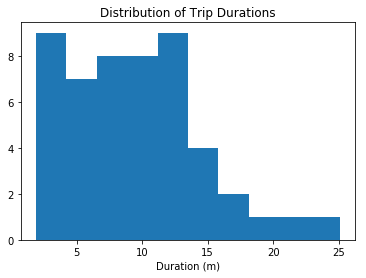

In [19]:
# load library
import matplotlib.pyplot as plt

# this is a 'magic word' that allows for plots to be displayed
# inline with the notebook. If you want to know more, see:
# http://ipython.readthedocs.io/en/stable/interactive/magics.html
%matplotlib inline 

# example histogram, data taken from bay area sample
data = [ 7.65,  8.92,  7.42,  5.50, 16.17,  4.20,  8.98,  9.62, 11.48, 14.33,
        19.02, 21.53,  3.90,  7.97,  2.62,  2.67,  3.08, 14.40, 12.90,  7.83,
        25.12,  8.30,  4.93, 12.43, 10.60,  6.17, 10.88,  4.78, 15.15,  3.53,
         9.43, 13.32, 11.72,  9.85,  5.22, 15.10,  3.95,  3.17,  8.78,  1.88,
         4.55, 12.68, 12.38,  9.78,  7.63,  6.45, 17.38, 11.90, 11.52,  8.63,]
plt.hist(data)
plt.title('Distribution of Trip Durations')
plt.xlabel('Duration (m)')
plt.show()

In the above cell, we collected fifty trip times in a list, and passed this list as the first argument to the `.hist()` function. This function performs the computations and creates plotting objects for generating a histogram, but the plot is actually not rendered until the `.show()` function is executed. The `.title()` and `.xlabel()` functions provide some labeling for plot context.

You will now use these functions to create a histogram of the trip times for the city you selected in question 4c. Don't separate the Subscribers and Customers for now: just collect all of the trip times and plot them.

In [20]:
## Use this and additional cells to collect all of the trip times as a list ##
## and then use pyplot functions to generate a histogram of trip times.     ##
def get_duration_list(filename):
    """
    This function reads in a file with trip data and reports the number of
    trips made by subscribers, customers, and total overall.
    """
    with open(filename, 'r') as f_in:
        # set up csv reader object
        reader = csv.DictReader(f_in)
        
        # initialize count variables
        duration_data = []
        # tally up ride types
        for row in reader:
            duration = float(row['duration'])
            duration_data.append(duration)
        
        return(duration_data)


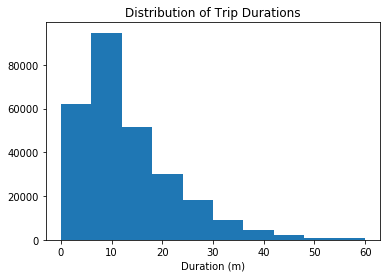

In [21]:
plt.hist(get_duration_list('./data/NYC-2016-Summary.csv'),range=(0,60))
plt.title('Distribution of Trip Durations')
plt.xlabel('Duration (m)')
plt.show()

If you followed the use of the `.hist()` and `.show()` functions exactly like in the example, you're probably looking at a plot that's completely unexpected. The plot consists of one extremely tall bar on the left, maybe a very short second bar, and a whole lot of empty space in the center and right. Take a look at the duration values on the x-axis. This suggests that there are some highly infrequent outliers in the data. Instead of reprocessing the data, you will use additional parameters with the `.hist()` function to limit the range of data that is plotted. Documentation for the function can be found [[here]](https://matplotlib.org/devdocs/api/_as_gen/matplotlib.pyplot.hist.html#matplotlib.pyplot.hist).

**Question 5**: Use the parameters of the `.hist()` function to plot the distribution of trip times for the Subscribers in your selected city. Do the same thing for only the Customers. Add limits to the plots so that only trips of duration less than 75 minutes are plotted. As a bonus, set the plots up so that bars are in five-minute wide intervals. For each group, where is the peak of each distribution? How would you describe the shape of each distribution?

**Answer**: For Subscribers, the peak is between 10-15 minutes. Nad for Customers, the peak is between 15-20 minutes. The shape for Subscribers is positively skewed. Whereas for Customers, the shape is almost a Symmetrical Distribution (very little positive skew-ness).

In [22]:
## Use this and additional cells to answer Question 5. ##
## Use this and additional cells to collect all of the trip times as a list ##
## and then use pyplot functions to generate a histogram of trip times.     ##
def get_duration_list_for_userType(filename):
    """
    This function reads in a file with trip data and reports the number of
    trips made by subscribers, customers, and total overall.
    """
    with open(filename, 'r') as f_in:
        # set up csv reader object
        reader = csv.DictReader(f_in)
        
        # initialize count variables
        subscriber_duration_data = []
        customer_duration_data = []
        # tally up ride types
        for row in reader:
            duration = float(row['duration'])
            if(row['user_type']=='Subscriber'):
                subscriber_duration_data.append(duration)
            else:
                customer_duration_data.append(duration)
        return(subscriber_duration_data, customer_duration_data)



In [23]:
subscriber_duration_data, customer_duration_data = get_duration_list_for_userType('./data/NYC-2016-Summary.csv')

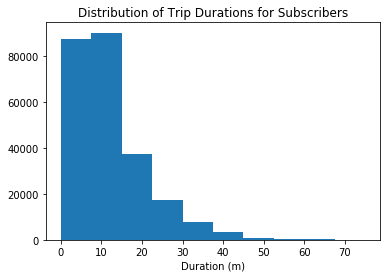

In [26]:
plt.hist(subscriber_duration_data,range=(0,75))
plt.title('Distribution of Trip Durations for Subscribers')
plt.xlabel('Duration (m)')
plt.show()

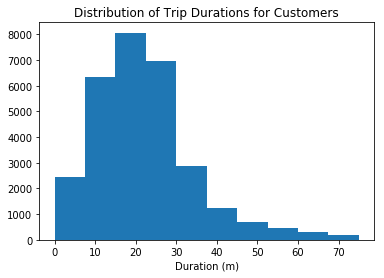

In [27]:
plt.hist(customer_duration_data,range=(0,75))
plt.title('Distribution of Trip Durations for Customers')
plt.xlabel('Duration (m)')
plt.show()

<a id='eda_continued'></a>
## Performing Your Own Analysis

So far, you've performed an initial exploration into the data available. You have compared the relative volume of trips made between three U.S. cities and the ratio of trips made by Subscribers and Customers. For one of these cities, you have investigated differences between Subscribers and Customers in terms of how long a typical trip lasts. Now it is your turn to continue the exploration in a direction that you choose. Here are a few suggestions for questions to explore:

- How does ridership differ by month or season? Which month / season has the highest ridership? Does the ratio of Subscriber trips to Customer trips change depending on the month or season?
- Is the pattern of ridership different on the weekends versus weekdays? On what days are Subscribers most likely to use the system? What about Customers? Does the average duration of rides change depending on the day of the week?
- During what time of day is the system used the most? Is there a difference in usage patterns for Subscribers and Customers?

If any of the questions you posed in your answer to question 1 align with the bullet points above, this is a good opportunity to investigate one of them. As part of your investigation, you will need to create a visualization. If you want to create something other than a histogram, then you might want to consult the [Pyplot documentation](https://matplotlib.org/devdocs/api/pyplot_summary.html). In particular, if you are plotting values across a categorical variable (e.g. city, user type), a bar chart will be useful. The [documentation page for `.bar()`](https://matplotlib.org/devdocs/api/_as_gen/matplotlib.pyplot.bar.html#matplotlib.pyplot.bar) includes links at the bottom of the page with examples for you to build off of for your own use.

**Question 6**: Continue the investigation by exploring another question that could be answered by the data available. Document the question you want to explore below. Your investigation should involve at least two variables and should compare at least two groups. You should also use at least one visualization as part of your explorations.

**Answer**: The question is - Based on whether its a weekday or a weekend. We will find out, whats the average duration of all rides based on kind of user. 
We observe that for NYC, on weekdays - Subscribers as a group, use the Bicycles for a duration than Customers.
Whereas on weekends, that proportion is changed by a lot, as Customers too contribute to a huge chunk of total duration.

In [39]:
## Use this and additional cells to continue to explore the dataset. ##
## Once you have performed your exploration, document your findings  ##
## in the Markdown cell above.                                       ##

def get_avg_duration_per_userType_fordaytype(filename):
    """
    This function reads in a file with trip data and reports the number of
    trips made by subscribers, customers, and total overall.
    """
    with open(filename, 'r') as f_in:
        # set up csv reader object
        reader = csv.DictReader(f_in)
        
        # initialize count variables
        subscriber_duration_data_weekend = []
        customer_duration_data_weekend = []
        
        subscriber_duration_data_weekday = []
        customer_duration_data_weekday = []
        # tally up ride types
        for row in reader:
            duration = float(row['duration'])
            if(row['day_of_week']=='Sunday' or row['day_of_week']=='Saturday'):
                if(row['user_type']=='Subscriber'):
                    subscriber_duration_data_weekend.append(duration)
                else:
                    customer_duration_data_weekend.append(duration)
            else:
                if(row['user_type']=='Subscriber'):
                    subscriber_duration_data_weekday.append(duration)
                else:
                    customer_duration_data_weekday.append(duration)
        avg_subscriber_weekday_duration = sum(subscriber_duration_data_weekday)/5
        avg_subscriber_weekend_duration = sum(subscriber_duration_data_weekend)/2
        avg_customer_weekday_duration = sum(customer_duration_data_weekday)/5
        avg_customer_weekend_duration = sum(customer_duration_data_weekend)/2
        
        return(avg_subscriber_weekday_duration, avg_subscriber_weekend_duration, avg_customer_weekday_duration, avg_customer_weekend_duration)




In [40]:
avg_subscriber_weekday_duration, avg_subscriber_weekend_duration, avg_customer_weekday_duration, avg_customer_weekend_duration = get_avg_duration_per_userType_fordaytype('./data/NYC-2016-Summary.csv')

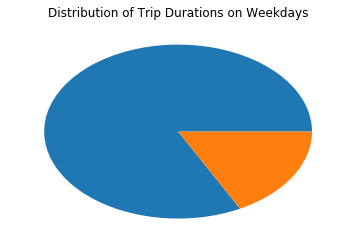

In [41]:
plt.pie([avg_subscriber_weekday_duration, avg_customer_weekday_duration])
plt.title('Distribution of Trip Durations on Weekdays')
plt.show()

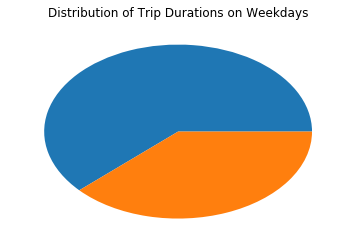

In [42]:
plt.pie([avg_subscriber_weekend_duration, avg_customer_weekend_duration])
plt.title('Distribution of Trip Durations on Weekdays')
plt.show()

<a id='conclusions'></a>
## Conclusions

Congratulations on completing the project! This is only a sampling of the data analysis process: from generating questions, wrangling the data, and to exploring the data. Normally, at this point in the data analysis process, you might want to draw conclusions about the data by performing a statistical test or fitting the data to a model for making predictions. There are also a lot of potential analyses that could be performed on the data which are not possible with only the data provided. For example, detailed location data has not been investigated. Where are the most commonly used docks? What are the most common routes? As another example, weather has potential to have a large impact on daily ridership. How much is ridership impacted when there is rain or snow? Are subscribers or customers affected more by changes in weather?

**Question 7**: Putting the bike share data aside, think of a topic or field of interest where you would like to be able to apply the techniques of data science. What would you like to be able to learn from your chosen subject?

**Answer**: My idea, is to use Data Science to the field of Law. Usually we have a judge/ jury trying out cases for a long time. If we had a intelligent tool, which can help decide the decision. Then the law system would speed up by a lot in India. I would be able to learn a lot about Artificial Intelligence, and Natural language processing.

> **Tip**: If we want to share the results of our analysis with others, we aren't limited to giving them a copy of the jupyter Notebook (.ipynb) file. We can also export the Notebook output in a form that can be opened even for those without Python installed. From the **File** menu in the upper left, go to the **Download as** submenu. You can then choose a different format that can be viewed more generally, such as HTML (.html) or
PDF (.pdf). You may need additional packages or software to perform these exports.

> If you are working on this project via the Project Notebook page in the classroom, you can also submit this project directly from the workspace. **Before you do that**, you should save an HTML copy of the completed project to the workspace by running the code cell below. If it worked correctly, the output code should be a 0, and if you click on the jupyter icon in the upper left, you should see your .html document in the workspace directory. Alternatively, you can download the .html copy of your report following the steps in the previous paragraph, then _upload_ the report to the directory (by clicking the jupyter icon).

> Either way, once you've gotten the .html report in your workspace, you can complete your submission by clicking on the "Submit Project" button to the lower-right hand side of the workspace.

In [43]:
from subprocess import call
call(['python', '-m', 'nbconvert', 'Bike_Share_Analysis.ipynb'])

0